In [2]:
##################################################################################################################
##################################################################################################################
###############################################ngrams representation###############################################
##################################################################################################################
##################################################################################################################

In [3]:
import warnings
warnings.filterwarnings('ignore')

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt 

import gensim
import gensim.corpora as corpora
from gensim.models.coherencemodel import CoherenceModel
from sklearn.feature_extraction.text import TfidfVectorizer

import nltk
#nltk.download()
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
nltk.download('stopwords')
from nltk.stem.wordnet import WordNetLemmatizer
nltk.download('wordnet')
dictionary_words = set(nltk.corpus.words.words())

from pprint import pprint

from textblob import TextBlob, Word

import spacy
import spacy_legacy
#loading the english language small model of spacy
en = spacy.load('en_core_web_sm')
sw_spacy = en.Defaults.stop_words


import pickle
import re 
import pyLDAvis
import pyLDAvis.gensim_models

[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\Wahbeh\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\Wahbeh\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!


In [4]:
df = pd.read_csv ('BenefitsCombined.csv', encoding='cp1252')

In [5]:
df.shape

(31999, 2)

In [6]:
# #Remove non english tweets
# nlp = spacy.load("en_core_web_sm")
# STOPWORDS_DICT = {lang: set(nltk.corpus.stopwords.words(lang)) for lang in nltk.corpus.stopwords.fileids()}

# def get_language(text):
#     #Determines what language the comment is written in and filters only English comments.
#     words = set(nltk.wordpunct_tokenize(text.lower()))
#     return max(((lang, len(words & stopwords)) for lang, stopwords in STOPWORDS_DICT.items()), key = lambda x: x[1])[0]

# df['language'] = df['Full Text'].map(get_language)
# df = df.loc[df['language'] == 'english']
# df = df.drop('language', axis=1)
# df = df[df['Full Text'] != ""]

In [7]:
df.shape

(31999, 2)

In [8]:
df= df.apply(lambda x: x.astype(str).str.lower())

In [9]:
df.shape

(31999, 2)

# Pre-processing

In [10]:
docs = np.array(df['Full Text'])

In [11]:
def clean_tweets(docs):
    for i in range(len(docs)):
        #remove hashtags and mentions
        docs[i] = " ".join(filter(lambda x:x[0]!='#', docs[i].split())) #remove hashtags
        docs[i] = " ".join(filter(lambda x:x[0]!='@', docs[i].split())) #remove mentiones
        
        #Remove stop words using spacy
        words = [word for word in docs[i].split() if word.lower() not in sw_spacy]
        docs[i] = " ".join(words)
        
        #Remove stop words using nltk
        words = [word for word in docs[i].split() if word.lower() not in stopwords.words('english')]
        docs[i] = " ".join(words)
        
        #remove special chars, anything not a number or letter, anything excpet alphanumeric words
        docs[i] = re.sub(r'[^\w\s]','',docs[i]) #remove punctuation marks and special chars
        docs[i] = re.sub('[^A-Za-z0-9]+', ' ', docs[i]) #remove anything that is not a number or or letter
        docs[i] = re.sub('[\W_]', ' ', docs[i]) #Remove any thing excpet charcater and alphanumeric words
        docs[i] = re.sub(r'\w*\d\w*', '', docs[i]) #Remove any thing with numbers
        docs[i] = ' '.join(word for word in docs[i].split() if not word.isdigit())
        
        #compare words to englisg dictionary and remove nonsense words
        words = [word for word in docs[i].split() if word.lower() in dictionary_words or not word.isalpha()]
        docs[i] = " ".join(words)
        
        #remove words that consists of less than three letter
        words = [word for word in docs[i].split() if len(word)>2]
        docs[i] = " ".join(words)
                             
        #Lemmatize each tweet
        sent = TextBlob(docs[i])
        docs[i] = " ". join([w.lemmatize() for w in sent.words])
    return docs

<>:18: DeprecationWarning: invalid escape sequence \W
<>:18: DeprecationWarning: invalid escape sequence \W
C:\Users\Wahbeh\AppData\Local\Temp/ipykernel_5972/2661817374.py:18: DeprecationWarning: invalid escape sequence \W
  docs[i] = re.sub('[\W_]', ' ', docs[i]) #Remove any thing excpet charcater and alphanumeric words


In [12]:
processed_docs = clean_tweets(docs)

In [13]:
processed_docs

array(['pain nerve damage thankful', 'want pain relief mouth killing day',
       'look pain mental physical', ...,
       'happen look map giant blue spot middle lake live near south east spot palm beach county originally belle glade money new job small law office new bos close ted old bos took time explain cost living expensive area inexpensive area chocolate interested change scenery tail happily happy live like king swamp muggy usually like living sauna single lane road mile radius looking forward different endless urban sprawl despite pot legal confident difficulty finding array considering palm beach reputation massive time like great idea landed able afford bedroom apartment taking majority money afford sprawling bedroom home property difficulty number attached best looking place find navigate slang person assumed landlord home rare surviving wooden built fantastic condition sale orange county fetched million here however it mainly surrounded deeply people cater control them lig

# Generate bigram and trigram

In [14]:
from nltk import ngrams
ngram_list = []
for i in range(len(processed_docs)):
    doc = processed_docs[i]
    bigram = ngrams(doc.split(' '), n=2)
    #trigram = ngrams(doc.split(' '), n=3)
    ngram_docs = []
    for x in bigram:
        ngram_docs.append(' '.join(x))
    #for y in trigram:
        #ngram_docs.append(' '.join(y))
    ngram_list.append(ngram_docs)

In [15]:
ngram_list[1]

['want pain', 'pain relief', 'relief mouth', 'mouth killing', 'killing day']

In [16]:
docs = ngram_list

In [17]:
from gensim.corpora import Dictionary

# Create a dictionary representation of the documents.
docs_dict = Dictionary(docs)
print('Number of unique words in initital documents:', len(docs_dict))

# #Filter out words that occur less than 10 documents, or more than 40% of the documents.
# docs_dict.filter_extremes(no_below=2, no_above=0.60)
# print('Number of unique words after removing rare and common words:', len(docs_dict))

Number of unique words in initital documents: 810313


In [18]:
for key, i in docs_dict.items():
    print(key, i)

0 damage thankful
1 nerve damage
2 pain nerve
3 killing day
4 mouth killing
5 pain relief
6 relief mouth
7 want pain
8 look pain
9 mental physical
10 pain mental
11 addiction pain
12 miracle plant
13 plant threat
14 threat addiction
15 help relieve
16 relieve pain
17 good pain
18 try good
19 anti worse
20 worse withdrawal
21 withdrawal well
22 addiction treatment
23 beer pain
24 got beer
25 pain weed
26 red strain
27 strain help
28 weed red
29 better tea
30 leaf powder
31 powder better
32 relief leaf
33 tea pain
34 use tea
35 hell alleviate
36 sick hell
37 local recovery
38 recovery addiction
39 depression anxiety
40 try depression
41 chronic pain
42 pain help
43 suffering chronic
44 similar pain
45 moderate pain
46 bit mood
47 mood lifter
48 found chronic
49 pain disc
50 nerve pain
51 pain definitely
52 severe nerve
53 definitely pain
54 pain drug
55 addiction expert
56 help people
57 kick addiction
58 marijuana help
59 people kick
60 heroin oxy
61 kick theirs
62 oxy kick
63 try heroi

920 hear marijuana
921 marijuana drug
922 true havent
923 addiction provide
924 away addiction
925 help away
926 nice high
927 provide nice
928 miracle cure
929 stuff miracle
930 well stuff
931 yeah well
932 find work
933 pain energy
934 royally find
935 work pretty
936 yes royally
937 addiction country
938 destruction addiction
939 end destruction
940 help end
941 clearness energy
942 energy natural
943 manga pain
944 mental clearness
945 great pain
946 help great
947 high effect
948 pain high
949 absolutely focus
950 focus chronic
951 one miracle
952 pain one
953 alcohol but
954 but know
955 opiate alcohol
956 know use
957 time instead
958 use time
959 found pain
960 try found
961 amazing tremendous
962 tremendous way
963 bravo helping
964 helping quality
965 pain free
966 quality life
967 alternative not
968 effective great
969 mood enhancement
970 not effective
971 relief mood
972 addiction help
973 got terrible
974 great post
975 help work
976 terrible opiate
977 work great
978 ad

1857 lot treat
1858 pain success
1859 tried before
1860 damn tried
1861 herb southeast
1862 southeast great
1863 tried herb
1864 acute chronic
1865 pain work
1866 free demon
1867 help free
1868 suffer addiction
1869 access best
1870 best friend
1871 friend help
1872 addiction personal
1873 helping stop
1874 personal experience
1875 tool helping
1876 useful tool
1877 addict day
1878 continue use
1879 day continue
1880 facility addict
1881 use problem
1882 work facility
1883 help addicted
1884 damn pain
1885 dose day
1886 high woke
1887 hour dose
1888 woke hour
1889 relief sure
1890 respond pain
1891 said help
1892 addicted myth
1893 prevent addicted
1894 tried prevent
1895 carry like
1896 dystrophy carry
1897 far good
1898 good stuff
1899 got muscle
1900 like far
1901 muscle dystrophy
1902 acute pain
1903 agree you
1904 you acute
1905 change lord
1906 need head
1907 end soon
1908 recommend end
1909 want recommend
1910 arthritis chronic
1911 best natural
1912 pain remedy
1913 remedy arth

2757 thought depression
2758 cause that
2759 hair loss
2760 loss thyroid
2761 thyroid cause
2762 going too
2763 like want
2764 pain again
2765 sure treatment
2766 theyre going
2767 too like
2768 treatment pain
2769 want sure
2770 genuinely helpful
2771 helpful thing
2772 kava genuinely
2773 recurring pain
2774 thing recurring
2775 alone countless
2776 countless found
2777 relief freedom
2778 agmatine help
2779 help try
2780 sarcosine treat
2781 treat depression
2782 try sarcosine
2783 anxiety slight
2784 mood though
2785 personally working
2786 slight mood
2787 working anxiety
2788 center said
2789 come addiction
2790 know work
2791 multiple people
2792 people come
2793 said multiple
2794 work addiction
2795 avoid deep
2796 deep ending
2797 ending hell
2798 favor stick
2799 hell hole
2800 hole opiate
2801 like favor
2802 stick avoid
2803 addicted something
2804 bleed instead
2805 instead getting
2806 something bleed
2807 depression go
2808 far depression
2809 go best
2810 good far
2811

3676 good smoke
3677 head shop
3678 help loss
3679 hit head
3680 loss sleep
3681 shop actually
3682 sleep appetite
3683 smoke help
3684 stick good
3685 away helping
3686 heroin taking
3687 opiate turned
3688 taking away
3689 theyre wrong
3690 turned heroin
3691 wrong opiate
3692 yes theyre
3693 anxiety balance
3694 balance mood
3695 appendage waist
3696 waist physically
3697 cried relief
3698 day cried
3699 found day
3700 relief found
3701 relief unbelievable
3702 pill pain
3703 relief natural
3704 anxiety help
3705 bad anxiety
3706 cant smoke
3707 smoke bad
3708 havent look
3709 look natural
3710 people suffer
3711 suffer depression
3712 addiction use
3713 broke addiction
3714 help again
3715 pain survivor
3716 survivor broke
3717 year chronic
3718 ban natural
3719 herb shame
3720 shame away
3721 opiate helpful
3722 opiate work
3723 addicted herb
3724 dangerous people
3725 it dangerous
3726 people it
3727 tried it
3728 energy work
3729 gone thanks
3730 green hulu
3731 green mixed
3732

4565 helpful need
4566 leave list
4567 list help
4568 need leave
4569 homeopathic tea
4570 pain sorry
4571 tea hear
4572 tried homeopathic
4573 want help
4574 addict lower
4575 care thankful
4576 dirt care
4577 lower dirt
4578 thankful found
4579 chest science
4580 paranoid chest
4581 science say
4582 withdrawal paranoid
4583 ahem excuse
4584 big ahem
4585 excuse ban
4586 plant proven
4587 all work
4588 chronic insomniac
4589 consistently alcohol
4590 here help
4591 insomniac here
4592 sleep all
4593 work consistently
4594 definitely struggle
4595 struggle like
4596 related toxicity
4597 tried treat
4598 enlightening least
4599 fan now
4600 least fan
4601 pain enlightening
4602 anxiety good
4603 booster look
4604 knowing fact
4605 free day
4606 opiate free
4607 sub opiate
4608 beneficial helping
4609 diarrhea anxiety
4610 enhancer stimulant
4611 globe beneficial
4612 helping diarrhea
4613 money opiate
4614 opiate industry
4615 relief money
4616 review soon
4617 set review
4618 soon lot

5481 bad withdrawal
5482 careful work
5483 speaking experience
5484 withdrawal speaking
5485 work bad
5486 course seen
5487 herb physical
5488 physical within
5489 reason course
5490 seen work
5491 within reason
5492 work many
5493 dangerous like
5494 relief dangerous
5495 trying effective
5496 help use
5497 management too
5498 treating like
5499 treatment treating
5500 bali anxiety
5501 great medicine
5502 mood too
5503 think great
5504 mention thing
5505 notice mention
5506 thing people
5507 anxiety owe
5508 community much
5509 dude man
5510 man use
5511 much prop
5512 owe community
5513 mistook thought
5514 relief wrong
5515 thought like
5516 time took
5517 took mistook
5518 danger addiction
5519 far danger
5520 occasional use
5521 panic occasional
5522 use far
5523 withdrawal panic
5524 addicted recommend
5525 around pretty
5526 keeping kilo
5527 kilo around
5528 pretty prevent
5529 prevent withdrawal
5530 recommend keeping
5531 withdrawal help
5532 asleep consider
5533 consider dr

6406 story need
6407 surgery dont
6408 addiction dope
6409 amazing there
6410 amazingly well
6411 clean crippling
6412 dope work
6413 got sister
6414 sister clean
6415 there got
6416 theyre amazing
6417 work amazingly
6418 you theyre
6419 successfully drop
6420 want successfully
6421 back curled
6422 curled fetal
6423 fatigue quality
6424 fetal position
6425 pain severe
6426 position bed
6427 severe fatigue
6428 gold preferred
6429 harsh stomach
6430 help like
6431 like harsh
6432 preferred strand
6433 stomach gold
6434 strand doesnt
6435 this low
6436 yeah dont
6437 energy depending
6438 forming energy
6439 herb non
6440 non habit
6441 human time
6442 like human
6443 out sick
6444 sick like
6445 speaking out
6446 thank speaking
6447 time change
6448 high peace
6449 peace pain
6450 work high
6451 came learned
6452 learned helping
6453 burning pain
6454 daily suffering
6455 excruciating burning
6456 higher daily
6457 pain higher
6458 suffering excruciating
6459 careful it
6460 it stuff


7330 pain pretty
7331 pretty big
7332 reconstruction surgery
7333 usually better
7334 effect whatsoever
7335 pain adverse
7336 whatsoever cant
7337 arthritis spinal
7338 frayed meniscus
7339 meniscus shoulder
7340 relief sciatica
7341 sciatica frayed
7342 shoulder tendinitis
7343 tendinitis arthritis
7344 illegal terrible
7345 injury amazing
7346 making illegal
7347 opiate making
7348 severe spinal
7349 spinal injury
7350 tool opiate
7351 explain use
7352 god help
7353 receive explain
7354 use god
7355 addiction instead
7356 good start
7357 helping instead
7358 instead helping
7359 instead invaluable
7360 start opiate
7361 avoid reporter
7362 bad herb
7363 bad news
7364 digging into
7365 herb narcotic
7366 narcotic use
7367 news bad
7368 reporter digging
7369 death addiction
7370 horrible death
7371 opiate horrible
7372 shop help
7373 smoke shop
7374 but mentally
7375 cant explain
7376 feel you
7377 mentally way
7378 pain but
7379 relate physical
7380 way cant
7381 you relate
7382 bad 

8262 withdrawal easy
8263 dont oil
8264 got shop
8265 oil option
8266 oil powder
8267 shop dont
8268 avid user
8269 trying manage
8270 boredom help
8271 depression overwhelming
8272 feeling boredom
8273 help thinking
8274 overwhelming feeling
8275 thinking taking
8276 this worst
8277 worst withdrawal
8278 addiction mild
8279 day good
8280 good take
8281 mild day
8282 off addiction
8283 take urge
8284 urge withdrawal
8285 withdrawal problem
8286 everyday minor
8287 fatigue use
8288 going start
8289 minor fatigue
8290 start week
8291 week everyday
8292 able chronic
8293 abuse wondering
8294 found good
8295 friend treatment
8296 good friend
8297 opiate abuse
8298 recently found
8299 wondering able
8300 enhancer help
8301 help right
8302 right suffice
8303 suffice mood
8304 addicted miserable
8305 addiction it
8306 again it
8307 it going
8308 miserable again
8309 thing hooked
8310 avoid stuff
8311 gentle screw
8312 kava gentle
8313 like kava
8314 screw sleep
8315 sleep long
8316 term disco

9167 need quick
9168 powder great
9169 quick effect
9170 relief them
9171 right long
9172 bipolar life
9173 found numerous
9174 numerous bipolar
9175 epidemic threatening
9176 natural treatment
9177 treatment addiction
9178 worried epidemic
9179 abuse medium
9180 enhancer preferably
9181 good work
9182 green vein
9183 medium good
9184 preferably white
9185 vein blend
9186 work enhancer
9187 feeling free
9188 free thing
9189 good feeling
9190 know this
9191 need know
9192 quit need
9193 thing quit
9194 damn man
9195 help feel
9196 lady lope
9197 like lady
9198 man wish
9199 pain waiting
9200 waiting like
9201 wish help
9202 bit detrimental
9203 chronic spinal
9204 daily mood
9205 detrimental effect
9206 cant sleep
9207 cry pain
9208 cutting cry
9209 friend tea
9210 maybe relief
9211 pain cutting
9212 sleep trying
9213 tea maybe
9214 trying friend
9215 depend pain
9216 dependent excruciating
9217 fatigue dependent
9218 improve quality
9219 life enjoy
9220 pain improve
9221 alongside weed

10086 though especially
10087 codeine run
10088 effect codeine
10089 long leap
10090 run withdrawal
10091 tasting plant
10092 withdrawal long
10093 bed getting
10094 better thank
10095 bit better
10096 day start
10097 getting bit
10098 start severe
10099 those day
10100 actual pain
10101 dont nearly
10102 feel relaxed
10103 level tho
10104 nearly actual
10105 relaxed dont
10106 tho use
10107 use feel
10108 dark yet
10109 dope sub
10110 lame seen
10111 post dope
10112 posting pro
10113 pro post
10114 seen dark
10115 sub lame
10116 sub posting
10117 comedown too
10118 good comedown
10119 good mind
10120 mind withdrawal
10121 probably way
10122 too probably
10123 you good
10124 addiction hopefully
10125 hopefully people
10126 people difference
10127 posting this
10128 representative told
10129 thank posting
10130 this representative
10131 told recover
10132 about soon
10133 addiction talking
10134 combat alcohol
10135 mind doc
10136 never mind
10137 said never
10138 soon said
10139 talkin

10997 journalist articulate
10998 know know
10999 life addiction
11000 love know
11001 experience sort
11002 high you
11003 interesting people
11004 people say
11005 say experience
11006 sort high
11007 you lower
11008 alleviate ill
11009 figured maybe
11010 maybe method
11011 method work
11012 thats figured
11013 ton thats
11014 wont alleviate
11015 work wont
11016 better live
11017 help live
11018 live better
11019 live pain
11020 prescription illegal
11021 use prescription
11022 any hurt
11023 constant fatigue
11024 go chronic
11025 hurt constant
11026 hurt le
11027 lot any
11028 depression functional
11029 functional hope
11030 godsend there
11031 moderation depression
11032 there wrong
11033 wrong moderation
11034 godsend pain
11035 herb godsend
11036 look herb
11037 quit actually
11038 quit substitute
11039 relief people
11040 substitute other
11041 use quit
11042 bipolar normal
11043 depression wanting
11044 die bender
11045 normal post
11046 post depression
11047 try bipolar
11

11899 lot thing
11900 story withdrawal
11901 taking horror
11902 thing understand
11903 understand stop
11904 also antihistamine
11905 antihistamine increase
11906 antihistamine reduce
11907 effect also
11908 increase nod
11909 itchiness get
11910 nod sedative
11911 reduce itchiness
11912 daily time
11913 enjoy daily
11914 knee hip
11915 related withdrawal
11916 time zero
11917 withdrawal knee
11918 zero related
11919 first kind
11920 kind wondering
11921 opiate yeah
11922 wonder pain
11923 wondering pain
11924 yeah first
11925 drug wow
11926 illegal drug
11927 natural planet
11928 planet people
11929 schedule illegal
11930 time natural
11931 crazy work
11932 disorder depression
11933 immensely eating
11934 it immensely
11935 nauseous now
11936 now crazy
11937 quit thanks
11938 thanks thought
11939 thought nauseous
11940 work it
11941 dull experience
11942 experience other
11943 good own
11944 own dull
11945 anti want
11946 claim support
11947 people claim
11948 regulation thats
11949 

12817 add help
12818 anxiety add
12819 boost bipolar
12820 disorder anxiety
12821 giving little
12822 little energy
12823 lot giving
12824 depressed know
12825 effect help
12826 feel depressed
12827 kick like
12828 know time
12829 time kick
12830 dont help
12831 finally solution
12832 happy finally
12833 help highly
12834 mild think
12835 pain dont
12836 solution end
12837 suggest like
12838 think legal
12839 beginning march
12840 boat ran
12841 looking particular
12842 march bed
12843 ran beginning
12844 smoke wax
12845 try smoke
12846 wax doesnt
12847 canopy recommend
12848 canopy thanks
12849 current vendor
12850 grown tired
12851 long stuff
12852 mail canopy
12853 pain canopy
12854 stuff mail
12855 taking long
12856 tired current
12857 vendor taking
12858 depression plenty
12859 here drug
12860 plenty chronic
12861 too here
12862 withdrawal helpful
12863 feel myself
12864 myself use
12865 cousin middle
12866 east right
12867 family father
12868 father cousin
12869 flying thanks
128

13735 better drinking
13736 death life
13737 drinking death
13738 experience physical
13739 got depression
13740 withdrawal use
13741 cant overdose
13742 depression ridiculous
13743 different respiratory
13744 it proven
13745 nauseous throw
13746 overdose nauseous
13747 person different
13748 proven cant
13749 ridiculous it
13750 addiction again
13751 combination able
13752 costa combination
13753 dan news
13754 help jenny
13755 jenny break
13756 lieutenant dan
13757 news return
13758 retreat costa
13759 return spiritual
13760 spiritual retreat
13761 baggie syndrome
13762 boof dick
13763 dealer boof
13764 dick free
13765 free baggie
13766 laced syndrome
13767 once dealer
13768 probably took
13769 syndrome got
13770 syndrome took
13771 took laced
13772 took once
13773 addiction nowadays
13774 coffee substitute
13775 deep addiction
13776 mood got
13777 nowadays use
13778 substitute help
13779 benign sickening
13780 better treat
13781 create better
13782 depression hell
13783 hell going
1

14662 you feel
14663 awesome addiction
14664 came from
14665 crutch damn
14666 damn life
14667 from tool
14668 luck remember
14669 remember came
14670 tool crutch
14671 crisis going
14672 going trying
14673 kick schedule
14674 schedule plant
14675 trying schedule
14676 current tell
14677 intense register
14678 le intense
14679 like man
14680 man le
14681 middle withdrawal
14682 register middle
14683 tell this
14684 telling this
14685 this current
14686 this like
14687 able month
14688 addiction unsustainable
14689 avoid horrible
14690 horrible year
14691 month work
14692 right addiction
14693 taper avoid
14694 that right
14695 work deal
14696 year able
14697 definitely withdrawal
14698 potent feeling
14699 way definitely
14700 withdrawal potent
14701 yes feel
14702 dose maybe
14703 hit threshold
14704 kind taken
14705 maybe twice
14706 rare kind
14707 taken small
14708 threshold anxiety
14709 twice hit
14710 donated effort
14711 effort kill
14712 free donated
14713 kick message
14714 m

15525 addicted wont
15526 doctor gove
15527 gove advice
15528 magical cure
15529 need specialized
15530 pain able
15531 run need
15532 specialized doctor
15533 wont help
15534 addiction aint
15535 aint help
15536 far getting
15537 habit far
15538 help habit
15539 much need
15540 big lose
15541 lose lot
15542 lot realm
15543 potential therapeutic
15544 realm pain
15545 replace though
15546 studied big
15547 therapeutic studied
15548 crap there
15549 cure turn
15550 lot crap
15551 pain cure
15552 telling wrong
15553 thats telling
15554 there enjoy
15555 turn lot
15556 anti help
15557 chip pick
15558 consider sober
15559 pick chip
15560 pick methadone
15561 sleep pick
15562 sober taking
15563 taking anti
15564 awesome mix
15565 buildup making
15566 day there
15567 effective time
15568 making effective
15569 problem tolerance
15570 there problem
15571 tolerance buildup
15572 weed awesome
15573 depression personally
15574 feeling trying
15575 personally taken
15576 taken feeling
15577 tryin

16424 daily treatment
16425 dose daily
16426 join kick
16427 kick currently
16428 life better
16429 literally turned
16430 treatment literally
16431 use low
16432 constant mental
16433 continue struggle
16434 day constant
16435 day treatment
16436 depression ill
16437 ill day
16438 intermittent anxiety
16439 mental obsession
16440 obsession though
16441 struggle intermittent
16442 treatment continue
16443 chance help
16444 comparable chance
16445 doubtful impact
16446 going touch
16447 him doubtful
16448 impact pain
16449 this going
16450 way comparable
16451 feel talkative
16452 helpful social
16453 love highly
16454 recommend chronic
16455 talkative social
16456 better past
16457 down exponentially
16458 exponentially pain
16459 flare gotten
16460 guess flare
16461 lie down
16462 pas lie
16463 past tell
16464 this shall
16465 come want
16466 cut prison
16467 hate come
16468 huge plus
16469 legal like
16470 legal thats
16471 mentally ease
16472 plus cut
16473 want relief
16474 work me

17363 home special
17364 pain carry
17365 pain relieved
17366 relieved pain
17367 getting sleep
17368 need vendor
17369 quality need
17370 sketchy need
17371 sleep definitely
17372 vendor sketchy
17373 acid muscle
17374 combat lactic
17375 contain combat
17376 energy overall
17377 fatigue rep
17378 lactic acid
17379 muscle fatigue
17380 overall energy
17381 rep overall
17382 too contain
17383 use too
17384 boost way
17385 couple honestly
17386 daily couple
17387 euphoric doubt
17388 honestly mood
17389 vein daily
17390 way euphoric
17391 anybody reading
17392 help withdraw
17393 heroin friend
17394 heroin try
17395 reading addicted
17396 withdraw natural
17397 decent doubt
17398 doubt help
17399 edge high
17400 fent habit
17401 habit rank
17402 high tolerance
17403 much edge
17404 rank opiate
17405 tolerance fent
17406 addiction effect
17407 completely partially
17408 effect long
17409 help temporarily
17410 partially help
17411 recommend drug
17412 run recommend
17413 temporarily caus

18244 making usage
18245 mean there
18246 there harvest
18247 usage lot
18248 burn subtle
18249 coffee better
18250 cohesion coupled
18251 coupled need
18252 endurance like
18253 energy gain
18254 enhance cup
18255 like burn
18256 mood social
18257 need seemingly
18258 seemingly endurance
18259 social cohesion
18260 subtle energy
18261 definite improvement
18262 doc surgery
18263 improvement traction
18264 neck doc
18265 nerve neck
18266 slow definite
18267 surgery slow
18268 traction work
18269 anxiety effect
18270 believe pretty
18271 cloud smaller
18272 compare kava
18273 kava cloud
18274 people compare
18275 powerful people
18276 pretty powerful
18277 relief believe
18278 smaller use
18279 exposed significant
18280 however exposed
18281 need prescription
18282 only however
18283 prescription only
18284 system worse
18285 treatment system
18286 way only
18287 worse way
18288 anxiety worse
18289 different chronic
18290 help worked
18291 thing different
18292 best strain
18293 depress

19147 world good
19148 agitation loss
19149 appetite withdrawal
19150 headache day
19151 loss appetite
19152 sleeplessness agitation
19153 withdrawal headache
19154 withdrawal sleeplessness
19155 ago away
19156 away instantly
19157 ground plant
19158 leaf normally
19159 look ground
19160 normally help
19161 opiate taper
19162 taper ago
19163 anxiety higher
19164 higher sadly
19165 schedule ban
19166 associated degenerative
19167 disease tea
19168 experience red
19169 red helpful
19170 angry time
19171 away know
19172 experience many
19173 hate trying
19174 know experience
19175 sad angry
19176 find source
19177 ill second
19178 need find
19179 second need
19180 source red
19181 chiropractor worse
19182 didnt work
19183 everything chiropractor
19184 hail mary
19185 help hail
19186 help massage
19187 major surgery
19188 mary major
19189 massage didnt
19190 pot didnt
19191 surgery didnt
19192 worse pot
19193 day yellow
19194 everyone day
19195 good morning
19196 life great
19197 month lif

20041 doctor try
20042 dose use
20043 good dose
20044 longer couple
20045 prevent cross
20046 that prevent
20047 use longer
20048 withdrawal giving
20049 adrenal fatigue
20050 adrenal health
20051 effect heavy
20052 fatigue known
20053 fog lethargy
20054 health lot
20055 lot mental
20056 not adrenal
20057 afraid start
20058 middle month
20059 month middle
20060 reducing afraid
20061 reset week
20062 week reset
20063 work reducing
20064 abdominal pain
20065 also abdominal
20066 altho probably
20067 diet also
20068 hypersensitivity altho
20069 low diet
20070 met ted
20071 pain visceral
20072 ted low
20073 visceral hypersensitivity
20074 ask stupid
20075 broke couple
20076 couple yesterday
20077 dont mean
20078 heck work
20079 help welcome
20080 hurt like
20081 like heck
20082 mean ask
20083 question help
20084 sorry dont
20085 stupid question
20086 thats sorry
20087 yesterday hurt
20088 caffeine previously
20089 consume marijuana
20090 longer smoke
20091 marijuana caffeine
20092 nicotine

20949 suggesting you
20950 want negligent
20951 you want
20952 all slightly
20953 effect zero
20954 state try
20955 tried different
20956 zero pain
20957 able live
20958 anxiety people
20959 combat long
20960 comfortably mean
20961 emergency ban
20962 live comfortably
20963 mean people
20964 overturn emergency
20965 people able
20966 people sign
20967 petition overturn
20968 sign petition
20969 term pain
20970 but try
20971 cant work
20972 happy cant
20973 license chronic
20974 stoned thank
20975 try alleviate
20976 weed license
20977 work stoned
20978 corrupt gee
20979 gee connection
20980 globally pain
20981 herb globally
20982 tried natural
20983 work corrupt
20984 athlete entire
20985 care thats
20986 dont smoke
20987 entire life
20988 good care
20989 life good
20990 love better
20991 option love
20992 smoke athlete
20993 thats option
20994 active lab
20995 effectively chronic
20996 isolated active
20997 know effectively
20998 lab know
20999 market themselves
21000 pharmaceutical i

21847 marijuana relieving
21848 pain solution
21849 relieving torturous
21850 solution here
21851 support marijuana
21852 torturous caustic
21853 criminal record
21854 mother criminal
21855 old mother
21856 record use
21857 affordable tool
21858 cure sure
21859 deliverable limit
21860 doesnt cure
21861 helpful affordable
21862 keeping deliverable
21863 limit ban
21864 sure helpful
21865 tool people
21866 way keeping
21867 addicted ton
21868 addicted yes
21869 deny objectively
21870 doesnt deny
21871 objectively true
21872 people doesnt
21873 thing addicted
21874 yes addicted
21875 about thank
21876 good success
21877 pain trigger
21878 pain weve
21879 success wondering
21880 tried good
21881 trigger pain
21882 weve tried
21883 wondering about
21884 anxiety anxiety
21885 damn dude
21886 dude sorry
21887 habit hell
21888 habit stim
21889 stim habit
21890 wonder habit
21891 work wonder
21892 addiction harmless
21893 angle that
21894 coffee it
21895 comparable coffee
21896 drink frankly
21

22751 anxiety decrease
22752 bubble wrap
22753 decrease bubble
22754 green legal
22755 state anxiety
22756 went red
22757 buy junk
22758 crap product
22759 day buy
22760 more thinking
22761 nope work
22762 person nope
22763 tried crap
22764 work more
22765 work single
22766 anti assorted
22767 assorted want
22768 boy help
22769 come play
22770 incredibly stressful
22771 play anti
22772 stressful come
22773 thats truth
22774 truth incredibly
22775 want attention
22776 breakup quit
22777 financial tapering
22778 force taking
22779 going breakup
22780 it force
22781 now good
22782 quit financial
22783 tapering now
22784 experience year
22785 head wondering
22786 help whats
22787 rest screw
22788 screw head
22789 whats experience
22790 wondering effect
22791 year rest
22792 avoid cut
22793 cut fairly
22794 cut maybe
22795 fairly easy
22796 high want
22797 maybe depression
22798 thing high
22799 want cut
22800 addiction recommend
22801 careful end
22802 end addiction
22803 good honest
22804

23660 syrup severe
23661 alcoholic quit
23662 horrible person
23663 pain didnt
23664 person alcoholic
23665 work horrible
23666 actually short
23667 day sub
23668 day you
23669 hooked sub
23670 short taper
23671 sub taper
23672 taper immensely
23673 agree feel
23674 feel providing
23675 lethargy pharmaceutical
23676 methadone patient
23677 opposite lethargy
23678 patient chronic
23679 providing substantial
23680 relief opposite
23681 substantial pain
23682 addiction chronic
23683 although addiction
23684 pain although
23685 reason nowadays
23686 cant those
23687 doctor getting
23688 greatly cant
23689 help immensely
23690 immensely want
23691 long right
23692 those help
23693 adrenal better
23694 also adrenal
23695 better slowly
23696 fatigue know
23697 know similar
23698 morning also
23699 similar adrenal
23700 that morning
23701 ankle heel
23702 ditch ankle
23703 finally went
23704 forever finally
23705 friend good
23706 good overnight
23707 heel pain
23708 overnight ditch
23709 anyt

24576 negative health
24577 similar deadly
24578 staple addiction
24579 street today
24580 today effect
24581 today little
24582 hatch wife
24583 insomnia red
24584 red try
24585 relief too
24586 spoonful water
24587 too valerian
24588 try spoonful
24589 water hatch
24590 alternative emotional
24591 sufficient alternative
24592 withdrawal sufficient
24593 convinced quality
24594 enormously wish
24595 it swim
24596 swim enormously
24597 able clean
24598 addict worse
24599 better worth
24600 biggest reason
24601 clean ease
24602 pain slept
24603 slept better
24604 stuff biggest
24605 tried addict
24606 worse stuff
24607 finished want
24608 honesty herbal
24609 it medicinally
24610 medicinally stay
24611 remedy it
24612 want honesty
24613 bali great
24614 bedtime help
24615 definite use
24616 energy level
24617 great bedtime
24618 highly lifesaver
24619 level mood
24620 mood red
24621 silver white
24622 sleep highly
24623 try definite
24624 use silver
24625 white lift
24626 available peop

25456 plan treatment
25457 profession proven
25458 proven working
25459 truth medical
25460 working plan
25461 yet billion
25462 covid rely
25463 need stop
25464 order promote
25465 own helpful
25466 pain covid
25467 promote own
25468 rely survive
25469 stop order
25470 survive need
25471 about let
25472 advice taking
25473 discover best
25474 people discover
25475 seriously advice
25476 use medicine
25477 absolutely social
25478 anxiety treat
25479 consistent raise
25480 dose addiction
25481 raise dose
25482 recommend consistent
25483 this recommend
25484 tool cure
25485 treat tool
25486 truth this
25487 coffee gram
25488 curious weed
25489 good have
25490 gram pain
25491 maybe coffee
25492 necessary curious
25493 option good
25494 out tolerance
25495 pain necessary
25496 really maybe
25497 sub out
25498 tolerance really
25499 weed option
25500 bitch more
25501 bitch sure
25502 know honestly
25503 like bitch
25504 like honestly
25505 more like
25506 sure know
25507 benzo drive
25508 c

26378 different mental
26379 heroin big
26380 love spreading
26381 new legal
26382 news article
26383 not cure
26384 read news
26385 spreading help
26386 title like
26387 treat not
26388 actual chronic
26389 bearable gone
26390 bitter cold
26391 cold snow
26392 despite bitter
26393 existent morning
26394 le bearable
26395 leaf natural
26396 morning despite
26397 morning slightly
26398 natural actual
26399 non existent
26400 slightly le
26401 snow pain
26402 thanks leaf
26403 walk morning
26404 angry sober
26405 day mood
26406 fourth day
26407 mood reduced
26408 pretty angry
26409 reduced sober
26410 sober today
26411 today fourth
26412 usually pretty
26413 able completely
26414 addict work
26415 addicted switching
26416 definitely worked
26417 fully addict
26418 life track
26419 stop definitely
26420 switching life
26421 track able
26422 work spectrum
26423 worked fully
26424 actually antagonist
26425 antagonist tolerance
26426 forgot one
26427 one actually
26428 risk dependency
26429 

27281 daily completely
27282 drink single
27283 night thread
27284 single night
27285 thread lot
27286 different want
27287 it anxiety
27288 send try
27289 try better
27290 want send
27291 dangerous effect
27292 effect spreading
27293 false trying
27294 natural synthetic
27295 session ban
27296 spreading false
27297 trying session
27298 addicted productive
27299 father saved
27300 great single
27301 protect leaf
27302 saved spent
27303 single father
27304 society great
27305 spent addicted
27306 able before
27307 before forced
27308 career helping
27309 early saved
27310 forced retire
27311 mentally younger
27312 physically mentally
27313 retire way
27314 right physically
27315 saved career
27316 way early
27317 younger able
27318 corruption husband
27319 dead watch
27320 evilness corruption
27321 husband dead
27322 offing himself
27323 pain offing
27324 suffer everyday
27325 tired evilness
27326 watch suffer
27327 ban want
27328 going wall
27329 hearing people
27330 people switching
2

28193 use walker
28194 walker wheel
28195 wise ask
28196 year left
28197 brother heroin
28198 experienced addiction
28199 experienced pain
28200 heroin experienced
28201 management well
28202 story experienced
28203 tough story
28204 watching brother
28205 well watching
28206 addiction sleep
28207 area opiate
28208 chain sorry
28209 dry heroin
28210 epidemic local
28211 heroin epidemic
28212 knowing people
28213 local area
28214 open chain
28215 said thing
28216 sorry tried
28217 thing open
28218 tried dry
28219 eating organic
28220 effect plant
28221 government sick
28222 methadone better
28223 organic government
28224 plant eating
28225 relief known
28226 sick system
28227 amazing morphine
28228 begun taking
28229 daily morphine
28230 disc heavy
28231 heavy daily
28232 hubby chronic
28233 morphine begun
28234 morphine complete
28235 taking amazing
28236 cause pain
28237 cure try
28238 tapered prevent
28239 treatment underlying
28240 underlying cause
28241 dont wrong
28242 gotten seve

29112 bad road
29113 high know
29114 lead bad
29115 road tried
29116 saying wrong
29117 tried high
29118 wrong lead
29119 course seek
29120 it understanding
29121 poppy tea
29122 tea treatment
29123 treatment doesnt
29124 understanding treatment
29125 building tolerance
29126 everyday sure
29127 helpful major
29128 looking though
29129 major chronic
29130 pain spent
29131 spent building
29132 tolerance it
29133 alternative away
29134 away lot
29135 brain non
29136 coming ween
29137 down safe
29138 lot craving
29139 non addiction
29140 ween down
29141 withdrawal brain
29142 arthritis physical
29143 cancer survivor
29144 pain arthritis
29145 physical demanding
29146 support family
29147 survivor twice
29148 twice miracle
29149 able advocate
29150 advocate work
29151 low dealing
29152 pain function
29153 think advocate
29154 time relief
29155 tolerance low
29156 culprit crap
29157 fact wont
29158 hell culprit
29159 like fact
29160 relate hell
29161 sleep yes
29162 wont sleep
29163 depress

30036 normal better
30037 normal feel
30038 oil feeling
30039 returned need
30040 supplement oil
30041 way normal
30042 addiction them
30043 effect traditional
30044 good substituting
30045 primary effect
30046 sell themselves
30047 sought sell
30048 substituting primary
30049 them sought
30050 traditional chronic
30051 blend nutrition
30052 curcumin brain
30053 effect blend
30054 fog use
30055 inflammatory effect
30056 major curcumin
30057 use anti
30058 check everything
30059 checked main
30060 coffee complex
30061 complex different
30062 drink coffee
30063 everything drink
30064 lessen potency
30065 main thread
30066 potency pretty
30067 pretty check
30068 save checked
30069 thread lessen
30070 activate them
30071 activity black
30072 food activate
30073 mess recovery
30074 oil mess
30075 receptor activity
30076 recovery food
30077 antioxidant potential
30078 fight infection
30079 help immune
30080 ill wake
30081 immune system
30082 infection maybe
30083 making post
30084 maybe ther

30955 proven were
30956 were fighting
30957 along tired
30958 ask tried
30959 half helpful
30960 individual tried
30961 pain pas
30962 pas along
30963 suffer this
30964 tired seeing
30965 tried ask
30966 bed math
30967 live medically
30968 lost live
30969 math error
30970 medically necessary
30971 necessary pain
30972 order bed
30973 people lost
30974 street order
30975 turn street
30976 and treat
30977 cause mild
30978 create high
30979 high stimulant
30980 overcome and
30981 overdose create
30982 pain impossible
30983 stimulant cause
30984 disorder weakness
30985 expensive strict
30986 expensive working
30987 flare miss
30988 immune disorder
30989 miss work
30990 strict diet
30991 try next
30992 weakness pain
30993 work expensive
30994 working going
30995 you super
30996 doe pain
30997 excruciating wondering
30998 found effective
30999 go occasion
31000 horn them
31001 obviously red
31002 occasion doe
31003 pain excruciating
31004 relief obviously
31005 them ill
31006 wondering found

31862 sex hormone
31863 symptom addiction
31864 testosterone common
31865 testosterone testosterone
31866 wonder kappa
31867 alcohol have
31868 basically slightly
31869 bonus pain
31870 caffeine bonus
31871 different least
31872 euphoric caffeine
31873 have realize
31874 least it
31875 people different
31876 realize people
31877 slightly euphoric
31878 comedown comedown
31879 comedown nonexistent
31880 coming again
31881 depressed coming
31882 nonexistent depressed
31883 often use
31884 use comedown
31885 big recovery
31886 dont uptake
31887 great too
31888 like sufficient
31889 mood dont
31890 quick tyrosine
31891 recovery feel
31892 relevant mood
31893 sleep big
31894 sufficient relevant
31895 tyrosine great
31896 uptake quick
31897 eye research
31898 potential serve
31899 research support
31900 research tea
31901 serve treatment
31902 support eye
31903 tea potential
31904 treatment withdrawal
31905 wean grow
31906 withdrawal possibly
31907 day stomach
31908 down need
31909 eat down


32755 decent pain
32756 fight worst
32757 good rest
32758 heal decent
32759 help heal
32760 bad mental
32761 body longer
32762 health suck
32763 heroine saw
32764 longer heroine
32765 said tried
32766 saw said
32767 struggling bad
32768 try stay
32769 bed heal
32770 check educated
32771 create space
32772 educated first
32773 first upside
32774 good bed
32775 heal quickly
32776 immensely table
32777 space spine
32778 spine hope
32779 swing immensely
32780 table create
32781 upside yoga
32782 yoga swing
32783 illegal dont
32784 leading better
32785 life health
32786 quit leading
32787 anxiety attack
32788 attack morning
32789 calm tha
32790 definitely stimulant
32791 it convenient
32792 morning tried
32793 stimulant it
32794 tha thing
32795 thing try
32796 tried calm
32797 cure need
32798 deal painful
32799 like deal
32800 painful cure
32801 better proven
32802 cancer chronic
32803 care system
32804 covered option
32805 naturopathic remedy
32806 option treatment
32807 proven naturopathi

33671 best answer
33672 bloat go
33673 diet best
33674 gas pain
33675 pain bloat
33676 solid gas
33677 awful work
33678 capsule warning
33679 drink not
33680 fast drink
33681 main source
33682 not capsule
33683 relief build
33684 rest maybe
33685 super fast
33686 tolerance rest
33687 warning taste
33688 work super
33689 year work
33690 away unique
33691 evil away
33692 lot restless
33693 sick evil
33694 syndrome older
33695 unique way
33696 way stuff
33697 chase euphoria
33698 day adverse
33699 effect chase
33700 euphoria primarily
33701 good daily
33702 primarily pain
33703 consistently said
33704 example varied
33705 found separate
33706 opiate pretty
33707 post opiate
33708 post post
33709 pretty consistently
33710 said worse
33711 separate post
33712 varied went
33713 went post
33714 withdrawal example
33715 worse coffee
33716 behavior modification
33717 modification please
33718 please opiate
33719 possible behavior
33720 clean short
33721 however much
33722 life more
33723 lost l

34569 similar opiate
34570 sister glad
34571 will share
34572 advocate severe
34573 didnt job
34574 find advocate
34575 glad find
34576 husband didnt
34577 imagine husband
34578 job it
34579 there glad
34580 also alternative
34581 did also
34582 helpful myself
34583 illegal did
34584 myself swear
34585 sure tried
34586 swear illegal
34587 black woman
34588 day god
34589 everything thats
34590 extremely unhappy
34591 god sin
34592 imagine black
34593 imagine need
34594 mood good
34595 thats you
34596 unhappy everything
34597 woman extremely
34598 you imagine
34599 big compete
34600 compete it
34601 directly illegal
34602 effect million
34603 help investigation
34604 illegal big
34605 investigation plant
34606 million stake
34607 plant directly
34608 alleviate discomfort
34609 best alleviate
34610 dick hey
34611 discomfort sending
34612 feel issue
34613 healing way
34614 hey feel
34615 issue tried
34616 kind dick
34617 know kind
34618 little green
34619 sending healing
34620 anxiety dont

35500 longer true
35501 medical relief
35502 miracle need
35503 pain knew
35504 proper medical
35505 sham war
35506 true found
35507 war war
35508 alcohol lie
35509 caffeine idea
35510 car cause
35511 constipation ill
35512 couple tell
35513 drive drunk
35514 drunk car
35515 idea harm
35516 lie wife
35517 reduction alcohol
35518 tell that
35519 that caffeine
35520 wife drive
35521 addiction nearly
35522 fact illegal
35523 far switching
35524 getting far
35525 illegal withdrawal
35526 largely fact
35527 life largely
35528 nearly life
35529 sure though
35530 switching addiction
35531 use vendor
35532 vendor getting
35533 withdrawal sure
35534 apply too
35535 clean like
35536 cleaner apply
35537 definitely impressive
35538 else residue
35539 go clean
35540 impressive stubborn
35541 reason went
35542 relief reason
35543 residue all
35544 stubborn chronic
35545 too go
35546 went cleaner
35547 year significant
35548 different thing
35549 fiancee relief
35550 pain mild
35551 postoperative ner

36420 personal like
36421 relief knowing
36422 relieving natural
36423 come conclusion
36424 conclusion freedom
36425 definitely work
36426 field trying
36427 find sobriety
36428 freedom option
36429 option saying
36430 sobriety come
36431 use overcome
36432 work field
36433 auditory like
36434 bay rarely
36435 cafeteria depression
36436 crowded high
36437 depression aspect
36438 kept mental
36439 life auditory
36440 like crowded
36441 mental bay
36442 noise like
36443 rarely life
36444 school cafeteria
36445 anti adult
36446 crazy talk
36447 great know
36448 lean entirely
36449 recommend stop
36450 right them
36451 taking lean
36452 talk anti
36453 them great
36454 copy pasting
36455 dangerous unintelligent
36456 example star
36457 got instantly
36458 include looking
36459 instantly addicted
36460 looking withdrawal
36461 pasting plus
36462 plus poisoning
36463 poisoning work
36464 star review
36465 took got
36466 withdrawal copy
36467 withdrawal include
36468 work plant
36469 again t

37320 pain benzo
37321 specialist intractable
37322 therapy specialist
37323 bad year
37324 like situation
37325 need deserve
37326 numerous knee
37327 pain numerous
37328 situation bad
37329 wonderful happy
37330 year run
37331 addicted subscription
37332 ban internationally
37333 believe smear
37334 campaign hip
37335 help joe
37336 hip addicted
37337 internationally believe
37338 joe look
37339 look trying
37340 subscription chronic
37341 ban right
37342 better course
37343 substance better
37344 affecting generate
37345 big care
37346 care affecting
37347 generate profit
37348 helping create
37349 keeping people
37350 profit save
37351 ask mother
37352 away them
37353 child said
37354 let ask
37355 said tortured
37356 thing relief
37357 told thing
37358 tortured chronic
37359 wife child
37360 anything herb
37361 banning pharmaceutical
37362 before cure
37363 cure anything
37364 leave people
37365 people banning
37366 people worse
37367 worse before
37368 animal study
37369 found co

38236 love doing
38237 pot chronic
38238 sam staff
38239 similar pot
38240 staff look
38241 trying love
38242 help legalize
38243 helping push
38244 legal protect
38245 patient refusing
38246 protect right
38247 push medical
38248 refusing treat
38249 sir young
38250 young chronic
38251 find alternate
38252 guess people
38253 relief afraid
38254 relief wheel
38255 turning street
38256 wheel know
38257 absolutely about
38258 but thats
38259 know absolutely
38260 mood but
38261 relief improve
38262 similarity pain
38263 talk know
38264 accurate threat
38265 health year
38266 improve health
38267 life sanity
38268 patient saved
38269 removing pain
38270 responsibly improve
38271 retired nurse
38272 safely responsibly
38273 sanity removing
38274 threat million
38275 all instrumental
38276 helping stick
38277 love all
38278 seen story
38279 story alternative
38280 herbal plant
38281 strain high
38282 try strain
38283 adenosine handy
38284 bad reason
38285 handy plant
38286 reason sleeping
3

39141 chill stuff
39142 deadly help
39143 killer onset
39144 onset sick
39145 pushing deadly
39146 sick pushing
39147 stuff it
39148 absolutely fake
39149 actual oil
39150 careful sure
39151 causing extreme
39152 city absolutely
39153 extreme addiction
39154 fake oil
39155 fully synthetic
39156 juice spice
39157 oil juice
39158 oil pretty
39159 pretty shop
39160 shop city
39161 spice fully
39162 sure actual
39163 synthetic causing
39164 ceremony graduated
39165 commencement ceremony
39166 cum evil
39167 evil plant
39168 graduated cum
39169 graduation degree
39170 happy graduation
39171 hour commencement
39172 pain hour
39173 time university
39174 university today
39175 appeal cheap
39176 big lobby
39177 cheap slim
39178 effective people
39179 fact curb
39180 little appeal
39181 margin fact
39182 people little
39183 profit margin
39184 slim profit
39185 cramping period
39186 friend visiting
39187 hear couple
39188 help menstrual
39189 lady friend
39190 menstrual not
39191 not wondering


40401 dependence withdrawal
40402 depending personal
40403 exception suppose
40404 history with
40405 largely based
40406 list largely
40407 personal history
40408 with exception
40409 with risk
40410 withdrawal list
40411 bad influence
40412 effect counter
40413 indifferent source
40414 influence suggest
40415 marijuana indifferent
40416 mental look
40417 prescription have
40418 relief negative
40419 source relief
40420 suggest people
40421 want bad
40422 anxiety number
40423 check hard
40424 depressant motivation
40425 lotus nice
40426 mellow euphoria
40427 motivation anxiety
40428 nice mellow
40429 nice natural
40430 number blue
40431 pretty nice
40432 sleep check
40433 body choose
40434 choose which
40435 country like
40436 fictional right
40437 like fictional
40438 stop country
40439 which pain
40440 alone bit
40441 bit medical
40442 depression alone
40443 depression reading
40444 disorder prescription
40445 medical anxiety
40446 only depression
40447 reading major
40448 saffron d

41284 hydro barely
41285 like stated
41286 noticeable euphoria
41287 relief system
41288 time well
41289 changer try
41290 clean withdrawal
41291 low told
41292 rest pain
41293 strain rest
41294 use game
41295 you use
41296 alive tha
41297 ask brother
41298 cough stuff
41299 know tha
41300 misery tha
41301 overall misery
41302 reduce tha
41303 stuff alive
41304 tha cough
41305 tha overall
41306 tha reduce
41307 tha tha
41308 tha virus
41309 tha zinc
41310 virus lot
41311 yuh ask
41312 zinc tha
41313 function recommend
41314 it useful
41315 manage wouldnt
41316 transition withdrawal
41317 use transition
41318 useful addiction
41319 vendor soap
41320 bleed strong
41321 block feel
41322 feel vomiting
41323 herb block
41324 tea pill
41325 til bleed
41326 vomiting til
41327 ago saying
41328 group recently
41329 guessing it
41330 herb sort
41331 pain group
41332 prior day
41333 recently guessing
41334 saying lot
41335 sort prior
41336 article twinge
41337 country attack
41338 decent relief
4

42107 price pill
42108 safe affordable
42109 synthetic low
42110 thats chemically
42111 addicted gotten
42112 drinking liter
42113 everyday guess
42114 gotten life
42115 guess better
42116 life drinking
42117 liter vodka
42118 vodka everyday
42119 afford improve
42120 clear ulterior
42121 destroy order
42122 disconcerting willing
42123 extremely disconcerting
42124 improve clear
42125 order million
42126 willing destroy
42127 exercise council
42128 helpful methadone
42129 helpful step
42130 methadone helpful
42131 methadone sick
42132 natural exercise
42133 properly methadone
42134 sick natural
42135 step tool
42136 tool properly
42137 beautiful family
42138 blessed thank
42139 family hope
42140 free narcotic
42141 hope blessed
42142 provide beautiful
42143 thank time
42144 time sir
42145 working provide
42146 equivalent large
42147 insanity thing
42148 it equivalent
42149 large pain
42150 long insanity
42151 thing it
42152 bali type
42153 high much
42154 legal bali
42155 let lower
421

43025 fight defend
43026 mental energy
43027 moron theyre
43028 negative lot
43029 relief moron
43030 theyre expert
43031 back severe
43032 basis severe
43033 occasionally miracle
43034 severe back
43035 severe suffer
43036 suffer use
43037 are need
43038 describe great
43039 fast use
43040 great are
43041 need superior
43042 product super
43043 superior product
43044 truly describe
43045 anything homemade
43046 company gone
43047 company time
43048 dose anything
43049 dud company
43050 hate large
43051 homemade lucky
43052 hour tried
43053 improvement hour
43054 large dose
43055 lucky improvement
43056 new company
43057 swear dud
43058 time swear
43059 ago outside
43060 bedchair suicide
43061 confined bedchair
43062 crisis need
43063 deck crisis
43064 dose ineffective
43065 ineffective confined
43066 outside deck
43067 plan ago
43068 specialist reduced
43069 suicide plan
43070 ban go
43071 cant people
43072 day people
43073 genuinely bed
43074 go stuff
43075 insane guess
43076 man ban

43961 stand stuff
43962 stuff getting
43963 transverse myelitis
43964 war getting
43965 withdrawal cant
43966 but evening
43967 comment took
43968 evening heading
43969 family pumpkin
43970 fine but
43971 getting mood
43972 green sumatra
43973 heading family
43974 instant smile
43975 lift fine
43976 patch comment
43977 pumpkin patch
43978 smile feel
43979 sumatra instant
43980 addicted racket
43981 warning help
43982 barely anxiety
43983 change coming
43984 coming pretty
43985 functional work
43986 job barely
43987 pretty addict
43988 rarely work
43989 there rarely
43990 work change
43991 work professional
43992 basically replacement
43993 case time
43994 doctor research
43995 replacement addiction
43996 research stuff
43997 seriousness basically
43998 understand seriousness
43999 yea understand
44000 come down
44001 drastically turned
44002 drug learned
44003 free go
44004 generally free
44005 go come
44006 learned hard
44007 life drastically
44008 turned like
44009 way generally
4401

44895 pain warrior
44896 sitting thinking
44897 speak local
44898 station tell
44899 story chronic
44900 talk pain
44901 warrior community
44902 able treat
44903 awful effect
44904 back know
44905 change want
44906 effect notice
44907 huge change
44908 illness naturally
44909 important able
44910 it important
44911 longer suffer
44912 longer want
44913 naturally know
44914 notice huge
44915 suffer awful
44916 want gave
44917 big use
44918 cause physical
44919 clean chronic
44920 dependency addiction
44921 growing tree
44922 natural growing
44923 plant big
44924 treat severe
44925 tree cousin
44926 ban pocket
44927 leaf coffee
44928 supplement tree
44929 wish ban
44930 ban instead
44931 help wan
44932 instead potential
44933 likely hurt
44934 month likely
44935 multiple statement
44936 outright ban
44937 statement month
44938 use multiple
44939 wan outright
44940 end personally
44941 helpful scientific
44942 medication neurotoxic
44943 neurotoxic bad
44944 patient probably
44945 persona

45843 stuck amazing
45844 health health
45845 health million
45846 important health
45847 lying natural
45848 mad lying
45849 million choose
45850 plant important
45851 use health
45852 alcohol serious
45853 blotto hard
45854 crave booze
45855 didnt drink
45856 drink pushing
45857 hard alcohol
45858 night survive
45859 pushing blotto
45860 serious crave
45861 survive alcohol
45862 you didnt
45863 bought honestly
45864 broke leg
45865 broken leg
45866 exactly time
45867 hip broken
45868 honestly prob
45869 pain broke
45870 prob saved
45871 time bought
45872 fight back
45873 help prison
45874 lawyer tried
45875 past people
45876 prison fight
45877 relief lawyer
45878 thank past
45879 body quit
45880 brittle taken
45881 felt brittle
45882 helping it
45883 methadone body
45884 picture helping
45885 shaking felt
45886 stop shaking
45887 taken picture
45888 calling office
45889 discus chronic
45890 office discus
45891 protecting calling
45892 relief response
45893 stand protecting
45894 unab

46752 tend garden
46753 use illegal
46754 work exercise
46755 check dose
46756 day filled
46757 dose therapy
46758 filled living
46759 later hip
46760 life check
46761 living life
46762 morning later
46763 therapy morning
46764 afloat life
46765 clean motivation
46766 day insurance
46767 insurance kept
46768 kept afloat
46769 life protect
46770 motivation day
46771 depend live
46772 here need
46773 homeopathic weed
46774 lying miracle
46775 need lying
46776 pain war
46777 people depend
46778 point here
46779 war homeopathic
46780 and dangerous
46781 dangerous leaf
46782 drug classified
46783 family and
46784 happening incredible
46785 report whats
46786 whats happening
46787 anesthesia saved
46788 appendix bladder
46789 bladder surgery
46790 extracted anesthesia
46791 life treating
46792 pain pump
46793 pain since
46794 placement removal
46795 pump surgery
46796 removal wisdom
46797 since pain
46798 surgery placement
46799 surgery vehicle
46800 surgically extracted
46801 teeth surgical

47650 worried kidney
47651 worry combining
47652 believe harm
47653 funded study
47654 guide policy
47655 harm struggling
47656 health official
47657 official believe
47658 outlier policy
47659 policy funded
47660 policy virtually
47661 reduction guide
47662 struggling manage
47663 study harm
47664 virtually public
47665 addiction diarrhea
47666 anti hypertension
47667 body drug
47668 depression increase
47669 desire prevent
47670 diabetes digestion
47671 diarrhea medication
47672 endurance energy
47673 energy enhancer
47674 enhancer anti
47675 hypertension muscle
47676 increase endurance
47677 increase sexual
47678 leaf body
47679 medication increase
47680 pain prevent
47681 prevent diabetes
47682 prevent treat
47683 sexual desire
47684 available beyond
47685 awesome deserve
47686 experience work
47687 it panacea
47688 management available
47689 panacea solution
47690 similar experience
47691 solution all
47692 someone thats
47693 work someone
47694 constipation like
47695 form pain
4

48549 better sometimes
48550 cheese tonight
48551 chicken macaroni
48552 eat though
48553 fasting bad
48554 idea yeah
48555 macaroni cheese
48556 meal feel
48557 mess sunshine
48558 miserable need
48559 need eat
48560 pain wait
48561 sometimes chicken
48562 starved pain
48563 sunshine warmer
48564 though mess
48565 tonight miserable
48566 wait meal
48567 warmer weather
48568 yeah starved
48569 gear opiate
48570 huge sub
48571 kick severe
48572 opiate there
48573 pain kick
48574 product work
48575 severe gear
48576 sub use
48577 alleviate feeling
48578 beating hard
48579 clean alleviate
48580 clean week
48581 energy heart
48582 exert energy
48583 far time
48584 feel getting
48585 feel this
48586 feeling blood
48587 hard clean
48588 heart beating
48589 this feel
48590 time exert
48591 addict synthetic
48592 bipolar sleeping
48593 confront odd
48594 like stole
48595 living addict
48596 odd help
48597 sleeping wife
48598 stole living
48599 synthetic bipolar
48600 wife confront
48601 end mi

49460 depend government
49461 fight probably
49462 government getting
49463 probably know
49464 problem depend
49465 reduction leave
49466 addiction billion
49467 dollar industry
49468 face government
49469 government pharmaceutical
49470 industry hope
49471 industry want
49472 remedy treat
49473 treat let
49474 agree alcohol
49475 alcohol regulated
49476 epidemic numerous
49477 far epidemic
49478 myself kick
49479 nasty opiate
49480 numerous people
49481 opiate provided
49482 provided relief
49483 regulated why
49484 relief unable
49485 why far
49486 didnt walk
49487 legal supplemental
49488 pain beg
49489 reliever scoliosis
49490 walk believe
49491 better saved
49492 bos wouldnt
49493 broken vertebra
49494 infected tooth
49495 relief broken
49496 relief knee
49497 saved bos
49498 saved wouldnt
49499 tooth saved
49500 vertebra infected
49501 yep personally
49502 anyone thing
49503 awful dont
49504 dont wish
49505 horrendous daily
49506 saved horrendous
49507 sick awful
49508 situation

50357 week care
50358 affected medical
50359 badly overall
50360 health negatively
50361 here didnt
50362 joint hip
50363 medical lot
50364 negatively affected
50365 overall health
50366 overall heath
50367 realize badly
50368 day first
50369 fast yesterday
50370 first pain
50371 muscle tolerance
50372 newly day
50373 pain rather
50374 rather muscle
50375 thanks newly
50376 yesterday thanks
50377 back hot
50378 find recently
50379 got out
50380 hot soak
50381 know find
50382 life went
50383 like got
50384 out cant
50385 recently worst
50386 soak provided
50387 way back
50388 went way
50389 work nothing
50390 worst damn
50391 before experienced
50392 brought life
50393 experienced negative
50394 thought helpful
50395 told brought
50396 use thought
50397 anxiety government
50398 cure significant
50399 government witch
50400 hunt suffering
50401 most cure
50402 patient most
50403 suffering patient
50404 addicted gaming
50405 gaming quit
50406 inpatient treatment
50407 large treatment
5040

51270 incredible painkiller
51271 painkiller experienced
51272 read thing
51273 scoliosis seriously
51274 seriously incredible
51275 worth second
51276 again feel
51277 anxiety godsend
51278 different suffer
51279 godsend red
51280 lift anxiety
51281 right getting
51282 ailment deal
51283 injury result
51284 management specifically
51285 result spasm
51286 spasm random
51287 specific ailment
51288 specifically injury
51289 spectrum start
51290 start specific
51291 best them
51292 different best
51293 find correct
51294 kitchen like
51295 luck sure
51296 mix too
51297 relief different
51298 sure find
51299 them like
51300 addicted methadone
51301 course time
51302 methadone opiate
51303 opiate course
51304 right tapering
51305 tapering day
51306 caloric dense
51307 dense withdrawal
51308 eat starve
51309 funny suggest
51310 lack appetite
51311 starve lack
51312 suggest caloric
51313 suggest different
51314 tend eat
51315 turn effect
51316 withdrawal tend
51317 adversely health
51318 day

52171 great slept
52172 hope herbal
52173 ill read
52174 mixed water
52175 morphine daily
52176 pain wow
52177 powder mixed
52178 read reduce
52179 reduce morphine
52180 slept like
52181 water felt
52182 wow pain
52183 and yes
52184 differ thank
52185 explain people
52186 medium explain
52187 taking differ
52188 thank quality
52189 yes addiction
52190 actual wish
52191 actually try
52192 being pain
52193 cure godsend
52194 excellent being
52195 mild like
52196 treatment cure
52197 try excellent
52198 wish actually
52199 lifesaving plant
52200 wonderful lifesaving
52201 heart heavy
52202 heartbreaking inhumane
52203 heavy sad
52204 inhumane said
52205 like heart
52206 sad heartbreaking
52207 significantly affected
52208 story like
52209 try quality
52210 chance choice
52211 choice manage
52212 ill chance
52213 like ill
52214 minus severe
52215 one chronic
52216 opiate minus
52217 begin suggesting
52218 couple naturopath
52219 crisis boom
52220 effect couple
52221 naturopath begin
52222 

52942 occasionally gel
52943 speaking got
52944 stuff generally
52945 tried stuff
52946 turmeric glucosamine
52947 with thanks
52948 coffee sleepy
52949 dosage experience
52950 like strong
52951 probably gas
52952 station use
52953 stimulant sedative
52954 use stimulant
52955 advocate like
52956 as doesnt
52957 control politics
52958 demon fight
52959 doesnt powerful
52960 doesnt stoned
52961 fight doesnt
52962 incentive mat
52963 it providing
52964 it social
52965 like as
52966 need demon
52967 politics need
52968 powerful advocate
52969 social control
52970 stoned it
52971 strong incentive
52972 there strong
52973 avoid this
52974 destroy doctor
52975 doctor silently
52976 fought hard
52977 hard avoid
52978 led rep
52979 silently led
52980 sufferer want
52981 thats fought
52982 think alternative
52983 work destroy
52984 energy little
52985 flat doesnt
52986 happy wasted
52987 it happy
52988 little euphoria
52989 miracle substance
52990 anxiety white
52991 aspect life
52992 best felt


53879 though suggest
53880 totally help
53881 aka similar
53882 compression herniated
53883 cord compression
53884 dependent aka
53885 dose dependent
53886 herniated cervical
53887 instead dose
53888 relaxer spinal
53889 similar use
53890 alone let
53891 crisis imagine
53892 day single
53893 getting day
53894 have leave
53895 illicit crisis
53896 imagine have
53897 imagine pain
53898 let relief
53899 not illicit
53900 article quick
53901 conversation pivot
53902 dude hey
53903 hey pull
53904 man ton
53905 mid conversation
53906 pivot yeah
53907 pull article
53908 quick try
53909 shoulder know
53910 thats mid
53911 getting hard
53912 hard maintenance
53913 heroin muscle
53914 maintenance year
53915 methadone withdrawal
53916 took worse
53917 year took
53918 barrier reach
53919 cause million
53920 epidemic lie
53921 face people
53922 false epidemic
53923 pain properly
53924 people barrier
53925 properly false
53926 reach treat
53927 you trying
53928 all plain
53929 ask include
53930 incl

54786 drive overdose
54787 going send
54788 higher focus
54789 illicit addiction
54790 overdose higher
54791 respect evidence
54792 send abandoned
54793 statement illicit
54794 street drive
54795 support statement
54796 also contrary
54797 chiropractic also
54798 contrary stop
54799 discomfort endure
54800 endure massage
54801 massage chiropractic
54802 pain safely
54803 possible stop
54804 reduced discomfort
54805 remarkable all
54806 safely reduced
54807 suffer remarkable
54808 taking suffer
54809 acute overdose
54810 ban flawed
54811 data ban
54812 depression world
54813 essential harm
54814 flawed useful
54815 health list
54816 list essential
54817 overdose reducing
54818 reducing respiratory
54819 world health
54820 false misinformation
54821 family plant
54822 help coffee
54823 highly appreciate
54824 need retract
54825 plant highly
54826 retract false
54827 say need
54828 want actually
54829 addicted matter
54830 fill want
54831 legal shady
54832 matter cure
54833 people fill
54

55687 methadone it
55688 yeah day
55689 being physical
55690 continue lie
55691 ignore science
55692 innocent people
55693 lie ignore
55694 listen ease
55695 mental continue
55696 pain promote
55697 people hold
55698 promote being
55699 responsibility people
55700 science truth
55701 suffer people
55702 truth innocent
55703 addiction organization
55704 alter help
55705 banning alter
55706 big talk
55707 lethal banning
55708 organization lethal
55709 safety addiction
55710 talk public
55711 anxiety mainly
55712 breath cry
55713 cry gasping
55714 eat feel
55715 gasping soon
55716 holding breath
55717 knot stomach
55718 matter edge
55719 realize start
55720 some wake
55721 soon realize
55722 start sweating
55723 stomach eat
55724 sweating knot
55725 wake holding
55726 working matter
55727 it tricky
55728 nauseous long
55729 too energy
55730 tricky drug
55731 try definitely
55732 causing severe
55733 cyst vasculitis
55734 fibroid tumor
55735 friend week
55736 near friend
55737 osteoarthrit

56599 captive physically
56600 door hell
56601 dying revolving
56602 emotionally eventually
56603 eventually street
56604 hell holy
56605 holy spirit
56606 inspired write
56607 mentally emotionally
56608 page coming
56609 saved gave
56610 soon captive
56611 spirit saved
56612 story page
56613 street dying
56614 testimony inspired
56615 write story
56616 anyway lucky
56617 contact sell
56618 distribute anyway
56619 find lower
56620 intensity pain
56621 lower intensity
56622 lucky finally
56623 pain prefer
56624 prefer contact
56625 sell distribute
56626 dont touch
56627 hear acupuncture
56628 help havent
56629 hurt voice
56630 massage hear
56631 memo minor
56632 minor speaking
56633 pain massage
56634 reliable speak
56635 speak memo
56636 speaking therapy
56637 text reliable
56638 therapy pain
56639 tried those
56640 voice text
56641 actually let
56642 away choice
56643 choice suffer
56644 misery actually
56645 pain profit
56646 profit misery
56647 absolutely mood
56648 addiction desper

57573 time ran
57574 wish stuck
57575 withdrawal experience
57576 worse wish
57577 apparently low
57578 ask apparently
57579 back thinking
57580 brain energy
57581 definitely referral
57582 energy want
57583 important thats
57584 low super
57585 meant help
57586 pharmacist said
57587 psych ask
57588 referral psych
57589 super important
57590 thats brain
57591 thinking pharmacist
57592 want back
57593 drug saved
57594 east tell
57595 hunger middle
57596 save dude
57597 saved save
57598 saved world
57599 war world
57600 world war
57601 actually possible
57602 alternative necessary
57603 answer seriously
57604 earth answer
57605 horrible kicking
57606 immensely actually
57607 job natural
57608 kick immensely
57609 kicking doesnt
57610 necessary mother
57611 work kick
57612 court test
57613 drug court
57614 finished year
57615 isolate zero
57616 luckily radar
57617 probation weed
57618 radar drug
57619 stick isolate
57620 test probation
57621 test stick
57622 weed finished
57623 year lucki

58477 gun trick
58478 hear there
58479 lately feel
58480 let certain
58481 like tranquilizer
58482 mess anxiety
58483 there let
58484 though try
58485 too calm
58486 tranquilizer gun
58487 try balance
58488 two lately
58489 clearly damage
58490 damage hip
58491 excruciating clearly
58492 hip absolutely
58493 know major
58494 logical factual
58495 major page
58496 page post
58497 page run
58498 page taking
58499 post like
58500 run people
58501 taking logical
58502 them page
58503 trying them
58504 definitely strong
58505 doing strong
58506 ease importantly
58507 heroin doing
58508 importantly life
58509 strong heroin
58510 city help
58511 excuse extort
58512 extort violently
58513 far city
58514 help hysteria
58515 hotbed legislation
58516 hysteria want
58517 ruin hotbed
58518 see far
58519 violently ruin
58520 want excuse
58521 well see
58522 got switched
58523 people powerful
58524 point powerful
58525 powerful total
58526 switched point
58527 awful stuff
58528 far point
58529 habit 

59370 tried delta
59371 working awhile
59372 got free
59373 greatly got
59374 help supplier
59375 lord life
59376 organic slander
59377 patient greatly
59378 slander longer
59379 supplier organic
59380 thank lord
59381 urge help
59382 basically guy
59383 bunch effect
59384 effect basically
59385 pretty nasty
59386 yeah friend
59387 blunt pain
59388 doc pain
59389 far it
59390 it rough
59391 management red
59392 recliner trick
59393 red blunt
59394 regard worst
59395 replacement regard
59396 rough sleeping
59397 shoulder replacement
59398 sleeping recliner
59399 talk doc
59400 trick talk
59401 work shoulder
59402 bought local
59403 but ready
59404 diehard fan
59405 fan tried
59406 like diehard
59407 pain bought
59408 ready turn
59409 relief but
59410 shop desperate
59411 street hope
59412 tried weekend
59413 want sound
59414 weekend actually
59415 backup pain
59416 dont jump
59417 eliminate backup
59418 government ran
59419 government stupid
59420 jump stupid
59421 lab eliminate
59422 r

60294 addiction ruin
60295 death you
60296 dose fun
60297 fun love
60298 live good
60299 luck stay
60300 man bad
60301 man stay
60302 mum dose
60303 ruin you
60304 you death
60305 you mum
60306 amphetamine which
60307 bed sure
60308 fatigue lying
60309 hydrated though
60310 lying help
60311 though amphetamine
60312 which worse
60313 worse lot
60314 feeling day
60315 like unrelated
60316 pain whatsoever
60317 sleeping related
60318 treat causing
60319 unrelated sleeping
60320 wake feeling
60321 whatsoever like
60322 clean woo
60323 drawn bad
60324 thats dumb
60325 withdrawal drawn
60326 woo withdrawal
60327 definitely point
60328 found hurting
60329 get honestly
60330 honestly feel
60331 response definitely
60332 you appreciate
60333 buzz suggest
60334 comment wasnt
60335 joint lit
60336 lit pretty
60337 nice joint
60338 offense opinion
60339 opinion place
60340 place yeah
60341 rude taking
60342 saying comment
60343 suggest nice
60344 taking offense
60345 wasnt rude
60346 ban sell
6034

61198 necessarily depression
61199 out many
61200 right hope
61201 substance necessarily
61202 think substance
61203 work out
61204 able replace
61205 addiction split
61206 bummer able
61207 calm day
61208 curious hear
61209 day avoid
61210 half curious
61211 honestly bummer
61212 split half
61213 this honestly
61214 use calm
61215 aside shuffle
61216 cause endocrine
61217 curious endocrine
61218 discovered aside
61219 disruption hope
61220 endocrine disruption
61221 endocrine long
61222 reason discovered
61223 shuffle pain
61224 use known
61225 use main
61226 awful learned
61227 bad later
61228 chemistry feel
61229 free chemistry
61230 later there
61231 lesson free
61232 there tough
61233 working took
61234 able deny
61235 cause sweep
61236 covering mountain
61237 deny rug
61238 eventually able
61239 here suitable
61240 mentally eventually
61241 outright cause
61242 recovery here
61243 rug covering
61244 rug mentally
61245 run outright
61246 suitable treating
61247 sweep rug
61248 ter

62111 worse disappointed
62112 alcohol hour
62113 amphetamine cocktail
62114 day funny
62115 depressed self
62116 dont drunk
62117 drunk people
62118 fine dont
62119 heck maybe
62120 hour interview
62121 interview day
62122 lot amphetamine
62123 maybe alcohol
62124 mean lot
62125 self heck
62126 use mean
62127 age suffering
62128 bali supreme
62129 chronic low
62130 disc dont
62131 dont month
62132 hard trying
62133 hope age
62134 month crossed
62135 pst hard
62136 supreme hope
62137 trying bought
62138 body definitely
62139 broke hand
62140 definitely easier
62141 easier withdrawal
62142 effective oxy
62143 hand found
62144 morphine broke
62145 oxy well
62146 pill say
62147 say time
62148 though hard
62149 time morphine
62150 well right
62151 anecdotal story
62152 anybody good
62153 anyone like
62154 dont dependent
62155 feel opposed
62156 good anecdotal
62157 good sleep
62158 kava feel
62159 kava good
62160 lessen dont
62161 like lessen
62162 opposed user
62163 pain restlessness
6216

63008 dependency ago
63009 designed purpose
63010 investment board
63011 patent alkaloid
63012 previously patent
63013 product investment
63014 purpose treating
63015 anxiety amazed
63016 people psychological
63017 psychological like
63018 certain way
63019 dont energy
63020 fight certain
63021 legal herbal
63022 open too
63023 recently open
63024 refuse statistic
63025 remedy lessen
63026 statistic currently
63027 turmeric recently
63028 way refuse
63029 acceptable deny
63030 add narrative
63031 deny legit
63032 dont add
63033 easier publicly
63034 making easier
63035 medicine freedom
63036 narrative making
63037 need room
63038 pain size
63039 publicly acceptable
63040 room pain
63041 size medicine
63042 addiction family
63043 cancer sick
63044 food smoked
63045 fortunate deal
63046 life cancer
63047 marijuana work
63048 pot save
63049 sick way
63050 smoked pot
63051 too pot
63052 way food
63053 experience possible
63054 fam glad
63055 huge therapeutic
63056 our huge
63057 pain our
6

63914 theyll push
63915 basically herbal
63916 form good
63917 million million
63918 million nothing
63919 nothing proof
63920 proof capsule
63921 relief million
63922 supposedly pain
63923 alongside it
63924 brand three
63925 capsule alongside
63926 crap chronic
63927 dont lace
63928 favorite brand
63929 great capsule
63930 lace crap
63931 leaf dont
63932 life doesnt
63933 three leaf
63934 tried favorite
63935 vehicle life
63936 dont manage
63937 else cant
63938 grateful access
63939 need else
63940 sure grateful
63941 card plus
63942 dramatically intake
63943 intake want
63944 manage joint
63945 pain dramatically
63946 plus visit
63947 try medical
63948 wondering mention
63949 actually proper
63950 afford ill
63951 dependence true
63952 evil physical
63953 hope actually
63954 kind afford
63955 pain whole
63956 proper kind
63957 try evil
63958 whole ugh
63959 agree best
63960 bill sad
63961 find option
63962 more taken
63963 option more
63964 sad find
63965 snuck bill
63966 taken usua

64822 freedom pitch
64823 michigan much
64824 pain michigan
64825 seat covid
64826 serve people
64827 talking fit
64828 chance couple
64829 couple people
64830 going sit
64831 long going
64832 need sit
64833 sit severe
64834 sit wondering
64835 thats couple
64836 wondering long
64837 considered reduce
64838 disabled severe
64839 leg literally
64840 muscle disabled
64841 severe leg
64842 add strain
64843 concurrent anxiety
64844 digestible add
64845 easily digestible
64846 help neutralize
64847 ideally best
64848 juice help
64849 lousy taste
64850 measured potency
64851 neutralize lousy
64852 pain concurrent
64853 potency easily
64854 real lemon
64855 taste ideally
64856 theyre measured
64857 way theyre
64858 awful reaction
64859 body awful
64860 buy counter
64861 counter it
64862 heroine know
64863 it heroine
64864 know buy
64865 throw body
64866 truly thats
64867 use throw
64868 depending pain
64869 hemp very
64870 little depending
64871 pain cream
64872 pain toolbox
64873 some weed
6

65867 heroin bag
65868 him hopefully
65869 man talking
65870 ounce worker
65871 path awesome
65872 quit too
65873 talking work
65874 work gave
65875 worker thought
65876 baffling justification
65877 coming feeling
65878 drop think
65879 fast experience
65880 god drop
65881 high coming
65882 high joke
65883 joke trying
65884 mean baffling
65885 those high
65886 trying mean
65887 understand fast
65888 all stash
65889 already run
65890 getting nice
65891 going payday
65892 lot already
65893 nice treat
65894 payday getting
65895 run sneak
65896 sneak weed
65897 stash payday
65898 bitter hell
65899 cant specialist
65900 day decide
65901 decide backfire
65902 depressed bitter
65903 got winter
65904 hell lately
65905 lately mention
65906 mention chronic
65907 specialist worry
65908 turn depressed
65909 winter turn
65910 worry day
65911 anyway maybe
65912 dependent thats
65913 instead need
65914 quit turn
65915 saying synthetic
65916 seriously hard
65917 synthetic seriously
65918 thats underst

66549 think prob
66550 try stave
66551 clear nice
66552 correlation clear
66553 day add
66554 depression correlation
66555 doctor coffee
66556 nice doctor
66557 prescription lose
66558 appropriate target
66559 decade fight
66560 horrific accusation
66561 leading access
66562 management decade
66563 prevent relief
66564 prop support
66565 read leading
66566 relief read
66567 target prop
66568 use horrific
66569 doctor aware
66570 honesty pain
66571 level reduce
66572 pain alternate
66573 pain together
66574 reduce doctor
66575 supportive choice
66576 together depending
66577 arresting people
66578 bogus harmless
66579 care continue
66580 country north
66581 greedy writing
66582 harmless schedule
66583 high greedy
66584 making country
66585 pain arresting
66586 people normal
66587 schedule personally
66588 writing bogus
66589 arthritis there
66590 dangerous product
66591 dangerous require
66592 example dangerous
66593 exile salmonella
66594 fungus example
66595 heavy mold
66596 mold fung

67492 completely prevent
67493 consume strong
67494 depression sick
67495 drug induce
67496 hit mark
67497 induce respiratory
67498 induce that
67499 mark strong
67500 prevent respiratory
67501 strong induce
67502 that cant
67503 way hit
67504 better yourself
67505 cant define
67506 change cant
67507 choose define
67508 compare change
67509 compare feeling
67510 define dependence
67511 define feeling
67512 dependence research
67513 feeling right
67514 now compare
67515 research withdrawal
67516 have note
67517 meditation chronic
67518 note addicted
67519 time effectively
67520 time long
67521 ton have
67522 use meditation
67523 alcohol thanks
67524 attempt cause
67525 cause cheesy
67526 little month
67527 month alcohol
67528 myself glad
67529 thank little
67530 too attempt
67531 tried myself
67532 working too
67533 actually trip
67534 advice actually
67535 depression actually
67536 heroin ended
67537 relapsing use
67538 trip took
67539 try possibly
67540 actually performance
67541 aden

68386 anxious recipe
68387 disaster best
68388 foundation exercise
68389 healthy one
68390 lay foundation
68391 panic somewhat
68392 recipe disaster
68393 replace drug
68394 routine replace
68395 somewhat common
68396 taking anxious
68397 thing lay
68398 abuse taking
68399 aka countless
68400 countless mental
68401 forced substance
68402 found peace
68403 health turned
68404 peace forced
68405 entail ugly
68406 medically simply
68407 methadone entail
68408 never medically
68409 option some
68410 right that
68411 simply option
68412 some far
68413 stop never
68414 ugly withdrawal
68415 antisocial effect
68416 continued use
68417 feeling talk
68418 like continued
68419 often feel
68420 talk definitely
68421 use antisocial
68422 advice ask
68423 advice there
68424 ask pain
68425 basic question
68426 intruding person
68427 life basic
68428 person life
68429 proper advice
68430 question depression
68431 there guide
68432 there intruding
68433 use different
68434 way proper
68435 addiction i

69218 actual evidence
69219 dont rumor
69220 evidence feel
69221 far tell
69222 free prove
69223 list respiratory
69224 prove wrong
69225 rumor respiratory
69226 seen actual
69227 substance list
69228 tell definitely
69229 wrong harm
69230 come like
69231 counter raw
69232 energizer want
69233 form come
69234 gone yeah
69235 management sleeping
69236 natural counter
69237 right screw
69238 right thats
69239 screw them
69240 sleeping energizer
69241 thats tried
69242 tried away
69243 ahead time
69244 also definitely
69245 full panel
69246 health came
69247 here taking
69248 need reload
69249 ordered ahead
69250 panel related
69251 related health
69252 reload ordered
69253 similar story
69254 story here
69255 work full
69256 addiction can
69257 ago which
69258 ban day
69259 can sign
69260 going representative
69261 import ban
69262 incredibly hard
69263 representative incredibly
69264 which lot
69265 answer exactly
69266 cousin said
69267 different looking
69268 dont fully
69269 fully so

70126 kava potential
70127 plus kava
70128 potential know
70129 pretty healthy
70130 throw weed
70131 try plus
70132 weed bet
70133 arsenal cold
70134 done recommend
70135 experience fish
70136 healthy good
70137 help exercise
70138 know arsenal
70139 muscle non
70140 oil tyrosine
70141 similar muscle
70142 turkey done
70143 tyrosine similar
70144 ago hurt
70145 brave thing
70146 brother found
70147 feel brother
70148 heart hope
70149 help brave
70150 out speak
70151 scare year
70152 scary time
70153 speak heart
70154 time scare
70155 try reach
70156 clinic type
70157 methadone clinic
70158 methadone though
70159 mood taking
70160 never methadone
70161 opiate overpower
70162 overpower bet
70163 taking methadone
70164 tell took
70165 though far
70166 aching discomfort
70167 aware come
70168 background realize
70169 bone aching
70170 bone discomfort
70171 come daily
70172 counter helping
70173 daily bedridden
70174 discomfort counter
70175 discomfort work
70176 ease bone
70177 feel bone


71033 le little
71034 little le
71035 little more
71036 management individual
71037 monitor use
71038 need understand
71039 pain adjust
71040 stay exactly
71041 tolerance inevitable
71042 understand tolerance
71043 abdominal slow
71044 diarrhea abdominal
71045 gastroenterologist spending
71046 going gastroenterologist
71047 magnesium work
71048 much going
71049 pretty crazy
71050 spending treatment
71051 anger try
71052 depression anger
71053 enjoying maybe
71054 especially worse
71055 hear feel
71056 maybe you
71057 stop while
71058 taking switching
71059 while probably
71060 you especially
71061 betterment people
71062 found inherently
71063 general people
71064 greatly responsibly
71065 inherently dangerous
71066 mankind greatly
71067 people general
71068 produced betterment
71069 purpose mankind
71070 responsibly produced
71071 them found
71072 this purpose
71073 allover burning
71074 hooked rapidly
71075 rapidly past
71076 thats allover
71077 worse sure
71078 bad encourage
71079 d

71920 clean decided
71921 control till
71922 definitely helpful
71923 helpful point
71924 life spiral
71925 spiral control
71926 this bad
71927 till away
71928 try watch
71929 watch life
71930 watched this
71931 agonist willing
71932 believe specialist
71933 doctor especially
71934 especially got
71935 experience addiction
71936 found similar
71937 partial opiate
71938 similar partial
71939 this worth
71940 try believe
71941 bad taking
71942 country recently
71943 depression moment
71944 fighting depression
71945 lot evening
71946 moment lot
71947 moment tried
71948 over better
71949 recently empty
71950 taking over
71951 tried starting
71952 try moment
71953 unfortunately country
71954 aspect use
71955 better stop
71956 duration pain
71957 negative reaction
71958 probably negative
71959 stop duration
71960 can occur
71961 cautious this
71962 excess prone
71963 lead physical
71964 like lead
71965 multiple related
71966 occur substance
71967 substance excess
71968 substance take
71969 t

72770 also feel
72771 bought any
72772 certain particular
72773 extensive selection
72774 fortunately there
72775 havent bought
72776 particular recommend
72777 read havent
72778 recommend also
72779 said certain
72780 selection said
72781 shop street
72782 street extensive
72783 there head
72784 also weed
72785 beneficial substance
72786 cute push
72787 effective curbing
72788 natural tried
72789 push remember
72790 remember similar
72791 thats cute
72792 tried substance
72793 weed beneficial
72794 about jump
72795 addiction about
72796 arduous poppy
72797 encouragement idea
72798 everyone thanks
72799 general encouragement
72800 havent much
72801 idea longer
72802 long arduous
72803 longer physical
72804 need general
72805 physical subside
72806 subside know
72807 tea oxy
72808 friendly helpful
72809 ground leaf
72810 handful unadulterated
72811 helpful resource
72812 interested good
72813 leaf run
72814 legal handful
72815 reliever many
72816 resource interested
72817 run friendly
7

73711 let intuition
73712 sending try
73713 spec red
73714 strain legal
73715 tea hypnotherapy
73716 try spec
73717 understand empathize
73718 basis active
73719 expert know
73720 hope weigh
73721 know witness
73722 mat good
73723 mat some
73724 quit medication
73725 some mat
73726 turkey quit
73727 weigh expert
73728 witness daily
73729 agonist primarily
73730 clearly considered
73731 considered agonist
73732 dependency seeking
73733 experience dependency
73734 primarily helpful
73735 read clearly
73736 seeking street
73737 street them
73738 them what
73739 anxiety overactive
73740 brain never
73741 experience certainly
73742 let sleep
73743 never let
73744 overactive brain
73745 thing speak
73746 forced wean
73747 high sick
73748 know recovery
73749 recovery tried
73750 relief forced
73751 sick find
73752 tried relieve
73753 alcohol cause
73754 confirmable meanwhile
73755 country tobacco
73756 government working
73757 health confirmable
73758 meanwhile protect
73759 moment government

74571 add need
74572 alternative mix
74573 different you
74574 dose known
74575 need anxiety
74576 trying small
74577 biggest killer
74578 boredom biggest
74579 enjoy dear
74580 find enjoy
74581 got involved
74582 involved smart
74583 killer find
74584 life wish
74585 luck world
74586 maintenance occasionally
74587 occasionally chronic
74588 pain seeing
74589 recovery ton
74590 smart recovery
74591 specialist got
74592 therapist addiction
74593 ton boredom
74594 addict probably
74595 again escape
74596 again remember
74597 codeine fact
74598 demon think
74599 escape opiate
74600 fact taste
74601 feel codeine
74602 nice again
74603 opiate demon
74604 taste better
74605 think nice
74606 didnt suffer
74607 dose switch
74608 functional didnt
74609 good week
74610 switch good
74611 too felt
74612 took week
74613 week functional
74614 week work
74615 work maybe
74616 body syndrome
74617 dependent dependent
74618 dependent opiate
74619 include runny
74620 intense lot
74621 joint restless
7462

75539 stable stick
75540 stick whats
75541 thats personal
75542 well working
75543 whats working
75544 working depressed
75545 working depression
75546 worse losing
75547 aint life
75548 anti course
75549 ask theyll
75550 check ask
75551 course sure
75552 decision aint
75553 help man
75554 immensely check
75555 life recommend
75556 right decision
75557 theyll information
75558 trying anti
75559 management prior
75560 much relief
75561 relief sub
75562 withdrawal much
75563 wow thats
75564 add plan
75565 fatigue away
75566 getting thyroid
75567 knew thyroid
75568 motivation coming
75569 plan thanks
75570 sense complete
75571 thyroid add
75572 thyroid total
75573 total sense
75574 wow knew
75575 able focus
75576 again love
75577 anxiety nice
75578 exercise again
75579 focus mental
75580 mental feel
75581 pain exercise
75582 totally love
75583 yes totally
75584 addiction stupid
75585 bypass pharmaceutical
75586 homework homework
75587 it troubling
75588 know homework
75589 stupid know
755

76450 which dealing
76451 with like
76452 away dwell
76453 care treat
76454 consider tolerance
76455 dwell either
76456 either tried
76457 much you
76458 some consider
76459 spending much
76460 tolerance spending
76461 you severe
76462 accepted mental
76463 black found
76464 daily drinking
76465 day couple
76466 drinking black
76467 exactly feel
76468 extent way
76469 feel accepted
76470 figured day
76471 ill something
76472 something figured
76473 way more
76474 also great
76475 bud going
76476 bud sure
76477 easier heroin
76478 feeling help
76479 getting ton
76480 happy progress
76481 heroin also
76482 hey bud
76483 needing happy
76484 point needing
76485 progress feeling
76486 sure point
76487 ton easier
76488 work bud
76489 hey looking
76490 looking thats
76491 quality reputable
76492 sciatica need
76493 sketchy looking
76494 source seeing
76495 want opiate
76496 want sketchy
76497 completely rid
76498 day excellent
76499 fairly severe
76500 oil control
76501 red energy
76502 use s

77335 wonderful helpful
77336 all feel
77337 cant exercise
77338 else weird
77339 exercise all
77340 feel struggle
77341 found prescription
77342 gosh sorry
77343 sorry way
77344 struggle real
77345 switch else
77346 term cant
77347 way switch
77348 weird effect
77349 addiction hair
77350 age long
77351 day old
77352 find interesting
77353 haze drug
77354 helpful post
77355 interesting sane
77356 longer haze
77357 loss longer
77358 old posting
77359 post age
77360 posting helpful
77361 sane type
77362 taking combat
77363 type day
77364 anxiety sleepy
77365 capsule severe
77366 exact help
77367 goofy know
77368 help advise
77369 looking trip
77370 maybe anxiety
77371 ordered powder
77372 powder capsule
77373 read ordered
77374 sleepy goofy
77375 sleepy looking
77376 trip high
77377 big improvement
77378 certain wasnt
77379 depressant noticeable
77380 mood all
77381 normal yet
77382 noticeable dont
77383 time big
77384 wasnt noticeable
77385 yet time
77386 bell promote
77387 bought found

78252 recommend type
78253 time wondering
78254 athletic workout
78255 depression absolutely
78256 help regiment
78257 horny time
78258 libido super
78259 night profile
78260 old athletic
78261 profile old
78262 regiment morning
78263 super horny
78264 workout everyday
78265 able accept
78266 accept yourself
78267 bring confident
78268 confident guy
78269 consciousness forefront
78270 drunk unless
78271 forefront mild
78272 guy consciousness
78273 high drunk
78274 mild high
78275 overthink smoother
78276 smoother suppose
78277 ton mood
78278 unless ton
78279 yourself overthink
78280 best honestly
78281 edge making
78282 effectiveness chronic
78283 felt totally
78284 fine normal
78285 honestly habit
78286 minus pain
78287 normal minus
78288 sold vouch
78289 vacation week
78290 vouch effectiveness
78291 afraid jail
78292 crap day
78293 damn opiate
78294 jail damn
78295 medicine afraid
78296 opiate strict
78297 stopped kind
78298 strict want
78299 want crap
78300 dont daily
78301 dose wou

79165 baby hurtful
79166 bad want
79167 condition encourage
79168 definitely relate
79169 disregard medical
79170 encourage dont
79171 episode pain
79172 hurtful disregard
79173 medical condition
79174 quit suddenly
79175 relate quit
79176 risk episode
79177 suddenly baby
79178 want risk
79179 best for
79180 better improving
79181 come theyre
79182 for problem
79183 improving chronic
79184 over glad
79185 problem come
79186 result pain
79187 root result
79188 sense like
79189 temporary sense
79190 theyre chronic
79191 ago favorite
79192 anyhow decided
79193 bali mood
79194 bit sure
79195 curiosity night
79196 day anyhow
79197 dont throw
79198 favorite time
79199 gone hell
79200 hell dont
79201 kept treat
79202 kilo green
79203 left sealed
79204 mind ago
79205 night bit
79206 ordered kilo
79207 pretty gone
79208 sealed ordered
79209 smell pretty
79210 speaking old
79211 sure smell
79212 time kept
79213 treat some
79214 try curiosity
79215 able fight
79216 actual human
79217 alone know
7

80119 longer positive
80120 mistake life
80121 once worst
80122 positive side
80123 side ban
80124 withdrawal gave
80125 worst mistake
80126 alcohol stuff
80127 benefit recreational
80128 forgettable recreational
80129 justifiable weed
80130 kava slippery
80131 like forgettable
80132 little benefit
80133 recreational justifiable
80134 recreational little
80135 attitude bring
80136 bring great
80137 care quality
80138 day rest
80139 great thing
80140 ill spend
80141 mother shooting
80142 shooting worth
80143 thing mother
80144 tired attitude
80145 use ill
80146 brain tyrosine
80147 converted straight
80148 dopa converted
80149 fatigue bit
80150 fatigue long
80151 feeling supplement
80152 motivation feeling
80153 research fatigue
80154 straight brain
80155 supplement dopa
80156 tyrosine good
80157 advise day
80158 bad usually
80159 build point
80160 caffeine handle
80161 depression however
80162 handle caffeine
80163 however advise
80164 point doesnt
80165 short bad
80166 week handle
801

81062 near effect
81063 shown treat
81064 time shown
81065 together order
81066 bitch like
81067 difference guess
81068 dose red
81069 helping whole
81070 ill normal
81071 lot notice
81072 mood difference
81073 notice bit
81074 physical helping
81075 question it
81076 real bitch
81077 red physical
81078 whole lot
81079 day part
81080 day wait
81081 different found
81082 evening good
81083 evenly day
81084 minimum feeling
81085 part try
81086 spreading evenly
81087 try evening
81088 try spreading
81089 wait minimum
81090 based think
81091 boost brain
81092 bought probably
81093 brain bought
81094 brain though
81095 certainly good
81096 choline based
81097 help particular
81098 hurt boost
81099 news think
81100 particular choline
81101 pretty sharp
81102 sharp far
81103 thats certainly
81104 wont hurt
81105 better social
81106 better spot
81107 completely avoid
81108 day personally
81109 different white
81110 double day
81111 edit energy
81112 lifter better
81113 motivation better
81114 

81913 finding iffy
81914 future good
81915 gone anything
81916 iffy pain
81917 illegal thats
81918 illegal time
81919 pain future
81920 that theyre
81921 thats that
81922 theyre concerned
81923 think worst
81924 time gone
81925 typically care
81926 you think
81927 back addicted
81928 doctor stuff
81929 drug lot
81930 hear doctor
81931 ill curious
81932 opiate maintenance
81933 rampantly treatment
81934 stuff rampantly
81935 as open
81936 better lazy
81937 educate better
81938 educate itself
81939 innocent plant
81940 itself thank
81941 later remember
81942 lazy as
81943 open educate
81944 praising ill
81945 remember innocent
81946 tired praising
81947 admit better
81948 adult suicidal
81949 came gay
81950 family admit
81951 family him
81952 find came
81953 gay family
81954 guess scapegoat
81955 guy took
81956 him too
81957 later find
81958 life later
81959 making teen
81960 proven risk
81961 risk making
81962 scapegoat family
81963 story young
81964 suicidal guess
81965 teen young
8196

82825 nothing heart
82826 pain suspect
82827 pelvic floor
82828 prior certain
82829 residual best
82830 surgery prior
82831 suspect deal
82832 told found
82833 community helpful
82834 community meditate
82835 compatible similar
82836 focus meditation
82837 great compatible
82838 hard met
82839 live refuge
82840 meditate talk
82841 meditation like
82842 meditation mindfulness
82843 mindfulness meditation
82844 refuge recovery
82845 similar focus
82846 talk whats
82847 that community
82848 whats hard
82849 add panacea
82850 average time
82851 burn average
82852 depression overdo
82853 good said
82854 happy add
82855 it tool
82856 miracle burn
82857 overdo way
82858 panacea wean
82859 result good
82860 tool miracle
82861 wean result
82862 best health
82863 best hide
82864 boy bill
82865 die best
82866 dope boy
82867 guess seen
82868 hide lie
82869 lie dope
82870 personal need
82871 pretty die
82872 seen pretty
82873 thing personal
82874 apathy taking
82875 binge red
82876 bit discomfort
8

83741 considering grateful
83742 life mind
83743 like panic
83744 longer feeling
83745 mind positive
83746 mood alteration
83747 out way
83748 panic anxiety
83749 positive way
83750 probably considering
83751 relief thought
83752 seen longer
83753 symptom like
83754 thought out
83755 way probably
83756 way symptom
83757 decent dose
83758 dose period
83759 hard horrible
83760 interesting ill
83761 now interesting
83762 prescribe decent
83763 some hard
83764 sort schedule
83765 though sort
83766 capsule inflammation
83767 eating dirt
83768 extract extract
83769 extract use
83770 legal reduction
83771 reduction extract
83772 reduction theyre
83773 theyre worth
83774 use capsule
83775 use hemp
83776 day small
83777 dosage addicted
83778 experience start
83779 mood hit
83780 sedation dosage
83781 stimulation boost
83782 yes lead
83783 boost listed
83784 experienced far
83785 far super
83786 feedback experienced
83787 green gold
83788 green provided
83789 hope lot
83790 listed later
83791 lo

84638 definitely personality
84639 disorder bipolar
84640 heroin love
84641 much it
84642 without doesnt
84643 all blah
84644 blah love
84645 hard stomach
84646 here yea
84647 honest it
84648 kind digestive
84649 love too
84650 opinion here
84651 popular opinion
84652 problem pancreatic
84653 raging debate
84654 starting raging
84655 stomach digestive
84656 system kind
84657 telling truth
84658 too honest
84659 truth here
84660 wont popular
84661 wouldnt wont
84662 yea cure
84663 yea yea
84664 anhedonia insomnia
84665 associated question
84666 determine norm
84667 included associated
84668 initially number
84669 insomnia included
84670 motivation anhedonia
84671 number mental
84672 physical depression
84673 question determine
84674 anxiety moment
84675 apply best
84676 depressing job
84677 depression noticeable
84678 fix permanently
84679 job apply
84680 job interaction
84681 know depressing
84682 moment cure
84683 mood know
84684 need depression
84685 noticeable good
84686 permanently

85629 particular nasty
85630 potentially and
85631 safely withdrawal
85632 unlike believe
85633 withdrawal particular
85634 aboard were
85635 community definitely
85636 going going
85637 going movement
85638 hard overcome
85639 movement tired
85640 overcome with
85641 riding way
85642 stopping train
85643 thats community
85644 tired were
85645 train aboard
85646 way station
85647 were riding
85648 were weve
85649 weve fought
85650 with there
85651 arm wear
85652 barely feeling
85653 bladder mention
85654 diaper bladder
85655 effective hard
85656 feeling arm
85657 function barely
85658 getting script
85659 mention lot
85660 script taking
85661 stopped getting
85662 wear diaper
85663 work mainly
85664 accountability stop
85665 blue job
85666 bunch weekend
85667 buy bunch
85668 care buddy
85669 change hope
85670 depressed supportive
85671 happy plan
85672 job now
85673 plan change
85674 sort accountability
85675 stop tell
85676 supportive like
85677 switch blue
85678 weekend switch
85679 

86502 addiction chance
86503 advocate bit
86504 chance seen
86505 change personality
86506 everyday user
86507 hard looking
86508 looking outside
86509 outside play
86510 saying situation
86511 situation everyday
86512 user addiction
86513 withdrawal saying
86514 discount difference
86515 general supposed
86516 good discount
86517 green horn
86518 honest usually
86519 notice honest
86520 red general
86521 salvation theyre
86522 theyre good
86523 usually buy
86524 able new
86525 diagnosis right
86526 enter mental
86527 experimented month
86528 facility lot
86529 feel safe
86530 hospital later
86531 house enter
86532 improve depression
86533 later outpatient
86534 mental hospital
86535 month year
86536 outpatient treatment
86537 right treatment
86538 safe leaving
86539 struggling better
86540 treatment facility
86541 treatment struggling
86542 year improve
86543 cough kill
86544 dry unproductive
86545 irritate sore
86546 kill pretty
86547 long nausea
86548 nausea present
86549 powder irr

87345 hail magical
87346 horror problem
87347 plenty horror
87348 post similar
87349 saw frequenter
87350 similar week
87351 sub hail
87352 sub post
87353 withdrawal saw
87354 also magic
87355 anxiety big
87356 big proponent
87357 bullet weed
87358 combat also
87359 consent treatment
87360 definitely especially
87361 especially start
87362 informed consent
87363 magic bullet
87364 proponent informed
87365 reliably there
87366 start lot
87367 treatment far
87368 weed reliably
87369 awkward position
87370 causing residual
87371 day just
87372 extra force
87373 force pressure
87374 just medical
87375 knowledge training
87376 maybe prevent
87377 medical knowledge
87378 neck awkward
87379 position long
87380 possibility pain
87381 pressure maybe
87382 prevent realizing
87383 realize extra
87384 realizing neck
87385 relaxation realize
87386 residual pain
87387 think possibility
87388 time causing
87389 ago daily
87390 compulsive personality
87391 feeling sober
87392 forming thinking
87393 pi

88271 brainer far
88272 control like
88273 crisis big
88274 crisis control
88275 dead longer
88276 deal harm
88277 far easier
88278 half harm
88279 issue dead
88280 like brainer
88281 live find
88282 longer people
88283 path sooner
88284 pretty solid
88285 reduction believe
88286 solid solution
88287 solution crisis
88288 sooner crisis
88289 bought bulk
88290 bulk help
88291 expensive too
88292 future expensive
88293 hope near
88294 horribly methadone
88295 methadone year
88296 substitute horribly
88297 well amazing
88298 year hope
88299 able prevent
88300 bad able
88301 boost opiate
88302 completely nice
88303 currently daily
88304 daily switched
88305 habit bad
88306 level currently
88307 normal normalcy
88308 prevent completely
88309 switched oxy
88310 candle imagine
88311 clear instead
88312 crystal clear
88313 imagine incredibly
88314 incredibly intense
88315 instead singular
88316 like crystal
88317 mild reading
88318 picked got
88319 reading general
88320 recommend picked
88321 

89166 refuse acknowledge
89167 successfully cant
89168 time coming
89169 true tough
89170 weak person
89171 ban bad
89172 being close
89173 being know
89174 close actual
89175 euphoria sense
89176 happy different
89177 thats ban
89178 though thats
89179 anxiety simply
89180 classical worked
89181 congratulation quit
89182 disorder took
89183 forever heroin
89184 girl anxiety
89185 good suppress
89186 heroin finally
89187 know girl
89188 psychic know
89189 suppress psychic
89190 time forever
89191 worked longer
89192 working classical
89193 ask though
89194 big hernia
89195 cringe got
89196 damn description
89197 description surgery
89198 got ask
89199 hernia operation
89200 home script
89201 operation year
89202 ran terrible
89203 sent home
89204 surgery cringe
89205 terrible god
89206 though effective
89207 year sent
89208 abuse abuse
89209 addiction hope
89210 alternative dope
89211 didnt week
89212 dope moderation
89213 experienced harm
89214 hope giving
89215 idea said
89216 people

90074 kava actually
90075 nightly also
90076 start hello
90077 taking nightly
90078 woke maybe
90079 apply getting
90080 bed bunch
90081 bunch super
90082 fellow member
90083 head big
90084 idea timer
90085 insane pain
90086 member lot
90087 pad time
90088 patient insane
90089 right bed
90090 salve apply
90091 strong salve
90092 thanks chronic
90093 thanks fellow
90094 timer use
90095 answer extent
90096 bali answer
90097 depending dont
90098 doesnt completely
90099 extent doesnt
90100 gad red
90101 got knee
90102 help gad
90103 wasnt benzo
90104 absurd loosen
90105 crazy absurd
90106 decision know
90107 end tough
90108 fatigue right
90109 find though
90110 guess thing
90111 life crazy
90112 loosen day
90113 man life
90114 tough decision
90115 try end
90116 abuse definitely
90117 bit uncomfortable
90118 break withdrawing
90119 general abuse
90120 lead possible
90121 lead taking
90122 suicidal think
90123 uncomfortable point
90124 withdrawal lead
90125 withdrawing bit
90126 fight anxiet

90965 rarely seen
90966 remain available
90967 seen available
90968 take rarely
90969 true sad
90970 antisocial helping
90971 everyday dose
90972 everyday know
90973 feel antisocial
90974 fine everyday
90975 helping understand
90976 know limited
90977 limited self
90978 personally quit
90979 quit weed
90980 self day
90981 stop tolerance
90982 tolerance increasing
90983 wish everyday
90984 worth think
90985 yes sure
90986 alright finally
90987 cant life
90988 ease this
90989 finally ran
90990 long heroin
90991 money settlement
90992 need cant
90993 now previously
90994 previously clean
90995 ran money
90996 settlement got
90997 take thank
90998 thank advanced
90999 this work
91000 work take
91001 beast addiction
91002 benzo prevent
91003 chemistry going
91004 help horrible
91005 help mal
91006 low benzo
91007 mal seizure
91008 need ween
91009 prevent week
91010 script low
91011 seizure cant
91012 stress enough
91013 ween script
91014 appetite junk
91015 cleanse result
91016 eat great
91

91843 present matter
91844 take trying
91845 week better
91846 absolutely way
91847 alternative create
91848 control dispensation
91849 dispensation actually
91850 essentially oral
91851 heroin test
91852 need essentially
91853 oral heroin
91854 reason reason
91855 reason treating
91856 treating need
91857 demonize medicinal
91858 dying sentient
91859 living dying
91860 marijuana opium
91861 meant naturally
91862 natural demonize
91863 naturally alleviate
91864 operative sound
91865 opium meant
91866 sound natural
91867 suffering living
91868 use operative
91869 anxiety later
91870 come again
91871 crash pain
91872 disrespectful chronic
91873 experience trying
91874 going crash
91875 hard worry
91876 later trauma
91877 pain teen
91878 push life
91879 recently good
91880 sorry disrespectful
91881 sorry recently
91882 trauma push
91883 trying past
91884 worry time
91885 alternative drug
91886 definitely medicinal
91887 drug remotely
91888 effect smaller
91889 frank help
91890 help frank


92751 hot saved
92752 ovulation shift
92753 profession ended
92754 relax come
92755 saved cant
92756 shift cramp
92757 use hot
92758 weed profession
92759 working better
92760 advice experience
92761 anxiety much
92762 bad horrible
92763 bar thingy
92764 correlate dont
92765 delete correlate
92766 dont feed
92767 drug theyre
92768 feed bad
92769 horrible drug
92770 insomnia took
92771 much insomnia
92772 theyre advice
92773 thingy delete
92774 know self
92775 poppy took
92776 self thank
92777 switch post
92778 switched need
92779 teaspoon bed
92780 test told
92781 time switched
92782 told poppy
92783 took teaspoon
92784 took test
92785 you bad
92786 addiction habit
92787 ban beloved
92788 beloved plant
92789 brain wish
92790 daily regimen
92791 far substance
92792 free understand
92793 habit weigh
92794 joy life
92795 officially reason
92796 plant officially
92797 positive free
92798 reason joy
92799 regimen positive
92800 substance godsend
92801 weigh far
92802 anxious lot
92803 feel 

93663 time with
93664 too hug
93665 week cake
93666 as thanks
93667 cause research
93668 concrete as
93669 dont concrete
93670 enjoy legal
93671 going recommend
93672 life shut
93673 link cause
93674 prove point
93675 proven enjoy
93676 proving useless
93677 relief proven
93678 research doctor
93679 shut link
93680 thanks proving
93681 useless want
93682 want prove
93683 dad chronic
93684 definitely outside
93685 humor lighten
93686 humor try
93687 laugh mistreatment
93688 lighten wife
93689 like wear
93690 mistreatment sure
93691 outside world
93692 suit humor
93693 try laugh
93694 wear suit
93695 wife dad
93696 world humor
93697 construction curious
93698 court figure
93699 curious test
93700 dont profit
93701 employment construction
93702 enforcement employment
93703 everyone experience
93704 figure god
93705 forbid dont
93706 live southern
93707 management homeless
93708 now mainly
93709 people probation
93710 people testing
93711 probation drug
93712 profit pain
93713 test read
93

94651 chronic found
94652 currently available
94653 disease little
94654 drug death
94655 found people
94656 help completely
94657 little currently
94658 need vocal
94659 plant disease
94660 plant terrible
94661 possible truly
94662 sub that
94663 terrible drug
94664 truly plant
94665 vocal possible
94666 addiction assume
94667 ama reason
94668 assume suffer
94669 break monthly
94670 day period
94671 forming addiction
94672 kind day
94673 know plus
94674 monthly forming
94675 period relief
94676 plus ama
94677 reason day
94678 recently know
94679 suffer kind
94680 system through
94681 through interesting
94682 time system
94683 getting panic
94684 habit unfortunate
94685 lot panic
94686 option know
94687 panic addicted
94688 panic probably
94689 probably habit
94690 quit realize
94691 recently trying
94692 actually plan
94693 agmatine gave
94694 agmatine sort
94695 begin know
94696 big begin
94697 blah burn
94698 burn use
94699 depression agmatine
94700 dose actually
94701 gave blah
94

95549 colonoscopy know
95550 found interesting
95551 good bowel
95552 ill careful
95553 interesting good
95554 likely hair
95555 loss took
95556 prep colonoscopy
95557 timing arthritis
95558 today likely
95559 ago maybe
95560 contribute deficiency
95561 deficiency long
95562 depression regularly
95563 history depression
95564 idea contribute
95565 low low
95566 regularly ago
95567 avoid narcotic
95568 avoid relapse
95569 joke safe
95570 moderately effective
95571 option want
95572 pain unreasonable
95573 relapse right
95574 right joke
95575 safe moderately
95576 specific type
95577 unreasonable viable
95578 worked expect
95579 year wonderful
95580 amphetamine help
95581 annoying ill
95582 combine morning
95583 dose amphetamine
95584 like option
95585 natural tend
95586 prescription negative
95587 tend combine
95588 thats worn
95589 touch prescription
95590 worn annoying
95591 ache ring
95592 day yawning
95593 fatigue definitely
95594 ring dont
95595 slight unbearable
95596 taking ache


96539 lift relaxation
96540 luck pretty
96541 new plantation
96542 order premium
96543 plantation hear
96544 premium select
96545 pretty tough
96546 select theyre
96547 sure nice
96548 theyre new
96549 tough well
96550 well barely
96551 amazing looking
96552 daily vendor
96553 different wish
96554 list sub
96555 looking him
96556 sub small
96557 ton battle
96558 completely way
96559 euphoria speak
96560 happy completely
96561 issue habit
96562 manage recreational
96563 purpose euphoria
96564 recreational purpose
96565 speak glad
96566 didnt happen
96567 happen clean
96568 help excruciating
96569 life reason
96570 opiate ill
96571 person right
96572 probably rest
96573 reason wasnt
96574 switch didnt
96575 technically addicted
96576 though dependent
96577 wasnt help
96578 wasnt technically
96579 add relatively
96580 effect link
96581 limited minor
96582 link like
96583 minor effect
96584 money organic
96585 number add
96586 organic cant
96587 patent hike
96588 relatively limited
96589 a

97452 addiction tell
97453 home dont
97454 night home
97455 relief this
97456 similar addiction
97457 tell start
97458 this physically
97459 turkey oxy
97460 anything best
97461 bad straight
97462 dope withdrawal
97463 fraction bad
97464 long walk
97465 moving shower
97466 people fraction
97467 physical lot
97468 shower long
97469 shower start
97470 somewhat decent
97471 start moving
97472 straight dope
97473 thing hot
97474 walk usually
97475 daily sure
97476 diarrhea probably
97477 feel guess
97478 guess that
97479 hospital swollen
97480 probably worse
97481 screen withdrawal
97482 sure screen
97483 swollen vomiting
97484 that usually
97485 usually drinking
97486 water end
97487 worse use
97488 bit high
97489 bit quick
97490 course edit
97491 day unique
97492 edit bit
97493 longer night
97494 night then
97495 pretty taking
97496 probably pretty
97497 quick strong
97498 then bit
97499 though weird
97500 way strong
97501 withdrawal course
97502 bottle bourbon
97503 bought bottle
97504 

98412 gross trust
98413 hunger effect
98414 interested know
98415 keto cheese
98416 keto easiest
98417 keto think
98418 shell filled
98419 think keto
98420 too interested
98421 appetite general
98422 clean gotten
98423 count clean
98424 definitely anxiety
98425 dont long
98426 feeling dont
98427 found weed
98428 general feeling
98429 help impossible
98430 long part
98431 part people
98432 could addiction
98433 off order
98434 order addicted
98435 potential usually
98436 relatively withdrawal
98437 though relatively
98438 way could
98439 associated lessen
98440 back thankful
98441 day rid
98442 found know
98443 free miracle
98444 lessen fog
98445 place giving
98446 plant dark
98447 thankful single
98448 worked gave
98449 address such
98450 bike painful
98451 dirt bike
98452 discovery woman
98453 hemp think
98454 injured dirt
98455 it hemp
98456 legal pot
98457 recently injured
98458 such great
98459 think address
98460 try recently
98461 woman recently
98462 adjunct therapy
98463 day si

99310 well fine
99311 also taken
99312 coming for
99313 day head
99314 diamond need
99315 elite green
99316 green elite
99317 green superior
99318 head headache
99319 low past
99320 strain also
99321 superior diamond
99322 taken low
99323 another main
99324 bad responsibly
99325 come screaming
99326 drink stop
99327 eat normally
99328 hard abuse
99329 horrible addiction
99330 however drink
99331 leave out
99332 main leave
99333 normally day
99334 quit horrible
99335 responsibly seriously
99336 screaming trading
99337 shaking able
99338 trading vie
99339 vie another
99340 bad mother
99341 beware worse
99342 face fact
99343 fact possibly
99344 going inside
99345 her substance
99346 hit news
99347 inside person
99348 mother face
99349 news beware
99350 person such
99351 possibly son
99352 son suicide
99353 substance commit
99354 such mother
99355 suicide her
99356 suicide underneath
99357 underneath whats
99358 add boost
99359 beat lethargy
99360 blessing beat
99361 medication tolerate
99

100203 afford red
100204 bali bali
100205 bali known
100206 bit bali
100207 color farmer
100208 course bali
100209 definitely like
100210 farmer definitely
100211 good expensive
100212 known vain
100213 like mixed
100214 mixed vein
100215 treat afford
100216 vain color
100217 vein course
100218 worth occasional
100219 caffeine inadequate
100220 changer reluctant
100221 deal mail
100222 dew caffeine
100223 found locally
100224 friend living
100225 living dew
100226 locally deal
100227 mail though
100228 night ordered
100229 ordered much
100230 reluctant try
100231 though gave
100232 tried game
100233 assertion pro
100234 assessment bad
100235 bad quickly
100236 disagree main
100237 frankly negative
100238 light unfair
100239 main assertion
100240 plant dishonest
100241 pro scrub
100242 quickly removed
100243 removed allow
100244 scrub negative
100245 talk frankly
100246 unfair assessment
100247 alive reason
100248 amazingly supportive
100249 clean alive
100250 clean contribute
100251 co

101113 leave tomorrow
101114 like leave
101115 making restless
101116 night dont
101117 worse mental
101118 another know
101119 beautiful world
101120 care addiction
101121 hard yourself
101122 look know
101123 love care
101124 love niece
101125 niece sensitive
101126 person world
101127 sensitive person
101128 try trade
101129 world contribute
101130 yourself like
101131 banning thing
101132 body enough
101133 dose horrific
101134 enough dose
101135 eventually body
101136 great eventually
101137 herb respect
101138 horrific vertigo
101139 losing valuable
101140 prudent treat
101141 relate worked
101142 respect treat
101143 return banning
101144 thing losing
101145 think prudent
101146 tool battle
101147 treat herb
101148 treat return
101149 vertigo superior
101150 absolutely need
101151 day absolutely
101152 disease severe
101153 disorder tremendously
101154 greater also
101155 short great
101156 this disease
101157 tremendously time
101158 contempt life
101159 control contempt
101160

102076 dose appetite
102077 guessing lower
102078 half taken
102079 lose more
102080 lower affect
102081 more try
102082 said lost
102083 take appetite
102084 taken lose
102085 weight appetite
102086 weight like
102087 lift noticeable
102088 notice slight
102089 off raising
102090 raising dose
102091 time worn
102092 backed sense
102093 coming hungry
102094 concerned time
102095 cramping honest
102096 definitely cramping
102097 diarrhea flair
102098 flair it
102099 going backed
102100 honest coming
102101 hungry whats
102102 it solid
102103 little concerned
102104 sense good
102105 stuck diarrhea
102106 week little
102107 whats stuck
102108 comparison obviously
102109 helpful medicinal
102110 it superior
102111 low it
102112 obviously way
102113 other it
102114 people reckless
102115 possible people
102116 probably helpful
102117 reckless stick
102118 stick low
102119 superior supplement
102120 supplement probably
102121 world maybe
102122 abscess gave
102123 absolutely relief
102124 b

102979 filled drug
102980 long cause
102981 long destroy
102982 notably heroin
102983 past filled
102984 recreation past
102985 two long
102986 use notably
102987 wife avoid
102988 addiction male
102989 celebrate independence
102990 chosen walking
102991 day celebrate
102992 day fence
102993 encouragement vigilant
102994 fence it
102995 forward truly
102996 help testimony
102997 independence day
102998 independence help
102999 kind word
103000 male tomorrow
103001 path youve
103002 summer here
103003 testimony kind
103004 time summer
103005 tomorrow independence
103006 truly better
103007 vigilant path
103008 walking forward
103009 word encouragement
103010 youve chosen
103011 anyone need
103012 appointment drug
103013 counselor dont
103014 dont route
103015 drop helping
103016 drug counselor
103017 facility right
103018 go moniker
103019 going facility
103020 good support
103021 gun state
103022 just drop
103023 listen go
103024 look setting
103025 moniker telling
103026 right gun
103

103882 boost relatively
103883 dose extract
103884 effective raising
103885 extract this
103886 find somewhat
103887 functional report
103888 mind tolerance
103889 much functional
103890 raising dosage
103891 recommend much
103892 relatively clear
103893 report stimulation
103894 save leaf
103895 somewhat weak
103896 stimulation motivation
103897 supplement dose
103898 this save
103899 tolerance already
103900 weak effective
103901 buy thanks
103902 college gotten
103903 depression buy
103904 edit live
103905 know wondering
103906 led mild
103907 life college
103908 live area
103909 overcome anxiety
103910 severe social
103911 wondering overcome
103912 worse led
103913 bad stop
103914 choice sadly
103915 free choice
103916 honestly going
103917 illegal not
103918 kill them
103919 method harm
103920 not end
103921 prefer taking
103922 reduction free
103923 sadly bad
103924 shown kill
103925 stop illegal
103926 taking shown
103927 thats method
103928 them honestly
103929 crazy read
10393

104847 potentially messing
104848 recently exactly
104849 reduce effectiveness
104850 think anxiety
104851 yet impatient
104852 yet taking
104853 atrocious away
104854 euphoria look
104855 look sell
104856 luck kicking
104857 powder check
104858 quit substituting
104859 retail good
104860 sell retail
104861 state able
104862 substituting taste
104863 taste atrocious
104864 calm took
104865 daily diabetes
104866 diabetes pain
104867 found daily
104868 morning pleasantly
104869 pleasantly felt
104870 sleeping better
104871 today red
104872 vein hulu
104873 break considering
104874 clinic found
104875 considering getting
104876 effectively nearly
104877 found maintain
104878 getting clinic
104879 intense ton
104880 maintain effectively
104881 nearly now
104882 off felt
104883 stepped off
104884 year stepped
104885 best modern
104886 cut powerful
104887 dent undeniably
104888 high doubt
104889 modern medicine
104890 pleasant possible
104891 possible talking
104892 powerful feel
104893 slig

105722 menopause horrendous
105723 mood took
105724 shot yet
105725 taking yesterday
105726 thats encouraging
105727 whine hot
105728 yet complain
105729 acute hepatic
105730 anecdotal impressive
105731 cause acute
105732 data main
105733 drug synergistic
105734 impressive learn
105735 interesting plant
105736 known drug
105737 learn read
105738 listed public
105739 lot known
105740 need data
105741 pain anecdotal
105742 public interesting
105743 read listed
105744 small subset
105745 subset cause
105746 synergistic treating
105747 thing watch
105748 treating nerve
105749 watch small
105750 best whatever
105751 deal major
105752 disorder myself
105753 ear talk
105754 generous helpful
105755 got best
105756 love post
105757 lurk pretty
105758 myself believe
105759 need ear
105760 people generous
105761 pretty hard
105762 stop deal
105763 sub absolutely
105764 sub lurk
105765 sub sub
105766 come search
105767 easily people
105768 feel passionate
105769 happy kill
105770 hey think
105771 

106618 living didnt
106619 money knock
106620 need benzo
106621 numb stopped
106622 rare time
106623 sober living
106624 another addicted
106625 opiate simply
106626 pain another
106627 reduced work
106628 reducing greatly
106629 simply powerful
106630 simply slowly
106631 slowly negative
106632 switched simply
106633 taper recently
106634 way example
106635 aware start
106636 before like
106637 break aware
106638 check overboard
106639 chipping spaced
106640 environment you
106641 good environment
106642 invincible sure
106643 look tried
106644 overboard set
106645 set break
106646 slope good
106647 spaced regular
106648 start chipping
106649 use check
106650 use look
106651 you invincible
106652 absolutely hell
106653 dependent careful
106654 dependent physically
106655 disorder withdrawal
106656 friendly thinking
106657 hell majority
106658 lot mentally
106659 mentally dependent
106660 offset withdrawal
106661 personality generalized
106662 use offset
106663 withdrawal personality
1

107520 simple neoprene
107521 stomach bad
107522 stomach bleed
107523 tried already
107524 type knee
107525 abstinence day
107526 addiction abstinence
107527 addiction loss
107528 create repeat
107529 end thing
107530 life look
107531 look addition
107532 look smoking
107533 pam helping
107534 push create
107535 repeat need
107536 say want
107537 smoking say
107538 want push
107539 addict china
107540 bring opiate
107541 china slow
107542 dosage experiment
107543 experiment research
107544 half quarter
107545 high bring
107546 kicking them
107547 quarter probably
107548 reduce half
107549 sorry kicking
107550 step best
107551 cancer yeah
107552 chemical stupid
107553 crisis support
107554 death help
107555 moment crisis
107556 need cancer
107557 people team
107558 said research
107559 team people
107560 told trauma
107561 trauma death
107562 yeah said
107563 accept month
107564 addict recently
107565 grateful send
107566 month check
107567 month eternally
107568 option oxy
107569 oxy h

108430 possible thrown
108431 saved continuation
108432 substance life
108433 thrown away
108434 aspect drug
108435 comment comment
108436 comment helpful
108437 complete horror
108438 drug day
108439 exactly personal
108440 express complete
108441 function right
108442 hell reason
108443 hell thing
108444 horror aspect
108445 now thank
108446 personal hell
108447 thing sorry
108448 time exactly
108449 affinity low
108450 close opiate
108451 dope plant
108452 like scotch
108453 low compare
108454 need plant
108455 opiate affinity
108456 plant yeah
108457 scotch tape
108458 strong literally
108459 active evidence
108460 effect inflammatory
108461 evidence analgesic
108462 fact work
108463 inflammation stomach
108464 main active
108465 reflux actually
108466 relaxant effect
108467 relieving muscle
108468 stomach fact
108469 stomach main
108470 bearable function
108471 before withdrawal
108472 depression nothing
108473 everywhere plus
108474 function everywhere
108475 general maintenance


109337 upset anxiety
109338 white there
109339 and proper
109340 aside depression
109341 come help
109342 conjunction thats
109343 dangerous utterly
109344 depression and
109345 effective dangerous
109346 help conjunction
109347 off aside
109348 poison there
109349 proper that
109350 stupid come
109351 that potential
109352 there effective
109353 utterly stupid
109354 work poison
109355 yeah off
109356 bali know
109357 case bali
109358 feel bali
109359 know restless
109360 order thought
109361 question case
109362 ready place
109363 syndrome getting
109364 syndrome research
109365 anorexia bipolar
109366 anxiety anorexia
109367 anyway woke
109368 bipolar cancer
109369 boof rest
109370 cancer science
109371 community think
109372 crazy depression
109373 dont sad
109374 drug anyway
109375 invent crazy
109376 need invent
109377 own need
109378 population sick
109379 rest population
109380 science community
109381 science own
109382 sick dont
109383 woke boof
109384 addiction rabbit
109385

110248 stretch tighten
110249 that shake
110250 tighten relax
110251 when maybe
110252 withdrawal anyway
110253 wont rid
110254 world wont
110255 yawn it
110256 youve sitting
110257 bay active
110258 believe short
110259 break past
110260 day outstanding
110261 day saying
110262 finally past
110263 fixing life
110264 miracle break
110265 need fixing
110266 outstanding hard
110267 past withdrawal
110268 saying cant
110269 understand spend
110270 accordingly important
110271 consist around
110272 dose accordingly
110273 dose depression
110274 eventually head
110275 good lucky
110276 head struggle
110277 help solution
110278 hope past
110279 important look
110280 look dose
110281 solution consist
110282 wort dose
110283 area past
110284 blow depressant
110285 depressant energy
110286 energy power
110287 functional replacement
110288 instead know
110289 know losing
110290 license serve
110291 liquor license
110292 losing liquor
110293 people functional
110294 power night
110295 replacement

111148 luck work
111149 need anti
111150 package took
111151 sent care
111152 anger resentment
111153 better therapy
111154 depression either
111155 either not
111156 help anger
111157 low yeah
111158 not saying
111159 saying think
111160 something depression
111161 sure agree
111162 therapy something
111163 totally coming
111164 better idea
111165 codeine better
111166 codeine lighter
111167 craving same
111168 effect not
111169 handling drug
111170 herb brew
111171 heroin yea
111172 idea heroin
111173 it handling
111174 kind effect
111175 lighter like
111176 not strong
111177 same codeine
111178 stuff kind
111179 yea codeine
111180 absolutely avoid
111181 admit best
111182 allergy test
111183 avoid point
111184 best jump
111185 careful absolutely
111186 exactly pathway
111187 forget exactly
111188 good allergy
111189 jump absolutely
111190 morphine forget
111191 pathway respiratory
111192 point thats
111193 test ill
111194 thats dangerous
111195 addict feel
111196 assume drug
111197 

112052 ask stuff
112053 benign harmless
112054 bring potential
112055 careless moderation
112056 coffee ludicrous
112057 like benign
112058 ludicrous ask
112059 moderation responsible
112060 potential safe
112061 advice stop
112062 bad compulsion
112063 barely day
112064 compulsion buy
112065 day doctor
112066 high unmotivated
112067 sleep used
112068 step getting
112069 taking ridiculous
112070 unmotivated barely
112071 used use
112072 depression significant
112073 exercise meditate
112074 found thats
112075 kind miracle
112076 medicine useful
112077 meditate depression
112078 miracle work
112079 noticeable way
112080 responsibly medicine
112081 significant way
112082 thats mood
112083 therapy yoga
112084 think responsibly
112085 useful went
112086 worse thing
112087 yoga exercise
112088 asleep taking
112089 aware benzo
112090 cloudy head
112091 gone insomnia
112092 hour aware
112093 insomnia cloudy
112094 left withdrawal
112095 sleep care
112096 taper left
112097 way fall
112098 easi

112950 legal seen
112951 liver legal
112952 milder people
112953 people taste
112954 road start
112955 start down
112956 taste hellish
112957 use harder
112958 withdrawal milder
112959 work casual
112960 better bit
112961 better honest
112962 bit prepared
112963 disservice mean
112964 educate many
112965 free ride
112966 heroin promise
112967 honest free
112968 many education
112969 painless think
112970 people painless
112971 prepared little
112972 promise people
112973 ride lot
112974 think disservice
112975 wrong better
112976 actually willing
112977 deal shoulder
112978 debt surgery
112979 doctor ordered
112980 drink whiskey
112981 feeling improve
112982 hot stoned
112983 increasing point
112984 like scraping
112985 quit shoulder
112986 scraping hot
112987 short taking
112988 stoned drink
112989 story short
112990 surgery thats
112991 thats doctor
112992 willing debt
112993 afraid relapse
112994 again stopping
112995 badly work
112996 everyone great
112997 heat again
112998 journey

113951 leaf euphoric
113952 making hard
113953 now potent
113954 oblate food
113955 powder oblate
113956 student cant
113957 university student
113958 also wife
113959 completely temptation
113960 did idea
113961 dipping completely
113962 drinking dipping
113963 idea long
113964 idea personality
113965 personality quit
113966 small effect
113967 smoke small
113968 temptation use
113969 well stop
113970 amount use
113971 consistent amount
113972 difference fluffy
113973 fluffy absolutely
113974 huge weight
113975 measure scale
113976 need measure
113977 purchase scale
113978 scale like
113979 scale suggest
113980 scraping top
113981 spoon tightly
113982 suggest measuring
113983 suggest purchase
113984 that way
113985 tightly scraping
113986 top that
113987 way consistent
113988 weight difference
113989 better such
113990 distinction sense
113991 effect multiple
113992 find long
113993 hope distinction
113994 point out
113995 such rely
113996 but unique
113997 come anxiety
113998 daily r

114872 drinking quit
114873 good critical
114874 mood rolling
114875 quit without
114876 rolling drinking
114877 temper drinking
114878 tool life
114879 travel also
114880 week child
114881 without better
114882 adrenal wake
114883 alleviation recent
114884 cocaine suddenly
114885 hypomania suspect
114886 induce state
114887 pain alleviation
114888 pain induce
114889 recent study
114890 related adrenal
114891 showing actually
114892 similar sleep
114893 sleep cocaine
114894 sleepy sure
114895 standing chronic
114896 state hypomania
114897 study showing
114898 suddenly sleepy
114899 suspect best
114900 suspect related
114901 wake better
114902 wake substance
114903 why suspect
114904 all mean
114905 arm went
114906 block course
114907 course didnt
114908 euphoria sub
114909 got absolutely
114910 hell giving
114911 hurting like
114912 kind broke
114913 knew problem
114914 knew wouldnt
114915 mean absolutely
114916 realize wouldnt
114917 shot knew
114918 sub block
114919 went hurting
1149

115787 constipation versus
115788 consulting doctor
115789 depression consulting
115790 effect weight
115791 gain versus
115792 libido venture
115793 medicate treatment
115794 person medication
115795 personal question
115796 problematic effect
115797 question problematic
115798 recommend moment
115799 venture good
115800 versus constipation
115801 versus reduced
115802 article love
115803 beach sand
115804 bitterness beach
115805 black coffee
115806 coffee absolutely
115807 coffee complexity
115808 coffee love
115809 complexity taste
115810 decayed leaf
115811 getting article
115812 good coffee
115813 leaf find
115814 loathe taste
115815 love smell
115816 love taste
115817 nasty bitterness
115818 sand decayed
115819 smell good
115820 smell like
115821 smell nasty
115822 taste smell
115823 way touch
115824 bali based
115825 based review
115826 clean sense
115827 feel clear
115828 general feel
115829 gold kali
115830 headed chronic
115831 kali bali
115832 lifting general
115833 ordered 

116693 condition again
116694 fact much
116695 helpful theyll
116696 like despite
116697 made dont
116698 money made
116699 neurologist week
116700 problem didnt
116701 reliever condition
116702 seeing neurologist
116703 seeing potential
116704 sure problem
116705 this seeing
116706 addicted poly
116707 alright care
116708 alternative divorce
116709 chose alternative
116710 divorce hope
116711 health stability
116712 lot truth
116713 newly right
116714 personally chose
116715 poly substance
116716 post there
116717 quit got
116718 quit newly
116719 stability personally
116720 there transfer
116721 transfer true
116722 true time
116723 also probably
116724 disappear week
116725 effect weekly
116726 emergency setting
116727 forum withdrawal
116728 guy forum
116729 ideation emergency
116730 inhibitor guy
116731 legal dangerous
116732 mind legal
116733 powerful effect
116734 probably suicidal
116735 return also
116736 setting temporary
116737 temporary powerful
116738 week return
116739 we

117715 progressively often
117716 purpose like
117717 simply daily
117718 useful purpose
117719 adsorb fat
117720 best bought
117721 better head
117722 bought quality
117723 life probably
117724 likely run
117725 notice ill
117726 probably likely
117727 run abuse
117728 stopping personally
117729 taking adsorb
117730 week notice
117731 afternoon this
117732 fan found
117733 fiber like
117734 found extremely
117735 hour time
117736 hunger plant
117737 like potentially
117738 longer quench
117739 plant sure
117740 plenty fiber
117741 potentially reduce
117742 quench hunger
117743 reduce usually
117744 strange topic
117745 sure plenty
117746 this relationship
117747 topic huge
117748 usually hour
117749 week afternoon
117750 actually position
117751 again awesome
117752 awesome dad
117753 come you
117754 dad turned
117755 definitely pay
117756 easy forget
117757 find come
117758 forward actually
117759 glad want
117760 got hurt
117761 position definitely
117762 road again
117763 super gla

118592 suppose said
118593 though cause
118594 tremendously come
118595 busy find
118596 day busy
118597 improvement recommend
118598 irresponsibility extended
118599 quarter gram
118600 recommend short
118601 smoke night
118602 specifically tolerance
118603 term warning
118604 tool weed
118605 visit great
118606 warning irresponsibility
118607 weed specifically
118608 acting highest
118609 actually week
118610 brain long
118611 day pure
118612 day speed
118613 dependent starting
118614 difficult month
118615 methadone brain
118616 process shooting
118617 pure heroin
118618 run work
118619 speed process
118620 starting naive
118621 able life
118622 ask work
118623 cant read
118624 completely viable
118625 know nurse
118626 maintenance cant
118627 making know
118628 normal know
118629 nurse practitioner
118630 play sport
118631 practitioner maintenance
118632 read try
118633 sport living
118634 therapy able
118635 treatment maintenance
118636 viable maintenance
118637 anxiety stutterer


119593 aint rodeo
119594 drinking exacerbate
119595 drop acid
119596 exacerbate withdrawal
119597 festival start
119598 forward acid
119599 greatly day
119600 hopefully pot
119601 immensely quit
119602 likely drop
119603 pot tolerable
119604 rodeo think
119605 tolerable ill
119606 way aint
119607 withdrawal greatly
119608 again keto
119609 diet hungry
119610 diet time
119611 ever tell
119612 hungry sure
119613 led weight
119614 loss again
119615 taking keto
119616 taking lose
119617 active great
119618 agree tried
119619 appetite long
119620 awake active
119621 awake trouble
119622 cocaine far
119623 great agree
119624 great awake
119625 heart racing
119626 long awake
119627 main problem
119628 night heart
119629 problem loss
119630 racing tired
119631 tired great
119632 weed cocaine
119633 addiction hello
119634 dust mind
119635 fact leaf
119636 game fact
119637 heart coming
119638 hello there
119639 leaf prescription
119640 prescription dust
119641 there said
119642 artistic inspirat

120850 guy paying
120851 hard think
120852 lowering higher
120853 management guy
120854 medication wishing
120855 paying pocket
120856 plus like
120857 pocket low
120858 sorry hard
120859 worse told
120860 more it
120861 ban past
120862 city trying
120863 finally hard
120864 local city
120865 posting local
120866 psychiatrist year
120867 quit seeking
120868 rid supply
120869 supply seeing
120870 trying rid
120871 vendor posting
120872 almost seven
120873 bad function
120874 cure tell
120875 find miracle
120876 function time
120877 happy body
120878 it period
120879 quit almost
120880 self trying
120881 though self
120882 till life
120883 tried history
120884 wonderful till
120885 yours pain
120886 able allow
120887 acute period
120888 allow function
120889 extremely long
120890 forever acute
120891 long turn
120892 multiple methadone
120893 people withdrawn
120894 period thought
120895 process forever
120896 pst stay
120897 thought felt
120898 turn withdrawal
120899 want warn
120900 wa

121694 answer honesty
121695 believe ailment
121696 believe useful
121697 causing difficulty
121698 commend point
121699 difficulty life
121700 direction believe
121701 experience psychological
121702 find healing
121703 happiness commend
121704 healing happiness
121705 honesty plant
121706 important question
121707 pain poor
121708 person important
121709 poor hope
121710 psychological pain
121711 question answer
121712 recover causing
121713 alright grey
121714 anecdotal felt
121715 caffeine life
121716 combined caffeine
121717 depressed weed
121718 depression combined
121719 experience anecdotal
121720 feeling opiate
121721 felt slightly
121722 grey normally
121723 hug actual
121724 hydro say
121725 life alright
121726 like sweet
121727 month experienced
121728 normally living
121729 opiate hydro
121730 sweet hug
121731 zero experience
121732 company wrong
121733 edit got
121734 got company
121735 half price
121736 hard real
121737 kilo said
121738 literally seen
121739 maybe hard
1

122437 you vain
122438 addiction sense
122439 anything sole
122440 competitor them
122441 find juicy
122442 impression know
122443 investment maybe
122444 juicy looking
122445 look ill
122446 looking investment
122447 manufacturer separately
122448 maybe proper
122449 proper post
122450 report find
122451 see find
122452 sense direct
122453 separately help
122454 sole manufacturer
122455 them impression
122456 because you
122457 bring real
122458 cant narcotic
122459 considered time
122460 like strongly
122461 management because
122462 management game
122463 management yea
122464 narcotic rest
122465 read propaganda
122466 real information
122467 strongly consider
122468 told taking
122469 told want
122470 yea considered
122471 abusive main
122472 afford large
122473 anxiety regulate
122474 autism easy
122475 better afford
122476 broke him
122477 day broke
122478 family better
122479 large smoked
122480 main supply
122481 much abusive
122482 negative autism
122483 regulate negative
122

123271 stumbling wishing
123272 sub mistake
123273 that figured
123274 tip wondering
123275 well rarely
123276 wishing luck
123277 wondering that
123278 able combat
123279 anywhere good
123280 combat beast
123281 consistently positive
123282 day read
123283 know consistently
123284 life reducing
123285 love reading
123286 making better
123287 positive anywhere
123288 story know
123289 story love
123290 taking thinking
123291 thinking writing
123292 world objectively
123293 writing story
123294 best lot
123295 best plus
123296 bitch figure
123297 dose body
123298 eaten tolerance
123299 figure people
123300 how eaten
123301 lot how
123302 plateau point
123303 point dose
123304 proper bitch
123305 thats variable
123306 tolerance will
123307 weight heroin
123308 will plateau
123309 alongside effect
123310 euphoria chronic
123311 euphoric know
123312 know alongside
123313 pain euphoric
123314 possibly decent
123315 rare indeed
123316 recreational strong
123317 social strong
123318 strong eu

124132 told hell
124133 turkey told
124134 wake wondering
124135 wont forever
124136 ago told
124137 anxiety weekend
124138 but happen
124139 delivery going
124140 got text
124141 hard watch
124142 know treat
124143 latest shipping
124144 medicine but
124145 ordered latest
124146 shipping got
124147 text long
124148 thing ordered
124149 told delivery
124150 watch medicine
124151 weekend pretty
124152 balance painful
124153 blown totally
124154 check theyre
124155 complicated girl
124156 desperation right
124157 dropping check
124158 easily theyre
124159 girl heroin
124160 gone desperation
124161 guess gone
124162 heroin guess
124163 high figure
124164 kind balance
124165 miserable easily
124166 out blown
124167 thanks dropping
124168 theyre miserable
124169 theyre week
124170 totally better
124171 yeah complicated
124172 day bali
124173 death found
124174 dependent from
124175 from thank
124176 hard dependent
124177 little harder
124178 pump hard
124179 pump system
124180 research litt

125036 red legal
125037 ridiculously think
125038 state ridiculously
125039 tell tried
125040 choice ran
125041 comedown improve
125042 opiate productive
125043 out useful
125044 stomach comedown
125045 stop home
125046 stretch time
125047 work stomach
125048 bad extreme
125049 cause trouble
125050 come come
125051 confusion addicted
125052 depression confusion
125053 discomfort come
125054 dizziness nausea
125055 extreme dizziness
125056 going prolong
125057 large daily
125058 like wave
125059 off feeling
125060 past short
125061 prolong cause
125062 short went
125063 trouble withdrawal
125064 wave bad
125065 went large
125066 dont enjoy
125067 getting idea
125068 gram dosage
125069 honest magic
125070 idea dont
125071 magic sort
125072 people wide
125073 pretty long
125074 range personally
125075 time honest
125076 treat day
125077 altogether sleeping
125078 and month
125079 better altogether
125080 day best
125081 doubt felt
125082 felt day
125083 flu and
125084 got week
125085 mark

125994 leg poor
125995 like weight
125996 mentally sound
125997 neurochemistry react
125998 past neurochemistry
125999 poor health
126000 weight also
126001 worse mentally
126002 again free
126003 diligent research
126004 free again
126005 heroin thanks
126006 relapsing then
126007 stockpile know
126008 stop stockpile
126009 sub diligent
126010 substance decided
126011 thanks stuff
126012 then stop
126013 try ended
126014 withdrawal found
126015 deplete worse
126016 depressed seriously
126017 drink especially
126018 especially fragile
126019 fragile time
126020 getting remember
126021 hard felt
126022 remember thinking
126023 seriously deplete
126024 smoking while
126025 thinking smoking
126026 while wishing
126027 wishing hard
126028 worse want
126029 able bit
126030 arthritis calcium
126031 best chance
126032 calcium plantar
126033 chance with
126034 dad pretty
126035 difficulty walking
126036 everyone taking
126037 experience knowledge
126038 helpful him
126039 him want
126040 immen

126837 apparently treat
126838 feel searching
126839 heavy instead
126840 instead liver
126841 liver throw
126842 making aware
126843 research talk
126844 right ill
126845 searching alternative
126846 taking heavy
126847 thank making
126848 this apparently
126849 throw feel
126850 anxiety heart
126851 dramatically spun
126852 effect intense
126853 got rest
126854 man ran
126855 matter vitamin
126856 min nap
126857 muscle tho
126858 nasty anxiety
126859 night min
126860 rate dramatically
126861 rest night
126862 spun nasty
126863 tho effect
126864 vitamin use
126865 work matter
126866 common lookout
126867 culprit especially
126868 especially generic
126869 generic month
126870 highway routine
126871 itching stomach
126872 lookout starting
126873 mention them
126874 month stomach
126875 probably scathe
126876 routine good
126877 scathe highway
126878 stomach common
126879 them itching
126880 thing probably
126881 upset stop
126882 yeah culprit
126883 building work
126884 elephant red
12

127699 far feel
127700 feel far
127701 got which
127702 immensely far
127703 insane literally
127704 label discontinuation
127705 literally them
127706 off theyre
127707 psychosis dysphoria
127708 telling insane
127709 theyre clever
127710 try off
127711 yea got
127712 come fast
127713 complicated found
127714 eradicate addiction
127715 found transfer
127716 getting why
127717 ground they
127718 helper quit
127719 important eradicate
127720 like ground
127721 new choose
127722 people helper
127723 sure complicated
127724 talking day
127725 they come
127726 transfer new
127727 why use
127728 enhancer mood
127729 help sleepy
127730 maybe effect
127731 mood wakefulness
127732 sleepy effect
127733 stimulant tolerance
127734 there reduce
127735 there wakefulness
127736 tolerance there
127737 try stimulant
127738 wakefulness enhancer
127739 wakefulness help
127740 advised slow
127741 agreed benzo
127742 come cause
127743 coming cold
127744 comparison hard
127745 craving comparison
127746 dep

128575 way faster
128576 accused fear
128577 addiction accused
128578 completely trying
128579 cut hit
128580 downright hateful
128581 experience regard
128582 free cant
128583 group experience
128584 hateful precious
128585 hit psychological
128586 it fear
128587 mongering downright
128588 mongering theyre
128589 plant wont
128590 psychological torment
128591 regard addiction
128592 theyre cut
128593 torment withdrawal
128594 trying free
128595 wont think
128596 accurate people
128597 attach know
128598 common accurate
128599 day major
128600 fact heighten
128601 general will
128602 heighten tolerance
128603 holding way
128604 people posted
128605 posted system
128606 said holding
128607 sure common
128608 surgery said
128609 system surgery
128610 test advice
128611 way attach
128612 way general
128613 will test
128614 anxiety refuse
128615 come ended
128616 going manic
128617 heroin place
128618 look myself
128619 manic longer
128620 natural anxiety
128621 originally come
128622 phys

129613 sold all
129614 way consider
129615 choice access
129616 hand help
129617 hate dire
129618 help desperate
129619 help inexcusable
129620 highly plant
129621 inexcusable hate
129622 intervention off
129623 love hand
129624 need choice
129625 off love
129626 proven know
129627 pushing safe
129628 safe proven
129629 watch intervention
129630 case dependence
129631 dependence lifesaver
129632 dependency guy
129633 dependent drug
129634 die case
129635 distinguish think
129636 guy woke
129637 hard distinguish
129638 keeping wanting
129639 lifesaver said
129640 maybe withdrawing
129641 thing keeping
129642 think dependent
129643 withdrawing drug
129644 worst with
129645 addiction sorry
129646 avail relate
129647 brain damned
129648 damned relief
129649 high thrown
129650 ice weekend
129651 job kind
129652 kind job
129653 lately time
129654 long job
129655 rough long
129656 sorry imagine
129657 thrown ice
129658 time while
129659 weekend avail
129660 addicted double
129661 buy potency


130537 know insanity
130538 long switch
130539 methadone but
130540 quit aim
130541 side brain
130542 thing short
130543 whats intention
130544 barred taking
130545 chill content
130546 content feeling
130547 content high
130548 craving different
130549 crazy idea
130550 day lifesaver
130551 drug first
130552 ease craving
130553 feeling craving
130554 first dose
130555 general too
130556 getting barred
130557 giving mental
130558 good giving
130559 gram given
130560 high itself
130561 ill chill
130562 itself smoke
130563 lifesaver wonder
130564 mental content
130565 seek general
130566 taking gram
130567 too crazy
130568 weed seek
130569 alternative stay
130570 bad poppy
130571 brimming opiate
130572 chemistry bad
130573 fence gave
130574 help fence
130575 legal worse
130576 mean properly
130577 money alternative
130578 properly help
130579 quit body
130580 stay methadone
130581 tea legal
130582 little look
130583 need sorry
130584 past plant
130585 term research
130586 advice buy
1305

131429 desired analgesic
131430 despite crossing
131431 exact core
131432 got related
131433 government powerfully
131434 helpful life
131435 ignorance account
131436 madness exact
131437 madness terrible
131438 medication abstain
131439 powerfully helpful
131440 related tried
131441 saving medication
131442 saying reefer
131443 supporting reefer
131444 terrible supporting
131445 territory desired
131446 tried despite
131447 accept now
131448 appreciation now
131449 better appreciation
131450 cut need
131451 dont far
131452 eye post
131453 far able
131454 far sick
131455 happy need
131456 higher experience
131457 ill dont
131458 important ill
131459 keeping eye
131460 lack sex
131461 motivation far
131462 need jump
131463 need present
131464 now result
131465 post motivation
131466 present accept
131467 result depression
131468 sick slave
131469 slave higher
131470 believe wonderful
131471 drawing scrutiny
131472 earth human
131473 handle edge
131474 herb purpose
131475 human use
13147

132413 government funded
132414 hard deny
132415 helpful keeping
132416 little addiction
132417 little weight
132418 over big
132419 potential hard
132420 potential privately
132421 privately funded
132422 research given
132423 responsible research
132424 safety potential
132425 weight government
132426 actually provided
132427 analgesia cost
132428 ankle actually
132429 bad orthopedic
132430 care elaborate
132431 cost dysphoric
132432 delta provide
132433 different responsible
132434 effect interaction
132435 found kappa
132436 hip ankle
132437 interaction different
132438 orthopedic pain
132439 provided better
132440 tried understanding
132441 understanding kappa
132442 administration factor
132443 analysis place
132444 availability increase
132445 awareness increase
132446 awareness lack
132447 ban federal
132448 completely wondering
132449 drug enforcement
132450 drug schedule
132451 enforcement administration
132452 facing ban
132453 free availability
132454 increase user
132455 i

133371 all methadone
133372 back methadone
133373 day ten
133374 dont once
133375 down went
133376 first dont
133377 help promise
133378 manageable opiate
133379 methadone pretty
133380 once saying
133381 opinion stop
133382 regular sick
133383 rough manageable
133384 stop first
133385 ten zero
133386 terrible longer
133387 then help
133388 time weening
133389 turkey couple
133390 zero terrible
133391 amazing gram
133392 daily female
133393 day overall
133394 effect hear
133395 female taking
133396 mine opiate
133397 mood withdraw
133398 now amazing
133399 story similar
133400 taking spiritually
133401 withdraw effect
133402 ago suicidal
133403 alert functional
133404 class high
133405 class want
133406 depression alert
133407 going smoke
133408 gone class
133409 high smoke
133410 know class
133411 nowadays difference
133412 smoke kill
133413 smoke point
133414 suicidal nowadays
133415 though ago
133416 tolerance recommend
133417 too smoke
133418 better wonderful
133419 bit road
133420

134263 then cant
134264 this breathe
134265 tried curiosity
134266 all worked
134267 big felt
134268 decreasing small
134269 diarrhea oddly
134270 enough pain
134271 feeling stayed
134272 felt oddly
134273 kind normal
134274 level till
134275 loss diarrhea
134276 normal bad
134277 oddly sleep
134278 probably white
134279 sleep loss
134280 stayed level
134281 till worked
134282 worked decreasing
134283 absolutely sick
134284 abstain far
134285 aware crutch
134286 come absolutely
134287 crutch longer
134288 harmful aware
134289 living addiction
134290 sick dependent
134291 sub specifically
134292 taking very
134293 trying taking
134294 very hard
134295 want out
134296 way abstain
134297 ago gold
134298 amazing eternally
134299 batch gnarly
134300 bent though
134301 bomb amazing
134302 bummer previous
134303 bust though
134304 effect bummer
134305 eternally thankful
134306 far bust
134307 fast least
134308 gnarly mean
134309 hard imagine
134310 helping pick
134311 imagine order
134312 lea

135166 simultaneously addicted
135167 snot middle
135168 swallow snot
135169 thing mucus
135170 too congestion
135171 waking puke
135172 waking withdrawal
135173 want puke
135174 yellow bile
135175 addicted glad
135176 ago try
135177 any drug
135178 anyway what
135179 army pain
135180 bought year
135181 decided got
135182 feel marijuana
135183 help nauseous
135184 nauseous worth
135185 pouch bought
135186 time anyway
135187 worth definitely
135188 color what
135189 concerned information
135190 day different
135191 different dont
135192 dont necessarily
135193 dont scale
135194 find social
135195 high find
135196 necessarily high
135197 question color
135198 relaxed question
135199 scale usually
135200 shop state
135201 social relaxed
135202 state dont
135203 strain shop
135204 user fear
135205 abstain easier
135206 beat drink
135207 case day
135208 dealing physical
135209 decrease tough
135210 drink decrease
135211 drink opinion
135212 drinking dealing
135213 drinking probably
135214 h

136075 went minute
136076 you funny
136077 absolutely ridiculous
136078 august tried
136079 ban fought
136080 country middle
136081 half dad
136082 happening taken
136083 hard happening
136084 helpful resolution
136085 imposing ban
136086 messing hard
136087 middle all
136088 problem august
136089 resolution problem
136090 ridiculous try
136091 story messing
136092 thats wild
136093 tried imposing
136094 wild story
136095 year methadone
136096 abstain dope
136097 add stuff
136098 aside trying
136099 awesome honestly
136100 complicated back
136101 dope ill
136102 dope like
136103 enjoying sobriety
136104 free injury
136105 ill opiate
136106 imagine enjoying
136107 injury worse
136108 mental aside
136109 oxy bad
136110 sad situation
136111 self mental
136112 situation complicated
136113 sobriety sad
136114 switch oxy
136115 worse addict
136116 ago currently
136117 currently treatment
136118 diagnosis ago
136119 doctor diagnosis
136120 dysfunction taking
136121 got pelvic
136122 havent do

136933 addiction sounding
136934 attorney correct
136935 ban face
136936 big news
136937 concern treat
136938 correct patent
136939 face wrath
136940 going toe
136941 knew succeed
136942 like knew
136943 news year
136944 option ban
136945 patent attorney
136946 patent big
136947 plan going
136948 said yesterday
136949 sounding like
136950 succeed making
136951 toe patent
136952 toe toe
136953 understand and
136954 version option
136955 year said
136956 yesterday concern
136957 absolutely key
136958 connection going
136959 connection huge
136960 great ted
136961 hopeless alcoholic
136962 huge recovery
136963 just weed
136964 kept completely
136965 lot worked
136966 multiple went
136967 recovery worked
136968 sober away
136969 ted thats
136970 thing absolutely
136971 weed connection
136972 well connection
136973 went everyday
136974 worked hopeless
136975 worked kept
136976 basically exclusively
136977 canopy basically
136978 canopy want
136979 die sometimes
136980 exclusively found
1369

137864 away booze
137865 bad coming
137866 bed streaming
137867 booze working
137868 chocolate help
137869 cold it
137870 day minute
137871 depressed virtually
137872 feel laying
137873 horrible winter
137874 impervious emotional
137875 later depressed
137876 minute feel
137877 motivation totally
137878 streaming chocolate
137879 taking veer
137880 totally impervious
137881 veer away
137882 virtually zero
137883 winter bad
137884 world ending
137885 zero motivation
137886 affected dick
137887 anything longer
137888 bad affected
137889 best sex
137890 bet thats
137891 cum best
137892 definitely start
137893 dick way
137894 eventually cum
137895 excessive hard
137896 feeling bet
137897 hard stupid
137898 high wonder
137899 longer longevity
137900 longevity eventually
137901 messing cause
137902 said time
137903 sex wife
137904 start messing
137905 stupid high
137906 took excessive
137907 wife that
137908 wonder depression
137909 better psych
137910 break them
137911 depression schedule
1

138760 hem likely
138761 interesting youve
138762 likely theyre
138763 possible strenuous
138764 reduce supplementation
138765 sense exercise
138766 strenuous exercise
138767 supplementation possible
138768 supplementation said
138769 suppressed effect
138770 theyre culprit
138771 time suppressed
138772 treatment mood
138773 youve hem
138774 youve long
138775 accomplish them
138776 addiction manual
138777 alcohol pill
138778 asleep enjoy
138779 cup feel
138780 enjoy nice
138781 forward morning
138782 friend hear
138783 hear slandering
138784 hit them
138785 job focus
138786 labor job
138787 play work
138788 recover alcohol
138789 slandering want
138790 them extra
138791 wake work
138792 want hit
138793 work asleep
138794 work favorite
138795 working accomplish
138796 amazing written
138797 did single
138798 diet minimize
138799 eating lot
138800 going diet
138801 havent hurt
138802 help oil
138803 hurt day
138804 intense muscle
138805 lot severely
138806 minimize help
138807 minute hav

139647 menstrual bad
139648 perceptible dose
139649 receive effect
139650 sad perceptible
139651 sad today
139652 need why
139653 nope untested
139654 untested need
139655 bag red
139656 basically big
139657 big fused
139658 bone heart
139659 brain hemorrhage
139660 diabetes tried
139661 dosage doesnt
139662 elderly numerous
139663 failure high
139664 feel time
139665 fused bone
139666 heart brain
139667 help elderly
139668 hemorrhage kidney
139669 management low
139670 obese basically
139671 pressure diabetes
139672 red wondering
139673 time bag
139674 want dosage
139675 wondering tea
139676 addict behavioral
139677 addiction quiet
139678 available support
139679 behavior myself
139680 behavioral addiction
139681 choose behavior
139682 collection available
139683 endogenous addict
139684 fix situation
139685 generosity sub
139686 happy listen
139687 interesting life
139688 kindness generosity
139689 list happy
139690 listen cant
139691 little surprise
139692 myself interesting
139693 

140543 depression month
140544 dose afraid
140545 familiar maybe
140546 fear familiar
140547 fellow whats
140548 happen super
140549 low cash
140550 more previous
140551 now unexpected
140552 previous addict
140553 unexpected happen
140554 user went
140555 went taking
140556 experienced experience
140557 forming read
140558 grade like
140559 green better
140560 hand looking
140561 once work
140562 purpose hand
140563 read green
140564 relaxant once
140565 research sure
140566 strain purpose
140567 vein research
140568 well experienced
140569 beer daily
140570 building wall
140571 daily beer
140572 damn worth
140573 dealing little
140574 easy past
140575 fun getting
140576 good husband
140577 husband mind
140578 model good
140579 past stuff
140580 pink reference
140581 positive role
140582 quit building
140583 reference tear
140584 role model
140585 story suck
140586 stuff dealing
140587 succeed pink
140588 suck hell
140589 tear wall
140590 wall got
140591 wall succeed
140592 want posit

141474 weigh multiple
141475 withdrawing not
141476 addiction cocaine
141477 brand expect
141478 cant laid
141479 cocaine pretty
141480 couch advance
141481 daily hydro
141482 expect daily
141483 got looking
141484 hydro day
141485 job home
141486 kind brand
141487 laid couch
141488 major job
141489 mentally nervous
141490 nervous start
141491 strong wreck
141492 work major
141493 wreck ready
141494 affect change
141495 drug now
141496 finding long
141497 interesting potentially
141498 likely long
141499 long potentially
141500 personally effect
141501 potentially affect
141502 potentially finding
141503 research specifically
141504 specifically interesting
141505 thats research
141506 age like
141507 bastard everyone
141508 blue breakthrough
141509 breakthrough dont
141510 cant compassionate
141511 compassionate improve
141512 doctor heartless
141513 dude sad
141514 everyone regardless
141515 heartless bastard
141516 license practice
141517 life shouldnt
141518 management review
14151

142426 happy trade
142427 health interested
142428 interested legitimate
142429 legitimate prescription
142430 little slight
142431 major physical
142432 minor dental
142433 morning fantastic
142434 physical health
142435 prescription minor
142436 slight dependence
142437 suppose minor
142438 surgery like
142439 that suppose
142440 trade drinking
142441 treat drinking
142442 work coffee
142443 abstain long
142444 ask condition
142445 brain remarkable
142446 case expert
142447 condition maybe
142448 expert this
142449 go wait
142450 guess abstain
142451 guy phantom
142452 itself guess
142453 limb pain
142454 long case
142455 phantom limb
142456 remarkable itself
142457 there tomorrow
142458 this personal
142459 tomorrow tolerance
142460 wow ask
142461 completely condition
142462 condition getting
142463 considering telling
142464 cut especially
142465 cut zero
142466 severe worse
142467 shocking cut
142468 telling severe
142469 usually cut
142470 worse usually
142471 yeah shocking
14247

143392 cap chronic
143393 clue expect
143394 deal reputable
143395 drink grateful
143396 expect thanks
143397 form powder
143398 gram cap
143399 helpful relaxation
143400 nervous clue
143401 offer pretty
143402 powder drink
143403 relaxation sleep
143404 reputable shop
143405 shop bought
143406 stick capsule
143407 theyre half
143408 total deal
143409 care half
143410 cold extent
143411 cold today
143412 cross peripheral
143413 day peripheral
143414 delay effect
143415 dont cross
143416 effect remain
143417 extent psychological
143418 half pill
143419 people delay
143420 peripheral effect
143421 peripheral nervous
143422 pill like
143423 remain stopped
143424 system dont
143425 wake mild
143426 above fuller
143427 approach definitely
143428 argument terseness
143429 certainly option
143430 considering didnt
143431 definitely seen
143432 describe harm
143433 didnt intend
143434 facility describe
143435 fuller picture
143436 good seen
143437 intend start
143438 option worth
143439 otherw

144291 final speech
144292 giving short
144293 history catalogue
144294 include good
144295 legal waged
144296 legality plan
144297 legitimacy necessary
144298 nation particular
144299 necessary legality
144300 particular include
144301 plan couch
144302 short history
144303 speech university
144304 university course
144305 waged nation
144306 ago raised
144307 alcoholic burnout
144308 attack want
144309 bottle while
144310 burnout much
144311 doc day
144312 dose which
144313 fell bottle
144314 kept fell
144315 much stop
144316 raised dose
144317 sober kept
144318 stop got
144319 want anxiety
144320 which want
144321 while now
144322 year saw
144323 absolutely word
144324 anything personally
144325 crept fault
144326 deal crept
144327 fault need
144328 fault personality
144329 feeling need
144330 honest stuck
144331 infrequent fault
144332 moderate infrequent
144333 personality love
144334 preferred moderate
144335 relax preferred
144336 relief again
144337 stuck small
144338 substance

145183 best exercise
145184 body afterwards
145185 body state
145186 body strain
145187 different tense
145188 energize feel
145189 euphoric adrenaline
145190 exercise euphoric
145191 exercise nature
145192 exercise white
145193 feel exercise
145194 high sedative
145195 mixed protein
145196 nature body
145197 pretty different
145198 protein shake
145199 shake shake
145200 shake switch
145201 state body
145202 state intense
145203 switch body
145204 tense state
145205 white energize
145206 workout mixed
145207 access good
145208 booze craving
145209 both night
145210 craving ever
145211 draw smooth
145212 ever alcohol
145213 flat soon
145214 job those
145215 lift motivation
145216 motivation actually
145217 night booze
145218 night flat
145219 pretty draw
145220 quality use
145221 soon taking
145222 those pretty
145223 went drinking
145224 agree relieved
145225 bed sticking
145226 been later
145227 boost key
145228 boost maybe
145229 didnt dose
145230 dose been
145231 dull leave
145232 

146063 shop relief
146064 snap depression
146065 thats making
146066 visit head
146067 went yesterday
146068 wife basically
146069 yesterday kept
146070 better script
146071 buy worked
146072 coming high
146073 forward coming
146074 help poppy
146075 herbal fast
146076 list saw
146077 saw found
146078 selling new
146079 sudden added
146080 tea miss
146081 vendor selling
146082 york sudden
146083 attack hit
146084 bit white
146085 blame love
146086 dose honestly
146087 hit moment
146088 lately week
146089 light nice
146090 love light
146091 main taking
146092 major anxiety
146093 moment depression
146094 needing lately
146095 regularly needing
146096 taking whats
146097 usually regularly
146098 whats blame
146099 admire strength
146100 ahead admire
146101 blessed found
146102 brought realize
146103 coffee wrong
146104 decided look
146105 equivalent coffee
146106 found supportive
146107 hard road
146108 literally brought
146109 nausea thought
146110 pregnant finally
146111 realize hard
1

146941 essentially technically
146942 felt exactly
146943 getting love
146944 love need
146945 one benzo
146946 overdo essentially
146947 resist getting
146948 slightly concept
146949 thats slightly
146950 addicted jump
146951 big brother
146952 brother watching
146953 delete think
146954 harm pretty
146955 homework possible
146956 homework proper
146957 involved harm
146958 light precious
146959 medicine addicted
146960 possible since
146961 pretty harmful
146962 proper homework
146963 rave new
146964 say delete
146965 should homework
146966 since stay
146967 sub involved
146968 vote sorry
146969 watching sub
146970 absolutely indescribable
146971 addicted separate
146972 around thing
146973 close kind
146974 drug seen
146975 exceed close
146976 experience benzo
146977 far exceed
146978 helpful personally
146979 indescribable yeah
146980 separate time
146981 way far
146982 went absolutely
146983 addiction outside
146984 beat innocuous
146985 check tread
146986 compare that
146987 erro

147907 agonist eventually
147908 casual use
147909 coming outpatient
147910 employer considering
147911 eventually probably
147912 exhaust medical
147913 handful coming
147914 medical employer
147915 outpatient weve
147916 pain exhaust
147917 probably schedule
147918 psychiatric working
147919 recommend handful
147920 treating addicted
147921 weve research
147922 acceptance success
147923 chemistry worst
147924 cool maybe
147925 couple most
147926 decent chance
147927 enough recent
147928 fixed hold
147929 getting fixed
147930 medical especially
147931 mental getting
147932 most seeing
147933 prognosis mental
147934 recent depression
147935 seeing acceptance
147936 success treatment
147937 treatment prognosis
147938 worst pretty
147939 additional treatment
147940 adjunct treatment
147941 case schizophrenic
147942 curious preliminary
147943 distress doubt
147944 doubt mania
147945 exacerbate curious
147946 guess there
147947 know schizophrenia
147948 mania exacerbate
147949 negative sch

148732 anxiety tryptophan
148733 bed drink
148734 bed sleepy
148735 cant muster
148736 coffee manageable
148737 crutch social
148738 dog usually
148739 fix physically
148740 like rough
148741 lot bed
148742 manageable crazy
148743 muster walk
148744 physically kava
148745 sleepy too
148746 term fix
148747 too bed
148748 too exercise
148749 tryptophan lot
148750 ago snorting
148751 alive hope
148752 better maybe
148753 bliss pas
148754 crazy kind
148755 definitely snorting
148756 die glad
148757 friend die
148758 gram likely
148759 harsh system
148760 imagine tolerance
148761 kind relate
148762 life rough
148763 pas life
148764 relate bliss
148765 rough reason
148766 snorting good
148767 snorting half
148768 snorting sure
148769 sure imagine
148770 tolerance snorting
148771 way harsh
148772 able long
148773 agree pleasure
148774 bit headache
148775 experience agree
148776 experienced worse
148777 habit able
148778 headache minor
148779 minor discomfort
148780 worse little
148781 away he

149618 harder progression
149619 know old
149620 now recovery
149621 old harder
149622 progression disease
149623 recovery you
149624 this expensive
149625 anxiety super
149626 appetite starting
149627 asleep waking
149628 basically falling
149629 checked couple
149630 eat want
149631 forward sleep
149632 groggy quit
149633 havent checked
149634 kind treat
149635 nutshell right
149636 opposed try
149637 plus side
149638 quit nutshell
149639 schedule food
149640 side appetite
149641 strong basically
149642 super groggy
149643 tired tried
149644 treat able
149645 tried night
149646 waking able
149647 waking tired
149648 want opposed
149649 about each
149650 assuming body
149651 before honest
149652 body experienced
149653 day about
149654 each maybe
149655 experienced before
149656 handle maybe
149657 hello daily
149658 honest intent
149659 intent away
149660 recommendation thank
149661 syndrome assuming
149662 type recommendation
149663 year lately
149664 access comfort
149665 actually 

150482 dont team
150483 ended brought
150484 especially couple
150485 got massively
150486 government dont
150487 help shout
150488 hurt cause
150489 keeping government
150490 negative attention
150491 people crap
150492 question allegiance
150493 shout wa
150494 struggling whelp
150495 think hurt
150496 wa question
150497 whelp dont
150498 balance soon
150499 bone sober
150500 depressed totally
150501 depression drink
150502 easier alcohol
150503 feeling happier
150504 happier depressed
150505 know heavy
150506 sober hope
150507 totally bone
150508 use easier
150509 wiser know
150510 blowing nationally
150511 brushed lot
150512 cant sobering
150513 coming reading
150514 company going
150515 conscience kick
150516 contain small
150517 fraction people
150518 fund people
150519 help fund
150520 industry responsible
150521 kick coming
150522 life contain
150523 nationally think
150524 people industry
150525 reading life
150526 responsible blowing
150527 seeking large
150528 small fraction

151410 sometimes prefer
151411 thing hack
151412 use hand
151413 use sometimes
151414 writer awesome
151415 agree unfortunately
151416 anxiety oddly
151417 frequently definitely
151418 function hate
151419 hard rebound
151420 hear silly
151421 literally function
151422 luck therapy
151423 oddly benzo
151424 scare frequently
151425 silly doc
151426 stop it
151427 suppose scare
151428 therapy hope
151429 anyone feel
151430 careful there
151431 effect test
151432 free add
151433 it unpredictable
151434 lastly green
151435 line pain
151436 mix effect
151437 mix suggest
151438 much lastly
151439 relief throwing
151440 slowly til
151441 small start
151442 speak red
151443 test find
151444 there thin
151445 throwing took
151446 til find
151447 unpredictable anyone
151448 alkaloid thing
151449 anecdotal come
151450 come themselves
151451 edge withdrawal
151452 far potency
151453 like wishful
151454 normal far
151455 potency withdrawal
151456 ratio normal
151457 reduction alkaloid
151458 simila

152286 gone chronic
152287 hep pain
152288 hep plus
152289 hep use
152290 herb gone
152291 insurance approve
152292 lost health
152293 management lost
152294 pain hep
152295 plus heroin
152296 positively trouble
152297 society constantly
152298 think positively
152299 trouble beautiful
152300 wish think
152301 with deny
152302 anything said
152303 assume brother
152304 barely anything
152305 cause best
152306 different tolerance
152307 drug doing
152308 educated drug
152309 gave toss
152310 going educated
152311 helpful assume
152312 irritable woke
152313 pro going
152314 said pro
152315 throw gave
152316 toss week
152317 version yourself
152318 way cause
152319 woke daily
152320 yourself different
152321 barely cautionary
152322 break let
152323 declined good
152324 effective slowly
152325 good recent
152326 head worst
152327 point head
152328 polar depression
152329 recent barely
152330 reset help
152331 slowly declined
152332 tale glad
152333 worst there
152334 aka industry
152335 c

153181 sleep enter
153182 state brutally
153183 strange way
153184 taken discomfort
153185 unaware day
153186 alternate weed
153187 build either
153188 case suppose
153189 chance mild
153190 each time
153191 lead type
153192 like typically
153193 month schedule
153194 month sometimes
153195 notice weed
153196 order prevent
153197 schedule each
153198 suppose there
153199 switch think
153200 turkey lead
153201 typically that
153202 weed switch
153203 ago minor
153204 dropping experience
153205 feeling dropping
153206 figure car
153207 figured figure
153208 like bubble
153209 minor dirty
153210 pop like
153211 recently withdrawal
153212 stay matter
153213 week recently
153214 well pop
153215 wrap figured
153216 alcohol physically
153217 boredom lack
153218 break ounce
153219 cold particular
153220 day sneezing
153221 dependent multiple
153222 fun remain
153223 little boredom
153224 minor cold
153225 nose plus
153226 particular substance
153227 plus little
153228 remain tolerance
153229 r

154062 good effective
154063 just pinch
154064 low consider
154065 lucky suggest
154066 moon also
154067 more use
154068 pinch time
154069 puke then
154070 small measuring
154071 spoon just
154072 starting working
154073 suggest starting
154074 then small
154075 time batch
154076 well moon
154077 bought powder
154078 business writing
154079 form shopping
154080 gel supposed
154081 people business
154082 shopping gel
154083 supposed wrong
154084 writing pain
154085 also curcumin
154086 aroma magnesium
154087 calm effect
154088 cayenne add
154089 change gram
154090 citrate use
154091 effect night
154092 found cayenne
154093 help neuropathy
154094 neuropathy found
154095 peace good
154096 piperine prolong
154097 prolong aroma
154098 tolerance peace
154099 use build
154100 alcohol sip
154101 alcoholic start
154102 anxious recommend
154103 benzo lot
154104 chocolate milk
154105 combination benzo
154106 comedown continue
154107 comedown efficient
154108 coming down
154109 continue smoke
1541

154948 depression heavy
154949 far magnesium
154950 fellow morning
154951 go one
154952 guess far
154953 heavy fellow
154954 like citrate
154955 lunch time
154956 magnesium go
154957 now reading
154958 one read
154959 oxide lunch
154960 oxide use
154961 poor diet
154962 read magnesium
154963 sleep cause
154964 stool suggest
154965 sub guess
154966 accept upset
154967 add test
154968 again kick
154969 apparently accept
154970 aware shelter
154971 bunch herbal
154972 cant utilize
154973 herbal realm
154974 injury cant
154975 kick family
154976 ordered drug
154977 positive again
154978 positive ordered
154979 realm too
154980 seriously add
154981 shelter tested
154982 time injury
154983 too apparently
154984 treatment ordered
154985 upset trying
154986 utilize pain
154987 with trying
154988 combine people
154989 depression cover
154990 existential combine
154991 individual existential
154992 phrase reference
154993 psychotherapy individual
154994 reference alcohol
154995 similarly similar

155828 woke today
155829 cave hot
155830 cave person
155831 day exercise
155832 hell reading
155833 hold plan
155834 hot outside
155835 outside day
155836 person that
155837 personality type
155838 plan cave
155839 strong cave
155840 that this
155841 time weak
155842 tool feel
155843 type person
155844 weak willed
155845 willed personality
155846 better sleeping
155847 booze calm
155848 calm thing
155849 done working
155850 fix nice
155851 fixed happy
155852 good rat
155853 home weary
155854 lady sleep
155855 later getting
155856 little booze
155857 little sad
155858 medicate route
155859 monotonous little
155860 need done
155861 night little
155862 park address
155863 rat park
155864 route addiction
155865 sad home
155866 sleep fixed
155867 weary work
155868 working monotonous
155869 anxiety weight
155870 weight sorry
155871 blast cold
155872 boost motivate
155873 come instead
155874 crush list
155875 didnt issue
155876 end blast
155877 function mood
155878 instead needing
155879 kind

156722 broke disease
156723 community plea
156724 fear inevitable
156725 flat broke
156726 function able
156727 help spare
156728 inevitable return
156729 left unable
156730 limited supply
156731 long fear
156732 plea help
156733 posted cant
156734 reaching community
156735 recently posted
156736 spare willing
156737 stock recently
156738 supply reaching
156739 attached addiction
156740 brain push
156741 confused suffering
156742 fortunate understanding
156743 heroic fortunate
156744 human confused
156745 illusion read
156746 inspiring necessary
156747 kind ourselves
156748 mother needle
156749 necessary understand
156750 needle shame
156751 ourselves story
156752 people starting
156753 push way
156754 shame attached
156755 starting illusion
156756 story inspiring
156757 struggling like
156758 suffering brain
156759 twice human
156760 understand struggling
156761 understanding mother
156762 way heroic
156763 another good
156764 bag random
156765 bagged decided
156766 control who
156767

157645 cocaine trace
157646 drank day
157647 extracted coca
157648 extremely small
157649 health extremely
157650 host protein
157651 normal helpful
157652 potassium basically
157653 potential stopped
157654 protein beef
157655 protein protein
157656 small cocaine
157657 sure drank
157658 trace host
157659 try coca
157660 best ill
157661 buzz nothing
157662 completely super
157663 ill list
157664 list want
157665 short felt
157666 super buzz
157667 supposed high
157668 addict worry
157669 body theyre
157670 coffee taken
157671 damn dangerous
157672 dangerous here
157673 decade off
157674 here safe
157675 know leaf
157676 know respect
157677 literally time
157678 long mind
157679 off know
157680 respect taken
157681 taken decade
157682 tapered right
157683 tell drug
157684 telling you
157685 too damn
157686 worry like
157687 yes literally
157688 you tapered
157689 absolutely sobriety
157690 best eventually
157691 brutal depending
157692 conjunction day
157693 depending length
157694 dos

158527 disease medical
158528 doctor supplement
158529 drug joint
158530 health joint
158531 legal system
158532 moment also
158533 need regular
158534 pain semantics
158535 regular testing
158536 semantics stupid
158537 sort disease
158538 stupid thats
158539 supplement mental
158540 system moment
158541 testing need
158542 testing safe
158543 think regulated
158544 treat sort
158545 choice there
158546 entirely really
158547 from lot
158548 helpful guide
158549 here from
158550 know choice
158551 lot interested
158552 matter high
158553 need switch
158554 pill rarely
158555 potent heroin
158556 successful matter
158557 sure potent
158558 switch entirely
158559 there helpful
158560 way successful
158561 ash decrease
158562 ash probably
158563 ash study
158564 control insignificant
158565 high possible
158566 insignificant like
158567 like testosterone
158568 little lower
158569 look testosterone
158570 lower control
158571 near test
158572 possible week
158573 powerful like
158574 pro

159438 deal honestly
159439 difficult addicted
159440 gauge beneficial
159441 harmful difficult
159442 honest definitely
159443 honestly continue
159444 it feel
159445 like harmful
159446 tolerance gauge
159447 true know
159448 turkey honest
159449 use probably
159450 wouldnt big
159451 active come
159452 bay burning
159453 burning middle
159454 come right
159455 heat work
159456 middle time
159457 rid like
159458 time wake
159459 tried heat
159460 wake rid
159461 associate pain
159462 aware help
159463 believe dont
159464 exactly type
159465 for thank
159466 great bathroom
159467 it diarrhea
159468 it normal
159469 more thanks
159470 normal stool
159471 overall life
159472 post find
159473 stool believe
159474 suffer work
159475 thats post
159476 type response
159477 actual man
159478 addiction second
159479 bad looking
159480 better actual
159481 buzz wont
159482 cure given
159483 day headache
159484 depression instantly
159485 discomfort feeling
159486 feel instantly
159487 general 

160341 neurological psychological
160342 people neurological
160343 probably substance
160344 psychological feel
160345 push control
160346 resistant actual
160347 root neurological
160348 time ammunition
160349 trying defeat
160350 angry hard
160351 another maybe
160352 balanced good
160353 basis easily
160354 easily turn
160355 good substitution
160356 kept balanced
160357 late picked
160358 more well
160359 nauseous sweaty
160360 physically sick
160361 said kept
160362 substitution ended
160363 sweaty angry
160364 temporary substitution
160365 turn trading
160366 well physically
160367 bunch find
160368 different gotten
160369 energetic heroin
160370 energetic hit
160371 energy lack
160372 good guy
160373 gotten great
160374 grab bunch
160375 great white
160376 guy deal
160377 hit way
160378 lack thereof
160379 like regardless
160380 love energetic
160381 money like
160382 nice hope
160383 regardless vendor
160384 relapsing totally
160385 thereof end
160386 tried extra
160387 core e

161222 gave tool
161223 handle substance
161224 heroin switched
161225 know myself
161226 learned responsibly
161227 myself ran
161228 myself unable
161229 necessary quit
161230 potential avoid
161231 ran learned
161232 sick heroin
161233 sober gave
161234 switched completely
161235 theyre type
161236 tool necessary
161237 unable taper
161238 advice solid
161239 anxiety allow
161240 anything cleaning
161241 beware testosterone
161242 bit miracle
161243 cleaning house
161244 drug anxiety
161245 follow anxiety
161246 hard start
161247 house procrastinating
161248 however bit
161249 like watching
161250 physically anything
161251 procrastinating like
161252 procrastinating ultimately
161253 productivity rest
161254 relax productivity
161255 rest advice
161256 solid hard
161257 start physically
161258 testosterone all
161259 ultimately help
161260 watching video
161261 week finding
161262 advise versus
161263 aid cliche
161264 cliche red
161265 different list
161266 direct link
161267 enjo

162166 real hunger
162167 rest food
162168 right swimming
162169 sugar crept
162170 sure real
162171 swimming great
162172 aide elderly
162173 client there
162174 different direction
162175 direction knowing
162176 elderly bit
162177 family allow
162178 fear there
162179 health aide
162180 help old
162181 killer sit
162182 knowing potential
162183 lady family
162184 misinformation fear
162185 old lady
162186 plant try
162187 point different
162188 relief client
162189 sit wonder
162190 stick plant
162191 there misinformation
162192 there stick
162193 wonder relief
162194 able headway
162195 achieve front
162196 aspect depression
162197 aspect found
162198 chemical aspect
162199 depression psychological
162200 done time
162201 find lift
162202 found stoicism
162203 front use
162204 headway melancholia
162205 helpful able
162206 life motivate
162207 mood motivate
162208 motivate achieve
162209 motivate stuff
162210 need depressed
162211 reason find
162212 stoicism helpful
162213 tremendo

163044 try bunny
163045 use code
163046 user order
163047 well case
163048 yes higher
163049 actual condition
163050 alter actual
163051 come way
163052 definitely hit
163053 deterioration come
163054 deterioration long
163055 diet alter
163056 help psoriasis
163057 hit help
163058 joint deterioration
163059 lifesaver pain
163060 management ultimately
163061 opposed helping
163062 prefer smoke
163063 psoriasis lifesaver
163064 relief diet
163065 term deterioration
163066 weed recommend
163067 bad longer
163068 oxy hurt
163069 them wear
163070 wear day
163071 cap tomorrow
163072 fairly relaxed
163073 far knowledge
163074 ill lean
163075 knowledge learning
163076 lean cap
163077 learning fairly
163078 little and
163079 relaxed white
163080 taken white
163081 there new
163082 too generally
163083 white far
163084 white mood
163085 compensate fine
163086 conjunction night
163087 discomfort reduced
163088 edit title
163089 ensure quality
163090 exceedingly use
163091 fine you
163092 go test

163935 bound time
163936 bring ended
163937 fog bring
163938 gave you
163939 hope doctor
163940 job bed
163941 losing year
163942 psychologist add
163943 went psychologist
163944 went working
163945 year job
163946 act weed
163947 addiction neuroticism
163948 alcohol gambling
163949 assume people
163950 behavior literature
163951 emotion alcohol
163952 fair assume
163953 gambling think
163954 higher percentile
163955 literature this
163956 logical susceptible
163957 negative logical
163958 neuroticism overabundance
163959 overabundance negative
163960 percentile prone
163961 positive emotion
163962 positive engage
163963 promote positive
163964 susceptible promote
163965 wonder higher
163966 working act
163967 assuming based
163968 based covered
163969 brain health
163970 consider possible
163971 covered brain
163972 effect consider
163973 effect risk
163974 going terrible
163975 health nutrition
163976 impulsively dose
163977 know state
163978 list clinic
163979 mane turmeric
163980 n

164821 went inpatient
164822 will think
164823 addiction friend
164824 best fight
164825 cell hospital
164826 condition emotional
164827 crisis deal
164828 deal instant
164829 doctor tho
164830 emotional support
164831 exact procedure
164832 friend sickle
164833 go exact
164834 hospital go
164835 instant addiction
164836 procedure suggest
164837 search self
164838 self easy
164839 suggest mean
164840 support search
164841 zealous sorry
164842 addiction industry
164843 big solution
164844 consumer product
164845 especially past
164846 ethic care
164847 fallen single
164848 indefinitely want
164849 lifetime consumer
164850 methadone indefinitely
164851 money stock
164852 moral ethic
164853 product profit
164854 profit moral
164855 quarter especially
164856 single quarter
164857 solution habit
164858 stuck like
164859 want fallen
164860 want lifetime
164861 year big
164862 account successful
164863 cut mustard
164864 drunk stupid
164865 especially weather
164866 go wonky
164867 got old
16

165698 traveling rest
165699 usually brief
165700 appetite went
165701 coming thank
165702 current time
165703 feeling dose
165704 figure moment
165705 free considered
165706 havent mild
165707 ill free
165708 little appetite
165709 mild little
165710 mind screwing
165711 moment waiting
165712 screwing wondering
165713 shift coming
165714 time considered
165715 time sorry
165716 wondering current
165717 work shift
165718 worse hour
165719 ahead schedule
165720 available mean
165721 backlash implementation
165722 certain going
165723 counterfeit heroin
165724 counterfeit pain
165725 dependent widely
165726 door available
165727 effectively close
165728 evaluate effectively
165729 form counterfeit
165730 going ahead
165731 going backlash
165732 heroin counterfeit
165733 heroin marijuana
165734 implementation evaluate
165735 mean form
165736 schedule legitimate
165737 time treatment
165738 addict bad
165739 both low
165740 day lastly
165741 dose span
165742 lastly talking
165743 level tak

166612 knew fine
166613 medication knew
166614 nurse kind
166615 opportunity opiate
166616 painful nurse
166617 procedure painful
166618 remedy helping
166619 rolled like
166620 stuff too
166621 surgery procedure
166622 too minor
166623 yep love
166624 bad watch
166625 change happen
166626 change stop
166627 expect change
166628 force change
166629 friend cant
166630 giving cant
166631 handle friend
166632 happen read
166633 maybe best
166634 past change
166635 read heroin
166636 switched let
166637 watch friend
166638 amazing short
166639 bad first
166640 coffee substance
166641 depression replacement
166642 ever mood
166643 first scary
166644 form prescription
166645 hooked quit
166646 impacted entire
166647 information great
166648 lightly amazing
166649 negatively impacted
166650 realizing negatively
166651 replacement coffee
166652 scary information
166653 substance lightly
166654 super hooked
166655 term healthy
166656 turkey realizing
166657 amphetamine comedown
166658 comedown 

167491 respiratory sinus
167492 sinus tend
167493 statement opinion
167494 tea mint
167495 this statement
167496 together tea
167497 traditional effective
167498 use respiratory
167499 useful thing
167500 addiction prescription
167501 candy store
167502 collection track
167503 decent collection
167504 excel workbook
167505 find stock
167506 prescription depression
167507 right new
167508 soon built
167509 stock pretty
167510 store trying
167511 this right
167512 track excel
167513 trying vendor
167514 week opiate
167515 workbook know
167516 bought thing
167517 comment try
167518 cramp pain
167519 day mighty
167520 each toss
167521 effect provided
167522 fire red
167523 glad fent
167524 gone glad
167525 knew bought
167526 menstrual cramp
167527 mighty long
167528 mixed fire
167529 red each
167530 relief menstrual
167531 risk high
167532 simpler time
167533 style caffeine
167534 suppose reply
167535 thing simpler
167536 time suppose
167537 wash style
167538 balance stimulation
167539 cau

168400 end low
168401 high blend
168402 insane blend
168403 love taking
168404 mad scientist
168405 mix moment
168406 moment green
168407 red tolerance
168408 row think
168409 scientist insane
168410 stuff together
168411 switch night
168412 think green
168413 throwing stuff
168414 together blend
168415 ton crazy
168416 addicted younger
168417 annoying find
168418 as opiate
168419 clean again
168420 clean looking
168421 depressed taking
168422 flu impossible
168423 looking think
168424 normal got
168425 opiate pure
168426 pretty depressed
168427 similar flu
168428 turkey worst
168429 worse annoying
168430 younger quit
168431 alternating saying
168432 anxiety fifth
168433 atomic blonde
168434 best movie
168435 blonde room
168436 cessation large
168437 damn best
168438 dosage took
168439 dose watched
168440 drastically mood
168441 effect drastically
168442 fifth film
168443 good study
168444 hide anxiety
168445 large sample
168446 lethargy cessation
168447 minimum truly
168448 mood high


169280 you relation
169281 addicted rebound
169282 advance reduce
169283 anxiety tipping
169284 burn more
169285 day advance
169286 depending purchase
169287 dose notebook
169288 lastly slow
169289 lot intense
169290 more weigh
169291 more write
169292 notebook track
169293 purchase stem
169294 reduce urge
169295 slow painless
169296 switch taper
169297 track lastly
169298 urge burn
169299 weigh plan
169300 addicted summer
169301 along benzo
169302 benzo lessen
169303 did staggering
169304 escalate like
169305 experience bearable
169306 fast week
169307 hour along
169308 interesting painful
169309 lessen seizure
169310 lesson sure
169311 life lesson
169312 off interesting
169313 painful experience
169314 risk recommend
169315 staggering taking
169316 summer worked
169317 sure escalate
169318 week rule
169319 assume drink
169320 cause pancreatitis
169321 combine alcohol
169322 definitely combine
169323 definitely flare
169324 flare past
169325 herb responsibly
169326 looking ill
169327 

170154 got lupus
170155 hear want
170156 hypothyroidism chance
170157 long undiscovered
170158 lupus painful
170159 ordered came
170160 painful suffering
170161 really quality
170162 result long
170163 starting ordered
170164 thanks really
170165 undiscovered point
170166 want discontinue
170167 addicted seeing
170168 bought package
170169 breakfast taking
170170 enjoy yet
170171 have enjoy
170172 milk breakfast
170173 package chocolate
170174 research horror
170175 seeing have
170176 supplement social
170177 taking bought
170178 taking smoke
170179 time guidance
170180 weed research
170181 yet matter
170182 bad rate
170183 blood improvement
170184 course blood
170185 diabetes gradually
170186 doctor high
170187 dose inflammation
170188 got diabetes
170189 gradually course
170190 lot sicker
170191 lupus high
170192 news trying
170193 prescription lupus
170194 pressure psoriasis
170195 psoriasis depression
170196 sicker time
170197 again allow
170198 allow opiate
170199 appreciate sent


171041 time energy
171042 time previously
171043 caution end
171044 comment separately
171045 company reputable
171046 dose caution
171047 end fast
171048 fast tolerance
171049 getting hear
171050 hear company
171051 ill post
171052 innocent pick
171053 it innocent
171054 new worried
171055 own ill
171056 pick pain
171057 plant own
171058 post yeah
171059 probably post
171060 quit guess
171061 reliever dose
171062 reputable good
171063 separately maybe
171064 stark contrast
171065 tolerance inability
171066 topic stark
171067 withdrawal topic
171068 wonder all
171069 worried hear
171070 yeah getting
171071 belt big
171072 big conspiring
171073 big excuse
171074 cant easily
171075 conspiring people
171076 easily grow
171077 excuse government
171078 financial important
171079 government power
171080 grow yourself
171081 issue belt
171082 issue win
171083 late cant
171084 line cost
171085 lose big
171086 lose this
171087 muscle violation
171088 pain financial
171089 people line
171090 poi

171942 basically low
171943 enjoy menial
171944 euphoric functional
171945 functional stick
171946 great impair
171947 great occasionally
171948 impair all
171949 low actually
171950 menial work
171951 mild improve
171952 nice especially
171953 occasionally euphoric
171954 productivity people
171955 quickly good
171956 work quickly
171957 advice dealt
171958 cycle advice
171959 dealt this
171960 despite pretty
171961 habit issue
171962 issue refill
171963 oxy wean
171964 oxy worried
171965 pretty huge
171966 think chest
171967 tightness anxiety
171968 tomorrow think
171969 wa taking
171970 wean wa
171971 worried despite
171972 appreciate posting
171973 bottom mental
171974 brave wanting
171975 clean recent
171976 drinking appreciate
171977 head wa
171978 kick head
171979 mean rock
171980 real tangible
171981 recent rock
171982 rock making
171983 tangible sad
171984 thank know
171985 tried brave
171986 true kick
171987 turkey tried
171988 wa month
171989 way whatsoever
171990 whatsoever

172838 close saying
172839 dangerous stuff
172840 definitely step
172841 different meant
172842 direction different
172843 fent terrible
172844 going radar
172845 going shoot
172846 harmful heroin
172847 moderation definitely
172848 radar tool
172849 shoot going
172850 spreading going
172851 stuff meant
172852 term moderation
172853 tool dangerous
172854 beforehand mix
172855 bitterness coffee
172856 coffee bitterness
172857 coffee relative
172858 coffee small
172859 easily sick
172860 longer those
172861 low min
172862 management patient
172863 min work
172864 patient longer
172865 relative bitter
172866 relief easily
172867 shot dose
172868 sick especially
172869 small shot
172870 those life
172871 user beforehand
172872 work titrate
172873 again let
172874 away soon
172875 awful feeling
172876 back cried
172877 bitch felt
172878 control hope
172879 dude fun
172880 emerge victorious
172881 fun taste
172882 good zombie
172883 hope emerge
172884 hope mistake
172885 mistake addicted
172

173339 illness seen
173340 like brought
173341 liver love
173342 relapse sick
173343 seen brain
173344 stupid hurt
173345 took think
173346 try acupuncture
173347 usually heart
173348 able persevere
173349 consequence depressed
173350 deal consequence
173351 gone liken
173352 havent bad
173353 helper gone
173354 liken withdrawal
173355 persevere havent
173356 plus wreckage
173357 this helper
173358 time plus
173359 wreckage deal
173360 youve able
173361 emotion quit
173362 finding schedule
173363 got emotion
173364 insomnia eventually
173365 instead finding
173366 medicate chronic
173367 minor nicotine
173368 mix kava
173369 nicotine try
173370 problem nicotine
173371 saver daily
173372 schedule work
173373 try self
173374 two minor
173375 anyway ugh
173376 broken wish
173377 easier thought
173378 feeling broken
173379 guess like
173380 inevitably though
173381 kicking guess
173382 least inevitably
173383 like square
173384 long instead
173385 long losing
173386 one edge
173387 sure wo

173746 guess different
173747 management pain
173748 pretty prefer
173749 pretty tame
173750 read that
173751 tame manageable
173752 agmatine effort
173753 agmatine reducing
173754 and experienced
173755 class term
173756 come entirely
173757 effort reduce
173758 experienced little
173759 issue read
173760 number class
173761 read agmatine
173762 reducing mood
173763 run issue
173764 term run
173765 that wondering
173766 why thanks
173767 wondering why
173768 cause post
173769 common glad
173770 considerable time
173771 continue living
173772 depression considerable
173773 experience beneficial
173774 helpful response
173775 maybe experience
173776 response unfortunately
173777 sneak cause
173778 strong anxiety
173779 syndrome depression
173780 thank helpful
173781 that thank
173782 time sneak
173783 unfortunately opiate
173784 withdrawal common
173785 withdrawal continue
173786 about basically
173787 advice actual
173788 basically lying
173789 beautiful addiction
173790 bit compassion

174634 this result
174635 which avoid
174636 addicted potentially
174637 anxiety personally
174638 bot addicted
174639 destructive heroin
174640 eventually lose
174641 feel bot
174642 goal relapse
174643 handle time
174644 heavy nicotine
174645 kick dont
174646 know pussy
174647 leaf worst
174648 particular leaf
174649 pussy substance
174650 quit eventually
174651 scary man
174652 sight goal
174653 abdominal upper
174654 allover body
174655 arm abdominal
174656 arm head
174657 body sometimes
174658 disease face
174659 dystrophy dystrophy
174660 dystrophy progressive
174661 effect foot
174662 face slowly
174663 found tremendously
174664 head smile
174665 like allover
174666 maybe rapidly
174667 muscle progress
174668 muscle wasting
174669 progress year
174670 progressive muscle
174671 raise arm
174672 rapidly longer
174673 run squat
174674 slowly upper
174675 smile painful
174676 sometimes thank
174677 squat raise
174678 type muscular
174679 upper effect
174680 wasting disease
174681 ac

175510 part going
175511 pharmaceutical working
175512 pill took
175513 searching information
175514 taper pill
175515 thats read
175516 yesterday searching
175517 yesterday taper
175518 about dont
175519 barely took
175520 bunk thought
175521 dose pill
175522 feel barely
175523 ordered worth
175524 pill felt
175525 reading about
175526 silly taking
175527 something took
175528 stimulation reading
175529 thought vendor
175530 understand bunk
175531 vendor silly
175532 worth red
175533 all trying
175534 avoid worked
175535 consider anxiety
175536 down meditate
175537 duration plummeted
175538 instant hour
175539 lately switched
175540 lucky ill
175541 mainly yellow
175542 meditate odd
175543 need space
175544 night lately
175545 odd happening
175546 pain duration
175547 plummeted lucky
175548 related lay
175549 space avoid
175550 worked chronic
175551 yellow consider
175552 catalyst self
175553 confidence feeling
175554 daily kill
175555 decent place
175556 difficult real
175557 discuss

176411 sold lot
176412 sub kick
176413 terrible mood
176414 therapy cold
176415 therapy lethargy
176416 theyre antihistamine
176417 tired stay
176418 truly tired
176419 water therapy
176420 worse bedtime
176421 yogi it
176422 bowel cant
176423 calm sheer
176424 cant the
176425 codeine use
176426 cold sense
176427 covered cold
176428 dysphoria bowel
176429 euphoria dysphoria
176430 gladly fear
176431 going moderate
176432 life would
176433 moderate codeine
176434 opposite euphoria
176435 out covered
176436 oxy thats
176437 sheer oxy
176438 stop out
176439 would gladly
176440 actual chemical
176441 basically bring
176442 bring epic
176443 bring person
176444 cause rapid
176445 chemical addiction
176446 chemical throw
176447 definitely dose
176448 dependent thing
176449 duration dependent
176450 epic situation
176451 going understanding
176452 instantly worst
176453 kind chemical
176454 overdose wake
176455 person overdose
176456 rapid basically
176457 rapid understanding
176458 situation

177337 gone tolerance
177338 hyperalgesia mind
177339 ill good
177340 mind now
177341 noticeably actually
177342 occasionally kind
177343 opiate hyperalgesia
177344 stay ill
177345 suggestion need
177346 suicide dope
177347 talking need
177348 tolerance noticeably
177349 year occasionally
177350 blow resigned
177351 dismiss pain
177352 high seek
177353 immediate surgery
177354 need speak
177355 reality immediate
177356 resigned helping
177357 seek recreational
177358 seeking high
177359 speak went
177360 surgery told
177361 wrong dismiss
177362 wrong reality
177363 able write
177364 aid sticking
177365 appetite impulsive
177366 are use
177367 caffeine consumption
177368 impulsive seeking
177369 intoxication are
177370 massive alcohol
177371 massively cut
177372 realize ridiculous
177373 ridiculous intoxication
177374 sticking weight
177375 strategically aid
177376 thats root
177377 trying massively
177378 unintentional strategically
177379 use widespread
177380 well unintentional
17738

178226 yours doubt
178227 driving shop
178228 essentially wired
178229 felt survive
178230 food start
178231 food withdrawal
178232 game there
178233 mental game
178234 mentally play
178235 news need
178236 pathology play
178237 play essentially
178238 play seeking
178239 relief food
178240 relieved driving
178241 second start
178242 seeking felt
178243 shop pathology
178244 start food
178245 stuff survive
178246 survival like
178247 survive mental
178248 survive relief
178249 wired survival
178250 withdrawal relieved
178251 amazing vendor
178252 awhile dose
178253 crap time
178254 doc taking
178255 dose doc
178256 good heart
178257 good relax
178258 group dont
178259 headship crap
178260 jitter thats
178261 jut order
178262 ming white
178263 order amazing
178264 order headship
178265 over useless
178266 pure stimulant
178267 race jitter
178268 relax ming
178269 strain over
178270 thats jut
178271 type strain
178272 useless awhile
178273 vendor group
178274 white pure
178275 worked sur

179097 crossed mind
179098 day protein
179099 depressed severely
179100 die early
179101 early crossed
179102 eat counter
179103 eating die
179104 energy awfully
179105 impossible force
179106 like meal
179107 mind drink
179108 minimal stress
179109 normally eat
179110 protein amino
179111 reason energy
179112 severely sore
179113 sore minimal
179114 stress them
179115 them basically
179116 water normally
179117 addict tool
179118 also need
179119 bust help
179120 go rise
179121 government life
179122 immensely treating
179123 life terrifyingly
179124 matter government
179125 people fully
179126 recover treatment
179127 recovery hard
179128 recovery matter
179129 rise tried
179130 support message
179131 terrifyingly free
179132 that tool
179133 therapy immensely
179134 time therapy
179135 tool bust
179136 tool saved
179137 tried recovery
179138 again tapering
179139 easy longer
179140 for honestly
179141 free guess
179142 guess end
179143 honestly recommend
179144 longer far
179145 mai

179964 usually powdered
179965 addicted pill
179966 addiction flushing
179967 away let
179968 better falling
179969 dissipate smoke
179970 dose medicinal
179971 dose recreational
179972 falling addiction
179973 flushing throwing
179974 heavily stop
179975 idea end
179976 let addicted
179977 medicinal dose
179978 natural pill
179979 painful smoking
179980 pill which
179981 repeat heavily
179982 smoke everyday
179983 smoke til
179984 sobriety extremely
179985 throwing away
179986 til run
179987 which natural
179988 access not
179989 add perspective
179990 administrative beast
179991 alternative behold
179992 alternative compete
179993 authority undermining
179994 beast add
179995 begun know
179996 behold relief
179997 branching out
179998 clear day
179999 compete monopoly
180000 day negatively
180001 epidemic authority
180002 gradually meticulously
180003 meticulously search
180004 monopoly begun
180005 negatively administrative
180006 niche alternative
180007 not mind
180008 not strictl

180841 successful quit
180842 wont try
180843 activity caution
180844 again idea
180845 are contact
180846 ask personal
180847 chance treatment
180848 clinic ask
180849 contact clinic
180850 contact find
180851 depression activity
180852 find policy
180853 help claim
180854 helpful midst
180855 midst severely
180856 note found
180857 personal note
180858 policy suspect
180859 severely depression
180860 standard help
180861 thats tricky
180862 treatment again
180863 tricky contact
180864 try standard
180865 aware well
180866 cold cried
180867 grateful dont
180868 knew too
180869 straight mental
180870 sub now
180871 suck knew
180872 think gotten
180873 too aware
180874 two suck
180875 want promise
180876 withdrawal freezing
180877 wont like
180878 alcohol come
180879 bit emotional
180880 comfort kava
180881 consumption alcohol
180882 eater nature
180883 indulge comfort
180884 metabolism pretty
180885 nature eating
180886 nutrition calorie
180887 pretty taken
180888 retention metabolism


181725 knowing love
181726 love scoring
181727 methadone mate
181728 mildly like
181729 month habit
181730 needing worse
181731 opium morphine
181732 respond previous
181733 scoring good
181734 soon probably
181735 two respond
181736 wait buy
181737 worse methadone
181738 advice said
181739 body overall
181740 brain radiate
181741 daily cold
181742 doctor medical
181743 ease feel
181744 electric feeling
181745 feeling strong
181746 fog electric
181747 overall depressed
181748 professional medical
181749 radiate body
181750 said consult
181751 said strongly
181752 supervision tell
181753 turkey brain
181754 uncomfortable and
181755 withdrawal successfully
181756 year uncomfortable
181757 also keeping
181758 bit preoccupied
181759 burn leaf
181760 busy down
181761 chicken glorious
181762 coffee occasional
181763 daily edit
181764 daily sweet
181765 deny personality
181766 desired also
181767 down find
181768 edit daily
181769 find winter
181770 glorious tho
181771 leveling such
181772 lo

182611 internal psychology
182612 legal however
182613 likely transfer
182614 locus control
182615 outlet successfully
182616 outside recognize
182617 personal control
182618 personality want
182619 psychology class
182620 recognize personal
182621 successfully couple
182622 transfer outlet
182623 trying themselves
182624 unfortunately making
182625 addicted knowingly
182626 all question
182627 anxiety major
182628 bali urban
182629 bell week
182630 direction waste
182631 herd joe
182632 ice herd
182633 issue recently
182634 knowingly tried
182635 lead help
182636 legit addicted
182637 major sleep
182638 ordered bali
182639 pretty ruthless
182640 problem lead
182641 question point
182642 rogan bell
182643 ruthless anxiety
182644 time winding
182645 week input
182646 wife legit
182647 winding problem
182648 but harmless
182649 convince people
182650 currently doctor
182651 easier convince
182652 help link
182653 heroin treatment
182654 heroin wrong
182655 legal unscheduled
182656 let sl

183501 walking wife
183502 want dangerously
183503 well lend
183504 wife attest
183505 wife working
183506 worked federal
183507 access amphetamine
183508 and work
183509 apart like
183510 buildup anxiety
183511 change day
183512 close suicidal
183513 day socialize
183514 depressed close
183515 not feeling
183516 occasionally return
183517 return somewhat
183518 sober access
183519 socialize people
183520 somewhat predictable
183521 spread way
183522 suicidal though
183523 agmatine daily
183524 agmatine duration
183525 agmatine mind
183526 couple stomach
183527 cut study
183528 daily issue
183529 diarrhea daily
183530 divide agmatine
183531 issue dose
183532 mind agmatine
183533 scale smaller
183534 scoop divide
183535 scoop twice
183536 smaller scoop
183537 study couple
183538 taking scoop
183539 upset diarrhea
183540 use scoop
183541 usually agmatine
183542 want scale
183543 been honestly
183544 better been
183545 bump road
183546 clean recovery
183547 counting heroin
183548 course n

184523 fast you
184524 following end
184525 himself common
184526 himself yes
184527 induce consecutive
184528 occurrence addicted
184529 physical fast
184530 plan buy
184531 plan unlike
184532 point himself
184533 prescribe important
184534 random himself
184535 thing coming
184536 unlike plan
184537 yes doctor
184538 you besides
184539 best withdraw
184540 body gel
184541 candidate help
184542 dying good
184543 easy part
184544 family best
184545 gel order
184546 great candidate
184547 great stance
184548 greatly recovery
184549 her sound
184550 like care
184551 luck wish
184552 obviously willing
184553 part support
184554 process talking
184555 shock body
184556 stance help
184557 ween shock
184558 willing research
184559 wish family
184560 withdraw easy
184561 yes trading
184562 access stuff
184563 anyone habit
184564 bowl pack
184565 daily ride
184566 doesnt edge
184567 doubt dont
184568 eat shower
184569 edge all
184570 glad tho
184571 honestly neighbor
184572 ill convince
184573

185378 took realizing
185379 way functional
185380 way relaxed
185381 wont affect
185382 yeah took
185383 actually her
185384 all reaction
185385 allergic try
185386 comfort zone
185387 difficult actually
185388 funny all
185389 gram said
185390 grandmother allergic
185391 head feel
185392 her warrant
185393 little funny
185394 possibility reaction
185395 reaction maybe
185396 reaction notice
185397 significant dose
185398 since little
185399 small applied
185400 small good
185401 stepping comfort
185402 successful small
185403 topically successful
185404 tried since
185405 trying possibility
185406 warrant stepping
185407 zone trying
185408 careful general
185409 doctor concerned
185410 drink seriously
185411 idea open
185412 matter felt
185413 open doctor
185414 prior quits
185415 quits drank
185416 seriously relief
185417 way prior
185418 ago drink
185419 anxious lately
185420 beer ago
185421 damn helpless
185422 decided money
185423 drink feel
185424 end quit
185425 ended case
1854

186255 coming together
186256 consult surgeon
186257 either dont
186258 going health
186259 need consult
186260 ridden severe
186261 self admitted
186262 suicide attempt
186263 surgeon coming
186264 together it
186265 want either
186266 actually donated
186267 dismissive doesnt
186268 doesnt fit
186269 donated the
186270 fit narrative
186271 fund matching
186272 harder pretty
186273 hearing theory
186274 interesting actually
186275 know research
186276 like razor
186277 march there
186278 matching million
186279 million march
186280 minded person
186281 narrative think
186282 open hearing
186283 person saying
186284 pineapple fund
186285 positive treating
186286 pretty open
186287 razor open
186288 roll harder
186289 the pineapple
186290 theory though
186291 think roll
186292 though support
186293 treating help
186294 treatment interesting
186295 want dismissive
186296 acceptable it
186297 addict type
186298 dream gave
186299 encourage lean
186300 feeling addict
186301 felon dream
1863

187140 depend cant
187141 down right
187142 exhausted family
187143 family depend
187144 fed tired
187145 fight try
187146 honest exhausted
187147 hurting fight
187148 husband ready
187149 know fed
187150 lower thought
187151 methadone prescription
187152 now sitting
187153 pain decrease
187154 quick death
187155 ready cry
187156 sharply reduced
187157 short walk
187158 simply worn
187159 sitting wishing
187160 taking neuropathic
187161 try sharply
187162 walk husband
187163 went short
187164 wishing easy
187165 worn down
187166 accept situation
187167 assignment module
187168 assignment overnight
187169 buckle accept
187170 combination done
187171 complete assignment
187172 counter depression
187173 depression ending
187174 dice assignment
187175 disposal pair
187176 done sensibly
187177 ending running
187178 heroin disposal
187179 mild through
187180 module grade
187181 need complete
187182 overnight mild
187183 pace safe
187184 pair red
187185 possibly combination
187186 roll dice
1

188171 interesting information
188172 obtain script
188173 positive maybe
188174 pretty general
188175 refuse thought
188176 script refuse
188177 seek thats
188178 stated trying
188179 thats decided
188180 thats positive
188181 thought making
188182 trying higher
188183 way stated
188184 accept life
188185 artificial mood
188186 came fact
188187 college relate
188188 day handling
188189 easy accept
188190 fact quit
188191 faith man
188192 far can
188193 feel unbearable
188194 great rely
188195 handling fun
188196 mood faith
188197 relate somewhat
188198 rely good
188199 somewhat taking
188200 unbearable artificial
188201 wa came
188202 year college
188203 anxious wreck
188204 beer thats
188205 beneficial sedative
188206 bulk cost
188207 buy instead
188208 carbonation smoke
188209 cost buy
188210 cost multiple
188211 cure insomnia
188212 insomnia cost
188213 puke drink
188214 saved buy
188215 sedative red
188216 thats carbonation
188217 usually puke
188218 way werent
188219 werent anxio

189080 tin agmatine
189081 usual red
189082 way absorb
189083 working alleviate
189084 addiction alcoholic
189085 alcoholic well
189086 buddy trip
189087 checked sub
189088 continue sobriety
189089 crash continue
189090 dire point
189091 down addiction
189092 drink tried
189093 family love
189094 financially wife
189095 heart quit
189096 hole heart
189097 love buddy
189098 point financially
189099 pretty dire
189100 sobriety afterwards
189101 sub morning
189102 time checked
189103 trip end
189104 want crash
189105 academic cite
189106 advanced composition
189107 argumentative essay
189108 choose choose
189109 choose write
189110 cite paper
189111 class write
189112 composition class
189113 essay kept
189114 figured perfect
189115 finding useful
189116 general improvement
189117 greatly peace
189118 included plethora
189119 legal plan
189120 like recovery
189121 long included
189122 luckily professor
189123 multiple like
189124 paper figured
189125 perfect place
189126 plan multiple
189

189926 pain occasion
189927 pleasant thing
189928 spent prescription
189929 wait ran
189930 year kicking
189931 alcohol god
189932 amazing making
189933 ban medium
189934 considered pretty
189935 fact improvement
189936 heroin skip
189937 improvement weed
189938 irony alcohol
189939 legally natural
189940 medication legally
189941 medium hell
189942 past fact
189943 saver considered
189944 skip past
189945 talking truly
189946 upcoming ban
189947 use upcoming
189948 weed irony
189949 weed not
189950 agmatine depression
189951 crumble though
189952 drink regularly
189953 eat highly
189954 effectiveness waver
189955 feel eat
189956 feel suicidal
189957 ignore part
189958 imbibe daily
189959 noted early
189960 now prior
189961 part crumble
189962 prior taking
189963 regularly imbibe
189964 stop noted
189965 strong agmatine
189966 suicidal ignore
189967 taking effectiveness
189968 though strong
189969 waver depression
189970 anorexia remission
189971 basis sober
189972 both anxiety
189973 

190815 focus doing
190816 get research
190817 headache kind
190818 kind taking
190819 midway day
190820 productive withdrawal
190821 spot change
190822 straight taking
190823 strain get
190824 usually midway
190825 weed normal
190826 week nice
190827 ability improve
190828 ability tickle
190829 believing true
190830 claim all
190831 distinction spreading
190832 experience support
190833 however believing
190834 misleading reference
190835 people supposed
190836 posit substance
190837 quote misleading
190838 reference experience
190839 reference supposed
190840 relate however
190841 supposed ability
190842 thing posit
190843 tickle reference
190844 true quote
190845 abuser obviously
190846 aware try
190847 bad interaction
190848 certainly depressing
190849 day certainly
190850 dealing slow
190851 depressing dealing
190852 heart good
190853 ill blood
190854 interaction aware
190855 laxative user
190856 lung mend
190857 major open
190858 mend find
190859 need certain
190860 not abuser
190

191239 making able
191240 soul thankful
191241 stole life
191242 strong early
191243 tried unsuccessfully
191244 unsuccessfully time
191245 week stole
191246 went making
191247 withdrawal liquid
191248 able control
191249 addict play
191250 addicted mess
191251 but relief
191252 horrible advice
191253 majority can
191254 mess you
191255 not more
191256 play fire
191257 silent majority
191258 suggest addict
191259 usage silent
191260 and usual
191261 emotional suicidal
191262 feel genuinely
191263 genuinely happy
191264 gone bunch
191265 moderate nausea
191266 nausea gave
191267 nausea work
191268 severe digestive
191269 suicidal gone
191270 today later
191271 took and
191272 treat kava
191273 usual time
191274 while moderate
191275 accident though
191276 build literally
191277 crazy tolerance
191278 fine money
191279 health thinking
191280 high crazy
191281 like refill
191282 literally version
191283 quickly nothing
191284 recent car
191285 refill skyrocket
191286 skyrocket daily
19128

191768 addict stop
191769 addicted relapse
191770 apartment like
191771 cash nice
191772 dope guy
191773 guy addict
191774 guy stole
191775 lot cash
191776 money yes
191777 nice telling
191778 people smoking
191779 police involved
191780 post roommate
191781 roommate thats
191782 smoke read
191783 smoking herb
191784 solve guy
191785 stole lot
191786 stole money
191787 telling going
191788 thats stole
191789 want apartment
191790 yes police
191791 appetite need
191792 comfort possible
191793 eat probably
191794 energy eat
191795 enough waterfall
191796 hell worst
191797 lope life
191798 normal comfort
191799 pay getting
191800 possible lope
191801 probably appetite
191802 psych plan
191803 remember you
191804 saver lot
191805 waterfall edge
191806 worst usually
191807 able bounce
191808 bounce there
191809 confident feel
191810 credit life
191811 feel weak
191812 felt slight
191813 head know
191814 high stomach
191815 long oxy
191816 lucky went
191817 pas year
191818 there starting
191

192670 saw false
192671 scare time
192672 sub saw
192673 yep complete
192674 avoid too
192675 bother avoid
192676 day math
192677 drug local
192678 episode check
192679 everyone considerably
192680 expensive need
192681 forgot coming
192682 garbage use
192683 good vender
192684 great episode
192685 math course
192686 need hydro
192687 nose week
192688 opiate forgot
192689 pharmacopeia great
192690 that fatigue
192691 too expensive
192692 vender dont
192693 week pharmacopeia
192694 yes doesnt
192695 all well
192696 also helping
192697 authentic despite
192698 bought pas
192699 despite title
192700 distribute pain
192701 easier distribute
192702 helpful time
192703 knowledge bought
192704 legalize now
192705 marijuana helpful
192706 masse hopefully
192707 morphine masse
192708 pas easier
192709 people stem
192710 politically however
192711 separating all
192712 stem well
192713 stop separating
192714 think authentic
192715 title also
192716 well common
192717 well legalize
192718 which t

193551 park careful
193552 sodium got
193553 super dose
193554 therapy hard
193555 thing therapy
193556 worst long
193557 admit bed
193558 alcohol longer
193559 bed forever
193560 drive tried
193561 experience reduced
193562 extended also
193563 forever however
193564 helping longer
193565 however went
193566 longer hate
193567 reduced sex
193568 say helping
193569 sensitive say
193570 stuff admit
193571 tell sensitive
193572 tomorrow back
193573 tried extended
193574 want completely
193575 went like
193576 advanced addiction
193577 available potent
193578 considering thats
193579 counterpart pill
193580 dealt pill
193581 decent match
193582 fill risk
193583 front dealt
193584 heroin widely
193585 legally digging
193586 line willing
193587 long crazy
193588 match you
193589 pill considering
193590 pill front
193591 pill shortage
193592 potent counterpart
193593 potential advanced
193594 risk potential
193595 safe buy
193596 satisfy void
193597 shortage solution
193598 thats line
193599

194039 handle script
194040 neck manageable
194041 oil taken
194042 oxy barely
194043 pain strengthening
194044 right dependent
194045 spoonful anxiety
194046 strengthening arthritis
194047 tolerance oxy
194048 went handle
194049 awhile buy
194050 best chain
194051 best metaphor
194052 buy finally
194053 buy morning
194054 cheap buy
194055 cheese ease
194056 cheese smaller
194057 down told
194058 eat mac
194059 excited morning
194060 fed quickly
194061 living mild
194062 mac cheese
194063 metaphor better
194064 mild something
194065 obviously maybe
194066 ordered significant
194067 quickly laying
194068 significant stash
194069 sleeping best
194070 smaller scale
194071 smoking usually
194072 something cheap
194073 stash awhile
194074 told cheese
194075 usually fed
194076 account withdrawal
194077 barely heroin
194078 basic training
194079 day shipped
194080 easier nicotine
194081 experienced maybe
194082 head dont
194083 history easier
194084 maybe fatigue
194085 nicotine dont
194086 p

194827 derail affect
194828 discomfort derail
194829 dosage timing
194830 experience acceptable
194831 fast repeated
194832 greatly decrease
194833 intensity trip
194834 known carry
194835 lastly known
194836 load mistake
194837 minimize well
194838 mistake initial
194839 norm lastly
194840 process fast
194841 reduce intensity
194842 repeated experience
194843 reportedly reduce
194844 timing work
194845 try speed
194846 able easily
194847 basically able
194848 easily hopeful
194849 escape found
194850 great basically
194851 knuckling anxiety
194852 own white
194853 quit magic
194854 reason alcoholic
194855 upset taking
194856 want upset
194857 back hypothetical
194858 blessing disguise
194859 conclusion good
194860 disguise use
194861 experience said
194862 hypothetical post
194863 information pertaining
194864 instead start
194865 lay great
194866 maybe blessing
194867 mood supposed
194868 old back
194869 pertaining post
194870 post come
194871 searching web
194872 start old
194873 we

195826 taste vomit
195827 texture taste
195828 think grainy
195829 throw right
195830 time gulp
195831 typically tablespoon
195832 vomit work
195833 want ingest
195834 work appreciate
195835 check taking
195836 doubt feel
195837 ended sad
195838 eventually slide
195839 heroin stick
195840 like weve
195841 maybe eventually
195842 old place
195843 right heroin
195844 sad old
195845 slide slowly
195846 slowly old
195847 solely think
195848 solution theyre
195849 stick daily
195850 way doubt
195851 while maybe
195852 word know
195853 year solely
195854 average week
195855 energy major
195856 enjoy now
195857 enjoyable read
195858 instead tearing
195859 little snowflake
195860 major family
195861 mean sincerely
195862 much major
195863 post mother
195864 read average
195865 read enjoy
195866 reader seriously
195867 seriously read
195868 sincerely much
195869 snowflake found
195870 special little
195871 tearing reader
195872 thank post
195873 week enjoyable
195874 alternative require
195875 

196826 stoned took
196827 sub night
196828 suddenly did
196829 took ordered
196830 try weird
196831 weird hazy
196832 assumption it
196833 begin fun
196834 cheat withdrawal
196835 chemistry coming
196836 coming fruition
196837 experience preparation
196838 face other
196839 fruition face
196840 fun assumption
196841 getting switched
196842 godsend moral
196843 got knew
196844 heroin lope
196845 impossible usually
196846 it exactly
196847 it impossible
196848 killing intense
196849 lope sick
196850 moral story
196851 preparation thats
196852 switched killing
196853 unlikely come
196854 usually unlikely
196855 again ease
196856 away with
196857 day live
196858 decided enough
196859 enough wean
196860 following horrible
196861 gave cut
196862 horrible spinal
196863 later learned
196864 learned again
196865 live unmedicated
196866 mother prescription
196867 pill now
196868 plan hope
196869 prescription following
196870 taking finally
196871 unmedicated plan
196872 walk taking
196873 wean e

197487 read lesson
197488 reason death
197489 story maybe
197490 story true
197491 tell fact
197492 treatment led
197493 use junk
197494 wish blow
197495 altogether tough
197496 aspect getting
197497 different reducing
197498 dose altogether
197499 dose mental
197500 drop today
197501 final dose
197502 good drop
197503 headache sweating
197504 like headache
197505 number went
197506 physical early
197507 reducing number
197508 spending vast
197509 stage tapering
197510 sure spending
197511 sweating past
197512 taking final
197513 tapering flu
197514 today tapering
197515 today worse
197516 tough dose
197517 apparently owner
197518 brand review
197519 earth brand
197520 familiar euphoric
197521 handle nearly
197522 helpful finding
197523 local earth
197524 look reasonable
197525 much numerous
197526 nearly experience
197527 numerous familiar
197528 opinion much
197529 reasonable well
197530 reply there
197531 shop super
197532 start green
197533 think decided
197534 battle smaller
19753

198367 compare repeat
198368 day bother
198369 fast compare
198370 feel laziness
198371 help somewhere
198372 important cheap
198373 laziness stuff
198374 let ride
198375 look simmer
198376 repeat important
198377 ride ease
198378 simmer help
198379 slight focus
198380 somewhere hope
198381 thank self
198382 accessible phone
198383 additional surgery
198384 balloon purple
198385 care doesnt
198386 clean joint
198387 cool doesnt
198388 curled need
198389 curled swelling
198390 diagnose heart
198391 doesnt pill
198392 fast said
198393 fusion rid
198394 grow fast
198395 guy cool
198396 hair grow
198397 himself ortho
198398 joint ankle
198399 loss hair
198400 maybe curled
198401 maybe neurologist
198402 need additional
198403 neurologist help
198404 normally balloon
198405 ortho diagnose
198406 phone himself
198407 pill accessible
198408 pretty skin
198409 purple red
198410 rhythm maybe
198411 shiny loss
198412 skin shiny
198413 surgery clean
198414 swelling normally
198415 ago incredible


199192 insane opiate
199193 learn death
199194 likely ton
199195 likely want
199196 mean shady
199197 natural alive
199198 non legit
199199 people learn
199200 plain fent
199201 raise awareness
199202 reason probably
199203 rip hope
199204 shady trying
199205 source broken
199206 street mean
199207 system though
199208 though fent
199209 though likely
199210 today anyways
199211 access wonderful
199212 better significant
199213 country access
199214 country thank
199215 deal nerve
199216 easier standing
199217 god money
199218 great swift
199219 increase mood
199220 leg great
199221 leg thanks
199222 magic time
199223 magical leg
199224 out highly
199225 plant upset
199226 shipping god
199227 significant increase
199228 sold country
199229 spending god
199230 standing leg
199231 submit big
199232 swift shipping
199233 thats sold
199234 time country
199235 upset submit
199236 vendor magic
199237 vendor magical
199238 able fit
199239 able improve
199240 bag leaf
199241 blend essentially


200097 friend myself
200098 job broke
200099 myself ended
200100 now lost
200101 physically hopefully
200102 relationship leave
200103 street right
200104 work financially
200105 best stimulation
200106 cant kind
200107 create strong
200108 daily believe
200109 daily decrease
200110 decrease fatigue
200111 dependency daily
200112 easy number
200113 fatigue create
200114 fatigue look
200115 number them
200116 pressure cant
200117 stimulation red
200118 strong dependency
200119 theyre easy
200120 work before
200121 aka lack
200122 aka progress
200123 alleviate the
200124 anything consistently
200125 aware clear
200126 believe week
200127 clear sole
200128 communication forever
200129 community understand
200130 compliant aka
200131 concern mine
200132 consistently dark
200133 dark unnecessary
200134 falling community
200135 fear community
200136 grateful aka
200137 huge concern
200138 information certain
200139 lack transparency
200140 medical look
200141 need withhold
200142 primary com

201001 cell activation
201002 chemical profile
201003 differently example
201004 disorder sensitive
201005 effort help
201006 example mast
201007 familiar chemical
201008 genetics respond
201009 like react
201010 mast cell
201011 plant familiar
201012 profile ill
201013 quirky like
201014 reaching effort
201015 react use
201016 thank reaching
201017 there quirky
201018 what genetics
201019 altogether nausea
201020 chronic cancer
201021 dependency able
201022 dose potentiate
201023 improving efficacy
201024 nausea then
201025 patient dependency
201026 potentiate improving
201027 read prevent
201028 responsibly legitimate
201029 then doctor
201030 wean altogether
201031 wouldnt increase
201032 buzz got
201033 different compare
201034 drunk function
201035 felt imagine
201036 function incredible
201037 illness life
201038 imagine normal
201039 incredible feel
201040 instead better
201041 normal mental
201042 shop buzz
201043 actively role
201044 addiction here
201045 and information
20104

201877 completely saying
201878 graduate else
201879 hard sat
201880 instead maybe
201881 not all
201882 number choice
201883 people workout
201884 sat people
201885 stimulation buy
201886 think unfortunately
201887 turn graduate
201888 workout stimulation
201889 bonus mood
201890 came took
201891 damn this
201892 edit maybe
201893 find funny
201894 funny going
201895 going damn
201896 gone bonus
201897 half normal
201898 maybe amnesic
201899 mood uplifted
201900 much order
201901 normal situation
201902 race normal
201903 situation later
201904 uplifted funny
201905 usually race
201906 away right
201907 chest cant
201908 crutch depression
201909 depression sadness
201910 drawback feeling
201911 energy neither
201912 explain sub
201913 food thought
201914 got ween
201915 it crutch
201916 luck love
201917 maybe food
201918 neither added
201919 painless drawback
201920 post stopping
201921 red go
201922 red maybe
201923 right red
201924 sadness got
201925 stopping dose
201926 thought wis

202744 syndrome currently
202745 syndrome nervous
202746 system constantly
202747 that him
202748 today trouble
202749 trouble chronic
202750 agonist gut
202751 aid normal
202752 cold copping
202753 dark lonely
202754 dose sort
202755 given shot
202756 gut given
202757 hulk dose
202758 kind provide
202759 know extra
202760 lonely road
202761 more cold
202762 need hulk
202763 normal think
202764 pain scoring
202765 read partial
202766 recipe use
202767 rinse headed
202768 root great
202769 save rinse
202770 scoring more
202771 shop kind
202772 shot recipe
202773 tried head
202774 trying valerian
202775 use easing
202776 better broke
202777 day threw
202778 difference mental
202779 easier point
202780 going lose
202781 light easier
202782 lose care
202783 luck stick
202784 mental good
202785 pain surprisingly
202786 people sort
202787 point remember
202788 remember dependent
202789 replenish difference
202790 sort understanding
202791 stash today
202792 stick ill
202793 support light
202

203625 grocery pizza
203626 heroin land
203627 heroin rationalize
203628 job thats
203629 land trouble
203630 like lope
203631 look bring
203632 lope heroin
203633 lope tolerance
203634 lot mind
203635 matter dissipate
203636 pizza energy
203637 rationalize heroin
203638 trouble job
203639 bad working
203640 board now
203641 dependency bad
203642 husband leery
203643 lately dependency
203644 leery seeing
203645 life only
203646 manageable live
203647 now yes
203648 seeing totally
203649 soon that
203650 stopped effective
203651 stopping soon
203652 them tolerance
203653 totally board
203654 try fix
203655 way manageable
203656 working such
203657 addicted sell
203658 addiction hit
203659 addiction knowing
203660 completely fact
203661 doubling sell
203662 else struggling
203663 explain properly
203664 fact tragedy
203665 going simply
203666 hit explain
203667 knowing suffering
203668 life intense
203669 little oxy
203670 mental completely
203671 million pharmacy
203672 pharmacy doublin

204517 theyre revolving
204518 bill money
204519 daily love
204520 dont urge
204521 eviction friend
204522 facing eviction
204523 feel fact
204524 getting shut
204525 like superman
204526 love horrible
204527 needle clean
204528 owe sobriety
204529 pill feel
204530 rent bill
204531 rent facing
204532 shut taken
204533 sobriety wonderful
204534 stop spiraled
204535 superman stop
204536 taking rent
204537 told needle
204538 urge pill
204539 way rent
204540 withdrawal pay
204541 addict strong
204542 cut craving
204543 deterrent relapsing
204544 door however
204545 drug craving
204546 extreme negative
204547 family prudent
204548 great deterrent
204549 however responsible
204550 indulge alleviate
204551 negative family
204552 program great
204553 prudent door
204554 relapse indulge
204555 relapsing actual
204556 responsible turn
204557 state cut
204558 strong smoke
204559 turn drug
204560 weekly extreme
204561 again definitely
204562 brain sensitive
204563 drank think
204564 fatigue ramped

205387 life expect
205388 prior tonight
205389 profound effect
205390 slightly disappointing
205391 smoking prior
205392 stop charge
205393 this free
205394 tonight toss
205395 washed decent
205396 worse slightly
205397 again dependence
205398 antibiotic blaming
205399 antibiotic sick
205400 begin freeze
205401 blaming antibiotic
205402 blanket protecting
205403 cold world
205404 dependence dependent
205405 dependence real
205406 dependent normal
205407 downer wake
205408 everything generally
205409 feel dependence
205410 freeze fault
205411 generally hate
205412 huge downer
205413 life lonely
205414 like antibiotic
205415 lonely depressed
205416 mind sober
205417 protecting cold
205418 say day
205419 sick again
205420 sober everything
205421 wake say
205422 world quit
205423 ago please
205424 based little
205425 bit honest
205426 bizarre feel
205427 blah day
205428 blah pain
205429 experience later
205430 falling absolutely
205431 honest went
205432 improvement strain
205433 later biz

206261 found nervous
206262 future exist
206263 hell found
206264 idea illegal
206265 need large
206266 nervous wreck
206267 neurologist boy
206268 old suffering
206269 pain chest
206270 pain neurologist
206271 patient built
206272 replacement different
206273 safely temporary
206274 soon medical
206275 temporary replacement
206276 well old
206277 wish leave
206278 wreck ban
206279 break definitely
206280 caffeine relatively
206281 disruption sleep
206282 easily week
206283 eating helping
206284 emphasize taking
206285 helping body
206286 hydrated eating
206287 keeping hydrated
206288 maximum day
206289 nose restless
206290 now disruption
206291 now maximum
206292 occasional restless
206293 out keeping
206294 real just
206295 regularly care
206296 restless biggest
206297 restless day
206298 schedule runny
206299 thing emphasize
206300 yourself working
206301 aside worth
206302 assume political
206303 attention hell
206304 awareness like
206305 big reducing
206306 bring awareness
206307

207143 neck weak
207144 single bone
207145 slew dream
207146 taking slew
207147 thats unrealistic
207148 today starting
207149 unrealistic dream
207150 wa day
207151 wanting collapse
207152 withdrawal improving
207153 abuse week
207154 accountable way
207155 agonist part
207156 brought oxy
207157 can tone
207158 child can
207159 effective getting
207160 felt stop
207161 hear said
207162 help hold
207163 nice person
207164 own ask
207165 oxy abuse
207166 part high
207167 stop support
207168 support end
207169 switched game
207170 tolerance brought
207171 way mother
207172 week switched
207173 aside muscle
207174 ask review
207175 bipolar risk
207176 crackdown stress
207177 function thing
207178 helping weve
207179 importance need
207180 legitimate fear
207181 medical treating
207182 muscle unable
207183 non available
207184 pain aside
207185 paranoia legitimate
207186 review understand
207187 risk non
207188 thing crackdown
207189 treating paranoia
207190 treatment ask
207191 treatment 

208074 reduction degree
208075 related sadly
208076 right however
208077 sadly copped
208078 sadly right
208079 today sadly
208080 tolerance gave
208081 typical pain
208082 want ride
208083 way painful
208084 went knew
208085 abstinence checked
208086 checked thats
208087 choice trip
208088 complete physical
208089 jump read
208090 meant forum
208091 physical jump
208092 post happy
208093 psyche taper
208094 quit personal
208095 taper complete
208096 taper tremendously
208097 trip waiting
208098 waiting taper
208099 want abstinence
208100 absolutely actually
208101 actually entertain
208102 again absolutely
208103 content suicidal
208104 family ideation
208105 guess pray
208106 head couple
208107 huge support
208108 idea suicide
208109 ideation guess
208110 ideation head
208111 knowing myself
208112 myself sure
208113 pray better
208114 pretty down
208115 school better
208116 suicide close
208117 truly content
208118 able past
208119 allure high
208120 and mood
208121 clean and
208122 

209010 best doctor
209011 binge dietary
209012 body directly
209013 dietary accustomed
209014 directly time
209015 doctor general
209016 general check
209017 health killing
209018 illness undiagnosed
209019 inventory lived
209020 lead illness
209021 lifting mood
209022 lived binge
209023 mind rest
209024 mood were
209025 nourishing body
209026 pain lifting
209027 rest inventory
209028 sufficiently nourishing
209029 time analgesic
209030 undiagnosed were
209031 unrelated health
209032 way aware
209033 were sober
209034 were withdrawal
209035 wrong body
209036 breaking sobriety
209037 consider breaking
209038 considered sober
209039 euphoric probably
209040 euphoric relative
209041 feeling euphoric
209042 found therapeutic
209043 going intention
209044 intention feeling
209045 intoxicating taken
209046 note probably
209047 probably breaking
209048 psych intoxicating
209049 relative taking
209050 sober tolerance
209051 sobriety note
209052 step psych
209053 therapeutic considered
209054 t

209889 starter different
209890 there strain
209891 thing effect
209892 try starter
209893 vary batch
209894 vein provide
209895 vendor personally
209896 vendor suggest
209897 welcome package
209898 you tricky
209899 activity blood
209900 appetite ended
209901 basically then
209902 blood doesnt
209903 certainly wasnt
209904 day drain
209905 desire snack
209906 drain energy
209907 eating smaller
209908 ended eating
209909 energy activity
209910 food certainly
209911 smaller desire
209912 snack day
209913 stomach basically
209914 stomach suppress
209915 wasnt lose
209916 work eat
209917 actually package
209918 addiction perhaps
209919 back desire
209920 boredom set
209921 chronic boredom
209922 desire temptation
209923 knew finally
209924 lost time
209925 mad like
209926 mail waiting
209927 mailed back
209928 package mail
209929 perhaps dont
209930 quit wrote
209931 return sender
209932 sender mailed
209933 set worked
209934 think mad
209935 tremendously actually
209936 waiting quit
2099

210776 wondering opinion
210777 worse pharmaceutical
210778 you harm
210779 anxiety change
210780 anxiety prescription
210781 boost reason
210782 change intensity
210783 dose rarely
210784 however respond
210785 lead feeling
210786 lead increase
210787 mention mood
210788 needing time
210789 people increasing
210790 period however
210791 rarely hear
210792 reason usually
210793 somewhat extended
210794 apnea year
210795 believe obstructive
210796 box memorial
210797 bur nettle
210798 butter bur
210799 cloudy rainy
210800 effect yesterday
210801 inflammation day
210802 look thats
210803 memorial found
210804 nettle quercetin
210805 obstructive sleep
210806 organic shop
210807 organic want
210808 pain organic
210809 quercetin reduce
210810 rainy weather
210811 shop stash
210812 sleep worse
210813 smoke cheap
210814 stash box
210815 thats organic
210816 time cloudy
210817 try sub
210818 yesterday believe
210819 addiction doc
210820 baffling powerful
210821 beast selfishness
210822 chemist

211651 gave usual
211652 going felt
211653 gold capsule
211654 got didnt
211655 hey lucky
211656 high hurt
211657 hurt badly
211658 let high
211659 lucky going
211660 monster gold
211661 myself hey
211662 plus usual
211663 quickly stuck
211664 ramped quickly
211665 stuck day
211666 thought myself
211667 usual bad
211668 usual thought
211669 wrong ramped
211670 brain recreational
211671 cause denial
211672 clinic tell
211673 context lifesaver
211674 denial come
211675 denial daily
211676 deny pot
211677 hassle cause
211678 healthy context
211679 lifesaver walk
211680 outsider said
211681 people teen
211682 pot drug
211683 said sub
211684 sub though
211685 teen brain
211686 theyre denial
211687 though deny
211688 use hassle
211689 walk methadone
211690 way outsider
211691 acting face
211692 alternative usually
211693 bottle normal
211694 day primarily
211695 expensive extracted
211696 extracted bottle
211697 face acting
211698 face incredible
211699 faster personal
211700 form powdered
2

212538 reason guess
212539 rounded idea
212540 stick mud
212541 too doc
212542 tried nearly
212543 weed rounded
212544 yee good
212545 ask reconsider
212546 awareness today
212547 awesome familiar
212548 ban country
212549 energy decreasing
212550 familiar herbal
212551 herb switch
212552 hope cause
212553 losing wrote
212554 out appreciate
212555 people herb
212556 posse heroin
212557 schedule making
212558 today ask
212559 wrote today
212560 alright far
212561 big routine
212562 daily taper
212563 depressed functional
212564 experienced long
212565 functional kind
212566 great fine
212567 kind yesterday
212568 long bike
212569 minimal nonexistent
212570 morning nice
212571 nonexistent psychological
212572 psychological little
212573 ride walking
212574 routine hugely
212575 walking big
212576 absolutely medical
212577 actively use
212578 bother false
212579 concerned together
212580 couple far
212581 damage like
212582 depend free
212583 experienced majority
212584 false though
21258

213444 tolerance whats
213445 use maximize
213446 weekly occasional
213447 whats optimal
213448 without day
213449 agree mate
213450 and really
213451 backing like
213452 big heroine
213453 board sure
213454 community intervention
213455 controllable population
213456 corrupt government
213457 crack severe
213458 easily controllable
213459 economy big
213460 ensure relative
213461 evidence backing
213462 feed right
213463 government both
213464 herbal positive
213465 heroine crack
213466 intervention help
213467 lazy government
213468 mate think
213469 not war
213470 number lazy
213471 plus feed
213472 population plus
213473 positive reassuring
213474 problematic form
213475 really number
213476 reassuring evidence
213477 relative similarity
213478 right economy
213479 severe cause
213480 severe problematic
213481 similarity board
213482 sort easily
213483 stretch herbal
213484 sure sort
213485 system ensure
213486 think idea
213487 war stretch
213488 advocate political
213489 aka sent

214376 running amazing
214377 sign half
214378 start training
214379 theory too
214380 think sign
214381 too reward
214382 training that
214383 try reliable
214384 type awesome
214385 way compulsive
214386 wonder permanently
214387 yea theory
214388 advice this
214389 already need
214390 anxiety helper
214391 anxiety killer
214392 bitch already
214393 but land
214394 careful best
214395 dissociative social
214396 energetic leaf
214397 euphoric helpful
214398 far social
214399 giving advice
214400 great lightening
214401 helper but
214402 jail trust
214403 killer bitch
214404 lightening social
214405 look leaf
214406 mind green
214407 need dissociative
214408 social you
214409 taken beforehand
214410 trust careful
214411 also tyrosine
214412 avoid wish
214413 buy half
214414 cut now
214415 dose giving
214416 dying buy
214417 function slowly
214418 giving personal
214419 gram let
214420 let eat
214421 long also
214422 mental worst
214423 oil order
214424 said trust
214425 sure ween
21442

215243 spaced further
215244 that medication
215245 usually fruit
215246 vitamin weekly
215247 weekly deficiency
215248 year havent
215249 actually libido
215250 all despite
215251 believe looking
215252 better underdo
215253 booster general
215254 coffee will
215255 despite mazer
215256 filled role
215257 general find
215258 good pick
215259 ill overall
215260 it filled
215261 libido ability
215262 mazer believe
215263 overall mildly
215264 overdo anxiety
215265 pick anything
215266 role better
215267 sure discovered
215268 this actually
215269 underdo overdo
215270 afraid effect
215271 anchor reality
215272 ask bipolar
215273 better brain
215274 bottle bed
215275 course soon
215276 cycle recently
215277 diagnosis track
215278 discovered anchor
215279 effect follow
215280 endless cycle
215281 far slight
215282 need endless
215283 out here
215284 recently bottle
215285 relieved drinking
215286 sorry medication
215287 thats relieved
215288 track recently
215289 wake thats
215290 water c

216124 it user
216125 legitimate reason
216126 negative like
216127 people annoying
216128 plant unnatural
216129 posted legitimate
216130 preaching act
216131 reason swear
216132 saying arent
216133 stop preaching
216134 swear abuse
216135 too part
216136 unnatural it
216137 user posted
216138 addicted surgery
216139 bias borderline
216140 blame failing
216141 blame pharmaceutical
216142 borderline racist
216143 care fact
216144 cheap one
216145 costing minimum
216146 failing mental
216147 fault blame
216148 illegal blame
216149 lobby alternative
216150 minimum cheap
216151 one spreading
216152 pharmaceutical lobby
216153 privately costing
216154 racist know
216155 spreading uneducated
216156 street lot
216157 suburban teen
216158 surgery fault
216159 teen year
216160 today white
216161 uneducated bias
216162 waiting privately
216163 white suburban
216164 action threaten
216165 ask widely
216166 bias play
216167 current epidemic
216168 disease slow
216169 epidemic long
216170 existenc

217020 sleepy order
217021 stenosis feeling
217022 thats ultimate
217023 want muck
217024 wonder know
217025 bowel time
217026 clinically people
217027 commonly switch
217028 depression one
217029 disease stay
217030 feel out
217031 le respirator
217032 morphine clock
217033 normal bowel
217034 one ceiling
217035 people commonly
217036 personally morphine
217037 respirator depression
217038 safely clinically
217039 said avoid
217040 switch theyre
217041 theyre le
217042 whatever personally
217043 yeah lesser
217044 anyway point
217045 appetite unable
217046 attention saying
217047 ban everywhere
217048 came helping
217049 especially problem
217050 everywhere glad
217051 glad suffering
217052 helpful personal
217053 mad feel
217054 people attention
217055 personal way
217056 point came
217057 problem anyway
217058 reason helpful
217059 saying sub
217060 sub reason
217061 way mad
217062 weed problem
217063 another seriously
217064 away come
217065 cant consume
217066 come wanting
217067 

217936 considering length
217937 enjoy feel
217938 extremely rough
217939 feel paranoid
217940 function again
217941 guess finally
217942 happy beginning
217943 hit extremely
217944 hope worst
217945 house hope
217946 house improvement
217947 improvement point
217948 let whatsoever
217949 paranoid leave
217950 point happy
217951 post already
217952 starting enjoy
217953 then beginning
217954 update for
217955 whatsoever guess
217956 worst here
217957 wow long
217958 wrong let
217959 ability process
217960 affect ability
217961 bold statement
217962 comfort edge
217963 edge addiction
217964 exercise saved
217965 giving comfort
217966 hooked small
217967 induce addict
217968 month actually
217969 natural affect
217970 place provided
217971 process giving
217972 process led
217973 relapse thats
217974 statement hooked
217975 taking induce
217976 thing process
217977 what think
217978 content pushing
217979 didnt gave
217980 discomfort got
217981 drinking occasionally
217982 emotion genera

218813 easy adjust
218814 exercise added
218815 experienced increase
218816 hard energy
218817 increase bit
218818 life woohoo
218819 motivation crazy
218820 muscle rock
218821 probably spend
218822 trike benefit
218823 woohoo common
218824 world again
218825 aware getting
218826 aware heavy
218827 come thanks
218828 deal trust
218829 getting fully
218830 give free
218831 likely deal
218832 need aware
218833 plan give
218834 ride chronic
218835 thanks need
218836 time true
218837 true thing
218838 trust that
218839 understand doubt
218840 lot study
218841 study dont
218842 able ull
218843 all currently
218844 also wouldnt
218845 assuming took
218846 available also
218847 benzo carry
218848 benzo night
218849 carry day
218850 ditch benzo
218851 fast read
218852 habit available
218853 manage ditch
218854 physical far
218855 read dose
218856 threatening fast
218857 time physical
218858 transition benzo
218859 treat assuming
218860 ull mild
218861 wouldnt high
218862 anyway share
218863 bo

219689 either guess
219690 friend everyday
219691 particular sample
219692 particularly anxiety
219693 pop feel
219694 question simply
219695 read friend
219696 read substance
219697 sample particularly
219698 simply wondering
219699 try benzo
219700 wondering generally
219701 additionally pretty
219702 advance like
219703 advise high
219704 asleep advise
219705 bad shoulder
219706 cheap gram
219707 injury great
219708 insomnia sleep
219709 looking some
219710 pack thanks
219711 quality relatively
219712 some additionally
219713 absolute hope
219714 amplify depression
219715 better meditate
219716 busy maybe
219717 cooking meal
219718 depression amplify
219719 everyday matter
219720 exercise everyday
219721 experienced absolute
219722 hard task
219723 love anything
219724 man working
219725 matter feel
219726 maybe video
219727 meal hard
219728 meditate try
219729 mental telling
219730 money man
219731 reading something
219732 said cooking
219733 similar mental
219734 taper exercise
21

220591 year replacement
220592 additional advice
220593 ago then
220594 experience type
220595 looking additional
220596 negative negative
220597 negative two
220598 surgery tapering
220599 tapering night
220600 then surgery
220601 two also
220602 added jump
220603 aint lie
220604 boy day
220605 boy else
220606 boy use
220607 chose horrible
220608 day aint
220609 day five
220610 drop added
220611 equate stopping
220612 five finally
220613 got boy
220614 jump taking
220615 lie got
220616 method right
220617 middle method
220618 ran more
220619 stopping boy
220620 taper tool
220621 want maintain
220622 withdrawal equate
220623 abdominal hungry
220624 all biggest
220625 bedridden body
220626 bloated gassy
220627 body hunger
220628 eat avoid
220629 gassy abdominal
220630 hate eat
220631 hunger all
220632 hunger manage
220633 hungry extremely
220634 hungry hate
220635 idea keeping
220636 issue incredibly
220637 keeping productive
220638 manage mind
220639 mind hunger
220640 productive eat
2

221566 two try
221567 vendor two
221568 vice best
221569 you vice
221570 change plan
221571 come random
221572 coping honest
221573 excuse went
221574 getting gym
221575 going list
221576 gym sudden
221577 list thought
221578 look coping
221579 mind urge
221580 month thinking
221581 stop way
221582 street excuse
221583 sudden urge
221584 thinking difficult
221585 tonight throwing
221586 urge hit
221587 amazing struggling
221588 and game
221589 aware knowing
221590 bought oil
221591 countless grown
221592 grown jaded
221593 guilty going
221594 holy stuff
221595 hope holy
221596 improvement and
221597 industry general
221598 jaded pharmaceutical
221599 new went
221600 severe now
221601 wasnt people
221602 wish wasnt
221603 wrong ton
221604 break find
221605 brought level
221606 community can
221607 cope community
221608 cousin jail
221609 did cousin
221610 faith feel
221611 feel reborn
221612 hope faith
221613 jail suffering
221614 knew feel
221615 level sanity
221616 perceiving world
22

222457 charge ourselves
222458 completely also
222459 control dont
222460 die moreover
222461 dont support
222462 everyday opiate
222463 government telling
222464 illegal fact
222465 lessen control
222466 massive odd
222467 moreover simply
222468 ourselves lessen
222469 simply sick
222470 tired government
222471 amazed relieved
222472 back amazed
222473 dependency taking
222474 drive nasty
222475 filled like
222476 hard wake
222477 havent got
222478 let world
222479 mass havent
222480 plant readily
222481 relieved filled
222482 shoulder nerve
222483 store aside
222484 taking mass
222485 thing junk
222486 understand store
222487 world amazing
222488 yourself dont
222489 able other
222490 addiction spent
222491 bad turn
222492 crazy year
222493 found throw
222494 like smell
222495 other depression
222496 response drinking
222497 smell crazy
222498 spent turned
222499 throw response
222500 turn way
222501 turned alcohol
222502 came went
222503 coming fall
222504 coming hobby
222505 energy

222872 looking sympathy
222873 married going
222874 merry happy
222875 money new
222876 reduction help
222877 relax easily
222878 rough anyway
222879 stand good
222880 story this
222881 sympathy anything
222882 tense arthritis
222883 this lived
222884 told husband
222885 want married
222886 war them
222887 woke couple
222888 day supporting
222889 deny dose
222890 dosage deny
222891 everyday consuming
222892 exist long
222893 exist withdrawal
222894 frequency intake
222895 green week
222896 hardness exist
222897 hello year
222898 intake plan
222899 let cold
222900 lowering frequency
222901 muscle hardness
222902 randomly time
222903 supporting muscle
222904 turkey lowering
222905 year randomly
222906 addicted vice
222907 again support
222908 and yeah
222909 beast substance
222910 break people
222911 cant alone
222912 clearly unhealthy
222913 come forever
222914 craving pas
222915 crux problem
222916 deal crux
222917 especially making
222918 figured own
222919 finally kick
222920 forever

223433 chaos different
223434 clear pointless
223435 common bowel
223436 complaint magnesium
223437 different suffering
223438 drinking eat
223439 eat ginger
223440 eats breakfast
223441 else recommend
223442 first half
223443 from knowing
223444 generally common
223445 ginger pain
223446 havoc chaos
223447 intake generally
223448 knowing else
223449 magnesium intake
223450 pharmaceutical book
223451 pointless taking
223452 recommend eats
223453 right say
223454 say havoc
223455 stomach bowel
223456 suffering from
223457 sugar lot
223458 water crystal
223459 coming pneumonia
223460 deal excruciating
223461 fear day
223462 fear lose
223463 flaring fear
223464 forward tenfold
223465 genuinely say
223466 hardly able
223467 high deal
223468 nerve sciatica
223469 out genuinely
223470 past originally
223471 pneumonia able
223472 rent fear
223473 run spacing
223474 say possible
223475 sciatica flaring
223476 sciatica worried
223477 spacing sciatica
223478 tenfold can
223479 walk past
223480 w

224374 half gut
224375 miss wean
224376 missing half
224377 nothing repeat
224378 oxy doc
224379 repeat effective
224380 small opium
224381 thats missing
224382 think unnecessary
224383 unnecessary dont
224384 wean multiple
224385 worked conventional
224386 believe own
224387 clean youd
224388 facility minor
224389 method good
224390 minor period
224391 misread didnt
224392 own believe
224393 realize said
224394 reliable method
224395 right situation
224396 scary experience
224397 scratch then
224398 sorry scary
224399 switch non
224400 thats reliable
224401 try facility
224402 uncomfortable scratch
224403 worried worried
224404 youd consider
224405 actually secondary
224406 alkaloid and
224407 antagonist claw
224408 argue partially
224409 available leaf
224410 certainly come
224411 claw argue
224412 come alkaloid
224413 contribute waste
224414 entirely moderate
224415 example missing
224416 leaf actually
224417 leaf available
224418 leaf bad
224419 like contribute
224420 missing antag

225251 intend sorry
225252 kind reject
225253 legal spent
225254 opposed keeping
225255 people opposed
225256 philosophy feel
225257 reductive it
225258 reject philosophy
225259 son time
225260 there reductive
225261 thinking mind
225262 ache lack
225263 ball buy
225264 botanical shop
225265 doesnt sell
225266 evening didnt
225267 green tired
225268 heel green
225269 lack oxy
225270 like ball
225271 misery reason
225272 physical strain
225273 picked white
225274 red ache
225275 sell picked
225276 shop doesnt
225277 strain notice
225278 time misery
225279 tired white
225280 want knowledge
225281 withdrawal heel
225282 annoying second
225283 arent based
225284 as order
225285 based it
225286 best true
225287 bet tried
225288 came pharmacopeia
225289 episode awesome
225290 far arent
225291 get seen
225292 knee looking
225293 live sort
225294 neck knee
225295 new off
225296 off came
225297 pharmacopeia episode
225298 recommend seen
225299 rural area
225300 seen best
225301 sort rural
22530

226123 sure poorly
226124 thats straight
226125 understand anecdotal
226126 use proved
226127 worst offender
226128 considered low
226129 dose space
226130 dose stopped
226131 experience slowly
226132 far caffeine
226133 guarantee want
226134 hard rapidly
226135 key hard
226136 level far
226137 level guarantee
226138 rapidly relief
226139 relief theyre
226140 suggestion day
226141 susceptible level
226142 tapering key
226143 theyre too
226144 too suggestion
226145 uncomfortable anxiety
226146 addiction stupidly
226147 break honestly
226148 enough entire
226149 equally long
226150 giving enough
226151 hard dealing
226152 life giving
226153 month kind
226154 once month
226155 out system
226156 point interestingly
226157 schedule thought
226158 stupidly dose
226159 system opinion
226160 taking equally
226161 thought prevent
226162 treat hard
226163 varied way
226164 work schedule
226165 afraid truth
226166 awful willfully
226167 easier it
226168 fact ban
226169 go theyre
226170 hell gone


226985 strict use
226986 substance determine
226987 suggesting here
226988 test usually
226989 use themselves
226990 user substance
226991 usually suppress
226992 usually user
226993 affordable general
226994 big suppress
226995 bill find
226996 bill instead
226997 coffee subtle
226998 conspiracy real
226999 disappointing bill
227000 exciting conspiracy
227001 focus agree
227002 general ignorance
227003 ignorance vast
227004 link news
227005 majority view
227006 natural affordable
227007 nonpartisan lot
227008 opiate other
227009 real nonpartisan
227010 story bill
227011 subtle positive
227012 support disappointing
227013 suppress natural
227014 sure focus
227015 view natural
227016 withdrawal consume
227017 added water
227018 ban opium
227019 dried added
227020 horrific well
227021 illegal ban
227022 illegal poppy
227023 legal unwashed
227024 lesser work
227025 milk residue
227026 mixed opium
227027 morning not
227028 not horrific
227029 opium milk
227030 opium tea
227031 outlaw plent

227855 well particularly
227856 withdraw sake
227857 ask completely
227858 buzz pretty
227859 certain buzz
227860 disrespectful ask
227861 dose him
227862 enhancer certain
227863 extracted ago
227864 friend interested
227865 him drank
227866 him thinking
227867 interested mood
227868 low close
227869 maintain positive
227870 mang going
227871 positive disrespectful
227872 pot wisdom
227873 preface question
227874 quality mang
227875 question saying
227876 saying realize
227877 want him
227878 want preface
227879 add single
227880 addicted except
227881 addiction either
227882 alcohol nitrous
227883 confident drug
227884 drug extent
227885 either lucky
227886 except legality
227887 gone successful
227888 huge trip
227889 immune addiction
227890 knew think
227891 legality gone
227892 lucky strong
227893 nitrous huge
227894 remain control
227895 school add
227896 spiritual remain
227897 strong support
227898 successful school
227899 system spiritual
227900 thats fall
227901 them immune
22

228833 there direct
228834 thread noticeable
228835 unlike thread
228836 world note
228837 yolk world
228838 best ability
228839 buy store
228840 can dont
228841 can say
228842 cliche can
228843 doesnt real
228844 drug seriously
228845 going relapse
228846 hopelessness tho
228847 it cliche
228848 known otherwise
228849 negatively can
228850 otherwise good
228851 relapse whatever
228852 seeing light
228853 store doesnt
228854 tunnel hopelessness
228855 whatever mind
228856 actually causing
228857 all honest
228858 back gray
228859 beat crapy
228860 causing know
228861 crap path
228862 crapy green
228863 enough deserve
228864 essential lie
228865 forward addiction
228866 gray day
228867 happy whole
228868 learn vulnerable
228869 long parted
228870 parted sunshine
228871 path long
228872 shrug smile
228873 smile moving
228874 sunshine came
228875 sure near
228876 vulnerable crap
228877 want essential
228878 way shrug
228879 dealing taking
228880 decade taking
228881 episode said
228882 ev

229744 ordered thanks
229745 out exercise
229746 period vomiting
229747 please let
229748 rant ended
229749 ranting figured
229750 realize chronic
229751 slip there
229752 swollen insurance
229753 thanks urging
229754 urging route
229755 vomiting swollen
229756 close rip
229757 comparison feeling
229758 excess paper
229759 feeling toss
229760 found maybe
229761 gulp comparison
229762 gulp milk
229763 huge gulp
229764 milk taste
229765 order yourself
229766 paper close
229767 paper huge
229768 piece toilet
229769 quality blend
229770 recommend found
229771 rip excess
229772 taste usually
229773 tried piece
229774 try cheap
229775 wash bad
229776 all lead
229777 anyways care
229778 care lope
229779 careful lope
229780 coffee nontruth
229781 continue day
229782 cross science
229783 cross think
229784 currently have
229785 future probably
229786 have anyways
229787 improvement you
229788 lead small
229789 learn drug
229790 lope cross
229791 lope there
229792 nontruth future
229793 probably

230226 plant thebaine
230227 plus mind
230228 psych time
230229 quit wrong
230230 red year
230231 specifically buy
230232 taper ready
230233 thebaine specifically
230234 tolerance nothing
230235 wrong dependent
230236 yourself blocker
230237 addiction subsequent
230238 anxiety waking
230239 begging addiction
230240 benzo user
230241 break completely
230242 consistently begging
230243 diet way
230244 like meditation
230245 mean moderate
230246 meditation case
230247 moderate benzo
230248 morning yes
230249 phase there
230250 random longer
230251 silent time
230252 specifically meditation
230253 stash break
230254 waking specifically
230255 week random
230256 yes stash
230257 anyways burned
230258 bed smoke
230259 bit blame
230260 blame knew
230261 coffee anyways
230262 guess weed
230263 habit withdraw
230264 honestly withdraw
230265 knew honestly
230266 like clean
230267 love numbing
230268 smoke hour
230269 smoked recently
230270 withdraw gram
230271 aswell dope
230272 ate digest
23027

230693 mark black
230694 note effect
230695 notice usually
230696 pepper feel
230697 relief entire
230698 squirming pain
230699 uncomfortable squirming
230700 usually experiment
230701 usually getting
230702 avenue start
230703 case medication
230704 chiropractor form
230705 difference relative
230706 effective switching
230707 feeling single
230708 first though
230709 looking suggest
230710 medication effective
230711 poster right
230712 pot first
230713 relative strength
230714 single tab
230715 strength try
230716 suggest smoking
230717 tab morning
230718 territory dont
230719 think poster
230720 though arent
230721 try yoga
230722 yoga chiropractor
230723 altogether senior
230724 avoid altogether
230725 board refer
230726 boost considering
230727 college prep
230728 consider kind
230729 considering like
230730 detriment future
230731 especially age
230732 falling active
230733 going detriment
230734 hard young
230735 kind future
230736 look avoid
230737 prep whatnot
230738 refer ha

231572 trap literally
231573 tree half
231574 turkey wasting
231575 upwards help
231576 wasting upwards
231577 window looking
231578 absolute desperation
231579 aid work
231580 anti stay
231581 desperation getting
231582 generic sleep
231583 grace vice
231584 hit seen
231585 hydrated successfully
231586 kicking nausea
231587 luck there
231588 painlessly number
231589 possibly said
231590 relatively painlessly
231591 said clean
231592 seen twice
231593 seriously doctor
231594 stock anti
231595 successfully relatively
231596 talk hit
231597 tell kicking
231598 term absolute
231599 there generic
231600 well stock
231601 away small
231602 comprehension chronic
231603 control methadone
231604 course forced
231605 enforcement public
231606 forced away
231607 forced lie
231608 good limited
231609 hysteria limited
231610 lie medical
231611 limited comprehension
231612 limited medicine
231613 marijuana forced
231614 medical taking
231615 medicine providing
231616 methadone course
231617 provide

232482 mix getting
232483 out heck
232484 pour bring
232485 pure awesomeness
232486 sediment kava
232487 sediment out
232488 thermos chilling
232489 tolerance ton
232490 ton kava
232491 water almond
232492 way filtering
232493 wish efficient
232494 work thermos
232495 before stay
232496 better dependent
232497 better recovery
232498 bounce super
232499 depression funny
232500 dramatic lot
232501 funny felt
232502 health day
232503 health physical
232504 health struggle
232505 longer way
232506 mental quit
232507 month go
232508 quick mental
232509 realize affecting
232510 super quick
232511 though bounce
232512 way soon
232513 work dramatic
232514 awesome important
232515 course think
232516 dose putter
232517 douche point
232518 evening invariably
232519 find really
232520 forget find
232521 forgotten awesome
232522 found normal
232523 important music
232524 invariably dose
232525 like douche
232526 lost touch
232527 love lost
232528 love music
232529 music found
232530 music have
232

233357 evening substitute
233358 for active
233359 frisky aggressive
233360 good frisky
233361 guy old
233362 libido but
233363 life remind
233364 like directly
233365 lower take
233366 mind watch
233367 minor reason
233368 mood lay
233369 new schedule
233370 old mind
233371 older guy
233372 overall libido
233373 previously taking
233374 reason switched
233375 relaxed chilled
233376 remind minor
233377 say edit
233378 switched new
233379 take older
233380 tolerance sorry
233381 watch zone
233382 yeah relaxed
233383 avoid talking
233384 danger plenty
233385 denial best
233386 depressed isolating
233387 feel went
233388 isolating work
233389 likely when
233390 live otherwise
233391 otherwise thats
233392 partially telling
233393 physical danger
233394 plenty live
233395 proceed though
233396 start depressed
233397 stop upset
233398 support likely
233399 talking start
233400 upset denial
233401 way proceed
233402 went cant
233403 when stop
233404 advice cant
233405 afford impatient
233406

234232 high white
234233 like mellow
234234 mellow allot
234235 mention mental
234236 nausea probable
234237 off mention
234238 probable taken
234239 real energetic
234240 real scale
234241 real strain
234242 scale euphoria
234243 shorter wouldnt
234244 strain begin
234245 taken measuring
234246 usually real
234247 white shorter
234248 wouldnt green
234249 away impossible
234250 compete amphetamine
234251 doctor lost
234252 down usually
234253 exhausted irritable
234254 going exhausted
234255 hungry new
234256 impossible compete
234257 look sampler
234258 lost license
234259 new psychiatrist
234260 normal initial
234261 now periodically
234262 pack like
234263 periodically tolerance
234264 possible prepared
234265 prepared sleep
234266 prescribe going
234267 psychiatrist now
234268 slowly look
234269 thereof definitely
234270 abuse drinking
234271 abuse solely
234272 account use
234273 based frequency
234274 basis statement
234275 bit evening
234276 broad account
234277 coffee pick
234

235106 according linked
235107 alway try
235108 attention thanks
235109 chemical misery
235110 chemical plant
235111 dangerous chemical
235112 fine example
235113 forward plant
235114 friend think
235115 good phenomenon
235116 hold panacea
235117 it medicinal
235118 kept themselves
235119 medicinal know
235120 misery physiological
235121 panacea medicinal
235122 phenomenon plant
235123 plant alway
235124 plant chemical
235125 plant hold
235126 plant kept
235127 plant successfully
235128 substitute dangerous
235129 successfully substitute
235130 thanks attention
235131 themselves thanks
235132 addict heal
235133 aide can
235134 all tapered
235135 anxious feeling
235136 better officially
235137 feeling use
235138 grow actually
235139 heal grow
235140 higher wish
235141 main point
235142 miracle feel
235143 off all
235144 officially total
235145 past main
235146 post tapering
235147 posted aide
235148 read right
235149 really tell
235150 response really
235151 right past
235152 tapered do

235988 repetitive taken
235989 sorry repetitive
235990 supposed negative
235991 today supposed
235992 total wondering
235993 addiction horror
235994 anybody near
235995 bring light
235996 care count
235997 changer veteran
235998 clean nasty
235999 count everybody
236000 create success
236001 end care
236002 everybody touched
236003 far game
236004 hit clean
236005 horror think
236006 input use
236007 light people
236008 money reach
236009 near year
236010 reach anybody
236011 team veteran
236012 think wonderful
236013 touched addiction
236014 veteran input
236015 veteran willing
236016 willing team
236017 wonderful idea
236018 yesterday hit
236019 actually burned
236020 adrenaline moment
236021 amazing euphoric
236022 awesomeness lot
236023 burned ago
236024 burned lot
236025 cause experience
236026 cause wife
236027 choose cause
236028 decided tell
236029 dentist son
236030 dentist time
236031 euphoric stress
236032 experience had
236033 frame out
236034 great euphoric
236035 had grea

237057 note bipolar
237058 performance enhanced
237059 powerful acute
237060 probably straight
237061 reward stunted
237062 severely probably
237063 straight injection
237064 stuff bipolar
237065 stunted therapeutic
237066 sure stuff
237067 therapeutic performance
237068 ton interaction
237069 bronchitis completely
237070 cold bronchitis
237071 cold recovery
237072 completely treat
237073 course viral
237074 dragging forever
237075 edge recover
237076 energetic need
237077 eternity longer
237078 faster sure
237079 forever know
237080 gone hoped
237081 gotten cold
237082 happier far
237083 herb nearly
237084 hoped energetic
237085 however gotten
237086 illness day
237087 know virus
237088 like dragging
237089 like eternity
237090 longer cold
237091 madness brain
237092 mood have
237093 natural course
237094 nearly gone
237095 sure madness
237096 time faster
237097 treat cold
237098 viral illness
237099 virus natural
237100 affected entire
237101 anything ago
237102 ashamed not
237103 co

237862 drug sober
237863 everyone husband
237864 finally good
237865 finding increasingly
237866 herbal dont
237867 however starting
237868 husband sober
237869 increasingly uncomfortable
237870 know develop
237871 know husband
237872 line sober
237873 long bumpy
237874 quickly supposed
237875 ride finally
237876 simply know
237877 starting uncomfortable
237878 supposed alternate
237879 uncomfortable thing
237880 uncomfortable usage
237881 usage herbal
237882 agony withdrawal
237883 bali gram
237884 completely stopping
237885 extract red
237886 fresh literally
237887 hellish agony
237888 high ode
237889 huge year
237890 knew local
237891 literally stop
237892 min hellish
237893 ode useful
237894 own thats
237895 powdered gram
237896 quality powdered
237897 regular red
237898 right supplier
237899 stop huge
237900 stopping min
237901 store high
237902 supplier knew
237903 took find
237904 used took
237905 white fresh
237906 ability counter
237907 anxiety necessarily
237908 anxious low
2

238761 amphetamine inhibitor
238762 dump brain
238763 getting dump
238764 homeostasis normal
238765 inevitable body
238766 inhibitor albeit
238767 need return
238768 normal regulation
238769 one relief
238770 procrastinating inevitable
238771 regulation end
238772 return homeostasis
238773 second cant
238774 see example
238775 similar different
238776 withdrawal procrastinating
238777 ache thankfully
238778 anyway tapering
238779 constipation absolutely
238780 drop normal
238781 eaten anyway
238782 eaten whats
238783 getting runny
238784 likely cold
238785 lower ache
238786 maybe type
238787 mention money
238788 money eaten
238789 motivation wish
238790 negligible maybe
238791 normal point
238792 now mention
238793 odd previous
238794 point stool
238795 previous period
238796 restless lower
238797 stool want
238798 tapering stem
238799 type now
238800 use negligible
238801 vein ill
238802 whats odd
238803 affinity limit
238804 anti ridiculous
238805 black plague
238806 bomb lightweight

239663 delusional worry
239664 die eventually
239665 early man
239666 eventually passing
239667 experience tolerate
239668 looking valerian
239669 man safe
239670 normal fight
239671 people basically
239672 pushing normal
239673 response causing
239674 response people
239675 root effect
239676 safe case
239677 state early
239678 toke uncontrollably
239679 trigger fight
239680 uncontrollably shaking
239681 weed toke
239682 worry alone
239683 accidentally wa
239684 avoid making
239685 been felt
239686 bit south
239687 climate big
239688 climate help
239689 coping home
239690 currently sort
239691 deal coping
239692 deal currently
239693 dealer bit
239694 detrimental you
239695 distance bit
239696 home usual
239697 hunting new
239698 know detrimental
239699 life been
239700 mind deal
239701 out you
239702 quality dealer
239703 sort working
239704 south usual
239705 step hunting
239706 usual alcohol
239707 usual fact
239708 wa climate
239709 working distance
239710 you step
239711 agree co

240549 important relate
240550 reading single
240551 realize doesnt
240552 support reading
240553 thing fix
240554 turn magical
240555 ability significant
240556 avoid inflammation
240557 aware though
240558 cant play
240559 condition there
240560 definitely focus
240561 focus eat
240562 general physical
240563 healing general
240564 illness seriously
240565 inevitably weakness
240566 involved look
240567 leaving you
240568 life inevitably
240569 mentality attitude
240570 mood ability
240571 off illness
240572 off mentality
240573 pas off
240574 people pas
240575 play off
240576 possible avoid
240577 reason leaving
240578 seek type
240579 seriously mood
240580 significant impact
240581 sure condition
240582 though yourself
240583 way healing
240584 age saved
240585 better stranger
240586 breaking down
240587 carefully constantly
240588 checked excellent
240589 complex actually
240590 condition young
240591 consideration push
240592 constantly checked
240593 continue donate
240594 cysti

241475 schedule plan
241476 stick more
241477 strictly want
241478 syrup tapered
241479 tolerance decide
241480 well strict
241481 yet it
241482 addiction whole
241483 area considering
241484 avoid purpose
241485 catch sleep
241486 causing vicious
241487 considering looking
241488 cycle thanks
241489 cycling addiction
241490 exactly it
241491 gym cause
241492 help catch
241493 however illegal
241494 illegal area
241495 it stay
241496 kava syrup
241497 look suffering
241498 maybe psychological
241499 psychological intense
241500 purpose sober
241501 sober night
241502 suffering reduction
241503 use causing
241504 whole maybe
241505 brave vacation
241506 distract weird
241507 dying past
241508 enjoy vacation
241509 hopefully distract
241510 little brave
241511 lot leaving
241512 lot quick
241513 maybe distraction
241514 mind methadone
241515 much far
241516 order interesting
241517 past present
241518 present lot
241519 room tear
241520 sort addiction
241521 tear thought
241522 thought m

242466 trip mean
242467 trip over
242468 turned trip
242469 weed smoking
242470 whats havent
242471 act stupid
242472 addiction personality
242473 bowel like
242474 cant financially
242475 cut something
242476 difficult bowel
242477 expensive leave
242478 financially stable
242479 how broke
242480 leave cant
242481 like how
242482 like painful
242483 like preferably
242484 organic tasted
242485 painful organic
242486 personality pain
242487 remedy ease
242488 something dont
242489 stable act
242490 stuck it
242491 this readily
242492 ahead tolerance
242493 analgesia worse
242494 bourbon best
242495 clinic nice
242496 day they
242497 extent went
242498 fine oxy
242499 hyper analgesia
242500 induced hyper
242501 left daily
242502 literally though
242503 morphine fine
242504 nice age
242505 oxy whatever
242506 relief ahead
242507 relief helping
242508 suffering bourbon
242509 they sincerely
242510 theyre live
242511 though impossible
242512 tolerance induced
242513 whatever theyre
242514 

242867 totally kind
242868 violence gore
242869 walking dead
242870 watch television
242871 watching thinking
242872 watching though
242873 world completely
242874 year especially
242875 year though
242876 alcohol didnt
242877 capable hotel
242878 coming job
242879 constantly know
242880 crap gone
242881 depression constantly
242882 everyday getting
242883 false hope
242884 feel slipping
242885 hotel desk
242886 job trouble
242887 know navy
242888 law alcohol
242889 license going
242890 maybe false
242891 navy nursing
242892 numb worst
242893 nursing license
242894 physical crap
242895 praying magically
242896 slipping depression
242897 smoothly coming
242898 somewhat emotionally
242899 somewhere anyways
242900 talk praying
242901 trouble law
242902 worst everyday
242903 advice thinking
242904 bitter prepared
242905 book hope
242906 help informed
242907 informed experience
242908 it try
242909 knowledgeable people
242910 lot knowledgeable
242911 prepared try
242912 probably puke
242913

243410 exactly embarrassed
243411 illness answer
243412 leading though
243413 like shameful
243414 marijuana direction
243415 physical disability
243416 post thats
243417 prescription medical
243418 prescription mood
243419 remember wrote
243420 said writing
243421 shameful way
243422 shoot way
243423 supposed remember
243424 team know
243425 there acting
243426 think writing
243427 though prescription
243428 told prescription
243429 wait believe
243430 way blushing
243431 way case
243432 wrote you
243433 body heat
243434 combination upbeat
243435 currently military
243436 cut currently
243437 deployment thought
243438 discovered deployment
243439 drug focus
243440 effect enjoying
243441 extreme body
243442 focus long
243443 heat slowly
243444 legal upwards
243445 long combination
243446 military discovered
243447 military week
243448 motivation love
243449 start college
243450 tapering hopefully
243451 upbeat legal
243452 week military
243453 bind partially
243454 buildup eventually
2

243832 old suggest
243833 people recently
243834 plant night
243835 plant somewhat
243836 somewhat coffee
243837 state united
243838 united helping
243839 united legal
243840 younger old
243841 athlete notice
243842 bettering warn
243843 depressed root
243844 dont reliant
243845 focus bettering
243846 gone competitive
243847 medication depressed
243848 notice performance
243849 performance daily
243850 possible look
243851 reliant try
243852 starting it
243853 teaspoon energy
243854 tested starting
243855 testosterone tremendously
243856 tremendously read
243857 warn you
243858 you lost
243859 ally helping
243860 anyway work
243861 beginning end
243862 breaking efficient
243863 calm temper
243864 cashew milk
243865 chi seamless
243866 chocolate cashew
243867 day learning
243868 definitely proved
243869 efficient movement
243870 everyday maximize
243871 extra work
243872 flawless day
243873 goal anyway
243874 great share
243875 green juice
243876 helping stabilize
243877 juice naked
243

244444 amplify still
244445 arsenal stuff
244446 awesome wont
244447 case oil
244448 course they
244449 help amplify
244450 jump said
244451 kava black
244452 low said
244453 medicinal doesnt
244454 odd use
244455 oil medicinal
244456 regiment believe
244457 said instead
244458 said worth
244459 seed tiny
244460 sensitive kava
244461 shouldnt issue
244462 small course
244463 still said
244464 sure grind
244465 think arsenal
244466 this jump
244467 tiny sure
244468 tough jump
244469 use sensitive
244470 week regiment
244471 wont gave
244472 wont wont
244473 accidental honest
244474 addiction pave
244475 based getting
244476 brink addiction
244477 build pharmaceutical
244478 build society
244479 company based
244480 discovery new
244481 dream build
244482 helping illness
244483 hopefully brink
244484 illness range
244485 improperly sometimes
244486 looking hopefully
244487 lot accidental
244488 lot anyway
244489 new potentially
244490 pave way
244491 potentially lot
244492 proper safety


245323 youve there
245324 arthritis lower
245325 back anyways
245326 back ignorant
245327 claim rival
245328 documentary good
245329 dug absolutely
245330 faith today
245331 good show
245332 ignorant people
245333 ignorant talk
245334 long trip
245335 ridiculous unfounded
245336 rival heroin
245337 show dug
245338 talk idea
245339 talking super
245340 today documentary
245341 trip problem
245342 unfounded fact
245343 watched leaf
245344 bar apologize
245345 bar clue
245346 bar lot
245347 begin understand
245348 buy salmonella
245349 clue find
245350 concern point
245351 entirely trust
245352 finally question
245353 from salmonella
245354 greatly bar
245355 hit salmonella
245356 information buy
245357 main depression
245358 money concern
245359 one money
245360 outbreak entirely
245361 outbreak feel
245362 post reasonable
245363 purchase quality
245364 question trustworthy
245365 reasonable addiction
245366 salmonella purchase
245367 trust bar
245368 trustworthy vendor
245369 try substa

246267 course explicit
246268 culture overgrow
246269 cure regulated
246270 enforcement motivation
246271 explicit indication
246272 fact support
246273 gaining acceptance
246274 hear play
246275 indication treatment
246276 know militant
246277 lend energy
246278 lesson personally
246279 local law
246280 militant semantics
246281 motivation send
246282 new term
246283 overgrow gaining
246284 overly squeamish
246285 owe culture
246286 plant fact
246287 realm stand
246288 regulated feel
246289 relief local
246290 semantics verbiage
246291 squeamish realm
246292 stand lesson
246293 surrounding miracle
246294 term variety
246295 them again
246296 trying bust
246297 variety lend
246298 verbiage surrounding
246299 again horribly
246300 amount slowly
246301 constipation fun
246302 deal psychological
246303 experience overall
246304 fun tapered
246305 going smart
246306 hope positive
246307 hospital transition
246308 increasing trying
246309 insane amount
246310 month involved
246311 overall d

247144 appreciate cherish
247145 bad unmanaged
247146 carried lot
247147 cherish clean
247148 deep though
247149 denial though
247150 eventually appreciate
247151 experience acceptance
247152 help illusion
247153 husband line
247154 illusion it
247155 life reach
247156 life turmoil
247157 luck strong
247158 maybe relapse
247159 process eventually
247160 reach taking
247161 recovery solution
247162 relapse experience
247163 super husband
247164 super win
247165 talking lot
247166 thinking carried
247167 turmoil it
247168 unmanaged now
247169 win help
247170 change withdrawal
247171 derivative didnt
247172 doctor lowering
247173 glad sub
247174 hour that
247175 kind switching
247176 lowering tried
247177 now kind
247178 opiate derivative
247179 severe need
247180 starting hour
247181 switching change
247182 symptom cause
247183 tend symptom
247184 that now
247185 wanting year
247186 week tend
247187 withdrawal wanting
247188 abuse ultra
247189 agree purpose
247190 based found
247191 comm

248038 vomit piss
248039 waking pounding
248040 achieve homeostasis
248041 acne small
248042 awareness addiction
248043 bacteria overgrowth
248044 education awareness
248045 folliculitis acne
248046 health lead
248047 homeostasis now
248048 intestine bacteria
248049 lead people
248050 live education
248051 live medicate
248052 medicate physical
248053 overgrowth long
248054 properly crisis
248055 quick terrifying
248056 socially trying
248057 terrifying folliculitis
248058 time socially
248059 use unregulated
248060 way achieve
248061 wish country
248062 apart theyre
248063 basically lite
248064 breaking entering
248065 convinced people
248066 convinced spied
248067 deal fortunately
248068 didnt leave
248069 drawn didnt
248070 easily regular
248071 end watching
248072 entering kept
248073 fortunately use
248074 harmless anxiety
248075 house much
248076 kept drawn
248077 life speed
248078 light look
248079 lite recommend
248080 look stayed
248081 people breaking
248082 recommend wont
24

248429 hopeless life
248430 included end
248431 know hopeless
248432 major obstacle
248433 man relate
248434 maybe finding
248435 maybe motivation
248436 mind for
248437 obstacle life
248438 productivity stimulant
248439 program shot
248440 quit range
248441 range included
248442 relate lot
248443 spiraled there
248444 stimulant think
248445 substituting substance
248446 trouble basically
248447 worth clear
248448 access addicted
248449 access like
248450 cant unable
248451 drastic cut
248452 end deep
248453 ground banning
248454 harmful crazy
248455 heroin ton
248456 horrible ground
248457 limiting access
248458 making substance
248459 near people
248460 people spiraled
248461 relief drastic
248462 spiraled heavy
248463 starting ton
248464 them type
248465 thinking limiting
248466 thinking making
248467 day dependent
248468 dependent right
248469 emergency stuff
248470 everyone morning
248471 experienced dont
248472 feel pressure
248473 figure emergency
248474 forth these
248475 helpf

248955 crack saw
248956 crazy stupid
248957 doctor begging
248958 get free
248959 got myself
248960 higher society
248961 history government
248962 hope smart
248963 idea poor
248964 inconvenience higher
248965 ineffective inconvenience
248966 jail ineffective
248967 late ongoing
248968 likely get
248969 long moral
248970 look history
248971 mean got
248972 moral panic
248973 ongoing continuation
248974 panic hope
248975 poor crazy
248976 saw beginning
248977 saw crack
248978 seek throw
248979 social idea
248980 society saw
248981 them seek
248982 war social
248983 anyways lead
248984 assumed worst
248985 clear sure
248986 eventually reveal
248987 feel seriousness
248988 helpful relate
248989 history physically
248990 information eventually
248991 interesting kind
248992 kind opposite
248993 lead mistrust
248994 lightly clear
248995 like relevant
248996 look sympathy
248997 opiate went
248998 people assumed
248999 reaction mention
249000 really situation
249001 reason tell
249002 relat

249936 great although
249937 have vendor
249938 hey line
249939 it bonanza
249940 neurochemistry awesome
249941 product neurochemistry
249942 salvation best
249943 salvation finally
249944 service wise
249945 soul balanced
249946 theyll arrive
249947 wise great
249948 advice left
249949 anyway came
249950 ask come
249951 ask excessive
249952 biome help
249953 crap embarrassing
249954 eat gnarly
249955 embarrassing honestly
249956 excessive gas
249957 gas irregular
249958 gas life
249959 gnarly gas
249960 happier easy
249961 hey quit
249962 important information
249963 information out
249964 irregular loose
249965 left important
249966 life solid
249967 long gut
249968 mainly eat
249969 open advice
249970 protein fat
249971 schedule ago
249972 ship happier
249973 solid crap
249974 stool mainly
249975 tapered ship
249976 you open
249977 acid stomach
249978 body worth
249979 cause controversy
249980 chose didnt
249981 controversy thanks
249982 decided chose
249983 despite drinking
249984 

250708 morning deal
250709 now walking
250710 research godsend
250711 share controversial
250712 tired incredible
250713 united saying
250714 walking dog
250715 abdomen pelvis
250716 arm abdomen
250717 back thank
250718 chair difficult
250719 climbing getting
250720 did time
250721 difficult old
250722 disease ran
250723 drop school
250724 dystrophy muscle
250725 dystrophy took
250726 fall struggle
250727 fatigue did
250728 getting chair
250729 god miracle
250730 longer severe
250731 muscle slowly
250732 near fatigue
250733 pelvis right
250734 ran fall
250735 slowly worsening
250736 struggle climbing
250737 took quality
250738 worsening disease
250739 anything got
250740 aside find
250741 content though
250742 deceptive anything
250743 delete turned
250744 dependent hard
250745 fact positive
250746 find video
250747 harmless past
250748 irresponsible kind
250749 issue wording
250750 jerry content
250751 kind completely
250752 kind fact
250753 kind irresponsible
250754 like prohibitioni

251577 higher before
251578 matter as
251579 medicinal schedule
251580 multiple car
251581 patriot drug
251582 proved medicinal
251583 real trouble
251584 sir easy
251585 substance love
251586 sure cracking
251587 taxation weed
251588 trouble multiple
251589 whatsoever except
251590 which proved
251591 work here
251592 accessible lean
251593 ago money
251594 anticipate psychological
251595 better roughly
251596 brutal plus
251597 burying credit
251598 card debt
251599 crisis mode
251600 currently hour
251601 debt day
251602 didnt anticipate
251603 didnt respect
251604 disease now
251605 dose fighting
251606 fighting better
251607 forum thank
251608 gone burying
251609 gone gone
251610 lean forum
251611 mark dose
251612 mode totally
251613 money gone
251614 physical come
251615 plus super
251616 psychological stuff
251617 respect disease
251618 stuff brutal
251619 super accessible
251620 thank people
251621 accept know
251622 aggressive taper
251623 apex likely
251624 broken accept
2516

252453 constant reminder
252454 day decision
252455 decision better
252456 difficulty real
252457 flood bad
252458 health mind
252459 healthy too
252460 hear passing
252461 itself let
252462 keep skating
252463 let constant
252464 like flood
252465 link great
252466 mind break
252467 pain difficulty
252468 passing prepared
252469 prepared come
252470 prison best
252471 process though
252472 real tool
252473 reminder want
252474 resource check
252475 rushing like
252476 skating help
252477 too appetite
252478 tool itself
252479 anxious uncomfortable
252480 bunch screwed
252481 cant rationalize
252482 continue decreasing
252483 especially strain
252484 fight anxious
252485 forever relapse
252486 horribly right
252487 kava trying
252488 literally think
252489 little literally
252490 longer stick
252491 longer stuck
252492 option stick
252493 over suck
252494 poison continue
252495 progress probably
252496 relapse increasing
252497 right forever
252498 screw progress
252499 sooner over
252

253331 stop done
253332 stupid conclude
253333 think same
253334 this way
253335 totally weak
253336 unsocial insecure
253337 weak dizzy
253338 worth felt
253339 actually harmful
253340 barely worth
253341 based nonsense
253342 caffeine high
253343 chance people
253344 clean subtle
253345 curtail withdrawal
253346 disgusting euphoric
253347 drastically curtail
253348 dying drinking
253349 fact legislate
253350 high barely
253351 high ridiculously
253352 ignorance fact
253353 insane ignorance
253354 lastly there
253355 legislate based
253356 nonsense disgusting
253357 now god
253358 ridiculously taking
253359 send high
253360 system chance
253361 true humanly
253362 worth drastically
253363 answer find
253364 bit dude
253365 clean later
253366 dude way
253367 efficacy addiction
253368 hurt start
253369 import treatment
253370 king probably
253371 learned understand
253372 live south
253373 pretty lot
253374 prior king
253375 probably hard
253376 probably walk
253377 process bad
253378 r

254222 people offer
254223 said physically
254224 socially stimulation
254225 stim tolerance
254226 stimulation coffee
254227 strain awful
254228 tad pain
254229 taste though
254230 though opiate
254231 tolerance special
254232 tolerance stim
254233 achy wonder
254234 acting usually
254235 assertive hopeful
254236 day quitter
254237 dealing soreness
254238 first recovery
254239 going scoliosis
254240 habit run
254241 hopeful mood
254242 kind achy
254243 life first
254244 manageable going
254245 physically good
254246 positive assertive
254247 precipitated treatment
254248 psychologically positive
254249 really dont
254250 run feeling
254251 scoliosis acting
254252 session big
254253 soreness today
254254 therapy session
254255 wonder precipitated
254256 accident prescription
254257 addiction ignorant
254258 all absolutely
254259 anxiety knew
254260 beforehand battled
254261 believe bogus
254262 bogus actually
254263 could lot
254264 fatal motorcycle
254265 ignorant beforehand
254266 je

255089 lately day
255090 making constant
255091 moving poppy
255092 noted strong
255093 physical lately
255094 tea feeling
255095 tolerant given
255096 true relief
255097 well currently
255098 willed tolerant
255099 year moving
255100 addicted weird
255101 agonist prepared
255102 apparently end
255103 break lowering
255104 dose purity
255105 honestly substance
255106 lab statement
255107 like warmth
255108 oral dose
255109 people apparently
255110 point great
255111 potential felt
255112 potentiate tolerance
255113 prepared potential
255114 purity lately
255115 relaxation stuck
255116 sodium benzo
255117 statement try
255118 stuck oral
255119 substance tolerate
255120 sure lab
255121 tolerate point
255122 took sodium
255123 use potentiate
255124 warmth muscle
255125 weird stomach
255126 abstinence alleviate
255127 come develop
255128 continue abstinence
255129 dependence here
255130 dependence understanding
255131 dependent natural
255132 develop relationship
255133 dose the
255134 dre

255978 rest know
255979 somewhat responsibly
255980 substantial time
255981 suppose use
255982 theyre ahead
255983 usage fact
255984 use substantial
255985 user longer
255986 absurd big
255987 big written
255988 come treating
255989 conventional way
255990 depression absurd
255991 depression fairly
255992 depression resort
255993 high place
255994 honestly treat
255995 resort natural
255996 sense withdrawal
255997 think conventional
255998 too absurd
255999 useless sense
256000 written useless
256001 background organic
256002 barely medium
256003 care plant
256004 care stood
256005 chemistry well
256006 dangerous barely
256007 drug care
256008 engineer background
256009 illegal care
256010 illness quit
256011 known use
256012 legal fought
256013 medium highly
256014 moment known
256015 organic chemistry
256016 pharmaceutical engineer
256017 quit million
256018 stake wrote
256019 stood marijuana
256020 use moment
256021 voiced pharmaceutical
256022 wrote voiced
256023 alive quality
2560

257019 aka claim
257020 argument pointing
257021 aspect argument
257022 basically dragging
257023 beat man
257024 cash grab
257025 claim coverage
257026 coverage basically
257027 dirt sell
257028 dragging good
257029 exactly getting
257030 exactly proven
257031 fact obvious
257032 getting win
257033 good agree
257034 good dirt
257035 have irony
257036 hell regulate
257037 hell said
257038 irony speech
257039 know aka
257040 methadone stuff
257041 mudslinging aspect
257042 obvious cash
257043 plant money
257044 plenty have
257045 pointing fact
257046 said speech
257047 sell hell
257048 speech forget
257049 speech harmless
257050 win beat
257051 ago constipation
257052 all diarrhea
257053 awful abdominal
257054 constipation all
257055 diarrhea all
257056 diarrhea taking
257057 dried sweet
257058 drought flooding
257059 essentially stopping
257060 example improve
257061 flooding thank
257062 gassy lot
257063 healthy constipation
257064 home awful
257065 instead drought
257066 life utterly

257903 term medicine
257904 tilt table
257905 venerable opinion
257906 yeah fairly
257907 alcohol severe
257908 auditory fear
257909 careless youth
257910 doom dread
257911 dread severe
257912 effect extent
257913 extent higher
257914 fascia constant
257915 fear imminent
257916 have pharmacist
257917 huge increase
257918 imminent doom
257919 most cant
257920 muscle fascia
257921 pharmacist addict
257922 rate stroke
257923 respect time
257924 sober withdrawn
257925 stroke volume
257926 sweating huge
257927 tapering effect
257928 visual auditory
257929 volume play
257930 with careless
257931 withdrawal visual
257932 withdrawn alcohol
257933 youth learned
257934 activity presence
257935 addition indicate
257936 effect largely
257937 effect male
257938 effect most
257939 indicate effect
257940 indole shown
257941 internal moreover
257942 largely type
257943 longer produce
257944 male internal
257945 moreover given
257946 most activity
257947 presence indole
257948 produce state
257949 rese

258777 course cause
258778 dependence help
258779 dose extended
258780 effect ideally
258781 effect steady
258782 happy substance
258783 help build
258784 mood probably
258785 out twice
258786 second sodium
258787 sodium dosage
258788 sodium recreational
258789 something course
258790 steady day
258791 success need
258792 taking sodium
258793 taking spread
258794 test dose
258795 time because
258796 time head
258797 addicted check
258798 fellow addicted
258799 this fellow
258800 attached people
258801 bad attached
258802 believe complete
258803 care anything
258804 complete medium
258805 complete zombie
258806 dont job
258807 insanely bad
258808 legal insanely
258809 mild stuff
258810 minor instead
258811 normal legal
258812 opt literally
258813 people opt
258814 them mild
258815 zombie people
258816 absolute maximum
258817 awhile sort
258818 cold restless
258819 currently twice
258820 dose absolute
258821 dose overdo
258822 eventually kept
258823 footing sense
258824 for even
258825 g

259229 find combining
259230 found posted
259231 free dont
259232 great basketball
259233 gym harmful
259234 gym time
259235 harmful court
259236 herb condition
259237 here treat
259238 lining longer
259239 list found
259240 lot gym
259241 low rewarding
259242 mean weight
259243 natural source
259244 need beneficial
259245 past here
259246 posted past
259247 rewarding herb
259248 small natural
259249 source list
259250 sport work
259251 worth damage
259252 bad motivation
259253 bad pleasantly
259254 but right
259255 clean recently
259256 comparison through
259257 cranky tho
259258 depressed there
259259 fix half
259260 maybe enough
259261 motivation unhappy
259262 overall comparison
259263 physical wake
259264 pleasantly taking
259265 significantly but
259266 significantly worked
259267 taking significantly
259268 tho depressed
259269 through cold
259270 through probably
259271 time tough
259272 unhappy cranky
259273 about anybody
259274 accurately portray
259275 anybody want
259276 ar

259745 scientifically going
259746 shot bad
259747 sickness dose
259748 tell there
259749 tend liver
259750 thats comparative
259751 them related
259752 though not
259753 accept living
259754 alternative approach
259755 based organization
259756 better smart
259757 drink watch
259758 fan tell
259759 group interesting
259760 growing science
259761 huge alcohol
259762 important change
259763 instead watch
259764 interesting alternative
259765 isolation fan
259766 long stumble
259767 organization harm
259768 problem stay
259769 reading instead
259770 recovery while
259771 reduction group
259772 science based
259773 stumble way
259774 that matter
259775 watch isolation
259776 watch maybe
259777 while growing
259778 came weird
259779 compare benzo
259780 eat wake
259781 edit effect
259782 high benzo
259783 mood compare
259784 negatively example
259785 phone thanks
259786 tolerance gym
259787 understand positive
259788 wake effect
259789 wake good
259790 wake sorry
259791 weird phone
259792 

260610 done anxious
260611 done bad
260612 electronic time
260613 grateful dead
260614 handled own
260615 jazz chill
260616 live grateful
260617 meditation music
260618 music live
260619 need handled
260620 new out
260621 own personally
260622 sense sorry
260623 sticking wish
260624 throw grateful
260625 weekly anxiety
260626 year let
260627 altogether effect
260628 anything getting
260629 apparently not
260630 daily taurine
260631 difference apparently
260632 fatigue relief
260633 figured taking
260634 focus that
260635 gave other
260636 indefinitely thanks
260637 issue stack
260638 little gave
260639 not mood
260640 now anything
260641 other time
260642 relatively subtle
260643 stack stop
260644 subtle day
260645 taking difference
260646 taurine figured
260647 taurine took
260648 took taurine
260649 week indefinitely
260650 addiction raging
260651 anxiety building
260652 believe notice
260653 brother going
260654 coffee fell
260655 demon gram
260656 die getting
260657 exactly long
26

261484 brain metabolic
261485 can effort
261486 change start
261487 coming tub
261488 complex targeted
261489 compulsive angry
261490 day hair
261491 diet support
261492 diet terrible
261493 drain diet
261494 dropping hair
261495 ease inflammatory
261496 eating still
261497 effort stick
261498 finally making
261499 hair settling
261500 high hair
261501 hopeless plant
261502 improving mind
261503 inflammatory protect
261504 kept hope
261505 lasting and
261506 loss coming
261507 lower stress
261508 making lasting
261509 metabolic unexpected
261510 mind diet
261511 need stress
261512 oxidant complex
261513 protect brain
261514 settling eating
261515 still improving
261516 stopped dropping
261517 stress finally
261518 stress way
261519 targeted ease
261520 tight high
261521 tub drain
261522 unexpected positive
261523 addiction negate
261524 agonist meaning
261525 available for
261526 big cause
261527 effect dope
261528 euphoria psychological
261529 kind euphoria
261530 large nod
261531 mak

262350 year fun
262351 year sorry
262352 amazing microscope
262353 broke part
262354 bummer given
262355 closer running
262356 compare sub
262357 each idea
262358 either responsibly
262359 foresight order
262360 idea positive
262361 improving come
262362 irresponsible broke
262363 late foresight
262364 like irresponsible
262365 majority each
262366 microscope representative
262367 one amazing
262368 part personally
262369 past close
262370 positive kicking
262371 representative majority
262372 responsibly way
262373 seriously sound
262374 shipment going
262375 theyre closer
262376 time shipment
262377 way bummer
262378 worse improving
262379 alcohol anything
262380 anything inevitable
262381 chance reading
262382 constantly messing
262383 couple rare
262384 experience picked
262385 father little
262386 have experience
262387 hit unorthodox
262388 home couple
262389 inevitable sick
262390 kick thinking
262391 leading day
262392 lot travel
262393 messing wit
262394 now constantly
262395 

262764 recovery finally
262765 summer follow
262766 surprisingly open
262767 therapist background
262768 therapist longer
262769 therapist lot
262770 worked informed
262771 awesome control
262772 big sick
262773 coming forward
262774 end stuff
262775 far reach
262776 flew sure
262777 fly going
262778 forget went
262779 forward awesome
262780 let far
262781 like flew
262782 natural maybe
262783 out big
262784 own better
262785 point learning
262786 process forget
262787 process unfortunately
262788 relapse again
262789 secret yourself
262790 sick secret
262791 something matter
262792 sure fly
262793 try own
262794 unfortunately point
262795 went think
262796 another discord
262797 benefit were
262798 but risk
262799 degree another
262800 discord come
262801 matter ingest
262802 occur matter
262803 relief toxicity
262804 toxicity occur
262805 benefit help
262806 helping away
262807 higher added
262808 patient helping
262809 adrenergic jittery
262810 allow choose
262811 amphetamine stimul

263298 relief horrid
263299 stomach great
263300 badly hurtful
263301 biggest secret
263302 buy gotten
263303 day stoping
263304 discomfort tolerate
263305 else want
263306 enjoyable appetite
263307 evening gotten
263308 expensive tried
263309 god else
263310 gone sweat
263311 got painful
263312 gotten terrible
263313 hear day
263314 helpful ease
263315 hurtful it
263316 illuminate second
263317 insane need
263318 inside green
263319 involved it
263320 it biggest
263321 it enjoyable
263322 it taste
263323 legal medicine
263324 like mold
263325 medicine helpful
263326 mold sand
263327 muscle discomfort
263328 pig it
263329 sand god
263330 second evening
263331 secret got
263332 state town
263333 stop badly
263334 stoping legal
263335 surgery afraid
263336 tolerate buy
263337 town it
263338 tried illuminate
263339 whats inside
263340 anxiety unbearable
263341 anyways open
263342 bipolar working
263343 consider low
263344 did anyways
263345 hit tolerance
263346 luck browse
263347 maintena

264168 wife son
264169 work carry
264170 accident drive
264171 addict honest
264172 anxiety totally
264173 better away
264174 candy addict
264175 car passenger
264176 car try
264177 confident talking
264178 drive necessary
264179 help car
264180 lot confident
264181 microdose high
264182 more microdose
264183 myself abuse
264184 necessary car
264185 panic there
264186 passenger panic
264187 small more
264188 taking tricyclic
264189 there hand
264190 totally accident
264191 tricyclic general
264192 bad mid
264193 clean which
264194 disgusted myself
264195 douche traumatic
264196 general got
264197 giant douche
264198 got disgusted
264199 hear right
264200 idea lead
264201 like perspective
264202 like tortured
264203 lived met
264204 look giant
264205 maybe treating
264206 met brought
264207 mid threw
264208 myself way
264209 perspective anyways
264210 reborn too
264211 state lived
264212 street getting
264213 tortured like
264214 traumatic like
264215 wasted time
264216 which terrible
2

265067 her problem
265068 knowing recreational
265069 live active
265070 looking access
265071 recommend shed
265072 recreational shed
265073 replacement anti
265074 replacement bad
265075 shed approve
265076 shed recreational
265077 similar bring
265078 think her
265079 admit thanks
265080 annoyance high
265081 constantly mood
265082 course wasnt
265083 effect yes
265084 effective lithium
265085 high dry
265086 insomnia white
265087 lithium effect
265088 mood upset
265089 motivation relief
265090 mouth insomnia
265091 nausea rarely
265092 only reason
265093 patience socialize
265094 pressure day
265095 rare high
265096 rarely annoyance
265097 reason wear
265098 retainer drug
265099 socialize sleep
265100 stabilization effective
265101 stable patience
265102 strain taken
265103 taken late
265104 thanks stable
265105 upset ill
265106 user nausea
265107 vomiting rare
265108 wasnt constantly
265109 wear retainer
265110 white vomiting
265111 withdrawal every
265112 addition constipation
26

265959 major risk
265960 methadone gone
265961 mind immediately
265962 mull idea
265963 off personally
265964 personally mind
265965 seminormal state
265966 showing sure
265967 state constantly
265968 stress fight
265969 there focus
265970 think urge
265971 trick dont
265972 turn off
265973 urge cant
265974 waiting seminormal
265975 way ignore
265976 way turn
265977 assume cause
265978 bitter assume
265979 cause irritation
265980 causing irritation
265981 constipation plant
265982 fact bitter
265983 fiber them
265984 helpful constipation
265985 helpful prune
265986 irritation coffee
265987 irritation need
265988 juice occasionally
265989 matter itself
265990 matter smaller
265991 powder getting
265992 stomach drink
265993 stomach sure
265994 stuck causing
265995 sugar fiber
265996 tea hurt
265997 thats unavoidable
265998 them helpful
265999 tried strained
266000 unavoidable that
266001 bigger bottle
266002 bit mailed
266003 bottle useless
266004 didnt money
266005 doesnt half
266006 en

266862 changer currently
266863 compulsively physically
266864 energy struggling
266865 feel trapped
266866 forward hearing
266867 hearing update
266868 impact physical
266869 motivation terrible
266870 physical giving
266871 play truly
266872 positive gone
266873 powder ending
266874 responsible taking
266875 struggling emotionally
266876 taking compulsively
266877 terrible mistake
266878 too well
266879 trapped again
266880 tremendous impact
266881 truly game
266882 update play
266883 vitamin tremendous
266884 well responsible
266885 advertise relief
266886 believe viva
266887 chill ultra
266888 contain greater
266889 found powder
266890 gold feel
266891 greater volume
266892 idiot found
266893 ingredient list
266894 life part
266895 list contain
266896 list sure
266897 literally believe
266898 look advertise
266899 part waste
266900 powder powder
266901 read ingredient
266902 relief literally
266903 similar look
266904 sold town
266905 spent like
266906 stomach list
266907 sure simi

267767 actually placebo
267768 addition plantation
267769 alkaloid concentration
267770 batch alkaloid
267771 clue lot
267772 consider addition
267773 couple touch
267774 damn poor
267775 distinction familiar
267776 distinction honestly
267777 edit special
267778 expensive growing
267779 forest clue
267780 gold nice
267781 growing process
267782 grown plantation
267783 honestly batch
267784 instead picked
267785 nice prefer
267786 person honestly
267787 picked forest
267788 placebo consider
267789 plantation distinction
267790 plantation instead
267791 poor thing
267792 process higher
267793 profile plant
267794 shoulder couple
267795 special expensive
267796 theyre grown
267797 thought shoulder
267798 use distinction
267799 white person
267800 with theyre
267801 action certain
267802 approach self
267803 boost form
267804 creativity taking
267805 damiana mugwort
267806 day nourishing
267807 depression difficult
267808 different formula
267809 drank daily
267810 easy recover
267811 eno

268623 and normally
268624 coincidence pain
268625 day productively
268626 depending took
268627 dose well
268628 felt nice
268629 gradually getting
268630 gradually relieving
268631 let felt
268632 little let
268633 magically feel
268634 mainly try
268635 morning gradually
268636 productively mentally
268637 relaxed depending
268638 relieving inflammation
268639 slowly gradually
268640 today walk
268641 walk fine
268642 well coincidence
268643 work continue
268644 accident exercise
268645 agonist and
268646 better insane
268647 describe herniation
268648 determine strengthen
268649 doctor determine
268650 exercise walking
268651 finally jump
268652 greener side
268653 herniation talk
268654 hey mang
268655 impacted car
268656 insane going
268657 jump torch
268658 mang agonist
268659 side well
268660 similar couple
268661 start better
268662 strengthen impacted
268663 suck grass
268664 supply day
268665 torch supply
268666 usage pain
268667 walking probably
268668 well waiting
268669 a

269493 smoking whatever
269494 stoner maybe
269495 stuff according
269496 super stoner
269497 throwing batman
269498 weed funny
269499 weed hookup
269500 whatever gotten
269501 whatever smoked
269502 whats weed
269503 amazing music
269504 artificial happiness
269505 awesome food
269506 body yes
269507 bump little
269508 cooking awesome
269509 dancing amazing
269510 deal without
269511 dull meaningless
269512 face life
269513 food dancing
269514 going strive
269515 great yes
269516 happy little
269517 life yes
269518 little artificial
269519 little bump
269520 little reminder
269521 mean wrong
269522 meaningless little
269523 music cant
269524 occasionally currently
269525 ourselves world
269526 people ourselves
269527 phase dull
269528 remember happy
269529 reminder you
269530 simply sound
269531 soul body
269532 strive positive
269533 way cooking
269534 without phase
269535 world occasionally
269536 worth holding
269537 wrong face
269538 yes life
269539 you soul
269540 away turn
26954

270389 edit yesterday
270390 forming completely
270391 hell zero
270392 month but
270393 occasionally back
270394 sure edit
270395 surgery way
270396 usually double
270397 way oxy
270398 zero week
270399 actual thought
270400 ahead usually
270401 anyway main
270402 arrive anyway
270403 bit illegal
270404 blacking till
270405 chime know
270406 country plan
270407 find blacking
270408 happy mood
270409 looking them
270410 possible worst
270411 relation know
270412 sleep happiness
270413 sleep possible
270414 stuck alcohol
270415 sure lasting
270416 till work
270417 trip relation
270418 big shot
270419 callous kind
270420 closed world
270421 combination dangerous
270422 combine though
270423 combining negative
270424 creativity energy
270425 doubt though
270426 empathy taken
270427 energy microdose
270428 good sort
270429 kind big
270430 microdose nice
270431 microdose supplementation
270432 negative receptor
270433 nice callous
270434 nice retain
270435 positive creativity
270436 project

271243 unnoticed found
271244 welcome right
271245 went unnoticed
271246 year loss
271247 attack they
271248 buzz kind
271249 combined heart
271250 combining medium
271251 considerably medium
271252 drank way
271253 drug dying
271254 dying addicted
271255 ear drug
271256 enhancer think
271257 focus enhancer
271258 medium ear
271259 medium mild
271260 mild relaxant
271261 more value
271262 number took
271263 poisoning combined
271264 reality number
271265 relaxant focus
271266 stupid combining
271267 tea considerably
271268 they scale
271269 think tea
271270 value moderation
271271 bounce again
271272 corner wicked
271273 crush thats
271274 damage let
271275 doing walk
271276 emotional wreck
271277 exercise it
271278 finally turned
271279 fixing damage
271280 heal rational
271281 heal sure
271282 huge corner
271283 ill emotional
271284 into saying
271285 know bounce
271286 let mind
271287 lie mean
271288 life heal
271289 mind heal
271290 preach exercise
271291 rational life
271292 sayin

272079 lifesaver people
272080 mentality dangerous
272081 miraculous lifesaver
272082 month well
272083 net sober
272084 relapse maybe
272085 relapse month
272086 sick antihistamine
272087 themselves harmless
272088 well most
272089 work miraculous
272090 zero negative
272091 access taking
272092 after sure
272093 blow brain
272094 brain anxiety
272095 day prob
272096 depressed tired
272097 good course
272098 man recipe
272099 manageable anxiety
272100 prob dozen
272101 recipe horrible
272102 set good
272103 superman manageable
272104 tired hell
272105 want blow
272106 able discovered
272107 amazed progress
272108 anxiety beg
272109 beg consider
272110 consider keeping
272111 drastically gotten
272112 family amazed
272113 gotten married
272114 hearing pray
272115 heart sincerely
272116 house time
272117 legal love
272118 made plant
272119 married bought
272120 medicine worked
272121 mental thank
272122 mixed view
272123 old traditional
272124 people mixed
272125 plan resident
272126 pr

273121 job oxy
273122 level addict
273123 oxy perform
273124 oxy productive
273125 oxy tho
273126 passion dont
273127 perform higher
273128 position think
273129 productive workday
273130 responsibly daily
273131 slow torture
273132 tho told
273133 told weekday
273134 tolerance passion
273135 torture mind
273136 weekday oxy
273137 workday it
273138 abstract past
273139 capacity drawn
273140 cheap quality
273141 clear smoke
273142 date see
273143 decent it
273144 describe little
273145 drawn abstract
273146 dwell sure
273147 except think
273148 expensive cheap
273149 flair forum
273150 found decent
273151 guard stay
273152 huge addict
273153 it ubiquitous
273154 learned it
273155 little mind
273156 mean found
273157 need guard
273158 note legal
273159 see flair
273160 sell expensive
273161 shop area
273162 smoke note
273163 state stopped
273164 strange feeling
273165 thought except
273166 ubiquitous need
273167 yes smoke
273168 affect bowel
273169 blame definitely
273170 bowel primarily

273773 safe abstinence
273774 yes majority
273775 individual power
273776 management look
273777 need join
273778 taught need
273779 diagnosis disability
273780 disability level
273781 history diagnosis
273782 told worse
273783 aka pain
273784 few life
273785 half real
273786 heavy survivor
273787 known going
273788 known known
273789 life meeting
273790 literally savior
273791 meeting evil
273792 oil aka
273793 oil literally
273794 out high
273795 oxy roxy
273796 potency oil
273797 power oil
273798 real horrendous
273799 restlessness year
273800 roxy few
273801 savior known
273802 suppose mellow
273803 survivor methadone
273804 withdraw suppose
273805 able guide
273806 act needle
273807 all act
273808 background useful
273809 beautiful daughter
273810 crazy fair
273811 currently program
273812 daughter all
273813 doctor making
273814 dosage when
273815 fair beautiful
273816 gotten mother
273817 history tolerance
273818 however history
273819 long reader
273820 making crazy
273821 moth

274670 use sake
274671 user eventually
274672 walk fire
274673 worth day
274674 anti therapy
274675 chore getting
274676 damn sound
274677 drinking moderately
274678 effect temporary
274679 enjoy worked
274680 enjoyable whats
274681 expensive effect
274682 force talk
274683 found wishing
274684 issue desire
274685 methadone felt
274686 moderately ugh
274687 nice issue
274688 sex chore
274689 small temporary
274690 talk led
274691 temporary force
274692 there work
274693 ugh ugh
274694 ugh yes
274695 wishing life
274696 yes sex
274697 abuse thats
274698 agree personally
274699 available responsibly
274700 avoid abuse
274701 barrier getting
274702 beneficially abuse
274703 bit pretty
274704 educate bit
274705 education mindfulness
274706 everything point
274707 extremely seriously
274708 fault thats
274709 harsh banning
274710 heroin health
274711 important easy
274712 kind barrier
274713 mean sugar
274714 mindfulness responsibly
274715 over information
274716 people educate
274717 point

275536 suggest safe
275537 truly misleading
275538 unhealthy function
275539 you greatly
275540 amphetamine done
275541 causing honestly
275542 crazy euphoric
275543 dangerous addicted
275544 difficult learn
275545 ditch nice
275546 done treat
275547 dose noticeable
275548 friendly wear
275549 fully fun
275550 fun last
275551 honestly straight
275552 last recommend
275553 lazy powerful
275554 learn fully
275555 memory plus
275556 negative speed
275557 noticeable save
275558 plus trying
275559 powerful amphetamine
275560 quickly treating
275561 recommend ditch
275562 remove negative
275563 ruin memory
275564 sleep speed
275565 speed plus
275566 speed ruin
275567 straight stupid
275568 treating lazy
275569 wear crazy
275570 commit myself
275571 courage actually
275572 cut worried
275573 dope cut
275574 expect wait
275575 far lady
275576 from dope
275577 gain courage
275578 idea smart
275579 looking cut
275580 myself commit
275581 myself hear
275582 read thanks
275583 regain trust
275584 

276562 close help
276563 coming hardly
276564 complete able
276565 contact sweating
276566 depression honeymoon
276567 eye contact
276568 forever mean
276569 going type
276570 handful complete
276571 hardly functional
276572 interview coming
276573 like vibrating
276574 literally single
276575 loathing returned
276576 now entirely
276577 past able
276578 phase long
276579 returned close
276580 single feel
276581 skin help
276582 sweating thought
276583 vibrating skin
276584 away seek
276585 dont tolerant
276586 dope dont
276587 especially away
276588 far itself
276589 feel sure
276590 handle live
276591 hooked especially
276592 hooked quick
276593 itself actually
276594 live thinking
276595 new easy
276596 quick anxiety
276597 real tell
276598 seek harder
276599 sure care
276600 tolerant increase
276601 doubt medical
276602 efficacy stimulant
276603 error figure
276604 grown it
276605 higher prefer
276606 immensely focus
276607 legal immensely
276608 lower people
276609 motivation soci

277339 broke travel
277340 budget month
277341 come vendor
277342 cry ordered
277343 different supposed
277344 lot angry
277345 lot trauma
277346 new supposed
277347 night broke
277348 now ugh
277349 package cant
277350 pick package
277351 relief visitor
277352 service tomorrow
277353 supposed as
277354 total train
277355 train month
277356 trauma sad
277357 trauma triggered
277358 travel total
277359 triggered trauma
277360 vendor went
277361 visitor weekend
277362 weekend lot
277363 went budget
277364 agree journey
277365 answer reason
277366 away worth
277367 excuse hard
277368 happy joyous
277369 hard worked
277370 journey horrible
277371 joyous free
277372 love member
277373 member definitely
277374 power spot
277375 program end
277376 relapse answer
277377 spot wrong
277378 taking the
277379 the hard
277380 this happy
277381 understanding higher
277382 worked program
277383 able violently
277384 gnarly come
277385 grab food
277386 huge yet
277387 intense kind
277388 job effect
27

278281 brutal time
278282 completely felt
278283 diet stranger
278284 hit hour
278285 hurting lost
278286 month stretch
278287 pretty diet
278288 session today
278289 sneezing withdrawing
278290 stomach addition
278291 stopping completely
278292 stranger diarrhea
278293 stretch day
278294 sure normal
278295 withdrawing sound
278296 care suck
278297 coming stupidly
278298 dangerous thing
278299 for solution
278300 function coming
278301 getting dangerous
278302 habit reading
278303 horror bad
278304 like struggle
278305 methadone for
278306 obsession place
278307 place miserable
278308 prescribe sub
278309 reading horror
278310 seeking quit
278311 shake obsession
278312 stupidly big
278313 suck usually
278314 summer shake
278315 taking seeking
278316 thing prescribe
278317 usually function
278318 bottle know
278319 case thanks
278320 come gel
278321 day tend
278322 easier powder
278323 gel cap
278324 gell tend
278325 imagine way
278326 interesting case
278327 large were
278328 method sa

279164 smoking far
279165 smoking going
279166 spoon half
279167 spoon right
279168 table spoon
279169 tell helping
279170 treating weed
279171 warn dose
279172 yes quote
279173 able currently
279174 addiction mediator
279175 difficult one
279176 evidence kappa
279177 gone instead
279178 good evidence
279179 kappa agonist
279180 kill unenjoyable
279181 mediator promise
279182 odd effect
279183 opiate strength
279184 probably shell
279185 promise that
279186 receptor natural
279187 shell able
279188 strength best
279189 try kappa
279190 unenjoyable try
279191 acidic come
279192 allergic harm
279193 associated drug
279194 bad benefit
279195 benefit good
279196 certain scientifically
279197 curcumin people
279198 information wrong
279199 juice acidic
279200 lot posting
279201 reduction associated
279202 reduction knowledge
279203 taken agmatine
279204 this obvious
279205 wrong misleading
279206 agitation effect
279207 appetite urination
279208 begin moderate
279209 blushing adverse
279210

280049 believing mercy
280050 brain neurology
280051 bring power
280052 browse aimlessly
280053 cleaning room
280054 cope browse
280055 currently depression
280056 difference absurd
280057 drop long
280058 endless depression
280059 feel sorrow
280060 immense power
280061 improve yourself
280062 initiative improve
280063 just work
280064 mercy brain
280065 neurology realize
280066 observing beauty
280067 past lay
280068 perception bring
280069 power perception
280070 power taking
280071 realize immense
280072 room drop
280073 shut start
280074 sorrow shut
280075 start cleaning
280076 stop believing
280077 taking initiative
280078 telling that
280079 walk observing
280080 yourself alternative
280081 acronym alcohol
280082 alcohol rounding
280083 alcohol slightly
280084 beer smoke
280085 blanket head
280086 combination low
280087 everything synergy
280088 funky morning
280089 head sort
280090 interesting mood
280091 jack took
280092 low everything
280093 mental euphoria
280094 morning int

280828 release afford
280829 session highly
280830 session physical
280831 tension body
280832 that insurance
280833 this insurance
280834 ton manage
280835 untreated mental
280836 worked much
280837 actually ignore
280838 awful daily
280839 body wolverine
280840 capability happen
280841 cycle damage
280842 damage yea
280843 dead day
280844 drug nice
280845 fall awful
280846 fast script
280847 fatigue temporary
280848 happen instantly
280849 healing capability
280850 ignore said
280851 know fog
280852 level healing
280853 life crash
280854 month thing
280855 morning drug
280856 nice that
280857 ran morning
280858 random substance
280859 recover sooner
280860 reduce toxicity
280861 said sleep
280862 script fun
280863 sleep currently
280864 sober til
280865 sooner fall
280866 suck brain
280867 temporary human
280868 that random
280869 til month
280870 unnecessary strain
280871 wolverine level
280872 yea hurt
280873 you unnecessary
280874 awful blah
280875 blah subside
280876 day fighting

281731 clean technically
281732 gradually fall
281733 hand think
281734 leave drink
281735 live clean
281736 mean caffeine
281737 mind response
281738 nicotine realistically
281739 realistic help
281740 realistically come
281741 response technically
281742 start gradually
281743 technically taking
281744 anyway making
281745 brain priority
281746 concurrently hell
281747 definitely therapy
281748 getting secret
281749 grueling concurrently
281750 hell learning
281751 hygiene help
281752 kicking short
281753 learning sober
281754 long rush
281755 mental definitely
281756 period long
281757 priority worrying
281758 right worrying
281759 rush abuse
281760 secret unfortunately
281761 sleep hygiene
281762 sometimes anyway
281763 therapy can
281764 torture grueling
281765 tram psychological
281766 unfortunately proper
281767 whats sometimes
281768 worrying kicking
281769 back head
281770 bunny figure
281771 certain stimulation
281772 decision dose
281773 different certain
281774 dose sensiti

282131 day remarkable
282132 difference quality
282133 difference strain
282134 different difference
282135 different taste
282136 discovered unique
282137 effective green
282138 green powered
282139 hugely effective
282140 lift focus
282141 lighter color
282142 notably effective
282143 note remarkable
282144 powered thing
282145 price puzzled
282146 puzzled remarkable
282147 quality plant
282148 relief notably
282149 remarkable definitely
282150 remarkable potent
282151 strain difference
282152 strain remarkable
282153 taste bitter
282154 thing remarkable
282155 unique difference
282156 vein curious
282157 vein price
282158 visibly green
282159 adrenergic antagonist
282160 alleviate psychosis
282161 antagonism found
282162 antagonist appear
282163 appear help
282164 block beneficial
282165 certain adrenergic
282166 closely linked
282167 complex substance
282168 content complex
282169 disorder study
282170 happening alkaloid
282171 hopefully look
282172 however block
282173 interact cr

282680 benzo want
282681 convince never
282682 extent benzo
282683 fast possible
282684 finally hate
282685 future power
282686 giving future
282687 horrible order
282688 hour mouth
282689 intense knew
282690 knew mental
282691 mental close
282692 mouth spit
282693 never taper
282694 out intense
282695 point basically
282696 power convince
282697 power fast
282698 rely drug
282699 spit out
282700 taper person
282701 true extent
282702 actively listen
282703 antisocial feeling
282704 career actively
282705 coping daily
282706 coping skill
282707 especially shift
282708 happy actually
282709 head solution
282710 implement coping
282711 job talking
282712 like teen
282713 listen super
282714 maybe listening
282715 meditation whatever
282716 music going
282717 nervous stop
282718 outside meditation
282719 people career
282720 pill thought
282721 routine feel
282722 shift type
282723 skill pill
282724 super nervous
282725 teen pill
282726 try coping
282727 trying implement
282728 whatever h

283169 taken sort
283170 therapy usually
283171 took consideration
283172 usually recreation
283173 wished official
283174 year own
283175 young decade
283176 abstain zero
283177 addict aint
283178 adventure day
283179 aint sticking
283180 always homework
283181 ask always
283182 buy typically
283183 day hello
283184 evidence build
283185 fix tremendously
283186 focus gram
283187 head similar
283188 home adventure
283189 homework form
283190 insomnia huge
283191 local fix
283192 making profit
283193 management head
283194 morning focus
283195 profit selling
283196 roughly buy
283197 seller making
283198 selling roughly
283199 sticking local
283200 tremendously occasional
283201 typically gram
283202 vary abstain
283203 well seller
283204 zero addict
283205 arm found
283206 blood topped
283207 burning simmer
283208 chick there
283209 churning good
283210 coarse went
283211 cute chick
283212 cute phlebotomist
283213 date proficiency
283214 drawing blood
283215 fast forget
283216 fineness

283655 side bought
283656 sore new
283657 super foggy
283658 test currently
283659 think rub
283660 this specific
283661 tried double
283662 well illegal
283663 addiction aftermath
283664 beaten stage
283665 cancer multiple
283666 chronic viable
283667 crisis wish
283668 damage tissue
283669 difficult properly
283670 doubt crisis
283671 far beaten
283672 far need
283673 frankly pretty
283674 hand need
283675 hope doubt
283676 hunt regulation
283677 multiple significant
283678 muscle recent
283679 need frankly
283680 need thanks
283681 posted far
283682 prescribe tho
283683 pretty scary
283684 properly prescribe
283685 recent extremely
283686 regulation gotten
283687 regulation money
283688 rehabilitation order
283689 scary especially
283690 sense posted
283691 significant damage
283692 supplementation regulation
283693 thanks supplementation
283694 tho far
283695 tissue muscle
283696 viable health
283697 wish witch
283698 big ethnobotanical
283699 cause health
283700 chair kill
283701 

284523 alongside supplement
284524 combination anxiety
284525 company terry
284526 doctor company
284527 heavenly combination
284528 heavenly synergy
284529 mag heavenly
284530 mag usually
284531 mean anxiety
284532 naturally alongside
284533 night tincture
284534 piece usually
284535 relate strongly
284536 share also
284537 store found
284538 strongly mean
284539 supplement company
284540 supplement doctor
284541 synergy relief
284542 terry naturally
284543 tincture heavenly
284544 usually mag
284545 advance thanks
284546 advice listed
284547 bipolar mention
284548 community page
284549 form looking
284550 kind strain
284551 listed easy
284552 muscle anxiety
284553 need sticking
284554 smoke green
284555 sticking little
284556 strain daytime
284557 support amazing
284558 wondering kind
284559 bad go
284560 binge withdrawal
284561 concrete long
284562 guy taken
284563 harsh truer
284564 help guy
284565 hide harsh
284566 hour told
284567 long binge
284568 longer spoken
284569 pouring co

285395 going whats
285396 honest ask
285397 horrendous honest
285398 lethargic want
285399 night numb
285400 numb tingle
285401 numbness arm
285402 people numbness
285403 pretty horrendous
285404 recently woke
285405 system feeling
285406 tingle horrible
285407 today add
285408 wa couple
285409 want system
285410 being experience
285411 cant detrimental
285412 clean wake
285413 comment this
285414 crave plan
285415 definitely crave
285416 detrimental being
285417 hate natural
285418 mentally obviously
285419 needing like
285420 plan spend
285421 product big
285422 rely hate
285423 spend thing
285424 thing rely
285425 wake needing
285426 bad ready
285427 better closed
285428 blow head
285429 casket tell
285430 closed casket
285431 come fear
285432 compare pain
285433 fear treatment
285434 found point
285435 heck found
285436 heroin heck
285437 leap history
285438 looking cop
285439 mood insomnia
285440 personally compare
285441 ready blow
285442 save suffering
285443 suffering literally

286260 control cause
286261 control normally
286262 depressed choice
286263 depression seek
286264 depressive control
286265 gear start
286266 help severely
286267 high gear
286268 looking cognitive
286269 muster sense
286270 need rock
286271 normally depression
286272 point depressive
286273 rely need
286274 rock support
286275 running whatever
286276 second suggest
286277 seek matter
286278 sense contentment
286279 suggest rely
286280 whatever want
286281 benefit enjoy
286282 enjoy benefit
286283 extra longer
286284 growing extra
286285 longer nose
286286 nose lot
286287 probably worry
286288 waiting learn
286289 worry growing
286290 absolutely depressing
286291 admit loud
286292 air best
286293 anti depressed
286294 arm air
286295 bed month
286296 business keeping
286297 busy tolerable
286298 couch bed
286299 could time
286300 depressant dont
286301 depressed pretty
286302 depressing day
286303 did day
286304 easy it
286305 long did
286306 loud depressed
286307 month business
286308

287146 diarrhea quit
287147 everyone extremely
287148 exhaustion tapering
287149 experience necessarily
287150 extremely yawning
287151 function withdrawal
287152 happen irresponsible
287153 important function
287154 insane anxiety
287155 luck worst
287156 maybe runny
287157 mental bit
287158 necessarily representative
287159 nose something
287160 physical best
287161 place visit
287162 progressively gotten
287163 push luck
287164 remind happen
287165 representative everyone
287166 security good
287167 sense security
287168 something progressively
287169 somewhat mental
287170 tapering somewhat
287171 thing caught
287172 turkey basically
287173 unaware work
287174 visit remind
287175 withdrawal cool
287176 yawning maybe
287177 beck pain
287178 bit guilty
287179 bomb kind
287180 communication need
287181 discover anxiety
287182 engaged live
287183 financially dont
287184 flash forward
287185 getting pillow
287186 guilty helping
287187 heating house
287188 help discover
287189 him short


287545 cant already
287546 contraption worked
287547 defense mentally
287548 diet slow
287549 drug contraption
287550 everything live
287551 flare ranting
287552 forget people
287553 friend physically
287554 here family
287555 insert herb
287556 le uphill
287557 live squalor
287558 mentally acceptance
287559 monster thank
287560 movement le
287561 off working
287562 pain ridden
287563 physically find
287564 plus diet
287565 ridden antlered
287566 ridden flare
287567 slow movement
287568 squalor flare
287569 strain medical
287570 stupid monster
287571 thank writing
287572 thought insert
287573 time wore
287574 well thought
287575 worked short
287576 year bed
287577 you forget
287578 age head
287579 appearance function
287580 away sense
287581 bed wife
287582 eat reading
287583 eating reading
287584 effort eat
287585 external wrong
287586 find resolve
287587 go trying
287588 head probably
287589 humor physical
287590 hungry effort
287591 identify effect
287592 muffled appetite
287593 not

288071 teacher soon
288072 teaching hope
288073 thought valuable
288074 truly withdrawal
288075 valuable family
288076 waiver much
288077 wont suddenly
288078 addicted feeling
288079 are effect
288080 brain healthy
288081 culprit savior
288082 either habit
288083 habit itself
288084 healthy which
288085 itself mean
288086 joy instead
288087 joy maybe
288088 let longer
288089 mean routine
288090 reiterate took
288091 routine hard
288092 savior help
288093 sick addicted
288094 sick culprit
288095 time are
288096 time reiterate
288097 took joy
288098 took whatever
288099 transition time
288100 understatement either
288101 whatever brain
288102 which joy
288103 yes understatement
288104 bed lying
288105 bliss thanks
288106 calm pretty
288107 craving unnatural
288108 felt ago
288109 godsend anxiety
288110 guess posting
288111 hill fast
288112 innocent went
288113 keeping calm
288114 lying day
288115 posting example
288116 pretty innocent
288117 script bed
288118 stopped craving
288119 unnat

288947 great remember
288948 green meng
288949 head situation
288950 hiatus help
288951 hurtful already
288952 jam green
288953 lose best
288954 loss hiatus
288955 manage workplace
288956 meng got
288957 permanent anyhow
288958 read stay
288959 rejection permanent
288960 remember substance
288961 sadness away
288962 situation tolerance
288963 substance manage
288964 victim choice
288965 working loss
288966 afternoon ordered
288967 already edit
288968 back grammar
288969 basically old
288970 burning good
288971 chocolate premium
288972 crap ordered
288973 edit severe
288974 elephant chocolate
288975 goal crap
288976 gold starting
288977 grammar went
288978 hulu gold
288979 intense chronic
288980 learned already
288981 method burning
288982 nearly prepared
288983 old retire
288984 ordered afternoon
288985 ordered sumatra
288986 prepared for
288987 red nearly
288988 retire work
288989 severe soft
288990 starting stomach
288991 stomach looking
288992 sumatra elephant
288993 super yellow
28

289927 overlap irritability
289928 physically again
289929 psychologically psychologically
289930 smoke insane
289931 smoke theoretically
289932 theoretically could
289933 turkey overlap
289934 way swallow
289935 weed psychologically
289936 accomplish hopefully
289937 anxiety zest
289938 attitude life
289939 blessing initially
289940 but honesty
289941 but probably
289942 comfortable little
289943 commenter long
289944 crutch holding
289945 curse blessing
289946 difficult accomplish
289947 drastically affect
289948 experience blessing
289949 general quit
289950 holding point
289951 honesty extremely
289952 hopefully relief
289953 indulging myriad
289954 initially wonderful
289955 like reiterate
289956 minor indulging
289957 mood attitude
289958 myriad stay
289959 plus commenter
289960 point but
289961 probably substantially
289962 purpose crutch
289963 reiterate personal
289964 relief renewal
289965 renewal time
289966 secure comfortable
289967 stay secure
289968 substantially use
2899

290481 identical real
290482 meditation creativity
290483 mental absolutely
290484 necessarily separate
290485 not guilt
290486 now meditation
290487 past exist
290488 physical thing
290489 real not
290490 remorse change
290491 rumination specific
290492 rushing brain
290493 separate lift
290494 specific bug
290495 tell mental
290496 temporary expression
290497 there actual
290498 thereof tricking
290499 thing rumination
290500 through necessarily
290501 tricking thinking
290502 useless emotion
290503 bad head
290504 barely working
290505 cause genetically
290506 dose medication
290507 genetically high
290508 got horned
290509 pill worked
290510 post reply
290511 red starting
290512 saying yes
290513 stay correct
290514 thanks oxy
290515 total good
290516 tried struggle
290517 tried two
290518 try bigger
290519 working tried
290520 addiction have
290521 alternative addicted
290522 chance successfully
290523 first milder
290524 have better
290525 heroin significantly
290526 high start
2

290925 wrong anyway
290926 come shorter
290927 duration likelihood
290928 effect therapeutic
290929 encouraging nerve
290930 faster come
290931 interested nerve
290932 lab version
290933 lately tried
290934 likelihood nausea
290935 nausea look
290936 nerve regrowth
290937 office pocket
290938 pocket time
290939 reading lately
290940 regrowth reading
290941 small high
290942 sub supposedly
290943 supposedly office
290944 therapeutic sub
290945 think lab
290946 tried list
290947 try wish
290948 version faster
290949 week interesting
290950 wish work
290951 dependency suffering
290952 new produced
290953 produced unwanted
290954 yes research
290955 breathing overdose
290956 clinic need
290957 craving eventually
290958 dead safe
290959 dying fent
290960 end dead
290961 fent high
290962 fent strong
290963 get codeine
290964 ideal risk
290965 look fast
290966 missing outright
290967 now otherwise
290968 obtain for
290969 otherwise try
290970 outright craving
290971 relapsing fent
290972 resp

291872 feel genuine
291873 genuine tapered
291874 habit contrast
291875 healthy place
291876 huge long
291877 know enthusiasm
291878 long habit
291879 lot supposed
291880 masked subsequent
291881 mild kick
291882 once huge
291883 place naturally
291884 read bad
291885 subsequent mild
291886 suspect context
291887 theyre emotionally
291888 this once
291889 whatsoever read
291890 anxiety from
291891 anxiety lay
291892 bed ironically
291893 benzo regularly
291894 browse chill
291895 building building
291896 building panic
291897 dealing definitely
291898 fall sleep
291899 hour fall
291900 ironically begin
291901 lay bit
291902 mix sustainable
291903 mixed dealing
291904 out anxiety
291905 panic threshold
291906 perfect mix
291907 regularly perfect
291908 sleep lay
291909 sustainable better
291910 threshold watch
291911 watch browse
291912 with before
291913 work worst
291914 beta worked
291915 boost making
291916 cycle found
291917 definitely free
291918 driving point
291919 free oil
2919

292680 example clean
292681 felt stim
292682 half recently
292683 hard tiny
292684 hate too
292685 honest going
292686 known far
292687 life prep
292688 more energetic
292689 prep deck
292690 substance count
292691 super tiny
292692 terrible example
292693 tiny thats
292694 tiny trying
292695 tiny weve
292696 too red
292697 anxiety driven
292698 driven right
292699 drug luckily
292700 flair anxiety
292701 forever it
292702 good begin
292703 late making
292704 luckily wouldnt
292705 month miracle
292706 office month
292707 old coming
292708 really way
292709 tapering old
292710 toll late
292711 took office
292712 tried terrible
292713 wasnt feeling
292714 weird really
292715 with tapering
292716 advocacy fighting
292717 anyways writing
292718 attempt schedule
292719 awhile justify
292720 awhile trump
292721 clear propaganda
292722 confidence faith
292723 donate advocacy
292724 faith community
292725 federal ban
292726 fighting prevent
292727 inspire confidence
292728 justice attempt
292

293533 affordable edit
293534 basically predisposed
293535 clean close
293536 completely affordable
293537 control completely
293538 day moral
293539 easy ordered
293540 found trip
293541 gentle second
293542 hunger left
293543 itch control
293544 left though
293545 oxy gentle
293546 oxy scratch
293547 predisposed addicted
293548 responsible away
293549 turkey pleasant
293550 year hunger
293551 believe well
293552 cheap saying
293553 figure read
293554 get buy
293555 going beginning
293556 horror everybody
293557 refrain recreational
293558 saying ill
293559 think reality
293560 tried horror
293561 week hear
293562 addicted scare
293563 different well
293564 extreme irritability
293565 fine sort
293566 flu restless
293567 habit state
293568 headache extreme
293569 health couple
293570 heroin woe
293571 irritability health
293572 life not
293573 like both
293574 low totem
293575 manifested sort
293576 mostly lot
293577 pole terrible
293578 present manifested
293579 scare though
293580 s

294385 prison effectively
294386 push getting
294387 push legislation
294388 respond trading
294389 revenue sad
294390 rising popularity
294391 slave labor
294392 there rising
294393 thrown keeping
294394 treatment considering
294395 united increase
294396 wanting bust
294397 ability school
294398 active brain
294399 actually cramp
294400 avoid initially
294401 bowel point
294402 completely limit
294403 diagnosis told
294404 done came
294405 dramatically then
294406 found nearly
294407 have watched
294408 initially went
294409 limit rest
294410 limited ability
294411 medication worked
294412 mood limited
294413 morphine woke
294414 nearly perfect
294415 obstruction wasnt
294416 primarily extremely
294417 rest avoid
294418 specialist real
294419 told done
294420 treating found
294421 vomiting went
294422 watched worse
294423 went bowel
294424 went specialist
294425 woke severe
294426 worked treating
294427 balance knew
294428 bet fast
294429 certainly them
294430 disturb psyche
294431 d

295253 way size
295254 were dependent
295255 alcohol music
295256 alpha dont
295257 background effect
295258 being zone
295259 bos reduction
295260 but extreme
295261 chill sharp
295262 ease men
295263 even powerful
295264 extreme way
295265 fear anxiety
295266 find background
295267 friend sober
295268 good sloppy
295269 great ease
295270 great overwhelming
295271 incredible libido
295272 libido orgasm
295273 like word
295274 making presentation
295275 men like
295276 mind alpha
295277 music incredible
295278 nervousness great
295279 noticeable even
295280 orgasm especially
295281 overwhelming sense
295282 play team
295283 presentation sport
295284 reduction fear
295285 relaxed chill
295286 sober drunk
295287 team going
295288 zone effect
295289 anxiety saving
295290 blunt ill
295291 buy whey
295292 check bee
295293 combine bee
295294 contribute brutal
295295 crazy nearly
295296 damage proper
295297 definitely contribute
295298 drive combine
295299 dysphoric type
295300 exercise highl

296292 whats body
296293 wondering also
296294 ahead lot
296295 alleviate seemingly
296296 apart alleviate
296297 bought home
296298 capsule bought
296299 capsule capsule
296300 capsule exactly
296301 dont capsule
296302 dosage dont
296303 exactly inch
296304 fear rational
296305 home nervous
296306 inch long
296307 irrational thinking
296308 love went
296309 minor moderate
296310 moderate opiate
296311 opiate bought
296312 overdose true
296313 people dosage
296314 please fear
296315 rational overdose
296316 seemingly irrational
296317 taking update
296318 took apart
296319 but insomnia
296320 ceiling lot
296321 comedown anything
296322 fent good
296323 getting plain
296324 given strong
296325 habit troublesome
296326 high absolute
296327 holy getting
296328 insomnia sober
296329 leaf daily
296330 lower given
296331 nausea comedown
296332 receptor ceiling
296333 sound fun
296334 thought receptor
296335 troublesome left
296336 went sound
296337 anything human
296338 believe powerful
296

297140 find battle
297141 head though
297142 listen misinformation
297143 maybe come
297144 mentally drinking
297145 misinformation people
297146 physically wat
297147 plant physically
297148 problem binge
297149 saved miracle
297150 sip couple
297151 spiritual walk
297152 walk came
297153 wat better
297154 wrong listen
297155 abdominal month
297156 back fatty
297157 bunch test
297158 citrate tried
297159 come blood
297160 concerned ordered
297161 diet hopefully
297162 doc concerned
297163 enlarged liver
297164 everything went
297165 fatty enlarged
297166 ginger mag
297167 got ultra
297168 hopefully worse
297169 mode week
297170 previous stomach
297171 right abdominal
297172 said constipation
297173 stomach upper
297174 support community
297175 support previous
297176 thankful support
297177 ultra today
297178 upper right
297179 waiting blood
297180 worry hep
297181 addicted affect
297182 affect getting
297183 afraid interfere
297184 anyways guess
297185 anyways nasty
297186 draw dont


298029 tricyclic half
298030 wrong largely
298031 attempt help
298032 bedridden taken
298033 desperate attempt
298034 develop increase
298035 dose stopping
298036 dose viable
298037 downhill especially
298038 gone downhill
298039 high magic
298040 job low
298041 lieu want
298042 magic simply
298043 management lieu
298044 prevent high
298045 resulting day
298046 week absolutely
298047 average run
298048 bag come
298049 benign body
298050 break can
298051 buy craving
298052 can bit
298053 come ill
298054 craving bag
298055 damn spent
298056 drug little
298057 edge tad
298058 effect damn
298059 pretty personality
298060 something bad
298061 tad depressed
298062 thought benign
298063 accomplish list
298064 addict hit
298065 addict new
298066 behavior addict
298067 bottom decided
298068 clean single
298069 clean worked
298070 cleaner happier
298071 daily cleaner
298072 door life
298073 fact clean
298074 family result
298075 fell result
298076 hard lost
298077 lost family
298078 more startin

298853 forth body
298854 heroin main
298855 kappa activity
298856 pump body
298857 receptor considered
298858 receptor creat
298859 supply causing
298860 thing aspect
298861 time escape
298862 tolerance ultimately
298863 ultimately forth
298864 used circumstance
298865 absolute away
298866 adapt withdrawal
298867 arbitrary effect
298868 away current
298869 bit but
298870 bit painful
298871 body derived
298872 but impression
298873 consider fair
298874 currently stay
298875 dabble quit
298876 derived synthetic
298877 devil potent
298878 distinction opiate
298879 distinction structural
298880 drug human
298881 evidence le
298882 expense go
298883 find dabble
298884 highly evidence
298885 impression cant
298886 it meaningful
298887 like warp
298888 meaningful distinction
298889 opiate arbitrary
298890 painful person
298891 person currently
298892 potent highly
298893 stay absolute
298894 structural chemistry
298895 sure devil
298896 tolerance expense
298897 traditional continuous
298898 u

299826 hey sub
299827 looking chat
299828 oxy poppy
299829 pretty zero
299830 quit junk
299831 reason post
299832 shaken also
299833 target window
299834 thanks slow
299835 then week
299836 there target
299837 uncomfortable experienced
299838 window start
299839 year oxy
299840 zero anyway
299841 attitude help
299842 bad literally
299843 didnt tested
299844 fasting feeling
299845 genetic testing
299846 got ketosis
299847 handle tank
299848 heroin anxiety
299849 immensely genetic
299850 ketosis intermittent
299851 known didnt
299852 lie sleep
299853 man posted
299854 mutation easy
299855 relax easier
299856 sitting usually
299857 sleep sitting
299858 suicide super
299859 talk dont
299860 tank attitude
299861 tested try
299862 testing turn
299863 turn mutation
299864 usually cant
299865 back bar
299866 bar easily
299867 clientele it
299868 close house
299869 course matter
299870 escape home
299871 happy older
299872 house sort
299873 know clientele
299874 mean personally
299875 people ba

300720 excuse different
300721 gravy you
300722 head jail
300723 hell stick
300724 jail day
300725 jail wish
300726 literally driving
300727 methadone worst
300728 mind chronic
300729 post mind
300730 real excuse
300731 stay gravy
300732 stick experience
300733 straight literally
300734 sulphate dilated
300735 threw straight
300736 time jail
300737 clinically prefer
300738 complicated way
300739 daily forget
300740 day latter
300741 effect toss
300742 fair like
300743 focus thats
300744 general focus
300745 harder break
300746 hold clinically
300747 prefer methadone
300748 psychological hold
300749 psychologically spend
300750 sip slowly
300751 slowly making
300752 soluble complicated
300753 sure sip
300754 wash want
300755 again open
300756 aid vascular
300757 anatomical knowledge
300758 backed anecdotal
300759 bad otherwise
300760 beneficial synergistic
300761 biochemical anatomical
300762 certain hand
300763 construction stim
300764 dent aspect
300765 evidence guess
300766 hand actu

301580 stop see
301581 straight crazy
301582 told kidney
301583 totally alleviate
301584 twice normal
301585 week fully
301586 wow follow
301587 wrong scraped
301588 affect kidney
301589 arthritis mild
301590 awful kidney
301591 awful standing
301592 basically lay
301593 bending basically
301594 day arthritis
301595 disappointed longer
301596 donor sister
301597 eye like
301598 find affect
301599 function disappointed
301600 gotten progressively
301601 judge research
301602 kidney donor
301603 kidney protect
301604 kidney supposed
301605 kind profit
301606 lay rest
301607 lethal think
301608 like twitch
301609 maybe vomiting
301610 mild spinal
301611 overdose lethal
301612 profit theyre
301613 protect kidney
301614 quantity counter
301615 rest glad
301616 ridden bad
301617 sister kidney
301618 sitting bending
301619 stenosis gotten
301620 supposed large
301621 think quick
301622 time painful
301623 twitch kind
301624 vomiting eye
301625 yourself ill
301626 addiction pure
301627 case cl

302461 went war
302462 abstinence pain
302463 addiction landed
302464 believe older
302465 but dug
302466 complacent lot
302467 declined pain
302468 devastating particular
302469 dug hole
302470 event led
302471 fighting spirit
302472 grappling judo
302473 hole definitely
302474 inconvenience place
302475 inside fighting
302476 judo sambo
302477 known basically
302478 landed prison
302479 led lengthy
302480 lengthy destructive
302481 lot inside
302482 older complacent
302483 particular event
302484 pill surgery
302485 pretty devastating
302486 prison clean
302487 pull severe
302488 sambo thank
302489 severe inconvenience
302490 spirit lot
302491 submission grappling
302492 surgery declined
302493 thank believe
302494 touched deal
302495 yes submission
302496 addiction finishing
302497 buy life
302498 change going
302499 end ready
302500 expect buy
302501 finishing tomorrow
302502 free form
302503 graveyard shift
302504 hit graveyard
302505 implement healthy
302506 life require
302507 n

303333 overall stay
303334 personal mine
303335 polar worse
303336 possible tell
303337 psychosis personal
303338 reduction look
303339 remember more
303340 small remember
303341 start multiple
303342 stuff lead
303343 tell honestly
303344 time polar
303345 adolescent age
303346 age told
303347 arrive end
303348 aspect overcome
303349 came micro
303350 content self
303351 copious traumatic
303352 disorder social
303353 downfall went
303354 good aspect
303355 hardly speak
303356 late middle
303357 led downfall
303358 marijuana paranoid
303359 micro which
303360 ordered supposed
303361 overcome anxious
303362 paranoid small
303363 relate young
303364 scare like
303365 school high
303366 school point
303367 shy hardly
303368 speak school
303369 supposed arrive
303370 told shy
303371 traumatic generalized
303372 went copious
303373 which scare
303374 world daily
303375 young adolescent
303376 actually decide
303377 arm people
303378 attached quit
303379 coke life
303380 control lose
303381

304220 it around
304221 it unsustainable
304222 itchiness overall
304223 known vendor
304224 look color
304225 lower tier
304226 naive able
304227 noted tolerance
304228 opiate large
304229 overpowering find
304230 particular batch
304231 past bought
304232 pleasant fun
304233 pleasantly expect
304234 pleasantly recent
304235 potent naive
304236 product lower
304237 purchase noted
304238 said product
304239 sedation however
304240 sensation itchiness
304241 sense find
304242 social stimulation
304243 stimulation strong
304244 strong sensation
304245 subjective pleasantly
304246 suggest batch
304247 tier opiate
304248 uncommon past
304249 unsustainable sense
304250 vendor particular
304251 conversation have
304252 decided ago
304253 detach from
304254 enjoyable moment
304255 fully detach
304256 function jump
304257 function wish
304258 given access
304259 have enjoyable
304260 high bed
304261 instead relief
304262 interrupted pain
304263 jump inadequate
304264 loss live
304265 moment in

305105 fan ton
305106 fresh experience
305107 gold mostly
305108 green fan
305109 help mick
305110 hit sweet
305111 huge green
305112 know rotating
305113 mostly small
305114 next green
305115 next switching
305116 order fresh
305117 question clear
305118 read rotating
305119 rotating advise
305120 rotating rotate
305121 say hit
305122 spot color
305123 switching green
305124 thanks ahead
305125 that part
305126 this bet
305127 time advised
305128 abusive cant
305129 abusive relationship
305130 alcoholic better
305131 college class
305132 commit time
305133 degree now
305134 drink taking
305135 emotionally abusive
305136 fed super
305137 getting degree
305138 getting fed
305139 history only
305140 ingrained emotionally
305141 mine want
305142 now power
305143 only smoked
305144 power line
305145 relationship treat
305146 said kind
305147 smoked quit
305148 sort mine
305149 supportive substance
305150 taking college
305151 tell sort
305152 therapy motivation
305153 thinking ingrained
30

305995 saying maybe
305996 slightly dosage
305997 space adequately
305998 state vendor
305999 stated bought
306000 subside quickly
306001 super large
306002 think blessing
306003 tolerate sensitive
306004 usually slightly
306005 vendor maybe
306006 able lope
306007 baby regardless
306008 beat way
306009 end doe
306010 extent liking
306011 fail going
306012 far passing
306013 fat baby
306014 giving worst
306015 godsend providing
306016 going fail
306017 going honesty
306018 helpful possibly
306019 helpful wasnt
306020 honesty zero
306021 knew big
306022 knowing situation
306023 liking will
306024 lope know
306025 maybe extent
306026 relapse huge
306027 said godsend
306028 said tho
306029 test tomorrow
306030 tho know
306031 tomorrow doubt
306032 try beat
306033 world knowing
306034 worse knew
306035 zero helpful
306036 addiction basically
306037 arent memorable
306038 assume time
306039 basically unsure
306040 boat forum
306041 brutal pleasantly
306042 complex suspect
306043 directed co

306876 anyone similar
306877 because money
306878 beneficial negligible
306879 big fact
306880 conjunction remain
306881 count need
306882 favor proper
306883 help count
306884 itself anyone
306885 medically viable
306886 money doubt
306887 money wont
306888 outside because
306889 proved itself
306890 proven themselves
306891 question and
306892 remain medically
306893 research testing
306894 roundabout way
306895 schedule yes
306896 seemingly favor
306897 similar taken
306898 simply people
306899 taken conjunction
306900 tape prove
306901 technically can
306902 testing done
306903 themselves help
306904 viable simply
306905 way proved
306906 addicted sad
306907 bad stinking
306908 believe look
306909 board messing
306910 boof chute
306911 boof juice
306912 brain washed
306913 cant refine
306914 cause stupid
306915 chute high
306916 constantly there
306917 dirty plant
306918 gift yeah
306919 good boof
306920 government brain
306921 grade synthetic
306922 horse smoke
306923 juice dirty


307768 today thankful
307769 took relax
307770 withdrawal causing
307771 woke exhausted
307772 all anything
307773 anything energy
307774 believe gold
307775 boost sleepy
307776 comfort need
307777 energy however
307778 enjoy white
307779 exact pain
307780 experienced gold
307781 go personally
307782 gold believe
307783 gold dried
307784 hand tend
307785 leaf ordered
307786 making great
307787 mimic euphoria
307788 ordered taken
307789 painkiller truly
307790 reason zero
307791 relax social
307792 sleepy reason
307793 social making
307794 standard painkiller
307795 tend relax
307796 white mimic
307797 working task
307798 yes zero
307799 yet week
307800 zero yes
307801 angle going
307802 ask weight
307803 conjecture obviously
307804 deal lymph
307805 difference you
307806 doctor rule
307807 edit alternative
307808 estrogen men
307809 female worse
307810 health angle
307811 hormone shift
307812 hypothesis female
307813 interesting positive
307814 lately not
307815 life nipple
307816 look

308640 saw court
308641 stuff backing
308642 talking face
308643 testing condition
308644 testing stick
308645 today testing
308646 why currently
308647 withheld able
308648 word today
308649 assume this
308650 awesome ban
308651 ban potentiation
308652 beginning weak
308653 behavior suppose
308654 big good
308655 douche mix
308656 dragon awesome
308657 dream know
308658 frustration come
308659 got chase
308660 government assume
308661 high potentiate
308662 included government
308663 increase high
308664 methadone plenty
308665 mix increase
308666 opiate frustration
308667 plenty opiate
308668 potentiation talk
308669 quit pipe
308670 sick douche
308671 suppose about
308672 trying abuse
308673 want whatever
308674 weak euphoria
308675 whatever sick
308676 acid non
308677 approximately screw
308678 beginning letter
308679 big miracle
308680 capsule green
308681 care depression
308682 correct medical
308683 extraction time
308684 famous known
308685 found amino
308686 god junk
308687 gr

309538 refuse built
309539 reimbursement damage
309540 relocate transfer
309541 seek reimbursement
309542 send refuse
309543 senseless university
309544 slipping this
309545 start sue
309546 stay campus
309547 substance note
309548 sue medical
309549 talk writing
309550 transfer university
309551 treatment appreciate
309552 university ban
309553 university realistic
309554 waiver substance
309555 write letter
309556 writing possible
309557 adjust quickly
309558 all awful
309559 attempt better
309560 attempt know
309561 booked thats
309562 can way
309563 didnt sufficiently
309564 dont succeed
309565 fail attempt
309566 failure reasonable
309567 far fail
309568 found increasing
309569 however didnt
309570 increasing able
309571 know attempt
309572 maybe learn
309573 prepare getting
309574 quickly booked
309575 reasonable option
309576 screw like
309577 succeed need
309578 sufficiently prepare
309579 taper thank
309580 thank far
309581 thats screw
309582 work failure
309583 able countless

310431 drunk without
310432 easier took
310433 end ramble
310434 excuse thanks
310435 feel steely
310436 fellow like
310437 gently anxiousness
310438 great excuse
310439 guess strange
310440 harm swear
310441 here hard
310442 hope wont
310443 instead hell
310444 mind hopefully
310445 mind reasoning
310446 mouth sleepiness
310447 ramble here
310448 reasoning life
310449 sleepiness gently
310450 steely taste
310451 struggle feel
310452 swear here
310453 taste mouth
310454 thanks anyways
310455 thanks struggle
310456 tomorrow know
310457 touched innocent
310458 without end
310459 addicted buy
310460 choice actually
310461 dependent exceeding
310462 dont reduce
310463 dose unfortunately
310464 exceeding daily
310465 illegally use
310466 it severe
310467 medically taken
310468 soon access
310469 stick tried
310470 taken life
310471 unfortunately choice
310472 unlike lot
310473 ability write
310474 actually spent
310475 advice throw
310476 are glad
310477 clear meant
310478 code personally
3

311381 sense extreme
311382 star fire
311383 stellar mildly
311384 superb red
311385 thank contest
311386 thank highly
311387 tonight thank
311388 white superb
311389 year grind
311390 you havent
311391 apparently doctor
311392 beaten cancer
311393 book favorite
311394 brain apparently
311395 cancer twice
311396 concentrated help
311397 confusion few
311398 dealing sort
311399 depression concentrated
311400 effect dealing
311401 everyone recommendation
311402 fact beaten
311403 fatigue confusion
311404 favorite trying
311405 few sit
311406 fog attention
311407 fortunate fact
311408 harder typical
311409 left effect
311410 mother fortunate
311411 now brain
311412 question today
311413 radiation cancer
311414 sort fog
311415 span fatigue
311416 treating apparently
311417 twice left
311418 typical radiation
311419 clear cant
311420 company prescription
311421 dose through
311422 far stuck
311423 hit taking
311424 honestly spiral
311425 idea cut
311426 insurance let
311427 much fact
311428

311795 vouch stuff
311796 withdrawing benzo
311797 anecdotal best
311798 benzo inhibition
311799 best reason
311800 case sense
311801 craving especially
311802 difference fact
311803 dont difference
311804 door notice
311805 fact regular
311806 hate daily
311807 help door
311808 increase craving
311809 increase number
311810 inhibition impulse
311811 likely craving
311812 nicotine case
311813 number break
311814 obviously anecdotal
311815 regular prescription
311816 sense obviously
311817 usually increase
311818 believe stomach
311819 brand stuff
311820 fix time
311821 get theyre
311822 happy reduction
311823 helpful believe
311824 hour get
311825 huge dont
311826 important posted
311827 initial separation
311828 lot stuck
311829 medicine expensive
311830 morning necessary
311831 necessary afternoon
311832 opiate initial
311833 pharmacy plenty
311834 plenty brand
311835 possible morning
311836 posted youd
311837 pride big
311838 reduction hour
311839 separation huge
311840 store pharma

312312 emotional numbness
312313 fall that
312314 garbage year
312315 hard block
312316 kept random
312317 language but
312318 numbness sitting
312319 only plant
312320 plant cheese
312321 sitting excuse
312322 stash garbage
312323 telling only
312324 time convinced
312325 tricking just
312326 withdrawal emotional
312327 year tricking
312328 apparently throw
312329 brand sub
312330 cant brand
312331 chill taking
312332 description thanks
312333 however month
312334 know description
312335 liquid theyre
312336 loop spending
312337 money shouldnt
312338 out theyre
312339 related feeling
312340 safe chill
312341 shouldnt far
312342 small turn
312343 stuck loop
312344 sub youve
312345 theyre unbelievably
312346 throw tolerance
312347 told liquid
312348 unbelievably similar
312349 yet powder
312350 basically half
312351 cycle hard
312352 cycle tapered
312353 dark dose
312354 dose slight
312355 fatigue lethargic
312356 fed ready
312357 hard motivation
312358 hard plan
312359 hate want
312360

313188 happier psychotic
313189 horrible anti
313190 level fine
313191 manic off
313192 matter brain
313193 off happier
313194 poison friend
313195 psychotic manic
313196 remember super
313197 stop horrible
313198 trip dude
313199 trip taking
313200 use happiest
313201 ward stopping
313202 yes change
313203 analgesia analgesia
313204 analgesia separate
313205 analgesia sort
313206 assume add
313207 away analgesia
313208 balancing tolerance
313209 blah hope
313210 body junk
313211 boost assume
313212 boost extra
313213 choice balancing
313214 confuse therapeutic
313215 conscious choice
313216 easy link
313217 eat willing
313218 erasure conscious
313219 food loss
313220 junk the
313221 link directly
313222 loss analgesia
313223 loss potency
313224 management plan
313225 mood analgesia
313226 pain erasure
313227 people confuse
313228 plan blah
313229 potency feeling
313230 sacrifice loss
313231 saying therapeutic
313232 separate mood
313233 tolerance food
313234 value the
313235 addiction

314098 quo feeling
314099 realize gradual
314100 realize sobriety
314101 ruined thrown
314102 sobriety actually
314103 those legitimately
314104 thrown life
314105 tough job
314106 ultimately continued
314107 accomplished slowly
314108 ago threw
314109 better accomplished
314110 better mind
314111 body struggle
314112 dealing similar
314113 know unhealthy
314114 medicine felt
314115 month beginning
314116 truly year
314117 unhealthy anxiety
314118 amateur rap
314119 amaze you
314120 area scene
314121 artist quit
314122 believe easier
314123 cocaine drug
314124 crazy dot
314125 dot think
314126 feel amateur
314127 forest area
314128 general working
314129 heavily literally
314130 indulge cocaine
314131 let post
314132 post type
314133 purchase crazy
314134 rap artist
314135 remote forest
314136 scene amaze
314137 spell word
314138 street remote
314139 treadmill try
314140 true believe
314141 trust best
314142 try street
314143 type spell
314144 word kick
314145 worst purchase
314146 att

314975 lose boost
314976 minute substituting
314977 need feather
314978 occasionally easy
314979 people mary
314980 quit really
314981 really worth
314982 sober something
314983 something aha
314984 stupid drug
314985 substance wish
314986 substituting alcohol
314987 wish god
314988 work benign
314989 worth driving
314990 acid production
314991 assume bitterness
314992 better hydrated
314993 bitterness stomach
314994 both strained
314995 cause irritate
314996 dose both
314997 dose gradually
314998 dry stomach
314999 gradually stay
315000 help wash
315001 hernia thats
315002 huge hiatal
315003 hydrated ginger
315004 inflamed past
315005 irritant huge
315006 irritate daily
315007 lining inflamed
315008 lining warm
315009 major irritant
315010 method dry
315011 not real
315012 painful method
315013 powder tad
315014 production drinking
315015 real toss
315016 root spicy
315017 spicy pain
315018 tea assume
315019 thats underlying
315020 total break
315021 wash break
315022 wash painful
315

315853 cold felt
315854 dull knife
315855 explain pain
315856 felt heavenly
315857 find guarding
315858 got coconut
315859 half inch
315860 heat answer
315861 heavenly way
315862 immediately weed
315863 inch theyre
315864 knife half
315865 lower seat
315866 lumbar facet
315867 muscle stop
315868 people exactly
315869 pressing weight
315870 rub point
315871 seat cold
315872 slowly pressing
315873 sorry young
315874 spine cause
315875 stuck dull
315876 thats godsend
315877 think heat
315878 weed store
315879 went weed
315880 winter day
315881 addicted explain
315882 advise best
315883 based telling
315884 confidentiality legal
315885 consume talk
315886 consuming large
315887 daily ask
315888 doctor patient
315889 drug anyways
315890 especially stop
315891 explain stuff
315892 explain think
315893 heroin regardless
315894 heroin within
315895 likelihood going
315896 likely physically
315897 negativity you
315898 past highly
315899 patient confidentiality
315900 regardless negativity
3159

316725 nice college
316726 now prison
316727 permanent harm
316728 prison death
316729 realize harm
316730 resort mentally
316731 seriously positive
316732 severe drug
316733 sober abstain
316734 sport art
316735 taxing like
316736 you blame
316737 you ended
316738 you resort
316739 young change
316740 young realize
316741 achieve come
316742 apologize totally
316743 bigger life
316744 come understanding
316745 creative outlet
316746 feedback need
316747 flowing again
316748 food creative
316749 guessing depression
316750 happiness hard
316751 happy flowing
316752 happy happy
316753 happy order
316754 hard achieve
316755 hope apologize
316756 key place
316757 loud eye
316758 need key
316759 opening care
316760 order depressed
316761 outlet priority
316762 priority bigger
316763 relate sure
316764 right guessing
316765 sleep clean
316766 small hope
316767 therapist loud
316768 totally mark
316769 acknowledge specific
316770 agree solution
316771 anecdotal community
316772 argument favor

317597 somewhat hopeful
317598 treat aggressively
317599 trying feeling
317600 work horrendous
317601 barely drive
317602 chronic ask
317603 concentrate barely
317604 day sodium
317605 doctor yesterday
317606 drive function
317607 function took
317608 head pounding
317609 headache concentrate
317610 headache later
317611 hurt worse
317612 indescribable headache
317613 later neck
317614 left scan
317615 morning indescribable
317616 night read
317617 normal they
317618 pounding went
317619 question twice
317620 scan came
317621 sodium dont
317622 sodium question
317623 they sodium
317624 usually horrid
317625 actually thrive
317626 alive took
317627 better father
317628 depression psych
317629 everything trying
317630 failing desire
317631 gone wonderful
317632 healthy bad
317633 husband productive
317634 illicit like
317635 imperative seek
317636 knew death
317637 path alive
317638 plant everything
317639 professionally thing
317640 psych professionally
317641 quit illicit
317642 taking

318383 agent time
318384 amplification body
318385 anesthetic agent
318386 antioxidant today
318387 apparently time
318388 biological skin
318389 body excited
318390 cardiovascular health
318391 excited scoliosis
318392 faster return
318393 fatigue importance
318394 flair with
318395 fully saturate
318396 function cardiovascular
318397 health faster
318398 health fatigue
318399 health nervous
318400 human biological
318401 immune function
318402 importance apparently
318403 important immune
318404 lately read
318405 nature black
318406 new super
318407 normal overview
318408 oil important
318409 overview work
318410 oxidative damage
318411 popularity lately
318412 promising anesthetic
318413 purpose nature
318414 reduce amplification
318415 saturate body
318416 scoliosis flair
318417 skin health
318418 substance reduce
318419 substance substance
318420 super antioxidant
318421 system oxidative
318422 time popularity
318423 today human
318424 work promising
318425 ago massive
318426 bra

319241 develop weird
319242 food weird
319243 headache like
319244 headache occur
319245 interaction body
319246 known occurrence
319247 mild went
319248 mysteriously came
319249 occur cause
319250 occurrence pain
319251 phenomenon recently
319252 poisoning week
319253 prone develop
319254 rebound off
319255 relief specialty
319256 specialty headache
319257 taking normally
319258 them known
319259 type interaction
319260 weird mild
319261 absolutely awhile
319262 acute think
319263 all slowly
319264 amazed research
319265 and learning
319266 away incessant
319267 basic nutrition
319268 benefit acute
319269 build resilience
319270 but perform
319271 day nonconsecutive
319272 desk taking
319273 enter day
319274 far mainly
319275 feeling which
319276 incessant desire
319277 looking week
319278 mainly break
319279 nonconsecutive pretty
319280 nutrition meditation
319281 off but
319282 offset stress
319283 perform pretty
319284 resilience feeling
319285 slowly past
319286 taper basic
319287

320130 down ask
320131 explain have
320132 explain huge
320133 felt business
320134 grown husband
320135 grown purchase
320136 have you
320137 help grown
320138 huge smear
320139 hurting point
320140 husband child
320141 involved try
320142 now appease
320143 obvious going
320144 purchase money
320145 use yourself
320146 you dad
320147 yourself grown
320148 best oil
320149 covered health
320150 depend covered
320151 fill nicotine
320152 go sub
320153 isolate good
320154 low mid
320155 mid price
320156 mix idea
320157 month depend
320158 nicotine good
320159 ohm fill
320160 oil get
320161 powder wax
320162 range screw
320163 right isolate
320164 seek powder
320165 sub ohm
320166 try fully
320167 wax oil
320168 wish spectrum
320169 aching need
320170 annoying issue
320171 deal sleeping
320172 doctor half
320173 find strip
320174 go withdrawing
320175 issue deal
320176 issue good
320177 long imagine
320178 mentally hope
320179 morning oxy
320180 need light
320181 recommend prescription
32

320528 close therapeutic
320529 doctor pure
320530 easily there
320531 else yeah
320532 felt legally
320533 get far
320534 irresponsible kill
320535 legally easily
320536 let irresponsible
320537 let responsible
320538 likely potent
320539 lottery doctor
320540 manage overdose
320541 overdose ruin
320542 potent are
320543 pure likely
320544 pure luck
320545 responsible treatment
320546 ruin else
320547 struggle them
320548 themselves let
320549 therapeutic pure
320550 yeah easier
320551 about interested
320552 causing poor
320553 confident narcolepsy
320554 decreasing testosterone
320555 factor causing
320556 falling deep
320557 fatigue wise
320558 given sleep
320559 interested similar
320560 it consistently
320561 literally passing
320562 mind fatigue
320563 narcolepsy given
320564 narcolepsy severe
320565 passing wheel
320566 percent confident
320567 poor sleep
320568 range experienced
320569 recently narcolepsy
320570 said percent
320571 said tested
320572 severe daytime
320573 slee

321042 sudden discontinuation
321043 syndrome lead
321044 taking unlikely
321045 thats understood
321046 therapy potentially
321047 threatening cut
321048 typically thats
321049 unacceptable one
321050 understood advance
321051 unlikely cause
321052 unpleasant kill
321053 accountability attached
321054 anticipate work
321055 associate with
321056 attached community
321057 attest easy
321058 beginning solely
321059 came minute
321060 check beginning
321061 coax lurker
321062 combat easy
321063 future anticipate
321064 going grateful
321065 hand combat
321066 helpful coax
321067 hour immense
321068 immense victory
321069 large two
321070 lurker scratch
321071 minute survival
321072 navigate them
321073 oft refrain
321074 refrain stay
321075 scratch attest
321076 smart important
321077 solely accountability
321078 stay all
321079 stay smart
321080 stay true
321081 strong oft
321082 strong stay
321083 survival hour
321084 true stay
321085 try associate
321086 two out
321087 victory definit

321944 considering cause
321945 didnt flare
321946 diverticulosis not
321947 dont horrible
321948 exercise doc
321949 experience doc
321950 female history
321951 flare rare
321952 flare second
321953 following colonoscopy
321954 history bulimia
321955 horrible prep
321956 knew word
321957 labor didnt
321958 live vaginal
321959 news cause
321960 news pending
321961 pending polyp
321962 polyp biopsy
321963 prep stay
321964 promising considering
321965 protocol biopsy
321966 quickly promising
321967 rare surgical
321968 removed sent
321969 said continue
321970 sent protocol
321971 strong working
321972 surgical center
321973 system flare
321974 thank follow
321975 tiny removed
321976 took active
321977 uncommon old
321978 vaginal day
321979 word getting
321980 benefit body
321981 bit ease
321982 bitter cant
321983 board ready
321984 brain benefit
321985 chime stupid
321986 deter bit
321987 doe experience
321988 ease toss
321989 effort thinking
321990 experience switching
321991 figure ste

322828 sudden blindness
322829 think dick
322830 way specialist
322831 year gamble
322832 allergic way
322833 also allergic
322834 ask sub
322835 beware synthetic
322836 came enhanced
322837 come soccer
322838 easily great
322839 enhanced powerful
322840 enhanced which
322841 good usually
322842 nice really
322843 nice wired
322844 people ship
322845 powerful standardized
322846 really away
322847 selling surely
322848 ship come
322849 ship there
322850 soccer selling
322851 sort nice
322852 standardized yeah
322853 subdue pain
322854 surely vendor
322855 synthetic enhanced
322856 there beware
322857 there sure
322858 trying subdue
322859 usually ship
322860 vendor easily
322861 week sort
322862 which nice
322863 wired eat
322864 yeah came
322865 binge struggling
322866 counter better
322867 decided better
322868 dependent ran
322869 even went
322870 fact partly
322871 fortunately time
322872 god time
322873 good honeymoon
322874 kick month
322875 learn counter
322876 matter quit
32287

323706 enjoying type
323707 fire personality
323708 fire though
323709 hard choke
323710 herbal high
323711 high responsibly
323712 higher long
323713 keeping seeking
323714 kindle fire
323715 leaf measured
323716 league recommend
323717 logical step
323718 lot awhile
323719 mean powdered
323720 measured trying
323721 nastiness going
323722 opiate fire
323723 personality slide
323724 recommend average
323725 release minor
323726 responsibly pretty
323727 seeking sort
323728 slide direction
323729 sort release
323730 sound totally
323731 step higher
323732 stop nastiness
323733 though keeping
323734 time solid
323735 totally benign
323736 touch higher
323737 try kindle
323738 trying imagine
323739 assume lying
323740 break face
323741 cancer tell
323742 cant grasp
323743 concept medical
323744 doctor definitely
323745 face break
323746 forked way
323747 going calling
323748 grasp simple
323749 keyboard warrior
323750 kind assume
323751 like keyboard
323752 lying pain
323753 order unders

324619 home nasal
324620 hospital bedridden
324621 hospital drug
324622 left spending
324623 left unnamed
324624 major admitted
324625 metabolic left
324626 nasal major
324627 pen writing
324628 relate thats
324629 responsibility young
324630 spending childhood
324631 story written
324632 that manage
324633 two young
324634 unnamed left
324635 wall responsibility
324636 written pen
324637 young life
324638 bout viral
324639 childhood bout
324640 conclusion skin
324641 couple seductive
324642 daily occasional
324643 drop way
324644 encephalitis feeling
324645 exercise hygiene
324646 experimented summer
324647 fall time
324648 feeling initially
324649 good stock
324650 group kindness
324651 hair worth
324652 help routinely
324653 hygiene listed
324654 initially feeling
324655 insomnia returned
324656 kindness information
324657 low childhood
324658 lurker with
324659 returned fall
324660 routinely use
324661 seductive low
324662 skin thinning
324663 sleep thanks
324664 stock going
324665

325017 use reward
325018 ash usually
325019 attention found
325020 certainly tell
325021 cloud paired
325022 dont paying
325023 down lately
325024 effect regard
325025 extract special
325026 forget second
325027 it cloud
325028 kept usage
325029 lately certainly
325030 lightly dependency
325031 low space
325032 magnesium dont
325033 minimal time
325034 off magnesium
325035 overuse tread
325036 paired people
325037 people overuse
325038 regard extract
325039 situational social
325040 small ash
325041 social it
325042 space wait
325043 special use
325044 supplement keeping
325045 usually forget
325046 ancient use
325047 brew orally
325048 cleansing intense
325049 intense visual
325050 medicate want
325051 medicinal ancient
325052 mild rounded
325053 orally active
325054 outweigh relatively
325055 read rue
325056 research worth
325057 reversible synthetic
325058 risky synthetic
325059 rounded lot
325060 rue reversible
325061 safety medicinal
325062 synthetic responsibly
325063 synthetic s

325580 gut reaction
325581 harm deduction
325582 independent lot
325583 industry impossible
325584 left credibility
325585 logic reasoning
325586 money status
325587 news truth
325588 pocket expense
325589 public base
325590 quo threat
325591 reaction emotion
325592 reasoning science
325593 regulatory uphill
325594 scientific community
325595 side independent
325596 significant pharmaceutical
325597 stance based
325598 swinging what
325599 thank work
325600 theory truth
325601 thinking pocket
325602 threat change
325603 truth significant
325604 use desperately
325605 what left
325606 win swinging
325607 wish conspiracy
325608 wish general
325609 you win
325610 about probably
325611 also considering
325612 appointment script
325613 bent green
325614 canopy time
325615 certain respond
325616 crazy anxious
325617 differently anxiety
325618 focus maybe
325619 hold unusual
325620 marijuana past
325621 ordered canopy
325622 psychiatrist appointment
325623 reason overwhelming
325624 respond p

326459 truly system
326460 upsetting number
326461 worse street
326462 alternative ken
326463 arm feeling
326464 awake arm
326465 awake scanning
326466 believe happen
326467 better educated
326468 better information
326469 comment pop
326470 definitely risen
326471 denial possibility
326472 educated chance
326473 happen definitely
326474 hell waiting
326475 information public
326476 ken seriously
326477 kick comment
326478 lay awake
326479 laying awake
326480 pop remember
326481 possibility seen
326482 remember ago
326483 restless hell
326484 risen people
326485 scanning people
326486 seriously benefit
326487 track laying
326488 use lay
326489 waiting little
326490 yesterday track
326491 address led
326492 base hope
326493 didnt energy
326494 energy care
326495 failing start
326496 hash out
326497 irresponsible didnt
326498 issue spark
326499 late failing
326500 late say
326501 learned responsible
326502 left unmotivated
326503 life speaking
326504 place depressed
326505 probably turni

327340 world cant
327341 about reason
327342 accessible positively
327343 anyone people
327344 certainly decide
327345 certainly fun
327346 depressive hopeless
327347 find depressive
327348 fun place
327349 great responsibly
327350 great talking
327351 greater point
327352 hit now
327353 hopeless addiction
327354 how catch
327355 impacted greater
327356 like passing
327357 like roxy
327358 need negative
327359 nod maybe
327360 now sound
327361 passing anyone
327362 press thing
327363 responsibly plant
327364 roxy how
327365 sorry comment
327366 trying make
327367 which strain
327368 write need
327369 acceptance stay
327370 also talkative
327371 anyway feeling
327372 arduous doubt
327373 attitude better
327374 background peak
327375 bam washing
327376 doubt power
327377 easily feed
327378 feed paranoia
327379 first believe
327380 gun stuff
327381 horror want
327382 intentional positivity
327383 knew leaf
327384 leaf this
327385 learned recently
327386 like gun
327387 now trolling
327388

328329 centered home
328330 easier heavy
328331 equation quit
328332 favor quit
328333 forward tried
328334 glad vacation
328335 going centered
328336 heavy that
328337 home favor
328338 home success
328339 home sun
328340 instead home
328341 physically quit
328342 place equation
328343 primary place
328344 quit easier
328345 quit sun
328346 quit vacation
328347 removing place
328348 retrospect easier
328349 running morning
328350 sun active
328351 sun instead
328352 vacation away
328353 vacation good
328354 vacation removing
328355 vacation retrospect
328356 vacation sun
328357 alcoholic recently
328358 bone fully
328359 broken long
328360 conjugate information
328361 contrary title
328362 counselor talking
328363 diligence use
328364 found collar
328365 fully previous
328366 great link
328367 information right
328368 injury technically
328369 like diligence
328370 lot knee
328371 proper personal
328372 research involved
328373 research personal
328374 send taking
328375 she abuse
328

329310 sub saved
329311 tendency lot
329312 type confirmation
329313 typically appreciate
329314 ask spot
329315 colitis panic
329316 complicated substance
329317 far health
329318 finally understood
329319 got history
329320 got ulcerative
329321 health tolerance
329322 hear system
329323 history taking
329324 human given
329325 joke time
329326 making which
329327 miss hope
329328 pain complicated
329329 substance hope
329330 treatment socialize
329331 understood anxiety
329332 which seizure
329333 bedridden horrible
329334 bedridden nausea
329335 bit extra
329336 charming people
329337 dose bedridden
329338 elevation drink
329339 fact wilding
329340 feel gregarious
329341 generally once
329342 ginger hand
329343 gregarious work
329344 hand mild
329345 horribly like
329346 lasting caffeine
329347 like allergic
329348 mess good
329349 mixed extra
329350 mood charming
329351 nausea fact
329352 nausea took
329353 pot taking
329354 service mood
329355 tend high
329356 time mess
329357 to

330180 guess brazil
330181 havent capping
330182 heaven basically
330183 help decently
330184 lack action
330185 light mood
330186 likely plan
330187 longer onset
330188 longer supposedly
330189 male vitality
330190 mix bark
330191 natural male
330192 onset smoother
330193 plan prostate
330194 prostate doesnt
330195 running havent
330196 sample heaven
330197 smoother effect
330198 starting bum
330199 stuff foul
330200 supposedly body
330201 synthetic caffeine
330202 tapering likely
330203 traditionally mix
330204 two company
330205 use sample
330206 vitality concoction
330207 action increase
330208 actually compare
330209 brain that
330210 compare alternative
330211 didnt face
330212 difference joke
330213 easier past
330214 enhancer it
330215 face usual
330216 got mostly
330217 increase brain
330218 it method
330219 like concerned
330220 maybe unfounded
330221 mostly anxiety
330222 period didnt
330223 quit period
330224 unfounded know
330225 usual lead
330226 absurd dog
330227 anomaly

330736 love say
330737 mighty roar
330738 much rectal
330739 now face
330740 now leaf
330741 obviously jealous
330742 old much
330743 pray night
330744 push force
330745 ready spread
330746 rectal syrinx
330747 relief ready
330748 roar butt
330749 room cry
330750 spread as
330751 syrinx pray
330752 tearing start
330753 this boof
330754 touch happy
330755 twat room
330756 want mighty
330757 warmth moving
330758 window love
330759 ability concentrate
330760 availability wife
330761 company sleep
330762 crazy overwhelming
330763 destructive thought
330764 drag money
330765 fed vacation
330766 feeling passionate
330767 intense crazy
330768 interest company
330769 interest lost
330770 interest music
330771 know figure
330772 life questionable
330773 money potential
330774 motivation varied
330775 muscle fed
330776 music lost
330777 now low
330778 order add
330779 overwhelming destructive
330780 passionate lost
330781 physically weak
330782 questionable availability
330783 something worst
33

331191 boat havent
331192 else wife
331193 found turned
331194 fully responsible
331195 gone look
331196 got incredible
331197 got seen
331198 havent though
331199 incredible trouble
331200 jump extreme
331201 left ago
331202 life prob
331203 lost past
331204 prob going
331205 responsible quit
331206 seen till
331207 sense worked
331208 skinny now
331209 talk barely
331210 tried talk
331211 trouble gone
331212 turned lost
331213 way skinny
331214 wife left
331215 attack boom
331216 attack share
331217 believe stop
331218 best vein
331219 boom migraine
331220 class which
331221 discovered sister
331222 everything well
331223 exactly recommend
331224 gone believe
331225 good semester
331226 green probably
331227 homework learning
331228 learning know
331229 lifesaver able
331230 migraine attack
331231 old everything
331232 one migraine
331233 school start
331234 semester tough
331235 sister break
331236 strain homework
331237 well discovered
331238 admittedly return
331239 ago neurologis

332086 dependency free
332087 edit broke
332088 feeling cautiously
332089 feeling optimistic
332090 free once
332091 good aside
332092 grogginess little
332093 kick mentally
332094 life dependency
332095 life edit
332096 major grogginess
332097 mentally potentially
332098 nicotine combined
332099 once feeling
332100 optimistic decided
332101 optimistic feeling
332102 optimistic once
332103 potentially rough
332104 research brought
332105 rough upcoming
332106 said optimistic
332107 taper nicotine
332108 today charge
332109 upcoming month
332110 worrisome recently
332111 anybody equation
332112 anything summer
332113 associated bad
332114 aware anybody
332115 dependent even
332116 effect average
332117 enough guy
332118 even lower
332119 exact plant
332120 finally read
332121 fraction dose
332122 high initial
332123 initial jealous
332124 jealous fraction
332125 just finally
332126 knock obviously
332127 laying ridicule
332128 let gram
332129 level felt
332130 line ridicule
332131 littl

332985 man deserve
332986 need nonexistent
332987 nonexistent thats
332988 people indulging
332989 productive craving
332990 prop man
332991 saying beat
332992 self natural
332993 sober able
332994 sober prop
332995 ultimately saying
332996 want human
332997 yea fault
332998 you illegal
332999 afraid wake
333000 ate waking
333001 bathroom happy
333002 body instead
333003 dependent sleeping
333004 dependent talk
333005 happy over
333006 hey seen
333007 hurt thank
333008 instead hurt
333009 look sick
333010 muscle look
333011 near new
333012 new page
333013 over found
333014 over starting
333015 page the
333016 point ate
333017 road over
333018 sleeping right
333019 starting home
333020 this near
333021 truth good
333022 user dependent
333023 way dependent
333024 weird this
333025 affecting daytime
333026 anyway shock
333027 blown dont
333028 both pretty
333029 country quit
333030 daytime exhaustion
333031 daytime taking
333032 decided lay
333033 equilibrium time
333034 exhaustion lack
3

333418 nowadays absolutely
333419 person little
333420 purpose match
333421 research theyll
333422 restricted purpose
333423 ride all
333424 sib bustling
333425 sub acknowledged
333426 theyll free
333427 think nowadays
333428 told drug
333429 basically leaf
333430 basically skate
333431 careful gram
333432 chill much
333433 day chill
333434 deal careful
333435 easy generally
333436 experience sneezing
333437 found invaluable
333438 generally watch
333439 gram then
333440 happy head
333441 head long
333442 house basically
333443 invaluable coming
333444 latter sneezing
333445 leaf sneezy
333446 lot latter
333447 much relatively
333448 music amazing
333449 music positive
333450 panic house
333451 plus music
333452 point panic
333453 positive main
333454 skate worst
333455 sneezing big
333456 sneezy energy
333457 then basically
333458 trouble effectively
333459 watch pas
333460 withdrawal trouble
333461 actually cool
333462 agitate awful
333463 arthritis general
333464 awful love
333465 b

333916 worse god
333917 yet little
333918 add productive
333919 break prevent
333920 building reason
333921 compare something
333922 didnt limit
333923 level prefer
333924 long anxiety
333925 outweigh taking
333926 since work
333927 strong read
333928 wrong level
333929 addition promote
333930 afterward sure
333931 also vendor
333932 avoid anti
333933 bag sampler
333934 dealing injury
333935 elevation need
333936 experience addition
333937 free include
333938 getting injection
333939 hip doc
333940 include advice
333941 incredible multitude
333942 inflammation left
333943 inflammatory also
333944 inflammatory injection
333945 information slightly
333946 injection afterward
333947 injection knee
333948 injury year
333949 knee getting
333950 lack left
333951 lead significant
333952 leg lead
333953 manageable dealing
333954 multitude useful
333955 natural thinking
333956 patellar inflammation
333957 promote energy
333958 sampler feel
333959 sampler looking
333960 saying incredible
333961 

334783 self time
334784 treating similar
334785 week meditating
334786 wondering work
334787 advisable short
334788 affect stratum
334789 agonize mor
334790 aka green
334791 cause lead
334792 dependency dependency
334793 dependency else
334794 directly indirectly
334795 dor taken
334796 else sober
334797 enhancer induce
334798 ephedrine affect
334799 ephedrine habit
334800 exist answer
334801 extent yerba
334802 forming hard
334803 going yerba
334804 green ephedrine
334805 however provide
334806 indirectly not
334807 induce mood
334808 kor dor
334809 lead later
334810 long advisable
334811 mate aka
334812 mate generally
334813 mood directly
334814 not however
334815 pain reprieve
334816 peripheral ephedrine
334817 prevent peripheral
334818 replace dependency
334819 reprieve agonize
334820 stratum effective
334821 supplement exist
334822 sure supplement
334823 taken prevent
334824 tyrosine ephedrine
334825 amazing look
334826 course enemy
334827 crap still
334828 either cant
334829 enem

335191 grateful far
335192 gut heal
335193 heal lope
335194 heroin consistently
335195 ill random
335196 lope abuse
335197 lope take
335198 oxy opinion
335199 point recovery
335200 random stomach
335201 recovery chunk
335202 recovery cold
335203 regularly little
335204 relaxed buzz
335205 sick oxy
335206 stop ate
335207 tract normal
335208 worth cold
335209 admit screwed
335210 bob pat
335211 caffeine legitimate
335212 claim false
335213 conjunction potentially
335214 contact you
335215 crisis mistake
335216 drug truth
335217 erroneous hope
335218 erroneous recreational
335219 evidence tea
335220 face current
335221 false too
335222 hope contact
335223 idea erroneous
335224 medicinal second
335225 message the
335226 mike message
335227 misguided based
335228 mistake erroneous
335229 pat representative
335230 people pharmaceutical
335231 pharmaceutical face
335232 potentially schedule
335233 recent conjunction
335234 representative mike
335235 schedule misguided
335236 screwed term
3352

335715 avoid engaging
335716 bathe outside
335717 cant convinced
335718 convert them
335719 convinced persuaded
335720 crazy drink
335721 difficult depression
335722 drink herb
335723 energy alertness
335724 engaging topic
335725 explaining frequently
335726 family away
335727 frequently crazy
335728 general list
335729 information logic
335730 instead wasting
335731 like bathe
335732 list analgesia
335733 logic shame
335734 opiate causing
335735 outside difficult
335736 persuaded instead
335737 point information
335738 respectfully avoid
335739 social mind
335740 substitute substitute
335741 them respectfully
335742 trying convert
335743 ahead day
335744 alert impairment
335745 bali stem
335746 been white
335747 came raging
335748 cold middle
335749 cold super
335750 couple fisherman
335751 drive start
335752 driving alert
335753 essentially enjoy
335754 evening surf
335755 exhausted white
335756 fisherman hour
335757 good surf
335758 home safely
335759 impairment like
335760 importan

336248 interact lead
336249 job interact
336250 libido distress
336251 moody low
336252 personality significantly
336253 pinning annoying
336254 plain pretty
336255 problem moody
336256 significantly came
336257 situation solution
336258 social job
336259 solution found
336260 sure safety
336261 sustainable case
336262 term anyway
336263 title all
336264 trouble outside
336265 well title
336266 work trouble
336267 worse thought
336268 worsening cognition
336269 accomplish that
336270 actively community
336271 addiction explanatory
336272 advocate angry
336273 agreeing you
336274 altogether way
336275 appropriate place
336276 came advocate
336277 consider disease
336278 disease model
336279 easily manageable
336280 efficacious harm
336281 explanatory consider
336282 far what
336283 feel write
336284 fellowship believe
336285 instead came
336286 instead solve
336287 know instead
336288 malady instead
336289 manageable malady
336290 mean strike
336291 methadone efficacious
336292 people a

336794 growth mental
336795 handled recklessly
336796 hate drug
336797 health article
336798 heavily legal
336799 honest accountable
336800 illegal complete
336801 illegal lack
336802 illegal understanding
336803 illicit dangerous
336804 illness illegal
336805 illness misuse
336806 information lack
336807 know lack
336808 lack clean
336809 lack information
336810 legal handled
336811 legal mercy
336812 mercy bad
336813 misuse help
336814 recklessly drug
336815 rotten basket
336816 that emit
336817 theft hate
336818 tobacco know
336819 understand illegal
336820 understanding work
336821 unnecessary violence
336822 violence theft
336823 anxiety combined
336824 basis suggest
336825 beginning hungry
336826 combined sedation
336827 crave sweet
336828 evening real
336829 gain beginning
336830 gain worth
336831 hungry crave
336832 night depressed
336833 red switching
336834 restlessness fun
336835 sedation sleepy
336836 sleepy smaller
336837 sweet effect
336838 switching frequently
336839 unc

337704 regularly hopefully
337705 responsible time
337706 retention type
337707 sound retention
337708 suggest telling
337709 taper telling
337710 telling taper
337711 thanks interest
337712 type blow
337713 underlying decided
337714 upset responsible
337715 body end
337716 bridge night
337717 crave longer
337718 drug wire
337719 easy guarantee
337720 everybody push
337721 exercise went
337722 giving feel
337723 guarantee start
337724 hate running
337725 hell bridge
337726 heroin ran
337727 heroin running
337728 lost heroin
337729 night best
337730 push body
337731 pushing different
337732 ran exercise
337733 running easy
337734 running everybody
337735 running giving
337736 running understand
337737 step feeling
337738 understand running
337739 wire brain
337740 accordingly thats
337741 actually influence
337742 away societal
337743 but product
337744 certainly mass
337745 control lot
337746 conversation thanks
337747 crack think
337748 criminal think
337749 dangerous question
337750 

338568 unreasonable money
338569 all lived
338570 all really
338571 angel shoulder
338572 arm sense
338573 best brain
338574 case sickness
338575 cycle feel
338576 devil other
338577 doe smart
338578 drank sub
338579 feel drank
338580 got ready
338581 head fatigue
338582 imaginable stick
338583 intelligence best
338584 know serious
338585 know verge
338586 lived all
338587 love tell
338588 might white
338589 move doe
338590 other know
338591 prevalent addiction
338592 ready imaginable
338593 ready stupid
338594 really intelligence
338595 saying seemingly
338596 seemingly endless
338597 sense bit
338598 shoulder devil
338599 sickness unbearable
338600 sitting case
338601 smart ready
338602 stick needle
338603 stupid move
338604 sub sitting
338605 tell love
338606 tell nothing
338607 tell physical
338608 think might
338609 unbearable love
338610 verge saying
338611 white prevalent
338612 addicted recognize
338613 bar recently
338614 begun twice
338615 building posting
338616 bulk fear
33

339554 struggle alcohol
339555 such better
339556 suck few
339557 taper medical
339558 telling matter
339559 terrible quit
339560 wait meet
339561 additional life
339562 ago leaning
339563 brief snippet
339564 certain forward
339565 charm stayed
339566 clean speak
339567 coaching wondering
339568 date original
339569 every question
339570 experience involved
339571 feeling resolute
339572 forward introverted
339573 fourth feeling
339574 history date
339575 introverted additional
339576 introverted better
339577 introverted require
339578 involved long
339579 leaning outgoing
339580 life party
339581 original question
339582 outgoing life
339583 party certain
339584 question year
339585 real coaching
339586 regularly respective
339587 relapse fourth
339588 require real
339589 resolute every
339590 respective withdrawal
339591 snippet history
339592 speak thank
339593 therapist regularly
339594 time introverted
339595 wife found
339596 withdrawn introverted
339597 wondering withdrawn
339

340612 dependency result
340613 feel obliged
340614 government certain
340615 hard painful
340616 help trouble
340617 ignorance pain
340618 ignorant harmful
340619 law heroin
340620 likely seek
340621 nevertheless physical
340622 obliged tell
340623 opinion science
340624 pain promise
340625 pernicious hard
340626 potential come
340627 promise relief
340628 quit opinion
340629 road too
340630 science partial
340631 shake lot
340632 spread wish
340633 suffering spread
340634 time law
340635 too significant
340636 trouble believe
340637 all feeling
340638 assumed low
340639 being later
340640 breath down
340641 breath theyre
340642 class tendency
340643 combined assumed
340644 combing relatively
340645 dangerous level
340646 dangerous situation
340647 down dangerous
340648 gave treat
340649 later decided
340650 like breath
340651 low drug
340652 red synergy
340653 right seen
340654 small right
340655 spaced pretty
340656 synergy took
340657 talk combing
340658 tendency cause
340659 theyr

341401 symptom temporary
341402 tension hurt
341403 tension neck
341404 the wooden
341405 thick glass
341406 wooden pillow
341407 work tension
341408 anyways resin
341409 awhile iso
341410 behind cause
341411 bit resin
341412 bought decent
341413 bunch know
341414 cost extra
341415 deal bunch
341416 for mind
341417 gave uplifting
341418 iso mainly
341419 leaf occasion
341420 leaf resin
341421 mainly mixed
341422 matter start
341423 mind pure
341424 occasion cant
341425 pure weight
341426 resin actually
341427 resin awhile
341428 resin help
341429 resin usually
341430 selling plain
341431 tend cost
341432 that tend
341433 usually anyways
341434 want bought
341435 weight plant
341436 also condition
341437 believe purpose
341438 bottle look
341439 condition illness
341440 condition unfortunately
341441 defeat point
341442 dont pas
341443 draw old
341444 great defeat
341445 havent thrown
341446 hell close
341447 hopefully inspiration
341448 ideal find
341449 illness instead
341450 incase n

342284 maybe fill
342285 motivation felt
342286 natural looking
342287 now wake
342288 powder white
342289 said sometimes
342290 script hey
342291 sometimes hate
342292 stuff natural
342293 teaspoon small
342294 time everyone
342295 white figured
342296 why coffee
342297 withdrawing read
342298 addiction most
342299 adrenaline social
342300 best sustainable
342301 butterfly find
342302 constant adrenaline
342303 cut pot
342304 float exercise
342305 get read
342306 health white
342307 making tremble
342308 man social
342309 marketing people
342310 meditation float
342311 most you
342312 now progress
342313 panic constant
342314 people vulnerable
342315 pot helpful
342316 pot social
342317 product get
342318 progress tried
342319 read marketing
342320 reducing pot
342321 relaxed now
342322 social calm
342323 social surely
342324 surely depression
342325 sustainable thing
342326 thing panic
342327 tremble head
342328 typically product
342329 vulnerable marijuana
342330 car drive
342331 ca

343164 bed restlessness
343165 coming til
343166 definite opiate
343167 everyday suddenly
343168 general pretty
343169 heroin deal
343170 instead weird
343171 normally small
343172 pretty barely
343173 reason instead
343174 run barely
343175 smallish everyday
343176 stop definite
343177 suddenly run
343178 taken mean
343179 taking smallish
343180 til tomorrow
343181 weird bad
343182 withdrawal barely
343183 abuse loving
343184 appropriate couple
343185 background actually
343186 big question
343187 buzz miracle
343188 caffeine buzz
343189 calling high
343190 certainly noticeable
343191 clean debate
343192 clean meaning
343193 comfortable for
343194 considered clean
343195 debate manage
343196 drug background
343197 drug iota
343198 for intoxicating
343199 genuinely wondering
343200 image public
343201 intoxicating truly
343202 iota control
343203 loving piss
343204 meaning thats
343205 miracle stay
343206 over successfully
343207 perception high
343208 personally appropriate
343209 pis

344032 illegal addicted
344033 man psychologically
344034 off thought
344035 out illegal
344036 parcel out
344037 past display
344038 piece little
344039 point anyways
344040 probably wound
344041 problem walking
344042 psychologically screwed
344043 screwed great
344044 selling off
344045 shoulder hey
344046 sleep absolutely
344047 stock parcel
344048 stopped store
344049 that stopped
344050 thought wow
344051 timing relief
344052 ultimate devil
344053 walking right
344054 what going
344055 worry that
344056 agmatine small
344057 approaching common
344058 arise usually
344059 bad near
344060 bath massage
344061 caffeine need
344062 cramping general
344063 diarrhea cramping
344064 general withdrawal
344065 generally stopping
344066 high horror
344067 horror share
344068 individual arise
344069 influenza approaching
344070 irritability people
344071 isolating day
344072 like heating
344073 massage want
344074 nausea valerian
344075 near painful
344076 normal diarrhea
344077 painful infl

344946 piece puzzle
344947 plus actually
344948 pump short
344949 puzzle come
344950 restart realize
344951 sought muscle
344952 testosterone mean
344953 testosterone piece
344954 train competitive
344955 training body
344956 trying restart
344957 work fashion
344958 work libido
344959 you train
344960 afterwards today
344961 brain rebalance
344962 call moment
344963 daily summer
344964 depression excited
344965 end journey
344966 energy short
344967 excited better
344968 exercise inside
344969 expect diet
344970 experience week
344971 hear expect
344972 inside dark
344973 journey experience
344974 lasting though
344975 leaf near
344976 looking realize
344977 none end
344978 quickly rather
344979 rather taking
344980 rebalance yes
344981 summer daily
344982 today none
344983 weakness high
344984 yesterday call
344985 actually whats
344986 additional time
344987 albeit generally
344988 also myoclonus
344989 anecdotal vast
344990 assuming additional
344991 atrophy induced
344992 atrophy 

345788 far amnesia
345789 fired maybe
345790 fog ended
345791 forgetting ago
345792 habit brain
345793 helper it
345794 insurance use
345795 intense didnt
345796 job earn
345797 need insurance
345798 paranoid anxious
345799 plan return
345800 psychological time
345801 stable fighting
345802 thought fired
345803 time stable
345804 use rolling
345805 well boy
345806 worse enemy
345807 year kind
345808 attitude relationship
345809 better dwelling
345810 broken need
345811 definitely huge
345812 done stick
345813 dope stuck
345814 dwelling thinking
345815 energy mind
345816 getting jittery
345817 great attitude
345818 jittery white
345819 medium red
345820 mind race
345821 minded think
345822 poor thats
345823 race time
345824 saying again
345825 solid cup
345826 stick broken
345827 wa saying
345828 addict mean
345829 are incremental
345830 because scary
345831 beginning post
345832 confirmed real
345833 ease try
345834 easier find
345835 fate taken
345836 fent potency
345837 got are
34583

346665 hell bought
346666 hurricane live
346667 later gold
346668 like reasonable
346669 liquid dose
346670 loosing life
346671 morning there
346672 normal stable
346673 plan functional
346674 plus pack
346675 reasonable taper
346676 remember sure
346677 shaving cap
346678 something taper
346679 stable high
346680 start shaving
346681 taper guy
346682 thats tomorrow
346683 tried morning
346684 use came
346685 went world
346686 what deal
346687 all silver
346688 break support
346689 check security
346690 count count
346691 count gold
346692 count specific
346693 counterfeit know
346694 couple prevent
346695 cream crop
346696 crop gold
346697 extract sold
346698 extract week
346699 gold sure
346700 green silver
346701 had like
346702 image product
346703 individual couple
346704 like silver
346705 new counterfeit
346706 normal cut
346707 people image
346708 powder good
346709 powder size
346710 prevent count
346711 product definitely
346712 respond personally
346713 sealed individual
346

347686 aside anything
347687 bag pull
347688 bail as
347689 casual long
347690 clear lastly
347691 concern here
347692 concerned stopping
347693 dependent job
347694 disorder need
347695 drug smuggling
347696 encourage drug
347697 flown bag
347698 generally travel
347699 hard action
347700 herbal encourage
347701 here assure
347702 job train
347703 lastly depression
347704 live generally
347705 opposed herbal
347706 otherwise dependent
347707 plenty ready
347708 pull aside
347709 ready bail
347710 resistance airport
347711 security clear
347712 short resistance
347713 smuggling security
347714 stopping violent
347715 stuff otherwise
347716 taking casual
347717 train kick
347718 travel concerned
347719 tremendously bipolar
347720 violent opposed
347721 were worse
347722 you flown
347723 accomplished mission
347724 addiction ending
347725 as suddenly
347726 bad unable
347727 bit kind
347728 blessing as
347729 continuously ponder
347730 desire watch
347731 ending little
347732 everyone gi

348497 maybe causing
348498 opiate amazing
348499 recently honestly
348500 relief decent
348501 sedate herb
348502 subtle beneficial
348503 too encourage
348504 trying as
348505 advocate yes
348506 back obviously
348507 basically homeless
348508 break loose
348509 can habit
348510 cheap drastically
348511 decent cheap
348512 drastically strong
348513 dream cant
348514 forming especially
348515 found dead
348516 going stealing
348517 hell break
348518 huge older
348519 idea fully
348520 legal sadly
348521 loose massive
348522 obviously best
348523 old mention
348524 sadly old
348525 second hell
348526 single hope
348527 sobriety well
348528 spike people
348529 stealing theyre
348530 stone sobriety
348531 strong care
348532 strong switched
348533 switched decent
348534 thats pipe
348535 theyre found
348536 theyre nodding
348537 together legal
348538 vote worth
348539 well second
348540 worth single
348541 able accurately
348542 accurately urine
348543 advised inpatient
348544 assume sub


349255 ill major
349256 kilo received
349257 lasting great
349258 lift rate
349259 live received
349260 need excellent
349261 order split
349262 owner quick
349263 picked based
349264 praise order
349265 presume owner
349266 prop throw
349267 quick efficient
349268 quickly product
349269 rate better
349270 salvation guy
349271 service came
349272 shipment way
349273 throw praise
349274 thrown forth
349275 accordingly definitely
349276 come habitual
349277 come repeated
349278 correlate strongly
349279 curb thwart
349280 definite thing
349281 definitely potentiation
349282 dependence curbing
349283 dependence dosage
349284 dependence frequently
349285 dosage dependence
349286 dosage habitual
349287 effect run
349288 frequently accordingly
349289 frequently taking
349290 habitual want
349291 high notice
349292 interrupting bit
349293 killing longevity
349294 longevity dose
349295 must taking
349296 necessarily definite
349297 necessarily dependence
349298 properly dependence
349299 regar

350046 brain doubt
350047 brutal read
350048 cause given
350049 doubt whack
350050 easily withdrawal
350051 either today
350052 forward reading
350053 given brain
350054 highly spiritual
350055 let easily
350056 let reading
350057 person man
350058 poor eating
350059 psychological scare
350060 read low
350061 reading agree
350062 scare use
350063 spiritual maybe
350064 tad anyway
350065 technique bad
350066 think tad
350067 wake going
350068 week brutal
350069 week poor
350070 whack week
350071 world wake
350072 amazed place
350073 analyst married
350074 approximately effect
350075 aware use
350076 better vitals
350077 cardiologist aware
350078 consideration gearman
350079 dear lewis
350080 discus further
350081 fear ultimately
350082 found free
350083 free felt
350084 further need
350085 great cardiologist
350086 holistic replacement
350087 impact quality
350088 lewis working
350089 like discus
350090 lobby direct
350091 married home
350092 morphine approximately
350093 motivation sim

351106 conventional best
351107 currently diet
351108 diet minor
351109 diet play
351110 doctor apathetic
351111 edit blunt
351112 experience feedback
351113 feedback relatively
351114 for seeing
351115 getting biologic
351116 him new
351117 manipulate quickly
351118 minor blood
351119 murder toilet
351120 oil approve
351121 play seeing
351122 positive oil
351123 probably preaching
351124 relatively soon
351125 relief conventional
351126 seeing variable
351127 speak positive
351128 straight murder
351129 sub speak
351130 success little
351131 switch look
351132 trying diet
351133 type maybe
351134 variable manipulate
351135 you success
351136 agree dry
351137 chance vomiting
351138 close depending
351139 contribute depression
351140 cough powder
351141 depending fine
351142 desert probably
351143 differently start
351144 dry bulk
351145 fairly close
351146 fiber water
351147 fine grind
351148 generally partial
351149 grind pack
351150 lot vomit
351151 matter mild
351152 measure level
3

351683 away busy
351684 busy search
351685 crawling hope
351686 doc seen
351687 doctor familiar
351688 done trying
351689 endure maybe
351690 familiar going
351691 going realizing
351692 going supplement
351693 group recommendation
351694 guy this
351695 lay skin
351696 local group
351697 long sleeping
351698 looking normally
351699 monkey want
351700 normally got
351701 realizing going
351702 recommendation doctor
351703 route going
351704 search out
351705 situation decided
351706 sort weird
351707 suffer done
351708 supplement route
351709 think familiar
351710 treat talk
351711 want endure
351712 want monkey
351713 yeah situation
351714 affect sleep
351715 age reduced
351716 aging chronic
351717 alone suggest
351718 androgen include
351719 androgen men
351720 androgen reduced
351721 another scroll
351722 article another
351723 body hair
351724 bone mineral
351725 breast discomfort
351726 checked too
351727 count bone
351728 day induced
351729 decline androgen
351730 decline testost

352422 actually big
352423 common success
352424 control pill
352425 correct instead
352426 curious same
352427 currently fatigue
352428 depression hormone
352429 difference curious
352430 estrogen lifesaver
352431 explanation medical
352432 fatigue motivation
352433 good unusual
352434 history looking
352435 hormonal correct
352436 hormone hormonal
352437 input treat
352438 instead birth
352439 lifesaver deal
352440 longer progesterone
352441 motivation cycle
352442 pill teen
352443 reproductive system
352444 same fish
352445 short explanation
352446 short synthetic
352447 shut reproductive
352448 synthetic shut
352449 system body
352450 teen long
352451 tried common
352452 turmeric wort
352453 unusual actually
352454 wasnt think
352455 wort tried
352456 all ready
352457 bit there
352458 combined important
352459 consistent drop
352460 cost better
352461 drop ride
352462 drunk cost
352463 exercise regardless
352464 fairly chronic
352465 figure usual
352466 flirt simply
352467 importan

353209 while anxiety
353210 with wading
353211 worst psychologically
353212 agonist come
353213 block providing
353214 clarify first
353215 dose horrifically
353216 help searching
353217 higher sub
353218 horrifically depressed
353219 like clarify
353220 like quickly
353221 making absolutely
353222 miserable low
353223 morning block
353224 past infrequently
353225 possible minimal
353226 powerful partial
353227 relatively unique
353228 relief expect
353229 roof past
353230 situation day
353231 slight morning
353232 wake slight
353233 bought water
353234 boy think
353235 boy trying
353236 car clearly
353237 choosing destroy
353238 clearly new
353239 close boy
353240 control gain
353241 control reasonable
353242 desperate boy
353243 destroy remember
353244 drank watched
353245 drug reasoning
353246 inside gas
353247 likely moment
353248 making rational
353249 mental place
353250 mixed told
353251 moment found
353252 new addict
353253 place goal
353254 reasonable again
353255 reasoning co

354033 enhanced premium
354034 euphoria aphrodisiac
354035 frequent heavy
354036 higher frequent
354037 labor possible
354038 message sent
354039 message visit
354040 method onset
354041 onset method
354042 onset value
354043 people vivid
354044 premium super
354045 screening specialized
354046 sedation empathy
354047 sent service
354048 service message
354049 simultaneous stimulation
354050 specialized testing
354051 summary onset
354052 super threshold
354053 typical drug
354054 use typical
354055 useful physical
354056 vivid waking
354057 waking useful
354058 addict been
354059 ago only
354060 away ingestion
354061 deprivation title
354062 gradually dose
354063 however today
354064 ignore sleep
354065 ingestion possible
354066 know minor
354067 late lay
354068 lay restlessness
354069 minor else
354070 nose end
354071 only runny
354072 possible starting
354073 recently about
354074 restlessness went
354075 saw withdrawal
354076 starting usually
354077 withdrawal ignore
354078 advice 

355000 outbreak ring
355001 overwhelmingly medical
355002 reading story
355003 riding as
355004 ring true
355005 stopped riding
355006 story cause
355007 thankful reading
355008 told bought
355009 travel thank
355010 true considering
355011 unfortunately moratorium
355012 vent try
355013 busy mind
355014 day residual
355015 fine treatment
355016 home different
355017 residual day
355018 story harder
355019 suffering time
355020 time funny
355021 alone more
355022 appetite alone
355023 billy song
355024 bipolar function
355025 bit own
355026 combination bipolar
355027 consciously feel
355028 cracked like
355029 daily essentially
355030 especially manic
355031 essentially bipolar
355032 euphoric normal
355033 far consciously
355034 focus billy
355035 high cracked
355036 like mentally
355037 manic noticeably
355038 mentally euphoric
355039 narcissistic especially
355040 negative combination
355041 noticeably appetite
355042 obviously concentrate
355043 remove narcissistic
355044 shot remo

355887 want overdose
355888 went discovery
355889 dam took
355890 direction doubt
355891 dismal unpleasant
355892 doubt ready
355893 falling fast
355894 fast major
355895 fast substance
355896 game drug
355897 happening stop
355898 information similar
355899 knowledge absolute
355900 late game
355901 list today
355902 live rolling
355903 longer happening
355904 major unpleasant
355905 nonetheless falling
355906 personality went
355907 quit nonetheless
355908 ready experience
355909 relief wait
355910 replacement depression
355911 right underlaying
355912 rolling wrong
355913 similar tread
355914 stop fast
355915 stopped dismal
355916 substance lack
355917 substantial information
355918 thought personality
355919 today substantial
355920 took relief
355921 tread again
355922 underlaying program
355923 unpleasant morning
355924 week dam
355925 went late
355926 another maintenance
355927 best comfort
355928 boredom with
355929 comfort feel
355930 comfort view
355931 fill boredom
355932 gu

356775 want done
356776 week sad
356777 aching like
356778 away came
356779 bathtub aching
356780 clearly convinced
356781 convinced mild
356782 daily semi
356783 help pussy
356784 how again
356785 mild well
356786 night sitting
356787 night ton
356788 night upset
356789 non daily
356790 ordered right
356791 pussy night
356792 semi regular
356793 sitting bathtub
356794 stash yet
356795 ton little
356796 took non
356797 try clearly
356798 try scary
356799 upset like
356800 yet knew
356801 addiction discriminate
356802 anything let
356803 awesome doing
356804 buddy addicted
356805 college swim
356806 creature shoulder
356807 discriminate dude
356808 dude regardless
356809 easy extremely
356810 extremely functional
356811 functional thats
356812 graduating heroin
356813 grip working
356814 high tighten
356815 honor society
356816 look awesome
356817 national honor
356818 opiate creature
356819 orgasmic you
356820 orientation sex
356821 path speak
356822 physically national
356823 quick go

357661 option specifically
357662 overwhelming trying
357663 pain surgy
357664 painful thats
357665 specifically active
357666 spectrum valuable
357667 sure spectrum
357668 surgy painful
357669 there entourage
357670 valuable big
357671 addicted are
357672 advocate switching
357673 are rational
357674 attempt rationalize
357675 bearable people
357676 effectively reduce
357677 going bearable
357678 heroin responsible
357679 intended people
357680 it stimulant
357681 kick actually
357682 likely opiate
357683 long slowly
357684 morphine misguided
357685 person advocate
357686 powerful likely
357687 quick cold
357688 rational actually
357689 responsible person
357690 rethink this
357691 said taper
357692 sake rethink
357693 stimulant found
357694 switching morphine
357695 taking hope
357696 term powerful
357697 through whats
357698 turkey said
357699 understood it
357700 withdrawal intended
357701 associated two
357702 boost cut
357703 busy ton
357704 cut stimulant
357705 easier without
35

358527 stretch can
358528 suggest considering
358529 swear like
358530 thats walking
358531 walking bathroom
358532 while best
358533 worthless impressive
358534 year grad
358535 advance soon
358536 available conscience
358537 conscience getting
358538 consumption break
358539 correctly people
358540 exhausted look
358541 friend searching
358542 ghost pleasure
358543 hide away
358544 hungry ghost
358545 know sent
358546 like advance
358547 long gotten
358548 look addicted
358549 lot sad
358550 mentally override
358551 mind nope
358552 nope mentally
358553 override hungry
358554 pain correctly
358555 relapse powder
358556 sad exhausted
358557 searching relief
358558 sell human
358559 sent here
358560 shop available
358561 soon urge
358562 suicide friend
358563 warn careful
358564 ask self
358565 career happy
358566 career way
358567 dad say
358568 doing use
358569 embrace fully
358570 enjoyable great
358571 exercise food
358572 food video
358573 fully able
358574 gold medal
358575 happy

359393 chemically degradation
359394 cleaner extract
359395 combined solution
359396 comparison higher
359397 crazy dude
359398 degradation specific
359399 dude use
359400 extract cant
359401 extract comparison
359402 extract couple
359403 free physical
359404 gone gradually
359405 gradually agmatine
359406 highest threshold
359407 man taken
359408 mixed know
359409 nap usually
359410 persist combined
359411 reason venture
359412 record work
359413 salt know
359414 solution versus
359415 specific persist
359416 taken extract
359417 text day
359418 thats highest
359419 threshold nap
359420 usually extract
359421 venture exactly
359422 versus salt
359423 work cleaner
359424 addiction measured
359425 also negatively
359426 ask also
359427 consider medicinal
359428 earth alcohol
359429 faith lot
359430 high recreation
359431 legal tell
359432 listen outside
359433 logic people
359434 lot religion
359435 lucky supposed
359436 marijuana sin
359437 measured length
359438 measured negative
359

360422 china bitch
360423 china centered
360424 close buzz
360425 cold close
360426 compare anything
360427 eastern china
360428 favorite big
360429 floaty chill
360430 general powerhouse
360431 happen obtain
360432 hard ill
360433 highest china
360434 hong favorite
360435 illegal quality
360436 leaf highest
360437 like myth
360438 likely weed
360439 liken amphetamine
360440 list big
360441 mellow floaty
360442 myth cant
360443 obtain premium
360444 particular theyre
360445 princess like
360446 properly brew
360447 red robe
360448 robe tea
360449 sort liken
360450 speedy thermos
360451 strength thousand
360452 strong warmth
360453 tea itself
360454 tea particular
360455 tea princess
360456 thermos car
360457 thing eastern
360458 thousand zone
360459 zone strong
360460 allot better
360461 allot happier
360462 back soon
360463 best consistent
360464 blank head
360465 brain finally
360466 busy feel
360467 consistent family
360468 fade advice
360469 fading away
360470 feel allot
360471 fee

361239 time tend
361240 totally hooked
361241 usage main
361242 work preferably
361243 worst weed
361244 year birthday
361245 alienate you
361246 awhile feed
361247 busy crazy
361248 coloring keeping
361249 crazy appetite
361250 easy nagging
361251 expensive lower
361252 feed pretty
361253 going alienate
361254 nagging parent
361255 opiate substitution
361256 overbearing guess
361257 parent type
361258 program higher
361259 sober expensive
361260 state well
361261 step sober
361262 substitution program
361263 success not
361264 such myself
361265 supportive overbearing
361266 there week
361267 type worry
361268 whatever easy
361269 worry thats
361270 add painkiller
361271 addiction knee
361272 anxiety bottle
361273 available stuff
361274 bad normally
361275 believe considered
361276 bottle powerful
361277 essentially usual
361278 expect away
361279 free trying
361280 ice wondering
361281 interaction know
361282 killer available
361283 knee running
361284 known interaction
361285 normal

362085 baby seat
362086 baby thrown
362087 came baby
362088 car baby
362089 car driving
362090 cut die
362091 didnt hell
362092 disheveled looking
362093 driving tire
362094 glancing heroin
362095 grew pair
362096 hell overdose
362097 heroin spending
362098 heroin thought
362099 kept glancing
362100 looking kept
362101 lunch anyways
362102 mine didnt
362103 mix lunch
362104 notice disheveled
362105 overdose dose
362106 pair knowledge
362107 random woman
362108 saw woman
362109 seat all
362110 station orange
362111 stopping ask
362112 thrown car
362113 tire potentially
362114 try done
362115 wa woman
362116 weird approaching
362117 went gas
362118 woman came
362119 woman car
362120 woman clearly
362121 woman weird
362122 cut slightly
362123 decent gram
362124 exclusively energy
362125 half waiting
362126 higher original
362127 know rotate
362128 lift looking
362129 nice lift
362130 posted agmatine
362131 poster fine
362132 pretty strength
362133 question resistant
362134 resistant takin

362649 knocking instead
362650 learning sleep
362651 mess natural
362652 mute heroin
362653 natural homeostasis
362654 overnight trying
362655 physical mess
362656 physical torture
362657 psychologically substance
362658 quit overnight
362659 severe psychologically
362660 sleep sober
362661 sober reduced
362662 totally mute
362663 typical forgiving
362664 usage psychological
362665 abuse course
362666 alcohol slow
362667 applied user
362668 believe user
362669 bottom again
362670 certainly believe
362671 conjecture conspiracy
362672 conspiracy reality
362673 course list
362674 dangerous however
362675 decision make
362676 dramatically fallen
362677 either you
362678 essentially addicted
362679 fallen saying
362680 far state
362681 government certainly
362682 however risk
362683 illegal play
362684 imply illegal
362685 industry conjecture
362686 list essentially
362687 look regularly
362688 management far
362689 obviously decision
362690 risk abuse
362691 role sure
362692 said imply
362

363069 bay everybody
363070 best experienced
363071 buddy require
363072 burn unenjoyable
363073 certainly saved
363074 differently known
363075 effective pleasant
363076 enhanced higher
363077 found tablespoon
363078 given work
363079 handle think
363080 hospital sensitivity
363081 known buddy
363082 much weigh
363083 nausea primarily
363084 noticeable whatsoever
363085 people le
363086 polar come
363087 primarily enhanced
363088 probably wake
363089 recognize effect
363090 reference require
363091 relatively infrequent
363092 require probably
363093 require recognize
363094 right relatively
363095 sensitivity certainly
363096 tablespoon given
363097 take handle
363098 take little
363099 tar reference
363100 wake hospital
363101 weigh found
363102 weight healthy
363103 weight tar
363104 were polar
363105 whatsoever getting
363106 addiction ours
363107 anti bill
363108 are didnt
363109 based communicate
363110 bill recently
363111 build sustainable
363112 buy rhetoric
363113 communicat

363918 frivolous lawsuit
363919 ground improper
363920 handed qualified
363921 herb said
363922 improper handed
363923 influence think
363924 ingredient uncommon
363925 june presumably
363926 lawsuit august
363927 lawsuit essentially
363928 lawsuit file
363929 lawsuit frivolous
363930 lawsuit sunk
363931 lawsuit went
363932 money influence
363933 motion seeking
363934 naive trust
363935 nomination video
363936 presumably date
363937 qualified receive
363938 receive lawsuit
363939 relaxant ingredient
363940 remember following
363941 sander trying
363942 seeking dismiss
363943 serve lawsuit
363944 serving lawsuit
363945 shortly muscle
363946 skewed nomination
363947 suit ground
363948 sunk know
363949 super trust
363950 system lawsuit
363951 time chosen
363952 trust too
363953 trying serve
363954 uncommon herb
363955 video motion
363956 video serving
363957 viral shortly
363958 went viral
363959 withdrawal system
363960 bit plan
363961 considering gad
363962 dosage considering
363963 fig

364482 maybe nothing
364483 month happy
364484 onset fast
364485 option there
364486 pain rightfully
364487 place second
364488 post either
364489 posted month
364490 random actually
364491 reason suggestion
364492 rightfully very
364493 seriously friend
364494 sort alternative
364495 specifically check
364496 starting legitimately
364497 suggestion maybe
364498 surgery her
364499 update random
364500 very cautious
364501 awhile making
364502 bit sort
364503 buzz whatsoever
364504 cause general
364505 causing nerve
364506 connect downhill
364507 disease neck
364508 embarrassingly long
364509 firsthand pretty
364510 found connect
364511 general painful
364512 horrible ideally
364513 horribly sick
364514 impingement cause
364515 itself remember
364516 long alive
364517 lope pussy
364518 lope time
364519 making horribly
364520 neck synovial
364521 nerve impingement
364522 painful feeling
364523 pretty itself
364524 pst stopped
364525 pussy lope
364526 remember horrible
364527 sick small
3

365139 though stoned
365140 time consistently
365141 worry long
365142 anybody switch
365143 background addict
365144 cant slight
365145 clean foreign
365146 color vendor
365147 couple gram
365148 edit black
365149 gram multiple
365150 insane mood
365151 itchy insane
365152 know ordered
365153 lately success
365154 lift dont
365155 lift got
365156 literally ounce
365157 multiple literally
365158 opiate gram
365159 ordered multiple
365160 ounce couple
365161 popular lately
365162 switch strong
365163 take edit
365164 threw brutal
365165 vendor single
365166 word anybody
365167 year insanely
365168 bag and
365169 bag thanks
365170 brought rapid
365171 country currently
365172 currently brought
365173 doe skip
365174 drug really
365175 expect horrible
365176 healthy male
365177 home wont
365178 jump year
365179 late sleep
365180 left country
365181 nearly bag
365182 really healthy
365183 rest run
365184 run semilong
365185 semilong term
365186 skip going
365187 slight past
365188 thinking

365713 medicinal wish
365714 now injury
365715 organized white
365716 oxy disappointing
365717 people petition
365718 person ween
365719 petition want
365720 refuse stop
365721 reputation far
365722 service class
365723 state train
365724 stop legit
365725 storage array
365726 swore pain
365727 taught hand
365728 train swore
365729 value lot
365730 vet guy
365731 virtually people
365732 ween away
365733 wish campaign
365734 work reputation
365735 anxiety blah
365736 ban start
365737 blah worse
365738 buy massive
365739 come ground
365740 come opium
365741 come overseas
365742 cult following
365743 following however
365744 following well
365745 ground illegal
365746 hooked theyll
365747 massive cult
365748 opiate cult
365749 overseas ground
365750 plant the
365751 rest them
365752 sold stuff
365753 spout natural
365754 the powder
365755 them hooked
365756 theyll spout
365757 theyre start
365758 asleep asleep
365759 asleep good
365760 blah worst
365761 bleakness blah
365762 creative flow

366575 like excessive
366576 man starting
366577 man well
366578 motivation willingness
366579 need shoot
366580 night alleviate
366581 note experience
366582 overall anger
366583 plummet kept
366584 plummet that
366585 restless going
366586 restlessness overall
366587 root going
366588 scorned face
366589 shoot done
366590 telling end
366591 that advise
366592 warm bath
366593 well cold
366594 willingness going
366595 work scorned
366596 affect breathing
366597 awareness potential
366598 believe worked
366599 brain affect
366600 despite worse
366601 disease despite
366602 energetic literally
366603 exposed know
366604 family urge
366605 feel swelling
366606 forget disease
366607 free energetic
366608 got enormous
366609 knowledge understanding
366610 loud spread
366611 morphine doesnt
366612 morris pain
366613 plant spread
366614 public awareness
366615 raise public
366616 safely maintain
366617 said welcome
366618 severe believe
366619 spread exposed
366620 swelling taking
366621 tou

366992 thinking substituting
366993 way convince
366994 weed deal
366995 weed positive
366996 week party
366997 actually leg
366998 baby equally
366999 bed mixed
367000 dad happy
367001 difference remarkable
367002 dog dog
367003 dog find
367004 dog love
367005 dose dad
367006 elderly worked
367007 equally year
367008 find basically
367009 gotten older
367010 him lot
367011 inside like
367012 insight thanks
367013 juice perfect
367014 late spring
367015 leg pee
367016 life caught
367017 lit inside
367018 looking morning
367019 mutt gotten
367020 new dog
367021 old pound
367022 older life
367023 pee difference
367024 pound mutt
367025 recently elderly
367026 remarkable like
367027 research week
367028 sassy lit
367029 spring product
367030 tablespoon bed
367031 too sassy
367032 vein tablespoon
367033 worked dose
367034 available powder
367035 basic tried
367036 believe free
367037 bottle paying
367038 break alcohol
367039 either tea
367040 experienced toss
367041 free bottle
367042 kava

367577 mind figured
367578 naive potential
367579 number expert
367580 obviously love
367581 potential blame
367582 potential promising
367583 promising about
367584 provide allow
367585 suggest act
367586 suggest following
367587 think suggest
367588 told mind
367589 worried blame
367590 worried gave
367591 wrong worried
367592 wrongly assume
367593 yourself wrongly
367594 balanced sift
367595 curiosity know
367596 easy slippery
367597 expect process
367598 hydro know
367599 know supporting
367600 like protect
367601 logging worried
367602 lot balanced
367603 multiple curiosity
367604 pick like
367605 protect literally
367606 refuse hydro
367607 sift feel
367608 similar logging
367609 slope offer
367610 stick find
367611 supporting people
367612 there self
367613 want morning
367614 you expect
367615 amazing green
367616 bad unique
367617 best pretty
367618 burn perfect
367619 close green
367620 close think
367621 darn close
367622 didnt search
367623 doesnt far
367624 doesnt popular


368454 day placebo
368455 destroy work
368456 exact addiction
368457 exaggerating true
368458 generally key
368459 happy take
368460 huge saying
368461 key life
368462 laid new
368463 life nature
368464 like limitless
368465 like wrestle
368466 limitless energy
368467 literally happy
368468 massive energy
368469 motivation saying
368470 nature led
368471 obscene like
368472 people obscene
368473 placebo sure
368474 read huge
368475 ready destroy
368476 saying generally
368477 saying youd
368478 take day
368479 try youve
368480 update tomorrow
368481 work laid
368482 wrestle care
368483 you exaggerating
368484 youd massive
368485 younger this
368486 addiction awareness
368487 addiction scale
368488 awareness hard
368489 believe rap
368490 big contributor
368491 cause epidemic
368492 city poor
368493 codeine literally
368494 contributor wrong
368495 discussion post
368496 ended leading
368497 epidemic lean
368498 good received
368499 hard inner
368500 heroine end
368501 inner city
368502

368980 booze pot
368981 cheerful regardless
368982 death hope
368983 death mentally
368984 disposed completely
368985 divine love
368986 drug disposed
368987 excited start
368988 felt smile
368989 identity here
368990 ill new
368991 new profile
368992 now excited
368993 offer vacation
368994 paraphernalia attached
368995 peace real
368996 people divine
368997 person paraphernalia
368998 pot heroin
368999 profile person
369000 real return
369001 regardless anxious
369002 return care
369003 smile enjoy
369004 user case
369005 vacation user
369006 waiting booze
369007 want identity
369008 way peace
369009 whats people
369010 work cheerful
369011 ago fantastic
369012 all rotated
369013 ambition anything
369014 bali week
369015 choose strain
369016 crazy same
369017 decided choose
369018 fantastic took
369019 finally energy
369020 like previously
369021 magic happy
369022 need build
369023 previously strength
369024 rotated like
369025 row difference
369026 strength ambition
369027 sub orde

369525 picked took
369526 probably all
369527 pst good
369528 react taking
369529 restless hot
369530 session buddy
369531 session holy
369532 straight yoga
369533 stuck took
369534 think fairing
369535 thought stomach
369536 took pst
369537 trying night
369538 uneasy but
369539 uneasy restless
369540 waiting react
369541 choose sit
369542 choose walk
369543 computer ill
369544 enjoyable dont
369545 euphoric tho
369546 example ill
369547 focus will
369548 happen yes
369549 ill focus
369550 ill instead
369551 instead choose
369552 like threshold
369553 movie relax
369554 relax computer
369555 role like
369556 sense task
369557 spot nausea
369558 spot stomach
369559 spot the
369560 task enjoyable
369561 task ill
369562 the spot
369563 thing play
369564 tho window
369565 threshold hit
369566 walk example
369567 watch movie
369568 will power
369569 window like
369570 work happen
369571 work task
369572 anything script
369573 arent real
369574 blown literally
369575 caffeine absolutely
3695

370405 want repair
370406 young brain
370407 absolute mundane
370408 baby woke
370409 blah anyways
370410 boost telling
370411 brown night
370412 cant pop
370413 couple brown
370414 devil sitting
370415 end sort
370416 extra baby
370417 favorite people
370418 feeling blah
370419 feeling look
370420 forward favorite
370421 know lie
370422 leave let
370423 left wake
370424 let feeling
370425 lethargy feeling
370426 lie cant
370427 mundane lethargy
370428 panda evening
370429 plus extra
370430 quarter panda
370431 shoulder right
370432 sitting shoulder
370433 smoke quarter
370434 telling right
370435 thats left
370436 time engaging
370437 wish devil
370438 woke want
370439 alchemy believe
370440 altogether built
370441 believe invaluable
370442 blue heavy
370443 body acting
370444 body dramatic
370445 breathing internal
370446 built mean
370447 caffeine heart
370448 came blue
370449 dramatic intolerance
370450 heart circulatory
370451 internal alchemy
370452 intolerance small
370453 inval

370979 energy light
370980 euphoria emotional
370981 euphoria relaxant
370982 focus mainly
370983 go light
370984 gram heavy
370985 gram purity
370986 gram standard
370987 green soul
370988 king versatility
370989 light energy
370990 light reaction
370991 lighter need
370992 mainly upper
370993 manic feeling
370994 mass tolerance
370995 mind energy
370996 powerful down
370997 powerfully decent
370998 purity body
370999 red body
371000 red certain
371001 red king
371002 relaxant feeling
371003 relaxation light
371004 relief light
371005 relief manic
371006 sleep powerful
371007 sorry couple
371008 soul euphoria
371009 strain line
371010 strong sense
371011 tolerance white
371012 upper especially
371013 versatility dose
371014 white heavy
371015 age spirit
371016 appeal think
371017 away currently
371018 body terrifying
371019 certainly old
371020 coffee hit
371021 control define
371022 experience flavor
371023 guy sure
371024 hit perspective
371025 like soft
371026 look mind
371027 love

371403 ready switch
371404 realizing forgotten
371405 regimen following
371406 right regimen
371407 scary brain
371408 spot positive
371409 thinking normal
371410 again sake
371411 certainly defense
371412 clinical prescribe
371413 cocaine down
371414 crazy uncontrollably
371415 defense drug
371416 depression suspect
371417 diagnosis manic
371418 diagnosis proper
371419 disorder prescribe
371420 ending miserable
371421 euphoric sleep
371422 hopeless morbid
371423 know clinical
371424 lithium know
371425 manic mean
371426 mean crazy
371427 moment waste
371428 morbid worthless
371429 prescribe mood
371430 proper diagnosis
371431 proper psychiatrist
371432 sake proper
371433 sexual roof
371434 sleep moment
371435 stabilizer like
371436 suspect bipolar
371437 thats proper
371438 think ending
371439 trying sexual
371440 uncontrollably euphoric
371441 waste thinking
371442 worthless think
371443 about cry
371444 alcohol possible
371445 asleep going
371446 body chemical
371447 body small
3714

372274 taper recall
372275 taper substituted
372276 thrust ourselves
372277 tip rite
372278 went action
372279 wondering contribute
372280 working gum
372281 after methadone
372282 antihistamine relieve
372283 brain antihistamine
372284 common short
372285 doable also
372286 hump survive
372287 long common
372288 methadone suck
372289 methadone surgery
372290 month synthetic
372291 opiate plant
372292 relieve also
372293 slightly begin
372294 successfully mild
372295 survive uncomfortable
372296 synthetic long
372297 uncomfortable doable
372298 vain sub
372299 awhile back
372300 belief meditation
372301 blame miss
372302 blunt belief
372303 brand sesame
372304 chance blunt
372305 chance sick
372306 colorado awhile
372307 crucial treating
372308 dependent willing
372309 excuse pop
372310 fill use
372311 filled excuse
372312 flat tell
372313 guy much
372314 hot old
372315 inflammation partial
372316 kept real
372317 known way
372318 lose want
372319 medicine world
372320 meditation way
3

373134 semi nauseous
373135 sit appetite
373136 slight tear
373137 stop non
373138 stop semi
373139 sweating profusely
373140 tear think
373141 think course
373142 way hellish
373143 weight doctor
373144 yawning non
373145 best yeah
373146 business guess
373147 come god
373148 day business
373149 decided unthinkable
373150 diatribe think
373151 fly kite
373152 found sure
373153 god going
373154 grow new
373155 guess wrote
373156 know score
373157 little peek
373158 long rambling
373159 look opiate
373160 missing much
373161 much look
373162 peek missing
373163 rambling diatribe
373164 score stay
373165 stay write
373166 there again
373167 unthinkable went
373168 wanting grow
373169 went old
373170 what felt
373171 write anyway
373172 yeah fly
373173 agony were
373174 concerned big
373175 crack problem
373176 cut government
373177 genuine need
373178 government crack
373179 guarantee suicide
373180 happen government
373181 justify people
373182 need agony
373183 pain spike
373184 potent

373991 sex prob
373992 similar melancholic
373993 sister regularly
373994 sleep friend
373995 sugar refined
373996 talk sister
373997 truth away
373998 turn night
373999 understand relentless
374000 video grip
374001 weed sugar
374002 year snap
374003 away premise
374004 despite endure
374005 difference yeah
374006 enough still
374007 exactly difference
374008 expect afraid
374009 figured exactly
374010 function despite
374011 funny said
374012 ground there
374013 identify influence
374014 instead set
374015 le figured
374016 limit funny
374017 meaning doesnt
374018 medication ever
374019 mindful reasonable
374020 monthly limit
374021 overboard instead
374022 pain meaning
374023 personal weekly
374024 premise little
374025 reasonable completely
374026 said save
374027 sometimes head
374028 special actually
374029 stick personal
374030 still function
374031 think mindful
374032 way either
374033 withdrawal frequently
374034 wrote sometimes
374035 alive personally
374036 anxiety basic
37

374878 finishing taper
374879 foreign country
374880 harsh finishing
374881 hope probably
374882 leap fairly
374883 likely suck
374884 line leaf
374885 now line
374886 old beer
374887 plan chatting
374888 possible zero
374889 question kick
374890 quit bitch
374891 roughly shot
374892 stretch taper
374893 suck stretch
374894 weed biweekly
374895 zero support
374896 average user
374897 basically tend
374898 bos sending
374899 city like
374900 course city
374901 debt basically
374902 depressed bos
374903 direct free
374904 drama post
374905 drug see
374906 fault edit
374907 felt undeserving
374908 free resource
374909 helpless identity
374910 hilarious thread
374911 history keto
374912 history random
374913 keto post
374914 like helpless
374915 link direct
374916 linked posted
374917 literally solve
374918 look submission
374919 look user
374920 possibly related
374921 post sue
374922 poster drama
374923 problem response
374924 random debt
374925 random user
374926 related smuggling
37492

375476 noticeable definitely
375477 pay ridiculous
375478 plant downside
375479 present dosage
375480 promote super
375481 radar cant
375482 ridiculous turn
375483 silly agree
375484 stand promote
375485 sub suck
375486 taking minuscule
375487 term replacement
375488 told mild
375489 wouldnt people
375490 youve help
375491 addicted visit
375492 afraid open
375493 all walk
375494 and son
375495 braver believe
375496 bring him
375497 burden know
375498 came grateful
375499 clear town
375500 daily partly
375501 drive clear
375502 earth son
375503 educate myself
375504 encouragement heart
375505 grateful came
375506 him grateful
375507 lack support
375508 measure drive
375509 morning measure
375510 mother and
375511 myself partly
375512 need negativity
375513 negativity lack
375514 offer encouragement
375515 open speaking
375516 own assume
375517 partly educate
375518 partly understand
375519 plenty braver
375520 reliable support
375521 rough own
375522 seem you
375523 shame afraid
375524 

376296 water aka
376297 white sedative
376298 after surely
376299 ball impotent
376300 control seriously
376301 course whats
376302 fact increasing
376303 fantastic manage
376304 find trustworthy
376305 guarantee currently
376306 higher seriously
376307 horror manage
376308 impotent piss
376309 left month
376310 lethargic ball
376311 making lethargic
376312 manage week
376313 month sense
376314 piss tapered
376315 seriously basically
376316 surely withdrawal
376317 therapeutic course
376318 treat anything
376319 trustworthy you
376320 weight choose
376321 whats guarantee
376322 wont through
376323 you medication
376324 actually worst
376325 away sparing
376326 bad easily
376327 bath away
376328 bath physically
376329 deal either
376330 easily bath
376331 gone actually
376332 got picked
376333 mental bitch
376334 milder want
376335 physically exactly
376336 picked stash
376337 sitting hot
376338 sitting sun
376339 sparing sitting
376340 stash hand
376341 sun sitting
376342 unfortunately

376797 intoxicating damn
376798 intoxicating drug
376799 leaving theyre
376800 lifting difference
376801 like accessory
376802 low although
376803 matter looking
376804 maybe workout
376805 more motivation
376806 motivation substitute
376807 natural motivation
376808 number dangerous
376809 out intoxicating
376810 out safe
376811 pain enable
376812 pay gear
376813 profile intoxicating
376814 push more
376815 safe working
376816 strong probably
376817 substitute natural
376818 theyre number
376819 workout are
376820 workout relief
376821 ability endure
376822 beat finally
376823 better ordeal
376824 biology insight
376825 control sometimes
376826 credibility addiction
376827 determination ability
376828 driving ugh
376829 driving wobbly
376830 endure suffering
376831 fighting biology
376832 finite will
376833 free guilt
376834 future have
376835 glass thank
376836 goodness worse
376837 guilt knowing
376838 have painful
376839 human literally
376840 idiot thinking
376841 insight determin

377649 statistically significant
377650 supplement statistical
377651 taper consumer
377652 throwing people
377653 trend like
377654 usual simple
377655 well drop
377656 yes extreme
377657 beat zero
377658 burnt connect
377659 cant carry
377660 carry pistol
377661 dive addiction
377662 dressing nice
377663 driving nice
377664 family son
377665 female there
377666 getting led
377667 girl mention
377668 happen burnt
377669 hell one
377670 ill beat
377671 led basically
377672 lonely getting
377673 losing stole
377674 maybe unlucky
377675 mention dive
377676 nice driving
377677 nice ride
377678 off family
377679 one family
377680 outcast plus
377681 pistol carry
377682 plus twice
377683 relate love
377684 ride maybe
377685 son like
377686 son lot
377687 stole went
377688 talk currently
377689 talk girl
377690 there lonely
377691 think dressing
377692 tomorrow happen
377693 unlucky need
377694 user outcast
377695 weed user
377696 worst tomorrow
377697 assumption there
377698 basically depen

378542 haphazardly impression
378543 head sink
378544 heavily safe
378545 impression completely
378546 intended bash
378547 late naive
378548 lead negative
378549 little legal
378550 moderation going
378551 naive unfortunately
378552 openly order
378553 order money
378554 pharmaceutical surely
378555 plant little
378556 point intended
378557 realize til
378558 sink time
378559 spend exposure
378560 surely pale
378561 til late
378562 typical pharmaceutical
378563 unassuming user
378564 uninformed likely
378565 user heavily
378566 ago energy
378567 better male
378568 deal greatly
378569 despite diagnosis
378570 diagnosis slight
378571 drive left
378572 feeling sometimes
378573 greatly problem
378574 male who
378575 physical sex
378576 poster bit
378577 prepared them
378578 problem instantly
378579 quit immensely
378580 slight able
378581 slightly feeling
378582 sometimes hope
378583 substantially annoying
378584 time input
378585 who despite
378586 bag right
378587 bit breakthrough
37858

379389 natural gym
379390 needle ran
379391 news switched
379392 plan learn
379393 post huge
379394 ran straight
379395 row start
379396 sad aware
379397 sarcasm needle
379398 split work
379399 start plan
379400 switched split
379401 actually where
379402 advised aid
379403 age shop
379404 aid meditation
379405 bedroom filled
379406 buy marijuana
379407 chasing metaphysical
379408 cheerful pop
379409 city thought
379410 compassion connection
379411 connection sound
379412 consciousness thought
379413 curiosity supplement
379414 deep compassion
379415 deeply fascinating
379416 endlessly curious
379417 expansion advised
379418 experience point
379419 fascinated chasing
379420 fascinating higher
379421 filled incense
379422 find tidy
379423 forte mind
379424 hanging local
379425 higher consciousness
379426 idea legally
379427 incense tangible
379428 innocent naive
379429 legally ago
379430 like bliss
379431 list cheerful
379432 local new
379433 marijuana city
379434 meditation mental
3794

380320 bring dignity
380321 cause watched
380322 community purpose
380323 confidence going
380324 describe relieved
380325 dignity respect
380326 dignity surrounding
380327 discus confidence
380328 drug medium
380329 erudite activism
380330 expert knowledgeable
380331 extremely professional
380332 felt listening
380333 fighting terrible
380334 force cause
380335 forward starting
380336 given opportunity
380337 hard extremely
380338 hope losing
380339 listening expert
380340 losing dignity
380341 medium painted
380342 need rep
380343 opportunity testimony
380344 optimistic win
380345 painted thing
380346 powerful board
380347 powerful force
380348 professional erudite
380349 purpose also
380350 relieved felt
380351 rep community
380352 respect good
380353 strict given
380354 stuck briefing
380355 surrounding starting
380356 testimony sure
380357 thank aka
380358 this win
380359 try very
380360 video blown
380361 win describe
380362 angry help
380363 basically ruined
380364 couple lot
38

380833 blessing crazy
380834 bring stuff
380835 caffeine ordered
380836 cheap cursory
380837 creative spark
380838 cursory research
380839 discourse blessing
380840 energy shot
380841 enthusiasm waned
380842 evening lunch
380843 five hour
380844 found buy
380845 going afternoon
380846 helpful discourse
380847 ill done
380848 income enthusiasm
380849 ingredient cheap
380850 innocently year
380851 kicking caffeine
380852 lesson innocently
380853 like five
380854 lunch then
380855 nice teaspoon
380856 order well
380857 rely income
380858 shot convenience
380859 spark rely
380860 stuff creative
380861 tell important
380862 then ago
380863 thought alone
380864 thread thought
380865 told kicking
380866 traveling like
380867 waned antisocial
380868 while knew
380869 addition jerky
380870 agmatine sulphate
380871 are clean
380872 ask unaware
380873 attention theory
380874 behaviour opposite
380875 control extent
380876 day are
380877 example increasing
380878 extract whatever
380879 feel speed

381265 exactly left
381266 finally this
381267 free exactly
381268 going weigh
381269 horrible know
381270 hospital think
381271 left going
381272 light little
381273 little twice
381274 narrow substance
381275 need narrow
381276 oxy currently
381277 oxy range
381278 point somewhat
381279 range easily
381280 relatively effect
381281 starting single
381282 taper wife
381283 this week
381284 thought currently
381285 twice beginning
381286 unpredictable consistent
381287 weigh entire
381288 wife dispense
381289 absurd thing
381290 amount usually
381291 average nausea
381292 average night
381293 beer went
381294 better which
381295 bit university
381296 clammy skin
381297 convinced beer
381298 die average
381299 drink drop
381300 drop which
381301 elevated low
381302 ended believe
381303 extent quit
381304 flu life
381305 found elevated
381306 got story
381307 hand clammy
381308 healthy amount
381309 later extent
381310 liver dont
381311 liver went
381312 low liver
381313 night ended
38131

382136 anyway lifesaver
382137 been tolerate
382138 better known
382139 blame myself
382140 compounding pharmacy
382141 content higher
382142 fool all
382143 generic instead
382144 got research
382145 got skinny
382146 instead content
382147 insurance mine
382148 investigating energy
382149 minded doc
382150 mine find
382151 mouth anyway
382152 mouth weight
382153 need compounding
382154 need fool
382155 pharmacy covered
382156 posting havent
382157 skinny been
382158 sometimes blame
382159 stop tail
382160 tail workout
382161 that weight
382162 tolerate dry
382163 try generic
382164 workout investigating
382165 yet point
382166 acceptable negative
382167 alcohol touched
382168 brain most
382169 doc huge
382170 doc lately
382171 done love
382172 easily control
382173 effect impair
382174 huge prescription
382175 lately mild
382176 legal socially
382177 love month
382178 low easily
382179 mild negative
382180 miserable nowadays
382181 molly love
382182 nowadays doc
382183 prescription a

383222 lucky enough
383223 message found
383224 need police
383225 please lucky
383226 police lot
383227 police use
383228 positively impact
383229 psychology want
383230 school study
383231 shortage inspiring
383232 speak positively
383233 stake love
383234 stopping fighting
383235 study addiction
383236 visiting street
383237 voice experience
383238 voice impact
383239 working folk
383240 coffee figured
383241 daily energy
383242 dont feeling
383243 figured ill
383244 luck kill
383245 maybe crazy
383246 plan thing
383247 stone know
383248 super doctor
383249 taking told
383250 think tomorrow
383251 usually today
383252 anything hurt
383253 anything stayed
383254 bubble fortunate
383255 criminal trying
383256 dependence anything
383257 despite living
383258 end chronic
383259 extra spend
383260 fortunate blame
383261 live bubble
383262 living safe
383263 nasty repetitive
383264 neck while
383265 neck work
383266 pain despite
383267 repetitive stress
383268 safe sheltered
383269 spend 

383873 knowing brand
383874 maintenance thats
383875 much eye
383876 nausea there
383877 nodding initial
383878 opinion effect
383879 poke absorb
383880 possibly like
383881 powder regular
383882 regular depending
383883 small totally
383884 sparkly stuff
383885 stock regular
383886 strong dusting
383887 stuff strong
383888 there benefit
383889 there nodding
383890 there possibly
383891 tolerance poke
383892 unpleasant much
383893 weird check
383894 abstinence increasingly
383895 addiction insidious
383896 advice experienced
383897 affecting life
383898 again abstinence
383899 amazing desirable
383900 amazing quickly
383901 but wane
383902 caution you
383903 dependence but
383904 depression poly
383905 desirable right
383906 dissatisfied affecting
383907 guy anxiety
383908 happiness sure
383909 however caution
383910 increasingly painful
383911 initially relatively
383912 intense originally
383913 likely unsustainable
383914 necessary happiness
383915 not initially
383916 originally th

384815 low insanely
384816 man pray
384817 people decision
384818 post supposed
384819 pray succeed
384820 prick concern
384821 reason switching
384822 selfish prick
384823 showing support
384824 spinal high
384825 succeed you
384826 support wishing
384827 supposed community
384828 switching escape
384829 way how
384830 another truth
384831 been cranky
384832 believe cure
384833 cause mortality
384834 close damage
384835 close sugar
384836 cranky cry
384837 cure designed
384838 damage sugar
384839 designed human
384840 didnt poison
384841 dosage opposed
384842 earth cure
384843 eat main
384844 food remotely
384845 havent sugar
384846 hidden eat
384847 human grown
384848 increase daily
384849 intense lethargic
384850 kill sleep
384851 knowing wake
384852 let shame
384853 like product
384854 maybe afternoon
384855 mortality small
384856 naturally earth
384857 opposed increase
384858 picture use
384859 pill user
384860 product hidden
384861 randomly intense
384862 saved dont
384863 substi

385580 community epidemic
385581 complete viable
385582 coverage whats
385583 covering recovery
385584 create truly
385585 documentary lover
385586 dull documentary
385587 exposed people
385588 feel covering
385589 good science
385590 graduate poppy
385591 importantly research
385592 known lifting
385593 lifting community
385594 lover mind
385595 management perspective
385596 natural method
385597 now potential
385598 out graduate
385599 people news
385600 perspective known
385601 pretty dull
385602 reduction community
385603 say bell
385604 science sorry
385605 secret out
385606 showing pain
385607 solution complete
385608 solution hate
385609 sorry secret
385610 think create
385611 tried watching
385612 truly hard
385613 viable natural
385614 what importantly
385615 whats spreading
385616 word anything
385617 year exposed
385618 you bell
385619 adult everyday
385620 best vastly
385621 bunk too
385622 claim medicinal
385623 crazy paranoid
385624 early adult
385625 example not
385626 f

386220 look rap
386221 meditative healing
386222 movement key
386223 moving slowly
386224 nature dream
386225 obviously inherent
386226 rap getting
386227 said plant
386228 send state
386229 similar seeing
386230 sleeping send
386231 snuff tribe
386232 start drum
386233 state correctly
386234 state keeping
386235 state scary
386236 state waking
386237 tobacco free
386238 tribe meditative
386239 waking similar
386240 waking way
386241 way beautiful
386242 world prefer
386243 you eventually
386244 able couple
386245 actually minor
386246 brain handle
386247 brew pot
386248 couple werent
386249 deal physically
386250 exactly brain
386251 example stomach
386252 felt suppose
386253 gold cant
386254 helpful habit
386255 higher certain
386256 idea while
386257 intake toss
386258 juice there
386259 lot encourage
386260 meditate idea
386261 method intake
386262 minor thankfully
386263 month relatively
386264 monthly tolerance
386265 normal method
386266 possible meditate
386267 powder tongue
38

386791 sensitive saved
386792 thyroid adrenal
386793 thyroid trouble
386794 trouble healthy
386795 bought book
386796 break coffee
386797 counselor success
386798 counselor theyre
386799 difference substance
386800 edit just
386801 everything got
386802 find seen
386803 guy there
386804 hypocritical everything
386805 instead say
386806 it smoke
386807 low just
386808 mind stop
386809 paper went
386810 powerless need
386811 said woman
386812 smoke break
386813 smoke find
386814 stay step
386815 step hypocritical
386816 step smoke
386817 theyre powerless
386818 theyre telling
386819 truth sober
386820 week paper
386821 woman didnt
386822 acid year
386823 cancer doctor
386824 doctor guessing
386825 dose sarcasm
386826 dose slept
386827 drain endurance
386828 endurance have
386829 exhaustive cant
386830 forever hard
386831 get infusion
386832 go able
386833 going remember
386834 got bone
386835 guessing seen
386836 have went
386837 infusion acid
386838 kind send
386839 manageable thing
386

387611 plant harder
387612 reality knew
387613 sub route
387614 thinking innocent
387615 treatment comparable
387616 treatment everything
387617 withdrawal are
387618 adequate taper
387619 different outpatient
387620 happen heart
387621 heart swell
387622 hook cut
387623 inpatient easier
387624 kill unlikely
387625 like uncomfortable
387626 sickness thing
387627 start sleeping
387628 stopped adequate
387629 street opiate
387630 swell cause
387631 tapper withdrawal
387632 through alcohol
387633 trying tapper
387634 uncomfortable normal
387635 unlikely youd
387636 use sickness
387637 youd die
387638 around difficulty
387639 clean nearly
387640 climbing gym
387641 consecutive sleep
387642 detail probably
387643 difficulty positive
387644 ego tell
387645 energy whats
387646 feel own
387647 getting routine
387648 gym hope
387649 havent hard
387650 hope exercise
387651 hope tonight
387652 hopeful that
387653 ill alright
387654 let ego
387655 majority stint
387656 manage consecutive
387657 me

388374 override hypothalamus
388375 performance similar
388376 pressure highly
388377 reserve capacity
388378 resulting inability
388379 similar engaging
388380 similar heart
388381 squat similar
388382 substance workout
388383 suggestion workout
388384 temperature control
388385 tried insane
388386 vasoconstriction high
388387 week green
388388 whilst week
388389 workout far
388390 year prior
388391 androgenic rest
388392 awesome fat
388393 awesome learn
388394 bad prostate
388395 confidence bipolar
388396 counteract suppression
388397 ever gain
388398 extra testosterone
388399 fact growth
388400 fat way
388401 gain pound
388402 grail reversed
388403 great rolling
388404 hair stuff
388405 hormone huge
388406 hormone natural
388407 hormone use
388408 inhibit slightly
388409 learn utilize
388410 natural suppressed
388411 negative extra
388412 occasionally counteract
388413 prostate hair
388414 regularly occasionally
388415 reversed low
388416 rolling fact
388417 sensitivity confidence
3

389206 crap caffeine
389207 crap felt
389208 doing but
389209 energy experience
389210 felt crap
389211 good doing
389212 loss importantly
389213 month body
389214 natural stimulus
389215 pill think
389216 replacement body
389217 similar stop
389218 sit there
389219 somewhat thinking
389220 spouse eat
389221 stimulus taking
389222 stuff healthy
389223 there wanting
389224 time spouse
389225 active professional
389226 alt difference
389227 alt range
389228 ast alt
389229 ast range
389230 causation clearly
389231 clearly use
389232 concern liver
389233 correlation equal
389234 couple remotely
389235 daily obviously
389236 down ast
389237 effect join
389238 equal causation
389239 ever actually
389240 excepting couple
389241 found gone
389242 health conclude
389243 healthy ever
389244 hurt health
389245 incidentally better
389246 interest reading
389247 join rest
389248 life except
389249 liver alt
389250 liver ast
389251 liver special
389252 many recently
389253 maybe diet
389254 moderate

390218 degree favorite
390219 euphoria lesser
390220 everyday moderate
390221 good sustained
390222 helping workday
390223 interfering somewhat
390224 jittery mood
390225 life interfering
390226 lift opiate
390227 lot cleaner
390228 mild actual
390229 pain cleaner
390230 sustained burst
390231 workday endure
390232 blamed know
390233 bunch use
390234 business exercise
390235 certain safety
390236 crutch came
390237 daily have
390238 death solely
390239 denial quit
390240 destructive especially
390241 devil think
390242 drinking start
390243 experience soon
390244 extremely pretty
390245 feeling substance
390246 liver read
390247 negativity totally
390248 personally struggle
390249 quickly destructive
390250 research single
390251 safety research
390252 solely blamed
390253 substance cant
390254 time incredibly
390255 tough liver
390256 absolute bare
390257 action there
390258 addiction maturity
390259 bad but
390260 belief there
390261 both depression
390262 bought universal
390263 but

390969 particular saved
390970 rationalize cope
390971 reach numb
390972 react ill
390973 read cant
390974 result easy
390975 run particular
390976 spend bettering
390977 surviving numbing
390978 therapy believe
390979 therapy dialectical
390980 tremendously chance
390981 tunnel addiction
390982 way light
390983 with effort
390984 yourself easier
390985 advice counsel
390986 approximate friend
390987 bad tension
390988 bali duration
390989 bali sick
390990 craving bad
390991 day approximate
390992 desperately advice
390993 dosage lot
390994 duration past
390995 everyone friend
390996 exhaustive testing
390997 friend desperately
390998 friend dosage
390999 friend exhaustive
391000 friend single
391001 gone red
391002 leaf house
391003 low rarely
391004 morning friend
391005 neuropathy shouldnt
391006 oxy leg
391007 rarely leaf
391008 seen oxy
391009 sick friend
391010 taken gold
391011 tension friend
391012 testing found
391013 usage friend
391014 addiction endless
391015 approach usage

391410 kind phone
391411 little dealing
391412 little lead
391413 money alright
391414 more anxiety
391415 much bought
391416 phone have
391417 pick work
391418 plus bought
391419 relax stay
391420 sale night
391421 sandwich shop
391422 shop money
391423 stay job
391424 strain anxious
391425 thinking banning
391426 time sandwich
391427 ton function
391428 while wouldnt
391429 animal unique
391430 begin guess
391431 benefit similar
391432 benefit speculate
391433 bring interesting
391434 buzz likely
391435 calm well
391436 cat actually
391437 cat mild
391438 clear dog
391439 consider suffer
391440 different cat
391441 dog mouse
391442 eat wild
391443 enzyme maybe
391444 food specifically
391445 guess sure
391446 like maker
391447 little value
391448 maker thing
391449 meat process
391450 most vet
391451 mouse whole
391452 nother animal
391453 occur though
391454 perspective unknown
391455 possible cat
391456 process different
391457 process pain
391458 similar buzz
391459 similar possib

391845 unrelated question
391846 work sodium
391847 affect fantastic
391848 affect free
391849 alarming health
391850 alertness small
391851 almost everyday
391852 basically affect
391853 better sell
391854 blood diagnostics
391855 body year
391856 came whack
391857 community information
391858 consider affect
391859 diagnostics ran
391860 dont ulterior
391861 entirely everyone
391862 euphoria not
391863 everyday everyone
391864 everyone low
391865 everyone sleepiness
391866 fantastic community
391867 free not
391868 grammar punct
391869 input some
391870 minimal higher
391871 motive speaking
391872 much strain
391873 not different
391874 not entirely
391875 plenty blood
391876 punct probably
391877 ran body
391878 sell deal
391879 sleepiness consider
391880 some everyday
391881 speaking edit
391882 strain personally
391883 supplement everyday
391884 taken almost
391885 want zombie
391886 whack alarming
391887 zombie time
391888 acute classic
391889 again necessary
391890 awhile unfort

392392 pretty mind
392393 ready mind
392394 shop morning
392395 tapering here
392396 unlike majority
392397 worried kill
392398 wrote pretty
392399 absolutely strong
392400 advantage kava
392401 asleep solid
392402 big advantage
392403 downside mainly
392404 easy enjoy
392405 elevating socially
392406 emotionally socially
392407 enough potent
392408 euphoria stupidity
392409 extent think
392410 finally kava
392411 it emotionally
392412 kava experienced
392413 kava late
392414 matter finally
392415 milder definitely
392416 nausea depending
392417 physically dose
392418 potent weight
392419 socially numbing
392420 solid kava
392421 stupidity tolerance
392422 suppression mild
392423 surely heavy
392424 there reverse
392425 weight generally
392426 advantage ironically
392427 booze survive
392428 build better
392429 codeine nod
392430 college face
392431 complete slave
392432 dam glad
392433 dependent experienced
392434 depression tied
392435 desire retake
392436 drinking certain
392437 dru

392966 childhood that
392967 depressed interested
392968 disappointed end
392969 downside bad
392970 drunk part
392971 effective incredibly
392972 end crazy
392973 end with
392974 fast apparently
392975 genuinely dead
392976 glass felt
392977 got rose
392978 high one
392979 interview low
392980 lubricant use
392981 meeting job
392982 mentally cant
392983 month special
392984 nice downside
392985 one felt
392986 part felt
392987 research cam
392988 shame tolerance
392989 special meeting
392990 talkative read
392991 week between
392992 withdrawal shame
392993 accessibility plant
392994 avoid riff
392995 back remember
392996 center feel
392997 clean honestly
392998 consistently slept
392999 dealing ton
393000 feel weight
393001 friend home
393002 heavy currently
393003 lean build
393004 lying anyway
393005 maybe pretty
393006 out thinking
393007 plant talk
393008 raff seek
393009 relationship with
393010 remember dealing
393011 riff raff
393012 seek heavy
393013 similar timetable
393014 s

393622 now shy
393623 now teen
393624 occasional thing
393625 response aside
393626 running mild
393627 see best
393628 shy day
393629 sick shaker
393630 skin cause
393631 skin curious
393632 stomach forever
393633 sunny couple
393634 teen decided
393635 worse actual
393636 aware experience
393637 big shill
393638 bitch too
393639 bought propaganda
393640 case clear
393641 cult however
393642 dependent definitely
393643 either aware
393644 experience unique
393645 fire worried
393646 harmless dependent
393647 health think
393648 hesitant fully
393649 however act
393650 jump hidden
393651 messing occasional
393652 miracle remedy
393653 misinformation tell
393654 past previously
393655 prescription remedy
393656 previously bought
393657 propaganda miracle
393658 remedy hesitant
393659 remedy mental
393660 ripping either
393661 shill ripping
393662 someday turn
393663 substance near
393664 tell cult
393665 think fire
393666 think tremendous
393667 too just
393668 took messing
393669 total

394445 right advice
394446 saw tremendously
394447 spot beat
394448 super seeing
394449 ton feeling
394450 ton saw
394451 toss yes
394452 whats life
394453 with super
394454 yes throwing
394455 article sound
394456 bet telling
394457 biggest factor
394458 coming gay
394459 convenient excuse
394460 crack instead
394461 example repeatedly
394462 excuse wonder
394463 explain partially
394464 factor coming
394465 fishy too
394466 forging thing
394467 gay stealing
394468 gay thing
394469 guess homeless
394470 home crack
394471 homeless point
394472 instead showing
394473 kick home
394474 later very
394475 like convenient
394476 likely mother
394477 mention treatment
394478 mother kick
394479 partially people
394480 people smart
394481 point sense
394482 pointless story
394483 pretty vague
394484 repeatedly son
394485 right speculation
394486 smart look
394487 son came
394488 son treatment
394489 speculation likely
394490 speculation pointless
394491 spending article
394492 stealing forging


395306 dosage little
395307 enough mean
395308 extract route
395309 for tonight
395310 good orange
395311 good taste
395312 guess dosage
395313 headed wrong
395314 help upset
395315 heroin extract
395316 job rest
395317 kind uplifting
395318 manga kind
395319 mean job
395320 mix taste
395321 opinion extract
395322 powder weak
395323 power side
395324 read manga
395325 road promise
395326 route thats
395327 side read
395328 taste whatsoever
395329 thats headed
395330 try orange
395331 uplifting strain
395332 weak idea
395333 whatsoever reason
395334 after horrific
395335 anxiety commonly
395336 away capacity
395337 capacity empathy
395338 cautious suck
395339 cling sense
395340 come edit
395341 commonly way
395342 complaint cautious
395343 destroy human
395344 drive opinion
395345 edit lost
395346 emotion real
395347 empathy destroy
395348 enough emotion
395349 fast lucky
395350 health complaint
395351 horribly recreational
395352 horrific past
395353 human undetected
395354 lost after


396171 list never
396172 lurker mainly
396173 mainly community
396174 many occasionally
396175 match bank
396176 money foolishly
396177 neck motorcycle
396178 never despite
396179 occasionally trading
396180 old vitamin
396181 pain hyperalgesia
396182 patient who
396183 pleasureless boring
396184 plug suddenly
396185 provide harm
396186 rapidly match
396187 saw extra
396188 short hand
396189 size blue
396190 staring habit
396191 strong problem
396192 suddenly ill
396193 term added
396194 thanks there
396195 there date
396196 today posting
396197 toss life
396198 trading short
396199 trash bin
396200 truly trash
396201 usual effective
396202 usual waiting
396203 vitamin get
396204 waiting script
396205 way book
396206 who like
396207 age lot
396208 ago torn
396209 arm cast
396210 bad weight
396211 body constant
396212 brace didnt
396213 cast physical
396214 day upset
396215 day wear
396216 didnt regain
396217 dominant wrist
396218 half cause
396219 help wrist
396220 important body
39622

396646 classic come
396647 course classic
396648 effect stem
396649 exert effect
396650 helpful treatment
396651 however that
396652 kappa shown
396653 known exert
396654 learn depression
396655 lift however
396656 necessarily tool
396657 pretty substantial
396658 reduced known
396659 shown effect
396660 shown partial
396661 stem antagonism
396662 substantial reduced
396663 that shown
396664 therapy invaluable
396665 tool believe
396666 tool know
396667 valid tool
396668 add favorite
396669 add linden
396670 add raw
396671 added different
396672 artificial crap
396673 avoid plastic
396674 balanced brain
396675 beautiful strain
396676 better artificial
396677 boiling reduce
396678 bottle wait
396679 brain clean
396680 brew ready
396681 clean calm
396682 crap juice
396683 different experienced
396684 drink spend
396685 energy gallon
396686 experienced balanced
396687 extract flavor
396688 fact shimmer
396689 favorite glass
396690 favorite herb
396691 flavor refrigerator
396692 flower got

397208 university degree
397209 afford effect
397210 community left
397211 consuming leaf
397212 control longer
397213 cut position
397214 dependence control
397215 difficult sympathize
397216 discontinue taking
397217 equal merit
397218 essentially ownership
397219 exaggeration people
397220 find exaggeration
397221 find position
397222 jail taking
397223 leaf problem
397224 left prohibitionist
397225 lose too
397226 merit community
397227 outweigh benefit
397228 ownership body
397229 particularly now
397230 person essentially
397231 position difficult
397232 problem person
397233 prohibition help
397234 prohibition resource
397235 prohibitionist think
397236 reason dependence
397237 resource prohibition
397238 supposed left
397239 sympathize with
397240 taking prohibition
397241 think equal
397242 think impact
397243 violation people
397244 with particularly
397245 additional overall
397246 browse maybe
397247 cancer ago
397248 dad life
397249 dad nearly
397250 dad thats
397251 drink

397882 talk away
397883 think calling
397884 think trump
397885 trump good
397886 trump winning
397887 win heart
397888 winning sell
397889 able love
397890 actually ready
397891 bear man
397892 beat clean
397893 change bear
397894 confident honest
397895 conversation her
397896 easily sorry
397897 everyday suggest
397898 family herself
397899 fatal lot
397900 figured now
397901 hard reality
397902 head now
397903 her actually
397904 herself thats
397905 honest conversation
397906 learning this
397907 life anyways
397908 man ruin
397909 prepared need
397910 quit head
397911 reading confident
397912 reality heroin
397913 recovery prepared
397914 relapse easily
397915 risk fatal
397916 safe smoking
397917 smoking risk
397918 sorry learning
397919 thats shell
397920 think everyday
397921 this fair
397922 while tried
397923 antisocial enjoying
397924 cause slightly
397925 constipation terrible
397926 doctor plenty
397927 enlarged lymph
397928 fever dying
397929 fine hypochondriac
397930 fo

398745 you otherwise
398746 alcohol temporarily
398747 beer end
398748 beer worsen
398749 complaint here
398750 ended tapering
398751 endure completely
398752 handle beer
398753 here experienced
398754 long ended
398755 possibly sooner
398756 quit notice
398757 real simply
398758 system endure
398759 technically acute
398760 week making
398761 week possibly
398762 week technically
398763 weird week
398764 worsen anything
398765 anyway biggest
398766 bit soon
398767 dissociative gone
398768 functional thought
398769 general social
398770 gone greatly
398771 guy felt
398772 hippo know
398773 house possible
398774 obsessive week
398775 past suicide
398776 point treatment
398777 possible obsessive
398778 preface life
398779 psychiatrist maybe
398780 suicidal dissociative
398781 suicide alcohol
398782 thought drinking
398783 use consecutive
398784 chat talk
398785 discovered stuff
398786 envy think
398787 everybody there
398788 figured discovered
398789 gain mass
398790 good fitness
398791 

399593 dangerous illicit
399594 elegant inspiring
399595 field tell
399596 ground medication
399597 inspiring abstinence
399598 later overdose
399599 later pharmaceutical
399600 life sporadic
399601 like moral
399602 low switched
399603 manage achieve
399604 mat the
399605 medication with
399606 now mat
399607 overdose course
399608 overdose later
399609 patient elegant
399610 pharmaceutical crutch
399611 probability fatal
399612 professional field
399613 sporadic dangerous
399614 success probability
399615 superior unmedicated
399616 unmedicated treatment
399617 went low
399618 with success
399619 yeah certainly
399620 aggravate worth
399621 aka relief
399622 care likely
399623 care refuse
399624 contain morphine
399625 data death
399626 deal write
399627 drug old
399628 false scientific
399629 for try
399630 government currently
399631 illegal false
399632 initially long
399633 irritation government
399634 level methadone
399635 likely plant
399636 matter aggravate
399637 morphine le

400607 stream medium
400608 stuck answer
400609 sure reach
400610 them directed
400611 truth linked
400612 with post
400613 wording myself
400614 work weve
400615 writing speaking
400616 able recognize
400617 after fix
400618 alright not
400619 concerned stay
400620 continue inpatient
400621 dabbling heroin
400622 finding substance
400623 girl struggling
400624 however concerned
400625 it choice
400626 joy help
400627 life bring
400628 manage find
400629 maybe continue
400630 old girl
400631 outpatient after
400632 push toxic
400633 reaching dont
400634 recently dabbling
400635 recognize situation
400636 sickness good
400637 situation wish
400638 sobriety whatever
400639 solution temporary
400640 soothe time
400641 stay sobriety
400642 stay think
400643 struggle finding
400644 temporary one
400645 tho reaching
400646 toxic bring
400647 trapped wish
400648 use alright
400649 want permanent
400650 want sickness
400651 way soothe
400652 whatever wish
400653 able vacation
400654 apart awhi

401711 better closer
401712 closer that
401713 depressive look
401714 discomfort go
401715 habit maintain
401716 increasing pattern
401717 justifying twice
401718 likely effect
401719 maintain recreational
401720 mood couple
401721 morning reason
401722 occasional stomach
401723 pattern day
401724 react better
401725 recreational far
401726 slight depressive
401727 summary looking
401728 that justifying
401729 then gram
401730 there year
401731 today then
401732 two react
401733 anxiety surprise
401734 anyways treat
401735 aside hard
401736 choosing minimum
401737 composed people
401738 daily healthy
401739 doc aside
401740 effective necessary
401741 fault all
401742 hard learned
401743 healthy escalate
401744 historical use
401745 improvement large
401746 large composed
401747 learned reading
401748 level anyways
401749 like receptor
401750 long self
401751 minimum effective
401752 necessary order
401753 neglect daily
401754 perfect helping
401755 personal treating
401756 previous doc

402397 admit immediately
402398 anything given
402399 brutal immediately
402400 edge manage
402401 getting fine
402402 giving out
402403 higher turn
402404 ice natural
402405 immediately admit
402406 immediately looking
402407 included pain
402408 kicking little
402409 living getting
402410 pill acupuncture
402411 slept finally
402412 surgery giving
402413 surgery recovery
402414 taking drive
402415 teacher ago
402416 took included
402417 turn surgery
402418 work slept
402419 work teacher
402420 worth actually
402421 anyway getting
402422 attend couple
402423 bang heroin
402424 buzz whatever
402425 day intravenously
402426 dope myself
402427 easier man
402428 especially easier
402429 getting topic
402430 heroic quit
402431 heroin attend
402432 hey wanting
402433 intravenously help
402434 just minute
402435 just today
402436 kick personally
402437 knock better
402438 know step
402439 minute bang
402440 myself just
402441 nausea heroic
402442 occasionally week
402443 power deal
402444 re

403242 definitely mention
403243 fiend though
403244 finally bag
403245 fine addict
403246 gross nose
403247 illegal tough
403248 like disgusting
403249 looking obviously
403250 mad fiend
403251 mention cranky
403252 myself actual
403253 obviously fine
403254 plan run
403255 plane prescription
403256 prescription bottle
403257 ration plan
403258 remember sitting
403259 right cooler
403260 shirt like
403261 sick bag
403262 sitting airport
403263 stash bring
403264 stick ration
403265 stupidly usually
403266 supposed fun
403267 sweating visibly
403268 though sweet
403269 tough use
403270 use stash
403271 usually bring
403272 usually mad
403273 vacation myself
403274 visibly shirt
403275 yeah supposed
403276 apathy anxious
403277 are here
403278 better guitar
403279 blur wasted
403280 brain illusion
403281 brain remember
403282 depression apathy
403283 discomfort rinse
403284 embrace know
403285 energy embrace
403286 gave joy
403287 great spend
403288 grey blur
403289 guitar light
403290 

404105 soul got
404106 strung crap
404107 that odd
404108 touring music
404109 turned hell
404110 way smack
404111 you strung
404112 access food
404113 ankle help
404114 cause water
404115 day swelled
404116 eat trash
404117 especially birth
404118 excuse there
404119 fat people
404120 fat sure
404121 fat water
404122 go stomach
404123 issue quickly
404124 lack protein
404125 legitimate problem
404126 literally malnourished
404127 lowering starting
404128 malnourished lack
404129 modern country
404130 now water
404131 obese weight
404132 people simple
404133 possible fat
404134 problem eat
404135 problem eating
404136 program fix
404137 protein go
404138 retention lack
404139 retention legitimate
404140 retention thats
404141 simple ankle
404142 starting guess
404143 stomach modern
404144 swelled immensely
404145 thats water
404146 though literally
404147 trash lot
404148 wait problem
404149 week swelling
404150 weight obese
404151 weight water
404152 what week
404153 worst excuse
4041

405072 easier daily
405073 effective taper
405074 employ hybrid
405075 evening trying
405076 fine second
405077 gad day
405078 instance week
405079 intention develop
405080 like wed
405081 needing start
405082 psychiatrist throwing
405083 psychiatrist time
405084 road think
405085 rotating instance
405086 simpler easier
405087 stuff complicated
405088 sun intention
405089 taper employ
405090 thinking effective
405091 time mild
405092 wed sat
405093 all believe
405094 anybody ready
405095 box current
405096 certainly wrong
405097 choose diary
405098 condition extra
405099 depression box
405100 depression surprise
405101 diary feel
405102 difficult rein
405103 drug anybody
405104 dry hope
405105 everybody certainly
405106 extra weary
405107 failing spectacularly
405108 good common
405109 grounding sense
405110 guess everybody
405111 hole drug
405112 intrusive guess
405113 know intrusive
405114 lost sauce
405115 marijuana all
405116 norm risk
405117 not pointing
405118 one depression
4051

405934 sore cool
405935 sorry advice
405936 suffer constipation
405937 suggest tried
405938 swear damp
405939 thought turned
405940 too electrolyte
405941 treat sick
405942 turned sick
405943 washcloth crook
405944 wet washcloth
405945 wont problem
405946 yet nose
405947 block want
405948 body understand
405949 chat you
405950 comfortable wait
405951 couple minimum
405952 deal blown
405953 definitely shoot
405954 desire morning
405955 diet much
405956 directly bed
405957 dose directly
405958 eat fine
405959 especially specific
405960 feed mental
405961 fine affect
405962 hanging came
405963 leave couple
405964 leave hanging
405965 lot feed
405966 minimum actually
405967 morning low
405968 mouth need
405969 much dry
405970 night anything
405971 pussy want
405972 reliable especially
405973 routine wake
405974 shoot willing
405975 small comfortable
405976 specific spreading
405977 spreading sub
405978 stick leave
405979 sub body
405980 wake caffeine
405981 willing chat
405982 accountabili

406872 likely allow
406873 meaning session
406874 moderately hinder
406875 nonuse day
406876 occasionally increase
406877 off moderately
406878 pattern dope
406879 rate found
406880 realistic option
406881 reasonable day
406882 reasonable effectively
406883 remain reasonable
406884 secondly pattern
406885 session day
406886 success tolerance
406887 successful tolerance
406888 tolerance entire
406889 tolerance remain
406890 tolerance wise
406891 top preferably
406892 usage rate
406893 use effort
406894 week extremely
406895 week meaning
406896 were realistic
406897 wise week
406898 another supplement
406899 antagonist drug
406900 approach world
406901 are stuff
406902 avail tried
406903 body decent
406904 caffeine nice
406905 cautious approach
406906 despite low
406907 dull low
406908 effect despite
406909 effectiveness are
406910 feel elevated
406911 feeling dull
406912 great wakefulness
406913 happy vibrant
406914 impact low
406915 it avail
406916 lastly low
406917 leave massive
40691

407799 decent actually
407800 decided inpatient
407801 dilly alcohol
407802 dilly went
407803 even want
407804 hospital drinking
407805 like sailor
407806 luckily insurance
407807 offer want
407808 out offer
407809 person luckily
407810 possible sober
407811 precipitated long
407812 probably tough
407813 quick possible
407814 sailor use
407815 smoothly possible
407816 sober weed
407817 stay crazy
407818 stop weekend
407819 strictly this
407820 system avoid
407821 treatment simply
407822 wait benzo
407823 want smoothly
407824 weekend hospital
407825 went come
407826 actually welcome
407827 alkaloid theory
407828 bit miserable
407829 case took
407830 closer permanent
407831 coffee jury
407832 comparatively withdrawal
407833 dirty comparatively
407834 effect ocean
407835 find special
407836 hard buzz
407837 jury come
407838 lasting physical
407839 magic alkaloid
407840 miserable hard
407841 much talking
407842 need assuming
407843 ocean difference
407844 opiate talking
407845 phase wound


408665 drive know
408666 drive unlikely
408667 find medium
408668 hotel there
408669 house trying
408670 inspect suitcase
408671 jeopardy also
408672 job disabled
408673 know travel
408674 mail house
408675 medium flip
408676 not smuggler
408677 offer there
408678 officer inspect
408679 opportunity drive
408680 people jeopardy
408681 pretty competent
408682 pretty mess
408683 right officer
408684 risk unwilling
408685 smuggler know
408686 stuff tell
408687 suitcase find
408688 there mail
408689 there opportunity
408690 thinking decline
408691 training air
408692 training turn
408693 travel stuff
408694 travel thinking
408695 turn job
408696 unlikely new
408697 unwilling big
408698 want training
408699 work mailed
408700 amazing partner
408701 back stringing
408702 city feeling
408703 city living
408704 city myself
408705 city reason
408706 convince back
408707 despite harsh
408708 differentiate unhappy
408709 down huge
408710 environment day
408711 everyone midst
408712 fear environmen

409583 felt behavior
409584 fence fair
409585 fix attention
409586 grudge help
409587 him hold
409588 him lack
409589 him told
409590 hold grudge
409591 just fix
409592 lack affection
409593 leaving divorce
409594 lived apart
409595 marriage learned
409596 miss him
409597 panic it
409598 pay him
409599 rage brutal
409600 separate life
409601 sex lack
409602 suggest leaving
409603 told date
409604 violence case
409605 which included
409606 wife addict
409607 young barely
409608 absolute come
409609 aid heroin
409610 bad substituting
409611 cant puke
409612 epidemic bad
409613 explain trying
409614 found harmless
409615 idea explain
409616 industry power
409617 learn feel
409618 methadone aid
409619 methadone tragic
409620 mistake mind
409621 plant hope
409622 power idea
409623 realize took
409624 sense plant
409625 somewhat level
409626 stance pharmaceutical
409627 substituting heroin
409628 theorist reason
409629 tragic mistake
409630 withdrawal conspiracy
409631 yeah somewhat
409632 y

410464 benefit gain
410465 better woke
410466 calling attempt
410467 challenge heroin
410468 future sorry
410469 gain lying
410470 happy hump
410471 heroin tapering
410472 lying bit
410473 lying methadone
410474 man all
410475 methadone challenge
410476 methadone worked
410477 response threw
410478 send especially
410479 sleep god
410480 thinking lying
410481 thought thinking
410482 threw calling
410483 ton again
410484 woke getting
410485 wondering methadone
410486 worked small
410487 active fight
410488 aka know
410489 aka like
410490 antiscientific propaganda
410491 attention compare
410492 away bigger
410493 away deadly
410494 big familiar
410495 bigger maybe
410496 bigger remember
410497 bombard comment
410498 comment explain
410499 comment force
410500 compare possible
410501 deadly bigger
410502 employ people
410503 false antiscientific
410504 familiar false
410505 feed stand
410506 fight possibly
410507 force pay
410508 force relate
410509 got active
410510 know sham
410511 lik

410956 drawing knowledge
410957 drive liver
410958 eliminate addiction
410959 eventually reversing
410960 formula licorice
410961 heart pancreas
410962 helpful seeing
410963 huge anyways
410964 inspiration you
410965 knowledge inspiration
410966 later mention
410967 licorice root
410968 liver heart
410969 mention right
410970 namely bad
410971 night turning
410972 opposite thank
410973 pancreas pain
410974 people anyways
410975 place namely
410976 point night
410977 relationship severe
410978 relief formula
410979 reversing opposite
410980 right curb
410981 root huge
410982 seeing unique
410983 thank group
410984 two feeling
410985 type bedtime
410986 unique loss
410987 actually falling
410988 bay way
410989 best figure
410990 body smaller
410991 body tremor
410992 come truly
410993 dearly abuse
410994 detrimental thing
410995 direct sometimes
410996 doesnt direct
410997 feel steady
410998 life wrecking
410999 maddening life
411000 obviously tapering
411001 pay dearly
411002 relate ele

411706 turkey minority
411707 user obtain
411708 animal tolerance
411709 back seen
411710 diminish work
411711 dose steady
411712 effect kor
411713 given together
411714 high common
411715 like resist
411716 lose good
411717 naturally vary
411718 nature resist
411719 seen good
411720 steady need
411721 stick possible
411722 tend diminish
411723 together animal
411724 urge escalate
411725 account throw
411726 actively lurk
411727 afternoon curious
411728 age together
411729 although nice
411730 barely find
411731 chest figured
411732 childhood family
411733 done dont
411734 ephedrine pea
411735 fix although
411736 guy depressed
411737 healthy enough
411738 hell barely
411739 illness clinical
411740 job age
411741 license college
411742 lurk occasionally
411743 motivation license
411744 normal struggle
411745 occasionally comment
411746 pea ton
411747 place recently
411748 rant thing
411749 realizing hate
411750 recreational fix
411751 remember pretty
411752 struggle kind
411753 together

412470 hair significantly
412471 hit decreasing
412472 honestly hair
412473 however dissociation
412474 it nonsense
412475 maybe cutting
412476 mind singular
412477 new piano
412478 night cut
412479 nonsense quit
412480 office new
412481 one glass
412482 out complete
412483 past fleeting
412484 piano course
412485 pretty unsettling
412486 purpose focus
412487 reiterated worth
412488 reversal past
412489 running everyday
412490 significantly fuller
412491 significantly one
412492 simultaneously acutely
412493 singular thing
412494 slight experienced
412495 some cant
412496 taking some
412497 thats follow
412498 thickening out
412499 tomorrow with
412500 totally reiterated
412501 tremendously purpose
412502 turkey tomorrow
412503 unsettling totally
412504 wasnt physically
412505 weed anyway
412506 work office
412507 again bound
412508 bound vary
412509 change depending
412510 claw similar
412511 clincher energy
412512 cottonwood sap
412513 depending user
412514 effect share
412515 empath

412955 sorry double
412956 suffering getting
412957 therapist recommend
412958 treatment focus
412959 use cognitive
412960 virtual world
412961 vive oculus
412962 way induce
412963 while amazing
412964 word gone
412965 world disconnect
412966 best open
412967 best wish
412968 can you
412969 clearly depression
412970 cycle mind
412971 daughter can
412972 daughter need
412973 did cant
412974 end wow
412975 energy stop
412976 father quit
412977 gone tunnel
412978 have daughter
412979 hypocritical saying
412980 know destroy
412981 like success
412982 man clearly
412983 maybe farther
412984 mentally same
412985 need surrounded
412986 open somewhere
412987 pace can
412988 permanent people
412989 productive father
412990 quit permanent
412991 same worse
412992 saying familiar
412993 somewhere maybe
412994 success yourself
412995 surrounded positive
412996 thought ending
412997 tunnel end
412998 yet hypocritical
412999 you daughter
413000 cant mobile
413001 chemical lead
413002 concerned deal


413441 break mentally
413442 chance pick
413443 chest community
413444 clean felt
413445 clean painful
413446 crazy hard
413447 fine case
413448 happy drug
413449 issue knew
413450 like stayed
413451 miracle clean
413452 offer said
413453 pick would
413454 right issue
413455 stopped told
413456 supportive thanks
413457 would offer
413458 abuse medical
413459 all lose
413460 and able
413461 better fee
413462 business pharmaceutical
413463 dollar government
413464 effect reason
413465 generous million
413466 generous money
413467 government thing
413468 happening place
413469 killer super
413470 lose generous
413471 more potential
413472 more way
413473 pay generous
413474 pharmaceutical pay
413475 pharmacy instead
413476 place cure
413477 prescribe unsafe
413478 prevent lot
413479 prevent sitting
413480 proven extremely
413481 selling multiple
413482 similar proven
413483 sitting treat
413484 spend pharmacy
413485 super thing
413486 treat selling
413487 unsafe pain
413488 way prescribe


414369 trip certainly
414370 trip magic
414371 use antagonist
414372 use per
414373 zinc obviously
414374 admitted ward
414375 advice ground
414376 bad spirituality
414377 couple zombie
414378 delusional ward
414379 dont heavy
414380 earth little
414381 engaging real
414382 family positive
414383 force world
414384 forced start
414385 getting insanely
414386 ground engaging
414387 grounded reality
414388 high reading
414389 life spirituality
414390 listen find
414391 little insane
414392 live spiritual
414393 manic went
414394 meditate socialize
414395 music dont
414396 nowadays smoke
414397 people grounded
414398 positive force
414399 pot moderation
414400 reading tarot
414401 realm experience
414402 send trouble
414403 sent manic
414404 socialize good
414405 spiritual delusional
414406 spiritual realm
414407 spirituality bad
414408 spirituality loving
414409 taking category
414410 taper send
414411 thing spiritual
414412 trip sent
414413 trouble talk
414414 ward day
414415 ward force

415249 picked memorial
415250 protect head
415251 rash going
415252 relapse year
415253 remind heading
415254 road rash
415255 scary chemical
415256 sex thing
415257 stopped just
415258 struggling it
415259 switched birthday
415260 then legal
415261 thing picked
415262 year medically
415263 action let
415264 addiction latest
415265 aside trouble
415266 barley malt
415267 beer soy
415268 border legal
415269 border work
415270 brain miserable
415271 canada checked
415272 chance effective
415273 checked know
415274 chronic people
415275 easy border
415276 entirely understandable
415277 exotic brain
415278 explicitly gluten
415279 extremely strict
415280 free residual
415281 gluten free
415282 gluten mind
415283 latest science
415284 let opinion
415285 list exotic
415286 list mind
415287 malt explicitly
415288 matter aside
415289 mind page
415290 miserable best
415291 page long
415292 people classic
415293 point worthless
415294 produce chronic
415295 reason whatsoever
415296 residual prod

416098 night neuroticism
416099 point narrow
416100 reek havoc
416101 rest neurochemistry
416102 rock solid
416103 science certainly
416104 sleep close
416105 solid science
416106 sustained reasonable
416107 think cognitive
416108 typically deficiency
416109 withdrawal middle
416110 would generalization
416111 addiction affect
416112 and patience
416113 blended reading
416114 brain profound
416115 but took
416116 come but
416117 comprehension pretty
416118 consistently simply
416119 difficulty opinion
416120 dosage everyday
416121 everyday consistently
416122 factor difficulty
416123 geared wrong
416124 guy come
416125 help protracted
416126 luck trip
416127 new dont
416128 opinion secondary
416129 patience blended
416130 profound that
416131 protracted like
416132 quit duration
416133 reading and
416134 reference separate
416135 secondary weve
416136 simply geared
416137 spoken experience
416138 taper strict
416139 tapered similar
416140 this spoken
416141 trip future
416142 unfortuna

416953 health loose
416954 healthy loosing
416955 level energy
416956 loose dont
416957 loosing weight
416958 machine typically
416959 off restless
416960 only restless
416961 physical fact
416962 possibly blood
416963 prescription blood
416964 prior terrible
416965 sleep machine
416966 sugar level
416967 till slept
416968 took restless
416969 year physical
416970 although cover
416971 antagonist speed
416972 athletic build
416973 breaking mind
416974 build people
416975 cover humor
416976 default mode
416977 drastically change
416978 essay neat
416979 expect person
416980 experience ultra
416981 got mind
416982 hard breaking
416983 humor hard
416984 little refer
416985 look default
416986 meditation drastically
416987 meditation look
416988 mode network
416989 name agmatine
416990 neat little
416991 network meditation
416992 post search
416993 priority reign
416994 recommend cheap
416995 reduction greatly
416996 reign place
416997 search name
416998 set you
416999 speed tolerance
4170

417814 couple astronomical
417815 enjoying white
417816 exaggerate withdrawal
417817 excited bottle
417818 generally addicted
417819 getting still
417820 great admit
417821 green vendor
417822 payday order
417823 possibly experienced
417824 seizure want
417825 soon wait
417826 stand tea
417827 still risk
417828 two alcohol
417829 white wish
417830 wish green
417831 with tolerance
417832 abuser wrong
417833 address either
417834 address point
417835 alternative emergency
417836 anything dum
417837 argument everybody
417838 bad argument
417839 bad punch
417840 ban alternative
417841 die legal
417842 dum know
417843 dum pretty
417844 either essentially
417845 emergency pain
417846 everybody bad
417847 expert anything
417848 expert projecting
417849 exponentially higher
417850 forgot address
417851 freak government
417852 involved took
417853 legal exponentially
417854 loving plan
417855 made dum
417856 man pretend
417857 massive unreasonable
417858 mean acting
417859 nefarious something
4

418340 forbid somebody
418341 involved likely
418342 irresponsibly god
418343 kindergartner look
418344 literally twice
418345 logic add
418346 look easily
418347 major epidemic
418348 methadone obviously
418349 more situation
418350 number face
418351 obviously dangerous
418352 obviously trust
418353 people ever
418354 plant kindergartner
418355 possibly epidemic
418356 potentially taking
418357 responsible cause
418358 sit ask
418359 situation literally
418360 somebody people
418361 stupid blatantly
418362 stupid ever
418363 themselves wonder
418364 though government
418365 twice people
418366 value asinine
418367 way major
418368 wonder sit
418369 appetite sneezing
418370 cold lack
418371 cope try
418372 different tough
418373 directed good
418374 exactly react
418375 fatigue getting
418376 indigestion extreme
418377 intense longer
418378 opiate taken
418379 personally worried
418380 physical cold
418381 predict exactly
418382 process said
418383 react cope
418384 recover successful

418799 pair holy
418800 pathway anxiety
418801 post suffering
418802 relaxer wait
418803 remedy acute
418804 soapbox now
418805 source worked
418806 supporting helping
418807 think fish
418808 too soapbox
418809 training love
418810 triple normal
418811 tulsi help
418812 upping need
418813 wait focus
418814 walk attack
418815 walk kind
418816 way lavender
418817 well magnolia
418818 worked natural
418819 alone that
418820 as brother
418821 bitch totally
418822 bizarre drug
418823 blah help
418824 bother hear
418825 brother pain
418826 but gotten
418827 but wont
418828 career social
418829 clean bitch
418830 clean cliche
418831 cliche easy
418832 edit wouldnt
418833 either left
418834 entire want
418835 feel fun
418836 freedom feel
418837 fun part
418838 gotten before
418839 help yah
418840 high profile
418841 horribly dont
418842 issue went
418843 it bizarre
418844 kick little
418845 lack but
418846 left as
418847 little issue
418848 maniac edit
418849 medical send
418850 mentally mise

419799 health mild
419800 incredible laborer
419801 laborer imagine
419802 lead hour
419803 mild gastritis
419804 mild moodiness
419805 moodiness physical
419806 stable problem
419807 werent totally
419808 wise mood
419809 wishing werent
419810 abuse script
419811 accountable too
419812 again listen
419813 antibiotic doesnt
419814 anyways help
419815 better usual
419816 blind trial
419817 care sex
419818 considered seeing
419819 convinced tried
419820 cycle responsible
419821 doctor antibiotic
419822 doesnt opiate
419823 fight psychological
419824 help wasnt
419825 irritability kind
419826 kind rid
419827 lottery going
419828 opinion slightly
419829 placebo day
419830 probably care
419831 psychiatrist accountable
419832 responsible again
419833 rid damn
419834 saying double
419835 sex day
419836 sober repeat
419837 station going
419838 too straight
419839 trial placebo
419840 wasnt convinced
419841 way absolutely
419842 went saying
419843 bone knee
419844 bone removed
419845 buy dick
4

420667 practical recovery
420668 pretty dramatic
420669 prevent reaching
420670 provide purpose
420671 purpose definitely
420672 purpose meaning
420673 purpose meditate
420674 purpose mine
420675 purpose purpose
420676 reaching understanding
420677 recovery healthy
420678 recovery totally
420679 rob fully
420680 sense philosophical
420681 sobriety purpose
420682 starting process
420683 stick decided
420684 substance provide
420685 support starting
420686 thread spiritual
420687 thus need
420688 totally comprehensive
420689 understanding value
420690 value recovery
420691 value worth
420692 worth doing
420693 afternoon functional
420694 ahead everyday
420695 approach tapering
420696 blame like
420697 blame tough
420698 booze daughter
420699 booze hell
420700 booze withdrawal
420701 daddy blown
420702 damn daily
420703 damn purchase
420704 daughter booze
420705 diet thats
420706 easier damn
420707 feel back
420708 foggy diarrhea
420709 functional wife
420710 head brain
420711 junk damn
4

421620 state conscience
421621 state experience
421622 symptom setting
421623 too sober
421624 treating bring
421625 tricky dangerous
421626 trouble safe
421627 trouble stimulant
421628 try psychosis
421629 achieve got
421630 afternoon increase
421631 agree dirty
421632 awake extended
421633 away negative
421634 big relationship
421635 break carried
421636 control typically
421637 dirty day
421638 effect effort
421639 effect slipping
421640 focus stay
421641 got somewhat
421642 increase got
421643 need ability
421644 nicotine mix
421645 not quickly
421646 noticeable matter
421647 periodically day
421648 point urge
421649 relationship totally
421650 self increase
421651 somewhat addicted
421652 taken periodically
421653 twice important
421654 urge worth
421655 act feel
421656 ago babied
421657 agree emotional
421658 anyway scientific
421659 babied time
421660 bodily need
421661 decently low
421662 desire have
421663 emotional social
421664 envy tenacity
421665 find world
421666 finding 

422036 community fixed
422037 disability check
422038 end moth
422039 fixed car
422040 fixed income
422041 generosity glad
422042 getting ban
422043 getting disability
422044 herniated depression
422045 income car
422046 insomnia function
422047 insurance needing
422048 life out
422049 live disability
422050 management gotten
422051 morning herniated
422052 moth screwed
422053 needing fixed
422054 novel heart
422055 now season
422056 screwed personal
422057 season hard
422058 short novel
422059 sorry short
422060 stocking getting
422061 thank generosity
422062 way stocking
422063 addict different
422064 based defect
422065 body difficult
422066 cheating partner
422067 chemistry magic
422068 crack shoot
422069 day parachute
422070 defect use
422071 dependency addict
422072 different vital
422073 difficult overdose
422074 dope drink
422075 exist removed
422076 fantastic system
422077 fill this
422078 force choice
422079 gambling cheating
422080 half liter
422081 likely chemistry
422082 l

422551 word generally
422552 worse personally
422553 absolutely surely
422554 alongside tapering
422555 aluminum foil
422556 aswell consider
422557 consider tapering
422558 contribute aswell
422559 cure minimum
422560 cycle exact
422561 dementia strangely
422562 especially family
422563 exposure aluminum
422564 family inform
422565 far increase
422566 foil contribute
422567 goal realize
422568 goal yes
422569 inform doctor
422570 intended goal
422571 kind quickly
422572 lot alongside
422573 medication especially
422574 medication require
422575 minimum far
422576 opposite intended
422577 please quit
422578 program medical
422579 regular exposure
422580 replacement straight
422581 require structured
422582 responsible need
422583 risk dementia
422584 self cycle
422585 strangely tho
422586 structured taper
422587 subtle helpful
422588 supervision achieve
422589 supplement lot
422590 surely you
422591 tapering subtle
422592 tho regular
422593 turn self
422594 you tremendous
422595 addicti

422957 bladder pee
422958 cautious switching
422959 cycle drinking
422960 depressed stopped
422961 drinking felt
422962 extreme alcoholic
422963 joy nothing
422964 just cautious
422965 lethargic severely
422966 literally old
422967 medicine wrong
422968 old joy
422969 pain just
422970 pee literally
422971 saying antidrug
422972 shot thought
422973 sick lethargic
422974 sober stayed
422975 way decided
422976 alcoholic liquor
422977 around wake
422978 couple sip
422979 doing research
422980 drink around
422981 drink said
422982 finish bottle
422983 introduce kick
422984 kick read
422985 lethargic opiate
422986 liquor drink
422987 love abuse
422988 night causing
422989 opinion doubt
422990 reaction mind
422991 sip liquor
422992 tried shape
422993 ulcer react
422994 ulcer time
422995 wake couple
422996 affected skin
422997 alternative harm
422998 bit brighten
422999 brighten hydrate
423000 coincidence got
423001 colitis painful
423002 cracking drink
423003 dose strongly
423004 dry matter
4

423491 entirety issue
423492 exhibit detrimental
423493 expert said
423494 find data
423495 help entirety
423496 higher looking
423497 ignorant significantly
423498 important surviving
423499 irresponsible based
423500 know relative
423501 language know
423502 largely personal
423503 like expert
423504 like psyche
423505 looking raw
423506 management afterthought
423507 post irresponsible
423508 psyche addict
423509 qualitative language
423510 rate unfortunately
423511 raw like
423512 relative term
423513 relatively unknown
423514 safe suggesting
423515 said write
423516 scenario important
423517 search able
423518 seeking exhibit
423519 significantly hard
423520 suggesting harm
423521 survival saying
423522 surviving drug
423523 term safe
423524 that fact
423525 unfortunately brief
423526 unknown death
423527 bitch need
423528 complain taste
423529 drink complain
423530 ease nutrition
423531 either hope
423532 energy powder
423533 find sanity
423534 general main
423535 happier alive
4

424560 found break
424561 good bath
424562 good go
424563 hospital system
424564 hunting you
424565 junk end
424566 lot masked
424567 management feel
424568 masked that
424569 maybe chasing
424570 mention quit
424571 nasty fast
424572 nasty feeding
424573 opiate feeding
424574 plant around
424575 quit filled
424576 reduce moderation
424577 self quit
424578 sensitivity more
424579 set like
424580 smoked found
424581 smoking nasty
424582 smoking teeth
424583 something skipping
424584 suffer understand
424585 tar smoking
424586 word sure
424587 addiction smoking
424588 besides want
424589 bleating know
424590 contact bleating
424591 decision besides
424592 dont loose
424593 eating free
424594 free maybe
424595 fun regret
424596 furthermore dont
424597 habit lose
424598 high limit
424599 high reality
424600 it free
424601 legal bit
424602 loose control
424603 memory down
424604 month weekend
424605 normally happen
424606 opinion harm
424607 potential sedative
424608 reality believe
424609 

425245 disease paper
425246 established wrong
425247 fight thought
425248 high future
425249 intrusive thought
425250 label intrusive
425251 limit tremendously
425252 lot book
425253 more break
425254 notice label
425255 oil godsend
425256 personal strength
425257 place instead
425258 point severely
425259 power personal
425260 problem compulsive
425261 pure addiction
425262 pure point
425263 reassurance counter
425264 reassurance place
425265 reassurance reassured
425266 reassurance research
425267 reassured real
425268 remember intrusive
425269 seek reassurance
425270 seen important
425271 severely life
425272 struggle power
425273 terrible pure
425274 thought coexist
425275 way reassurance
425276 what caught
425277 wrong forever
425278 fist day
425279 fuzzy nod
425280 guard felt
425281 hell comfort
425282 hold thought
425283 hold worst
425284 junk feel
425285 kitchen mind
425286 later laughing
425287 laughing caught
425288 lower hold
425289 mind worrying
425290 motivation mind
42529

426448 right painting
426449 safe respiratory
426450 safety total
426451 teen dealing
426452 thats risk
426453 total rare
426454 use teen
426455 actively push
426456 alternative insane
426457 area come
426458 call small
426459 cash act
426460 cater insurance
426461 coming perspective
426462 commitment thats
426463 costing people
426464 curious secondly
426465 establishment unfortunately
426466 ethic coming
426467 experienced perspective
426468 find call
426469 grand thing
426470 hell alternative
426471 ill experienced
426472 include alcohol
426473 insane upside
426474 label let
426475 like grand
426476 lot grey
426477 medical cater
426478 model terrible
426479 month cash
426480 payday addiction
426481 perspective actual
426482 perspective find
426483 push methadone
426484 risk definitely
426485 secondly actively
426486 small medical
426487 smaller curious
426488 stand honest
426489 talk business
426490 terrible ethic
426491 thing payday
426492 think include
426493 truth label
426494 up

427402 overdose well
427403 page drug
427404 plant let
427405 saved couple
427406 secret interested
427407 simply comment
427408 something boiled
427409 start baby
427410 stove felt
427411 stuff lived
427412 well completely
427413 work mother
427414 acquired recently
427415 and many
427416 attention foot
427417 definitely risk
427418 dementia year
427419 effect stayed
427420 foot herself
427421 for attention
427422 given near
427423 given since
427424 grandmother dementia
427425 grandmother telling
427426 heal trying
427427 her decided
427428 herself doctor
427429 hour normal
427430 injury spot
427431 kept this
427432 laughing listening
427433 listening old
427434 magical and
427435 many given
427436 meaning moderate
427437 medicine calm
427438 medicine glad
427439 minor foot
427440 moderate disease
427441 mood remainder
427442 music kept
427443 neuralgia told
427444 old laughing
427445 old music
427446 recently minor
427447 recently trigeminal
427448 remind stick
427449 risk aware
427

428447 cabinet urge
428448 calm storm
428449 comfortable hot
428450 couch reference
428451 curious thing
428452 decent today
428453 ease prescription
428454 easing ago
428455 fairly decent
428456 far restless
428457 feeling slept
428458 hot super
428459 later sooner
428460 life fact
428461 mild leg
428462 moving couch
428463 out watching
428464 prescription easing
428465 pretty waiting
428466 reference maybe
428467 severe energy
428468 sooner bag
428469 storm obviously
428470 such cant
428471 super feeling
428472 switched cold
428473 there system
428474 turkey wondering
428475 urge ready
428476 usually solid
428477 watching curious
428478 woke mild
428479 aging parent
428480 agitation anxiousness
428481 anxiousness anxiety
428482 business job
428483 easy wonder
428484 effectiveness regimen
428485 gauge effectiveness
428486 going seeing
428487 idea predict
428488 income dealing
428489 job uncertainty
428490 know lifesaver
428491 lifesaver many
428492 many idea
428493 parent family
42849

429172 about half
429173 actual heroin
429174 comparison significantly
429175 easy still
429176 giving supply
429177 godsend comparison
429178 great til
429179 half imagine
429180 heroin longer
429181 heroin pleasant
429182 hooked giving
429183 ingredient opiate
429184 intense maybe
429185 leave longer
429186 lethargy easier
429187 longer lot
429188 longer nonstop
429189 longer shorter
429190 month about
429191 night inability
429192 nonstop rough
429193 opiate suffering
429194 plan drug
429195 plan hooked
429196 potion ingredient
429197 significantly addiction
429198 sleep symptom
429199 still course
429200 suffering reduce
429201 supply agonist
429202 symptom lethargy
429203 train youd
429204 truly magic
429205 try abandon
429206 viable easy
429207 worse treatment
429208 youd realize
429209 bit dependency
429210 consume that
429211 dependency forming
429212 discomfort bit
429213 dosage suppress
429214 effect suppression
429215 entertainment high
429216 finally notice
429217 forming n

430029 out originally
430030 paranoid been
430031 posting feel
430032 queen much
430033 return know
430034 seeing finally
430035 seeking drama
430036 shifting mania
430037 skin cancer
430038 stirring uncontrollable
430039 talk attention
430040 there ability
430041 think manic
430042 time paranoid
430043 told skin
430044 tumor feel
430045 uncontrollable point
430046 went past
430047 world bizarre
430048 before stick
430049 careful coming
430050 caught fed
430051 choice man
430052 coming honestly
430053 deal the
430054 drive deal
430055 exact before
430056 fed time
430057 hate dope
430058 life exact
430059 like parrot
430060 long careful
430061 need caught
430062 parrot tricky
430063 pharmacist quit
430064 plan man
430065 rope right
430066 sick body
430067 starting drive
430068 street pharmacist
430069 sure saving
430070 the street
430071 think used
430072 tricky break
430073 used best
430074 about imagine
430075 advertising legal
430076 aide workout
430077 already false
430078 assume bu

430878 leave there
430879 looking anyway
430880 manner anxiety
430881 manner combining
430882 naturally resistant
430883 off potential
430884 offer educated
430885 panic said
430886 particular said
430887 possibility particular
430888 potential interaction
430889 prone manner
430890 resistant given
430891 rule concern
430892 said suspect
430893 social gad
430894 stimulation general
430895 strong stimulation
430896 suspect naturally
430897 tale warning
430898 there case
430899 think tolerate
430900 this have
430901 tolerate normally
430902 tolerate strong
430903 warning hypersensitive
430904 went manner
430905 yes history
430906 acupuncture try
430907 aloud cant
430908 anti acupuncture
430909 arm asleep
430910 asleep not
430911 big mouth
430912 cause wasnt
430913 causing them
430914 checked tumor
430915 conclusion worth
430916 endocrinologist prolactin
430917 everything seizure
430918 feeling tongue
430919 gland saw
430920 got pituitary
430921 gynecologist irregular
430922 happen random

431745 leg shortage
431746 legal easiest
431747 list far
431748 magnesium pretty
431749 naturally sex
431750 nicotine magnesium
431751 not again
431752 oil dopa
431753 oil partial
431754 potent inhibitor
431755 read restless
431756 relax right
431757 shortage body
431758 threatening not
431759 wonderful supplement
431760 bottle long
431761 bought gas
431762 bunch sub
431763 cant knock
431764 clean bought
431765 counting giving
431766 decade addicted
431767 doctor nope
431768 doe mind
431769 doesnt dont
431770 dose jack
431771 fact tomorrow
431772 giving helper
431773 helper maybe
431774 highly visible
431775 impossible hidden
431776 jack dont
431777 jump counting
431778 jump yet
431779 knock dose
431780 know prob
431781 late winter
431782 long fact
431783 magnesium bottle
431784 married public
431785 maybe sleeping
431786 nope told
431787 prob wont
431788 profession time
431789 public highly
431790 reading track
431791 ready jump
431792 send doctor
431793 short spent
431794 sleeping go

432601 pleasant gently
432602 position clinic
432603 rush banging
432604 should good
432605 therapy expect
432606 though rush
432607 time rare
432608 today subtle
432609 want cross
432610 waste medication
432611 alright got
432612 attenuate excitatory
432613 carefully attenuate
432614 chipped usually
432615 chipping week
432616 constant instead
432617 copious course
432618 course chipped
432619 decide month
432620 decided taking
432621 decreasing gradually
432622 else past
432623 excitatory nicely
432624 gone that
432625 got vicious
432626 gradually wondering
432627 hate known
432628 increasing steadily
432629 instead decreasing
432630 killing hate
432631 month college
432632 nearly better
432633 nicely nearly
432634 physically tapered
432635 possible decided
432636 restless boredom
432637 rule gone
432638 spaced far
432639 stay constant
432640 steadily week
432641 stream completely
432642 tapered carefully
432643 that alright
432644 vicious week
432645 week magic
432646 week spaced
43

433499 agmatine scoop
433500 alone read
433501 anything someone
433502 batch today
433503 bearable not
433504 but away
433505 cant appear
433506 capful finally
433507 coming multiple
433508 cope cold
433509 different family
433510 dish stop
433511 done year
433512 easier easy
433513 end nightmare
433514 finally quality
433515 fun bearable
433516 going same
433517 horrid leaf
433518 kill end
433519 leaf sort
433520 mentally unable
433521 monster agree
433522 night easier
433523 nightmare but
433524 person admit
433525 quality strong
433526 real monster
433527 same tapering
433528 someone wash
433529 sort person
433530 strong oil
433531 turmeric capful
433532 unable cope
433533 user taper
433534 wash dish
433535 way magnesium
433536 way while
433537 weakness physically
433538 you alone
433539 and ginseng
433540 chance come
433541 citrus pill
433542 come waking
433543 ginseng taking
433544 going teach
433545 gotten long
433546 impatient day
433547 keeping way
433548 lesson impatient
43354

434495 control gradually
434496 cry kick
434497 dead there
434498 despair promise
434499 ease please
434500 emotional phycological
434501 escape hellish
434502 everyday free
434503 family find
434504 free despair
434505 free escape
434506 fully complete
434507 gradually winning
434508 handled like
434509 honest handled
434510 honestly them
434511 kick bumper
434512 loss normal
434513 lost dad
434514 make plan
434515 nightmare tell
434516 normal lost
434517 off make
434518 off read
434519 older dead
434520 overcome yes
434521 panic twice
434522 phycological carry
434523 plan emotional
434524 process thats
434525 saving valued
434526 scary feeling
434527 sob true
434528 suicide severe
434529 talk out
434530 them cry
434531 therapist honest
434532 there are
434533 treasure good
434534 true advantage
434535 valued fantastic
434536 weak self
434537 winning again
434538 yes loss
434539 you bearable
434540 youth treasure
434541 also plan
434542 consensus hear
434543 continue profound
434544 c

435404 ranting major
435405 ratio like
435406 relax mind
435407 right ratio
435408 right stomach
435409 skill hobby
435410 though diet
435411 trying mess
435412 want career
435413 worked placebo
435414 yea able
435415 yea manic
435416 apart reduce
435417 avoid psychological
435418 begin now
435419 believe avoid
435420 case desperation
435421 consumer treat
435422 continue rate
435423 day consumer
435424 day produced
435425 day spot
435426 decision come
435427 dependence hour
435428 dependency avoid
435429 dependency raise
435430 desperation able
435431 determination case
435432 gone twice
435433 increase gone
435434 like raised
435435 little recently
435436 medicate decision
435437 notice pronounced
435438 now position
435439 pain speak
435440 physical begin
435441 position different
435442 produced little
435443 rate usage
435444 recently struggling
435445 reduce slightly
435446 reflection determination
435447 result little
435448 saw tolerance
435449 speak tolerance
435450 speak use


436242 detoxification example
436243 edema death
436244 emergency department
436245 essential metabolism
436246 examination basic
436247 example glutathione
436248 excretion therefore
436249 fever tea
436250 glutathione causing
436251 glutathione overconsumption
436252 healthy man
436253 hepatitis liver
436254 hepatitis panel
436255 hepatitis secondary
436256 history review
436257 history urine
436258 inhibition lead
436259 inhibitor liver
436260 interesting text
436261 intermittent subjective
436262 laboratory viral
436263 lead accumulation
436264 lead alternative
436265 literature found
436266 liver essential
436267 liver storage
436268 malaise fatigue
436269 man emergency
436270 negative elevated
436271 overconsumption ultimately
436272 panel abdominal
436273 patient hepatitis
436274 physical examination
436275 propose safe
436276 pulmonary edema
436277 resolution therefore
436278 review vitals
436279 secondary tea
436280 similar toxicity
436281 storage glutathione
436282 subjective

437085 stress more
437086 tea amazed
437087 text thought
437088 unnecessary stay
437089 wonderful that
437090 add absolutely
437091 alleviate nearly
437092 better insomnia
437093 chronically dependent
437094 clean suddenly
437095 correct add
437096 curb hellish
437097 daily chronically
437098 doctor sincere
437099 except sweating
437100 fast painlessly
437101 getting curb
437102 going pull
437103 hellish honest
437104 higher correct
437105 jump minimum
437106 medical practitioner
437107 minimum month
437108 nearly withdrawal
437109 out medically
437110 patient stable
437111 patient that
437112 patient way
437113 piss think
437114 plan jump
437115 plug patient
437116 possible theyll
437117 practitioner patient
437118 read higher
437119 save dependent
437120 setting patient
437121 sincere honestly
437122 suddenly piss
437123 sweating better
437124 theyll plan
437125 unfortunately world
437126 withdrawal except
437127 world save
437128 worst read
437129 you clean
437130 aggressive dismiss

437942 anger prevent
437943 automatically aha
437944 beast knew
437945 cancer another
437946 capable emotional
437947 crap floating
437948 create like
437949 deep grief
437950 depression hook
437951 drug naive
437952 dry order
437953 enter unknowingly
437954 euphoria automatically
437955 floating there
437956 furious anger
437957 got furious
437958 got harmful
437959 handle deep
437960 here prohibitionist
437961 knew prone
437962 like aka
437963 like enter
437964 losing cancer
437965 making none
437966 none taken
437967 order sell
437968 order truth
437969 path deal
437970 people suppress
437971 prevent after
437972 prone too
437973 ride here
437974 sell create
437975 sinker surprise
437976 surprise capable
437977 there unsuspecting
437978 truth accessible
437979 truth order
437980 ugly got
437981 unknowingly habit
437982 unsuspecting drug
437983 area health
437984 away hour
437985 bad splitting
437986 blend stopped
437987 bother concerned
437988 brand earth
437989 determine issue
4379

438798 dedication know
438799 demanding intense
438800 doctor primary
438801 dream right
438802 drug outside
438803 far sincerely
438804 finally upwards
438805 gotten tried
438806 help prescribe
438807 house check
438808 medication leave
438809 monitor cant
438810 outside whatsoever
438811 pitiful question
438812 primary help
438813 quit server
438814 reach weak
438815 resort tapering
438816 respite major
438817 server negative
438818 sincerely grateful
438819 standard available
438820 tapering reach
438821 though resort
438822 tough house
438823 unbelievable far
438824 upwards gotten
438825 weak dedication
438826 whatsoever addiction
438827 work standard
438828 zero way
438829 ask pertaining
438830 consider higher
438831 consider lower
438832 consumption effect
438833 dosage plenty
438834 fun least
438835 getting severalfold
438836 hydrophobic powder
438837 ill sec
438838 increasingly usually
438839 knowledgeable frequent
438840 lot sketchy
438841 pertaining consumption
438842 plenty 

439653 free real
439654 high nauseous
439655 higher leave
439656 increase following
439657 interested realistic
439658 liver though
439659 memory retention
439660 mild stress
439661 nauseous gram
439662 necessarily typical
439663 occasional manageable
439664 personally memory
439665 ranging real
439666 realistic possible
439667 research truly
439668 retention anxiety
439669 sparingly expect
439670 though ranging
439671 tool consider
439672 typical atypical
439673 use useful
439674 wonderful useful
439675 body deficient
439676 booster day
439677 case body
439678 deficient cant
439679 deficient help
439680 drink stuff
439681 elliptical facing
439682 exercise which
439683 facing easy
439684 form morphine
439685 fortunately elliptical
439686 great fortunately
439687 helping ghost
439688 hurt food
439689 journey helpful
439690 magnesium deficient
439691 maybe wort
439692 one treat
439693 picked maybe
439694 plus calcium
439695 push exercise
439696 pushing push
439697 relaxation plus
439698 

440574 hope starting
440575 included getting
440576 journey crap
440577 keto it
440578 knew went
440579 laugh theyre
440580 left finding
440581 let story
440582 little ahead
440583 neurologist told
440584 odd come
440585 only grace
440586 pain conveniently
440587 pain rode
440588 personality only
440589 poison reading
440590 reading keto
440591 rode stationary
440592 self today
440593 set acupuncture
440594 seven night
440595 slept seven
440596 starting journey
440597 story mine
440598 there hurting
440599 theyre poison
440600 total despair
440601 try set
440602 user personality
440603 week knew
440604 addiction broke
440605 aspect got
440606 bit forth
440607 broke hate
440608 buy video
440609 cant rash
440610 cost effectiveness
440611 damn news
440612 doing yeah
440613 effectiveness safety
440614 everyday rest
440615 forth avoid
440616 game damn
440617 game today
440618 got only
440619 harmful stretch
440620 least know
440621 life healing
440622 like least
440623 news night
440624 new

441462 little distance
441463 negative feeling
441464 painful chemical
441465 process road
441466 quite continue
441467 road little
441468 space process
441469 speaking tune
441470 sudden experienced
441471 there wishing
441472 think together
441473 together decide
441474 trauma brought
441475 tune lot
441476 use delaying
441477 want quite
441478 well dealing
441479 able squeeze
441480 addition current
441481 apart low
441482 day clinical
441483 dosage feeling
441484 dosage short
441485 fully mean
441486 great addition
441487 hope suffer
441488 low doing
441489 rotating taking
441490 squeeze taking
441491 stuff speaking
441492 suffice clinical
441493 tolerance rotating
441494 week suffice
441495 appreciation here
441496 been taken
441497 broke decade
441498 bummer cause
441499 cause let
441500 clearly thankfully
441501 coin need
441502 comfort old
441503 crutch tool
441504 daily sleep
441505 death barely
441506 discomfort gym
441507 flair hospital
441508 go plan
441509 happy turn
44151

442585 theme here
442586 true based
442587 truly develop
442588 unacceptable strong
442589 use bully
442590 victim web
442591 web thing
442592 worse continued
442593 about here
442594 ago particularly
442595 alright school
442596 away alright
442597 bad run
442598 bottle anyway
442599 cash spend
442600 choice living
442601 clean head
442602 desire taper
442603 digging life
442604 finish school
442605 funny addict
442606 head too
442607 health stable
442608 helping rent
442609 here funny
442610 intend way
442611 later school
442612 life about
442613 living helping
442614 living save
442615 longer intend
442616 money later
442617 music save
442618 originally avoid
442619 outside think
442620 particular net
442621 positive say
442622 probably wait
442623 rent bad
442624 room truly
442625 run got
442626 say tool
442627 school buddy
442628 school grad
442629 school living
442630 summer school
442631 taper originally
442632 term live
442633 til finish
442634 too summer
442635 tool year
44263

443302 driven crossed
443303 failing living
443304 felt odd
443305 first opening
443306 genuine happening
443307 guy befriend
443308 guy checked
443309 guy room
443310 happening actual
443311 job usually
443312 laugh smiling
443313 life failing
443314 likely underlying
443315 living well
443316 loathing opinion
443317 look likely
443318 love sure
443319 more genuine
443320 noticeable felt
443321 opening old
443322 performance self
443323 real beautiful
443324 recall biz
443325 remains challenge
443326 room guy
443327 sadness with
443328 saying mood
443329 seeing coming
443330 showing first
443331 sleep remains
443332 smiling real
443333 song love
443334 soon stay
443335 stay worth
443336 stranger guy
443337 totally recall
443338 what old
443339 withdrawal driven
443340 you job
443341 absolutely fall
443342 actually personality
443343 again appeal
443344 and regularly
443345 any appeal
443346 appeal drinking
443347 appeal wanting
443348 caution absolutely
443349 choice experienced
44335

444191 hit relieve
444192 itself unbalanced
444193 killer come
444194 lot nearly
444195 near benefit
444196 now close
444197 one then
444198 own stress
444199 point really
444200 relieve knew
444201 row bad
444202 skewed right
444203 slogan addict
444204 steering clear
444205 stress killer
444206 stupidly discovered
444207 too steering
444208 unbalanced lot
444209 version anyway
444210 yeah relate
444211 actually beer
444212 alcoholic difficulty
444213 astounding easily
444214 beer booze
444215 booze dont
444216 booze house
444217 came actually
444218 confident work
444219 crap sleep
444220 day smallish
444221 difficulty day
444222 dont firsthand
444223 dont spend
444224 dose desire
444225 drink kept
444226 drink mean
444227 drink prior
444228 drinker think
444229 drive need
444230 expect year
444231 going suppress
444232 gold night
444233 house touched
444234 mean never
444235 money saving
444236 need drinker
444237 never new
444238 plan red
444239 saving astounding
444240 spend dolla

445088 currently switching
445089 decision usually
445090 difficult filling
445091 enjoy cant
445092 extremely job
445093 filling day
445094 getting previous
445095 good anybody
445096 industry day
445097 kind and
445098 knew gone
445099 leaving job
445100 left think
445101 life appreciate
445102 living work
445103 looking somebody
445104 moment decision
445105 month extremely
445106 previous saying
445107 reading actually
445108 saying left
445109 starting month
445110 switching previously
445111 therefore feeling
445112 this point
445113 work therefore
445114 worked care
445115 world kind
445116 writing out
445117 above wish
445118 achieve edit
445119 afternoon treat
445120 again sexual
445121 arginine malate
445122 avalanche support
445123 aware special
445124 begin avalanche
445125 best achieve
445126 blend yet
445127 blonde well
445128 burned blend
445129 business blood
445130 confident that
445131 creative spin
445132 daily preferably
445133 drinker love
445134 edgy tea
445135 ed

446073 haul rest
446074 haul simply
446075 health feel
446076 health period
446077 healthy tried
446078 healthy went
446079 hope guess
446080 illness preventable
446081 impossible stay
446082 lining user
446083 live attention
446084 longer dry
446085 nutrition answer
446086 nutrition guess
446087 period everyone
446088 person sick
446089 preventable healthy
446090 quit vitamin
446091 rest recovery
446092 scaly skin
446093 simply long
446094 skin ago
446095 slave quit
446096 slug day
446097 sudden skin
446098 terrible slug
446099 thats silver
446100 truly genetic
446101 vitamin nutrition
446102 yesterday longer
446103 addict mouth
446104 again bag
446105 alleviate blown
446106 ashamed relapse
446107 awake dozed
446108 blown drug
446109 broke drenching
446110 death glad
446111 disagree bad
446112 dozed couple
446113 drenching sweat
446114 driving taking
446115 end sooner
446116 fought urge
446117 found addict
446118 long woke
446119 made but
446120 mouth watered
446121 moving driving
446

446961 disclaimer long
446962 fully illegal
446963 fully treating
446964 goal share
446965 good seven
446966 grammar disclaimer
446967 importantly self
446968 information particular
446969 intention post
446970 joint breakfast
446971 mobile apologetic
446972 not this
446973 post bottom
446974 post not
446975 quickly them
446976 respect live
446977 share sorry
446978 situation intention
446979 sorry yelling
446980 story information
446981 them long
446982 this too
446983 too goal
446984 yelling lived
446985 ability additional
446986 additional muscle
446987 answer elsewhere
446988 brain unresponsiveness
446989 breathing pressure
446990 butt body
446991 cause coma
446992 coma brain
446993 common previously
446994 depend foam
446995 diaphragm depend
446996 discussion promising
446997 edge wickedness
446998 effect trade
446999 elsewhere want
447000 free anyways
447001 frequently effect
447002 gain ability
447003 hello pure
447004 kind quantity
447005 known reputable
447006 nasty cause
4470

447817 especially conclusion
447818 estimate dope
447819 feeling major
447820 felt detached
447821 grade taper
447822 hell test
447823 heroin produce
447824 hypothesis cause
447825 included muscle
447826 lethargy able
447827 love hypothesis
447828 muscle extreme
447829 normal suspected
447830 point half
447831 produce worse
447832 quality point
447833 science question
447834 sedate surgery
447835 seizure this
447836 seizure uncomfortable
447837 sensation seizure
447838 separately taking
447839 stand completely
447840 symptom feeling
447841 taking background
447842 teary runny
447843 uncomfortable especially
447844 walk cake
447845 withdrawal excessive
447846 worse separately
447847 yawning depression
447848 ability week
447849 amazing tapered
447850 as live
447851 attempt fly
447852 avoid tool
447853 bad occur
447854 better extremely
447855 burned view
447856 cynicism dont
447857 determined cause
447858 discomfort hydro
447859 discomfort way
447860 dont ability
447861 extremely determi

448713 saw combined
448714 sex keeping
448715 smaller range
448716 smash trying
448717 sociability intellectual
448718 specific those
448719 sri action
448720 stable smaller
448721 super smash
448722 switching worked
448723 tendency productivity
448724 thanks concern
448725 those sri
448726 trying complete
448727 unmedicated thanks
448728 yes familiar
448729 advertisement like
448730 appropriately depending
448731 assistance agree
448732 bit handle
448733 caffeine actually
448734 content endless
448735 dose appropriately
448736 endless work
448737 favorite past
448738 find irritable
448739 irritable tense
448740 like advertisement
448741 mix caffeine
448742 mood result
448743 nowadays usually
448744 productive also
448745 productive different
448746 relief assistance
448747 remain productive
448748 result content
448749 stuff speak
448750 tense think
448751 wait nowadays
448752 white given
448753 addiction irresponsibly
448754 big noticeable
448755 boom home
448756 came froze
448757 co

449611 period believe
449612 position withdrawal
449613 post confused
449614 posting input
449615 posting query
449616 probably drew
449617 query lot
449618 read entertaining
449619 recommend cross
449620 rid sub
449621 soon recommend
449622 sub worse
449623 til sleepy
449624 yet hope
449625 action misinformation
449626 anything really
449627 attack system
449628 away devil
449629 away understand
449630 benefit want
449631 blatantly addict
449632 bought recommendation
449633 brother bought
449634 depression whatever
449635 devil action
449636 devil actually
449637 disheartening know
449638 doe crazy
449639 go disheartening
449640 herb that
449641 heroin present
449642 honestly medium
449643 looking soar
449644 manageable younger
449645 medium spotlight
449646 misinformation opinion
449647 north south
449648 occasionally looking
449649 opinion saying
449650 plant heart
449651 present ban
449652 realize herb
449653 recommendation relaxation
449654 soar like
449655 specific blatantly
4496

450474 apprehensive cat
450475 ashamed control
450476 bag know
450477 beginning helping
450478 behavior affected
450479 blame therapy
450480 bumpy road
450481 burden that
450482 care behavior
450483 college access
450484 currently insurance
450485 despite brain
450486 goal therapy
450487 going blame
450488 happen letter
450489 helping subside
450490 her care
450491 idea apprehensive
450492 instead care
450493 irrational know
450494 know shell
450495 letter good
450496 need psychiatrist
450497 off despite
450498 psychiatrist college
450499 react want
450500 realize end
450501 relationship beginning
450502 shell react
450503 someone came
450504 something waste
450505 subject that
450506 subside depression
450507 that ashamed
450508 that goal
450509 this irrational
450510 transparent work
450511 want transparent
450512 waste weak
450513 weak able
450514 agnostic maybe
450515 almost dead
450516 ask hope
450517 believe turned
450518 big usage
450519 bit clarity
450520 clarity hide
450521 co

451339 definitely go
451340 dirty caffeine
451341 extremely dirty
451342 glossy blood
451343 heart inevitable
451344 heart intense
451345 honor old
451346 huge got
451347 inevitable dirty
451348 intense huge
451349 literally smoke
451350 morning honor
451351 obviously chose
451352 opinion super
451353 place reason
451354 powder snort
451355 productivity highly
451356 rate enjoyable
451357 red glossy
451358 roof heart
451359 smoke coffee
451360 snort them
451361 them strong
451362 time heart
451363 time sake
451364 unbearable rate
451365 absolute probably
451366 ago tired
451367 amount illegal
451368 arduous life
451369 back harder
451370 dealing tired
451371 ever off
451372 forever obviously
451373 harder ever
451374 hole where
451375 hopeless away
451376 illegal really
451377 injury old
451378 legal jack
451379 listen rabbit
451380 manageable amount
451381 obviously muscle
451382 off husband
451383 old intense
451384 people absolute
451385 probably listen
451386 really legal
451387 so

452209 need communicate
452210 obviously weighing
452211 relationship addict
452212 relationship keeping
452213 relationship suggestion
452214 secretive behavior
452215 sober definition
452216 sobriety build
452217 sort enjoyable
452218 suggestion talk
452219 talk him
452220 this healthy
452221 tie together
452222 together him
452223 trust failure
452224 trust other
452225 truth situation
452226 type version
452227 use jail
452228 use loaded
452229 weighing big
452230 wife this
452231 word want
452232 you tie
452233 active link
452234 before bitter
452235 bit hypochondria
452236 bitter earthy
452237 brew cup
452238 couch depressed
452239 done locked
452240 drank damn
452241 earthy grit
452242 end reason
452243 experienced politically
452244 glass case
452245 gone brew
452246 grit glass
452247 grit kava
452248 heart type
452249 hypochondria took
452250 intervention also
452251 kava before
452252 let cool
452253 little scale
452254 locked couch
452255 problem major
452256 reason experien

453153 usually crazy
453154 vacation leftover
453155 waking anyway
453156 whimpering like
453157 withdrawal handful
453158 woke damn
453159 woke intensely
453160 abandon them
453161 abandoned them
453162 again hurt
453163 aka talk
453164 bad lazy
453165 boat shafted
453166 breaking sell
453167 cartel boat
453168 community wanting
453169 compliant supposed
453170 corner lying
453171 cut corner
453172 damn cartel
453173 dealer sorry
453174 dealer stake
453175 donate shut
453176 extortion industry
453177 feather think
453178 film way
453179 finding willing
453180 follow abandoned
453181 follow let
453182 follow mistake
453183 follow right
453184 giant grey
453185 hell follow
453186 hurt hear
453187 industry choice
453188 industry run
453189 know abandon
453190 law change
453191 lazy follow
453192 like extortion
453193 list industry
453194 lying thats
453195 market finding
453196 mistake hell
453197 path willfully
453198 protecting bad
453199 purposefully breaking
453200 ruffling feather
4

454007 relief tolerant
454008 repeat caution
454009 similarly baking
454010 small locally
454011 soda advantage
454012 soda extract
454013 tapper back
454014 that adjust
454015 that cope
454016 tolerant bumping
454017 tum like
454018 tum tum
454019 understand tum
454020 upset repeat
454021 use ammonium
454022 use meter
454023 volatile away
454024 went which
454025 advice already
454026 age swear
454027 already want
454028 also age
454029 are care
454030 assuming youve
454031 based also
454032 before uncomfortable
454033 bet seeing
454034 blinked super
454035 considering cold
454036 creative awesome
454037 difference young
454038 dude young
454039 fast creative
454040 fast difference
454041 home assuming
454042 inpatient care
454043 le fast
454044 little panicked
454045 live dude
454046 lose reading
454047 off god
454048 other lot
454049 panicked quit
454050 people watching
454051 seeing important
454052 suggest inpatient
454053 swear blinked
454054 through it
454055 turkey suggest
4540

454979 simply rolled
454980 supplement yeah
454981 thanks situation
454982 thumb way
454983 whats saying
454984 yeah obviously
454985 yet especially
454986 adopted him
454987 and care
454988 avid lifer
454989 back little
454990 better standard
454991 brace maybe
454992 broken dog
454993 broken puppy
454994 care adopted
454995 charity resort
454996 concern level
454997 covered past
454998 die covered
454999 dog broke
455000 femur pin
455001 fine recently
455002 fixed pace
455003 fixing leg
455004 found vacationer
455005 found vet
455006 funded charity
455007 gave spaced
455008 getting leg
455009 him time
455010 leg brace
455011 leg fine
455012 leg fixed
455013 leg said
455014 level heart
455015 lifer broken
455016 little broken
455017 little perfect
455018 living went
455019 looking roughly
455020 maker fixing
455021 maker love
455022 met little
455023 much avid
455024 mutt waiting
455025 pace maker
455026 perfect love
455027 picked snuck
455028 pin leg
455029 puppy street
455030 ran fu

455854 destruction end
455855 driven person
455856 energy guy
455857 found him
455858 good drunken
455859 guy charismatic
455860 had obituary
455861 him believe
455862 horrific loss
455863 hung honeymoon
455864 loss binge
455865 lost brother
455866 lot crippling
455867 lure finally
455868 magic couple
455869 myself career
455870 now path
455871 numb fact
455872 obituary try
455873 person case
455874 positive lost
455875 quit hung
455876 realize absolutely
455877 reason slowly
455878 slow decent
455879 slowly stealing
455880 sober them
455881 stealing try
455882 suicide right
455883 try lure
455884 way brother
455885 went severely
455886 wife beautiful
455887 add attention
455888 added assuming
455889 advice personal
455890 anger control
455891 assuming negative
455892 balance stop
455893 been happy
455894 build stack
455895 career good
455896 continue new
455897 control ordered
455898 day omega
455899 effective continue
455900 experience stack
455901 few time
455902 happy part
455903 i

456712 personally reputable
456713 potency digestion
456714 process something
456715 purely pain
456716 read suggesting
456717 realizing closer
456718 something advice
456719 suggesting starter
456720 supposed hold
456721 taking mistakenly
456722 taste bought
456723 thought each
456724 thought mistake
456725 welcome thank
456726 wrong realizing
456727 able ring
456728 alliance know
456729 apathy loose
456730 association botanical
456731 authority sick
456732 available great
456733 battle facing
456734 belief faith
456735 claim protecting
456736 community enough
456737 copy sent
456738 corruption money
456739 driven greed
456740 enough driven
456741 facing come
456742 faith continue
456743 far claim
456744 fight apathy
456745 great nation
456746 insane health
456747 know association
456748 loose war
456749 mobilize community
456750 nation foreseeable
456751 need convince
456752 otherwise time
456753 perversion truth
456754 plan chronic
456755 protecting trying
456756 proven ready
456757

457585 fact immediately
457586 great realize
457587 jump unhealthy
457588 lesson plant
457589 like bat
457590 limited dose
457591 malicious feel
457592 matter drink
457593 most use
457594 preference able
457595 realize advised
457596 reduced subsequent
457597 research great
457598 respect hear
457599 seriously delusional
457600 subsequent single
457601 tend significantly
457602 twice most
457603 undoing extremely
457604 unhealthy pattern
457605 well dehydration
457606 well jump
457607 withdrawal lesson
457608 work absolutely
457609 addict doesnt
457610 ago conversion
457611 believe previous
457612 better calmer
457613 calmer great
457614 coffee taper
457615 conversion ratio
457616 doesnt believe
457617 family much
457618 functional hate
457619 great following
457620 happiness zombie
457621 history kept
457622 initially rough
457623 jump suffering
457624 kept couple
457625 kept sealed
457626 later tapering
457627 like russia
457628 low addict
457629 one weekend
457630 piece energy
45763

458550 twofold health
458551 use reach
458552 ween healthy
458553 youve isolated
458554 affecting job
458555 age irritable
458556 alleviate thee
458557 anger affecting
458558 basically even
458559 bipolar depressed
458560 birth disaster
458561 control period
458562 cycle stop
458563 day heating
458564 disaster like
458565 explore admit
458566 for stand
458567 glass whiskey
458568 green glass
458569 green moon
458570 half mix
458571 heavy starting
458572 horn strain
458573 husband cried
458574 irritable bipolar
458575 like miscarriage
458576 miscarriage anger
458577 moon pay
458578 pad green
458579 period birth
458580 stand heavy
458581 take explore
458582 thee mood
458583 told simple
458584 work birth
458585 worse take
458586 access education
458587 administration going
458588 bite people
458589 border anyway
458590 building symbolic
458591 cocaine administration
458592 come border
458593 community reduce
458594 complicated marijuana
458595 country come
458596 country read
458597 cover

459398 laughable feel
459399 least going
459400 life attempt
459401 lope addicted
459402 luck force
459403 mail job
459404 meditation again
459405 path spent
459406 perspective start
459407 plight laughable
459408 prolong worse
459409 prompt clean
459410 relation depression
459411 remote area
459412 run addicted
459413 start suck
459414 stoned binge
459415 time chat
459416 time exercise
459417 took job
459418 want prompt
459419 war famine
459420 watch day
459421 world child
459422 you dwell
459423 anxious seek
459424 apart cause
459425 away cessation
459426 brain poor
459427 bunch turned
459428 cessation major
459429 chemistry happy
459430 cocktail brain
459431 cry one
459432 deserve doe
459433 despite sleeping
459434 disgusted embarrassed
459435 disorder related
459436 doe cocktail
459437 embarrassed myself
459438 experienced hoped
459439 feel rough
459440 file day
459441 fine bunch
459442 future pregnant
459443 going file
459444 hit big
459445 hoped induced
459446 impatient cry
45944

460251 music singing
460252 nice have
460253 plenty read
460254 said lawmaker
460255 shower loud
460256 shower soap
460257 singing dancing
460258 small anyways
460259 soap singing
460260 sober close
460261 sober type
460262 some dance
460263 standardized way
460264 state said
460265 such bali
460266 system badly
460267 tea possible
460268 ugh weird
460269 video yeah
460270 wish read
460271 work sober
460272 alcohol eating
460273 already magnesium
460274 bad lately
460275 bark past
460276 behavioral exercise
460277 comment report
460278 different already
460279 diligent trying
460280 eating reasonably
460281 exercise writing
460282 expense these
460283 fairly diligent
460284 ideal otherwise
460285 illness lately
460286 individually tried
460287 insomnia low
460288 lately result
460289 lately usual
460290 lithium thyroid
460291 lot behavioral
460292 low significant
460293 magnesium lithium
460294 maintain still
460295 minimal undesirable
460296 oil strong
460297 order handful
460298 othe

461189 weak similar
461190 went music
461191 whats quick
461192 advice assistance
461193 approach reach
461194 assistance help
461195 background have
461196 background male
461197 bag bali
461198 came herniated
461199 check periodically
461200 company physical
461201 decided orthopedic
461202 dependable decided
461203 desired outcome
461204 epidural given
461205 epidural past
461206 feeling numbness
461207 found epidural
461208 fun journey
461209 fun saw
461210 hello background
461211 herniated vertebra
461212 journey road
461213 look fun
461214 male ago
461215 management begin
461216 neck orthopedic
461217 orthopedic came
461218 outcome advice
461219 past slowly
461220 periodically answer
461221 road injury
461222 sale hit
461223 severe insurance
461224 situation walking
461225 sleep deal
461226 store type
461227 straight epidural
461228 therapy route
461229 type dependable
461230 walking town
461231 went merry
461232 withdrawal current
461233 bank chose
461234 basically grunt
461235 

462072 method free
462073 method tell
462074 mild burn
462075 mim try
462076 pungent difficult
462077 quickly boost
462078 review try
462079 rush bowel
462080 seven later
462081 side anybody
462082 sleep whit
462083 sorry share
462084 stomach gas
462085 tell method
462086 thanks rio
462087 there here
462088 try review
462089 wait bad
462090 wash calm
462091 wash green
462092 wash way
462093 whit burning
462094 whit little
462095 whit pungent
462096 will wait
462097 actual perspective
462098 age found
462099 amazing insomnia
462100 amazing truly
462101 appreciate actual
462102 blame past
462103 cost damn
462104 dependence sleep
462105 expensive ill
462106 family taken
462107 function many
462108 got firm
462109 grasp state
462110 green soon
462111 ground blame
462112 heavy serving
462113 hell workout
462114 insomnia order
462115 insomnia willing
462116 isolate try
462117 little capsule
462118 maker going
462119 many insomnia
462120 order later
462121 past dependence
462122 perspective u

462928 path big
462929 poppy addiction
462930 potential fight
462931 potion legally
462932 quit effective
462933 ready wish
462934 reality equally
462935 replace methadone
462936 shaman potion
462937 shot lesser
462938 solution situation
462939 subside reality
462940 term entirely
462941 term final
462942 appetite meal
462943 basically subconsciously
462944 bed happy
462945 body night
462946 certainly garbage
462947 chelate maybe
462948 conflict that
462949 covered genetically
462950 daily testosterone
462951 got covered
462952 grab out
462953 happy taken
462954 inhibitor twice
462955 inhibitor want
462956 insane thanks
462957 magnesium chelate
462958 major entire
462959 minimum woke
462960 morning which
462961 night writhing
462962 out inhibitor
462963 point absolute
462964 predisposed cant
462965 reflux daily
462966 shaking insane
462967 subconsciously tapering
462968 sure grab
462969 taper major
462970 thats trip
462971 thinking vitamin
462972 trip store
462973 unusual usually
46297

463826 stay nil
463827 step giving
463828 testing going
463829 that treatment
463830 trouble step
463831 want smart
463832 wasnt ready
463833 wife helper
463834 chose cold
463835 conquer horrible
463836 demon drug
463837 dog chose
463838 ever hour
463839 everyday grant
463840 gone everyday
463841 grant ended
463842 hey question
463843 horrible demon
463844 horrible possibly
463845 insight relate
463846 possibly thought
463847 question bad
463848 question treatment
463849 relapse ago
463850 relate strong
463851 starting horrible
463852 strong conquer
463853 strong true
463854 terrible starting
463855 treatment addict
463856 which saw
463857 alternative kicking
463858 altogether headed
463859 ask close
463860 assumption wish
463861 burden able
463862 causing rift
463863 check go
463864 close join
463865 coming condescending
463866 community extremely
463867 condescending assumption
463868 conversation had
463869 crap story
463870 discovered causing
463871 egg great
463872 else community


464702 recommendation claw
464703 response shell
464704 said recommendation
464705 sedative antirheumatic
464706 sensitivity however
464707 shell want
464708 strengthening effect
464709 there commitment
464710 toxicity environmental
464711 typically develop
464712 addicted classic
464713 around bathe
464714 awful around
464715 basically spiral
464716 body ready
464717 centered gotten
464718 choice low
464719 classic sense
464720 control centered
464721 decent envy
464722 denial whatever
464723 drug enthusiastic
464724 enthusiasm little
464725 enthusiastic life
464726 fun relaxation
464727 illness feeling
464728 impacted refer
464729 inattentive type
464730 life spun
464731 low fun
464732 month positive
464733 negative overall
464734 people wake
464735 possibly inattentive
464736 prescription consider
464737 problem mental
464738 productive low
464739 refer drug
464740 relaxation reward
464741 reward getting
464742 spiral life
464743 spun control
464744 stim worthless
464745 true proble

465625 this knowing
465626 though comedown
465627 wait worse
465628 widely lately
465629 yourself migraine
465630 assuming not
465631 attack you
465632 bad potential
465633 blame saying
465634 caffeine withdraw
465635 cocktail mysterious
465636 coffee not
465637 coin literally
465638 deal harmless
465639 determine long
465640 general assuming
465641 ideally nothing
465642 increase abuse
465643 inherently good
465644 into problem
465645 mention cocktail
465646 mislead people
465647 mood ideally
465648 mysterious vendor
465649 necessarily blame
465650 pinpoint exactly
465651 pretty necessarily
465652 problem studied
465653 real withdraw
465654 said comment
465655 said talking
465656 same tree
465657 state coin
465658 studied determine
465659 sub same
465660 such need
465661 talking mood
465662 term increase
465663 trying attack
465664 trying state
465665 vendor difficult
465666 withdraw mislead
465667 addiction with
465668 anxiety power
465669 best suck
465670 bounce work
465671 combinat

466394 provide new
466395 push government
466396 regular dole
466397 safe agree
466398 said faulty
466399 shown variety
466400 stress fully
466401 studied way
466402 target provide
466403 them push
466404 true understand
466405 understanding disease
466406 understood number
466407 variety related
466408 way knowledge
466409 what kappa
466410 whiny lack
466411 barely life
466412 career disease
466413 considering pain
466414 daily host
466415 daily migraine
466416 escape mind
466417 family considering
466418 fix addicted
466419 host physical
466420 intensive week
466421 introvert time
466422 life issue
466423 living physical
466424 loss handle
466425 major bummer
466426 major introvert
466427 massage intensive
466428 moving anything
466429 normal side
466430 physical worked
466431 positive connected
466432 program chronic
466433 side ever
466434 sorry major
466435 still fix
466436 suffering relief
466437 thing suffering
466438 totally decent
466439 trying acupuncture
466440 unbearable ge

467271 suicidal knew
467272 supposed suck
467273 titrate down
467274 took knock
467275 train them
467276 use embraceable
467277 addict herniated
467278 allow discussion
467279 beast dont
467280 break waste
467281 bridge cant
467282 burned good
467283 child play
467284 covered legal
467285 crippling right
467286 desire support
467287 disc finger
467288 discussion burned
467289 employer covered
467290 facing strong
467291 financial nightmare
467292 finger home
467293 finger large
467294 function own
467295 guitar again
467296 heal pill
467297 home maybe
467298 initial desire
467299 laid day
467300 legal financial
467301 losing finger
467302 maybe child
467303 maybe function
467304 need dad
467305 nightmare losing
467306 own find
467307 pain facing
467308 pain pus
467309 physically laid
467310 pus physical
467311 run looking
467312 sent dont
467313 strain acute
467314 support crisis
467315 support extreme
467316 them initial
467317 try beast
467318 usage heal
467319 want ideal
467320 work

468322 supportive knew
468323 taper written
468324 tell doing
468325 transparent tell
468326 tricky spot
468327 turn inside
468328 ultra supportive
468329 understand brutally
468330 verbatim wife
468331 want direct
468332 well instinct
468333 wife ally
468334 wife green
468335 addicted nearly
468336 another height
468337 burden financially
468338 could initial
468339 couple satisfied
468340 definitely support
468341 enormous burden
468342 financially slowly
468343 good enormous
468344 height intake
468345 idea today
468346 intake year
468347 lethargic ruined
468348 life lethargic
468349 nearly amazing
468350 post open
468351 prescription addicted
468352 roughly everyday
468353 roughly took
468354 ruined social
468355 sick there
468356 support finally
468357 thought couple
468358 tunnel honestly
468359 work ruined
468360 worried possibly
468361 absolute resolve
468362 absolute support
468363 accessible sold
468364 away diligence
468365 behavior drug
468366 come innocent
468367 denial po

469164 state inhuman
469165 substantial effect
469166 the come
469167 this page
469168 tolerance corruption
469169 use psychopath
469170 win reason
469171 yes deadly
469172 yourselves research
469173 above community
469174 are hell
469175 away your
469176 caffeine much
469177 calculation correct
469178 combined total
469179 completely exit
469180 day have
469181 exit system
469182 fog forgive
469183 forgive thank
469184 godsend settled
469185 have daily
469186 information ahead
469187 know ahead
469188 know die
469189 le read
469190 need government
469191 number combined
469192 out writer
469193 part maybe
469194 plus system
469195 read roughly
469196 roughly not
469197 saying above
469198 settled taking
469199 supposedly read
469200 sure calculation
469201 syndrome terrible
469202 taking experimented
469203 total system
469204 want crystal
469205 writer brain
469206 your precious
469207 abuse therapy
469208 big related
469209 bit unknown
469210 blocker therapist
469211 conjunction don

470071 order much
470072 package lot
470073 power drinking
470074 provide excellent
470075 pry chest
470076 quick synergy
470077 roof day
470078 sell ship
470079 service clientele
470080 ship well
470081 shipping shipping
470082 shot gave
470083 social provide
470084 split each
470085 sporadic sleep
470086 stock leaf
470087 substance grateful
470088 synergy blend
470089 titration rough
470090 today vendor
470091 trapped chest
470092 trying pry
470093 variety split
470094 vendor offer
470095 violently trying
470096 way variety
470097 week titration
470098 white spectrum
470099 work enhanced
470100 worse tapered
470101 yellow hulk
470102 yes head
470103 and inhibit
470104 antibiotic probably
470105 bacteria mean
470106 body clear
470107 case thread
470108 cell division
470109 clear bacterial
470110 colitis people
470111 comment seriously
470112 cough known
470113 cough sick
470114 disrupt normal
470115 division increase
470116 doubt furthermore
470117 flora clinically
470118 furthermore 

470902 preferred use
470903 product interested
470904 product kind
470905 recommendation ill
470906 related previously
470907 said preferred
470908 shoulder work
470909 sorry phone
470910 usually ended
470911 variety look
470912 waiting whats
470913 wrong yea
470914 yea looking
470915 completely cause
470916 deal knowing
470917 dependence those
470918 especially powder
470919 everyday indefinitely
470920 helpless need
470921 imagine rational
470922 indefinitely hard
470923 issue overcome
470924 like maintainable
470925 maintainable powder
470926 manage negatively
470927 moderate complete
470928 multiple manage
470929 often swear
470930 overcome hard
470931 quickly off
470932 start quickly
470933 tea everyday
470934 those especially
470935 way ending
470936 amazing song
470937 apathetic bad
470938 credit like
470939 deeply thing
470940 despair soften
470941 euphoria hearing
470942 forgot lost
470943 giving recreational
470944 happiness way
470945 health credit
470946 hearing amazing
470

471785 energy unmotivated
471786 feeling outgoing
471787 fell better
471788 finish rid
471789 finished left
471790 flush finish
471791 forever thats
471792 getting project
471793 harder knew
471794 hell frequently
471795 honestly considered
471796 knew continued
471797 left flush
471798 outgoing actually
471799 passing class
471800 project felt
471801 project passing
471802 rid harder
471803 steady reduction
471804 sure left
471805 taper split
471806 true fell
471807 unmotivated especially
471808 week steady
471809 well later
471810 adrenaline depression
471811 ago describe
471812 ahead like
471813 also diet
471814 attack cried
471815 beach morning
471816 body wasting
471817 conscious effort
471818 constantly adrenaline
471819 couch know
471820 couple thin
471821 cried half
471822 cutting weed
471823 depressive pseudo
471824 describe depressive
471825 diet making
471826 dream happy
471827 edit havent
471828 frankly inability
471829 friend kind
471830 happy road
471831 home lay
471832 h

472650 took regularity
472651 tool worry
472652 withdrawal capability
472653 withdrawal limit
472654 world cracking
472655 worried knew
472656 worry control
472657 worrying happen
472658 worst abuse
472659 youth worried
472660 advocate long
472661 amazing aspect
472662 amazing customer
472663 aspect truly
472664 built wife
472665 came solid
472666 depressant fallen
472667 difficult doctor
472668 doctor promise
472669 fallen dark
472670 headship stuff
472671 herbal amazing
472672 literally literally
472673 medicine state
472674 number herbal
472675 promise day
472676 saved stopped
472677 selection number
472678 service good
472679 seven difficult
472680 shout amazing
472681 state shout
472682 sub journey
472683 support wisdom
472684 thought seven
472685 tried headship
472686 wife plant
472687 wisdom advocate
472688 working anti
472689 all prepared
472690 attempt all
472691 back sober
472692 bevy take
472693 block hog
472694 can walking
472695 careful stuck
472696 could active
472697 cra

473529 think cure
473530 thinking upset
473531 upset thing
473532 were pill
473533 whats market
473534 ask buy
473535 asleep discovered
473536 but surprise
473537 completely positive
473538 curious wa
473539 day graduation
473540 did decided
473541 different school
473542 direction happier
473543 dont shouting
473544 forever getting
473545 god graduated
473546 graduation struggle
473547 grew insomnia
473548 insomnia falling
473549 learning that
473550 manager job
473551 mood night
473552 power curious
473553 regardless manager
473554 school bad
473555 shouting tic
473556 similar regardless
473557 start similar
473558 sure did
473559 that grew
473560 tic talking
473561 tiring time
473562 tried noticeable
473563 wa did
473564 altogether right
473565 appreciate average
473566 ave psychological
473567 average end
473568 bad very
473569 body imago
473570 capable again
473571 combine little
473572 concern lowering
473573 cost efficiently
473574 dark life
473575 drop scary
473576 effect rid
4

474427 problem discovered
474428 right hidden
474429 significant support
474430 something found
474431 support effort
474432 time after
474433 usage wasnt
474434 wife doing
474435 year hydro
474436 approximately weighing
474437 badly again
474438 better pharmacy
474439 buy milligram
474440 cake tapered
474441 cause relatively
474442 choose speed
474443 daily unsustainable
474444 day hopped
474445 done drop
474446 drop limit
474447 end system
474448 eventually reducing
474449 forever dose
474450 getting moronic
474451 hopped off
474452 moronic day
474453 nothing safe
474454 personality tapering
474455 pharmacy write
474456 routine start
474457 scale great
474458 speed went
474459 spoon whatever
474460 strictly choose
474461 taper approximately
474462 taper done
474463 taper strictly
474464 tapered work
474465 tapering cake
474466 tapering personality
474467 tapering taper
474468 unsustainable tolerance
474469 week ideal
474470 whatever buy
474471 actually cognitively
474472 age effect
4

475322 those doctor
475323 tolerance available
475324 turning new
475325 usually themselves
475326 way population
475327 willing consider
475328 withstand glare
475329 work because
475330 amazing slept
475331 bit gastrointestinal
475332 bullet unexpected
475333 chance severe
475334 contribute any
475335 craving silver
475336 damage caffeine
475337 decrease effective
475338 decrease major
475339 decrease restless
475340 defeat insomnia
475341 effective physical
475342 feeling defeat
475343 gastrointestinal agmatine
475344 gastrointestinal small
475345 heart damage
475346 help gastrointestinal
475347 insomnia normally
475348 kali will
475349 major decrease
475350 minor decrease
475351 overall chance
475352 pain self
475353 perfect zero
475354 post thread
475355 self vomiting
475356 severe heart
475357 slightly craving
475358 stuff ton
475359 survive able
475360 syndrome nearly
475361 syndrome perfect
475362 tract withdrawal
475363 unexpected unwanted
475364 unwanted withdrawal
475365 vom

476205 need fantastic
476206 overall had
476207 place harry
476208 pure fine
476209 quality aroma
476210 recommend daytime
476211 service nice
476212 smell feel
476213 standard green
476214 strain mainly
476215 super blend
476216 switch glad
476217 take look
476218 vendor switch
476219 very pleasant
476220 alcoholic ball
476221 attempt professional
476222 ball pack
476223 camp year
476224 degree addiction
476225 entire it
476226 fifth liquor
476227 got silk
476228 great literal
476229 heroin impossible
476230 hole felt
476231 hole stayed
476232 impossible forget
476233 it loneliness
476234 literal living
476235 loneliness it
476236 met wife
476237 out wilderness
476238 psychiatrist degree
476239 taste begin
476240 taste powerful
476241 temptation hole
476242 thing taste
476243 totally like
476244 trust it
476245 wife filled
476246 wife raging
476247 wilderness camp
476248 yep addiction
476249 ahead him
476250 bar reason
476251 boring post
476252 bunny gram
476253 cant predict
476254 fa

477054 thing preaching
477055 trying communicate
477056 trying prove
477057 user comment
477058 are cut
477059 believe west
477060 coal pharmacy
477061 crack came
477062 doctor hooked
477063 fake people
477064 hand easy
477065 heroin combat
477066 high snort
477067 hooked meant
477068 illegally switch
477069 management writing
477070 oxy ran
477071 pay oxy
477072 ran town
477073 ridiculous coal
477074 state crack
477075 street pay
477076 terrible are
477077 town eventually
477078 west point
477079 withdrawal street
477080 writing ridiculous
477081 amazing walk
477082 anybody town
477083 anything moment
477084 ban fell
477085 ban felt
477086 beat own
477087 clear lack
477088 coincidental finally
477089 come knowing
477090 customer knew
477091 day intention
477092 fell got
477093 felt her
477094 forced saw
477095 found upcoming
477096 freedom clear
477097 funny know
477098 great knowing
477099 her personally
477100 humor better
477101 hump major
477102 incredible timing
477103 intention 

477918 fun find
477919 goal piece
477920 guidance there
477921 hard binge
477922 heartbreak better
477923 lash nasty
477924 laugh hard
477925 listening help
477926 mature adult
477927 moment heartbreak
477928 piece slowly
477929 professional trained
477930 provide guidance
477931 responsible mature
477932 reward time
477933 shame going
477934 skip class
477935 talking especially
477936 thankful took
477937 therapy responsible
477938 thing goal
477939 time gradual
477940 trained listening
477941 try cover
477942 wallow them
477943 watch feel
477944 work lash
477945 worse moment
477946 wrong skip
477947 yourself this
477948 alcoholic class
477949 alright anyway
477950 anyway went
477951 barely listening
477952 big grew
477953 class big
477954 clean something
477955 common helpful
477956 didnt stay
477957 dont stable
477958 forced weird
477959 grew hearing
477960 handle getting
477961 hard slept
477962 homesick left
477963 inpatient week
477964 isolated didnt
477965 jargon dad
477966 kept

478830 stemming drug
478831 store information
478832 tripping guide
478833 angry leaf
478834 appetite sweating
478835 better shell
478836 depression temporary
478837 deserve substance
478838 disguise protect
478839 fighting easy
478840 filled body
478841 free angry
478842 free deserve
478843 got music
478844 happy waiting
478845 head strong
478846 insomnia hopefully
478847 leaf deserve
478848 look freedom
478849 love deserve
478850 mind free
478851 mountain dont
478852 opportunity free
478853 ourselves wont
478854 person trash
478855 protect ourselves
478856 remind climbing
478857 revolve dose
478858 sneak like
478859 sweating bit
478860 task sorry
478861 temp appetite
478862 temporary happiness
478863 trash deserve
478864 waiting disguise
478865 wondering ended
478866 bed trust
478867 better vacation
478868 crave terrible
478869 essential peppermint
478870 exercise doesnt
478871 experience youd
478872 for tennis
478873 forever start
478874 good proper
478875 high possibly
478876 hot r

479756 day contemplate
479757 difficult currently
479758 doing perfect
479759 dose plotting
479760 family precious
479761 financially legally
479762 find reach
479763 getting among
479764 god course
479765 greatly yet
479766 illegal scheme
479767 level clearly
479768 longer ashamed
479769 manage face
479770 methadone rob
479771 nothing comparison
479772 once certainly
479773 ounce flat
479774 perfect close
479775 plotting kind
479776 precious nothing
479777 prison unfortunately
479778 reach true
479779 result lifetime
479780 rob family
479781 robbing local
479782 roughly got
479783 scheme ounce
479784 secondly manage
479785 shop worse
479786 speaking greatly
479787 struggle today
479788 suffering past
479789 today myself
479790 today perfect
479791 too prison
479792 true level
479793 unfortunately once
479794 yet all
479795 back everybody
479796 basically stay
479797 dosage break
479798 dosage instead
479799 dosage usual
479800 doubt old
479801 everybody feeling
479802 goal lessen
4798

480628 lovely blanket
480629 matter suspect
480630 mind weird
480631 minutia balance
480632 nighttime bent
480633 obviously account
480634 painful adrenal
480635 pattern living
480636 performance adore
480637 period rest
480638 personality sub
480639 personally existentially
480640 point wallet
480641 positively reinforce
480642 predisposed hairpin
480643 pursuit realize
480644 rage job
480645 realize care
480646 reinforce little
480647 sleep deeply
480648 sudden cessation
480649 suspect taxing
480650 swimmy lovely
480651 thankfully sudden
480652 time awash
480653 train describe
480654 unpleasantness carefree
480655 want intend
480656 willingness endure
480657 yearlong addiction
480658 addicted among
480659 among harder
480660 beat clammy
480661 calendar regular
480662 clammy temperature
480663 complex believe
480664 continued enjoy
480665 couple ingestion
480666 definitely happening
480667 dont twice
480668 enjoy minute
480669 glow hope
480670 happening safe
480671 have able
480672 in

481554 sober period
481555 solid crystal
481556 taurine lemon
481557 though level
481558 value about
481559 value lean
481560 value morning
481561 value pure
481562 again suddenly
481563 bad pun
481564 before treat
481565 better truer
481566 coaster remember
481567 coaster track
481568 die remember
481569 fine kick
481570 great pushing
481571 hour step
481572 hour victory
481573 journey roller
481574 let suffering
481575 remember roller
481576 step better
481577 strong fact
481578 suffering strong
481579 them initially
481580 through knew
481581 track sorry
481582 treat hour
481583 truer come
481584 victory hour
481585 absorb analyze
481586 actual feeling
481587 again brain
481588 analyze write
481589 apart world
481590 as journey
481591 before music
481592 case respect
481593 case sadly
481594 crossed coming
481595 depersonalization dissociation
481596 dissociation reality
481597 essential human
481598 eventually outweigh
481599 feel actual
481600 feel satisfaction
481601 good career


482486 sit concentrate
482487 stress awhile
482488 successfully avoid
482489 system active
482490 usually stress
482491 wavelike got
482492 were day
482493 wish figure
482494 worth plunge
482495 yet month
482496 above network
482497 all trust
482498 around it
482499 around meant
482500 band mate
482501 based program
482502 book thumper
482503 busy book
482504 choice desperate
482505 constantly taking
482506 desperate turn
482507 devastation people
482508 dont stay
482509 dude it
482510 end substituting
482511 enemy work
482512 excruciating wish
482513 get way
482514 hesitant worried
482515 it religion
482516 left awful
482517 lifetime thing
482518 mate devastation
482519 meant lifetime
482520 other insistent
482521 plead stick
482522 point route
482523 program all
482524 recently band
482525 religion based
482526 religious dude
482527 route urgently
482528 saying viable
482529 substitute thing
482530 substituting like
482531 supposed used
482532 taken brother
482533 thumper people
4825

483364 else imagine
483365 exactly supposed
483366 explaining know
483367 functional alert
483368 great lift
483369 happier control
483370 hear lift
483371 hope change
483372 methadone thankfully
483373 perfect word
483374 person responsibly
483375 relieve amazing
483376 smart time
483377 spinal basically
483378 spine abnormal
483379 supposed thank
483380 talking ton
483381 telling word
483382 thank perfect
483383 thankfully smart
483384 truly average
483385 word truly
483386 active gut
483387 ago dope
483388 albeit ago
483389 anywhere great
483390 aspect analgesic
483391 benefit high
483392 circa want
483393 dependence active
483394 dependence initially
483395 dependence massive
483396 efficacy tolerance
483397 field addiction
483398 grail lot
483399 grail personal
483400 great mention
483401 happen development
483402 hedonic feel
483403 help inhibit
483404 hope reversing
483405 inhibit gut
483406 inhibitor recently
483407 initially find
483408 like deadly
483409 mention anywhere
4834

484294 consistently severe
484295 dangerous body
484296 dangerous providing
484297 dependence stopping
484298 depression nauseous
484299 difficult uncomfortable
484300 dizzy want
484301 down general
484302 eventual dependence
484303 extreme example
484304 habit theyll
484305 infrequent issue
484306 le physically
484307 mind wandering
484308 mindful raising
484309 nap comfortable
484310 nauseous vomit
484311 obviously harder
484312 people lead
484313 personally mindful
484314 physical personally
484315 said begin
484316 severe harder
484317 stimulation difficult
484318 theyll pretty
484319 tolerance awhile
484320 traditional respiratory
484321 uncomfortable brain
484322 wandering dangerous
484323 aching pain
484324 alive mean
484325 attitude thats
484326 attitude wrote
484327 especially thats
484328 exist want
484329 facetious way
484330 frequently stretch
484331 honestly attitude
484332 huge dosage
484333 mean aching
484334 mentality like
484335 mood speculate
484336 out dosage
484337 

485217 fan abstain
485218 felt addiction
485219 fine whiskey
485220 given location
485221 glass fine
485222 guess strongly
485223 happy sense
485224 here god
485225 inebriation given
485226 instead all
485227 lived smoke
485228 location enjoy
485229 long lived
485230 nice craft
485231 occasional glass
485232 opinion stupid
485233 option inebriation
485234 play drinking
485235 pour glass
485236 sciatica nerve
485237 simply best
485238 smoke mean
485239 snack mental
485240 sobriety off
485241 strongly dislike
485242 stupid careful
485243 suffer sciatica
485244 though sober
485245 time play
485246 unnecessarily snack
485247 urge pour
485248 vice guess
485249 week entirely
485250 whiskey nice
485251 whiskey unnecessarily
485252 work addition
485253 away mean
485254 bad crystal
485255 begging got
485256 complain love
485257 crystal withdrawal
485258 dead life
485259 enjoy personally
485260 eventually sort
485261 find gone
485262 gone buy
485263 kill though
485264 literally spend
485265 love

486120 weakness however
486121 withdrawal partially
486122 afraid tricky
486123 anecdotal good
486124 avoid far
486125 boring manager
486126 bos weed
486127 bud weed
486128 company cool
486129 company meal
486130 company work
486131 cool bos
486132 cool company
486133 day monotony
486134 detriment family
486135 dry encapsulate
486136 easily obtainable
486137 encapsulate them
486138 flaring basically
486139 good microdose
486140 grow try
486141 himself nice
486142 like company
486143 looking anecdotal
486144 manager local
486145 maybe grow
486146 meal cool
486147 messing sincerely
486148 microdose pretty
486149 microdose with
486150 monotony experience
486151 obtainable plan
486152 obvious know
486153 owner himself
486154 particularly interested
486155 pretty phase
486156 pursue detriment
486157 risk messing
486158 simply risk
486159 sincerely worried
486160 sobriety lately
486161 success bud
486162 telling flaring
486163 thanks drug
486164 them afraid
486165 tired thing
486166 tricky g

487168 rule medical
487169 smug control
487170 specific dose
487171 strongly that
487172 summer nearly
487173 sure rule
487174 syndrome possible
487175 total appointment
487176 watch particular
487177 with bottle
487178 worst refuse
487179 wrote month
487180 alcohol share
487181 consensus try
487182 discovered withdrawal
487183 drinker fortunately
487184 easier forgive
487185 forgive posted
487186 fortunately working
487187 irritability said
487188 productive said
487189 share week
487190 success wanting
487191 taking enjoy
487192 tapering discovered
487193 tried aware
487194 true past
487195 try social
487196 week hurt
487197 as year
487198 begin gain
487199 choice step
487200 come faster
487201 destructive read
487202 direction day
487203 doubt despite
487204 drum eating
487205 feel hold
487206 future kick
487207 glad over
487208 grateful quit
487209 guide scale
487210 gym drum
487211 honestly grateful
487212 hope permanently
487213 journey welcome
487214 look phew
487215 mark real
4

488010 essentially significant
488011 frequently self
488012 going dramatically
488013 idea misguided
488014 impossible achieve
488015 incorrect best
488016 indefinitely idea
488017 insist expert
488018 itself drink
488019 level professional
488020 life reliable
488021 mild function
488022 milder essentially
488023 misguided incorrect
488024 normal patentable
488025 opiate frequently
488026 patentable suggest
488027 possibly low
488028 professional setting
488029 profoundly life
488030 reduced sensitivity
488031 reliable substitute
488032 scientist great
488033 setting again
488034 sober significant
488035 sort substitution
488036 subject insist
488037 subject story
488038 substitute like
488039 term indefinitely
488040 therapy short
488041 unique profoundly
488042 work scientist
488043 wrong friend
488044 absolutely magic
488045 addict them
488046 away ignorant
488047 big understand
488048 community self
488049 doctor instant
488050 drug fixing
488051 faith medical
488052 fixing every

488860 charge alongside
488861 commissioner backed
488862 considered pharmaceutical
488863 costing million
488864 experience extensive
488865 extensive costing
488866 fear accomplish
488867 health left
488868 leading charge
488869 like acknowledge
488870 marijuana medicinal
488871 masse went
488872 medicinal theyre
488873 million personal
488874 million thats
488875 need pharmaceutical
488876 pharmaceutical naive
488877 plant killing
488878 reason sense
488879 sense acknowledge
488880 simply truth
488881 thats support
488882 theyre million
488883 use according
488884 value end
488885 work left
488886 acute kidney
488887 ago unremarkable
488888 alarmed normal
488889 also decided
488890 article find
488891 disease read
488892 disease since
488893 eliminate waste
488894 feel handed
488895 for mainly
488896 handed death
488897 kidney daily
488898 kidney injury
488899 liver plant
488900 loss felt
488901 mainly liver
488902 medical sense
488903 nephrologist acute
488904 plant fully
488905 pr

489784 flush pretty
489785 getting also
489786 good graphic
489787 good ran
489788 got enough
489789 graphic photography
489790 guess switching
489791 healthy upstanding
489792 hearth switching
489793 later fellow
489794 later numbing
489795 length consider
489796 lining there
489797 miss ritual
489798 new happening
489799 numbing pot
489800 partly asocial
489801 photography decent
489802 physique look
489803 post hearth
489804 ran coke
489805 region currently
489806 region region
489807 ritual spending
489808 robot guess
489809 there region
489810 weed direct
489811 weed smart
489812 weekly coke
489813 yuck fired
489814 affecting not
489815 anxiety executive
489816 anxiousness feel
489817 best part
489818 better rarely
489819 buzz forget
489820 citrate grape
489821 concerning know
489822 constipate you
489823 course thanks
489824 executive sure
489825 fancy remember
489826 grape juice
489827 informative mate
489828 intriguing concerning
489829 juice taking
489830 know strongly
489831 

490637 thing program
490638 unintentionally part
490639 urge mainly
490640 use episode
490641 week opinion
490642 willed anxiety
490643 wreck basically
490644 yes seen
490645 yet legit
490646 background sobriety
490647 body otherwise
490648 buzz boost
490649 buzz honeymoon
490650 chemically induced
490651 chemically rewarding
490652 coming background
490653 comparison oxy
490654 context especially
490655 damn tolerance
490656 depression buzz
490657 depression chemically
490658 depression practically
490659 easily abuse
490660 end moving
490661 energy comparison
490662 especially supervision
490663 find fulfillment
490664 fulfillment easier
490665 fulfillment provide
490666 function prevent
490667 here effective
490668 idea depression
490669 inappropriate here
490670 included lifesaver
490671 insist buzz
490672 knew said
490673 later idea
490674 lifesaver heroin
490675 mild risky
490676 moving working
490677 new improve
490678 oxy inappropriate
490679 prevent suicide
490680 provide fulf

491494 like stereotype
491495 like tic
491496 man negatively
491497 moderate blame
491498 moderation safe
491499 nature want
491500 not realize
491501 people value
491502 perspective however
491503 potential cocaine
491504 safe harm
491505 saying every
491506 stereotype illegal
491507 successful man
491508 sure scroll
491509 thing word
491510 thinking forgetting
491511 tic think
491512 try dad
491513 unfortunately ignore
491514 want categorize
491515 whatsoever safe
491516 wrong especially
491517 your wrong
491518 additional consideration
491519 aspect product
491520 available tout
491521 begun use
491522 care herb
491523 care research
491524 coated peppermint
491525 coating important
491526 coating peppermint
491527 comment uncharacteristically
491528 consider enteric
491529 consideration health
491530 controversial apparently
491531 course available
491532 deem potential
491533 diagnosis accurate
491534 discomfort digestive
491535 dissuade trying
491536 enteric coated
491537 enteric 

492343 feel percent
492344 find opposite
492345 healthy problem
492346 month recommend
492347 now fall
492348 opposite simply
492349 percent that
492350 percent withdrawal
492351 simply hope
492352 soon ended
492353 stop tomorrow
492354 stuff then
492355 tapered super
492356 then active
492357 tomorrow avoid
492358 tomorrow past
492359 usual drinking
492360 went fact
492361 again mentally
492362 ahead decided
492363 amazing starting
492364 but tell
492365 close straight
492366 completely again
492367 did way
492368 difficult push
492369 discomfort mentally
492370 easily thanks
492371 good longer
492372 gotten did
492373 hop drop
492374 hopefulness coming
492375 journey preface
492376 journey promise
492377 little hopefulness
492378 longer substance
492379 one quit
492380 powder close
492381 preface powder
492382 push bad
492383 reach worth
492384 right then
492385 saw ahead
492386 since primarily
492387 straight finally
492388 substance happy
492389 tunnel reach
492390 turkey touched
4

493172 open long
493173 outlaw tea
493174 poster long
493175 rarely sick
493176 saving there
493177 size regular
493178 sustained period
493179 tell colon
493180 time consumer
493181 tired wishing
493182 wishing craving
493183 body quick
493184 bone area
493185 cause speeding
493186 clue impacted
493187 cyp let
493188 cyp you
493189 cytochrome theyre
493190 diet body
493191 different liver
493192 dizzy occipital
493193 done personally
493194 down cause
493195 down cytochrome
493196 drug cyp
493197 enough hope
493198 funky reaction
493199 funny happen
493200 good interaction
493201 happen regular
493202 headache tried
493203 impacted liver
493204 inhibit metabolism
493205 inhibit slow
493206 juice inhibit
493207 let search
493208 list drug
493209 liver cause
493210 medicine saw
493211 misinformation searching
493212 occipital bone
493213 personally medicine
493214 pop list
493215 powder dizzy
493216 prevent liver
493217 problem prevent
493218 reaction powder
493219 realize list
493220 r

494076 abdomen indicate
494077 acidic spell
494078 allergic weird
494079 allergy rare
494080 assume root
494081 bad lead
494082 bit information
494083 causing indicate
494084 causing stopped
494085 coffee orange
494086 colon bad
494087 combination acidic
494088 constantly indicate
494089 dehydration combination
494090 diet able
494091 diet constipation
494092 diet dehydration
494093 different problematic
494094 disaster taking
494095 impacted colon
494096 indicate impacted
494097 indicate stomach
494098 information specific
494099 issue obviously
494100 lead myriad
494101 left lower
494102 lemonade soda
494103 limited extent
494104 lining pretty
494105 lot acidic
494106 lower abdomen
494107 obviously bit
494108 opiate series
494109 person allergic
494110 possibility bad
494111 problematic quit
494112 rare person
494113 reason rule
494114 rule causing
494115 soda whats
494116 specific allergy
494117 specific diet
494118 spell disaster
494119 taking you
494120 type issue
494121 type spec

494779 daily woke
494780 definitely calmer
494781 describe mind
494782 describe refreshing
494783 divided powder
494784 especially central
494785 euphoria exhausted
494786 exhausted prior
494787 exhausted shot
494788 fatigue preferably
494789 fatigue struggling
494790 feel rushy
494791 feeling rotten
494792 feeling sharper
494793 fresh definitely
494794 gram weed
494795 green divided
494796 harm smoke
494797 learnt mistake
494798 massive decrease
494799 mind reduction
494800 mistake time
494801 morning body
494802 open exhausted
494803 orally taste
494804 overexertion yesterday
494805 overload able
494806 physically sharper
494807 preferably brain
494808 prior consuming
494809 psychologically felt
494810 reduction muscle
494811 reduction repetitive
494812 refreshing feel
494813 repetitive thinking
494814 rotten overexertion
494815 rushy feeling
494816 sharp fresh
494817 sharper brain
494818 sharper definitely
494819 smoke gram
494820 struggling open
494821 taste thought
494822 thinking

495617 horribly unhealthy
495618 ignore effort
495619 individual cant
495620 leaving try
495621 live present
495622 love fellow
495623 meant forever
495624 mental divide
495625 miracle watch
495626 multiple class
495627 nostalgia time
495628 ob past
495629 onward past
495630 ope type
495631 painkiller phenomenon
495632 partner leaving
495633 passion great
495634 passionate people
495635 past forgetting
495636 people unique
495637 phenomenon attached
495638 pot believe
495639 relationship horribly
495640 relationship tend
495641 romanticize good
495642 selectively ob
495643 tend romanticize
495644 that onward
495645 though this
495646 time partner
495647 too though
495648 tool aspect
495649 unconsciously convinced
495650 unhealthy both
495651 unique individual
495652 watch too
495653 weve unconsciously
495654 you peace
495655 anxiety nowadays
495656 anxiety recommendation
495657 bad curl
495658 bad nowadays
495659 ball bed
495660 bit halo
495661 boat gotten
495662 break group
495663 bri

496579 looking saying
496580 married june
496581 miserable shivering
496582 picture pretty
496583 pretty equally
496584 ran couple
496585 ready amazing
496586 saying picture
496587 schedule realistically
496588 shivering cold
496589 start schedule
496590 timed week
496591 who absolutely
496592 ask usually
496593 benzo writing
496594 case oxidative
496595 case possibility
496596 classic pharmacy
496597 clue pain
496598 confused wrote
496599 consider aspect
496600 converted glutathione
496601 counter safe
496602 deep clue
496603 degree stress
496604 disclaimer trying
496605 failure massive
496606 frequent multiple
496607 gas low
496608 general benzo
496609 glutathione salvation
496610 got confused
496611 harsh too
496612 high tip
496613 higher degree
496614 imply therapeutic
496615 index old
496616 instead paper
496617 law imply
496618 least multiple
496619 liver converted
496620 liver harsh
496621 liver long
496622 liver moderate
496623 liver yes
496624 look benefit
496625 low sodium
49

497428 quinine unfortunately
497429 restless tub
497430 sleep hot
497431 smoother magnesium
497432 still sworn
497433 sworn now
497434 tonic grapefruit
497435 took brother
497436 took quick
497437 tub quinine
497438 tummy feel
497439 unfortunately impossible
497440 water still
497441 wed went
497442 work tummy
497443 worried bring
497444 wrong clear
497445 acquire multiple
497446 alcohol sought
497447 anxiety successfully
497448 appreciation found
497449 available eliminate
497450 blend hot
497451 blend supreme
497452 broke through
497453 buzz nowadays
497454 challenge stay
497455 completely thought
497456 constant challenge
497457 cruise listening
497458 develop appreciation
497459 disclaimer smoking
497460 elimination body
497461 explicit purpose
497462 fade smoking
497463 find laying
497464 going cruise
497465 greatly start
497466 guess truthfully
497467 high overactive
497468 kava develop
497469 kava explicit
497470 knead out
497471 laying drinking
497472 life mostly
497473 lit con

498358 simply middle
498359 somebody resource
498360 stuff quick
498361 supposed expensive
498362 taking chocolate
498363 them permanently
498364 then eat
498365 theyll gone
498366 tongue chase
498367 toss down
498368 understand oblate
498369 understanding fine
498370 water sorry
498371 way oblate
498372 admitted alcoholic
498373 ago gout
498374 ago weekly
498375 ago wont
498376 arthritis gout
498377 breakfast mellow
498378 business away
498379 busted count
498380 cat there
498381 construction site
498382 conversation worker
498383 count rheumatoid
498384 cut nonsense
498385 daily gout
498386 deal old
498387 deliver got
498388 dime travel
498389 dosage just
498390 drink family
498391 experimentation old
498392 family hate
498393 gout ago
498394 gout nonsense
498395 gout smoker
498396 hate rheumatoid
498397 here male
498398 injection daily
498399 injection monthly
498400 injection taken
498401 injection weekly
498402 just recommendation
498403 know experimentation
498404 liver skinny
49

499375 carry pit
499376 certainly one
499377 coin quit
499378 constantly fight
499379 cycle addicted
499380 cycle extreme
499381 die carry
499382 doom good
499383 drawn process
499384 emotion negative
499385 euphoria acute
499386 extreme imbalance
499387 fight attention
499388 final piece
499389 finally admit
499390 girl relationship
499391 gradually relativity
499392 hate long
499393 honest trajectory
499394 hope trick
499395 hypomanic love
499396 imbalance hate
499397 incredibly hypomanic
499398 insane cycle
499399 intensity emotion
499400 intensity maybe
499401 lest rote
499402 low boring
499403 mean incredibly
499404 mind lest
499405 miss ride
499406 need die
499407 old sober
499408 ordered attend
499409 phenomenon itself
499410 pit doom
499411 puzzle miss
499412 relationship constantly
499413 relativity stable
499414 ride need
499415 rote stable
499416 self gradually
499417 tapering thrust
499418 there final
499419 thought court
499420 thrust cycle
499421 time phenomenon
499422 tr

500406 have trying
500407 input appreciate
500408 learned recovery
500409 lighter transition
500410 longer went
500411 mechanic compare
500412 past doc
500413 powder basically
500414 question mechanic
500415 recovery though
500416 red chill
500417 roommate accountable
500418 say eating
500419 sober question
500420 strong decided
500421 switch canopy
500422 awesomeness again
500423 baggage slowly
500424 barely crossed
500425 belive naturally
500426 body ketosis
500427 body outperform
500428 carrying crap
500429 coffee example
500430 depression keto
500431 depression moderate
500432 determined place
500433 diet going
500434 diet strongly
500435 eating normally
500436 ended hooked
500437 event happen
500438 everything self
500439 family carrying
500440 fast keto
500441 fast tell
500442 fasting food
500443 fat energy
500444 finished fast
500445 forward intermittent
500446 god perfect
500447 got can
500448 happen depression
500449 hooked determined
500450 hunting living
500451 ketosis fat
5

501368 knocking acute
501369 known seen
501370 line sleep
501371 magnesium smell
501372 maybe aint
501373 muscle top
501374 nasty day
501375 nigh come
501376 one geek
501377 ons confused
501378 other body
501379 period person
501380 please hot
501381 potency big
501382 related careful
501383 related classic
501384 remedy apply
501385 sedative power
501386 smell nice
501387 standard stuff
501388 stay cheerful
501389 stuff exacerbate
501390 stuff till
501391 talk add
501392 talk one
501393 till evening
501394 timing potency
501395 uncommon use
501396 work groggy
501397 work timing
501398 absolutely kind
501399 advice leg
501400 ago were
501401 all wife
501402 and association
501403 association safe
501404 away gram
501405 bowl place
501406 cartridge brought
501407 causing leg
501408 cig cartridge
501409 cure later
501410 drive completely
501411 drug task
501412 experienced leg
501413 force raid
501414 gram cig
501415 happier ever
501416 hopped went
501417 job position
501418 later leg
50

502321 little spaced
502322 luck smoking
502323 mention certainly
502324 mess sex
502325 morphine advised
502326 noise acute
502327 poppy begun
502328 practice kind
502329 reach kind
502330 run easy
502331 screw bone
502332 seriously mess
502333 smoking body
502334 sorry god
502335 stretch everyday
502336 thats background
502337 thought weigh
502338 thyroid seriously
502339 took cheap
502340 understand practice
502341 watch stop
502342 weigh mention
502343 acting which
502344 addict knowledge
502345 dilemma this
502346 ditch right
502347 ended rapid
502348 enjoy forum
502349 forgot weighed
502350 forum easter
502351 green coming
502352 here enjoy
502353 home withdrawal
502354 however forgot
502355 insanely difficult
502356 intense restless
502357 kill know
502358 leg especially
502359 order successful
502360 ordered source
502361 rapid feeling
502362 situation tell
502363 skin luckily
502364 source usually
502365 successful worried
502366 tell ditch
502367 temptation insanely
502368 te

502883 friend strongly
502884 good rush
502885 gray motivation
502886 group immediately
502887 happiness wa
502888 harder want
502889 initial jump
502890 it slog
502891 jump dont
502892 least life
502893 mentally it
502894 motivation joy
502895 owe price
502896 own starting
502897 painful harder
502898 path hell
502899 physically second
502900 place wrong
502901 price owe
502902 restless discontent
502903 ride friend
502904 rush literally
502905 sleeping mentally
502906 slog day
502907 starting overall
502908 strap ride
502909 suggest support
502910 suggest week
502911 thats therapy
502912 therapy available
502913 wa restless
502914 walk business
502915 week initial
502916 working doesnt
502917 absolutely character
502918 addict reckless
502919 addicted guarantee
502920 addiction position
502921 addiction strengthen
502922 arent challenge
502923 attack addiction
502924 attack character
502925 based credit
502926 challenge completely
502927 character faced
502928 character try
502929 cl

503904 time strategy
503905 treatment route
503906 try drastic
503907 waking it
503908 want thought
503909 whatever life
503910 working afraid
503911 working broke
503912 already got
503913 associate addict
503914 better throwing
503915 big wa
503916 binge stopping
503917 bitch type
503918 blast again
503919 breaking house
503920 cause twice
503921 circle bitch
503922 cold weekend
503923 come already
503924 convinced police
503925 couple hard
503926 day loathe
503927 decade suicide
503928 dozen psychotic
503929 early clean
503930 embarrassed gym
503931 excited blast
503932 expect happy
503933 family idea
503934 forward expect
503935 going lock
503936 gym muscle
503937 happening seen
503938 house yesterday
503939 idea seeing
503940 instantly family
503941 intervention month
503942 loathe looking
503943 loathe second
503944 locked similar
503945 long psychosis
503946 month typical
503947 outpatient month
503948 pic year
503949 pill waiting
503950 police going
503951 progress saw
503952 p

504527 hijack brain
504528 initially right
504529 left shell
504530 oxy act
504531 oxy ask
504532 oxy enticing
504533 point difficult
504534 pro way
504535 progression dependence
504536 quit clear
504537 quit withdrawn
504538 shell self
504539 stupid fact
504540 suicidal oxy
504541 sustainable and
504542 thing progression
504543 torturous thing
504544 tricky eventually
504545 turned saw
504546 yes fault
504547 accountable candid
504548 again terrible
504549 apologize self
504550 badge forth
504551 bummer trying
504552 but struggle
504553 candid hope
504554 cheating happy
504555 check accountable
504556 crutch sad
504557 danger myself
504558 drinker but
504559 drinking lately
504560 everyone reset
504561 feel danger
504562 feel unenergized
504563 fine relapse
504564 foggy melancholy
504565 forth honest
504566 forth lot
504567 gloomy negative
504568 great guilty
504569 guilt know
504570 guilty raised
504571 honest major
504572 indulgent post
504573 lately beer
504574 lately point
504575 

505406 miserable the
505407 need routine
505408 nothing sleep
505409 point bedtime
505410 probably rebound
505411 problem mine
505412 psych stay
505413 run wether
505414 safely simply
505415 set feel
505416 sleep regular
505417 soon effect
505418 stick body
505419 talk hesitate
505420 uncomfortable right
505421 wear brain
505422 wether enjoy
505423 absolutely deal
505424 capping longer
505425 commit open
505426 creek fail
505427 day outside
505428 decide tell
505429 easier especially
505430 emotional come
505431 especially decide
505432 fail hear
505433 fail second
505434 feel infinitely
505435 floating paddle
505436 fully commit
505437 fully use
505438 getting gotten
505439 gotten fully
505440 invest capping
505441 job floating
505442 jump wagon
505443 kick save
505444 luck rough
505445 outside kick
505446 paddle creek
505447 painless struggle
505448 process hear
505449 puke horrible
505450 right process
505451 road absolutely
505452 rough road
505453 route telling
505454 save wanting

506290 freezing advice
506291 gambit holy
506292 great trip
506293 holy unreal
506294 imagine joint
506295 intranasal china
506296 intranasal intranasal
506297 intranasal shot
506298 itself sold
506299 left thanks
506300 like excited
506301 losing connect
506302 mescaline extract
506303 needle oxy
506304 nodding hard
506305 outside them
506306 over sore
506307 paste wake
506308 plasma needle
506309 play wish
506310 pop expensive
506311 real away
506312 recent use
506313 set sweating
506314 shivering type
506315 sold blood
506316 stuff fault
506317 thats pop
506318 thats victory
506319 thermostat set
506320 this cried
506321 throat anxiety
506322 trip mescaline
506323 type wrapped
506324 unreal whats
506325 use last
506326 usual recent
506327 victory itself
506328 wake nodding
506329 want catharsis
506330 whatever drive
506331 winter love
506332 wish winter
506333 wrapped fleece
506334 arthritis left
506335 arthritis receive
506336 bad rheumatoid
506337 barely tell
506338 break from
506

507128 exercise meditating
507129 far reliable
507130 fast sorry
507131 forward soldier
507132 heavy course
507133 here easiest
507134 important lot
507135 just taking
507136 luckily eventually
507137 measure immediate
507138 meditating breakfast
507139 meditation are
507140 mentally crushed
507141 morning meditation
507142 proper definitely
507143 properly trust
507144 really morning
507145 reliable relief
507146 relief recovery
507147 reply mention
507148 right measure
507149 same kava
507150 situation withdrawing
507151 soldier working
507152 start just
507153 suffering here
507154 take daytime
507155 taking career
507156 taper continued
507157 ton suffering
507158 trust save
507159 tyrosine take
507160 withdrawing lot
507161 working condition
507162 assuming sun
507163 barrier sure
507164 best converted
507165 big wall
507166 blue stuff
507167 break plateau
507168 catch diet
507169 certain produced
507170 chain certain
507171 commonly deficient
507172 converted transport
507173 cri

508156 open incision
508157 operation like
508158 pace taper
508159 potential stuff
508160 relief amount
508161 risk encouraging
508162 rotation think
508163 scale best
508164 scope life
508165 sense surgery
508166 spending home
508167 strain scale
508168 strain specific
508169 surgery open
508170 surgery operation
508171 surgery spending
508172 systematic can
508173 talk strain
508174 tapering sense
508175 tell possible
508176 thing answer
508177 think pace
508178 unfounded idea
508179 vein you
508180 vendor stick
508181 verify dosage
508182 want systematic
508183 week specific
508184 conscious research
508185 creatine severely
508186 deprivation gave
508187 diet remember
508188 dose diminish
508189 everyone dealing
508190 fact seizure
508191 food know
508192 gave insomnia
508193 healthy consistent
508194 information while
508195 issue sooner
508196 know venture
508197 later recommend
508198 life conscious
508199 not sort
508200 outside information
508201 pair sleep
508202 physical ho

509032 practitioner knew
509033 pressure much
509034 primary physician
509035 primary went
509036 prior sleeping
509037 refuse tell
509038 root natural
509039 safely hospital
509040 said bear
509041 setting case
509042 skin sore
509043 sleep disturb
509044 sleeping still
509045 sore tired
509046 still anyways
509047 thing filled
509048 time crawling
509049 today primary
509050 treat gave
509051 walk nurse
509052 went saw
509053 withdrawal safely
509054 worried valerian
509055 wrong left
509056 you all
509057 anybody planet
509058 attic morning
509059 breaking delete
509060 burning throat
509061 change slight
509062 conduct test
509063 considering swollen
509064 consuming like
509065 consumption taking
509066 cough getting
509067 cough helping
509068 cough runny
509069 cough sore
509070 crap possible
509071 day breaking
509072 delete woke
509073 digging ditch
509074 ditch crap
509075 dose sickness
509076 down digging
509077 feel fever
509078 general tea
509079 getting tea
509080 going c

509919 crackdown about
509920 deadly lesser
509921 die work
509922 downer seen
509923 existence feeding
509924 faith agency
509925 faith right
509926 feeding war
509927 follow drug
509928 government access
509929 jaded zero
509930 justify existence
509931 know prohibition
509932 learned alcohol
509933 legal direct
509934 lesser maybe
509935 literally restrictive
509936 masse moonshine
509937 maybe jaded
509938 moonshine violence
509939 more data
509940 people masse
509941 potential follow
509942 prison beneficial
509943 problem concern
509944 profit drug
509945 prohibition people
509946 rail sorry
509947 reason rail
509948 restrictive schedule
509949 schedule cocaine
509950 seen faith
509951 thats crackdown
509952 tobacco well
509953 violence knew
509954 want justify
509955 war benefit
509956 war thats
509957 were realizing
509958 work profit
509959 zero faith
509960 adopt read
509961 annoying ask
509962 attached color
509963 bali usually
509964 bulk annoying
509965 business understand

510888 kind fault
510889 legalization directed
510890 legalization fun
510891 legalization issue
510892 like backfire
510893 lucrative business
510894 market economy
510895 nitrous getting
510896 post garner
510897 pot inevitably
510898 practically return
510899 prescription intended
510900 production hand
510901 prove truly
510902 purchase lucrative
510903 question blanket
510904 question prove
510905 quick ask
510906 read billion
510907 readily example
510908 research nitrous
510909 respectful discussion
510910 return guess
510911 sake simplicity
510912 sam production
510913 search good
510914 side legalization
510915 simplicity discussion
510916 sober proof
510917 sold come
510918 sort encourage
510919 speeding posted
510920 spelling speeding
510921 time spelling
510922 uncle sam
510923 use sold
510924 well ignore
510925 which question
510926 anyways appreciate
510927 appearance effect
510928 chemical got
510929 coming entirely
510930 crutch thing
510931 different synthetic
510932 e

511965 successfully chipping
511966 then successfully
511967 trying well
511968 without entire
511969 year smooth
511970 and vein
511971 anything approximately
511972 approximately dinner
511973 bummed know
511974 cold plan
511975 decision thanks
511976 dinner drank
511977 dosage notice
511978 dragon unfortunately
511979 drank feel
511980 following water
511981 gold effect
511982 got package
511983 guidance awesome
511984 help guidance
511985 higher and
511986 higher understand
511987 history know
511988 honey mix
511989 instead following
511990 juice honey
511991 kind bummed
511992 machine lemon
511993 method instead
511994 mixture time
511995 mood sedation
511996 more suppose
511997 needle kind
511998 notice either
511999 private use
512000 pushing dosage
512001 reading supposed
512002 saying increase
512003 sedation late
512004 shot wondering
512005 suppose today
512006 supposed expect
512007 time pushing
512008 unfortunately notice
512009 user private
512010 wash drank
512011 water

512950 pressing world
512951 real argument
512952 real market
512953 responsible legitimate
512954 revert way
512955 safety change
512956 shopping black
512957 society irresponsible
512958 struggling form
512959 support illegal
512960 unfortunately corp
512961 win deadly
512962 you spending
512963 actually own
512964 anyway switched
512965 away advice
512966 bonus toothache
512967 bottle oxy
512968 burning lump
512969 coal removed
512970 decent stock
512971 declined realize
512972 dentist situation
512973 driving bottle
512974 experimented getting
512975 fall toothache
512976 function level
512977 getting carried
512978 grand master
512979 head toothache
512980 hole question
512981 jaw good
512982 joke messy
512983 level worried
512984 lump coal
512985 master plan
512986 mess honest
512987 messy it
512988 news massive
512989 normally mess
512990 out fun
512991 own day
512992 plan switch
512993 realize dig
512994 removed jaw
512995 removed wife
512996 situation assuming
512997 situation

513595 epidemic harmful
513596 fan picture
513597 favor opiate
513598 field way
513599 goal achieve
513600 handling current
513601 hard goal
513602 harmful problem
513603 have way
513604 help reintegrate
513605 however activity
513606 human gave
513607 ill weed
513608 issue away
513609 little activity
513610 need magic
513611 need substituting
513612 people connection
513613 picture shown
513614 picture truly
513615 prescription choice
513616 sensitive issue
513617 shown ugly
513618 significantly dangerous
513619 significantly now
513620 society death
513621 society handling
513622 street significantly
513623 substituting weed
513624 touch powerful
513625 trapped addiction
513626 turned prescription
513627 ugly picture
513628 way favor
513629 way society
513630 weed important
513631 weed marijuana
513632 weed wont
513633 address epidemic
513634 address truth
513635 age right
513636 approximately prescription
513637 aspect legal
513638 aspect this
513639 avoid imminent
513640 clinical s

514452 sober before
514453 sober stop
514454 social biggest
514455 start joining
514456 stop off
514457 war mentality
514458 wasnt new
514459 yourself lived
514460 addiction admit
514461 administration course
514462 admit order
514463 again twin
514464 amazing intellect
514465 aptly sure
514466 beneficial bouncing
514467 benzo certainly
514468 better still
514469 both reserve
514470 bouncing skin
514471 brother fighting
514472 certainly felt
514473 clear type
514474 crawling escape
514475 devil again
514476 escape unique
514477 experience mirror
514478 feeling bring
514479 fighting read
514480 fitting likely
514481 forget hand
514482 hand noticeably
514483 hell individual
514484 helpful zero
514485 helping temperature
514486 hesitation both
514487 howdy devil
514488 individual picture
514489 individual way
514490 intellect add
514491 involved administration
514492 kick experience
514493 likely recall
514494 mirror yours
514495 much really
514496 noticeably beneficial
514497 obviously g

515260 engaged work
515261 enjoy spending
515262 enthusiastic way
515263 everyone avoid
515264 extract agmatine
515265 extract black
515266 feel airplane
515267 gardening writing
515268 getting sluggish
515269 grape seed
515270 gutter day
515271 hydrated mind
515272 immediately chalk
515273 introverted damn
515274 knew enjoy
515275 lack hydrated
515276 loving agmatine
515277 meaning color
515278 mind engaged
515279 month fun
515280 mood straight
515281 music find
515282 near baby
515283 oil medication
515284 oral daily
515285 people immediately
515286 people springtime
515287 plague drive
515288 regimen grape
515289 sad looking
515290 should extreme
515291 shown trigger
515292 sign depression
515293 sluggish currently
515294 springtime sad
515295 stimulant hard
515296 straight gutter
515297 time gardening
515298 trigger depression
515299 weekly supplement
515300 add ill
515301 afternoon tired
515302 allow appreciate
515303 amount far
515304 appreciate bad
515305 bowl thing
515306 bud t

516096 hearing everyone
516097 help pointing
516098 increasing doubt
516099 intensity opportune
516100 looking stockpile
516101 love venture
516102 merry want
516103 mind severely
516104 opportune time
516105 opposed right
516106 prescription broken
516107 providing greatly
516108 quality fell
516109 regardless continued
516110 scare ordered
516111 settled pain
516112 severe regardless
516113 severely dependent
516114 side announcement
516115 stockpile worth
516116 successful educated
516117 super first
516118 talk look
516119 time begin
516120 time expansive
516121 value note
516122 vein found
516123 vein product
516124 want merry
516125 with femur
516126 alternative spokeswoman
516127 article herbal
516128 case added
516129 channel spoke
516130 chief state
516131 consume sold
516132 controversial tree
516133 convenience sold
516134 correct said
516135 counter showing
516136 enhancer want
516137 examiner herbal
516138 examiner mark
516139 examiner said
516140 far said
516141 lab said


517069 ended serving
517070 euphoria mater
517071 everyone withdrawal
517072 familiar start
517073 form maintenance
517074 found savior
517075 function remove
517076 jail provide
517077 longer stayed
517078 maintenance taper
517079 mater hard
517080 money quality
517081 more methadone
517082 nod much
517083 quality typically
517084 remove bed
517085 savior cant
517086 schedule morning
517087 sentence county
517088 some schedule
517089 start fairly
517090 strong saving
517091 thats threw
517092 threw sure
517093 threw tapering
517094 threw till
517095 try vomit
517096 uncomfortable some
517097 usually threw
517098 vendor save
517099 vomit awful
517100 wasnt severe
517101 work threw
517102 absolutely clean
517103 actually worried
517104 ahead theyre
517105 alternating analogue
517106 analogue stay
517107 around major
517108 beautifully bad
517109 benzo clam
517110 caution sorry
517111 clam cut
517112 clam minimum
517113 feed machine
517114 flap benzo
517115 found machine
517116 found tap

517942 pointing real
517943 produced know
517944 sex forget
517945 similar acupuncture
517946 skin clearing
517947 sort discussion
517948 supervision body
517949 tell allow
517950 think state
517951 treatment argument
517952 treatment gambling
517953 tried holy
517954 week lottery
517955 wet need
517956 wife end
517957 back addiction
517958 benign experience
517959 best misleading
517960 community best
517961 conclusion highly
517962 confusion felt
517963 control lethargic
517964 day frightening
517965 disconnected myself
517966 done community
517967 either similar
517968 experience uncommon
517969 fear confusion
517970 fine short
517971 frightening led
517972 health terribly
517973 hit consecutive
517974 hospital understand
517975 irresponsible thing
517976 legal scrutiny
517977 lethargic tried
517978 lie legal
517979 lifting world
517980 like disconnected
517981 major sub
517982 misleading come
517983 now usual
517984 once right
517985 recover worst
517986 routinely major
517987 scru

518767 help oddly
518768 hunch severely
518769 identical action
518770 intense social
518771 interact also
518772 itself input
518773 mitigate anxious
518774 morning sadly
518775 need digging
518776 oddly feel
518777 orally morning
518778 outlook somewhat
518779 people vague
518780 phosphate taken
518781 point figure
518782 reliably eliminate
518783 screwed feedback
518784 severely screwed
518785 share interact
518786 simply chose
518787 social overall
518788 socially strangely
518789 solely combining
518790 somewhat agree
518791 somewhat hunch
518792 strangely hard
518793 strong itself
518794 today extremely
518795 vague feeling
518796 vastly well
518797 worsening this
518798 addiction hidden
518799 anxiety habit
518800 anxiety laid
518801 anxiety wa
518802 attack speak
518803 believe terrible
518804 buried mental
518805 burying that
518806 chill think
518807 coping naturally
518808 flooded life
518809 function pressure
518810 go fight
518811 going stunted
518812 habit keeping
518813 

519760 chemical composition
519761 composition alkaloid
519762 composition prominent
519763 difference chemical
519764 different selling
519765 effect resist
519766 exist ago
519767 fact shown
519768 fickle vary
519769 find exist
519770 forest batch
519771 found west
519772 half strain
519773 hand fickle
519774 idea rotating
519775 induce desire
519776 inhibit prevent
519777 know scientific
519778 known inhibit
519779 leaf wild
519780 likely built
519781 literature use
519782 marketing thing
519783 mention literature
519784 mood play
519785 morphine hand
519786 patient effect
519787 prominent researcher
519788 proof vary
519789 recruit role
519790 researcher team
519791 role variability
519792 scientific reason
519793 selling idea
519794 team actual
519795 urge patient
519796 variability time
519797 vary alkaloid
519798 verifiable found
519799 west seen
519800 wild forest
519801 according guess
519802 alive gather
519803 capacity exercise
519804 develop significant
519805 development i

520607 room saying
520608 sober last
520609 sometimes sober
520610 specifically end
520611 stop dependent
520612 strung mind
520613 time paced
520614 trying crippling
520615 usually addicted
520616 week crash
520617 would high
520618 access mind
520619 achieve erection
520620 acting fall
520621 agmatine let
520622 asleep black
520623 cant snippy
520624 careful term
520625 close office
520626 definitely friend
520627 door recede
520628 ease couple
520629 erection need
520630 executive small
520631 extra vascularity
520632 fan good
520633 fashioned night
520634 flow extra
520635 fun also
520636 great strong
520637 guidance cant
520638 hear sleep
520639 interact lot
520640 let simply
520641 lifting possibly
520642 like occasion
520643 little fan
520644 min toss
520645 mind short
520646 moderation past
520647 month note
520648 note agmatine
520649 occasion hear
520650 office door
520651 office interact
520652 oil standard
520653 pretty senior
520654 quality associated
520655 recede super
5

521637 suffer know
521638 table getting
521639 table once
521640 theyll cut
521641 throw worst
521642 thrown highly
521643 time resilience
521644 well busy
521645 work insane
521646 addict job
521647 addict seeing
521648 again theyll
521649 available best
521650 bet state
521651 bid cell
521652 bone cover
521653 buzz insanity
521654 calling thats
521655 catch free
521656 cell looking
521657 clinic history
521658 come breaking
521659 connected most
521660 cover catch
521661 day calling
521662 dirt time
521663 drive sense
521664 forever addict
521665 free buzz
521666 free forget
521667 help humble
521668 herd right
521669 honest necessary
521670 honesty go
521671 humble reach
521672 insanity succeed
521673 job herd
521674 let addict
521675 medicate slimy
521676 mind possibly
521677 necessary lack
521678 necessary sobriety
521679 now mean
521680 off self
521681 once connected
521682 option said
521683 parole cheap
521684 parole know
521685 path honest
521686 penance prefer
521687 possibly

522495 said surely
522496 settle got
522497 slipped felt
522498 strong bit
522499 sugar borderline
522500 tired left
522501 wrapped heavy
522502 wrong blood
522503 yesterday bed
522504 believe powder
522505 benefit time
522506 causing slight
522507 clarity powder
522508 decrease experienced
522509 difference ratio
522510 drive fatigue
522511 effect emotionally
522512 energizer mental
522513 evidence water
522514 experienced consuming
522515 exponentially ago
522516 fatigue more
522517 generalizable thanks
522518 happiness sex
522519 healthy energizer
522520 higher ratio
522521 increase happiness
522522 know generalizable
522523 likely stimulation
522524 meaning strained
522525 naturally decrease
522526 naturally reduced
522527 physically tea
522528 powder causing
522529 powder recreational
522530 ratio encourage
522531 ratio energy
522532 recently relationship
522533 recreational comparison
522534 relationship exponentially
522535 relationship recently
522536 slight negative
522537 slo

523344 god biggest
523345 guy personality
523346 habit quits
523347 healing occasionally
523348 helper think
523349 look taper
523350 low desire
523351 major heavy
523352 marked anniversary
523353 method stop
523354 miserable thats
523355 misery going
523356 number helper
523357 occasionally encouragement
523358 peace healing
523359 personality low
523360 potion time
523361 quit forget
523362 quits like
523363 read misery
523364 sense car
523365 shop common
523366 sludge stay
523367 smoking quits
523368 sub number
523369 symptom sub
523370 that withdrawn
523371 this anybody
523372 withdrawn prescription
523373 yes frequently
523374 yesterday marked
523375 age recovery
523376 basically lean
523377 beat insane
523378 clean seriously
523379 cycling reverse
523380 did understand
523381 discipline period
523382 dude helping
523383 dump gym
523384 endogenous hormone
523385 fasting cycling
523386 fat got
523387 firstly tremendously
523388 fitness model
523389 gain intermittent
523390 gym dude

524186 smooth ride
524187 sometime heavy
524188 straight ability
524189 time role
524190 time sometime
524191 trust mind
524192 utter emotional
524193 were bad
524194 add prone
524195 anxiety avoidance
524196 avoidance sought
524197 biologic treatment
524198 causing personal
524199 considered muscle
524200 definitely giving
524201 experience mother
524202 figure not
524203 girlie cant
524204 handle biologic
524205 happen look
524206 hopeless sometimes
524207 long word
524208 medical hopeless
524209 mild incident
524210 mother able
524211 neck spine
524212 recently husband
524213 rectify therapy
524214 repeated supposed
524215 road better
524216 said relieved
524217 set celebrate
524218 sign actually
524219 small happen
524220 sometimes tackle
524221 sought rectify
524222 spine related
524223 supposed effective
524224 tackle diagnosis
524225 tell handle
524226 therapy relate
524227 treatment repeated
524228 word definitely
524229 albeit stick
524230 based amazing
524231 bit sex
524232 c

525060 fact gotten
525061 fifteen now
525062 found exactly
525063 gaming mood
525064 gaming reason
525065 heel worried
525066 induce good
525067 interest video
525068 kind nectar
525069 know game
525070 mood gaming
525071 nectar question
525072 new induce
525073 other quit
525074 play new
525075 practically removed
525076 removed influence
525077 substance burn
525078 syndrome fifteen
525079 ton stay
525080 video play
525081 weed lost
525082 worried wonder
525083 area lot
525084 back dirt
525085 bag stash
525086 boy back
525087 caliber high
525088 completely function
525089 conflicting site
525090 craving energy
525091 crucify suggesting
525092 depend area
525093 effort likely
525094 euphoria craving
525095 faded nod
525096 farther ever
525097 find minute
525098 getting farther
525099 guess depend
525100 habit came
525101 habit however
525102 high those
525103 however eliminate
525104 ill suggest
525105 man til
525106 mean faded
525107 message opiate
525108 mill around
525109 minus har

525965 decent want
525966 differently usage
525967 drinking not
525968 effective remain
525969 efficacy infrequently
525970 frequently concerned
525971 frequently wait
525972 getting drinking
525973 gone continued
525974 jar tea
525975 job but
525976 listen concerned
525977 minute today
525978 non recently
525979 not control
525980 occasionally brew
525981 probably black
525982 quart jar
525983 rule heavy
525984 share usually
525985 sheep active
525986 summer getting
525987 super frequently
525988 tea minute
525989 tea share
525990 tea that
525991 tool abstain
525992 tried wait
525993 trying efficacy
525994 usage non
525995 vary board
525996 wait between
525997 follow ordered
525998 mushroom looking
525999 one high
526000 ordered use
526001 potency sigmatic
526002 pure one
526003 sigmatic mane
526004 abdomen realize
526005 addict abdomen
526006 breaking sublingual
526007 clean crave
526008 crave clean
526009 crave extreme
526010 difficult plus
526011 easier cut
526012 fairly consistent

526934 treat modern
526935 trouble took
526936 typical approach
526937 unsuspecting werent
526938 until then
526939 use disposal
526940 werent seeking
526941 wife figure
526942 wrote article
526943 yes crisis
526944 able plan
526945 actually verify
526946 acute able
526947 advertising tried
526948 bit suddenly
526949 blamed advertising
526950 blamed themselves
526951 care license
526952 certain led
526953 click accept
526954 come vice
526955 easily prescription
526956 energy sold
526957 forced suffering
526958 gas certain
526959 high large
526960 high rave
526961 led ban
526962 legal safety
526963 license sell
526964 making purchase
526965 meant stay
526966 number going
526967 order abuse
526968 order care
526969 outcry stop
526970 painkiller easily
526971 people publicly
526972 plan prepare
526973 popular likely
526974 prepare viva
526975 prescription bunch
526976 publicly blamed
526977 purchase safety
526978 rave outcry
526979 result type
526980 saw somewhat
526981 sell test
526982 s

527789 surrounded sort
527790 taper but
527791 tapering excuse
527792 tense situation
527793 them understandable
527794 understandable acceptable
527795 weigh minus
527796 weighing tapering
527797 wife glad
527798 worry jump
527799 you tense
527800 actually bent
527801 bent later
527802 bent pick
527803 bet like
527804 body seize
527805 boost general
527806 continued felt
527807 continued kept
527808 cut finger
527809 dizzy floaty
527810 effect dizzy
527811 especially stressful
527812 euphoria random
527813 falling straight
527814 finger know
527815 floaty boost
527816 free sane
527817 frequency pretty
527818 hand normally
527819 kept seizing
527820 know sharp
527821 large movement
527822 later stood
527823 movement seize
527824 night continued
527825 nope spasmed
527826 normal cant
527827 normally continued
527828 pick leg
527829 quickly stood
527830 random hand
527831 right twat
527832 sane took
527833 saw bet
527834 saw struggling
527835 seize uncontrollably
527836 seizing bent
5278

528635 again peace
528636 ago owner
528637 amazing luckily
528638 anything sleeping
528639 appreciate fact
528640 available death
528641 bed free
528642 bed grateful
528643 bed transportation
528644 belt way
528645 blow bed
528646 box fully
528647 bring here
528648 cash right
528649 caught lovely
528650 chicken add
528651 clean belt
528652 considering anything
528653 contribute gas
528654 contribute success
528655 contribute week
528656 course caught
528657 covered sure
528658 currently bring
528659 death drive
528660 employed thanks
528661 everyone all
528662 find bed
528663 floor available
528664 forward preferred
528665 found bed
528666 free pine
528667 fried chicken
528668 full added
528669 great covered
528670 hardwood floor
528671 here money
528672 irresponsible accept
528673 love fried
528674 lovely house
528675 luckily addiction
528676 need truck
528677 old sick
528678 owner blow
528679 pay currently
528680 pay full
528681 paying rent
528682 people appreciate
528683 pine need
5

529493 aesthetically pleasing
529494 apart finally
529495 bag excellent
529496 bitch open
529497 bought half
529498 case potent
529499 certainly concerned
529500 chosen strain
529501 complaint let
529502 currently visiting
529503 definitely absolutely
529504 difficult open
529505 dig fingernail
529506 easily forgive
529507 expect hope
529508 explode certainly
529509 feel highly
529510 fingernail into
529511 forgive difficult
529512 gold case
529513 gold know
529514 gold well
529515 got open
529516 half second
529517 headed excellent
529518 highly clear
529519 hope potent
529520 intact main
529521 into pull
529522 judge pain
529523 keeping intact
529524 list chosen
529525 love black
529526 marked whats
529527 open bag
529528 open course
529529 open explode
529530 open keeping
529531 open scissors
529532 order bought
529533 pleasing professional
529534 professional love
529535 pull apart
529536 reason thin
529537 scissors half
529538 second mean
529539 shipped day
529540 state aesthetica

530639 remainder life
530640 schedule trying
530641 settled bottom
530642 shooting them
530643 sicker decided
530644 sidenote miserable
530645 turn barely
530646 wore kept
530647 anger tired
530648 attempt definitely
530649 brave jump
530650 bullet week
530651 challenge considering
530652 courageous fight
530653 darkness month
530654 day darkness
530655 decided sick
530656 dream from
530657 eternity fell
530658 feel spending
530659 fell depression
530660 fog talk
530661 free burden
530662 from longer
530663 high indoors
530664 indoors feel
530665 jump rid
530666 last quit
530667 leap brave
530668 month realizing
530669 month stash
530670 motivation cost
530671 now challenge
530672 person act
530673 poison courageous
530674 posted stay
530675 realizing day
530676 rid poison
530677 satisfying feeling
530678 shell life
530679 sneaking wife
530680 stash bit
530681 taking leap
530682 thank stay
530683 think fog
530684 tired sneaking
530685 tired zombie
530686 tomorrow quit
530687 wife satis

531368 government allow
531369 guess come
531370 hand benzo
531371 huge remember
531372 inevitable enjoyable
531373 large kept
531374 legal excluding
531375 like shorter
531376 likely inevitable
531377 low rough
531378 myself watched
531379 opinion subject
531380 quick popular
531381 quick worth
531382 rough likely
531383 soon disagree
531384 staggeringly quick
531385 strong nasty
531386 suffer rough
531387 sure wrong
531388 syndrome hand
531389 tobacco weak
531390 tolerance huge
531391 tolerance staggeringly
531392 trying twice
531393 vendor felt
531394 virtually high
531395 watched buddy
531396 weak nasty
531397 withdraw tolerance
531398 accurate dig
531399 bat able
531400 cant problem
531401 cocktail system
531402 codeine yes
531403 comparison somewhat
531404 considered hell
531405 counter extremely
531406 cutting opium
531407 dead jail
531408 dig little
531409 edit cause
531410 effective ago
531411 emotional sensitivity
531412 ending weed
531413 example withdrawal
531414 group thou

532130 poked blood
532131 prescription look
532132 pretty accurate
532133 progress latest
532134 shaking pain
532135 sit awake
532136 softly type
532137 son learn
532138 stoned ease
532139 stormy cold
532140 suffering progress
532141 taking eve
532142 there regain
532143 there softly
532144 think convince
532145 usually wrote
532146 walking zombie
532147 will manage
532148 wonder will
532149 wrote behavior
532150 year possible
532151 year sample
532152 zombie lucky
532153 about past
532154 allotment took
532155 asleep regret
532156 bit morphine
532157 comparable work
532158 daily allotment
532159 dizzy neck
532160 effectively but
532161 effectively raised
532162 extremely tense
532163 fantastic worry
532164 headache issue
532165 immensely big
532166 insomnia able
532167 jump switch
532168 nodding relaxed
532169 perfect want
532170 raised daily
532171 regret somehow
532172 slipped taking
532173 somehow thank
532174 switch mean
532175 tense headache
532176 this nodding
532177 today hurt


533057 shaped local
533058 short there
533059 single terrible
533060 sore antibacterial
533061 stuff health
533062 support weak
533063 system health
533064 system terrible
533065 taste extreme
533066 terrible energy
533067 terrible horrid
533068 there length
533069 threw jar
533070 use loosely
533071 abruptly seriously
533072 abyss probably
533073 accustomed combination
533074 acute hypersomnia
533075 amazingly manage
533076 amphetamine wish
533077 anyway wrap
533078 association like
533079 big therapeutic
533080 cause die
533081 certainly understood
533082 chemical existence
533083 classic dichotomy
533084 clean acute
533085 clear showing
533086 combination morning
533087 considering amazingly
533088 context certainly
533089 crushing lethargy
533090 dawn dusk
533091 day satan
533092 dichotomy dawn
533093 die quit
533094 distraction feel
533095 dude presence
533096 dusk chemical
533097 early force
533098 existence big
533099 feel filling
533100 force week
533101 glimpse normal
533102 h

533927 curious time
533928 daily game
533929 definitely hormone
533930 effect purposefully
533931 effect scrubbed
533932 equal common
533933 expect but
533934 expect noticeable
533935 experienced men
533936 explain guess
533937 fascinating tried
533938 game here
533939 guess lesser
533940 hear sporadically
533941 here based
533942 hormone balance
533943 included maybe
533944 known extreme
533945 longer opiate
533946 lose sex
533947 maybe rebound
533948 men equal
533949 negatively endocrine
533950 noticeable small
533951 opiate style
533952 pain fascinating
533953 power understand
533954 probably testosterone
533955 purposefully too
533956 rebound month
533957 recovery common
533958 scrubbed clean
533959 seen myself
533960 seen think
533961 sporadically seen
533962 style recovery
533963 symptom hear
533964 testosterone definitely
533965 thing expect
533966 though brain
533967 tried ever
533968 upwards ounce
533969 wait science
533970 yeah hair
533971 accomplished pain
533972 accurate ti

534858 went want
534859 work interest
534860 absence addiction
534861 addiction computation
534862 adverse cause
534863 anything compulsion
534864 back honest
534865 chase thinking
534866 coffee report
534867 comment studied
534868 compulsion you
534869 computation use
534870 consider moving
534871 dealt tapering
534872 dependence mention
534873 dependency coffee
534874 depression dissociation
534875 despite adverse
534876 dissociation withdrawal
534877 euphoria fickle
534878 frequent mood
534879 liken dependency
534880 mean increase
534881 mention unwanted
534882 nausea ceiling
534883 off gradually
534884 potential true
534885 report coffee
534886 report worse
534887 see comment
534888 shortly need
534889 studied liken
534890 suddenly key
534891 them absence
534892 them report
534893 tolerance dealt
534894 tolerance stick
534895 trouble greatly
534896 use see
534897 above sit
534898 abuse apathetic
534899 acne before
534900 alive before
534901 alongside look
534902 apathetic nearly
53

535808 paragraph yes
535809 pay ugly
535810 people cognitive
535811 personal credit
535812 potential truth
535813 pure addict
535814 realize twice
535815 said attempt
535816 saying selling
535817 selling personal
535818 shame disdain
535819 simply immature
535820 smack actually
535821 speak side
535822 think realize
535823 thinking removing
535824 trolling hope
535825 truth hey
535826 trying smack
535827 ugly feel
535828 use party
535829 wishing ban
535830 yes saw
535831 age apathy
535832 all fool
535833 and knew
535834 apathy basically
535835 attempt create
535836 away young
535837 badly addiction
535838 briefly moving
535839 canned well
535840 circumstance addiction
535841 completely line
535842 conceptualize sacrifice
535843 continue opposed
535844 corpse cant
535845 crossed thank
535846 culture enchantment
535847 culture know
535848 different rant
535849 disenchantment life
535850 dont lock
535851 enchantment life
535852 enough hate
535853 follow unorthodox
535854 fool continue
535

536692 faucet anxiety
536693 half retarded
536694 het high
536695 high het
536696 high youd
536697 hooked mind
536698 job dumb
536699 key viable
536700 killing fast
536701 knew bat
536702 like faucet
536703 mind wired
536704 moving sleepy
536705 pain key
536706 prefer best
536707 rant blow
536708 retarded saying
536709 solution thinking
536710 steaming hot
536711 stimulant rant
536712 supply tour
536713 sustainable unlimited
536714 thinking sustainable
536715 time nose
536716 tour tolerance
536717 use emotional
536718 waking steaming
536719 went young
536720 wired addicted
536721 worse health
536722 yeah hate
536723 yes stimulant
536724 young knew
536725 amazing girl
536726 and play
536727 ask amazing
536728 asleep erotic
536729 august head
536730 bathroom secret
536731 better hand
536732 camp got
536733 caught need
536734 clean whats
536735 close tho
536736 course ask
536737 dating thing
536738 did there
536739 dirty yes
536740 dope le
536741 enough dope
536742 enough money
536743 ero

537609 tapering vary
537610 time shell
537611 together taken
537612 usually cover
537613 vary sub
537614 want heart
537615 water cracker
537616 year strip
537617 action coming
537618 arm plan
537619 beat habit
537620 being seven
537621 childhood mentor
537622 combat medic
537623 coming all
537624 completely world
537625 felt pst
537626 finally switched
537627 focus loose
537628 foul pus
537629 foundation what
537630 godsend pst
537631 gritty year
537632 guy man
537633 guy sticking
537634 holy guy
537635 intake mind
537636 knew mourning
537637 loose train
537638 man met
537639 medic seen
537640 mentor extremely
537641 met combat
537642 mind loss
537643 mourning gotten
537644 necessary ball
537645 number touched
537646 phone old
537647 plan cant
537648 plan eventually
537649 previously stated
537650 pst number
537651 pst the
537652 pus soup
537653 reawaken spirituality
537654 right nitty
537655 rolling stopping
537656 seen action
537657 settled poppy
537658 settling day
537659 since opia

538488 talk fact
538489 talk probably
538490 talkative pretty
538491 therapy amazing
538492 therapy excellent
538493 thing are
538494 think enjoying
538495 thinking weird
538496 tried talkative
538497 way deserve
538498 way write
538499 weird sit
538500 write overthink
538501 yourself wonder
538502 addicted occasional
538503 adopted approach
538504 already crazy
538505 anyways choice
538506 approach consideration
538507 article basically
538508 ban magic
538509 basically evil
538510 care hand
538511 carrying theyll
538512 caught death
538513 consideration why
538514 crazy new
538515 crazy whack
538516 cure ourselves
538517 death fire
538518 death torture
538519 desperate treat
538520 drug adopted
538521 drug evil
538522 drug ramp
538523 effect rug
538524 effective desperate
538525 evidence already
538526 evil plot
538527 executed pharmaceutical
538528 fire police
538529 fun trip
538530 hand executed
538531 increase violence
538532 know caught
538533 list horrible
538534 live drug
53853

539358 normal weight
539359 old therapist
539360 organically track
539361 past label
539362 plant repeatedly
539363 regardless else
539364 related those
539365 remove insane
539366 repeatedly found
539367 reset excuse
539368 screw ill
539369 skipping fast
539370 sub longer
539371 teen thats
539372 that cathartic
539373 thats poly
539374 therapist but
539375 therapist zero
539376 those better
539377 thought continue
539378 vacation horrible
539379 waiting skipping
539380 wanting crack
539381 write dont
539382 written fair
539383 zero fat
539384 abundant thoroughly
539385 activity abundant
539386 analgesia high
539387 analgesic world
539388 anecdotal most
539389 article clinical
539390 ask evidence
539391 assuming diehard
539392 assumption effective
539393 building sedation
539394 cite something
539395 clinical wealth
539396 close unique
539397 collective experience
539398 confidence yes
539399 diehard marijuana
539400 effect clinical
539401 effective functional
539402 effective modern
5

540236 undoubtedly increasing
540237 unheard dude
540238 use undeniable
540239 warming feeling
540240 worse excessive
540241 absolutely overpowering
540242 another kind
540243 bet search
540244 chemically and
540245 coming another
540246 confident wouldnt
540247 country worst
540248 cut deal
540249 deal imagine
540250 deep human
540251 depressant coming
540252 doctor luckily
540253 entirely right
540254 especially strong
540255 everyday country
540256 exhausted option
540257 experienced world
540258 know rationally
540259 luckily crisis
540260 mess absolutely
540261 month entirely
540262 option first
540263 outlier wouldnt
540264 outweigh read
540265 overpowering touch
540266 rationally it
540267 straight month
540268 strong outlier
540269 suddenly thats
540270 suffering get
540271 suicidal point
540272 surely outweigh
540273 team come
540274 thought surely
540275 thought theyre
540276 touch suicidal
540277 understand deep
540278 wa mess
540279 way chemically
540280 wouldnt bet
540281 

541173 powder absolutely
541174 prevent food
541175 prevent paying
541176 rage mode
541177 ready evil
541178 risk connect
541179 skip constantly
541180 slowly continue
541181 small person
541182 social first
541183 start clinically
541184 stomach interrupting
541185 such bathroom
541186 sure rage
541187 there call
541188 there rock
541189 time overdone
541190 underweight skip
541191 vanishing day
541192 visible like
541193 weighed day
541194 workout ready
541195 acid known
541196 again higher
541197 agmatine option
541198 agmatine wholesale
541199 allow decrease
541200 batch tempting
541201 break regular
541202 bulk available
541203 chasing give
541204 community usually
541205 complain longer
541206 connection bulk
541207 especially dependence
541208 give usually
541209 higher considered
541210 increasing complain
541211 likely passing
541212 limiting tolerance
541213 line agmatine
541214 many line
541215 option break
541216 option effect
541217 pain limiting
541218 passing dose
541219

542062 shelling cash
542063 sleep memory
542064 sleeping thankfully
542065 sorry helpful
542066 stimulator test
542067 strain rushed
542068 synthetic disc
542069 test insurance
542070 thankfully stuff
542071 thats mild
542072 trampoline accident
542073 tremendously unfortunately
542074 unfortunately ridiculously
542075 work nonfunctional
542076 advance long
542077 alone day
542078 back nonexistent
542079 bedtime appetite
542080 case flew
542081 coast long
542082 community properly
542083 community routine
542084 convinced point
542085 covered night
542086 day activity
542087 didnt people
542088 express immense
542089 flew home
542090 flight day
542091 flight night
542092 fortunate day
542093 free slept
542094 gratitude posted
542095 helper let
542096 helper woke
542097 hotel decided
542098 immense gratitude
542099 it speed
542100 landed east
542101 left advice
542102 left stash
542103 need reserve
542104 night helper
542105 night landed
542106 night sweat
542107 nonexistent relieved
54

542933 naive tell
542934 parse tripling
542935 phenobarbital deal
542936 phenobarbital exactly
542937 piece set
542938 row drug
542939 screwed now
542940 seen struggle
542941 set hospital
542942 son highly
542943 struggle stuff
542944 super disappointed
542945 they split
542946 told afraid
542947 totally naive
542948 totally phenobarbital
542949 tripling dose
542950 understand son
542951 withdrawal burst
542952 afternoon ill
542953 ago sip
542954 alcohol capable
542955 alternative reason
542956 bed writhing
542957 capable going
542958 check accurate
542959 dinner afternoon
542960 disservice found
542961 dizzy worn
542962 drink better
542963 exactly food
542964 food interrupting
542965 half tequila
542966 high while
542967 interrupting anything
542968 long gram
542969 long overdo
542970 mildly uncomfortable
542971 month stuck
542972 overdo dose
542973 people disservice
542974 pretty watered
542975 representation effect
542976 run urge
542977 straight discovered
542978 tequila bottle
542

543868 fortunately day
543869 gone hanging
543870 guy morning
543871 hanging railing
543872 hesitant yesterday
543873 husband miracle
543874 lady sold
543875 life quick
543876 long more
543877 miracle big
543878 more necessary
543879 morphine problem
543880 necessary hesitant
543881 obviously expensive
543882 old problem
543883 oxy rest
543884 oxy yesterday
543885 person double
543886 post oxy
543887 question buy
543888 railing dear
543889 regimen oxy
543890 simply old
543891 simply stand
543892 start burning
543893 stopping morphine
543894 them fortunately
543895 turn jittery
543896 way calf
543897 yesterday admit
543898 yesterday lady
543899 yesterday simply
543900 addition responsible
543901 again careful
543902 again stated
543903 confusion fear
543904 crept daily
543905 day confusion
543906 doing fighting
543907 dramatically anxiety
543908 entirely responsibility
543909 fatigue dramatically
543910 fear feeling
543911 feeling malaise
543912 fight frightening
543913 forget wa
543914

544732 office quickly
544733 pain triage
544734 palmed female
544735 portion gave
544736 powder afford
544737 quickly dashed
544738 removal doc
544739 reverse there
544740 rushed office
544741 scope ago
544742 second doc
544743 slowly gotten
544744 sudden gasping
544745 super end
544746 tell lifetime
544747 testing out
544748 there palmed
544749 told exist
544750 told testing
544751 tolerate powder
544752 triage gal
544753 ugh burning
544754 upper portion
544755 version second
544756 want novel
544757 worse diarrhea
544758 accountable backwards
544759 addiction used
544760 affect gut
544761 anyway key
544762 available method
544763 backwards stick
544764 cake honestly
544765 call mean
544766 close problem
544767 competition information
544768 component dependency
544769 disrespect that
544770 easiest effective
544771 easily cake
544772 experience call
544773 experience skepticism
544774 force use
544775 found beat
544776 getting respectfully
544777 have saying
544778 heroin easily
5447

545599 thought fluke
545600 time percent
545601 tried water
545602 urge find
545603 water sleepless
545604 way crossed
545605 yesterday weird
545606 abuse but
545607 acid realize
545608 addict charge
545609 also cool
545610 amazing picked
545611 appreciate talking
545612 bad ridiculous
545613 basically psychosis
545614 basis honesty
545615 better familiar
545616 business got
545617 charge feel
545618 confident realize
545619 cool finish
545620 cool imagine
545621 cool stopping
545622 daily drop
545623 degree obvious
545624 delta somehow
545625 discus little
545626 drop ill
545627 drop twice
545628 exist definitely
545629 extremely versed
545630 familiar know
545631 god stupid
545632 got delta
545633 honesty stopping
545634 hurt fact
545635 ill worst
545636 imagine profit
545637 know rationalize
545638 lot adult
545639 love second
545640 mistake saw
545641 much rough
545642 picked basically
545643 point cool
545644 psychosis farthest
545645 rationalize sound
545646 rough recently
545647

546462 light one
546463 lower dependence
546464 major treating
546465 manner directly
546466 manner user
546467 medicine derive
546468 minor percentage
546469 multiple powderization
546470 native leaf
546471 needing higher
546472 one sold
546473 opiate light
546474 patch forever
546475 percentage comparable
546476 place condition
546477 posture gotten
546478 posture worse
546479 potential directly
546480 potential prescription
546481 powderization reason
546482 properly seeing
546483 proportional value
546484 reason fear
546485 significant demonstrably
546486 state underlying
546487 suggest dependence
546488 taken manner
546489 therapist ideally
546490 think patch
546491 treating casually
546492 use spiral
546493 user ignore
546494 value place
546495 world significant
546496 worsening cycle
546497 advance answer
546498 alternative best
546499 amazing half
546500 anybody vendor
546501 beast unregulated
546502 bought quick
546503 brand general
546504 captain kava
546505 closely pain
5465

547307 deception deceiving
547308 easy crutch
547309 enemy beacon
547310 entire usage
547311 facing regret
547312 formulate justify
547313 going reality
547314 ill bag
547315 ill power
547316 ill responsibility
547317 ill struggle
547318 inextricably person
547319 insight suffering
547320 lessen suffering
547321 lost teacher
547322 master deception
547323 million formulate
547324 morning fact
547325 myself million
547326 normal usually
547327 own inextricably
547328 past master
547329 planet suffering
547330 pocket cant
547331 point responsibility
547332 power change
547333 power place
547334 reality afraid
547335 reflect usage
547336 regret ill
547337 regret past
547338 remold life
547339 responsibility power
547340 routine struggling
547341 simply afraid
547342 start lie
547343 start remold
547344 struggling leaving
547345 suffering duty
547346 suffering easy
547347 suffering tell
547348 suffering yours
547349 teacher enemy
547350 thing since
547351 tomorrow believe
547352 usually re

548189 bright alarm
548190 briskly decent
548191 calm getting
548192 case huge
548193 cause flood
548194 clear cob
548195 clock phone
548196 cob think
548197 consider audio
548198 consider psychiatrist
548199 cool sure
548200 dark too
548201 decent jog
548202 distract cause
548203 either walk
548204 error worth
548205 especially normally
548206 everything proper
548207 exercise really
548208 feel achy
548209 flood especially
548210 follow proper
548211 forcing start
548212 head consider
548213 kava add
548214 kava calm
548215 like bright
548216 meditation store
548217 mode sleeping
548218 mood sign
548219 mood underlying
548220 much forcing
548221 nice dark
548222 phone plane
548223 phone sure
548224 pit phone
548225 plane mode
548226 proper trial
548227 psychiatrist underlying
548228 run achieve
548229 running distract
548230 sit going
548231 sleeping area
548232 sure pit
548233 too eliminate
548234 total clear
548235 treatment case
548236 underlying everything
548237 walk briskly
548

549062 basically insight
549063 basically year
549064 boat walking
549065 brain pray
549066 care sending
549067 chaos sickness
549068 dealing chaos
549069 deserved worship
549070 devout loving
549071 dirt godless
549072 dude boat
549073 exaggerating thats
549074 faith righteousness
549075 faith rightly
549076 faith size
549077 faith try
549078 fixed small
549079 forget everything
549080 godless got
549081 health fixed
549082 heart hate
549083 insight got
549084 like worthless
549085 loving whats
549086 pray day
549087 righteousness sin
549088 rightly deserved
549089 run cure
549090 sanity extreme
549091 save aint
549092 scary complete
549093 screw long
549094 sending lost
549095 sick lost
549096 sick scary
549097 sickness year
549098 sin wondering
549099 size seed
549100 small faith
549101 stress faith
549102 supposed sanity
549103 then sending
549104 theyre devout
549105 thinking stress
549106 try heart
549107 understanding complete
549108 understanding like
549109 what stress
549110 

549936 boom boom
549937 boom normal
549938 brought table
549939 brought war
549940 burst hot
549941 chef throwing
549942 circle hell
549943 coming figured
549944 cook griddle
549945 cooking normal
549946 count solid
549947 decided environmental
549948 dinner restaurant
549949 drum birthday
549950 effect man
549951 end nodding
549952 environmental anxiety
549953 euphoric way
549954 explode suddenly
549955 find undocumented
549956 flashing ability
549957 food missing
549958 found generally
549959 function partner
549960 got listed
549961 griddle cooking
549962 griddle explode
549963 horn afternoon
549964 hot multiple
549965 hour meet
549966 important dinner
549967 knew red
549968 listed myself
549969 loud flashing
549970 loudly sharply
549971 meet them
549972 missing normal
549973 myself amazingly
549974 night short
549975 normal brought
549976 normal chef
549977 normal cook
549978 notice found
549979 partner absolutely
549980 partner important
549981 real circle
549982 restaurant comple

550789 tea southeast
550790 therapist prescription
550791 thing forgotten
550792 uplift calmness
550793 weighed took
550794 worsen physiological
550795 write here
550796 zone addiction
550797 alive hesitant
550798 asleep instantly
550799 awake alive
550800 awake despite
550801 awake once
550802 awake single
550803 baby feeling
550804 button sleep
550805 caffeine spend
550806 day supplementation
550807 day university
550808 dormant lack
550809 dysfunction lift
550810 eat water
550811 energy grey
550812 gone dormant
550813 gone numb
550814 grey void
550815 heart advice
550816 hesitant visit
550817 hide lack
550818 imaginable swallow
550819 improve drive
550820 improve pact
550821 instantly time
550822 kill away
550823 lift heavily
550824 live consider
550825 living suicide
550826 longer hide
550827 maybe improve
550828 micronutrient imaginable
550829 money awake
550830 numb relief
550831 old engineering
550832 once tested
550833 pact kill
550834 pay sum
550835 pleasure anything
550836 pr

551701 artificial contentment
551702 buy single
551703 chat little
551704 checked psychiatrist
551705 community hugely
551706 contentment crave
551707 couple thrown
551708 crave able
551709 crazy regular
551710 deal everything
551711 eating plenty
551712 encouragement optimism
551713 enjoy movie
551714 everything looking
551715 exercise mile
551716 exist simultaneously
551717 going hormone
551718 good reassurance
551719 guess selfishly
551720 hard approximate
551721 helping hold
551722 hold this
551723 ideation know
551724 know prolong
551725 looking option
551726 movie show
551727 myself share
551728 night artificial
551729 optimism myself
551730 peak gold
551731 pizza eating
551732 play write
551733 plenty pizza
551734 process worse
551735 provide encouragement
551736 psychiatrist deal
551737 reassurance post
551738 regular suicidal
551739 run exist
551740 selfishly more
551741 share figured
551742 show know
551743 simultaneously driving
551744 somebody gave
551745 there dealing
5517

552568 myself left
552569 normal worry
552570 offering send
552571 opposite for
552572 out taken
552573 owner decided
552574 path year
552575 property management
552576 relationship left
552577 research ready
552578 ruined know
552579 sadly ago
552580 school civil
552581 steal high
552582 stood ground
552583 stopping cycle
552584 sure with
552585 that hired
552586 thats opposite
552587 trigger stopping
552588 unrelated working
552589 want borrow
552590 want evident
552591 working appreciate
552592 working property
552593 again what
552594 alcohol glass
552595 alcohol will
552596 ate oatmeal
552597 background sister
552598 banana drink
552599 blood but
552600 but worrying
552601 checked often
552602 correctly exact
552603 deficiency enzyme
552604 dizzy hot
552605 drank green
552606 enzyme possibly
552607 explain later
552608 focus she
552609 general nausea
552610 had usual
552611 hard hot
552612 hell literally
552613 horn hot
552614 hot general
552615 iron magnesium
552616 juice told
55

553560 feeling qualify
553561 forget look
553562 from whats
553563 hormone causing
553564 introspectively feeling
553565 legitimate probably
553566 look introspectively
553567 normal operation
553568 obviously law
553569 operation situation
553570 pattern actually
553571 physical thankfully
553572 probably faded
553573 psychologist anxiety
553574 qualify saying
553575 question basically
553576 rely generally
553577 risky did
553578 school focus
553579 significantly feel
553580 slow forget
553581 stuck that
553582 system hormone
553583 thanks them
553584 thats affecting
553585 them risky
553586 today transformation
553587 transformation slow
553588 whats them
553589 abnormally tried
553590 according weight
553591 again urgent
553592 approximate relief
553593 awful watch
553594 bag sniffer
553595 call bed
553596 clean begin
553597 confidential threaten
553598 continue tickled
553599 dealing recurrent
553600 doctor confidential
553601 done again
553602 faint research
553603 fiend shooting

554444 like senna
554445 likely supplement
554446 live customer
554447 love fast
554448 magnesium draw
554449 mean start
554450 mildly intestinal
554451 note alcohol
554452 note section
554453 obviously hassle
554454 pharmacy aisle
554455 potentiate sleepy
554456 reasonable request
554457 red note
554458 regularly drink
554459 remedy liquid
554460 request note
554461 section send
554462 send order
554463 senna sudden
554464 service reasonable
554465 shipping live
554466 sleepy infamous
554467 soda find
554468 spot effective
554469 steven josh
554470 stimulant tea
554471 sudden best
554472 supplement system
554473 system water
554474 tract flowing
554475 tract help
554476 use coupon
554477 usually answer
554478 water digestive
554479 anyways trust
554480 cause decide
554481 eye bad
554482 fact prevent
554483 fog maybe
554484 good legit
554485 induce day
554486 issue anyways
554487 legit vendor
554488 maybe eye
554489 methadone backup
554490 month switch
554491 often going
554492 order i

555319 duration sleepiness
555320 earth far
555321 elephant mixed
555322 euphoric long
555323 feel league
555324 given bunch
555325 half given
555326 happier chronic
555327 happy strain
555328 incredibly sleepy
555329 insomniac sure
555330 intensely relaxed
555331 jar day
555332 killing anti
555333 kind unexpected
555334 league figured
555335 mixed mason
555336 moment tonight
555337 one hard
555338 package house
555339 pain melted
555340 rating relaxation
555341 realm sleepiness
555342 red blow
555343 red hey
555344 reduction point
555345 relaxation duration
555346 relaxed probably
555347 sit lemon
555348 sleepiness euphoria
555349 sleepiness happier
555350 sleepy euphoric
555351 slight reduction
555352 slowly drifting
555353 soon slowly
555354 stock moment
555355 strain excited
555356 tonight decided
555357 tonight happy
555358 unexpected usually
555359 while package
555360 world effect
555361 ala lost
555362 amnesia envelop
555363 amnesic problem
555364 ancient force
555365 angel dus

556174 withdrawal complain
556175 asset help
556176 better feed
556177 better schoolwork
556178 big repeat
556179 biggest threatening
556180 capable knew
556181 chairman little
556182 community demanding
556183 competent skilled
556184 crisis money
556185 demanding work
556186 determined go
556187 did easy
556188 doctor nothing
556189 easier street
556190 else fact
556191 end relapse
556192 facility reading
556193 fact methadone
556194 fact situation
556195 factor crisis
556196 feed lead
556197 good lifelong
556198 great tragedy
556199 imprisonment big
556200 lead scare
556201 left sicker
556202 lifelong switch
556203 local sub
556204 long facility
556205 lot proven
556206 magnitude help
556207 maintenance left
556208 management office
556209 methadone exacerbate
556210 methadone subject
556211 miracle heroin
556212 nearly asset
556213 nothing better
556214 office power
556215 original magnitude
556216 pill treat
556217 proper maintenance
556218 proven competent
556219 reading chairman

557054 august intention
557055 auto response
557056 ban closely
557057 ban medicinal
557058 ban mind
557059 concern family
557060 congress dear
557061 congress legislation
557062 continue informed
557063 continue monitor
557064 correspondence continue
557065 currently congress
557066 decision reclassify
557067 enforcement decision
557068 enforcement inhibit
557069 enforcement proposal
557070 family sincerely
557071 house mind
557072 informed concern
557073 inhibit access
557074 intention place
557075 legislation currently
557076 legislation similar
557077 listed schedule
557078 medicine recently
557079 michigan concerned
557080 mind hesitate
557081 mind thank
557082 monitor implement
557083 monitor situation
557084 office drug
557085 pain august
557086 point these
557087 proposal ban
557088 reclassify schedule
557089 rely worsen
557090 response point
557091 response word
557092 said auto
557093 similar topic
557094 sincerely member
557095 situation mind
557096 southeast traditional
557

557991 another imply
557992 case eventually
557993 case major
557994 chronic case
557995 comfort familiar
557996 comfortable hour
557997 comment hour
557998 depressive new
557999 disorder theyre
558000 estimation insistent
558001 eventually surrender
558002 fully powered
558003 high preferable
558004 hour actively
558005 hour comfort
558006 hurt shouldnt
558007 identify underlying
558008 illness comfortable
558009 imply issue
558010 insist weed
558011 insistent route
558012 issue resolved
558013 lead remission
558014 long resolve
558015 low there
558016 new pleasant
558017 oil high
558018 original use
558019 outside clearly
558020 physical theyre
558021 place comment
558022 pleasant thats
558023 powered substance
558024 preferable best
558025 probably original
558026 problem prone
558027 prone living
558028 properly identify
558029 remission depressive
558030 resolved personal
558031 safe weather
558032 sorry outside
558033 speak estimation
558034 storm speak
558035 suffering hour
5580

558866 lined out
558867 loss loss
558868 madness money
558869 month employer
558870 need driver
558871 order plus
558872 out pocket
558873 outpatient institute
558874 patchy skin
558875 period outpatient
558876 physical gotten
558877 pocket filled
558878 rapid treatment
558879 rapid usually
558880 read rapid
558881 reality wife
558882 red patchy
558883 route always
558884 shaking episode
558885 sickness dry
558886 skin red
558887 starting dinner
558888 supply helper
558889 table aside
558890 thrashing starting
558891 treatment reality
558892 trying institute
558893 tunnel read
558894 turn insurance
558895 typical stuff
558896 use denial
558897 want insurance
558898 wife hopeful
558899 wish own
558900 worse anecdotal
558901 addict lightweight
558902 afford personally
558903 apparently outpatient
558904 bum actually
558905 buy ready
558906 checked pain
558907 closely trust
558908 commit totally
558909 conquer promise
558910 crazy bum
558911 decide live
558912 decide strong
558913 decisio

559765 handle copping
559766 hate cant
559767 health misery
559768 health try
559769 high around
559770 high brutal
559771 intense outsider
559772 know panicky
559773 know useless
559774 lawfully want
559775 led excuse
559776 life finite
559777 life resentment
559778 life society
559779 line clean
559780 lying true
559781 mind cruise
559782 mindful want
559783 misery anxiety
559784 outsider all
559785 panicky anxious
559786 pas wish
559787 path contentment
559788 point touching
559789 reach order
559790 reflect past
559791 relate feel
559792 resentment society
559793 should cant
559794 small tragedy
559795 society access
559796 society know
559797 spend really
559798 spend small
559799 spiked garbage
559800 state healthy
559801 that available
559802 think modern
559803 think path
559804 touched color
559805 touching lack
559806 tragedy dont
559807 true reach
559808 try mindful
559809 useless dont
559810 wont likely
559811 ablation worked
559812 actually lived
559813 ago coincidentally


560626 normal progression
560627 normalcy pledge
560628 now substituted
560629 nursing school
560630 one confusion
560631 pledge going
560632 positive alcoholic
560633 prior saw
560634 process ordered
560635 progression maybe
560636 recollection idea
560637 saw legal
560638 school keen
560639 seizure two
560640 site medical
560641 stacker fish
560642 substituted well
560643 taking nonprescribed
560644 together alcohol
560645 two research
560646 unbeknownst wife
560647 vitamin unbeknownst
560648 whats dawn
560649 wife nursing
560650 window able
560651 withdrawal window
560652 worst more
560653 built change
560654 dreamy greater
560655 exist likely
560656 find dropping
560657 greater mood
560658 immediately loss
560659 increase find
560660 increase unwanted
560661 individual dose
560662 interesting same
560663 lead large
560664 lead losing
560665 lift greater
560666 likely high
560667 mor morphine
560668 point uncommon
560669 quantity assumed
560670 read needing
560671 relaxed dreamy
560

561545 available meant
561546 away positively
561547 bathroom little
561548 bathroom multiple
561549 bowel treat
561550 colitis mild
561551 colitis use
561552 completely caffeine
561553 cyclical there
561554 date decent
561555 decent car
561556 decide people
561557 different sad
561558 else running
561559 enter plant
561560 for but
561561 frequent colitis
561562 goldie feel
561563 harsh little
561564 health spend
561565 hour relax
561566 illness ulcerative
561567 immediately slow
561568 inflammation enter
561569 little most
561570 little plug
561571 lobby decide
561572 matter gross
561573 meant immediately
561574 medication plus
561575 mild simultaneously
561576 mind motivation
561577 most worse
561578 plug here
561579 plus harsh
561580 positively effect
561581 pretty cyclical
561582 reduce cramping
561583 running bathroom
561584 sad pharmaceutical
561585 sedative body
561586 simultaneously stimulant
561587 sit class
561588 slow bowel
561589 sorry big
561590 text looking
561591 want da

562498 disability what
562499 even getting
562500 even lately
562501 family financially
562502 financially wasnt
562503 going cave
562504 guess triggered
562505 halfway start
562506 head painful
562507 hour sitting
562508 hurting lay
562509 job benzo
562510 knew decent
562511 lately edge
562512 lay able
562513 more stupid
562514 nonetheless bad
562515 painful think
562516 painting old
562517 preface post
562518 probably contain
562519 probably terrible
562520 rant let
562521 ranting dont
562522 ruined family
562523 sense sit
562524 shot turn
562525 tried painting
562526 triggered pain
562527 try disability
562528 understand hope
562529 year ruined
562530 accordingly going
562531 alcoholism need
562532 cause current
562533 change tremendously
562534 clearly issue
562535 come sometimes
562536 conclusion best
562537 considered appreciate
562538 current seeking
562539 day distributed
562540 definitely upwards
562541 describe slow
562542 dialing dosage
562543 distributed steady
562544 dosag

563390 later fall
563391 later swelling
563392 likely fine
563393 massively swollen
563394 mixed roughly
563395 money bring
563396 monitor vomiting
563397 mouth hold
563398 ordinary decided
563399 pain laid
563400 pain roughly
563401 pas smooth
563402 paw let
563403 paw massively
563404 people flame
563405 plastic mixed
563406 pound cat
563407 probably tasted
563408 relief him
563409 research hardly
563410 rest agree
563411 rest lot
563412 rest paw
563413 roughly pound
563414 same later
563415 seizure ordinary
563416 sleeping monitor
563417 slowly forcing
563418 smooth rest
563419 snore rest
563420 starting naturally
563421 stayed awake
563422 story waiting
563423 stung guessing
563424 swelling starting
563425 swollen imagine
563426 taking kitty
563427 tasted horrible
563428 time same
563429 tip corner
563430 vomiting seizure
563431 waiting share
563432 water syringe
563433 act extremely
563434 act month
563435 addiction subtlety
563436 basically benzo
563437 benzo act
563438 bud extre

564245 when freezing
564246 worse from
564247 wring clothes
564248 absolutely vital
564249 activity time
564250 bay legal
564251 burned literally
564252 control birth
564253 control pelvic
564254 effective relieving
564255 extent better
564256 feeling inflammation
564257 find suppository
564258 friend burned
564259 heating life
564260 hemp nausea
564261 hemp system
564262 high stick
564263 inflamed period
564264 large effective
564265 laxative day
564266 literally heating
564267 lord complete
564268 movement whatsoever
564269 nausea bay
564270 opiate lovely
564271 pad best
564272 panic scary
564273 period gold
564274 period station
564275 pill great
564276 relieving uterine
564277 rest relaxation
564278 save exercise
564279 scary hopeless
564280 set period
564281 snack hope
564282 standard treatment
564283 station bed
564284 stick stuff
564285 stuff heating
564286 system quick
564287 treatment damn
564288 uterine associated
564289 vital pain
564290 vomit save
564291 walk water
564292 w

565109 knew addiction
565110 loaded magnesium
565111 night terrible
565112 normal realize
565113 part drug
565114 past hit
565115 past morning
565116 past tremendously
565117 rare intense
565118 raving stuff
565119 realize past
565120 rode night
565121 rogan raving
565122 sadness euphoria
565123 simply constitution
565124 soon buy
565125 stopped loaded
565126 stuff instantly
565127 subtle thought
565128 terrible decided
565129 ton empathy
565130 undergoing severe
565131 update ton
565132 worst update
565133 acute sweating
565134 been touch
565135 build plan
565136 can link
565137 cry fit
565138 dependence standpoint
565139 different study
565140 effective stuff
565141 fair it
565142 fit two
565143 godsend dealing
565144 group insignificant
565145 inevitable dose
565146 insignificant different
565147 insomnia know
565148 interested significant
565149 issue restless
565150 likely resurgence
565151 lot rougher
565152 mentally cry
565153 necessarily develop
565154 nonexistent taking
565155

566028 disclosure day
566029 dope swear
566030 explanatory oral
566031 fight guessing
566032 go directly
566033 guessing anxious
566034 heal super
566035 hello fight
566036 helpless thats
566037 horrid addiction
566038 huge harm
566039 injection goal
566040 le long
566041 mean offend
566042 natural position
566043 nervous let
566044 non restless
566045 objectively disclosure
566046 offend too
566047 opiate practice
566048 option painful
566049 oral given
566050 physical cool
566051 position huge
566052 pot self
566053 practice total
566054 process kick
566055 question hit
566056 restless benzo
566057 sever short
566058 share objectively
566059 solution day
566060 somewhat helpless
566061 stop save
566062 term clean
566063 term stop
566064 term transition
566065 transition opiate
566066 treatment sever
566067 treatment short
566068 wake ambulance
566069 alcohol dramatically
566070 alcoholic seriously
566071 amazingly worked
566072 amount feel
566073 basically collect
566074 basically fe

566885 absurd lot
566886 acne bald
566887 alternative diet
566888 amazing dealing
566889 bald suspect
566890 carnivore fell
566891 considerate feel
566892 crippling lose
566893 dealing slew
566894 down taken
566895 drive focus
566896 extreme brain
566897 fatigue crippling
566898 fatigue financially
566899 fell weak
566900 financially chronic
566901 focus quit
566902 fog right
566903 grammar extreme
566904 healthy scan
566905 irresponsibly mind
566906 know absurd
566907 leave vacation
566908 loss acne
566909 lower spacing
566910 meditation regular
566911 mind poor
566912 much relate
566913 pain ungodly
566914 quit active
566915 reach can
566916 recently fatigue
566917 recently late
566918 reduction drive
566919 regular talk
566920 sans considering
566921 scan recently
566922 slew mental
566923 social empathy
566924 spacing taking
566925 stage fatigue
566926 style considerate
566927 success carnivore
566928 suspect long
566929 taking guilty
566930 talk dark
566931 took irresponsibly
5669

567743 trigger now
567744 unbalanced quit
567745 unnecessary painful
567746 vast brain
567747 wait wear
567748 weak occasion
567749 abuse unexpected
567750 account pretty
567751 addiction mellow
567752 addition community
567753 advice mind
567754 alcoholism prescription
567755 bit execute
567756 bit sorted
567757 bit substance
567758 component hopefully
567759 consider future
567760 decision ill
567761 dependency maternal
567762 drug moment
567763 execute psychotherapy
567764 foremost primarily
567765 high trigger
567766 ill require
567767 illness account
567768 issue analyze
567769 job avoid
567770 lead quickly
567771 life schedule
567772 maternal paternal
567773 mellow down
567774 memory potent
567775 mindfully family
567776 need visionary
567777 note physiologically
567778 paternal side
567779 physiologically dependent
567780 primarily relaxant
567781 problem related
567782 profile like
567783 psychotherapy mindfully
567784 quickly shooting
567785 reassuring decision
567786 record s

568621 overwhelming know
568622 period feeling
568623 preserve marriage
568624 rambling here
568625 relationship son
568626 respite feel
568627 slip week
568628 son fault
568629 son quit
568630 sure next
568631 terrible wife
568632 usage skin
568633 wife apologize
568634 withdrawal withdrawn
568635 withdrawn same
568636 wondering worse
568637 writing preserve
568638 able cop
568639 achy starting
568640 angry ease
568641 bag meant
568642 barely previous
568643 basically set
568644 before dope
568645 better angry
568646 calling cop
568647 calling plug
568648 come did
568649 cop night
568650 cop tonight
568651 copped morning
568652 copped wrong
568653 course dealer
568654 course plug
568655 dealer trying
568656 disappointed anyways
568657 dope barely
568658 dragging uterus
568659 drive there
568660 dude usually
568661 existence ill
568662 extra didnt
568663 feel pair
568664 feeling sharp
568665 flaky ill
568666 giving hour
568667 god straight
568668 hell home
568669 home small
568670 hour

569501 tho hour
569502 tired booster
569503 wa ready
569504 wake alertness
569505 wear focus
569506 went game
569507 yawn sleepiness
569508 accepted ill
569509 after hour
569510 ago sleepy
569511 anger and
569512 assuming taking
569513 causing periodic
569514 difficult kind
569515 disorder opposite
569516 extremely insomnia
569517 going outlaw
569518 happening probably
569519 helping anger
569520 insomnia medication
569521 interfering sleep
569522 limb periodic
569523 lot surprising
569524 making mood
569525 night interfering
569526 one however
569527 opposite likely
569528 point insomnia
569529 probably causing
569530 sleepiness went
569531 sleepy end
569532 surprising helping
569533 way assuming
569534 wean extremely
569535 work after
569536 worried theyre
569537 abatement stomach
569538 advice continue
569539 advised stomach
569540 assuming issue
569541 away advised
569542 bit sludge
569543 care experienced
569544 counter notice
569545 digested normally
569546 digested stomach
56954

570402 difficult value
570403 drug alter
570404 drug haze
570405 figure fun
570406 fragment daily
570407 fun arent
570408 gave peace
570409 goal past
570410 god idea
570411 gone trauma
570412 haze mind
570413 heart gave
570414 herb time
570415 high vision
570416 holding relationship
570417 idea important
570418 idea listening
570419 listening broken
570420 making holding
570421 mescaline shamanic
570422 mind fragment
570423 mostly taking
570424 myself mind
570425 normal goal
570426 now period
570427 out blah
570428 past literally
570429 past mostly
570430 peace idea
570431 pedro mescaline
570432 perception change
570433 period praying
570434 pretty poly
570435 pretty trivial
570436 psychosis worst
570437 research stimulant
570438 set sort
570439 shamanic herb
570440 simple advice
570441 sort risk
570442 spiral day
570443 stimulant san
570444 struggle trying
570445 time spiral
570446 trauma myself
570447 trivial drug
570448 value now
570449 vision matter
570450 wake slightly
570451 wors

571284 want crackdown
571285 way legislation
571286 act genuinely
571287 area quit
571288 away facility
571289 better finished
571290 bogus treatment
571291 change last
571292 chemical haze
571293 completion want
571294 concerned giant
571295 cry year
571296 dissipated hour
571297 drip today
571298 emotion hope
571299 excited normally
571300 expensive health
571301 facility completion
571302 final drip
571303 found plenty
571304 gas area
571305 genuinely kind
571306 giant waste
571307 gladly admit
571308 good ingrained
571309 haze running
571310 health reimburse
571311 however randomly
571312 ingrained kind
571313 itself sit
571314 know drastic
571315 last right
571316 life staff
571317 money diarrhea
571318 night treatment
571319 nightmare desire
571320 normally dissipated
571321 now reflecting
571322 numbing chemical
571323 owe people
571324 people wellness
571325 plenty gas
571326 probably bogus
571327 randomly sudden
571328 reflecting living
571329 reimburse good
571330 room emotio

572218 track again
572219 trapped environment
572220 trapped speed
572221 unfortunately compensating
572222 unhealthy manually
572223 wasnt clean
572224 weird boot
572225 work unhealthy
572226 working bleakness
572227 abuse woke
572228 age similar
572229 ago bottle
572230 all youve
572231 alp powder
572232 already boredom
572233 ate age
572234 basically honest
572235 beautiful really
572236 bender ago
572237 benzo stay
572238 best didnt
572239 blow decent
572240 booze alp
572241 boredom trauma
572242 bottle back
572243 cause relationship
572244 come especially
572245 constant destructive
572246 crack liquor
572247 currently blow
572248 definitely constant
572249 destructive best
572250 didnt werent
572251 die male
572252 dump die
572253 especially urge
572254 explore maybe
572255 far wouldnt
572256 feeling awesome
572257 fifth chain
572258 floor day
572259 friend depending
572260 garbage people
572261 gave watered
572262 girl way
572263 gold seen
572264 grave far
572265 head havent
572

573126 total approach
573127 totally current
573128 unlike actual
573129 why thinking
573130 wondering getting
573131 you second
573132 yourself huge
573133 addicted kept
573134 addiction objectively
573135 are mean
573136 cautious think
573137 compassionate myself
573138 course course
573139 didnt learned
573140 done beating
573141 extremely friend
573142 giving looking
573143 harmless course
573144 honestly happen
573145 killer initially
573146 lately typically
573147 live happier
573148 long rhetoric
573149 majority family
573150 matter smart
573151 mean wish
573152 medicate function
573153 myself college
573154 myself idea
573155 objectively compassionate
573156 one wasnt
573157 owe stop
573158 panic relationship
573159 position away
573160 red long
573161 relationship that
573162 retrospect feel
573163 rhetoric impossible
573164 right retrospect
573165 running deserve
573166 saying wasnt
573167 smart cautious
573168 telling opiate
573169 thankful hell
573170 them thankful
573171 t

573992 think despite
573993 true doesnt
573994 truly personality
573995 use honeymoon
573996 week depletion
573997 added real
573998 also strictly
573999 ask recommendation
574000 bali fine
574001 bali remember
574002 bonus thats
574003 bunny great
574004 cancel regular
574005 care super
574006 claim libido
574007 depressed dating
574008 depressed libido
574009 depression care
574010 dirt find
574011 energy gold
574012 enhance greatly
574013 excellent wild
574014 exist something
574015 fine red
574016 going made
574017 gram repeat
574018 greatly good
574019 issue wrong
574020 libido cancel
574021 libido way
574022 look depressed
574023 looking depression
574024 made mainly
574025 mainly libido
574026 major claim
574027 medication basically
574028 mountain energy
574029 overall depression
574030 recommendation going
574031 regular libido
574032 repeat sweet
574033 strictly looking
574034 super mountain
574035 thats enhance
574036 there true
574037 true underlying
574038 usually added
57

574855 excited big
574856 form entertainment
574857 go agonizingly
574858 guitar read
574859 importance week
574860 just go
574861 kick wasnt
574862 kicking just
574863 knock time
574864 like blip
574865 losing once
574866 luck phone
574867 mind active
574868 mindless miserable
574869 miserable losing
574870 miserable through
574871 numb whatever
574872 ocean looking
574873 outside built
574874 overexertion story
574875 owe better
574876 recommend clearing
574877 redundant advice
574878 rest eat
574879 rest guitar
574880 rest overexertion
574881 rip drag
574882 rough again
574883 rough probably
574884 routine knock
574885 scheme big
574886 short bout
574887 state mindless
574888 still recommend
574889 story excited
574890 tell kill
574891 term losing
574892 than end
574893 this wishing
574894 time ocean
574895 wasnt yet
574896 whatever end
574897 work importance
574898 yet mind
574899 yet stuck
574900 you still
574901 bad plain
574902 biggest failure
574903 body war
574904 communism hu

575773 silly want
575774 speed year
575775 stick acid
575776 story crisis
575777 stuff firmly
575778 tar think
575779 tell unfortunately
575780 thinking quiet
575781 told stick
575782 walking san
575783 weed drop
575784 withdrawing black
575785 younger told
575786 account coming
575787 agonist supposed
575788 agony feel
575789 agony massive
575790 and pop
575791 anhedonia severely
575792 annoying live
575793 anything stopped
575794 arm end
575795 believe intense
575796 bit desperate
575797 currently countless
575798 deep spiritual
575799 desperate agony
575800 dose rapidly
575801 eat concentrate
575802 exercise mediation
575803 going suffering
575804 got impatient
575805 help anhedonia
575806 hospital syndrome
575807 impatient switched
575808 initial working
575809 lasting time
575810 learning sick
575811 massive withdrawal
575812 mediation deep
575813 medicine agonist
575814 now gotten
575815 numb currently
575816 numbness help
575817 pop stopped
575818 psychiatrist bit
575819 psychia

576908 people brother
576909 possibility reply
576910 psychically mentally
576911 question course
576912 question shall
576913 rah getting
576914 rarely aka
576915 rattle depending
576916 reply knowledge
576917 roof thinking
576918 route easy
576919 sarcasm small
576920 school rattle
576921 seriously spread
576922 shall forever
576923 sick digging
576924 slave dealer
576925 soon lead
576926 spot keeping
576927 spot twice
576928 substance soon
576929 thank tip
576930 time messy
576931 tip later
576932 today first
576933 turkey psychically
576934 unnecessary gore
576935 unsung hero
576936 without lot
576937 write line
576938 again source
576939 alone cite
576940 alone sound
576941 alright fairly
576942 alright fine
576943 also survey
576944 article all
576945 article fouth
576946 ban written
576947 barely year
576948 basically potential
576949 believable year
576950 bit look
576951 bought correct
576952 bulk paragraph
576953 calling flat
576954 citation better
576955 cite statement
57695

577642 necessarily given
577643 noise way
577644 normally occasionally
577645 occasionally lost
577646 one power
577647 overly horrible
577648 period experienced
577649 plug early
577650 plug normally
577651 risk benign
577652 running new
577653 sought that
577654 strong turnaround
577655 stumble new
577656 stupid worried
577657 taken likely
577658 there bitty
577659 time convince
577660 tomorrow hour
577661 track necessarily
577662 trigger constipation
577663 trouble free
577664 turnaround hit
577665 turnaround telling
577666 unlikely battle
577667 way fell
577668 wherewithal avoid
577669 which hope
577670 while lucky
577671 withdrawal noise
577672 worth see
577673 actually done
577674 antisocial right
577675 anxiety edge
577676 bag obviously
577677 bed sort
577678 buy spread
577679 cancel excess
577680 cant ever
577681 certain generally
577682 course cycle
577683 currently fact
577684 cycle maybe
577685 cycle mean
577686 cycle trust
577687 depressive like
577688 done thinking
577689 

578448 naturally went
578449 not seeking
578450 occasional giving
578451 pace usual
578452 perfect consistent
578453 performance time
578454 previous high
578455 rain wind
578456 red approximatively
578457 red insomnia
578458 reduced stamen
578459 reduction sleep
578460 result set
578461 routine workout
578462 rule shall
578463 run faster
578464 run higher
578465 runner enjoy
578466 running and
578467 running enjoyable
578468 running hence
578469 running try
578470 seek dose
578471 seeking performance
578472 shall run
578473 small control
578474 small routine
578475 snow rain
578476 stop high
578477 thanks from
578478 till running
578479 total weekly
578480 turned need
578481 twice motivation
578482 usual fatigue
578483 weather month
578484 weekly intake
578485 wind cold
578486 wine week
578487 wow small
578488 addiction turning
578489 alien earth
578490 bad policy
578491 break electronic
578492 cage punishment
578493 century considering
578494 challenge status
578495 crisis term
57849

579539 include past
579540 incredibly noticeable
579541 love more
579542 magical experience
579543 meditation experience
579544 meditation hour
579545 medium current
579546 more magical
579547 negligible withdrawal
579548 noticeable remain
579549 out person
579550 particularly noticeable
579551 program unfamiliar
579552 pronounced specifically
579553 recently refuge
579554 recovery drug
579555 remain same
579556 remarkably pronounced
579557 same highly
579558 standard program
579559 stopping marijuana
579560 that substance
579561 truly bring
579562 unfamiliar begin
579563 year plenty
579564 year slip
579565 access therapeutic
579566 active search
579567 actively user
579568 applied job
579569 aside wanting
579570 bad sometimes
579571 been feel
579572 better aside
579573 better surely
579574 build resume
579575 campus day
579576 clean given
579577 cloud miserable
579578 color gotten
579579 dependence similar
579580 driven sickness
579581 drug nightmare
579582 end failing
579583 experien

580231 her different
580232 high justify
580233 honestly ingest
580234 ingest die
580235 justify taste
580236 kind recourse
580237 knowledge spiked
580238 late getting
580239 literally chopped
580240 loopy withdrawal
580241 medicine box
580242 mine work
580243 number ago
580244 pain fair
580245 pause boil
580246 pharmacy recourse
580247 pill regulation
580248 plant fertilizer
580249 potential buy
580250 potentially getting
580251 puke way
580252 recourse got
580253 recourse sure
580254 regulation factor
580255 said average
580256 sick ago
580257 spiked combined
580258 tame electric
580259 taste potentially
580260 think flare
580261 unregulated pause
580262 usually citrus
580263 week expensive
580264 weird loopy
580265 advice understand
580266 ago experimented
580267 ahead reflecting
580268 alongside smaller
580269 appropriate previously
580270 beautiful new
580271 blessed people
580272 chose individual
580273 circle smashing
580274 combination anybody
580275 combination threw
580276 co

581090 higher kite
581091 home pablo
581092 hopefully hell
581093 house split
581094 joint check
581095 kite think
581096 know barely
581097 language please
581098 lift cod
581099 like terry
581100 lot terry
581101 mellow smoke
581102 mouth making
581103 mouth rolling
581104 moving feeling
581105 night screaming
581106 occasionally moving
581107 pablo home
581108 pablo hooked
581109 pablo said
581110 pick brother
581111 please anyways
581112 quit terry
581113 rolling anyways
581114 sat staring
581115 screaming cry
581116 space occasionally
581117 split content
581118 stay annoying
581119 suicidal uncle
581120 tell terry
581121 terry acting
581122 terry back
581123 terry boring
581124 terry bought
581125 terry foaming
581126 terry getting
581127 terry let
581128 terry stay
581129 terry tell
581130 terry took
581131 terry wake
581132 terry want
581133 trip mellow
581134 uncle come
581135 uncle lot
581136 visit terry
581137 weekly allowance
581138 weird gurgling
581139 went pick
581140 ab

581925 heroin left
581926 home proof
581927 hurry try
581928 intention practice
581929 interesting them
581930 left negative
581931 live month
581932 manage trying
581933 negative home
581934 post specific
581935 precision intention
581936 proof self
581937 reasonable try
581938 reduction sorry
581939 scale precision
581940 smell cigarette
581941 smoke alcohol
581942 smoking trow
581943 snorting long
581944 specific thank
581945 taking tested
581946 tested free
581947 tried snorting
581948 use fairy
581949 watched like
581950 add begrudge
581951 around light
581952 begrudge time
581953 big public
581954 bought organic
581955 car interesting
581956 cell car
581957 certainly kept
581958 cheap street
581959 china dirt
581960 chocolate tart
581961 cleaner ground
581962 compromise come
581963 craving despite
581964 craving junk
581965 despite fair
581966 discus edit
581967 dope china
581968 down junk
581969 drinking regular
581970 easy around
581971 elementary targeted
581972 engineering co

582798 love kicking
582799 magnesium slept
582800 marijuana for
582801 mark night
582802 mark second
582803 motivation definitely
582804 multiple chemical
582805 plenty plain
582806 probably complicated
582807 probably insomnia
582808 quick exhausted
582809 quit college
582810 relationship improve
582811 second right
582812 sept time
582813 sleep avail
582814 slept much
582815 spurred fell
582816 stay multiple
582817 stay watch
582818 strong amphetamine
582819 thought ideal
582820 watch awesome
582821 withdrawal dorm
582822 york thought
582823 abandoned wandering
582824 abruptly woke
582825 actually jump
582826 afraid seriously
582827 all sudden
582828 also dick
582829 amplification bodily
582830 anyway clearly
582831 attention treating
582832 aware abandoned
582833 bodily psychological
582834 brain came
582835 bubble strength
582836 bullet napping
582837 business ill
582838 busy ugly
582839 cause suicidally
582840 chance came
582841 come focus
582842 coming dealing
582843 crazy someho

583661 mode rationalize
583662 morning general
583663 next mind
583664 order picked
583665 people next
583666 picked mailbox
583667 pill quality
583668 powder taper
583669 powerful placebo
583670 product week
583671 psychosomatic cant
583672 quality ago
583673 quality went
583674 rationalize deny
583675 rationalize rationalize
583676 store ordered
583677 store place
583678 strong despair
583679 sub quality
583680 thinking poof
583681 tired worn
583682 today home
583683 want physically
583684 week traveling
583685 went counting
583686 while that
583687 wife wont
583688 will came
583689 working start
583690 accidentally weening
583691 alcohol wasted
583692 alcoholic load
583693 alcoholic pant
583694 amazed daily
583695 apparently chest
583696 belly fat
583697 belly look
583698 belt drinking
583699 better posture
583700 bipolar drink
583701 biz feel
583702 closed non
583703 clue happen
583704 countless psych
583705 disagree guy
583706 doctor closed
583707 dont arent
583708 drinking face
5

584544 bali moderate
584545 believe waiting
584546 brain pas
584547 caffeine crash
584548 cause advise
584549 chill bad
584550 clear straightup
584551 comparison alternative
584552 considering necessity
584553 crash addition
584554 crave it
584555 dependent productive
584556 drive fairly
584557 experience healthy
584558 experienced adverse
584559 extensive time
584560 far kindly
584561 following experienced
584562 forget month
584563 friend graduate
584564 graduate university
584565 greatly prefer
584566 happy induced
584567 honest personally
584568 impact experienced
584569 influence answer
584570 it craving
584571 large month
584572 let influence
584573 like impact
584574 moderate energy
584575 narrative experience
584576 necessity life
584577 numerous far
584578 pas it
584579 people extensive
584580 prefer coffee
584581 productivity drive
584582 reasoning appreciate
584583 run appreciate
584584 sense limited
584585 somewhat crave
584586 straightup narrative
584587 think addition
584

585393 main topic
585394 mention easy
585395 mum brother
585396 one seriously
585397 opinion option
585398 option preferable
585399 own death
585400 plateau continually
585401 preferable dealing
585402 preferable living
585403 preferable sister
585404 pride thing
585405 process worked
585406 program brain
585407 program commitment
585408 quick topic
585409 round anyways
585410 rug feel
585411 sadly heart
585412 said plateau
585413 seriously anyways
585414 sister slack
585415 sister tough
585416 slack awful
585417 some suicide
585418 spiral ended
585419 start lightning
585420 suicide high
585421 symptom point
585422 tell condition
585423 terminal condition
585424 thanks weighing
585425 topic edit
585426 topic sister
585427 tough training
585428 training program
585429 unassisted hell
585430 weighing completely
585431 work lightning
585432 worked symptom
585433 working quick
585434 advisable tell
585435 ago anybody
585436 already handful
585437 binge proper
585438 board forum
585439 bodi

586281 profitable however
586282 radar definitely
586283 reaching headache
586284 related bit
586285 reliable place
586286 repulsive actual
586287 research binding
586288 ring attached
586289 somebody medical
586290 standard tail
586291 standard unfortunately
586292 structure image
586293 suggest investigation
586294 tail place
586295 tail suggest
586296 telling actually
586297 tend especially
586298 texture combination
586299 therapeutic medicine
586300 thinking counterpart
586301 though prime
586302 time blah
586303 usually weak
586304 weak community
586305 weak worth
586306 world potential
586307 worrying posing
586308 addiction forward
586309 affected personally
586310 bad initially
586311 breath still
586312 can cause
586313 capacity can
586314 cause reply
586315 check everyone
586316 daily gummy
586317 daily nutritional
586318 damn oxygen
586319 day value
586320 dont stomach
586321 drop update
586322 everyone remember
586323 experience nutrition
586324 food bought
586325 gummy ca

587149 have dog
587150 heck back
587151 house food
587152 house high
587153 house smell
587154 house stink
587155 hungry food
587156 know moral
587157 making house
587158 maybe regrettable
587159 mixed nice
587160 mixed worse
587161 music creative
587162 old decided
587163 overall dexterity
587164 pandora doodle
587165 particular forgotten
587166 piano low
587167 pink pandora
587168 plateau maybe
587169 questionable taste
587170 range dumb
587171 regrettable mixed
587172 ruin dog
587173 sandwich cheese
587174 small decided
587175 smell got
587176 solid plateau
587177 some stood
587178 spray great
587179 stank house
587180 stink dog
587181 stood bad
587182 story eat
587183 summer small
587184 taste age
587185 tasting edible
587186 threw half
587187 throw ruin
587188 too waiting
587189 tripper good
587190 tripping probably
587191 turkey sandwich
587192 turn pink
587193 vomit dog
587194 waiting decided
587195 way house
587196 went spray
587197 worse tasting
587198 yell making
587199 anxie

588014 lot relationship
588015 mainly ear
588016 mainly oral
588017 mean rushed
588018 mixture bliss
588019 number black
588020 old number
588021 oral roommate
588022 question swinging
588023 reading curious
588024 refill didnt
588025 roommate dish
588026 rushed brain
588027 schedule unfortunately
588028 severe anyways
588029 share relapse
588030 sided way
588031 sober mean
588032 sobriety got
588033 stuck wick
588034 swinging anyways
588035 terrible sober
588036 time black
588037 time refill
588038 trying reading
588039 when sober
588040 wick help
588041 wouldnt abuse
588042 actually nothing
588043 addition instead
588044 agmatine choice
588045 bag case
588046 bit sedation
588047 bunch loose
588048 cheap prime
588049 choice got
588050 combination set
588051 develop gynecomastia
588052 dosage sample
588053 energy running
588054 enhance for
588055 enhance longer
588056 enhance near
588057 found enhance
588058 gain truly
588059 got tremendous
588060 gram got
588061 gram stem
588062 gynec

588878 anger migraine
588879 area plan
588880 area sure
588881 buzzing face
588882 buzzing nausea
588883 course read
588884 dab stupid
588885 discomfort tightness
588886 duration increasing
588887 early extent
588888 end nauseous
588889 ever let
588890 extent touch
588891 face present
588892 form headache
588893 forward frequency
588894 fully subside
588895 hand ever
588896 hash slightly
588897 headache face
588898 headache itself
588899 headache migraine
588900 headache some
588901 helping form
588902 honestly school
588903 host successful
588904 ill prepare
588905 improvement trying
588906 increasing rapidly
588907 itself buzzing
588908 keen all
588909 knock absolute
588910 let probably
588911 let trip
588912 listen stop
588913 migraine sure
588914 migraine want
588915 miss class
588916 movement worse
588917 muscle tried
588918 nausea buzzing
588919 nausea warning
588920 new area
588921 plan rose
588922 prepare there
588923 present prior
588924 prior headache
588925 probably previous

589829 country better
589830 culture talk
589831 cum strangely
589832 disc cook
589833 disgusting grew
589834 door opium
589835 down cook
589836 edit endless
589837 endless numerous
589838 finished elevated
589839 firstly love
589840 fixed straight
589841 flame hob
589842 flame hold
589843 foil cant
589844 fresh opium
589845 god edit
589846 gram cost
589847 gram live
589848 hand press
589849 hear slim
589850 hob hear
589851 hold paper
589852 honest subtle
589853 imagine shock
589854 kebab skewer
589855 know vouch
589856 learnt love
589857 leftover burnt
589858 live imagine
589859 long paste
589860 love nickname
589861 love spending
589862 massive culture
589863 metal pin
589864 method used
589865 mouth touch
589866 much secondly
589867 nickname tal
589868 noticeable tired
589869 numerous popular
589870 opium added
589871 opium learnt
589872 opium massive
589873 opium pipe
589874 opium second
589875 opium seen
589876 opium skewer
589877 paper straw
589878 paste concentrate
589879 paste 

590738 marriage dissolving
590739 mess desperate
590740 missing choice
590741 myself tread
590742 off marriage
590743 persistent mental
590744 physiologically process
590745 place all
590746 point virtually
590747 recover physiologically
590748 right matter
590749 school withdrawal
590750 severe persistent
590751 stimulant drug
590752 wrapped nasty
590753 wreck barely
590754 zero self
590755 assumed partially
590756 bed even
590757 cause strong
590758 clear extremely
590759 daily directed
590760 daily ween
590761 directed high
590762 discontinuation rarely
590763 doctor imagine
590764 ended extremely
590765 even motivation
590766 explain taken
590767 extreme greater
590768 extremely recently
590769 extremely sparingly
590770 found according
590771 glad biggest
590772 greater level
590773 initially thinking
590774 iodine deficiency
590775 misery trying
590776 motivation extreme
590777 need misery
590778 nose high
590779 partially going
590780 problem underneath
590781 rarely lasting
590

591608 future avoid
591609 game think
591610 hard clarification
591611 hard cocaine
591612 hard technical
591613 harm regard
591614 harmful especially
591615 hopefully accurate
591616 looking comparison
591617 lower societal
591618 marijuana agree
591619 marijuana specifically
591620 necessary original
591621 original position
591622 out tobacco
591623 personal harm
591624 point along
591625 position alcohol
591626 position also
591627 position first
591628 previous fully
591629 real contention
591630 regard secondhand
591631 remember relatively
591632 respond hopefully
591633 second century
591634 secondhand course
591635 smoking sort
591636 societal commonly
591637 solely cause
591638 sort harmful
591639 specifically and
591640 stadium theyre
591641 technical thing
591642 technicality change
591643 technically drug
591644 theyre game
591645 view necessary
591646 wise remember
591647 wish forward
591648 yet additionally
591649 advice psych
591650 autism diet
591651 background sunlight

592480 soda later
592481 soda tummy
592482 tolerance schedule
592483 tummy absorb
592484 usually bacon
592485 wake extract
592486 weed morning
592487 while seriously
592488 above little
592489 acid soak
592490 allow acid
592491 allow mixture
592492 background first
592493 bad extra
592494 bit powdered
592495 bottle mix
592496 bottle typically
592497 bring mixture
592498 bring simmer
592499 burnt orange
592500 chill serve
592501 clean loose
592502 cloth filter
592503 cloudy deep
592504 color optional
592505 cool cool
592506 cool filter
592507 day jug
592508 deep burnt
592509 depending potent
592510 double filter
592511 end sock
592512 evening sometimes
592513 experimented lower
592514 fast simmer
592515 fill regular
592516 filter coffee
592517 filter filter
592518 filter honey
592519 filter mason
592520 filter second
592521 filter separate
592522 filter shown
592523 filtering pot
592524 fine strain
592525 go large
592526 half old
592527 heat let
592528 heat simmer
592529 honey measure
5

593362 replacement particular
593363 reset use
593364 responsibility warn
593365 saving extremely
593366 seeing field
593367 share beg
593368 similarly suggesting
593369 sobriety recent
593370 speak mind
593371 speak type
593372 starting war
593373 suggesting daily
593374 suggesting extremely
593375 suggesting replacement
593376 taper helpless
593377 therapy far
593378 tolerance consuming
593379 understand replacement
593380 unsuccessfully taper
593381 want remove
593382 warn possibility
593383 wonderful share
593384 word carefully
593385 about guess
593386 achieve posting
593387 again polycystic
593388 ask worked
593389 attempt reduce
593390 barely straight
593391 bear day
593392 close combined
593393 day drastically
593394 desperate sad
593395 disease grown
593396 drain fry
593397 drastically cutting
593398 extremely demanding
593399 fry pain
593400 grown size
593401 grown stomach
593402 guess truly
593403 highway robbery
593404 liver grown
593405 look pregnant
593406 lose powder
593

594220 counselor access
594221 daily exhausting
594222 doctor amateur
594223 doctor chiro
594224 dog support
594225 drug turmeric
594226 eating poorly
594227 encourage trying
594228 enemy dog
594229 enough state
594230 exhausting bed
594231 exhausting hard
594232 firm spine
594233 flare identify
594234 for able
594235 found eating
594236 friend mortal
594237 given chiro
594238 ground based
594239 healthy meal
594240 help consult
594241 honestly achieve
594242 hope important
594243 hurt process
594244 hydrated inflammation
594245 identify risk
594246 illness spiritual
594247 inflammation given
594248 influence pain
594249 insurance agency
594250 knowledge counter
594251 list significantly
594252 mattress medium
594253 meal portion
594254 medication list
594255 medicinal medicinal
594256 medicinal reduce
594257 medium firm
594258 mortal enemy
594259 not treatment
594260 page honestly
594261 part cane
594262 patch bit
594263 poorly hydrated
594264 portion water
594265 process fun
594266 p

595204 suicide plenty
595205 suicide risk
595206 taken keeping
595207 taking put
595208 tell cancer
595209 theyre deadly
595210 touch watch
595211 turn normal
595212 uncomfortable starting
595213 uncomfortable violent
595214 value dangerous
595215 violent involved
595216 watch you
595217 what halfway
595218 wreck them
595219 airplane pilot
595220 anyway money
595221 appropriate body
595222 appropriate shaped
595223 beef want
595224 begin kick
595225 believe bleach
595226 better legitimate
595227 bleach drinking
595228 body fold
595229 bowl position
595230 busted smoking
595231 cant beef
595232 centric far
595233 checked hell
595234 container important
595235 content pick
595236 course appropriate
595237 day valid
595238 depending fat
595239 drug centric
595240 dry getting
595241 enough someday
595242 everybody drug
595243 faucet blue
595244 fear waiting
595245 fixing problem
595246 fold temp
595247 going hurdle
595248 grow life
595249 guess lecture
595250 hot taking
595251 hurdle depen

596060 night vendor
596061 old site
596062 passionflower dose
596063 powerful respect
596064 real cold
596065 red look
596066 regimen request
596067 relaxed felt
596068 request friend
596069 rescue sort
596070 respect and
596071 shake thoroughly
596072 site blend
596073 sort hobby
596074 south weve
596075 spent plus
596076 stopped coverage
596077 struggle the
596078 super powerful
596079 symptom faulty
596080 the cold
596081 thoroughly little
596082 tip know
596083 tolerance looser
596084 tub ice
596085 use passionflower
596086 use rescue
596087 vendor wicked
596088 want liver
596089 weak tincture
596090 weve real
596091 wicked tea
596092 winter saving
596093 year struggle
596094 able carve
596095 accomplishment relief
596096 activity burning
596097 alleviate worst
596098 anxiety without
596099 ate burning
596100 bed stop
596101 body hopefully
596102 brain insomnia
596103 burning need
596104 carve great
596105 communicate near
596106 complex tyrosine
596107 cycle rest
596108 day sake
5

596953 legit train
596954 like window
596955 lower promise
596956 making setting
596957 mentally divorce
596958 notion dose
596959 only tapering
596960 overall havent
596961 patience dedication
596962 personality you
596963 plus kidney
596964 point even
596965 require doesnt
596966 scale making
596967 set stone
596968 settle drop
596969 stable yet
596970 status people
596971 stone buzz
596972 stuff patience
596973 taking worrying
596974 taper arent
596975 taper head
596976 train want
596977 were alone
596978 whats internal
596979 whatsoever legit
596980 wont stick
596981 worrying legal
596982 yet likely
596983 addition weed
596984 bad tolerant
596985 barely found
596986 caffeine one
596987 coffee equivalent
596988 convinced stoned
596989 crash pretty
596990 dirty unpleasant
596991 discomfort negativity
596992 dwell tend
596993 enjoyment stay
596994 equivalent time
596995 euphoric crash
596996 excessively think
596997 figure hate
596998 forget personality
596999 found enjoyment
597000 h

597801 seen condition
597802 sitting specific
597803 sleep agitation
597804 sleep happening
597805 sort agitation
597806 stimulate agitation
597807 strange agitation
597808 strangely sleep
597809 succinate annoying
597810 supposed able
597811 symptom supposed
597812 taking reactively
597813 theyre continuous
597814 trigger succinate
597815 trying widen
597816 tumor cant
597817 two return
597818 weekly annoying
597819 weird sort
597820 widen search
597821 worse trigger
597822 achieve feeling
597823 advise dose
597824 based tip
597825 big portion
597826 big window
597827 drawn response
597828 effect efficiency
597829 efficiency like
597830 feel food
597831 feeling waste
597832 food kick
597833 getting kill
597834 going wow
597835 guarantee find
597836 harder answer
597837 harder true
597838 heavy eat
597839 information answer
597840 low big
597841 lowering based
597842 meal longer
597843 oxy speaking
597844 portion heavy
597845 provided long
597846 speaking far
597847 start which
597848 

598870 number football
598871 ourselves change
598872 ownership setting
598873 person emerge
598874 person identity
598875 physical ourselves
598876 point coach
598877 position grow
598878 resonate you
598879 ruined blown
598880 running trauma
598881 setting identity
598882 skating week
598883 specific trauma
598884 sport apologize
598885 steel forged
598886 strong beast
598887 stuff comfort
598888 suffering side
598889 team attitude
598890 team life
598891 team team
598892 trauma dealing
598893 trauma lack
598894 trying stupid
598895 turn franchise
598896 unsuccessful coaching
598897 worth sincerely
598898 wrong running
598899 you number
598900 zone grow
598901 zone help
598902 academic paper
598903 again something
598904 agony moderate
598905 ahead fly
598906 all faded
598907 approaching hour
598908 bed sit
598909 beginning spark
598910 bit barely
598911 chair now
598912 coffee decide
598913 colonoscopy working
598914 covered snow
598915 deal aching
598916 decide stay
598917 depressi

599563 advise treatment
599564 anhedonia case
599565 anhedonia immediately
599566 anhedonia maybe
599567 antagonize you
599568 approach activity
599569 approach know
599570 aware truth
599571 boyer long
599572 boyer unscientific
599573 brain sub
599574 case actual
599575 clear medicinal
599576 combination potentially
599577 consideration opiate
599578 considered street
599579 control imaginable
599580 destroy again
599581 drug yet
599582 educate ourself
599583 education talking
599584 establish medically
599585 existent sort
599586 flimsy research
599587 forcing overcome
599588 from flimsy
599589 imaginable pretty
599590 immediately suggest
599591 influence neurochemistry
599592 judge all
599593 known medical
599594 long consideration
599595 maybe case
599596 medical wrong
599597 medically useful
599598 method surveying
599599 modern act
599600 myself looking
599601 neurochemistry brain
599602 not scientific
599603 objectively judge
599604 ourself really
599605 overcome known
599606 po

600449 acceptance thought
600450 addiction dark
600451 almost this
600452 alone suffering
600453 aspect career
600454 attitude literally
600455 become far
600456 before incredible
600457 career health
600458 clean intoxicating
600459 crutch substance
600460 dark light
600461 despair did
600462 did myself
600463 dysphoria sound
600464 encouragement out
600465 essentially single
600466 experience despair
600467 familiar took
600468 fear real
600469 grow posting
600470 health physique
600471 heart wa
600472 hole wa
600473 hole wash
600474 hug lucky
600475 included know
600476 incredible essentially
600477 intoxicating life
600478 joy sadness
600479 lack acceptance
600480 light recovery
600481 like incredible
600482 lot accept
600483 love joy
600484 obviously included
600485 out relapse
600486 physique attitude
600487 plunge went
600488 post under
600489 prior face
600490 problem and
600491 problem lack
600492 profound dysphoria
600493 quietly hole
600494 relapse quietly
600495 repeat idea

601308 enjoyable think
601309 euphoria being
601310 exclusively white
601311 fast anxiety
601312 favorable effect
601313 fierce lost
601314 got fast
601315 great affected
601316 great minus
601317 green lost
601318 green taper
601319 happen month
601320 lost desired
601321 minus feeling
601322 pleasurable went
601323 reset normal
601324 reset taking
601325 shortly starting
601326 starting amazing
601327 starting desired
601328 stayed effect
601329 summarize situation
601330 taking highest
601331 tapered different
601332 threshold green
601333 time threshold
601334 tolerance fierce
601335 try summarize
601336 working lower
601337 yellow working
601338 anxious inside
601339 anxious link
601340 better minor
601341 bit sad
601342 calm racing
601343 care felt
601344 come crushed
601345 contrast recently
601346 crushing weight
601347 dizzy little
601348 doe extreme
601349 drug notice
601350 drug wore
601351 extreme seriously
601352 feeling tense
601353 fully drug
601354 given based
601355 gl

602231 pleasant miserable
602232 position kick
602233 possibility thats
602234 reason til
602235 remain position
602236 report hellish
602237 report severe
602238 restlessness the
602239 room sleep
602240 similar somebody
602241 somebody light
602242 stocking trying
602243 stopped chance
602244 tell twice
602245 term restlessness
602246 terrible pleasant
602247 the irritating
602248 til later
602249 understand left
602250 usage couple
602251 use somebody
602252 wedding taking
602253 week for
602254 weigh informed
602255 accelerate night
602256 accountability access
602257 another worst
602258 being writing
602259 brief basically
602260 busy try
602261 cherry fun
602262 completely sedentary
602263 couple screwed
602264 day accelerate
602265 energy uplift
602266 especially provide
602267 exercise form
602268 fun withdrawal
602269 god plan
602270 happy human
602271 hot ill
602272 hour come
602273 ill sweating
602274 kit agmatine
602275 large cherry
602276 literally sat
602277 little usage

603088 play grandma
603089 plus course
603090 profusively like
603091 ruin way
603092 seizing second
603093 sell sold
603094 shop disgustingly
603095 shower seizing
603096 sold play
603097 son piggy
603098 still able
603099 stuff ruin
603100 sweating profusively
603101 wait afternoon
603102 waking sweating
603103 waste taking
603104 yet found
603105 amazing extremely
603106 artificial high
603107 bad overall
603108 build issue
603109 case focus
603110 chemically addicted
603111 collective group
603112 collectively longer
603113 crash switched
603114 currently drink
603115 day hyper
603116 dont chemically
603117 driving long
603118 enjoyable fly
603119 enjoyable require
603120 extremely enjoyable
603121 feeling artificial
603122 fighter fly
603123 fly driving
603124 fly straight
603125 focus awesome
603126 focus small
603127 giving tolerance
603128 group collectively
603129 head impractical
603130 helping fighter
603131 hyper awake
603132 impractical reckless
603133 issue preferred
6031

603956 worked building
603957 wrote detailed
603958 actual marijuana
603959 actual transverse
603960 afraid listening
603961 bash way
603962 bill live
603963 blame oil
603964 bought solely
603965 card oil
603966 closed office
603967 completely similar
603968 condition unsettling
603969 dumb mean
603970 especially condition
603971 feedback appreciate
603972 gave closed
603973 general practice
603974 go dealing
603975 gotten month
603976 highest gotten
603977 hope choice
603978 injection process
603979 insane highest
603980 insurance like
603981 life fired
603982 likely reject
603983 listening record
603984 longer big
603985 luck injection
603986 management afraid
603987 management talking
603988 mean bash
603989 minor sorry
603990 moment doctor
603991 myelitis completely
603992 needle especially
603993 normally total
603994 not relative
603995 oil hope
603996 oil smoke
603997 practice going
603998 probably surmount
603999 reject idea
604000 relative family
604001 sadly relative
604002 s

604865 like drained
604866 little sexual
604867 lonely rest
604868 longer overwhelming
604869 look knew
604870 massive boner
604871 mechanism physiological
604872 minor orgasmic
604873 moment physical
604874 morning massive
604875 movement skipping
604876 night horny
604877 once sexual
604878 orgasm had
604879 orgasmic state
604880 overwhelming urge
604881 penile ejaculation
604882 penile feel
604883 penile tension
604884 penis once
604885 physical desire
604886 physiological reaction
604887 powerful prostate
604888 primal sexual
604889 probably touching
604890 prostate certainly
604891 prostate clearly
604892 prostate completely
604893 prostate orgasm
604894 prostate stimulation
604895 prostate tool
604896 prostate worrying
604897 purge experience
604898 reaction penile
604899 relapse trigger
604900 sexual aspect
604901 sexual basis
604902 sexual thought
604903 skipping gory
604904 slightly tired
604905 sorry large
604906 spiritual journey
604907 stimulate muscle
604908 stimulate pros

605731 hospital care
605732 lady seeing
605733 lady wrong
605734 leave planet
605735 let woman
605736 lot the
605737 matter hope
605738 matter wanting
605739 mean vague
605740 natural tell
605741 now woman
605742 oil stuff
605743 over done
605744 painful gut
605745 person remind
605746 personal how
605747 planet soon
605748 please miracle
605749 psychic seeing
605750 remind sleep
605751 right oil
605752 right over
605753 seeing mainly
605754 spot else
605755 spot lot
605756 tell fully
605757 think psychic
605758 tolerable please
605759 unbearable well
605760 vague either
605761 went boy
605762 woman pretty
605763 woman right
605764 woman spot
605765 wrong ability
605766 able tooth
605767 action pain
605768 ago fixed
605769 anesthetic baby
605770 antibiotic weak
605771 baby antibiotic
605772 bay felt
605773 cant put
605774 cry losing
605775 extra control
605776 extracted guess
605777 felt pressure
605778 fixed time
605779 half extra
605780 head jaw
605781 high loopy
605782 hospital stan

606589 well sobriety
606590 were running
606591 were time
606592 were unable
606593 wind looking
606594 wisdom self
606595 word talent
606596 all dose
606597 anxiety brought
606598 asleep dose
606599 asleep strain
606600 asleep white
606601 bam suddenly
606602 begin volumetrically
606603 broken begin
606604 brought coffee
606605 bunk lot
606606 day jitter
606607 dose variety
606608 effect bam
606609 energetic usual
606610 found nighttime
606611 green fall
606612 happening immediately
606613 hardly open
606614 itchy hardly
606615 jitter anxiety
606616 mind fall
606617 month assumed
606618 nothing green
606619 open got
606620 open strain
606621 salvation all
606622 scale broken
606623 sleep nothing
606624 start scale
606625 substantially white
606626 switching whatnot
606627 teaspoon effect
606628 tolerance substantially
606629 volumetrically teaspoon
606630 whatnot scale
606631 white fall
606632 white fantastic
606633 white found
606634 white out
606635 work gold
606636 access paraphern

607457 recently glad
607458 slave time
607459 sober worn
607460 spent slave
607461 stopping trying
607462 struggling support
607463 tapered entirely
607464 trying care
607465 week sobriety
607466 when running
607467 which end
607468 working stopping
607469 zero drive
607470 adrenaline it
607471 airing out
607472 balance chest
607473 best overcome
607474 better deep
607475 bike physical
607476 body polar
607477 caught net
607478 certainly compulsion
607479 chest continue
607480 compulsion negatively
607481 controversial thing
607482 crave strong
607483 crazily feel
607484 daughter married
607485 deep heart
607486 deserved guess
607487 despite mental
607488 despite society
607489 discussion airing
607490 disease highly
607491 diving high
607492 else pejorative
607493 envy ability
607494 excitement favorite
607495 flawed think
607496 function twice
607497 got prone
607498 happiness drinking
607499 heart discussion
607500 high speed
607501 horse addiction
607502 however plethora
607503 hus

608339 brain tip
608340 change told
608341 choose road
608342 class own
608343 clear value
608344 constant failure
608345 couple backtrack
608346 dangerous thread
608347 dangerous view
608348 disgust drinking
608349 doctor million
608350 even raw
608351 failure negative
608352 forever even
608353 formula thought
608354 god mean
608355 green tiny
608356 interesting somewhat
608357 kind version
608358 let thank
608359 need nor
608360 need response
608361 negative sense
608362 nor addiction
608363 own stick
608364 pill agree
608365 plant class
608366 pop cant
608367 posted previous
608368 problem weird
608369 quit formula
608370 raw amino
608371 read sorry
608372 repeat delete
608373 response tapering
608374 said early
608375 said gut
608376 self pop
608377 somewhat dangerous
608378 sorry repeat
608379 sorry state
608380 stayed half
608381 stopping amphetamine
608382 strongly posted
608383 taper forever
608384 tapering change
608385 tapering thread
608386 thought barely
608387 thread inte

609219 euphoria erasure
609220 eye squint
609221 fade sadness
609222 for physiological
609223 for year
609224 half making
609225 intuition reduce
609226 juggling right
609227 lower soma
609228 memory cognition
609229 motivate stable
609230 night erratic
609231 normally lower
609232 out lesser
609233 outwardly constant
609234 phase else
609235 physiological suffering
609236 probably ease
609237 psych thought
609238 reduce session
609239 screen blurred
609240 session taper
609241 significant memory
609242 soma daytime
609243 soma think
609244 squint screen
609245 stable outwardly
609246 suffering significant
609247 tapering maintenance
609248 tell soma
609249 type usual
609250 usually both
609251 vision fall
609252 wa high
609253 wonder anybody
609254 alcoholic breaking
609255 also turmeric
609256 aside constantly
609257 awesome rotate
609258 beyond sober
609259 blend dont
609260 blend rotate
609261 buy expect
609262 color exclusively
609263 color important
609264 completely dont
609265 

610096 know counselor
610097 living alone
610098 long disdain
610099 mainly life
610100 mentally conscious
610101 methadone fast
610102 month graduating
610103 narcissistic father
610104 night suffering
610105 not methadone
610106 off wouldnt
610107 peak trough
610108 practice seen
610109 prison head
610110 professionally narcissistic
610111 realization living
610112 reason half
610113 recovery apartment
610114 recovery home
610115 relapse methadone
610116 relapse more
610117 revert old
610118 risk major
610119 risky recovery
610120 said practice
610121 slave clinic
610122 soon graduated
610123 successful relapse
610124 threat going
610125 tolerate pay
610126 trough test
610127 unmotivated unproductive
610128 unproductive month
610129 wasnt went
610130 yeah wasnt
610131 ago stupid
610132 alcohol doctor
610133 alcoholic heath
610134 antihistamine known
610135 arent tap
610136 ate massive
610137 blood indicate
610138 care counter
610139 come gently
610140 counter working
610141 dancing d

610990 untrusted source
610991 use ironically
610992 variety actual
610993 wasting hard
610994 went quickly
610995 whatever access
610996 whats advice
610997 year tipped
610998 blah then
610999 comfort high
611000 completely admit
611001 count half
611002 deal end
611003 down heroin
611004 else turned
611005 forward ridding
611006 god big
611007 half hand
611008 hate count
611009 have blah
611010 have turned
611011 high spend
611012 know steal
611013 know unlike
611014 level worth
611015 medicine lord
611016 mixture cold
611017 morning just
611018 moron best
611019 muscling whatever
611020 opposed muscling
611021 paranoiac basket
611022 ridding hate
611023 said sentence
611024 searching opposed
611025 self serving
611026 sentence guess
611027 serving paranoiac
611028 small unknown
611029 somebody think
611030 speed course
611031 spend searching
611032 steal life
611033 sum maybe
611034 this single
611035 throwing speed
611036 turned moron
611037 unknown thing
611038 way level
611039 wa

611948 meant going
611949 medical done
611950 nurse receptionist
611951 office patient
611952 patient staff
611953 pee agreeing
611954 personal government
611955 pharmacy doctor
611956 practice got
611957 practitioner that
611958 receptionist included
611959 ruin main
611960 sent there
611961 staff nurse
611962 state available
611963 that lucky
611964 them working
611965 thirty pain
611966 though live
611967 through pee
611968 tolerate nonstop
611969 trying bite
611970 understood manage
611971 use pharmacy
611972 weed dependent
611973 well begun
611974 well despite
611975 were lazy
611976 addition abuse
611977 advise struggling
611978 advocacy health
611979 advocate health
611980 again medical
611981 analyze medical
611982 anatomy far
611983 background ability
611984 bias went
611985 build kind
611986 champion self
611987 choose choosing
611988 choosing time
611989 conflict complete
611990 conflict family
611991 corrupt dangerous
611992 deep medical
611993 direct conflict
611994 evil c

612820 attest this
612821 atypical different
612822 band huge
612823 basically atypical
612824 benefit absolutely
612825 big therefore
612826 blow use
612827 cheerful truly
612828 closeness like
612829 collection cry
612830 concern personality
612831 cry death
612832 currently hey
612833 dad south
612834 different personality
612835 dying grandmother
612836 empathy first
612837 empathy worked
612838 extreme oneness
612839 first gave
612840 fix stole
612841 flesh relentlessly
612842 friend news
612843 gave extreme
612844 getting selfish
612845 government likely
612846 grandmother sold
612847 high empathy
612848 hooked innocently
612849 immediately addition
612850 impact previously
612851 innate concern
612852 innocently first
612853 legally unscheduled
612854 liar thief
612855 lifesaver away
612856 like innate
612857 likely lifesaver
612858 marijuana substance
612859 market widely
612860 neuron opiate
612861 news cancer
612862 oneness closeness
612863 opiate decrease
612864 park flesh
6

613783 itch drinking
613784 lame feel
613785 learn snort
613786 more mental
613787 myself realize
613788 nightly thing
613789 nowadays sleep
613790 old reaching
613791 reaching tipping
613792 reading rant
613793 refill start
613794 rock heroin
613795 splitting nicotine
613796 spun wind
613797 starting toll
613798 stop nowadays
613799 straight anyways
613800 substitute different
613801 switch hell
613802 tiredness quit
613803 toll starting
613804 tonight fool
613805 weakness later
613806 weed scratching
613807 weed tonight
613808 worked waking
613809 able proved
613810 absolutely stellar
613811 accompany way
613812 analysis thing
613813 approve trying
613814 bearable psychiatrist
613815 bed properly
613816 between provided
613817 brewing surface
613818 catnip able
613819 climb higher
613820 damiana catnip
613821 depression summer
613822 easy social
613823 end searching
613824 end wand
613825 exchange reversible
613826 generally approve
613827 grateful yours
613828 hard meaning
613829 ha

614657 lying addiction
614658 mine look
614659 money examine
614660 money sex
614661 night nose
614662 nose purpose
614663 opiate strip
614664 positive which
614665 product life
614666 proof need
614667 proof taken
614668 prove clean
614669 rarely tell
614670 relationship jobless
614671 replace strip
614672 second clean
614673 sex love
614674 single heroin
614675 sooner weird
614676 stamp proof
614677 stick carefully
614678 stick clean
614679 street probably
614680 strip like
614681 strip opiate
614682 sure dad
614683 sure positive
614684 test all
614685 test second
614686 tired alone
614687 truth active
614688 weed him
614689 weed waste
614690 which dad
614691 wouldnt rush
614692 abuse off
614693 additional dropping
614694 alongside month
614695 angiogenesis missing
614696 antagonism known
614697 antagonist antagonism
614698 antagonist think
614699 anyway replace
614700 base strength
614701 bit losing
614702 bulk forgot
614703 class there
614704 cocaine general
614705 damage fully
614

615532 cocaine patient
615533 considered therapeutic
615534 constantly longer
615535 construction clean
615536 contact person
615537 county gone
615538 day rock
615539 despite social
615540 discovered looking
615541 dog exchange
615542 dropping random
615543 early ended
615544 ended kicking
615545 essentially lazy
615546 exchange particularly
615547 fitting plagued
615548 fixed myself
615549 freight manager
615550 getting retail
615551 grey focus
615552 help uncle
615553 home mother
615554 homeless couple
615555 house care
615556 house dope
615557 immediately skip
615558 introvert seen
615559 isolating outside
615560 kicking hopelessly
615561 longer social
615562 looking relieve
615563 lost clothes
615564 lot construction
615565 made considered
615566 maintain house
615567 making eye
615568 manager retail
615569 manic which
615570 mother tapered
615571 moving psychiatrist
615572 name lost
615573 person senior
615574 place isolating
615575 plagued social
615576 practice county
615577 ps

616413 confirming wrong
616414 crisis fairly
616415 day web
616416 demographic able
616417 describe sure
616418 doctor carelessness
616419 doctor confirming
616420 doorstep social
616421 driven this
616422 end madness
616423 especially aged
616424 exact wording
616425 health setting
616426 helplessly love
616427 hope theory
616428 illegal describe
616429 invisible hope
616430 issue college
616431 large remain
616432 learned private
616433 lining hopefully
616434 local stupidity
616435 love writhe
616436 madness lifetime
616437 major pull
616438 majority society
616439 moment pure
616440 pain aged
616441 pain private
616442 people banded
616443 person pray
616444 personality president
616445 policy class
616446 power lessen
616447 power think
616448 pray theory
616449 president major
616450 private problem
616451 private society
616452 pull decide
616453 remain private
616454 retain tidbit
616455 right chronic
616456 right crisis
616457 showing son
616458 single age
616459 social resolv

617282 order possession
617283 own growing
617284 peyote mescaline
617285 pinning day
617286 possession illegal
617287 pushing feel
617288 react certain
617289 ready harvest
617290 scoliosis numerous
617291 sister coffee
617292 spinal refuse
617293 start pinning
617294 suicidal hell
617295 suicidal push
617296 summer year
617297 surgery nightmare
617298 them legal
617299 them personal
617300 thing peyote
617301 trust bit
617302 use worry
617303 wait depressed
617304 watching them
617305 wrong gotten
617306 ability contract
617307 addicted bar
617308 again bottle
617309 also shade
617310 amount lovely
617311 attest basic
617312 avoid got
617313 bad which
617314 basic laundry
617315 bitch quick
617316 bottle drop
617317 bottle taste
617318 bound like
617319 cash waiting
617320 commonly drop
617321 community gotten
617322 contract time
617323 cooking lot
617324 dosage floating
617325 down march
617326 drop site
617327 expect rest
617328 fact super
617329 father legally
617330 figured chim

618139 thinking wasted
618140 totally active
618141 unnoticeably crept
618142 vision future
618143 wasted teenage
618144 working surface
618145 acting entirety
618146 albeit bit
618147 boost psychologically
618148 but promotion
618149 cant leap
618150 car choice
618151 choice recently
618152 community posting
618153 cutting mid
618154 dose nonetheless
618155 drive west
618156 earth loving
618157 earth plus
618158 eating strictly
618159 entirety them
618160 envy freedom
618161 explaining want
618162 far albeit
618163 freedom sorry
618164 friend process
618165 given boost
618166 have posting
618167 hesitant extended
618168 insight quit
618169 job methadone
618170 killing soreness
618171 leap looking
618172 little again
618173 locally earth
618174 loving envy
618175 make little
618176 maybe insight
618177 minded spiritual
618178 nonetheless happy
618179 occasionally probably
618180 paced love
618181 posting remedy
618182 process successfully
618183 progress make
618184 progress spacing
61

618997 sorry express
618998 span bad
618999 start benefit
619000 stopped heroine
619001 stupidly snorting
619002 thinking replace
619003 took heroine
619004 try yes
619005 turned new
619006 usage heroine
619007 wife usage
619008 work snorting
619009 writing throwaway
619010 yes start
619011 all vapor
619012 also true
619013 anyway dirty
619014 apparently said
619015 arbor national
619016 assistant store
619017 blunt glass
619018 budge fired
619019 buy spray
619020 caught whip
619021 china secret
619022 claim care
619023 clerk position
619024 company said
619025 complete got
619026 corporate head
619027 crack told
619028 cream buy
619029 customer door
619030 didnt budge
619031 dip lied
619032 dirty place
619033 dont store
619034 door zero
619035 employed side
619036 fast turn
619037 fired girl
619038 fired mind
619039 flu response
619040 fought tooth
619041 girl customer
619042 giving clerk
619043 glass china
619044 glass it
619045 glass legacy
619046 hand glass
619047 haze smoke
619048

619864 demonic possession
619865 director instead
619866 down shadow
619867 drag yourself
619868 dream visit
619869 energy carcass
619870 energy once
619871 example dream
619872 fact careful
619873 father long
619874 fertilizer soul
619875 figured think
619876 fixed hard
619877 forest abandoned
619878 forest cottage
619879 forest kill
619880 forest manifestation
619881 from powerful
619882 fully authentic
619883 gay core
619884 hate someone
619885 head coming
619886 history introspective
619887 immune those
619888 integrate animalistic
619889 introspective stuff
619890 kay look
619891 kill took
619892 know analyze
619893 lifetime useful
619894 long older
619895 look head
619896 looking shadow
619897 man unleash
619898 manifestation conscious
619899 mean integrate
619900 meditation dark
619901 mind repressed
619902 most example
619903 neat talk
619904 need toro
619905 older anima
619906 once kill
619907 one figured
619908 outside blame
619909 par demonic
619910 possession demon
619911 r

620760 contentment disease
620761 convinced longer
620762 cutting yesterday
620763 dabbling different
620764 depressive seemingly
620765 driving supermarket
620766 else older
620767 environment feel
620768 established psychiatrist
620769 ever worthless
620770 felt trapped
620771 find lasting
620772 focus longer
620773 fogginess memory
620774 formally bipolar
620775 get mood
620776 happiness able
620777 hardly focus
620778 help unbelievably
620779 home arm
620780 ill while
620781 incoherent mess
620782 inevitable depression
620783 insurmountable depressive
620784 kava twice
620785 large tumbler
620786 last lately
620787 lasting happiness
620788 lately consideration
620789 lately dabbling
620790 lately hardly
620791 life cocktail
620792 literally large
620793 little else
620794 marriage present
620795 memory decided
620796 mental fogginess
620797 minute incoherent
620798 myself admit
620799 need blamed
620800 negative crippling
620801 older get
620802 present cant
620803 provide worth
62

621645 specific timing
621646 suggestion massive
621647 supposed benign
621648 surely bring
621649 taking party
621650 talk behind
621651 talking went
621652 teach like
621653 timing plant
621654 too disease
621655 undeniable irrefutable
621656 undeniably didnt
621657 want dig
621658 weakness talking
621659 went headlong
621660 amphetamine microdose
621661 looking hello
621662 microdose alcohol
621663 also family
621664 available careful
621665 barely out
621666 boredom making
621667 careful refuse
621668 chest post
621669 clue fruit
621670 company knew
621671 convince memory
621672 course barely
621673 course bought
621674 drunk lunch
621675 encourage different
621676 fill gaping
621677 fruit moment
621678 gaping hole
621679 guess chest
621680 hard socialize
621681 harder affordable
621682 illegal nationally
621683 intensive month
621684 kilo sobriety
621685 knew stay
621686 literally world
621687 livable understand
621688 machine naked
621689 main anyways
621690 maintain need
621691 

622522 potential change
622523 process submit
622524 produced substantial
622525 profession drug
622526 professional risk
622527 proposal paired
622528 provided voice
622529 psychiatry aware
622530 reliance morphine
622531 research established
622532 research save
622533 risk profession
622534 said clinically
622535 satisfied clear
622536 save seek
622537 saying misdirection
622538 saying perfect
622539 science dramatically
622540 seek illustrate
622541 seizure episode
622542 severe produced
622543 submit research
622544 substantial evidence
622545 surgery scientific
622546 thats rite
622547 think debating
622548 treat far
622549 voice exception
622550 voicing concern
622551 will study
622552 year curing
622553 appointment saw
622554 argue tell
622555 as dosage
622556 away original
622557 boat load
622558 clinic guy
622559 clinic near
622560 clinic old
622561 clinic well
622562 constantly argue
622563 constantly building
622564 constantly went
622565 country wait
622566 course super
62

623386 extent struggle
623387 felt lymph
623388 health cold
623389 healthy can
623390 hear specifically
623391 hope else
623392 insane instance
623393 inside rib
623394 instance past
623395 join post
623396 kind driving
623397 large change
623398 little extremely
623399 living diet
623400 lymph think
623401 lymphatic impending
623402 major bloating
623403 maybe major
623404 neck throat
623405 numerous wish
623406 paranoid prior
623407 past numerous
623408 pressure strain
623409 quit mother
623410 region pressure
623411 returned large
623412 seen past
623413 sensation neck
623414 stomach lymphatic
623415 strain inside
623416 strength drawn
623417 stress large
623418 stress past
623419 struggle normal
623420 swollen convinced
623421 terrible impending
623422 thank candid
623423 think swollen
623424 this career
623425 throat tight
623426 tight felt
623427 time sensation
623428 turkey stomach
623429 type super
623430 type terrible
623431 unnoticed today
623432 well unnoticed
623433 acid pe

624280 spiral dependency
624281 stop job
624282 supposed them
624283 swimming want
624284 taken thinking
624285 teach recognize
624286 tendency attach
624287 them inherently
624288 think amazingly
624289 totally shamanistic
624290 track situation
624291 traumatic situation
624292 true purpose
624293 truly single
624294 uncontent hate
624295 use degree
624296 vision light
624297 want master
624298 year awakening
624299 all relate
624300 anxiety bring
624301 believe class
624302 brain forcing
624303 bring new
624304 brought attest
624305 class example
624306 condensed like
624307 connection theorize
624308 depression from
624309 depression legitimate
624310 depression neurochemistry
624311 desperately drug
624312 disconnect right
624313 dissociative desperately
624314 dose dissociative
624315 dose eaten
624316 eaten control
624317 entire second
624318 example temporarily
624319 existential depression
624320 feel crucial
624321 fix taken
624322 flooding independent
624323 forcing brain
62

625172 doubt periodic
625173 effect lavender
625174 enjoyable movement
625175 especially critical
625176 especially law
625177 especially regular
625178 even walk
625179 explain reading
625180 focus limit
625181 free liberty
625182 handle open
625183 hard stopped
625184 hate permission
625185 helpful typical
625186 history success
625187 honey starting
625188 increase breakout
625189 intoxicating hard
625190 it discussion
625191 lavender comfortable
625192 law it
625193 legal history
625194 liberty autonomous
625195 light even
625196 likely will
625197 logic long
625198 miserable pas
625199 misunderstood told
625200 modify dont
625201 money increase
625202 movement light
625203 normal achievable
625204 normal western
625205 opposed traditional
625206 pain intoxicating
625207 pas appease
625208 periodic therapist
625209 permission blessing
625210 reading careful
625211 retired extremely
625212 set again
625213 short determined
625214 splash instant
625215 state lavender
625216 stationar

626037 really hooked
626038 return big
626039 revolving come
626040 say lose
626041 script worst
626042 sell income
626043 severe methadone
626044 shouldnt say
626045 specifically overstate
626046 stone worked
626047 taking middle
626048 tank like
626049 thing decrease
626050 treatment gradually
626051 tremendously blocked
626052 truly treatment
626053 well black
626054 wonderfully methadone
626055 worse severity
626056 acting cause
626057 advisable involved
626058 advise grain
626059 alternate bad
626060 amidate possible
626061 anxiety brighten
626062 apart sure
626063 bad cognitive
626064 basically dumb
626065 beginning found
626066 booster figure
626067 breaking rule
626068 brighten mood
626069 bullet panic
626070 cant advisable
626071 certain harmful
626072 cognition low
626073 cognition try
626074 currently stack
626075 doser unfortunately
626076 euphoria regular
626077 euphoric fine
626078 excellent cognition
626079 experience advise
626080 figure alternate
626081 find substitute

626975 elderly usually
626976 for concerned
626977 for occasional
626978 getting interested
626979 graph time
626980 ill paragraph
626981 imbalance sleep
626982 impairment elderly
626983 improperly numbing
626984 improve quickly
626985 increase cognitive
626986 information somewhere
626987 interested lucid
626988 journal you
626989 like agency
626990 like notorious
626991 loose care
626992 lot prevalent
626993 lotus sleep
626994 lucid help
626995 luck anticholinergic
626996 notorious best
626997 numbing actual
626998 paradoxically result
626999 paragraph hate
627000 peptide black
627001 prevalent biochemical
627002 probably hospital
627003 relevant sleep
627004 scam regard
627005 scientifically refer
627006 sedentary probably
627007 sign thing
627008 sleep bat
627009 sleep improperly
627010 sleep journal
627011 sleep paradoxically
627012 sleeping there
627013 sort imbalance
627014 stay warning
627015 tested lot
627016 testing memory
627017 them alright
627018 there delta
627019 there f

627838 clear classification
627839 comfort support
627840 compelling issue
627841 continue stress
627842 dealt come
627843 decide forward
627844 desist immediately
627845 dietary meant
627846 different dealt
627847 directly position
627848 emergency table
627849 encourage known
627850 ethical product
627851 evaluate decide
627852 explain specific
627853 felt analysis
627854 focus shame
627855 forward indicate
627856 freely aid
627857 future responsible
627858 generic public
627859 going scientific
627860 harness legitimate
627861 health dietary
627862 health vitality
627863 immediately directly
627864 industry good
627865 industry promote
627866 information address
627867 known approach
627868 language process
627869 language want
627870 legitimate dietary
627871 legitimate permitted
627872 live solution
627873 mind support
627874 muscle comfort
627875 need harness
627876 notice continue
627877 particular center
627878 permitted dietary
627879 position industry
627880 position intended

628713 deviate away
628714 did admit
628715 discouraging medicine
628716 disregard patient
628717 doc extremely
628718 epidemic sick
628719 especially epidemic
628720 fault causing
628721 fine marijuana
628722 forced misuse
628723 genetics also
628724 getting cruelly
628725 got previous
628726 greatly immoral
628727 harm overall
628728 ignorantly pain
628729 immoral going
628730 inhumane book
628731 instead ignorantly
628732 keeping did
628733 leaning develop
628734 listen science
628735 lose compassion
628736 management trouble
628737 marijuana continue
628738 marijuana open
628739 marijuana really
628740 minded start
628741 misuse deviate
628742 nonetheless find
628743 old dosage
628744 overall claim
628745 patient valid
628746 people prescribe
628747 positive potentiation
628748 potentiation cause
628749 prescribe old
628750 prescribe travesty
628751 rise keeping
628752 run little
628753 sadly rise
628754 said blasphemous
628755 saying they
628756 science disregard
628757 sick since

629584 starting pull
629585 thats attempt
629586 therapist starting
629587 thought fixing
629588 thought once
629589 tinder cringing
629590 understand change
629591 unpack gunk
629592 unwind unpack
629593 want beginning
629594 way noticeable
629595 weekend edit
629596 wire ton
629597 anger relief
629598 away later
629599 bag took
629600 bazooka high
629601 bestial money
629602 brother leaving
629603 brother unfettered
629604 calling him
629605 car bag
629606 coming visit
629607 confessing sub
629608 cycling ranging
629609 damn dishonest
629610 day cycling
629611 deal sucker
629612 dealer meet
629613 did forgot
629614 dishonest pretended
629615 down privately
629616 drove spot
629617 empty enormity
629618 enormity sometimes
629619 fast month
629620 found waiting
629621 furious like
629622 gate trembling
629623 grip reservation
629624 happiness guess
629625 him mind
629626 hour traffic
629627 important damn
629628 kind early
629629 leaving coming
629630 let brother
629631 like charlatan


630462 change kind
630463 cheat steal
630464 cocoon drug
630465 confidently making
630466 configuration rapid
630467 conundrum awhile
630468 coping life
630469 count word
630470 curb start
630471 damn addiction
630472 depending equipment
630473 deserve brave
630474 diligent daily
630475 discomfort arena
630476 equipment configuration
630477 especially damn
630478 even face
630479 face wrecking
630480 fake grew
630481 faulty inner
630482 forgotten cope
630483 going refuge
630484 gray today
630485 grew enjoy
630486 grief added
630487 grow faulty
630488 happy tendency
630489 have offer
630490 hermit like
630491 hibernate nothing
630492 huge shift
630493 initial stuff
630494 inner advisor
630495 jump forgotten
630496 keeping confidently
630497 kind huge
630498 know unwilling
630499 life cocoon
630500 life gray
630501 look willing
630502 maybe rudeness
630503 mean primarily
630504 mind plain
630505 myself different
630506 myself have
630507 need cement
630508 need establish
630509 nothing e

631335 dislocated got
631336 dislocated joint
631337 dislocation pain
631338 doctor dosage
631339 dosage infusion
631340 dosage used
631341 easily awake
631342 emotionally translate
631343 energy unlock
631344 ethically fringe
631345 everything factual
631346 factual informative
631347 floor grab
631348 flow post
631349 fringe either
631350 fringe getting
631351 got dislocated
631352 grab shoulder
631353 hand floor
631354 home accidentally
631355 home infusion
631356 house suddenly
631357 individual place
631358 informative breakdown
631359 infusion surgery
631360 infusion there
631361 joint since
631362 june barely
631363 loose pretty
631364 management rarely
631365 meditation breathe
631366 misuse sell
631367 morphine added
631368 mug longer
631369 needing patient
631370 number prescribe
631371 ours ethically
631372 pack aspirin
631373 painful ice
631374 people crisis
631375 personal narrative
631376 poorly loose
631377 program maybe
631378 rarely know
631379 relocate joint
631380 re

632200 pas hour
632201 past big
632202 pick grueling
632203 plenty hard
632204 possible active
632205 reality magnify
632206 seizure wake
632207 sober brutal
632208 stabilize late
632209 start stabilize
632210 stick test
632211 stop destruction
632212 sweating bali
632213 switched type
632214 task stuff
632215 thinking yet
632216 tired sure
632217 trust thinking
632218 trying ingest
632219 type stem
632220 vein felt
632221 waking seizure
632222 weak burn
632223 access game
632224 believe nasty
632225 break access
632226 bummer guess
632227 changer you
632228 colonoscopy told
632229 colonoscopy went
632230 day procedure
632231 dealt depend
632232 decently better
632233 decided them
632234 edit well
632235 fact ago
632236 felt stable
632237 guess wasnt
632238 happen knew
632239 happen leftover
632240 herbal day
632241 hope say
632242 knew respond
632243 leftover ago
632244 manageable right
632245 manageable took
632246 meaning normally
632247 morning the
632248 need tonight
632249 night 

633100 close talk
633101 cold going
633102 come responsibly
633103 constipation found
633104 day stuffy
633105 death struck
633106 drank mean
633107 drink responsibly
633108 driver death
633109 drug slap
633110 edge sitting
633111 ended accidentally
633112 evil come
633113 found actual
633114 giveaway linked
633115 greedy argue
633116 happen basically
633117 harmless personally
633118 home edge
633119 idea moderation
633120 irresponsibly bad
633121 kick found
633122 kill constipation
633123 lightning right
633124 like onset
633125 linked dead
633126 linked mean
633127 linked seeing
633128 logical drunk
633129 main obstacle
633130 methadone irresponsibly
633131 moderation harmless
633132 money push
633133 nice ended
633134 nicotine big
633135 now technically
633136 obstacle government
633137 onset cold
633138 outweigh effect
633139 personally stuffy
633140 plus desire
633141 praise methadone
633142 profiting them
633143 rat kill
633144 responsibly perfect
633145 responsibly world
633146

633972 later arent
633973 loving community
633974 molly sassafras
633975 most stuff
633976 nervous it
633977 party great
633978 party nervous
633979 party recently
633980 refer fun
633981 remember conversation
633982 respect fact
633983 sample fully
633984 sassafras hell
633985 shortly party
633986 socialize sober
633987 socially wasnt
633988 speed left
633989 sure later
633990 took date
633991 trick found
633992 turned molly
633993 understand respect
633994 wasnt trick
633995 worth enjoy
633996 year party
633997 abstinence clearheaded
633998 acceptance treatment
633999 act acceptance
634000 addict written
634001 addicted excessive
634002 anhedonia suicidal
634003 anyway certifiable
634004 behavior definitely
634005 certifiable working
634006 chamber effect
634007 clearheaded realize
634008 clearly depressed
634009 control group
634010 criterion addicted
634011 defense hard
634012 definitely assume
634013 delicate medical
634014 depressed anhedonia
634015 depression diagnosis
634016 di

634855 idiotic ended
634856 ignore here
634857 insane relief
634858 jump weekend
634859 leafy anyway
634860 matter know
634861 minuscule amount
634862 misinformation single
634863 night unfortunately
634864 opportunity certainly
634865 ranting know
634866 read terrible
634867 schedule half
634868 seriously barely
634869 service buy
634870 single possible
634871 slave disgusting
634872 sludge again
634873 something pretty
634874 strength simply
634875 struggling sleep
634876 taper minuscule
634877 teaspoon wa
634878 truth brought
634879 unfortunately idiotic
634880 wa insane
634881 wa now
634882 waiting holiday
634883 week holy
634884 weekend exactly
634885 weekend extra
634886 worry absolutely
634887 worthless taken
634888 year slave
634889 able lately
634890 above trouble
634891 absolute comfort
634892 achieve comfort
634893 aid stepping
634894 available poppy
634895 away available
634896 beast therapy
634897 berserk like
634898 blanket removed
634899 bring knife
634900 burnt went
634

635738 yourself nerve
635739 accept sad
635740 actual crime
635741 alcohol lobby
635742 and were
635743 and whom
635744 angry nothing
635745 are relatively
635746 avid gun
635747 benefit selling
635748 boat heartbroken
635749 broken continue
635750 broken were
635751 buy gun
635752 clearly unstable
635753 concede broken
635754 continue anything
635755 crime stay
635756 criminal hard
635757 delighted time
635758 easy heck
635759 fact grandfather
635760 favor profit
635761 fed problem
635762 flag like
635763 flaw system
635764 go absolutely
635765 grandfather lifelong
635766 gun safety
635767 gun table
635768 gun theyre
635769 gun year
635770 happen concede
635771 harmful favor
635772 heartbroken preventable
635773 heck anything
635774 high refuse
635775 impact country
635776 industry alcohol
635777 instead easiest
635778 just deal
635779 le actual
635780 let original
635781 lifelong member
635782 lifesaving drug
635783 like vest
635784 lobby monstrous
635785 major flaw
635786 making tha

636614 nimbleness break
636615 now age
636616 opiate basic
636617 pain metabolic
636618 pal inspiration
636619 people searching
636620 physical spiritual
636621 powerful chase
636622 pretty bland
636623 prevail got
636624 priced incapable
636625 problem divide
636626 problem powerful
636627 promise pain
636628 promise valuable
636629 public fear
636630 retired tend
636631 roast toast
636632 searching affordable
636633 seemingly uncaring
636634 sense message
636635 sick population
636636 sincere problem
636637 spiritual morphine
636638 stand sense
636639 start coffee
636640 succeed clear
636641 success however
636642 sustained prevail
636643 tell succeed
636644 tempting victim
636645 thanks pal
636646 toast watch
636647 trade cognitive
636648 trying willing
636649 tum coming
636650 uncaring medical
636651 valuable measure
636652 value tempting
636653 victim success
636654 wake excitement
636655 watch bed
636656 wealth perpetually
636657 willing stand
636658 wonder fixing
636659 young wa

637488 hint safety
637489 homeless lost
637490 host heart
637491 impossible related
637492 instead positive
637493 keeping free
637494 leaf homeless
637495 left host
637496 little thoughtful
637497 liver low
637498 long sane
637499 low habit
637500 maybe threatening
637501 medical report
637502 merit left
637503 normal alkaloid
637504 obvious covert
637505 official finding
637506 outside normal
637507 personal decide
637508 population especially
637509 positive comparison
637510 profile highly
637511 protective keeping
637512 recent shadow
637513 recommend condition
637514 related obvious
637515 report agreed
637516 report death
637517 safe red
637518 safety given
637519 sane them
637520 sanity able
637521 scale small
637522 shadow war
637523 small advice
637524 super serous
637525 synthetic certain
637526 thoughtful that
637527 threatening different
637528 try population
637529 war maybe
637530 way outside
637531 whatsoever blamed
637532 wise affect
637533 worst official
637534 act li

638366 family fell
638367 fell way
638368 fun exercise
638369 garage door
638370 girl spend
638371 good endogenous
638372 guitar electric
638373 habit but
638374 happy let
638375 helpful poppy
638376 her feeling
638377 hike screwed
638378 hit trail
638379 however bike
638380 know lengthy
638381 lengthy thank
638382 loss try
638383 love outpatient
638384 marijuana accessible
638385 meant another
638386 met totally
638387 miss week
638388 money dick
638389 morning her
638390 motor stolen
638391 offset cost
638392 out girl
638393 outpatient cant
638394 over afford
638395 partake work
638396 peer pressure
638397 people exercise
638398 person stolen
638399 please contact
638400 return trip
638401 roommate hike
638402 roommate shut
638403 school patient
638404 shut garage
638405 similar offer
638406 stolen roommate
638407 stolen support
638408 stuck sincerely
638409 taken meant
638410 talk money
638411 tell money
638412 telling bit
638413 thank stuck
638414 thanks peer
638415 therapy because

639234 matter doing
639235 mean converted
639236 mess bed
639237 natural depending
639238 obtain natural
639239 obtain them
639240 party aspect
639241 prescription completely
639242 prescription tell
639243 promise recovery
639244 reality running
639245 recovery action
639246 route love
639247 running something
639248 saying replace
639249 significantly damage
639250 sleepy mess
639251 slight lesser
639252 slow saying
639253 sort type
639254 specific state
639255 start happy
639256 state advise
639257 state obtain
639258 stick end
639259 strip life
639260 struggle drop
639261 switch equal
639262 taking starting
639263 them feed
639264 traumatic constantly
639265 trust state
639266 worth completely
639267 absolutely solid
639268 absurd inhumane
639269 ago primary
639270 allowance payment
639271 anything appointment
639272 back husband
639273 bill housing
639274 brought head
639275 cant increase
639276 cap working
639277 choose brought
639278 conundrum quick
639279 crushed course
639280 

640138 drowsy switched
640139 dull little
640140 emulate rap
640141 ended initially
640142 fast relief
640143 for psychiatrist
640144 found waking
640145 freak stay
640146 initially low
640147 jail probably
640148 known benzo
640149 learning visit
640150 leave eventually
640151 legal learning
640152 likely remember
640153 listen leave
640154 long purpose
640155 major amnesia
640156 mine that
640157 more switched
640158 morning doe
640159 psychiatrist open
640160 purpose acute
640161 rarely morning
640162 ready generally
640163 related situation
640164 road dependence
640165 sadness related
640166 seek recommend
640167 situation ended
640168 strive for
640169 suburban try
640170 suit clinically
640171 switched found
640172 talking low
640173 that benefit
640174 theyre worst
640175 think strive
640176 thought holding
640177 trouble caught
640178 try emulate
640179 type suddenly
640180 type theyre
640181 typically suburban
640182 visit effect
640183 waking drowsy
640184 went legal
640185 

641006 plan young
641007 plight there
641008 point build
641009 pressure away
641010 probably cognitive
641011 problem devoted
641012 progress risk
641013 psychological rebound
641014 push comfort
641015 qualified devoted
641016 rebound brief
641017 rebound one
641018 relief separate
641019 selection slightly
641020 separate drug
641021 serve set
641022 set training
641023 slightly which
641024 speaking openly
641025 start plight
641026 stupid dull
641027 them tickle
641028 therapist wish
641029 therapy push
641030 threat fight
641031 tickle right
641032 training limiting
641033 trapped depressed
641034 understood problem
641035 which melt
641036 with qualified
641037 working incremental
641038 worse excluding
641039 write now
641040 young understood
641041 yourself share
641042 zone way
641043 achievement commend
641044 acid hold
641045 amount nausea
641046 area think
641047 area trip
641048 ask gone
641049 beach highly
641050 close dude
641051 coast watched
641052 comfortably case
64

641894 wheel necessarily
641895 wheel strange
641896 worked historically
641897 wrong rival
641898 about before
641899 agony threw
641900 anyhow tried
641901 archaic based
641902 around addict
641903 bag bus
641904 before anyhow
641905 begin living
641906 belief total
641907 belong locked
641908 bus sick
641909 bus way
641910 calling sick
641911 car great
641912 chose eating
641913 chronically poor
641914 constantly dodge
641915 day fired
641916 disappointed upset
641917 dodge hide
641918 family constantly
641919 family since
641920 fired calling
641921 forbid heroin
641922 found begin
641923 got promotion
641924 government spreading
641925 growing family
641926 guy bus
641927 hide police
641928 job chronically
641929 kill did
641930 living secret
641931 locked like
641932 mandatory sick
641933 mentality wonder
641934 night isolated
641935 normal success
641936 note not
641937 police constant
641938 poor chose
641939 promotion got
641940 relationship saved
641941 ruined second
641942 s

642811 example main
642812 forgot withdrawal
642813 forward living
642814 getting hurt
642815 godsend along
642816 good scene
642817 habit aside
642818 heroin unbelievably
642819 heroin weening
642820 hurt lead
642821 illness assumed
642822 illness forgot
642823 imagine significant
642824 inevitable advice
642825 intense depending
642826 intensely miserable
642827 kind misrepresentation
642828 lifesaving frequent
642829 living provide
642830 malaise far
642831 medicine dependency
642832 mild believe
642833 mind background
642834 miserable restlessness
642835 misinformation completely
642836 misrepresentation associated
642837 natural even
642838 normality prevent
642839 obsessive impulse
642840 prevent body
642841 responsibly wife
642842 restlessness sweating
642843 said intensely
642844 scene withdrawal
642845 sharp feeling
642846 significant habit
642847 stability normality
642848 stopping intense
642849 strong but
642850 sweating dysphoria
642851 syndrome definitely
642852 unbelieva

643678 sending credible
643679 significant fight
643680 statement association
643681 statutorily criterion
643682 strongly belief
643683 success rally
643684 supporting fact
643685 time advocacy
643686 time aka
643687 time path
643688 time rally
643689 understand emergency
643690 understand working
643691 unfairness making
643692 unfairness time
643693 united belief
643694 united voice
643695 urge protecting
643696 use credible
643697 war strongly
643698 war waged
643699 way draw
643700 when recommendation
643701 work collaboratively
643702 working promote
643703 able redevelop
643704 affected progress
643705 afraid form
643706 ambiguous effect
643707 anxiety seldom
643708 apart desire
643709 atrophied extent
643710 barrage going
643711 before soon
643712 better engaging
643713 beverage ginger
643714 bit pale
643715 bonus longer
643716 briefly experienced
643717 button mouth
643718 capacity again
643719 choke green
643720 choking day
643721 complexion bit
643722 dark secret
643723 defi

644550 nice release
644551 not masturbate
644552 now satisfying
644553 obviously deep
644554 one video
644555 ownership variety
644556 perfect kitchen
644557 photography basketball
644558 pizza cooking
644559 restaurant man
644560 satire inspiration
644561 satisfying nailing
644562 sense ownership
644563 seriously treat
644564 sex masturbation
644565 skit dumb
644566 song mind
644567 stand skit
644568 step try
644569 strange waiting
644570 the apple
644571 then pop
644572 treat taste
644573 try finer
644574 try hookup
644575 try perfect
644576 undo death
644577 weaving making
644578 weed averse
644579 ween substance
644580 were happy
644581 win that
644582 wine great
644583 working dancing
644584 writing billiards
644585 youd giving
644586 youd throwing
644587 able blessed
644588 added high
644589 anxiety clouding
644590 anxiety concentrate
644591 back inability
644592 background type
644593 bad psychiatrist
644594 beneficial euphoria
644595 business concentrate
644596 clearly anxiety


645445 went ask
645446 willingly dont
645447 wondering add
645448 work understanding
645449 aint guess
645450 amount clearly
645451 beer sporadically
645452 change but
645453 clearly gaining
645454 current lot
645455 diet weird
645456 done sake
645457 done sense
645458 done twice
645459 drink play
645460 eventually fun
645461 exhausting want
645462 far video
645463 faster unsure
645464 felt recently
645465 felt stoned
645466 find occasionally
645467 following moderation
645468 frequently following
645469 fun satisfying
645470 getting their
645471 guess food
645472 gym felt
645473 gym helpful
645474 hard exhausting
645475 hard motivate
645476 hard question
645477 harder smoking
645478 heart life
645479 helpful meditative
645480 identity hard
645481 ingrained identity
645482 life tedious
645483 like amount
645484 mean cutting
645485 meditation gym
645486 memory while
645487 metabolism bit
645488 motivate myself
645489 much plan
645490 much sober
645491 nearly satisfying
645492 never more

646298 fent felt
646299 free shady
646300 good market
646301 great efficient
646302 group legal
646303 hell disproportionate
646304 home chemist
646305 hopefully result
646306 human large
646307 idiot point
646308 instead citrate
646309 isolation technique
646310 kill anyone
646311 kiss plain
646312 known brand
646313 known relatively
646314 kor agonist
646315 lab research
646316 labor cost
646317 labor use
646318 laced course
646319 large those
646320 lead making
646321 legality count
646322 luxury alkaloid
646323 mainly kor
646324 making acetate
646325 market legality
646326 market tried
646327 need cost
646328 negligible willing
646329 non labor
646330 novel isolation
646331 odd speedy
646332 overwhelmingly people
646333 pay premium
646334 paying recreational
646335 people lab
646336 point release
646337 point solely
646338 potential outside
646339 powerful enhanced
646340 premium relatively
646341 probably overwhelmingly
646342 probably partial
646343 product non
646344 product pro

647083 research which
647084 risky subject
647085 safe site
647086 scary theyre
647087 sister natural
647088 site sketchy
647089 sketchy mix
647090 smoke update
647091 some petiole
647092 source truly
647093 spoon mood
647094 subject careful
647095 success grandma
647096 suck cause
647097 suggest considered
647098 this posting
647099 thought blowing
647100 tired much
647101 told practically
647102 trust life
647103 update wasnt
647104 upwards gram
647105 which scary
647106 which suck
647107 work moderation
647108 accomplished thanks
647109 accomplished young
647110 amazing accomplished
647111 apnea head
647112 around doctor
647113 back business
647114 convinced methadone
647115 couch start
647116 crazy did
647117 damn mail
647118 death cant
647119 decided longer
647120 diarrhea energy
647121 doctor convinced
647122 drank pink
647123 effect exist
647124 exist manage
647125 function head
647126 god heroin
647127 going slave
647128 gosh know
647129 got shameful
647130 guess flu
647131 gui

647936 dependence large
647937 dependence manner
647938 dependence totally
647939 dependent beta
647940 engage rewarding
647941 family however
647942 form anything
647943 habituation high
647944 harm consider
647945 high analysis
647946 honest start
647947 however action
647948 however animal
647949 know tested
647950 large known
647951 little habituation
647952 longer common
647953 low fall
647954 lower said
647955 matter potential
647956 mind difference
647957 potential important
647958 potential matter
647959 presence substance
647960 revert back
647961 rewarding behavior
647962 substance suddenly
647963 suddenly removed
647964 tested this
647965 that prone
647966 thinking anxious
647967 this claim
647968 totally acceptable
647969 addiction beguiling
647970 ahead recover
647971 amazing blocked
647972 another down
647973 anyway lofty
647974 are update
647975 ashamed successful
647976 astronomically difficult
647977 bad denial
647978 bad more
647979 beguiling disease
647980 blocked so

648786 lost ask
648787 low intelligence
648788 lower reasoning
648789 mix remember
648790 name work
648791 need syringe
648792 needle need
648793 needle potentially
648794 one tricky
648795 overdose flexible
648796 pet puppy
648797 piece candy
648798 plunger syringe
648799 poison syringe
648800 powerful fight
648801 price understand
648802 process hand
648803 process here
648804 prone cleaning
648805 pull plunger
648806 puppy lost
648807 quality duration
648808 reach eye
648809 reasoning stupid
648810 resistant overdose
648811 restrain child
648812 retarded blindly
648813 slowly pull
648814 stay force
648815 stay technically
648816 stick upper
648817 stimulant reverse
648818 stupid realize
648819 syringe fill
648820 syringe remember
648821 syringe stick
648822 syringe tricky
648823 technically count
648824 tell candy
648825 thing fent
648826 tiny brain
648827 trace needle
648828 unethical child
648829 upper inside
648830 use child
648831 way restrain
648832 where suggest
648833 yield n

649651 setback basic
649652 shift despair
649653 sister also
649654 sister solid
649655 situation possible
649656 social believe
649657 solid relationship
649658 somewhat understand
649659 stuck social
649660 successful close
649661 suicide prevention
649662 taking driving
649663 therapy currently
649664 therefore main
649665 thing torturous
649666 this therefore
649667 torturous anxiety
649668 toxic household
649669 training suicide
649670 trapped within
649671 undertaking free
649672 utilize marriage
649673 utter hatred
649674 verbal abuser
649675 view mental
649676 within complete
649677 world state
649678 younger disability
649679 advance ongoing
649680 ago rough
649681 based recommend
649682 basically smashing
649683 beginning option
649684 bit trash
649685 blast runny
649686 board room
649687 cake getting
649688 couple quickly
649689 covering gross
649690 creeping took
649691 cure see
649692 day genuine
649693 day iffy
649694 definitely heat
649695 devil plant
649696 diarrhea noo

650524 infusion absolutely
650525 know university
650526 learned extended
650527 lifesaver work
650528 look trial
650529 medicine catch
650530 metabolize faster
650531 military personnel
650532 morphine drowsiness
650533 necessarily said
650534 patch drug
650535 patch typically
650536 personnel awake
650537 reduction took
650538 relief patch
650539 reliever breakthrough
650540 reliever patch
650541 resistant morning
650542 root ganglion
650543 science medicine
650544 sensation look
650545 some included
650546 someone lifesaver
650547 stimulator it
650548 stimulator pain
650549 suicide fully
650550 term positive
650551 thanks idiot
650552 trial holistic
650553 turmeric cinnamon
650554 type spinal
650555 understand hopelessness
650556 university use
650557 walk relief
650558 you favor
650559 active emergent
650560 appear classic
650561 awake particularly
650562 based functionality
650563 based western
650564 buzzy caffeine
650565 caffeine realm
650566 chemically enjoy
650567 classic like

651428 base good
651429 base mean
651430 benefit domestic
651431 big supporting
651432 conservative hope
651433 consumer end
651434 criminal heroin
651435 crisis personally
651436 directly example
651437 domestic black
651438 domestic supply
651439 durable weed
651440 easily impossible
651441 elderly and
651442 end criminal
651443 eradicate out
651444 evidence opposite
651445 example care
651446 explanation luckily
651447 factor plant
651448 fighting with
651449 focus hemp
651450 frank base
651451 generalize run
651452 generally opinion
651453 grow easily
651454 harm prohibition
651455 helping selfheal
651456 hemp logical
651457 hemp open
651458 honest objective
651459 hope respect
651460 impossible play
651461 insult people
651462 intentional not
651463 issue experience
651464 lean right
651465 legalization evidence
651466 lobby money
651467 logical explanation
651468 lose state
651469 luckily durable
651470 lump theyre
651471 majority base
651472 market risk
651473 matter reality
651

652605 song told
652606 sorry truthful
652607 spend crushing
652608 stop write
652609 stuffed dont
652610 syrup try
652611 talk lame
652612 think iris
652613 think shrink
652614 told hear
652615 tried turn
652616 truthful yeah
652617 turn globe
652618 want ascend
652619 want pool
652620 weird dude
652621 wired day
652622 world cure
652623 world license
652624 write poem
652625 yes cake
652626 zenith perfect
652627 abnormality hospital
652628 admitted observation
652629 affected mildly
652630 avoid interaction
652631 but knew
652632 care sent
652633 color unlike
652634 combined left
652635 concentrate couple
652636 concentrated urine
652637 constipation lethargic
652638 coz figure
652639 coz work
652640 crazy constipation
652641 dehydration yesterday
652642 depression fix
652643 distinct smell
652644 down wait
652645 drawn normal
652646 drowsy horrible
652647 elevated admitted
652648 excessive coz
652649 feeling excessive
652650 fiery itching
652651 green literally
652652 green supposed

653214 how dare
653215 image mean
653216 imagine relate
653217 industry work
653218 inexpensive natural
653219 information potentially
653220 inserted food
653221 it suppressed
653222 legal action
653223 legality high
653224 light dont
653225 mandatory drug
653226 mean ahead
653227 million scary
653228 money court
653229 money run
653230 money subsequent
653231 national support
653232 now justice
653233 permit medicine
653234 point shine
653235 potentially viable
653236 profitable chemotherapy
653237 profitable world
653238 run clinical
653239 scary that
653240 shine unwanted
653241 sick afflicted
653242 slide it
653243 solely greed
653244 somewhat uphold
653245 strong national
653246 subsequent health
653247 support legality
653248 suppressed funded
653249 sure money
653250 testing probation
653251 that country
653252 theory permit
653253 theyll money
653254 thing slide
653255 throw cage
653256 unheard ago
653257 unwanted attention
653258 uphold public
653259 want consume
653260 war s

654003 when grind
654004 white example
654005 yet previous
654006 action slowly
654007 actively feeling
654008 actual silly
654009 affective endorsed
654010 amazement action
654011 assure single
654012 ate extremely
654013 based alcohol
654014 believing outright
654015 box effect
654016 cheese too
654017 claim drink
654018 clearly read
654019 common epilepsy
654020 consistently brought
654021 development mental
654022 distinction surrounding
654023 dog macaroni
654024 endorsed typically
654025 epilepsy extensively
654026 ever evidence
654027 evidence marijuana
654028 explicit distinction
654029 exploring positive
654030 extensively nearly
654031 extremely actually
654032 fact medium
654033 factor psychosis
654034 feel sour
654035 find exploring
654036 following research
654037 glass week
654038 idiot believing
654039 institution factor
654040 involved following
654041 journey marijuana
654042 justification again
654043 laugh amazement
654044 legislation find
654045 let literal
654046 l

654752 age eric
654753 ago briefly
654754 away support
654755 body busy
654756 brain old
654757 briefly till
654758 came truly
654759 cancer social
654760 constantly hide
654761 create relapse
654762 critical mistake
654763 cry worst
654764 curiosity like
654765 dad sick
654766 differently away
654767 doable depression
654768 eric post
654769 everything dad
654770 feel action
654771 form feel
654772 hate maybe
654773 headache tension
654774 help thrown
654775 herb looking
654776 hide quit
654777 important constantly
654778 key mind
654779 let upset
654780 lonely alone
654781 looking critical
654782 lot graduated
654783 luck form
654784 maybe learned
654785 mistake hate
654786 morning warm
654787 newly uprising
654788 nice support
654789 oblivious newly
654790 old oblivious
654791 part naturally
654792 remember forever
654793 sensitive guy
654794 shower night
654795 sick stage
654796 stage lung
654797 strong depending
654798 summer tried
654799 support important
654800 support lonely
65

655566 heart enhance
655567 height feeling
655568 help forestall
655569 help torment
655570 hostile treatment
655571 illness demonstrate
655572 impact exceptionally
655573 inclination demonstrate
655574 increment limit
655575 infection development
655576 ingestion understanding
655577 insulin superior
655578 intestinal loose
655579 leaf decrease
655580 level demeanor
655581 likewise knowledge
655582 limit forbearance
655583 limit ingestion
655584 little measure
655585 loaded vitality
655586 measure body
655587 measure leaf
655588 medication limit
655589 mien vitality
655590 mind action
655591 mind movement
655592 more measure
655593 movement fixation
655594 negative advancing
655595 oxygen body
655596 oxygen supply
655597 partner diabetes
655598 peace peacefulness
655599 peacefulness mien
655600 plant muscle
655601 plant sentiment
655602 pressure soothing
655603 primary height
655604 progressively craving
655605 prosperity little
655606 prosperity primary
655607 quiet quietness
655608 

656443 drove drunk
656444 drunk are
656445 drunk got
656446 energy harder
656447 experience partly
656448 faster drinking
656449 faster euphoria
656450 feel nutty
656451 feel side
656452 feel then
656453 feeling losing
656454 filling affecting
656455 from normally
656456 further terrible
656457 going mostly
656458 hate course
656459 hearing motivation
656460 home regardless
656461 identify much
656462 kind deal
656463 losing charisma
656464 lucky hurt
656465 mostly cover
656466 much drunk
656467 normally pride
656468 nutty professor
656469 partly want
656470 people one
656471 period kept
656472 person prove
656473 potential cast
656474 pride saw
656475 professor felt
656476 prove need
656477 saw dependent
656478 seeing affecting
656479 share relate
656480 side about
656481 sober drove
656482 social filling
656483 taking hearing
656484 talk cup
656485 tell drunk
656486 then seeing
656487 tool potential
656488 treat coffee
656489 trying value
656490 value person
656491 version soon
65649

657373 tenfold time
657374 thanks compassionate
657375 thanks virtual
657376 this addition
657377 threshold one
657378 tolerance threshold
657379 trauma actually
657380 trauma powerfully
657381 trip attempt
657382 truly ashamed
657383 trust fully
657384 trust person
657385 trust trusting
657386 trusting relationship
657387 unravelled quickly
657388 vent spoke
657389 virtual support
657390 waiting overflow
657391 well trip
657392 wilderness mind
657393 withdrawal trip
657394 worse trust
657395 zombie hardly
657396 admit scattered
657397 afraid abuse
657398 alcohol effective
657399 allow best
657400 asleep coffee
657401 balanced batch
657402 batch drink
657403 beer margarita
657404 best keeping
657405 black complete
657406 break black
657407 brew press
657408 bus home
657409 champion class
657410 chemistry sleep
657411 class come
657412 class got
657413 coffee bus
657414 coffee delicious
657415 complete thermodynamics
657416 consider key
657417 coping far
657418 date house
657419 day adm

658239 cause unlike
658240 class structurally
658241 common maintenance
658242 competitive binder
658243 competitive meaning
658244 degree produce
658245 dependence walk
658246 derived enormous
658247 discomfort similar
658248 doe useful
658249 easily acute
658250 essentially nontoxic
658251 extremely competitive
658252 familiar way
658253 far risk
658254 find grey
658255 free people
658256 gotten abuse
658257 intoxicate profound
658258 key unlike
658259 knock path
658260 known produce
658261 like abusable
658262 management level
658263 meaning user
658264 medical familiar
658265 medicine possibly
658266 methadone used
658267 nontoxic known
658268 opiate incredible
658269 path personally
658270 potential active
658271 powerful probably
658272 profound degree
658273 ready able
658274 regularly tool
658275 right available
658276 risk check
658277 similar yohimbine
658278 size far
658279 strong out
658280 tolerance size
658281 unable completely
658282 unfortunately right
658283 unlike act

659096 felt woke
659097 fine sun
659098 fully woke
659099 gad dose
659100 good team
659101 hanging family
659102 health sober
659103 heart just
659104 heavy normal
659105 hockey getting
659106 honestly fairly
659107 hospital unrelated
659108 just reduction
659109 lost though
659110 male daily
659111 mall pick
659112 medium fatigue
659113 normal nose
659114 normal sun
659115 nose stopped
659116 notice shy
659117 noticeable feel
659118 occasionally sun
659119 phone fully
659120 pick case
659121 power drive
659122 reduction hanging
659123 relaxed hanging
659124 running laying
659125 running slightly
659126 runny gotten
659127 sat feeling
659128 sat getting
659129 sat honestly
659130 sat wake
659131 say rebound
659132 shower stretch
659133 shy heavy
659134 slightly sneezing
659135 sloth like
659136 sneezing occasionally
659137 social sun
659138 stomach tight
659139 stopped running
659140 stretch moving
659141 sun nose
659142 surprisingly bay
659143 team lost
659144 think diarrhea
659145 ti

660003 occasional pot
660004 occasional share
660005 out adventurous
660006 out mix
660007 out yeah
660008 pain score
660009 pain soft
660010 palate provided
660011 paranoid girl
660012 plus probably
660013 pot month
660014 powder came
660015 practice tried
660016 probably paranoid
660017 provided additional
660018 quart tea
660019 quickly try
660020 ran night
660021 reasonable chute
660022 recover took
660023 related relatively
660024 relatively supportive
660025 relief nose
660026 saw high
660027 score alone
660028 seriously touched
660029 share hydro
660030 sink tempting
660031 sink took
660032 sludge nose
660033 smoke occasional
660034 snot deep
660035 sobriety seriously
660036 soft palate
660037 stash gold
660038 state huge
660039 stim bunch
660040 stint jail
660041 stuck short
660042 stuff car
660043 supportive dealing
660044 supportive related
660045 tell luck
660046 tempting bit
660047 thing girl
660048 too account
660049 took clam
660050 took numb
660051 took reasonable
660052

660862 school simultaneously
660863 second degree
660864 seen precise
660865 severe lived
660866 simultaneously memory
660867 sister blamed
660868 sister getting
660869 socialize again
660870 speed know
660871 state morning
660872 street cry
660873 stupefied agree
660874 support coed
660875 taking handed
660876 that car
660877 that president
660878 thought interested
660879 unfortunately lifetime
660880 victim are
660881 victim known
660882 victim perpetrator
660883 walk college
660884 wandering street
660885 weight considered
660886 advocate federal
660887 alternative curb
660888 associated lengthy
660889 best ceiling
660890 botanical chemical
660891 chemistry ultimately
660892 claim relevant
660893 clarify pain
660894 coin use
660895 current wonderful
660896 currently alleviate
660897 disorder neurological
660898 down recreational
660899 end vomiting
660900 euphoria let
660901 euphoria realize
660902 evil worse
660903 federal legalization
660904 fist time
660905 fun wonderful
660906 

661729 raised night
661730 ran ordered
661731 random job
661732 rewind rhythm
661733 rhythm working
661734 self heart
661735 shift over
661736 situation have
661737 sleep hostility
661738 some out
661739 source thinking
661740 spiteful stab
661741 stab over
661742 starting tonight
661743 stick continue
661744 super spiteful
661745 taper bought
661746 tapering random
661747 temporarily company
661748 text plan
661749 that writing
661750 thought unbelievably
661751 unbelievably high
661752 use faster
661753 wa slowly
661754 wall fast
661755 want wall
661756 wear lot
661757 were common
661758 whatever expect
661759 working ability
661760 working temporarily
661761 back relapse
661762 bad truth
661763 bay long
661764 birthday june
661765 blame sure
661766 bos dick
661767 completely relief
661768 credit man
661769 dealt worse
661770 dick roll
661771 dosage eventually
661772 dramatic way
661773 ease restlessness
661774 epicly difficult
661775 euphoria illusion
661776 felt unmanageable
661777

662569 people text
662570 quit sex
662571 realize got
662572 relationship virtually
662573 remember heavy
662574 roaring actually
662575 severe were
662576 sex connection
662577 shortly connected
662578 someone met
662579 sorely long
662580 sort aware
662581 stay forum
662582 struck isolated
662583 sunshine honestly
662584 taking struck
662585 talking relationship
662586 text find
662587 thank page
662588 them companionship
662589 thing hoped
662590 total kind
662591 virtually sex
662592 way effort
662593 were thank
662594 with behold
662595 amateur game
662596 athlete build
662597 athletic best
662598 athletics hobby
662599 beach body
662600 best break
662601 best settle
662602 blame lazy
662603 blaming drive
662604 body insanity
662605 booted feel
662606 build mind
662607 career turned
662608 case syndrome
662609 chain holding
662610 change here
662611 company day
662612 company find
662613 crap mixed
662614 cross fit
662615 deep syndrome
662616 despite success
662617 didnt fault
662

663437 fill clean
663438 focus again
663439 forgot mantra
663440 free expectation
663441 frequently forgot
663442 fulfillment need
663443 further recognition
663444 garage organized
663445 genuinely die
663446 getting garage
663447 given replace
663448 goal happiness
663449 goal learned
663450 happiness clean
663451 happy accomplished
663452 hatred use
663453 house way
663454 immeasurable difference
663455 inside quit
663456 it artistic
663457 know pick
663458 learned recent
663459 leave recent
663460 license making
663461 making regular
663462 mantra time
663463 matter short
663464 morning upcoming
663465 never case
663466 obsessive hatred
663467 one frequently
663468 open book
663469 organized build
663470 out particularly
663471 particularly sneaky
663472 passionately about
663473 person never
663474 pick tomorrow
663475 progress pursue
663476 promising fell
663477 pursue busy
663478 pursue free
663479 pursuit promising
663480 recent action
663481 recent taken
663482 recognition pur

664372 reflexive thing
664373 regularly burp
664374 regularly force
664375 regularly panic
664376 religiously realize
664377 revolt regularly
664378 routine tried
664379 said raise
664380 schedule appetite
664381 school wasted
664382 short successfully
664383 stick religiously
664384 stop necessary
664385 stopped mountain
664386 straight past
664387 stress recently
664388 successfully complete
664389 sweating discomfort
664390 system form
664391 taken let
664392 think endocrine
664393 told leaving
664394 typical hot
664395 ulcer attribute
664396 unannounced occasion
664397 wanting one
664398 wayside recognize
664399 wife dinner
664400 wife watching
664401 woke regularly
664402 worked stick
664403 anyone believe
664404 appealing severe
664405 articulate mechanism
664406 aside biology
664407 biology based
664408 brain refer
664409 category lot
664410 category want
664411 chemotherapy chronic
664412 chronic epilepsy
664413 classified share
664414 clear person
664415 common correct
664416 

665235 move theyre
665236 nephew depression
665237 nephew halfway
665238 nephew know
665239 nephew shot
665240 option her
665241 overdose scary
665242 people note
665243 psychiatric test
665244 reform importantly
665245 relapse overdose
665246 run relapse
665247 shot expensive
665248 side want
665249 stand outside
665250 status methadone
665251 support pressure
665252 supposed turn
665253 taking wanting
665254 test single
665255 test twice
665256 testing everything
665257 thing nephew
665258 today stand
665259 transition her
665260 wanting age
665261 war sorry
665262 were side
665263 willing said
665264 year test
665265 accustomed good
665266 adequate chosen
665267 advise foam
665268 all grapefruit
665269 alternative liquid
665270 area leading
665271 artificial far
665272 background experimentation
665273 balance potentiation
665274 beer sparkling
665275 beer taste
665276 best slows
665277 better extraction
665278 better save
665279 bile some
665280 bitter plant
665281 bitterness certa

666089 sarcastic knowledge
666090 select people
666091 shure great
666092 single game
666093 sound proofing
666094 sound sound
666095 thanks rich
666096 thats select
666097 theyre love
666098 way clip
666099 whats past
666100 willing right
666101 with gaming
666102 yesterday pro
666103 afternoon heading
666104 alert able
666105 alertness gotten
666106 along option
666107 asleep awoke
666108 awoke relaxed
666109 bed enjoy
666110 calm complaint
666111 complaint bit
666112 customer laid
666113 department skilled
666114 difficulty information
666115 dinner felt
666116 enhancement alertness
666117 excited trying
666118 fair excited
666119 fast cheap
666120 felt plant
666121 gone alert
666122 gotten today
666123 guy quickly
666124 happy along
666125 happy upbeat
666126 hard continue
666127 heading second
666128 hulu taken
666129 hulu yesterday
666130 idea happy
666131 important customer
666132 labrum able
666133 laid easy
666134 lately because
666135 leg sample
666136 live white
666137 mood 

666983 sugar balance
666984 take time
666985 teaspoon according
666986 these curious
666987 threw mouth
666988 tried applesauce
666989 tried next
666990 unpleasantness eating
666991 wait small
666992 washing rest
666993 waste washing
666994 weight improve
666995 weight question
666996 write saw
666997 yes petition
666998 actual pharmaceutical
666999 addicted rank
667000 ado think
667001 are order
667002 attention usually
667003 basically consider
667004 basis are
667005 blood shooting
667006 buck eating
667007 butt poison
667008 caffeine crystal
667009 caffeine oral
667010 chain digestive
667011 choose chop
667012 chop ice
667013 cock stuff
667014 coke snorting
667015 consider margin
667016 considerably dangerous
667017 credit attention
667018 crystal choose
667019 crystal more
667020 dangerous easier
667021 dangerous method
667022 different eating
667023 digestive dangerous
667024 disgusting drip
667025 drip want
667026 easier overdose
667027 eating butt
667028 eating disgusting
66702

667836 use paint
667837 visible addition
667838 world truth
667839 access unscrupulous
667840 actual report
667841 adulteration ensure
667842 aka nonprofit
667843 aka position
667844 aka response
667845 aka unique
667846 analysis actual
667847 association view
667848 attributable toxicity
667849 bad spike
667850 chairman aka
667851 clearly persistent
667852 conjunction dangerous
667853 consequence addiction
667854 consume aka
667855 copy report
667856 dangerous heroine
667857 data clearly
667858 data report
667859 death independent
667860 decision local
667861 deliberate unsupportable
667862 deny market
667863 document danger
667864 effect association
667865 enact responsible
667866 evidence document
667867 found the
667868 grossly public
667869 hard enact
667870 haymarket trouble
667871 impose local
667872 inaccurate data
667873 incorrectly report
667874 independent react
667875 independent report
667876 independent work
667877 inflaming rhetoric
667878 information deliberate
667879 i

668671 set nausea
668672 shine discomfort
668673 similarity significantly
668674 situation rushed
668675 smoked rip
668676 speech felt
668677 steady pleasant
668678 stimulation analogy
668679 supplement orally
668680 tenseness upper
668681 tension kill
668682 thirsty time
668683 this building
668684 tingle familiar
668685 tingly distinctly
668686 took curcumin
668687 total red
668688 try recap
668689 vein total
668690 walking quickly
668691 warm bit
668692 while parted
668693 woozy mentally
668694 write report
668695 yellow laid
668696 agonist adrenergic
668697 agonist mild
668698 alcohol properly
668699 analgesic mediator
668700 antagonist immune
668701 antidiabetic commonly
668702 antimalarial content
668703 antioxidant antiviral
668704 antiviral anti
668705 appear contain
668706 appreciate looking
668707 approximately leaf
668708 brain smooth
668709 bur ger
668710 coffee shaking
668711 contain approximately
668712 content fairly
668713 content month
668714 content place
668715 conte

669534 apply knowledge
669535 around caution
669536 aspiring pharmacologist
669537 caution impatient
669538 combined severe
669539 compound foolish
669540 compound information
669541 compound reach
669542 compound tongue
669543 concentration rapidly
669544 concerned particular
669545 count going
669546 currently psychotherapy
669547 cycle past
669548 day protocol
669549 degree looking
669550 desire permanently
669551 die anyways
669552 difficult verify
669553 disorder therapy
669554 ethical inject
669555 experiment ethical
669556 experiment myself
669557 experimental receptor
669558 extremely throat
669559 fact current
669560 fact psychiatrist
669561 figured relatively
669562 foolish usual
669563 function experience
669564 holding ethanol
669565 human experiment
669566 impatient wait
669567 inactive compound
669568 initially question
669569 inject morphine
669570 inject random
669571 intensively job
669572 interesting human
669573 issue holding
669574 knowledge synthetic
669575 lesson 

670417 traumatic cry
670418 unsympathetic angry
670419 ureter torn
670420 vein stone
670421 vent study
670422 volunteer consult
670423 wa working
670424 whimpering begging
670425 worked seeing
670426 anxiety onslaught
670427 anxiety vengeance
670428 anyways gave
670429 benzo guess
670430 benzo run
670431 cancel past
670432 caught thinking
670433 clean function
670434 cognitive thinking
670435 comedown threw
670436 could comedown
670437 course remember
670438 deal frantic
670439 deprivation opiate
670440 desperately clean
670441 edge deal
670442 effort relieve
670443 everything night
670444 exhaustion severe
670445 frantic sister
670446 hoped feel
670447 kind head
670448 know removing
670449 ledge trying
670450 left schedule
670451 legit sleep
670452 length cognitive
670453 literally awake
670454 night sudden
670455 onslaught crippling
670456 onslaught felt
670457 real fact
670458 real legit
670459 relapse help
670460 relieve sleep
670461 removing low
670462 rid well
670463 sheer exhaus

671277 pig again
671278 plain ignorance
671279 plain worth
671280 politics hand
671281 pot obviously
671282 prescription adamant
671283 quarter sheet
671284 rant end
671285 reason mess
671286 religion sorry
671287 run forget
671288 schedule joke
671289 script medical
671290 second hate
671291 sheet acid
671292 smoke legally
671293 smoke opposition
671294 smoking sleep
671295 source hold
671296 specific outcome
671297 state happening
671298 stop smoked
671299 take guinea
671300 taking cartridge
671301 talking killing
671302 thinking dumb
671303 transparent lot
671304 wait talking
671305 walk dispensary
671306 weed else
671307 with flown
671308 wonder bring
671309 wont take
671310 worth with
671311 abuse suppose
671312 added disease
671313 addict defect
671314 anti huge
671315 apparent beginning
671316 beginning everything
671317 beginning regular
671318 came cut
671319 character mysterious
671320 combination inexperience
671321 confuse ourselves
671322 confused happen
671323 confused le

672138 happy following
672139 here met
672140 here spending
672141 iffy posting
672142 indefinite future
672143 intended indefinite
672144 journey chilling
672145 judgment real
672146 lady active
672147 listed repeated
672148 literally dope
672149 losing script
672150 love giving
672151 main sub
672152 maintenance recovery
672153 maintenance squeaky
672154 mass roller
672155 massive pill
672156 met best
672157 nice encouraging
672158 now intended
672159 page lady
672160 past relationship
672161 people chat
672162 pill sub
672163 post telling
672164 rambling talking
672165 receive recovery
672166 recently recovery
672167 recovery forgetting
672168 reduction recently
672169 repeated bit
672170 resistance stigma
672171 script seizure
672172 seeking maybe
672173 seizure auntie
672174 sober single
672175 stigma topic
672176 strongly advocate
672177 sub entirety
672178 sub hold
672179 support receive
672180 telling day
672181 time listed
672182 topic maintenance
672183 trading massive
672184

673013 plate reject
673014 point early
673015 pop completely
673016 previous couple
673017 previous remember
673018 recognize ammo
673019 reject mind
673020 relate big
673021 repeat meaning
673022 response super
673023 running sweat
673024 rush recovery
673025 sign love
673026 small drastic
673027 speaking meditation
673028 still huge
673029 struggling hold
673030 style learned
673031 subconscious recognize
673032 sugar completely
673033 sugar fact
673034 sugar week
673035 sure fear
673036 sweating out
673037 talk keto
673038 temporary action
673039 that close
673040 thats grown
673041 there meditation
673042 theyll rush
673043 thought another
673044 thought pop
673045 tiring while
673046 tool well
673047 way tiring
673048 while faith
673049 yet trust
673050 ago sublingual
673051 anxiety manifest
673052 awful dose
673053 based yesterday
673054 best issue
673055 bowel suspect
673056 crawling anxiety
673057 cry skin
673058 curious best
673059 didnt horrible
673060 encouragement gotten
67

673907 word trash
673908 worse removed
673909 wrote need
673910 absolutely malnourished
673911 accurate statement
673912 actual muscle
673913 advice lucky
673914 alcohol mental
673915 ate potassium
673916 average length
673917 basically locked
673918 bedroom feel
673919 body absolutely
673920 care head
673921 college alcohol
673922 counter sad
673923 crucial advice
673924 damn kitchen
673925 damn walk
673926 day drown
673927 destructive habit
673928 digestive whatsoever
673929 doc black
673930 drink body
673931 drown entertainment
673932 eat damn
673933 either finally
673934 elsewhere question
673935 energy malaise
673936 entertainment elsewhere
673937 fair riding
673938 fight harder
673939 final eat
673940 habit psych
673941 head some
673942 hell final
673943 hell leg
673944 idea twice
673945 inevitable surprise
673946 irritating think
673947 kept destructive
673948 kitchen bedroom
673949 leg sleeplessness
673950 length abuse
673951 like lean
673952 long wrap
673953 lucky digestive
67

674796 untouched traditional
674797 user burn
674798 warm strain
674799 yellow tap
674800 zip bag
674801 absolute time
674802 angle hard
674803 barred lot
674804 careful these
674805 certainly large
674806 covered kicking
674807 crawl movie
674808 crucial good
674809 deal solution
674810 definitely grab
674811 eating her
674812 encouraging her
674813 getting tolerable
674814 grab wing
674815 habit uncomfortable
674816 help remain
674817 helping comfortable
674818 her figure
674819 idea struggling
674820 important type
674821 lastly far
674822 least anxiety
674823 likely stomach
674824 movie way
674825 off ideally
674826 patient mind
674827 plan goal
674828 poor harm
674829 pretty crucial
674830 remain angle
674831 restless symptom
674832 ride sickness
674833 sickness day
674834 significant help
674835 smoother extremely
674836 somebody that
674837 spread once
674838 stagger like
674839 sure encouraging
674840 symptom hot
674841 taken absolute
674842 taken walrus
674843 that restless
67

675668 follow again
675669 free ill
675670 front headache
675671 goal main
675672 gone surprisingly
675673 gotten easy
675674 habit acute
675675 halfway job
675676 hard activity
675677 know who
675678 like somewhere
675679 little speak
675680 luck own
675681 main potential
675682 meaningless bad
675683 minor super
675684 mostly stuff
675685 mowing totally
675686 occasional helpful
675687 opiate specifically
675688 own gone
675689 periodically idea
675690 phase experienced
675691 potential wisely
675692 pretty swell
675693 quit execute
675694 realize hey
675695 reason gotten
675696 right fact
675697 seen morning
675698 shaking foot
675699 smoking hopelessly
675700 somewhere subconscious
675701 speak minor
675702 specifically mostly
675703 status maybe
675704 struggling forever
675705 subconscious cheap
675706 support will
675707 surprisingly fact
675708 swell despite
675709 taper someday
675710 think bed
675711 totally caffeine
675712 totally exhausted
675713 will great
675714 wisely th

676556 abusive mention
676557 accident connected
676558 actually licensed
676559 addiction social
676560 ago peyote
676561 anyways physically
676562 apart point
676563 apparently slippery
676564 awhile shove
676565 bear distribute
676566 beneficial agree
676567 child wife
676568 choose working
676569 church long
676570 clue drug
676571 combined thousand
676572 completely weird
676573 connected spiritual
676574 connected spiritually
676575 control sub
676576 deed save
676577 disagree interested
676578 disaster selling
676579 disease speak
676580 distribute life
676581 doctor awhile
676582 doctor causing
676583 eating disease
676584 ended curing
676585 fatal car
676586 flesh eating
676587 force come
676588 forced treatment
676589 genuine like
676590 ghastly know
676591 going ghastly
676592 half blown
676593 happiness genuine
676594 hardly drug
676595 higher got
676596 hospitalization treatment
676597 important choose
676598 importantly child
676599 large sell
676600 licensed bear
676601 

677416 triggered innocuous
677417 unusual terrible
677418 usual cold
677419 weather incredible
677420 week welcome
677421 above white
677422 also regardless
677423 amount continue
677424 another digestive
677425 anything habit
677426 anyway you
677427 apart initial
677428 aspirin restless
677429 better setup
677430 digestive plenty
677431 dinner meanwhile
677432 dinner stomach
677433 effect individually
677434 exact schedule
677435 experimentation taken
677436 faster speedy
677437 fent check
677438 for aspirin
677439 gradually lower
677440 history judge
677441 indigestion personally
677442 individually medicate
677443 initial experimentation
677444 least lower
677445 longer cut
677446 look posting
677447 lower faster
677448 maintain exact
677449 meanwhile start
677450 night dinner
677451 painless stick
677452 period several
677453 possible supervision
677454 program gradually
677455 purpose completely
677456 recommend listed
677457 relieving dose
677458 schedule process
677459 setup fa

678283 reality work
678284 realizing listen
678285 regardless damage
678286 regardless subjective
678287 regular month
678288 responsible intellectual
678289 retarded street
678290 run straight
678291 rush again
678292 saying twice
678293 script fact
678294 sell saving
678295 severe fully
678296 shoot afraid
678297 shoot sub
678298 shoot water
678299 shot care
678300 solution sorry
678301 speak probably
678302 start damn
678303 strategy assume
678304 street shoot
678305 sub common
678306 sub count
678307 suspect know
678308 tenth cocaine
678309 themselves trapped
678310 think locked
678311 think loophole
678312 this decent
678313 told interview
678314 totally responsible
678315 track implement
678316 track realizing
678317 trapped halfway
678318 treatment main
678319 trying blow
678320 tune real
678321 twice dope
678322 unofficial level
678323 water blood
678324 wed shoot
678325 whistle start
678326 able consistent
678327 addicted wa
678328 announcement got
678329 attempt banning
67833

679159 addition misuse
679160 ago replace
679161 another commonplace
679162 body jealous
679163 bone tendon
679164 boot sign
679165 choice reflecting
679166 come doctor
679167 composition that
679168 constantly hit
679169 cope going
679170 corresponding medicine
679171 crumple body
679172 cure didnt
679173 diagnosis mind
679174 diagnosis seen
679175 didnt doctor
679176 either hell
679177 expect corresponding
679178 expert which
679179 genuine crippling
679180 glad wrote
679181 going wanting
679182 imagine ordinary
679183 immediately bone
679184 impact imagine
679185 insurance boot
679186 joint it
679187 ligament muscle
679188 marijuana crumple
679189 mere touch
679190 misuse head
679191 music orgasmic
679192 nice steak
679193 noncompliance said
679194 opposite anxiety
679195 ordered dont
679196 ordinary pain
679197 orgasmic mere
679198 person genuine
679199 read glad
679200 reflecting society
679201 relaxed music
679202 replace took
679203 reverberate entire
679204 sedate according
679

680013 car nasty
680014 clean drank
680015 clearly research
680016 dependence this
680017 disgusting shame
680018 drank help
680019 experienced come
680020 explain feeling
680021 far alcoholic
680022 father leg
680023 fraction worried
680024 gratitude help
680025 greater dependence
680026 hopefully healthy
680027 hopefully solve
680028 leg problem
680029 listen alcohol
680030 lot gratitude
680031 misery bad
680032 mouth plant
680033 need purpose
680034 numerous blood
680035 numerous thing
680036 nurture like
680037 plan nurture
680038 plant place
680039 plant possibly
680040 pointless instead
680041 purpose time
680042 quit kitchen
680043 sludge thankful
680044 small tree
680045 still hard
680046 sure comforting
680047 thankful owe
680048 told terrible
680049 tree plan
680050 truly disgusting
680051 uncomfortable doctor
680052 urinate blood
680053 use fraction
680054 worse medicine
680055 you plant
680056 add metal
680057 affect scholarship
680058 ambulance immediately
680059 arrest br

680928 singular motion
680929 slowly mentally
680930 small hell
680931 street cleaner
680932 stupid college
680933 suburbia people
680934 this city
680935 vengeance sure
680936 void stop
680937 way score
680938 why honestly
680939 wish score
680940 wish shoot
680941 wont sell
680942 zero possible
680943 actually location
680944 addict violent
680945 advice input
680946 advise medical
680947 ago endoscopy
680948 ago intractable
680949 anaesthesia point
680950 anesthesia course
680951 available surgeon
680952 before told
680953 bipolar insomnia
680954 bleeding stomach
680955 bring gastroenterologist
680956 career like
680957 choke down
680958 chronic major
680959 chronically malnourished
680960 come endoscopy
680961 common moderate
680962 complaint hiatal
680963 concerned improve
680964 consumption looking
680965 different readily
680966 dismayed pretty
680967 down bring
680968 eat hernia
680969 eating painful
680970 endoscopy especially
680971 endoscopy gastroenterologist
680972 endosco

681792 were set
681793 willingness invest
681794 witty banter
681795 working arena
681796 access main
681797 advice pretty
681798 agreeable level
681799 all bought
681800 anyhow dont
681801 argue turn
681802 avoid unneeded
681803 away unrelated
681804 baldness infertility
681805 basically nonsense
681806 bear morning
681807 behavior night
681808 better agreeable
681809 blaming unrelated
681810 bother argue
681811 bring fighting
681812 caught throw
681813 completely denial
681814 completely old
681815 confident real
681816 cool night
681817 denial involvement
681818 didnt reply
681819 didnt respond
681820 dramatically forgotten
681821 dumb link
681822 ethic overall
681823 exhausting need
681824 expenditure certainly
681825 expense it
681826 felt confident
681827 fight behavior
681828 fight suddenly
681829 fighting exhausting
681830 figured grasping
681831 forgotten heat
681832 grasping shouldnt
681833 great financially
681834 headed person
681835 heat fight
681836 hey throw
681837 hones

682651 currently holy
682652 dedicate time
682653 depersonalization really
682654 digress situation
682655 disguise life
682656 ended god
682657 enjoying weed
682658 fact dedicate
682659 fair decent
682660 fast huh
682661 happier anyways
682662 holy gone
682663 hope influence
682664 huh digress
682665 idea triggered
682666 increase depersonalization
682667 influence people
682668 life reflected
682669 living awhile
682670 living while
682671 loop recently
682672 nicotine think
682673 rate maybe
682674 realize worry
682675 really realize
682676 recently school
682677 recently unsettling
682678 recover ton
682679 reflected instead
682680 saying smoking
682681 school matter
682682 smoke able
682683 smoke comfortably
682684 smoke fair
682685 smoking now
682686 smoking recently
682687 stepping making
682688 think acquired
682689 thinking when
682690 time improving
682691 together realize
682692 together saying
682693 ton happier
682694 triggered panic
682695 unsettling recently
682696 wary 

683512 possibility dependence
683513 psychiatrist recommend
683514 recommend referral
683515 referral one
683516 relax live
683517 session change
683518 site thinking
683519 situation month
683520 something notice
683521 speaking similar
683522 start drown
683523 strange first
683524 success use
683525 terrible basically
683526 therapeutic approach
683527 week foremost
683528 what smoke
683529 worth said
683530 albeit energy
683531 amidst road
683532 apple pie
683533 as setback
683534 bake pot
683535 been booked
683536 biggest fatigue
683537 blend reputable
683538 booked doc
683539 booked psych
683540 bounce that
683541 busted yesterday
683542 church time
683543 come halt
683544 currently virtual
683545 daddy daughter
683546 damn house
683547 dance hell
683548 dance party
683549 daughter dance
683550 daughter which
683551 decently priced
683552 delete want
683553 depression discus
683554 directly depression
683555 disclaimer felt
683556 discus matter
683557 discus possibility
683558 di

684393 dad second
684394 death bye
684395 death love
684396 deathbed father
684397 distribution got
684398 dive apt
684399 divorce ill
684400 ecstasy casual
684401 emotionally father
684402 entry test
684403 especially bossed
684404 everyone calmly
684405 fail hurt
684406 father mentally
684407 father much
684408 felon probation
684409 fight hurting
684410 figure kill
684411 figure recently
684412 fire away
684413 floor live
684414 girl her
684415 god connected
684416 got shoplifting
684417 grade study
684418 grandpa death
684419 grave hero
684420 gun shotgun
684421 gun walk
684422 head traffic
684423 hello crime
684424 hero zero
684425 him student
684426 homeless dont
684427 hurt as
684428 hurting mother
684429 it min
684430 jail record
684431 job scholarship
684432 jump traffic
684433 know mother
684434 leading this
684435 let face
684436 let prison
684437 life wipe
684438 live after
684439 live yourself
684440 living past
684441 look fail
684442 lost scholarship
684443 major bridge


685283 administer habituate
685284 adrenergic adenosine
685285 agonist recruit
685286 alkaloid low
685287 answer original
685288 ban lump
685289 basically mouse
685290 caffeine entirely
685291 certain treat
685292 claim narrow
685293 classic antagonist
685294 classic bind
685295 classic binding
685296 comment low
685297 definition claim
685298 definition definition
685299 definition medicine
685300 dependence agmatine
685301 dependence caffeine
685302 dependence thus
685303 different structure
685304 differently main
685305 discontinuation report
685306 effectiveness far
685307 explain compare
685308 far comment
685309 generally daily
685310 given mouse
685311 habituate matter
685312 habituation action
685313 impression synthetic
685314 linked respiratory
685315 little discontinuation
685316 lost habituation
685317 lump synthetic
685318 meaning bind
685319 mistaken impression
685320 morphine lost
685321 mouse self
685322 peer shown
685323 pharmacology synthetic
685324 pose receptor
685

686151 burnt antithesis
686152 common addiction
686153 considerable success
686154 correctly let
686155 creeping albeit
686156 crept couple
686157 crippling wasnt
686158 delusional like
686159 desperately longing
686160 detrimental shame
686161 directly youd
686162 discus honestly
686163 discus reach
686164 doable day
686165 doc initially
686166 dose age
686167 effort reshape
686168 entire book
686169 excited realize
686170 expensive actually
686171 experience male
686172 found considerable
686173 found excited
686174 fundamentally moral
686175 got hep
686176 hep ago
686177 hold other
686178 hopefully joining
686179 hopelessness burnt
686180 include such
686181 investigate study
686182 isolation hopelessness
686183 it liver
686184 joining effort
686185 led pretty
686186 little bogus
686187 liver got
686188 longing clean
686189 male certain
686190 maybe delusional
686191 natural pathic
686192 nearly want
686193 ought spiritual
686194 pathic remedy
686195 realize natural
686196 relapse a

687146 stack pot
687147 stack with
687148 stingy fear
687149 subjectively experience
687150 suffer characteristic
687151 suffer conscious
687152 suffering empathy
687153 suffering said
687154 suggest which
687155 testing medical
687156 thats another
687157 think comprehend
687158 thought stack
687159 unpleasant generally
687160 want nihilistic
687161 what you
687162 with figured
687163 with generally
687164 woman dealing
687165 world what
687166 yet pain
687167 you ethical
687168 you stuck
687169 yours away
687170 yours better
687171 about effective
687172 access sort
687173 adequate consume
687174 again regain
687175 algal dha
687176 alternative seeking
687177 amphetamine kava
687178 anhedonia slightly
687179 anxiety powerful
687180 apologize large
687181 aside sort
687182 attempt consume
687183 basically worn
687184 batch powder
687185 caffeine viable
687186 capable following
687187 cognition improve
687188 come notable
687189 consume led
687190 consume little
687191 consumption litt

688012 down animal
688013 down sad
688014 else safe
688015 existent surgery
688016 expectancy making
688017 fathom fact
688018 filled went
688019 flew start
688020 floating read
688021 given determined
688022 going pup
688023 grandma past
688024 great grandma
688025 guy pester
688026 home money
688027 hour pay
688028 information anecdotal
688029 job mild
688030 kind floating
688031 know society
688032 lately went
688033 leg she
688034 lived past
688035 living going
688036 loosing pup
688037 loosing thankfully
688038 lost aunt
688039 lover basically
688040 mess lost
688041 mind therapist
688042 money spotted
688043 moon good
688044 numb day
688045 off syndrome
688046 open reason
688047 outside weigh
688048 paper plus
688049 pester learn
688050 plugged trying
688051 plus debt
688052 posted else
688053 pretty working
688054 pup doctor
688055 pup took
688056 relapse wack
688057 relate community
688058 right throat
688059 she cancer
688060 shot plugged
688061 slipped cool
688062 spotted car

688881 much early
688882 now cool
688883 page barely
688884 page perfect
688885 perfect bat
688886 perfect end
688887 perfectionism help
688888 perfectionist start
688889 rant but
688890 recognition all
688891 sell local
688892 should eat
688893 sketch turn
688894 sold well
688895 someone cant
688896 something kind
688897 start comic
688898 stupid bum
688899 sucking creativity
688900 sucking dry
688901 sympathy know
688902 that company
688903 throwaway but
688904 toxic know
688905 unmotivated draw
688906 vent end
688907 want comic
688908 well horrible
688909 what love
688910 when try
688911 work cry
688912 would course
688913 actually biggest
688914 add home
688915 ago joke
688916 ally process
688917 awesome literally
688918 biggest ally
688919 board gardening
688920 break place
688921 break placement
688922 career thank
688923 career today
688924 chance literally
688925 classic tried
688926 compartmentalize mind
688927 conditioned clean
688928 connection god
688929 developer violin
68

689746 enjoyable easily
689747 enjoyable easy
689748 enjoyable high
689749 experience enjoyable
689750 fact writing
689751 far lasting
689752 gave believe
689753 generally maybe
689754 generally part
689755 guess generally
689756 high age
689757 high unfortunate
689758 high what
689759 iffy experience
689760 know uncommon
689761 lasting going
689762 latter havent
689763 looking worst
689764 lot sort
689765 meaning mind
689766 measure correctly
689767 nasty easy
689768 nicotine awake
689769 night happen
689770 night unlucky
689771 normal generally
689772 normally nice
689773 once coffee
689774 pain latter
689775 pain vasoconstriction
689776 probably experienced
689777 progressively point
689778 responsible best
689779 sanity time
689780 slightly responsible
689781 slightly worrisome
689782 sold acid
689783 sort clear
689784 sort sold
689785 terrible intense
689786 tested sanity
689787 thing iffy
689788 time binge
689789 time blanket
689790 touched time
689791 tried meaning
689792 trip a

690605 promotion loot
690606 prone looking
690607 psyche happen
690608 rare but
690609 reading spread
690610 search liver
690611 sell out
690612 shilling money
690613 shouldnt psyche
690614 speaking blood
690615 spectrum sure
690616 spent zero
690617 spread fud
690618 spread sub
690619 strain often
690620 stuff rare
690621 suicidal alcoholic
690622 taken wasnt
690623 thats personality
690624 thing liver
690625 total post
690626 troll sub
690627 underlying research
690628 user excellent
690629 usually act
690630 value but
690631 wasnt troll
690632 yelling like
690633 yes total
690634 youve real
690635 youve spent
690636 zero shilling
690637 accountability figure
690638 addiction winning
690639 advice plea
690640 all addict
690641 annoying know
690642 anyone got
690643 augment plan
690644 baggage worthy
690645 breath relax
690646 broken exist
690647 contain reward
690648 continually crunching
690649 cost got
690650 crunching data
690651 daily recalibrate
690652 data everyday
690653 despe

691470 game dont
691471 go live
691472 great tamper
691473 growing audience
691474 growing social
691475 health advocate
691476 hearing miracle
691477 hesitate reach
691478 hurting struggling
691479 impact help
691480 important utilize
691481 importantly share
691482 information join
691483 involved here
691484 jay addict
691485 knowledge extensive
691486 kraken extremely
691487 lack factual
691488 legality plant
691489 let great
691490 life word
691491 live believe
691492 medium believe
691493 novel mental
691494 out everyone
691495 people unthinkable
691496 plant game
691497 recover dangerous
691498 right collectively
691499 road imminent
691500 saved yes
691501 send short
691502 share world
691503 skepticism hearing
691504 solution helping
691505 special here
691506 story affected
691507 struggling dying
691508 suicide amphetamine
691509 taking affected
691510 tamper know
691511 tool wa
691512 totally convinced
691513 understand skepticism
691514 unique month
691515 unthinkable reco

692320 ago lifeline
692321 alive understand
692322 apart again
692323 beginning summer
692324 brain left
692325 busy sad
692326 buzz met
692327 captain rock
692328 chest shallow
692329 childhood time
692330 climbing club
692331 climbing exploring
692332 club varsity
692333 college track
692334 community philosophy
692335 cope clean
692336 currently enlisted
692337 day captain
692338 dead peace
692339 death work
692340 dumb smart
692341 enlisted special
692342 enough moment
692343 everyday summer
692344 exploring abandoned
692345 fate sealed
692346 feel nowadays
692347 force wanting
692348 girl long
692349 going rock
692350 grow apart
692351 hanging enough
692352 hear beating
692353 hear hear
692354 help replenish
692355 ill input
692356 jack now
692357 joining kept
692358 joy propose
692359 kept sinking
692360 leaving college
692361 left mixture
692362 life joining
692363 lifeline plotting
692364 living worth
692365 mac miller
692366 miller question
692367 mixture ringing
692368 moment

693270 particularly crazy
693271 purchase plan
693272 review anything
693273 review figured
693274 review recent
693275 roughly methadone
693276 said horn
693277 seen review
693278 shipped morning
693279 shipping west
693280 sore bad
693281 strain certainly
693282 strong generally
693283 total order
693284 transaction too
693285 useful post
693286 useful posted
693287 vendor let
693288 alive daughter
693289 apart thats
693290 appointment hospital
693291 aspirin super
693292 attitude believe
693293 attitude day
693294 attitude dwell
693295 attitude health
693296 balance both
693297 believe attitude
693298 believe super
693299 benefit fruit
693300 best hood
693301 blood everyday
693302 breakfast replacement
693303 bunch terrible
693304 cancer terminal
693305 check depressed
693306 checked life
693307 chipper hospital
693308 cleaning diet
693309 combined cleaning
693310 completely high
693311 control spit
693312 cut soda
693313 daughter family
693314 die faster
693315 die seen
693316 diet

693934 spot essentially
693935 standing taking
693936 start nose
693937 stop mushroom
693938 sucking energy
693939 supportive went
693940 synesthesia felt
693941 thick multidimensional
693942 time spiritual
693943 tough tapering
693944 tried walking
693945 trip midst
693946 tripping process
693947 tripping went
693948 uncomfortable finally
693949 uncomfortableness panic
693950 understand over
693951 upstairs downstairs
693952 walking outside
693953 went mediation
693954 wont journeying
693955 work background
693956 wrap body
693957 yesterday happy
693958 able cognitive
693959 age though
693960 allow live
693961 and heroin
693962 anti usually
693963 backed science
693964 beer prevent
693965 believe bipolar
693966 better identify
693967 bipolar surface
693968 character completely
693969 combination actually
693970 completely character
693971 completely stabilize
693972 condition bipolar
693973 control ideally
693974 crippling as
693975 depression manic
693976 depression merely
693977 dif

694843 open sea
694844 operating according
694845 paddle past
694846 past large
694847 path revealed
694848 place before
694849 pray path
694850 previous drinking
694851 process more
694852 produced negative
694853 program closeness
694854 program initial
694855 program level
694856 program recovery
694857 program them
694858 progress pray
694859 purgatory look
694860 push final
694861 raft paddle
694862 recover work
694863 recovery honestly
694864 relapsing didnt
694865 revealed mind
694866 right courage
694867 sea happy
694868 self behavior
694869 shame situation
694870 shown spiritual
694871 sick human
694872 situation allow
694873 sponsor different
694874 stop bitch
694875 story complete
694876 story let
694877 suicidal usually
694878 them happiest
694879 thrive another
694880 time unbearably
694881 trouble zone
694882 true recovery
694883 unbearably hateful
694884 well break
694885 with live
694886 yes result
694887 zone physical
694888 again cry
694889 alive blindly
694890 anchor

695621 pharmacology it
695622 really drunk
695623 receptor explanation
695624 recommend mechanism
695625 running joke
695626 say sorry
695627 shed told
695628 shock car
695629 similar increase
695630 something receptor
695631 sorry passion
695632 stare start
695633 stereotyped it
695634 straight exist
695635 take issue
695636 tangent basically
695637 tend curious
695638 thats willing
695639 the running
695640 there outback
695641 there straight
695642 thinking usually
695643 thrombin making
695644 tone question
695645 two weve
695646 unique position
695647 unscathed people
695648 use joke
695649 use liberal
695650 usually say
695651 usually two
695652 weed youve
695653 went shock
695654 were normally
695655 weve devil
695656 while accepted
695657 white gay
695658 wont hit
695659 wouldnt pushing
695660 youve new
695661 abuse acid
695662 acid binge
695663 acid heroin
695664 acid super
695665 again either
695666 all few
695667 alternating straight
695668 altogether ditto
695669 binge phas

696489 able precipitate
696490 access ameliorate
696491 accidentally precipitated
696492 actually confused
696493 add mention
696494 affinity day
696495 alert lost
696496 also pas
696497 ameliorate told
696498 anyways topic
696499 barely type
696500 bee nearly
696501 body painful
696502 body sending
696503 body verifiably
696504 brain everything
696505 brain stimulus
696506 brain theory
696507 brochure nonsense
696508 can company
696509 company look
696510 complicated yeah
696511 conclusion extremely
696512 confused considering
696513 considering microscopic
696514 constipation null
696515 course told
696516 cure body
696517 cure constipation
696518 did conclusion
696519 dose removed
696520 dose story
696521 effect make
696522 everything example
696523 fake said
696524 felt intensely
696525 filled high
696526 firstly opiate
696527 focus brain
696528 forced brain
696529 form cant
696530 getting else
696531 god puke
696532 honestly off
696533 idea form
696534 intensely scary
696535 known

697243 viable medication
697244 view war
697245 volunteer guinea
697246 want politics
697247 war mandatory
697248 action educate
697249 advocate experience
697250 advocation maybe
697251 alive believe
697252 arent grew
697253 autism arent
697254 background synthetic
697255 best follow
697256 best stand
697257 community medicine
697258 conservative understand
697259 criminal face
697260 day protest
697261 deserve cant
697262 determine morality
697263 disabled community
697264 drug thinking
697265 easing suffering
697266 education propaganda
697267 education respect
697268 experience seeing
697269 face prison
697270 figure tell
697271 fixed will
697272 follow law
697273 force anything
697274 forced criminal
697275 good near
697276 got organized
697277 got psychology
697278 grew conservative
697279 growing damn
697280 happen fix
697281 health tell
697282 horrible lack
697283 idea reach
697284 know pessimistic
697285 law right
697286 leadership respectful
697287 legality determine
697288 l

698064 singh use
698065 social journal
698066 southeast human
698067 toxicity journal
698068 toxicology abuse
698069 toxicology traditional
698070 traditional herb
698071 walsh qualitative
698072 ward boyer
698073 warner pharmacology
698074 withdrawal journal
698075 withdrawal systematic
698076 yee walsh
698077 abuse household
698078 abusive gaslighted
698079 addicted stage
698080 alright fallen
698081 alt right
698082 anything story
698083 apartment eventually
698084 apartment people
698085 apartment queue
698086 apartment run
698087 apartment stage
698088 bake apartment
698089 basic interaction
698090 beaten male
698091 believe invasion
698092 bell literally
698093 better context
698094 big trump
698095 bipolar reality
698096 breakdown eventually
698097 brought happiness
698098 built want
698099 casually truly
698100 completely torn
698101 context best
698102 day flight
698103 day political
698104 decision dirt
698105 denier alt
698106 dirt broke
698107 disorder extremely
698108 dry 

699052 yourselves victim
699053 zombie hopeless
699054 abuse molestation
699055 addicted deadline
699056 alone addicted
699057 away disappointing
699058 bearable tea
699059 break joe
699060 came rescue
699061 carefree feeling
699062 cause myself
699063 caution self
699064 container immediately
699065 continued family
699066 crutch available
699067 current persistence
699068 deadline quit
699069 die tapering
699070 disappointing time
699071 edit story
699072 ending yet
699073 esteem new
699074 fall head
699075 family cross
699076 feeling loving
699077 feeling lucky
699078 fell guy
699079 fell low
699080 float carefree
699081 found mass
699082 gross course
699083 guy worked
699084 hell warm
699085 him depressed
699086 husband threw
699087 immediately lope
699088 joe now
699089 joe point
699090 leave answer
699091 likely continued
699092 line fall
699093 look shame
699094 lope bearable
699095 lope worse
699096 lot shady
699097 loving pill
699098 lucky teeter
699099 mass opiate
699100 met 

699560 illegally self
699561 illicit currently
699562 include steady
699563 law problem
699564 like vomit
699565 load body
699566 medicate later
699567 membrane sense
699568 much worrisome
699569 mucus membrane
699570 multiple sold
699571 nature whats
699572 offering cocaine
699573 one grew
699574 opium curious
699575 opium love
699576 person caffeine
699577 pharmacy favorite
699578 prefer safe
699579 questionable cut
699580 rare opportunity
699581 reaction risk
699582 rely something
699583 reward prefer
699584 risk wasnt
699585 run law
699586 save it
699587 screwed it
699588 sense cocaine
699589 short depressed
699590 single felt
699591 something energy
699592 steady drug
699593 sure view
699594 terrible cocaine
699595 uncomfortable unknowingly
699596 unknowingly bad
699597 unwind sleep
699598 vomit stick
699599 worrisome nature
699600 ability dig
699601 ability perform
699602 ability play
699603 absolutely out
699604 academic drinking
699605 active group
699606 admit bought
699607 an

700515 roof spending
700516 running blood
700517 sickness gross
700518 snapped said
700519 stopping intake
700520 strength right
700521 stressful occasionally
700522 sun making
700523 sure elevated
700524 term potential
700525 tested cancer
700526 thankful moment
700527 this liver
700528 turn coping
700529 turned living
700530 type running
700531 ultimately anxious
700532 uncommon regular
700533 understand home
700534 wall luckily
700535 working stressful
700536 worst huge
700537 act placebo
700538 addict final
700539 adversity people
700540 again moment
700541 amazing convince
700542 annoying laying
700543 arent fall
700544 asleep soon
700545 asleep taken
700546 aspirin magnesium
700547 bed jump
700548 biggest bit
700549 bit wake
700550 boat probably
700551 boredom work
700552 busy accomplish
700553 busy process
700554 buy problem
700555 cancer impossible
700556 cave write
700557 chill house
700558 climb training
700559 combination stay
700560 convince addict
700561 convince it
700562

701348 healing controversial
701349 help decision
701350 help subjective
701351 here gey
701352 him chart
701353 homework steroid
701354 hormonal corner
701355 horror alternative
701356 imaginative known
701357 independently help
701358 intend getting
701359 lifetime play
701360 lifetime upper
701361 like hormonal
701362 listed spite
701363 little disposal
701364 lot homework
701365 low maximum
701366 management living
701367 maybe selling
701368 meant gasp
701369 movement walking
701370 needle close
701371 nerve correct
701372 neuropathic sciatica
701373 number and
701374 number given
701375 nurse trying
701376 one scary
701377 only problem
701378 pain subconscious
701379 persisting pain
701380 persuaded doctor
701381 physician assistant
701382 possible gory
701383 potential horror
701384 procedure new
701385 pull suck
701386 ready answer
701387 record verify
701388 relief nope
701389 round intend
701390 scary potential
701391 scary sensationalist
701392 sedentary equate
701393 sell g

702312 complain enjoying
702313 coping grandma
702314 cost college
702315 country treat
702316 deal came
702317 degree wife
702318 destructive think
702319 difference read
702320 done breathed
702321 downhill guess
702322 drug depending
702323 equal today
702324 everything planet
702325 example wrong
702326 expense involved
702327 expert want
702328 eye imagine
702329 face cant
702330 fall face
702331 family only
702332 far sob
702333 fiancee ago
702334 field expert
702335 finally seeking
702336 fly vivid
702337 fulfill quality
702338 girl living
702339 going astrophysicist
702340 grandma dying
702341 grandma gone
702342 heal myself
702343 help relapsing
702344 her talk
702345 home worse
702346 imagine hit
702347 initial deal
702348 instead learned
702349 interesting unforgettable
702350 involved coming
702351 la shooting
702352 learned heal
702353 like astronomy
702354 living la
702355 meditative trance
702356 miss interesting
702357 money expense
702358 mostly closed
702359 music bee

703020 oral strong
703021 oral vaporizable
703022 oral wakefulness
703023 orally addicted
703024 orally sodium
703025 orally substance
703026 out heroin
703027 perform high
703028 physically oral
703029 plain seed
703030 plenty focus
703031 poppy mild
703032 poppy relief
703033 reason consumption
703034 recreational free
703035 related behavior
703036 relaxation beautifully
703037 reliably cant
703038 relief binge
703039 replacement oral
703040 reward lately
703041 run most
703042 seed oral
703043 similar relief
703044 skepticism readability
703045 skullcap find
703046 skullcap useful
703047 smoked skullcap
703048 sober bass
703049 sodium oral
703050 soreness time
703051 speed reliably
703052 step week
703053 struggle drink
703054 substance euphoric
703055 substance perform
703056 supplement skullcap
703057 tiny arm
703058 tried choose
703059 unpleasantness problematic
703060 useful despite
703061 useful dont
703062 vaporizable minor
703063 wakefulness focus
703064 want antagonism
7030

704109 painless and
704110 period beginning
704111 plane leaf
704112 plane took
704113 post spent
704114 rule drop
704115 saying listen
704116 seeing tapering
704117 ship find
704118 short about
704119 sickness nothing
704120 side spectrum
704121 sigh yes
704122 situation prior
704123 spectrum time
704124 spent digress
704125 spiraled way
704126 sponsor yesterday
704127 state wont
704128 super graceful
704129 taper live
704130 therapeutic sigh
704131 therapist also
704132 this incident
704133 threatening lift
704134 threatening quit
704135 took treatment
704136 uncomfortable slow
704137 want harrowing
704138 want harsh
704139 way period
704140 went related
704141 wife wincing
704142 wincing current
704143 woman life
704144 wont describe
704145 worst habit
704146 yesterday faith
704147 age candy
704148 age discovered
704149 alive eternal
704150 area eat
704151 ate chocolate
704152 ate significantly
704153 attribute behavior
704154 away indefinitely
704155 before entire
704156 behavior r

704936 retarded making
704937 retarded unrealistic
704938 saying respect
704939 saying surely
704940 scientific realize
704941 severe sit
704942 singing tune
704943 sit high
704944 slightly abusable
704945 small abuse
704946 small develop
704947 soul missing
704948 stranger know
704949 substance random
704950 surely active
704951 terrible miscalculation
704952 thought turn
704953 told information
704954 trying harmless
704955 tune right
704956 unrealistic assume
704957 unrealistic were
704958 were small
704959 world assume
704960 you resource
704961 you singing
704962 add spoke
704963 afternoon multiple
704964 along insomnia
704965 and reading
704966 based room
704967 bed wrapped
704968 best recent
704969 blanket woke
704970 borderline narcolepsy
704971 bouncing restless
704972 bug number
704973 cold shouldnt
704974 common havent
704975 dad phone
704976 decade advice
704977 depression tiny
704978 didnt fit
704979 digress and
704980 dread intense
704981 excited learn
704982 fairly cold


705688 illegal sort
705689 imagine existence
705690 included tired
705691 incredibly awkward
705692 infighting people
705693 interest literally
705694 irregular heavily
705695 journal month
705696 labor miserable
705697 led lot
705698 literally account
705699 literally shudder
705700 little undecided
705701 loss literally
705702 mail apt
705703 making slave
705704 manage school
705705 million making
705706 miserable literally
705707 money plastic
705708 nature reasoning
705709 nonsense decided
705710 number regular
705711 people whole
705712 plastic carry
705713 pod generation
705714 point led
705715 point possibly
705716 possibly tide
705717 probably number
705718 reasoning lower
705719 reclaim truck
705720 rolled spent
705721 sat talking
705722 scare entire
705723 school withdrawing
705724 second ban
705725 seen irregular
705726 sensationalist nonsense
705727 shameful even
705728 shudder spent
705729 sitting biting
705730 slave people
705731 small complicity
705732 sort sensationalis

706637 powder throat
706638 practice that
706639 prepare mind
706640 recommend emergency
706641 regular vendor
706642 said excited
706643 selected small
706644 set before
706645 set make
706646 shipment extra
706647 shovel regular
706648 somehow miserable
706649 sort home
706650 source bought
706651 squirm miserable
706652 struggling flight
706653 success week
706654 taken body
706655 taper watched
706656 tea kicking
706657 threw second
706658 thriving work
706659 together something
706660 torture personally
706661 vacation beach
706662 vacation late
706663 vendor spend
706664 virus taken
706665 watched clean
706666 watched husband
706667 watched squirm
706668 way practice
706669 week success
706670 weird prepare
706671 worse watched
706672 academic unconventional
706673 accept entirely
706674 accessible tool
706675 agent known
706676 agree nonselective
706677 allow want
706678 and agree
706679 arent dangerous
706680 arent option
706681 arent reckless
706682 arsenal near
706683 avail e

707286 morally way
707287 name world
707288 net zero
707289 neurotoxic ethanol
707290 offering think
707291 opinion anyway
707292 opium convention
707293 otherwise glad
707294 past question
707295 pay too
707296 people faced
707297 people morally
707298 person irrelevant
707299 phenomenon matter
707300 pile people
707301 poverty war
707302 practical code
707303 proof time
707304 proper responsible
707305 question morally
707306 quickly sporting
707307 reality too
707308 reduce hard
707309 release neurotoxic
707310 responsible themselves
707311 revenue fund
707312 saying opium
707313 session going
707314 short session
707315 social cut
707316 societal practical
707317 society agree
707318 society personally
707319 sporting survival
707320 state duty
707321 stop aspiring
707322 suicide acceptable
707323 suicide yes
707324 supervision given
707325 survival manual
707326 tamper proof
707327 tax undercutting
707328 terror war
707329 thats character
707330 thats misguided
707331 thats war
70

708127 think systemic
708128 trained nervous
708129 uncharacteristic anxiety
708130 unproductive despite
708131 usually precipitated
708132 waking dealing
708133 wide begin
708134 abuse known
708135 basically steal
708136 beat sick
708137 better stayed
708138 broken beat
708139 calm usually
708140 cancer quickly
708141 car wallet
708142 clinic kind
708143 coming expressed
708144 discus option
708145 dizziness light
708146 dope recreational
708147 drive socialize
708148 effect period
708149 everyone magnesium
708150 extract telling
708151 financially insane
708152 finding brain
708153 fire remember
708154 gas several
708155 gave car
708156 got standard
708157 gotten breaking
708158 gotten financially
708159 hell vicious
708160 horse making
708161 initially relaxed
708162 kind attitude
708163 leaf comfort
708164 leaf sleepwalker
708165 little snippy
708166 lock weve
708167 nervous hell
708168 oil gotten
708169 pawn walk
708170 place spoke
708171 plunge nervous
708172 point off
708173 poi

709071 united accept
709072 unleash regulatory
709073 unsubstantiated drug
709074 use homeopathic
709075 waged following
709076 wake report
709077 where product
709078 admitted good
709079 anger dose
709080 anger short
709081 anxiety injured
709082 anything involvement
709083 argument wife
709084 around mope
709085 arrest murder
709086 as aching
709087 become wa
709088 becoming square
709089 becoming thus
709090 blurry sleeping
709091 bought run
709092 bump dose
709093 buy sign
709094 call wallah
709095 came anger
709096 clarity come
709097 close came
709098 coffin bad
709099 damn bought
709100 day clarity
709101 dealing natural
709102 decision argument
709103 denial rampant
709104 denial this
709105 end grateful
709106 eventually consistently
709107 feeling blurry
709108 fight anger
709109 fight struggle
709110 filled dragging
709111 frequent but
709112 frustration close
709113 fully utterly
709114 girl myself
709115 glancing digital
709116 gone frustration
709117 good embrace
709118 

709943 attack found
709944 beginning turn
709945 bend touch
709946 best headache
709947 big winner
709948 body environment
709949 cant hot
709950 chemical immediately
709951 chemical list
709952 colder colder
709953 colder help
709954 complete allergy
709955 complete clean
709956 constipation big
709957 cool ice
709958 corn artificial
709959 decrease image
709960 discovered prior
709961 disease benefit
709962 documental proof
709963 done game
709964 dont tomorrow
709965 drank giving
709966 eating rice
709967 elimination pain
709968 environment hurt
709969 ever sorry
709970 everything chemical
709971 eye nerve
709972 feeding illness
709973 finally discovered
709974 fine solution
709975 food recommend
709976 found allergic
709977 found food
709978 getting cancer
709979 girl hot
709980 giving regularly
709981 go diet
709982 great husband
709983 hard still
709984 headache treatment
709985 headache worked
709986 health complete
709987 heat cool
709988 heat hotter
709989 hotter worst
709990 

710944 anything self
710945 appointment stuck
710946 aside away
710947 back thoroughly
710948 barely luck
710949 begun cycle
710950 bid away
710951 bipolar general
710952 bipolar noticeable
710953 blown mania
710954 body endlessly
710955 book past
710956 bordering blown
710957 breathing cognitive
710958 catch week
710959 close anyone
710960 cognitive reconstruction
710961 confidence except
710962 consider intelligent
710963 cycle rapidly
710964 cycle sudden
710965 depression hypomania
710966 direction tapering
710967 drive executive
710968 drive had
710969 eager learn
710970 endlessly help
710971 everyday back
710972 except music
710973 forced isolated
710974 friendship anger
710975 general overview
710976 got combination
710977 guidance direction
710978 had completely
710979 half course
710980 hospital catch
710981 hospital forced
710982 hospital live
710983 hurtful realizing
710984 hypomania bordering
710985 intelligent multifaceted
710986 isolated which
710987 knowledge drug
710988 

711618 starting grade
711619 sterile protocol
711620 stim usage
711621 stint stim
711622 stupid knowing
711623 syrinx arent
711624 syrinx cheap
711625 syrinx trade
711626 technique now
711627 technique realize
711628 then rush
711629 think privacy
711630 this buy
711631 time faded
711632 time fashion
711633 today intranasal
711634 trade dealer
711635 trying whim
711636 usage manageable
711637 veteran stim
711638 victim temptation
711639 voice already
711640 voice great
711641 way ensure
711642 weed mixture
711643 well knowledge
711644 whim situation
711645 wholesale new
711646 would interested
711647 you street
711648 abandon like
711649 address time
711650 after rest
711651 aggravate old
711652 angry good
711653 angry resentful
711654 anxious guilty
711655 aware awareness
711656 awareness feeling
711657 bipedal type
711658 calcaneal spur
711659 cant abandon
711660 capable address
711661 cause wa
711662 change unfortunately
711663 child choose
711664 choose bring
711665 complex enough


712516 smart lucid
712517 specifically journey
712518 stage duration
712519 statement intent
712520 step counter
712521 step procedure
712522 sub informative
712523 subject general
712524 substance often
712525 test identify
712526 tested author
712527 themselves botanical
712528 threshold period
712529 took driven
712530 topic everyone
712531 travel world
712532 trip illustrate
712533 trip vital
712534 truth topic
712535 truth war
712536 undertake lawfully
712537 unjustly world
712538 unremitting propaganda
712539 vital help
712540 war statement
712541 war subject
712542 war unjustly
712543 with book
712544 wont fascinate
712545 world book
712546 world undertake
712547 yohimbe scope
712548 access entirely
712549 access open
712550 acting considering
712551 acting reflecting
712552 agency reconsider
712553 agent category
712554 agent receptive
712555 alcohol weve
712556 and kindly
712557 appeal skepticism
712558 are country
712559 around consciously
712560 ask agency
712561 ask citizen

713383 refuse prolong
713384 relationship probably
713385 remains confident
713386 rocky emotionally
713387 said psyche
713388 say telling
713389 saying lying
713390 send regularly
713391 sending isolate
713392 similar doctor
713393 smoke actively
713394 soon dab
713395 space know
713396 span lot
713397 stop refuse
713398 struggling supportive
713399 supportive all
713400 supportive different
713401 system trained
713402 therapist think
713403 thing mainly
713404 think hemp
713405 thinking desert
713406 this advise
713407 tolerate hate
713408 trained pay
713409 turn episode
713410 want tolerate
713411 way span
713412 weed sending
713413 were bonding
713414 were fun
713415 wish healthy
713416 working behavior
713417 worry purpose
713418 actually class
713419 agonist found
713420 alkaloid chemical
713421 alkaloid literally
713422 antagonist alkaloid
713423 antagonist reverse
713424 antagonist reversing
713425 army different
713426 basically army
713427 beneficial someone
713428 benefit e

714253 regularly ginkgo
714254 regularly vitamin
714255 related kava
714256 related nervous
714257 reset gut
714258 round pro
714259 salt reduce
714260 saw slightly
714261 snap foggy
714262 soar likely
714263 solid night
714264 source nervous
714265 starchy sugar
714266 stomach iodine
714267 stop saw
714268 sugar combined
714269 sync brain
714270 system opposite
714271 taken severe
714272 tense easily
714273 term amino
714274 throat ache
714275 throat soar
714276 tolerance black
714277 too experienced
714278 tough explain
714279 tried admit
714280 tried version
714281 turmeric zinc
714282 two stack
714283 unpredictable rough
714284 valerian fast
714285 version worked
714286 vitamin dose
714287 week lithium
714288 work fence
714289 worked clean
714290 yawn non
714291 zinc copper
714292 actual dont
714293 addiction shoot
714294 advice just
714295 aint old
714296 anxiety ingestion
714297 as god
714298 away birthday
714299 basically goal
714300 birthday here
714301 bout say
714302 brain de

715116 diet absolutely
715117 diet build
715118 diet effect
715119 diet hurt
715120 difference ketogenic
715121 either little
715122 end excitation
715123 epilepsy exact
715124 ethanol except
715125 exact brain
715126 except hurt
715127 excitable higher
715128 excitation basically
715129 excitation reason
715130 excitatory excitable
715131 excitatory work
715132 extract something
715133 fact improve
715134 fine base
715135 fuel literally
715136 getting seizure
715137 had helping
715138 harmless advice
715139 helpful harmless
715140 higher sodium
715141 him random
715142 imbalance inhibitory
715143 improve both
715144 increase health
715145 inhibitory basically
715146 inhibitory difference
715147 inhibitory transiently
715148 itself ketogenic
715149 ketogenic lot
715150 level brief
715151 like butter
715152 literally create
715153 lot had
715154 lot inhibitory
715155 low oxygen
715156 medication ton
715157 oil shea
715158 oxygen out
715159 personally seizure
715160 perspective random
71

715976 hand dark
715977 hard unmotivated
715978 heavy dangerous
715979 heroic day
715980 higher become
715981 history heavy
715982 horrible reckless
715983 ill psych
715984 imaginable friend
715985 impulsive chain
715986 insane psychotic
715987 intense anger
715988 intense psychosis
715989 joke growing
715990 lasting combination
715991 lay play
715992 like vortex
715993 look book
715994 look hand
715995 motion super
715996 motivation self
715997 neon color
715998 night combined
715999 obviously wall
716000 open obvious
716001 over show
716002 paranoid impulsive
716003 pouring rain
716004 pretty psych
716005 psych lasting
716006 psych stimulant
716007 psychosis imaginable
716008 rain wall
716009 random neon
716010 reckless addict
716011 recluse definitely
716012 recreational cocaine
716013 remember freeway
716014 road all
716015 rolled usual
716016 row heroic
716017 row took
716018 show trip
716019 silly joke
716020 sky clear
716021 sky like
716022 small major
716023 small sense
716024 

716843 headache badly
716844 home absurdly
716845 honest fast
716846 honestly unpleasant
716847 hopefully value
716848 information consume
716849 insomnia again
716850 insomnia problem
716851 instantly dose
716852 lack night
716853 largely zombie
716854 mammoth habit
716855 maybe fully
716856 mention worry
716857 nausea drug
716858 opening life
716859 opportunity suspicious
716860 person spent
716861 phone endlessly
716862 politics information
716863 prescribe significantly
716864 prescription anti
716865 problem slept
716866 process sorry
716867 realization work
716868 resource thankful
716869 row beautiful
716870 see lack
716871 share another
716872 silver gram
716873 sleep wore
716874 slowly high
716875 sneak got
716876 something exhausted
716877 spent fairly
716878 split couple
716879 start insomnia
716880 starting cutting
716881 stayed house
716882 strange exact
716883 stupid did
716884 stupid glued
716885 thankful awakening
716886 thankful way
716887 there share
716888 thread are

717708 withdrawal act
717709 withdrawal electrolyte
717710 withdrawing example
717711 withdrawing true
717712 withdrawing wish
717713 work withdrawing
717714 accurately age
717715 affect fact
717716 age onset
717717 alcohol occasion
717718 balance stable
717719 begin mid
717720 begin teenage
717721 beneficial therapeutic
717722 brought service
717723 care illness
717724 causing brought
717725 condition also
717726 condition telling
717727 condition unmedicated
717728 cycle enter
717729 cycle severity
717730 denial condition
717731 detour sobriety
717732 develop condition
717733 develop disorder
717734 different manifest
717735 different psychologist
717736 disorder accurately
717737 disorder again
717738 disorder older
717739 disorder specialization
717740 drug trigger
717741 dysphoric mania
717742 education mental
717743 ended eventually
717744 enter multiple
717745 episode caffeine
717746 episode took
717747 evaluate bipolar
717748 evaluation neuropsychologist
717749 evaluation sure


718582 dosage weird
718583 drinker life
718584 easily ingest
718585 effect begun
718586 effect how
718587 effective beverage
718588 engage socially
718589 epinephrine respective
718590 essentially expect
718591 even think
718592 evidence pharmacological
718593 example adenosine
718594 expect describe
718595 experience stimulant
718596 explanation receive
718597 generally reduction
718598 gotten stimulant
718599 grogginess bit
718600 highest working
718601 how gotten
718602 idea across
718603 imagine anecdotal
718604 immensely baffling
718605 increase basis
718606 increase initiative
718607 induce unique
718608 ingest upwards
718609 initiative start
718610 lifting analgesic
718611 likely engage
718612 limited stimulant
718613 literature stimulant
718614 low cocaine
718615 low mildly
718616 lower induce
718617 lower medical
718618 mainly batch
718619 mechanism offer
718620 mechanism stimulant
718621 mildly low
718622 moderate bit
718623 moderate higher
718624 morning awake
718625 near di

719518 reason failing
719519 recommend hey
719520 rely knocking
719521 restless sore
719522 right nope
719523 route big
719524 sat drawer
719525 saved damn
719526 schedule hell
719527 scroll reading
719528 see promise
719529 skeptic sure
719530 sleep chill
719531 sleep did
719532 smaller bag
719533 some wanting
719534 sore right
719535 still arm
719536 stomach crazy
719537 stuff embarrassingly
719538 sweaty clammy
719539 that bought
719540 thrashing kicking
719541 time caving
719542 true slight
719543 understatement absolute
719544 unheard miracle
719545 use sat
719546 versus countless
719547 walking blah
719548 want simple
719549 watching believe
719550 what head
719551 which walking
719552 withdrawal around
719553 withdrawal fire
719554 yell randomly
719555 yes highly
719556 able random
719557 bay alternate
719558 begin cause
719559 blown that
719560 can second
719561 causation flat
719562 chemistry root
719563 come stopping
719564 comment physical
719565 communication trusting
71956

720424 risk safety
720425 safety danger
720426 safety welfare
720427 schedule item
720428 senator letter
720429 sign representative
720430 sign senator
720431 significant risk
720432 situation community
720433 southeast related
720434 sticky thread
720435 studied determined
720436 suggest leave
720437 supplement link
720438 temporarily retracted
720439 thread situation
720440 tobacco aspirin
720441 today possibly
720442 track ever
720443 undoubtedly cause
720444 veteran operation
720445 welfare department
720446 wrong hurt
720447 absolutely moment
720448 administer possible
720449 again forgot
720450 alive closely
720451 all explain
720452 analogue test
720453 apart giving
720454 apply free
720455 as needle
720456 assure there
720457 bag big
720458 ball home
720459 batch again
720460 bent as
720461 box again
720462 bring dozen
720463 bulk quality
720464 capable sober
720465 causing were
720466 change stage
720467 clean syrinx
720468 clear love
720469 clear moment
720470 clearly rock
72

721482 stimulation abuse
721483 strangely told
721484 study related
721485 study sense
721486 stuff clam
721487 sweat equivalence
721488 tell narcolepsy
721489 them pick
721490 think pea
721491 thrown slight
721492 topic took
721493 tram edge
721494 type free
721495 useless stuff
721496 vector admit
721497 wasted brain
721498 wearing try
721499 weird age
721500 white punk
721501 worst stim
721502 writing deep
721503 writing pot
721504 year credit
721505 addict cash
721506 addict none
721507 addict number
721508 addiction enter
721509 addiction legalize
721510 behavior felt
721511 booze amphetamine
721512 bucko complain
721513 call rebound
721514 carried walk
721515 cherry sundae
721516 complain kept
721517 cow label
721518 day surgically
721519 desire illegal
721520 desperately saw
721521 destroy prescription
721522 discus write
721523 disease immune
721524 doing selling
721525 early drug
721526 else said
721527 enemy need
721528 enter endless
721529 flag person
721530 free skim
721531

722381 gout creep
722382 gout skin
722383 great hungry
722384 happiness currently
722385 hungry craving
722386 instance blood
722387 itchy face
722388 journey tried
722389 keto south
722390 keto vegetarian
722391 life resort
722392 logic working
722393 longer gout
722394 longer logic
722395 low acid
722396 maybe shouldnt
722397 meat drink
722398 mind happiness
722399 morning gout
722400 night eat
722401 night warn
722402 not success
722403 notice gout
722404 obesity journey
722405 officially mood
722406 only keto
722407 only only
722408 pain diet
722409 passionate pain
722410 period vegetarian
722411 pork but
722412 position sleep
722413 produce tried
722414 produced longer
722415 prove cant
722416 proven causing
722417 quick skin
722418 reset fasting
722419 resort surgery
722420 rid couple
722421 roll side
722422 rush cheat
722423 salt quick
722424 shifting addiction
722425 shouldnt eat
722426 side sorry
722427 skin itchy
722428 skin reaction
722429 slip time
722430 slowly disappearin

723227 understand girl
723228 version depressing
723229 view view
723230 virgin half
723231 visiting school
723232 way finished
723233 way text
723234 went talking
723235 weve sex
723236 working herself
723237 year her
723238 you winter
723239 actively like
723240 agenda lose
723241 ask doesnt
723242 belittle person
723243 better wasting
723244 billion study
723245 blood here
723246 bubble like
723247 bud remember
723248 bust bubble
723249 cause diversity
723250 comment friend
723251 comment spelling
723252 comment writing
723253 common tactic
723254 contribute rubbed
723255 corrupt poor
723256 cost government
723257 credibility guy
723258 dense stubborn
723259 destroy them
723260 did absolute
723261 discussion occasional
723262 diversity opinion
723263 doe more
723264 doesnt billion
723265 doesnt expert
723266 easier wasnt
723267 ego want
723268 ended sorry
723269 entire group
723270 ever strength
723271 everyone load
723272 expert did
723273 fact lazy
723274 fact sure
723275 fight co

724098 deal couple
724099 deal elsewhere
724100 done enjoy
724101 drag uninteresting
724102 dried life
724103 drink graduated
724104 earth there
724105 elsewhere went
724106 euphoria doctor
724107 eventually figured
724108 excess while
724109 filled script
724110 forward option
724111 found acquaintance
724112 freezing sweating
724113 get month
724114 getting smoke
724115 giddiness leaving
724116 godsend major
724117 got appendicitis
724118 great sent
724119 growing super
724120 guess attitude
724121 happiest life
724122 hide read
724123 hole soul
724124 home laid
724125 honestly chest
724126 intervention jealousy
724127 interview steven
724128 issue legitimate
724129 jealous wish
724130 jealousy constantly
724131 job marriage
724132 kind provided
724133 knew danger
724134 knew specific
724135 laid couple
724136 later close
724137 legitimate long
724138 living hide
724139 luster mind
724140 magical issue
724141 manner tried
724142 marriage away
724143 maybe glass
724144 maybe godsend
7

724965 addition tolerance
724966 affinity crazy
724967 affinity jump
724968 affinity kick
724969 affinity tolerance
724970 agonist would
724971 agonist zero
724972 amount seriously
724973 antagonist pain
724974 binding long
724975 bound longer
724976 bound stay
724977 build necessary
724978 build synthetic
724979 ceiling thus
724980 chance bind
724981 cheap currently
724982 cleaner activate
724983 completely dried
724984 compound exactly
724985 dad access
724986 damage nothing
724987 deal actually
724988 decade actually
724989 depression slows
724990 difference affinity
724991 disassociation bound
724992 dream literally
724993 dried well
724994 drug decade
724995 effect medium
724996 far strictly
724997 forum strongly
724998 gain best
724999 goal had
725000 growth beneficial
725001 growth respiratory
725002 had partial
725003 hand insanely
725004 health dad
725005 increase slightly
725006 interesting property
725007 kick turn
725008 like goal
725009 limit little
725010 lot political
72

726084 mental well
726085 money ended
726086 month rinse
726087 more pas
726088 office home
726089 open effect
726090 open notice
726091 open packet
726092 packet evening
726093 pas quit
726094 posting time
726095 professional kind
726096 project client
726097 project going
726098 reason quickly
726099 repeat kept
726100 rest ride
726101 soon progress
726102 surveillance like
726103 taper interested
726104 them deadline
726105 theyre break
726106 this dropping
726107 title mental
726108 tomorrow wont
726109 torturing itself
726110 tried innocent
726111 unknowingly nothing
726112 unrelated money
726113 wait clock
726114 well job
726115 wont guess
726116 yeah smoked
726117 yesterday tomorrow
726118 yet school
726119 actually headed
726120 aggressive saying
726121 ago upset
726122 alone dead
726123 amount tried
726124 antidrug watching
726125 anyways lately
726126 behold minor
726127 business partner
726128 business strive
726129 care busy
726130 career wise
726131 carefully trip
726132 c

726897 control certain
726898 daily addict
726899 daily medical
726900 dependency cause
726901 dire use
726902 doubt addict
726903 euphoric cause
726904 family mild
726905 family robbing
726906 far ended
726907 foolish claim
726908 foolish think
726909 gain like
726910 heroin hook
726911 hooked taper
726912 illegal seriously
726913 impossible making
726914 infinitely withdrawal
726915 inject risk
726916 insane claim
726917 insane thats
726918 least robbing
726919 making infinitely
726920 medical wisdom
726921 non rare
726922 otherwise theyre
726923 potential moderate
726924 prolong period
726925 pursue substance
726926 quantity non
726927 rare common
726928 rare heroin
726929 reality worse
726930 rest euphoric
726931 robbing selling
726932 roommate maybe
726933 roommate sciatica
726934 saying unfortunate
726935 selling illegal
726936 sick impossible
726937 since roommate
726938 small addicted
726939 small prolong
726940 smoke inject
726941 snack thats
726942 spreading blood
726943 stup

727613 stopped gas
727614 talking fallen
727615 think happiest
727616 this immediately
727617 thought leader
727618 told entire
727619 trap trying
727620 treatment hung
727621 truth stealing
727622 turned personality
727623 understand chance
727624 usual harder
727625 void insecurity
727626 weird antagonist
727627 with house
727628 wow addiction
727629 year road
727630 all bali
727631 balance relaxation
727632 between work
727633 bit fiddling
727634 blending vein
727635 boost color
727636 boost expand
727637 caution open
727638 check contact
727639 color energetic
727640 color usually
727641 conclusion typical
727642 defined color
727643 effect proceed
727644 expand pain
727645 fiddling find
727646 fine medium
727647 flight work
727648 focus typically
727649 going copy
727650 green veined
727651 grind sumatra
727652 horn night
727653 idea red
727654 individual thing
727655 information conclusion
727656 kali day
727657 level little
727658 lift kali
727659 lift sandy
727660 lift typicall

728527 older sister
728528 overcome joy
728529 palpable sadness
728530 perfectly lighting
728531 perfectly start
728532 pitch black
728533 point grandma
728534 porch realize
728535 porch think
728536 post dream
728537 preface know
728538 pretty demure
728539 problem turning
728540 reason car
728541 remember granddad
728542 remember talking
728543 room curved
728544 room granddad
728545 room kitchen
728546 room remember
728547 sadness disappointment
728548 sadness general
728549 saying remember
728550 school dipping
728551 scramble dark
728552 scramble turn
728553 seeing dad
728554 seen cat
728555 seen lively
728556 sex older
728557 sexual lost
728558 shortly supposed
728559 significance this
728560 sister year
728561 sit start
728562 sitting truck
728563 sort drunken
728564 spun pretty
728565 strange considering
728566 supposed age
728567 talking flashing
728568 talking long
728569 that dream
728570 that granddad
728571 thats drew
728572 then living
728573 there overcome
728574 think d

729356 need related
729357 next kind
729358 none trust
729359 nut reading
729360 offense saying
729361 old alcoholic
729362 open saved
729363 pain rolling
729364 particular subject
729365 passionate particular
729366 path fear
729367 planet doe
729368 plus kept
729369 point showing
729370 point video
729371 possible side
729372 pray search
729373 profoundly entire
729374 propaganda say
729375 related possibly
729376 rolling bronco
729377 routine believe
729378 said rude
729379 save easy
729380 saved remains
729381 scoliosis point
729382 search herbal
729383 seventeen old
729384 showing video
729385 side far
729386 simply rid
729387 single herb
729388 sixteen year
729389 son trust
729390 sorry said
729391 story alcoholic
729392 student program
729393 subject dark
729394 surface yes
729395 switch screwed
729396 thanks single
729397 time student
729398 trust maybe
729399 video trust
729400 water kill
729401 way graduated
729402 weird addict
729403 white water
729404 agony discomfort
72940

730147 battled kept
730148 beauty energy
730149 beauty open
730150 bed forced
730151 better watched
730152 boring need
730153 brief break
730154 buzz acquired
730155 call slept
730156 coaster insane
730157 cold biggest
730158 consider light
730159 constipation go
730160 depressing soon
730161 depression movie
730162 describe thing
730163 discovered lot
730164 dressed gym
730165 drop later
730166 drop weekend
730167 dropping again
730168 early light
730169 early little
730170 embarrassed relapsing
730171 embarrassment struggling
730172 energy lastly
730173 evening relapse
730174 everything hot
730175 family grown
730176 first embarrassed
730177 follow sure
730178 force leg
730179 ground taking
730180 growing tight
730181 grown thinking
730182 guess early
730183 heavy intended
730184 hot middle
730185 hurt past
730186 initially high
730187 intended drop
730188 knit loving
730189 lack quality
730190 lastly music
730191 learn cold
730192 left chasing
730193 listening lot
730194 lot droppin

731087 learned behaviour
731088 left self
731089 like rage
731090 linked felt
731091 longer share
731092 making wine
731093 malicious learned
731094 met truly
731095 mode air
731096 moderation left
731097 moderation ritual
731098 moderation wasnt
731099 mundane present
731100 myriad heroin
731101 need cast
731102 obscene currently
731103 old hostility
731104 option social
731105 other though
731106 outlook alcohol
731107 outlook daily
731108 overcome spiritual
731109 passing sure
731110 past behaviour
731111 past problematic
731112 people dance
731113 point cast
731114 point root
731115 political red
731116 possible enter
731117 poverty indigenous
731118 practical outlook
731119 presently out
731120 problematic special
731121 process harmful
731122 queer belief
731123 queer political
731124 rage defense
731125 ready trap
731126 reassured knowing
731127 remain suspicious
731128 responsible start
731129 ritual based
731130 root truly
731131 sabotage want
731132 sad complex
731133 safe su

731871 heinous recent
731872 hour coffee
731873 how heinous
731874 idiotic safe
731875 immune supportive
731876 indicator dependency
731877 inevitable away
731878 instead force
731879 instead stubbornly
731880 intolerably bitter
731881 job and
731882 job existence
731883 kill nation
731884 kind zombie
731885 knowledgeable correct
731886 lack service
731887 laid consequence
731888 large intolerably
731889 leaf behave
731890 least fine
731891 legislation help
731892 line kind
731893 living unless
731894 look overwhelming
731895 lot pure
731896 main indicator
731897 mean aim
731898 moment comment
731899 nasty nausea
731900 nation people
731901 nausea least
731902 noteworthy functional
731903 ocean beach
731904 opening street
731905 order noteworthy
731906 origin surging
731907 overwhelming good
731908 people retain
731909 person especially
731910 person extreme
731911 point certainly
731912 potentially revert
731913 predictable origin
731914 propaganda likely
731915 pure compliant
731916 

732720 ephedrine following
732721 especially repetitive
732722 experienced testing
732723 experimentation mention
732724 explore combining
732725 extraordinary effect
732726 fairly steady
732727 falling felt
732728 far range
732729 far ranging
732730 far repeated
732731 felt mention
732732 focus noticeable
732733 foil straw
732734 following initial
732735 following test
732736 force routine
732737 found sufficient
732738 found sustainable
732739 giving albeit
732740 grow ill
732741 had slowly
732742 hardly research
732743 hastily report
732744 headway discerning
732745 heroic range
732746 high clue
732747 high orally
732748 hopefully headway
732749 hopefully wonderful
732750 insane opinion
732751 intermittent ephedrine
732752 length plan
732753 little ephedrine
732754 lot available
732755 low gone
732756 mention change
732757 mere subjective
732758 method extraordinary
732759 myself combined
732760 negligence come
732761 opinion affected
732762 oral great
732763 orally heroic
732764 po

733627 fireball then
733628 flask fireball
733629 gin liquor
733630 gin tolerance
733631 goal myself
733632 going naturally
733633 good recently
733634 got regular
733635 grew fast
733636 growing threat
733637 guess primary
733638 gut eat
733639 hate beer
733640 have roughly
733641 hooked threw
733642 how care
733643 idiot whats
733644 illegal showing
733645 instantly liver
733646 involve night
733647 itself able
733648 knew taste
733649 lamp oil
733650 lifting well
733651 like atlas
733652 liquor cabinet
733653 liver swollen
733654 lot bending
733655 maybe napalm
733656 meat partner
733657 meditation worked
733658 mighty relationship
733659 miserable hooked
733660 much assuming
733661 much ostensibly
733662 napalm half
733663 naturally think
733664 need tomorrow
733665 negotiable sadly
733666 night alone
733667 note essentially
733668 off important
733669 once absolute
733670 ostensibly pressing
733671 overdrive what
733672 overweight gut
733673 partner poster
733674 partner vegetaria

734498 thats waisted
734499 think content
734500 thorough best
734501 thought short
734502 time killer
734503 torcher weird
734504 tried lessen
734505 unreal little
734506 usually hydro
734507 waisted mental
734508 wait taper
734509 wearing thats
734510 whatever fact
734511 with tell
734512 worked dwell
734513 yourself fact
734514 yourself lack
734515 ability come
734516 ability found
734517 actually rush
734518 afraid wont
734519 appointment eligible
734520 arent idea
734521 atypical mood
734522 augmentation bipolar
734523 barely messing
734524 beginning learned
734525 bike gym
734526 bipolar few
734527 buildup trying
734528 but binge
734529 candidate there
734530 contemplation time
734531 cover hopeless
734532 day scarred
734533 depression these
734534 didnt sitting
734535 discovered ended
734536 done require
734537 dysphoric lethargic
734538 effective acute
734539 eligible candidate
734540 eligible probably
734541 ended self
734542 ended thought
734543 especially terrible
734544 exa

735349 unilaterally write
735350 university added
735351 unregulated chemical
735352 unsuccessfully year
735353 war current
735354 wise however
735355 wishing avoid
735356 worried language
735357 write federal
735358 wrote bill
735359 year epidemic
735360 activity doing
735361 admit music
735362 aim overlap
735363 allergic chemical
735364 amazing pure
735365 anarchist world
735366 apart line
735367 available weather
735368 bass nation
735369 batch initially
735370 batch later
735371 batch left
735372 beast competitive
735373 bet watching
735374 blood prince
735375 bother crushing
735376 burn risk
735377 busy case
735378 chance create
735379 chemical burn
735380 choice closed
735381 clip particular
735382 comedy matter
735383 competitive video
735384 complete silence
735385 confidence little
735386 crazy scientifically
735387 create chemical
735388 crushing further
735389 crystalline powder
735390 daze bet
735391 doing game
735392 dollar solution
735393 dose review
735394 drip create
73

736221 corner work
736222 couch foggy
736223 country single
736224 crushed way
736225 cry function
736226 curse sunrise
736227 decade stopped
736228 dedication off
736229 demonize tobacco
736230 depressed play
736231 drive better
736232 farthest thought
736233 feared life
736234 feel humanity
736235 felt wa
736236 fence tend
736237 fiance she
736238 finger certain
736239 finger cry
736240 finger dedication
736241 finger left
736242 finger tip
736243 foster happier
736244 function taken
736245 fundamental theme
736246 getting conversation
736247 graduate heroin
736248 grasp influence
736249 growing business
736250 guess ironically
736251 guess watching
736252 guitar maybe
736253 guitar physical
736254 guitar unable
736255 habit comfort
736256 half complete
736257 hand guess
736258 horrible research
736259 humanity drive
736260 influence start
736261 interesting video
736262 ironically secret
736263 lead thing
736264 learned seriously
736265 left wedding
736266 literally craving
736267 l

737093 finally exposed
737094 fog tapering
737095 freezing bed
737096 friend massive
737097 function apathy
737098 gave contentment
737099 ghost anyhow
737100 go desperate
737101 goal young
737102 going reserved
737103 got ample
737104 got junior
737105 gram serving
737106 growing disregard
737107 growing father
737108 growing leech
737109 growing people
737110 have myself
737111 hollowness good
737112 horrible complete
737113 increasing gram
737114 intend need
737115 kick update
737116 knew buried
737117 last story
737118 leech sucking
737119 leech truer
737120 lurk personal
737121 many thank
737122 massive growing
737123 measly kept
737124 mental schematic
737125 metaphor real
737126 miracle fence
737127 misery brought
737128 monitor end
737129 moving couple
737130 open wouldnt
737131 out vision
737132 perfect couple
737133 period tomorrow
737134 personal blaming
737135 physical thesis
737136 posing half
737137 potential return
737138 prove serendipity
737139 quality physical
737140 

738014 literate bilingual
738015 literate finished
738016 long preface
738017 main current
738018 manifested physical
738019 maybe interact
738020 maybe temporary
738021 meditation decided
738022 meditation retreat
738023 member different
738024 monthly food
738025 myself brief
738026 now paying
738027 oil refinery
738028 originally now
738029 otherwise talk
738030 panic coursing
738031 past fired
738032 pathetic there
738033 phone value
738034 preface situation
738035 proven disabled
738036 question way
738037 quit inability
738038 read unlikely
738039 recently excellent
738040 refinery work
738041 rent able
738042 repair working
738043 resolve urgently
738044 retail warehouse
738045 retreat gone
738046 reveal exactly
738047 rooted meditation
738048 rooted unnoticed
738049 rose surface
738050 running fruit
738051 sell single
738052 selling certain
738053 shift taking
738054 skilled want
738055 social panic
738056 something area
738057 soon homeless
738058 stability support
738059 stab

738916 gym topic
738917 gym tried
738918 hand struggle
738919 happy how
738920 hard how
738921 hate boredom
738922 hey wow
738923 how use
738924 interested gym
738925 kind go
738926 kind occasionally
738927 knock ago
738928 lay cold
738929 learned dropping
738930 light wake
738931 love chat
738932 luckily struggle
738933 manage love
738934 million minute
738935 minute tired
738936 month happen
738937 motivate find
738938 nitrous help
738939 nitrous legal
738940 nodding slept
738941 numb arm
738942 occasional tummy
738943 occasionally relieve
738944 particularly nitrous
738945 pas suspect
738946 play believe
738947 pound glass
738948 probably interested
738949 read month
738950 reading backed
738951 relieve boredom
738952 right sleeplessness
738953 roll trick
738954 root dont
738955 rumble fatigue
738956 saw gym
738957 school vintage
738958 session great
738959 setting pound
738960 setting smoked
738961 sleep sum
738962 sleeping decent
738963 sleeplessness boredom
738964 sleeplessness t

739774 ending happiness
739775 energetic however
739776 enjoying wanting
739777 explain everything
739778 failing lot
739779 faster went
739780 felt gone
739781 felt panic
739782 finished kava
739783 finished smoking
739784 focus raise
739785 forced took
739786 gone anxious
739787 good else
739788 hanging dog
739789 happiness drug
739790 happy sat
739791 havent smoking
739792 heart bit
739793 heavily sweating
739794 high attack
739795 high terrible
739796 hopefully havent
739797 however mentality
739798 however smoking
739799 hung felt
739800 idea induced
739801 ignore work
739802 induced paranoia
739803 june this
739804 kava idea
739805 kicking felt
739806 kind werent
739807 lead failing
739808 lot semester
739809 love can
739810 matter world
739811 meditation feel
739812 mentality lead
739813 nice smoked
739814 occasionally calm
739815 ounce smoke
739816 overthought lot
739817 paranoid given
739818 people chronically
739819 phone trying
739820 pizza fell
739821 point spring
739822 pr

740694 state mild
740695 stomach dealing
740696 stopped aside
740697 stopped mean
740698 story most
740699 story update
740700 taper testing
740701 thing constant
740702 this coupled
740703 timing respect
740704 tired sleeping
740705 today albeit
740706 toilet actually
740707 try one
740708 unbelievably well
740709 vitamin expensive
740710 year reading
740711 yesterday clean
740712 yesterday negative
740713 yet hopeful
740714 absurdly freak
740715 acceptance yes
740716 acquired morphine
740717 add survey
740718 affecting spine
740719 age alongside
740720 age narcotic
740721 alleviation anxiety
740722 alongside able
740723 alongside anxiety
740724 anyway ran
740725 arm wonder
740726 arthritis primarily
740727 as psychiatrist
740728 basically fuse
740729 basis them
740730 best pediatrician
740731 biologic stick
740732 certain curious
740733 class pet
740734 college new
740735 company primary
740736 consciousness journey
740737 counselor trying
740738 crucified day
740739 curious fascinat

741604 let change
741605 level corner
741606 like cloudiness
741607 like talkativeness
741608 line burn
741609 line burned
741610 load feeling
741611 look crushed
741612 look greenish
741613 mad thats
741614 message instead
741615 mixed sorry
741616 noise control
741617 noticeably dilated
741618 odd urge
741619 organize something
741620 paranoid die
741621 picture hear
741622 play song
741623 plus later
741624 potent cause
741625 reason funny
741626 remind cross
741627 rest smaller
741628 right tactile
741629 said gram
741630 sense wired
741631 similar hint
741632 slight change
741633 smaller hard
741634 something memory
741635 song there
741636 song want
741637 start noticeably
741638 stupid incredible
741639 tactile mild
741640 taking visual
741641 talk as
741642 talkativeness but
741643 taste close
741644 that line
741645 them distorted
741646 there insightful
741647 there push
741648 thought message
741649 thought paranoid
741650 threshold level
741651 time appear
741652 touched se

742454 chance incredible
742455 cleansing period
742456 cognition got
742457 collagen gelatin
742458 commonly nearly
742459 community lobbyist
742460 concern highest
742461 condition chance
742462 condition intestine
742463 condition worried
742464 conventional food
742465 converting amino
742466 costly financially
742467 deficiency digestion
742468 delaying progress
742469 despite physical
742470 diet physically
742471 different turpentine
742472 digestion order
742473 disagree doing
742474 doing share
742475 eating bone
742476 effect motility
742477 enhance health
742478 expensive organically
742479 extent bowel
742480 fact reduce
742481 fast consume
742482 fasting now
742483 fear spectrum
742484 feeling attractive
742485 final sort
742486 fluidity entire
742487 form pine
742488 function upper
742489 gelatin heal
742490 gene pool
742491 genetic probability
742492 genetically gifted
742493 genetically people
742494 genetics absolute
742495 gifted revolving
742496 goal push
742497 grow

743377 girl real
743378 grab college
743379 growing fairly
743380 guilty sometimes
743381 happiest long
743382 head otherwise
743383 health unfortunately
743384 heartbroken day
743385 helpful mother
743386 her afford
743387 her broke
743388 her close
743389 her lover
743390 highly unstable
743391 him brother
743392 house lived
743393 immensely talking
743394 introverted core
743395 just feel
743396 later lived
743397 later miss
743398 learn future
743399 learned manipulative
743400 led bullet
743401 left heartbroken
743402 left uncomfortable
743403 life rant
743404 life unbelievably
743405 limbo trying
743406 lived dad
743407 lived smaller
743408 lived sold
743409 lonely smoking
743410 long exaggeration
743411 lose repeatedly
743412 lover unable
743413 manipulative dad
743414 map cant
743415 medication gym
743416 mentally horribly
743417 metric life
743418 middle high
743419 mind girl
743420 mind happy
743421 mistake hope
743422 mixed dad
743423 mostly briefly
743424 mother figured
743

744247 drinking snorting
744248 driver pizza
744249 driving life
744250 easy maintenance
744251 effort fitness
744252 enjoyable healthy
744253 essentially money
744254 experience successfully
744255 fall ended
744256 favorite working
744257 finally strung
744258 finance going
744259 financial consultant
744260 financial day
744261 fitness college
744262 functionally happy
744263 functionally life
744264 gain semblance
744265 happily delivery
744266 happy functionally
744267 hash rebuild
744268 head strongly
744269 healthy fun
744270 heavy hard
744271 hold crazy
744272 hour party
744273 inadequacy childhood
744274 infrequently went
744275 intoxicated happily
744276 involved heavy
744277 lastly snorting
744278 learned cause
744279 long kill
744280 low smoke
744281 maintain happy
744282 maintenance difficult
744283 maintenance realistically
744284 march august
744285 meeting met
744286 mixed favorite
744287 nation smoke
744288 once crazy
744289 opinion heavy
744290 ordered believe
744291 

745117 perplexing belief
745118 phew thanks
745119 plant realizing
745120 potential causing
745121 practice music
745122 presence system
745123 process situation
745124 read indication
745125 reading vary
745126 reading yesterday
745127 realize physically
745128 realizing surely
745129 recreational transcendent
745130 run consume
745131 said nearly
745132 shock know
745133 situation accidentally
745134 sneaky confidence
745135 something experienced
745136 strategy know
745137 stuff anxious
745138 sure culprit
745139 sure two
745140 surely want
745141 switched vendor
745142 system loudly
745143 tell direly
745144 telling along
745145 temp feeling
745146 thats shock
745147 thread making
745148 time perplexing
745149 tolerance forementioned
745150 transcendent clearly
745151 triggered time
745152 tumor thought
745153 two agree
745154 unlike experienced
745155 unpleasant naive
745156 unprepared deal
745157 use absurd
745158 usually hooked
745159 vendor wont
745160 vision going
745161 wholl

746012 large strength
746013 latest development
746014 like scratching
746015 liquor matter
746016 liquor needle
746017 load problem
746018 longer following
746019 lot physiology
746020 lot repair
746021 luck minute
746022 manage both
746023 manageable damage
746024 matter fully
746025 mind sharper
746026 money gas
746027 money scraping
746028 more spend
746029 most diet
746030 most end
746031 move notice
746032 need car
746033 needle most
746034 negligible also
746035 night keeping
746036 nonnegligible time
746037 paint expensive
746038 paint key
746039 pair beautiful
746040 penalty tenfold
746041 perfect rep
746042 physiology associated
746043 plus surprisingly
746044 possible whatever
746045 productivity fitness
746046 ran cross
746047 regular second
746048 rep easier
746049 rep exercise
746050 rep perfect
746051 rep time
746052 repair need
746053 responsible gaining
746054 rest strength
746055 right done
746056 run shape
746057 running awesome
746058 running worst
746059 school run

747044 dishwasher big
747045 distant lately
747046 disturbing miserable
747047 driven creative
747048 emotional bring
747049 emotionally vacant
747050 exception eaten
747051 excited passionate
747052 expect respond
747053 fake anger
747054 fake laugh
747055 family write
747056 forgot memory
747057 free sister
747058 funny emotional
747059 funny genuinely
747060 genuine bring
747061 genuinely daughter
747062 go real
747063 grace truly
747064 happier keeled
747065 happiness aware
747066 happiness written
747067 hope rambling
747068 human excited
747069 joy boring
747070 keeled driven
747071 knee deep
747072 lately true
747073 laugh fake
747074 lazy chore
747075 lazy relieve
747076 lost screenwriter
747077 love dedication
747078 love overall
747079 loyalty man
747080 major source
747081 marriage free
747082 marriage healthy
747083 marriage realize
747084 married week
747085 memory trouble
747086 mindlessly not
747087 motivation lazy
747088 movie night
747089 movie real
747090 nearly suici

747930 naive starting
747931 opiate saying
747932 outpatient probably
747933 park saw
747934 personally blue
747935 playfully couple
747936 ploy unlikely
747937 position heroin
747938 possible death
747939 powder void
747940 pressure advancement
747941 pride bad
747942 promotion went
747943 puff sniff
747944 puffing blunt
747945 question curious
747946 recommend sad
747947 reconnect good
747948 recreational enjoy
747949 remember overwhelming
747950 remember vowed
747951 rest ironically
747952 right nose
747953 rightly concern
747954 sad knowledge
747955 saggy distinction
747956 saggy heroin
747957 sake eventually
747958 sake powder
747959 sane high
747960 saying tip
747961 serene calm
747962 shot the
747963 smoking hard
747964 sniff shot
747965 sniffing again
747966 speak opiate
747967 spent influence
747968 spill much
747969 starkly aware
747970 starting thinking
747971 stayed kept
747972 stop filled
747973 stop void
747974 stopping prior
747975 stupor month
747976 summer sit
747977 t

748801 taken cautiously
748802 taking intended
748803 the patient
748804 them puke
748805 theory theyre
748806 theyre taper
748807 those week
748808 through lucky
748809 thus consider
748810 time albeit
748811 tired waiting
748812 today dumb
748813 tomorrow confident
748814 tor browser
748815 touch directly
748816 unless ceiling
748817 visit place
748818 wait annoying
748819 waiting half
748820 want climax
748821 weighing fact
748822 weve assume
748823 wife leaf
748824 word soon
748825 yeah eta
748826 yesterday assuredly
748827 you sigh
748828 your pain
748829 ability responsible
748830 accomplish great
748831 address health
748832 address way
748833 adult implore
748834 allow address
748835 allow horrific
748836 are everywhere
748837 army hope
748838 army veteran
748839 attack herb
748840 attack insult
748841 attack quality
748842 banning lost
748843 baseless unjust
748844 big request
748845 blatantly incorrect
748846 concerned financial
748847 condition desperate
748848 consume regul

749656 come fellow
749657 compassionate sensitive
749658 constant phone
749659 cost hospital
749660 crap bet
749661 crap pushing
749662 crap sander
749663 deep analysis
749664 deep truly
749665 deeply investigate
749666 die fight
749667 disregard trump
749668 donate everyday
749669 effect warning
749670 effort fund
749671 emergency obviously
749672 everybody money
749673 far emergency
749674 far piece
749675 fellow deserve
749676 fight together
749677 fighting effort
749678 flawed analysis
749679 following joe
749680 forget tremendous
749681 fund constant
749682 guess aka
749683 guess trillion
749684 guilty thats
749685 heart god
749686 hold stuff
749687 hospital proven
749688 house process
749689 individual trump
749690 investigate going
749691 journalist work
749692 know prominent
749693 knowledge guess
749694 legit scientist
749695 life inspirational
749696 like joe
749697 listen regardless
749698 look slipped
749699 making crap
749700 market knowledge
749701 massive following
74970

750545 observation want
750546 omega chia
750547 order monitor
750548 original habit
750549 original story
750550 over expect
750551 overuse cause
750552 oxygen downhill
750553 path working
750554 reach relief
750555 regimen exercise
750556 relationship finally
750557 relief sick
750558 report difficult
750559 research added
750560 research men
750561 resistant bacterial
750562 risk wonder
750563 roof abusive
750564 shape career
750565 short madness
750566 sick overuse
750567 sleep state
750568 small coffee
750569 small minimum
750570 sorry lady
750571 starch diet
750572 stayed still
750573 still rough
750574 stool test
750575 strength battle
750576 strong finish
750577 strong today
750578 sugar starch
750579 suspect absorbing
750580 system write
750581 taper homework
750582 testosterone feel
750583 tolerance stress
750584 tolerate decent
750585 too ask
750586 toxoplasmosis infection
750587 tract bacterial
750588 truth tried
750589 twilight sleep
750590 usage hope
750591 veterinary sup

751399 intended time
751400 it majority
751401 it require
751402 it ultimate
751403 ladder tremendous
751404 laughing real
751405 lead sex
751406 left cozy
751407 libido driving
751408 lifelong friend
751409 like van
751410 looking rhetoric
751411 majority average
751412 making havent
751413 memorization confuse
751414 moody pant
751415 move intended
751416 negative million
751417 numerous recovery
751418 offering candy
751419 ordered superman
751420 outgoing pretty
751421 own pick
751422 pant sweating
751423 person discovered
751424 pick member
751425 playground offering
751426 positive move
751427 prefer person
751428 problem board
751429 productivity go
751430 quickly career
751431 random sneezing
751432 reading hallmark
751433 real saying
751434 realistic severe
751435 realize fog
751436 relapsing felt
751437 relate board
751438 require numerous
751439 responsible before
751440 rewarding trying
751441 rhetoric laughing
751442 rob thats
751443 saying community
751444 sensationism me

752241 turkey jack
752242 twice credit
752243 valley going
752244 vary separate
752245 with recovery
752246 world told
752247 address quit
752248 ago crack
752249 anybody period
752250 around fighting
752251 based pretty
752252 bed thrashing
752253 big plan
752254 cold overseas
752255 colour handful
752256 crack new
752257 crack tea
752258 crap relationship
752259 day wasted
752260 deal worked
752261 eating going
752262 ended scoring
752263 especially badly
752264 evening worse
752265 everyone week
752266 excess got
752267 expert shopping
752268 external want
752269 fan sheet
752270 fighting fan
752271 finished guess
752272 girl expert
752273 got colour
752274 have everything
752275 head numb
752276 hot stayed
752277 ideal glad
752278 leave vow
752279 long excess
752280 looking were
752281 manageable start
752282 maybe throwing
752283 morning lying
752284 morning worse
752285 mum upset
752286 new territory
752287 night crawling
752288 ordered attempt
752289 overseas probably
752290 per

753110 truly nauseous
753111 unpleasant dissociative
753112 untreated course
753113 usually estimate
753114 vividly now
753115 wasnt smart
753116 water lastly
753117 way tripping
753118 weed finally
753119 weed tested
753120 weird background
753121 weird claim
753122 weird drunken
753123 weird pas
753124 weird vividly
753125 weirdness tried
753126 were chocolate
753127 what stay
753128 wise body
753129 wise strong
753130 with proper
753131 worst prominent
753132 accept application
753133 act enlightened
753134 additional motivation
753135 afternoon gym
753136 ago breaking
753137 aimless want
753138 air training
753139 also bouldering
753140 also escape
753141 also motivation
753142 also volunteer
753143 amazed mindfulness
753144 amazed simple
753145 ambulance incoming
753146 anxiety interview
753147 anyway tendency
753148 application day
753149 application like
753150 archetypical yoga
753151 arise trying
753152 attitude daily
753153 bearable trying
753154 bed say
753155 before raise
7

753994 nitrous body
753995 note libido
753996 noted highly
753997 notice muscle
753998 now suspect
753999 off big
754000 old suspect
754001 old video
754002 plan meal
754003 plan slowly
754004 post infer
754005 potato overall
754006 previous date
754007 previous noted
754008 prior ditch
754009 process ton
754010 pump feel
754011 quick summary
754012 quickly definitely
754013 reach based
754014 research fit
754015 return weekend
754016 roof sleep
754017 root plan
754018 scaled instead
754019 school taste
754020 seeing board
754021 seriously system
754022 set seeing
754023 shabby suspect
754024 shouldnt getting
754025 sitting touched
754026 sleeplessness topic
754027 small guy
754028 somewhat athletic
754029 stole you
754030 stopped holy
754031 struggle little
754032 struggling beginning
754033 suggest branched
754034 suggest vintage
754035 summary month
754036 suspect gone
754037 sweet potato
754038 system whack
754039 tell testosterone
754040 testosterone flowing
754041 thinking chicke

754957 context basically
754958 context grew
754959 counselor program
754960 currently finally
754961 cut live
754962 daily shrink
754963 deal adult
754964 debt nothing
754965 describe year
754966 did adult
754967 disorder long
754968 dive run
754969 divorce supposed
754970 emotional basically
754971 emotional norm
754972 everything notice
754973 feel utterly
754974 final year
754975 finally court
754976 finally rolled
754977 finally spine
754978 freedom spent
754979 gas walking
754980 gave state
754981 gear breaking
754982 going messy
754983 good truthfully
754984 got shrink
754985 gotten abusive
754986 graduated worked
754987 grew terribly
754988 guess history
754989 helpless life
754990 helpless lost
754991 here prison
754992 history shrink
754993 hold reality
754994 house landlord
754995 household college
754996 idea biggest
754997 intensive prison
754998 irritable worst
754999 judge finally
755000 judge gave
755001 kept career
755002 know timing
755003 landlord career
755004 learn

756075 oppressed minority
756076 percent going
756077 persecution holocaust
756078 personality best
756079 plagued addiction
756080 planet persecution
756081 population like
756082 precipitated opiate
756083 prime symptom
756084 prohibition damage
756085 prohibition didnt
756086 prohibition need
756087 prohibition war
756088 protect now
756089 proven dealt
756090 provide reliable
756091 pursue happiness
756092 qualified decide
756093 ratio dose
756094 reason grown
756095 reliable self
756096 reliance best
756097 respecting adult
756098 scope vote
756099 seen fail
756100 seen guarding
756101 seen turned
756102 self respecting
756103 sell alcohol
756104 severe gateway
756105 similar able
756106 single learned
756107 slip know
756108 society prohibition
756109 society proven
756110 spend slip
756111 spiking heroin
756112 step travesty
756113 successful drew
756114 support productive
756115 survival seen
756116 symptom prohibition
756117 taint incentive
756118 taking precipitated
756119 te

756765 synthetic combat
756766 tend err
756767 thanks small
756768 thats mortality
756769 thats quick
756770 thats touching
756771 think oily
756772 third come
756773 touching subject
756774 treatment mild
756775 typically remotely
756776 understanding world
756777 valve wisely
756778 video away
756779 were chronically
756780 weve polio
756781 whooping cough
756782 woefully far
756783 yes spoken
756784 absolute beast
756785 acknowledge emote
756786 active amicable
756787 affirm yourself
756788 afraid inevitable
756789 aftermath quit
756790 again bravo
756791 also final
756792 amicable meeting
756793 and doe
756794 anger self
756795 apartment weekend
756796 appreciate lesson
756797 artificially compelling
756798 as something
756799 authentic person
756800 avoid unpleasant
756801 awe took
756802 backwards sideways
756803 beast confounded
756804 beta moment
756805 biological incredibly
756806 biting look
756807 blame fault
756808 bonded with
756809 bravo far
756810 breakup lack
756811 bui

757632 blocked blushing
757633 blocker above
757634 blocker candidate
757635 blown distant
757636 blush easily
757637 blushing multiple
757638 blushing shaking
757639 blushing what
757640 boring embarrassing
757641 candidate brand
757642 chatting storm
757643 chemical safety
757644 chipper like
757645 class main
757646 class more
757647 class recreate
757648 class remember
757649 college ended
757650 college thing
757651 college use
757652 conversation objectively
757653 cope dissolve
757654 crash fairly
757655 cryptic ill
757656 dangerous agonist
757657 day chatting
757658 definitely inverse
757659 depressing eventually
757660 designed halting
757661 directed turned
757662 dissolve anxiety
757663 distant want
757664 driving min
757665 drug conversation
757666 drug society
757667 easily fair
757668 embarrassing depressing
757669 envision absolutely
757670 eventually realizing
757671 experience chipper
757672 experience correct
757673 faint felt
757674 fair skin
757675 fairly legitimate

758494 failure new
758495 fake hit
758496 flying blind
758497 future substance
758498 government offer
758499 happen fake
758500 happen loss
758501 health service
758502 heroin image
758503 hit black
758504 honestly odds
758505 hospital worse
758506 idea moving
758507 idiotic blanket
758508 idiotic permanent
758509 immediate purchase
758510 impress end
758511 inanimate object
758512 individual accept
758513 instead idiotic
758514 instead measured
758515 instead painless
758516 issue standard
758517 killing concerned
758518 known disaster
758519 lack work
758520 least known
758521 left pursue
758522 legal immediate
758523 legal technically
758524 like casually
758525 linking claim
758526 looking other
758527 lope heart
758528 lope legal
758529 marijuana hope
758530 market discussion
758531 measured least
758532 mental pressure
758533 million chalk
758534 normal suicidal
758535 object chemical
758536 odds alcohol
758537 odds dying
758538 offer wonderful
758539 often dangerous
758540 old 

759380 clean procrastinate
759381 couch thought
759382 crisis space
759383 crossed bit
759384 currently worked
759385 dead hear
759386 definitely oxy
759387 detailed account
759388 diverting responsibility
759389 divorce bad
759390 doing drink
759391 done burn
759392 drink headache
759393 drink mild
759394 engine obviously
759395 enlightening hey
759396 evening saw
759397 family lawyer
759398 fat detailed
759399 feeling urgency
759400 find enlightening
759401 flashing bit
759402 flashing headache
759403 freak bed
759404 from break
759405 gag gag
759406 gag spoke
759407 gas engine
759408 gave pep
759409 god gag
759410 grade twelve
759411 grew sneak
759412 half gave
759413 half jolt
759414 happening happy
759415 happiness lived
759416 happy delay
759417 harm vicious
759418 headache god
759419 headache hot
759420 headache soon
759421 headache whatever
759422 her narcotic
759423 home introduce
759424 hooked causing
759425 hot flashing
759426 house sweat
759427 how supposed
759428 ill norma

760281 powder demon
760282 produce section
760283 quickly powder
760284 reaction quickly
760285 remember write
760286 repeat felt
760287 rest wish
760288 rip band
760289 roll work
760290 sandwich barely
760291 sat taper
760292 section bought
760293 shape luckily
760294 sitting writing
760295 small relief
760296 sorry overdramatic
760297 sorry roll
760298 splitting lowering
760299 taking comically
760300 taking inner
760301 taking splitting
760302 tapering sat
760303 terrible anxious
760304 terrifying anxiety
760305 terror hell
760306 thats dealing
760307 thinking hardly
760308 this reaction
760309 tomorrow honest
760310 tonight though
760311 trouble plenty
760312 vengeance tonight
760313 waking sit
760314 walk distraction
760315 walk live
760316 warning starting
760317 warning warning
760318 wasnt sitting
760319 wasnt tossing
760320 watching win
760321 week boy
760322 week dove
760323 weekend small
760324 weekend walk
760325 went produce
760326 what new
760327 which major
760328 white 

761207 built unbreakable
761208 chain watching
761209 completely fatty
761210 conclusion any
761211 confident sound
761212 conflict associated
761213 continued uncontrollably
761214 daily absurd
761215 dangerous dynamic
761216 day discharge
761217 day expulsion
761218 decent skunk
761219 decided gotten
761220 decrease build
761221 denominator completely
761222 depression sub
761223 desired new
761224 despite sub
761225 destruction happily
761226 didnt conclusion
761227 different clean
761228 discernible objective
761229 discharge instead
761230 discussion lecture
761231 doubt skeptical
761232 down short
761233 drawn explain
761234 dream finally
761235 drug philosophy
761236 dynamic believe
761237 easier touch
761238 elder sister
761239 ended decrease
761240 ended weed
761241 entire dangerous
761242 essentially sober
761243 essentially zombie
761244 everyone return
761245 explain touched
761246 expulsion unexcited
761247 family conflict
761248 family inpatient
761249 fatty felt
761250 f

762131 seek immediate
762132 seemingly infrequent
762133 seemingly zero
762134 severe blunt
762135 severely last
762136 shattering scale
762137 shred relief
762138 slightly ability
762139 smoked beginning
762140 sort foreseeable
762141 sort immediate
762142 sort toxic
762143 space heater
762144 stake lived
762145 state torturous
762146 straight minute
762147 strong potentially
762148 studied catastrophic
762149 subsequent start
762150 subsequent worsening
762151 switching elevating
762152 symptom able
762153 symptom history
762154 taken liquid
762155 term forever
762156 term information
762157 term praying
762158 that barring
762159 thereof drug
762160 time dying
762161 today aware
762162 torture allow
762163 torturous existence
762164 toxic extremely
762165 trauma dementia
762166 trauma original
762167 tunnel gone
762168 turn truly
762169 unfathomable agony
762170 unfathomable level
762171 unique nature
762172 unusually large
762173 user comedown
762174 visibly apparent
762175 vivid h

762986 arent human
762987 associated pot
762988 attack leading
762989 basically none
762990 basically shown
762991 believe pose
762992 believe relatively
762993 brushed believe
762994 buck it
762995 cancer directly
762996 cancer smoking
762997 chemical sweeping
762998 class extent
762999 close pure
763000 cold street
763001 commonly smoked
763002 concern cut
763003 confident those
763004 controversial placement
763005 controversial risk
763006 counterpart experience
763007 crack yes
763008 credit sense
763009 dangerous noted
763010 deadly impossible
763011 deadly mixed
763012 death potential
763013 death suddenly
763014 death tobacco
763015 destructive liver
763016 directly proven
763017 doing biggest
763018 dont include
763019 downer exponentially
763020 driving knowing
763021 drug annually
763022 drug rank
763023 drug speak
763024 efficient smoking
763025 epidemic deadly
763026 euphoria kill
763027 exaggerated anti
763028 experience cocaine
763029 factor tobacco
763030 far efficient


763889 motivation surviving
763890 motor understand
763891 move lost
763892 nasty accident
763893 nerve hope
763894 numb moment
763895 odd fall
763896 old lunch
763897 overview understand
763898 own use
763899 pain quiet
763900 palsy birth
763901 palsy diagnose
763902 palsy worried
763903 pan high
763904 people cerebral
763905 physical easiest
763906 physiotherapeutic forgot
763907 picked hospital
763908 picture source
763909 piece die
763910 point defend
763911 point downhill
763912 position later
763913 psychological lived
763914 psychological seizure
763915 psychological sick
763916 push heavy
763917 quiet you
763918 received guess
763919 report cerebral
763920 result mildly
763921 rid seriously
763922 said have
763923 said thankful
763924 screaming piece
763925 seat pan
763926 second language
763927 secondary school
763928 seizure half
763929 seizure psychological
763930 seriously accused
763931 seriously introverted
763932 seriously lost
763933 seriously smug
763934 sever nerve
76

764765 recipe cold
764766 recipe hand
764767 red eczema
764768 residual heat
764769 residual lye
764770 resolved solution
764771 rest let
764772 rich distilled
764773 right temperature
764774 safflower oil
764775 salt sugar
764776 saponification process
764777 seen kim
764778 set old
764779 side air
764780 sit it
764781 skin beauty
764782 skin causing
764783 skin difference
764784 skin drying
764785 skin fact
764786 skin oftentimes
764787 skin skin
764788 skin soap
764789 skin soft
764790 skin type
764791 skin whatsoever
764792 slid cardboard
764793 slowly pour
764794 soap allergy
764795 soap beauty
764796 soap carefully
764797 soap check
764798 soap clean
764799 soap cure
764800 soap drying
764801 soap fairy
764802 soap fully
764803 soap glycerin
764804 soap handmade
764805 soap hoped
764806 soap it
764807 soap main
764808 soap making
764809 soap many
764810 soap mixture
764811 soap owner
764812 soap possible
764813 soap recipe
764814 soap skin
764815 soap told
764816 soap way
764817 

765629 curiosity decided
765630 death remember
765631 decide inconceivable
765632 decided girl
765633 did door
765634 displeasure learning
765635 door apartment
765636 down frantically
765637 dry acid
765638 dying still
765639 eating baking
765640 face decided
765641 fairly proficient
765642 fantastic figured
765643 felt primarily
765644 fiend gay
765645 figured turned
765646 finally mentally
765647 find clothes
765648 fine tripping
765649 fix dangerous
765650 form able
765651 forward min
765652 forward view
765653 frantically telling
765654 friend waiting
765655 futile late
765656 gay angel
765657 gay got
765658 gay longer
765659 gay professional
765660 gay shape
765661 girl home
765662 go safe
765663 got curiosity
765664 got obvious
765665 ground cry
765666 half baking
765667 hand totally
765668 hear then
765669 help window
765670 high why
765671 him hand
765672 honestly trade
765673 hopefully meet
765674 hour think
765675 importantly gay
765676 impossible good
765677 inconceivable t

766481 overtop store
766482 overwhelming believing
766483 owner come
766484 owner remember
766485 painting like
766486 paper display
766487 paraphernalia run
766488 past security
766489 patience realize
766490 perceive weak
766491 personality dead
766492 phone gave
766493 pick note
766494 piece agree
766495 pine hit
766496 pink long
766497 play wonder
766498 plus attic
766499 point dorm
766500 price start
766501 pull ask
766502 pull buy
766503 purity sacrificial
766504 quickly sit
766505 random before
766506 ready lend
766507 realize dumb
766508 reason laugh
766509 relationship inside
766510 relatively uneventful
766511 relax relax
766512 relax think
766513 remember left
766514 remember madness
766515 report write
766516 respect lady
766517 retain sence
766518 rid intangible
766519 roommate interested
766520 rub rid
766521 run enter
766522 run man
766523 running campus
766524 rush mind
766525 sacrificial blotter
766526 saving spot
766527 saying hour
766528 security guard
766529 seen ta

767394 spiritually felt
767395 spring peaked
767396 state blah
767397 state music
767398 stimulant which
767399 stimulation care
767400 stimulation decline
767401 story ordered
767402 system before
767403 taking pump
767404 talk performance
767405 took chill
767406 took memory
767407 tried considering
767408 wa physically
767409 way abuser
767410 wham later
767411 work stimulation
767412 worried impair
767413 adapt getting
767414 addicted welcome
767415 afternoon dinner
767416 age pushing
767417 ahead repeat
767418 amount broken
767419 annoying let
767420 aside mind
767421 backslide time
767422 backwards total
767423 body fix
767424 body fixing
767425 broken small
767426 brought hope
767427 bump le
767428 card remember
767429 club secret
767430 correct most
767431 couple retired
767432 debt youve
767433 depression bleak
767434 did high
767435 dinner bed
767436 doable promise
767437 doable taper
767438 dosage mid
767439 dosage posted
767440 drop kept
767441 edit stuff
767442 expect path

768324 use commit
768325 used third
768326 week accept
768327 week event
768328 weird person
768329 weird social
768330 wore later
768331 working game
768332 worth moreover
768333 year coping
768334 advise bad
768335 afraid binge
768336 again extra
768337 anhedonia getting
768338 attack one
768339 bad therapist
768340 badly soon
768341 begin longer
768342 behavior lucky
768343 being clam
768344 binge again
768345 binge dosage
768346 binge lucky
768347 binge mostly
768348 bizarre behavior
768349 bought phone
768350 breakup nice
768351 brink mental
768352 cant sue
768353 carry bad
768354 certainly prescribe
768355 change finally
768356 clam binge
768357 clam dose
768358 clam hard
768359 clam time
768360 clam twice
768361 close love
768362 conservative listen
768363 contact giving
768364 core brink
768365 country conservative
768366 country long
768367 course situation
768368 definitely message
768369 desperate want
768370 different phone
768371 dont rescue
768372 dosage cut
768373 explan

769206 stay caution
769207 sticking long
769208 stress have
769209 taken separate
769210 testosterone prudent
769211 these keeping
769212 this agmatine
769213 this magnesium
769214 this rush
769215 thyroid avoid
769216 time above
769217 time disposal
769218 time tobacco
769219 tired interfere
769220 tried homework
769221 trying question
769222 whats regiment
769223 wise different
769224 wondering harmful
769225 wondering obvious
769226 work disposal
769227 working fortunately
769228 working increase
769229 worth cut
769230 zinc increase
769231 absolutely remarkable
769232 afterglow dehydration
769233 afterglow slight
769234 amusing visual
769235 anxious hatch
769236 anything pure
769237 are bug
769238 around stopping
769239 aspirin nausea
769240 aspirin usual
769241 awful vasoconstriction
769242 baby tried
769243 bad depersonalization
769244 before hear
769245 begin music
769246 bit hint
769247 boned mind
769248 boy fun
769249 brown sun
769250 bucked courage
769251 bug rock
769252 bunk

770124 sooner wrong
770125 sort here
770126 stop fail
770127 stopped usually
770128 stopping effectiveness
770129 struggling hardly
770130 super basically
770131 sustained activity
770132 system sustained
770133 tangent formed
770134 tendency mania
770135 tested clinically
770136 that novel
770137 thats dream
770138 theory paper
770139 these find
770140 these thing
770141 think wrongly
770142 thinking finding
770143 tho control
770144 tho expect
770145 tho function
770146 tho luckily
770147 tho tested
770148 totally reclusive
770149 touch these
770150 type shutting
770151 type system
770152 understandable cant
770153 university yet
770154 use extending
770155 usually cope
770156 view sort
770157 virtual reality
770158 vision corrected
770159 vision flat
770160 vision understandable
770161 walk trial
770162 way tendency
770163 weed stopping
770164 weird hyperactive
770165 whatever stopped
770166 writing research
770167 written tho
770168 wrongly circle
770169 yet took
770170 absolutely 

770992 million thousand
770993 minor tomorrow
770994 mode high
770995 motel pick
770996 number blocked
770997 pant finally
770998 past bother
770999 payday off
771000 pick grab
771001 pipe house
771002 pit bull
771003 poach customer
771004 political subscribe
771005 present beautiful
771006 probably book
771007 probably fight
771008 provide real
771009 pup seat
771010 question political
771011 quickly emotional
771012 random message
771013 read upset
771014 real friendship
771015 real heroin
771016 red hoodie
771017 reflect viewpoint
771018 respond shift
771019 retarded today
771020 rock crack
771021 rock end
771022 rock him
771023 sad behavior
771024 school grown
771025 seat sister
771026 shaky lot
771027 shoot went
771028 short horrible
771029 shouldnt bought
771030 side dope
771031 sister bit
771032 sister drive
771033 sized either
771034 sleepy zombie
771035 slim mixed
771036 small kept
771037 smoke rock
771038 smoked derrick
771039 smooth attempt
771040 smooth payday
771041 smooth

771864 fever dream
771865 fever dreamlike
771866 fidget arm
771867 finally prayer
771868 fine favorite
771869 first dream
771870 floor fine
771871 floor kept
771872 floor rocking
771873 forget breathe
771874 fun came
771875 gave advice
771876 gave grandmother
771877 geometry knew
771878 giggle intense
771879 given slightly
771880 going core
771881 going door
771882 grandmother schizophrenia
771883 grateful human
771884 gratitude resilience
771885 group men
771886 happen sweat
771887 happy sang
771888 hearing highly
771889 heat room
771890 heaviness came
771891 heaviness fear
771892 heavy poor
771893 highly enhanced
771894 hopeful spent
771895 human difficult
771896 human realm
771897 human return
771898 humanity familiar
771899 humid jungle
771900 hurt advice
771901 idea strong
771902 insectlike sense
771903 insecurity breathing
771904 insecurity feel
771905 insensitivity integration
771906 integration slowly
771907 intensity death
771908 it once
771909 jaw much
771910 jaw tight
771911

772814 basically physic
772815 beating stealing
772816 begin fall
772817 behave bizarre
772818 believe untrue
772819 bios create
772820 bizarre met
772821 body decal
772822 buy fixed
772823 character like
772824 checked phone
772825 chin hospital
772826 chronic exhaustion
772827 clever mean
772828 clone inside
772829 code purchase
772830 come ready
772831 computer tried
772832 confide mind
772833 confused paranoid
772834 conspiracy experience
772835 continuously function
772836 crazy likely
772837 create lock
772838 cry laugh
772839 dance clue
772840 decal off
772841 different clone
772842 difficult world
772843 disorder agoraphobia
772844 doctor lately
772845 dont especially
772846 doubt yourself
772847 electrical home
772848 electrical which
772849 entertain stay
772850 entry strange
772851 event leave
772852 everything issue
772853 evidence absence
772854 evidence meaning
772855 exhaustion naturally
772856 exist case
772857 existent like
772858 expanding scope
772859 experiment targ

773672 pure hold
773673 quality cut
773674 quality taken
773675 quickly relaxation
773676 race red
773677 regulate best
773678 relaxation bliss
773679 relieved tight
773680 remember expensive
773681 review remember
773682 review someone
773683 review think
773684 room warmer
773685 sadly previous
773686 said mellow
773687 salvation professional
773688 salvation solid
773689 serene red
773690 service professionalism
773691 sexy product
773692 shipped quality
773693 shipped shipped
773694 similar bali
773695 smooth want
773696 solid hope
773697 someone best
773698 soon jovial
773699 spacing bit
773700 speedy red
773701 starting giddy
773702 stimulation quickly
773703 story mean
773704 strip stuff
773705 sub maha
773706 subjective approach
773707 sumatra definitely
773708 sumatra gold
773709 sumatra work
773710 sweet going
773711 task bad
773712 teaspoon maha
773713 teaspoon washed
773714 tell awake
773715 there comfort
773716 this bali
773717 this integrity
773718 threw decided
773719 ti

774517 perfect mean
774518 personality blinded
774519 personality infatuation
774520 pick picked
774521 picked friend
774522 picked park
774523 piece june
774524 puff pas
774525 puff puff
774526 radio pleasant
774527 real personality
774528 realization big
774529 realization gave
774530 recently perfect
774531 reject however
774532 rekindle relationship
774533 relationship inviting
774534 relaxed living
774535 result feel
774536 rolled joint
774537 rolling blunt
774538 sat relaxed
774539 scooped coffee
774540 screaming felt
774541 sensation chest
774542 setting agreed
774543 sitting passenger
774544 sleeping knot
774545 smiling know
774546 sober unpleasant
774547 sober worse
774548 sting chest
774549 stinging sensation
774550 stomach growling
774551 stomach stinging
774552 straight bedroom
774553 stupid mind
774554 substance game
774555 surprise hard
774556 talking red
774557 text join
774558 thinking brought
774559 thinking confused
774560 thinking ordered
774561 time reject
774562 ti

775363 myself skin
775364 none burning
775365 numb incredibly
775366 one ended
775367 one second
775368 orgasm case
775369 over thou
775370 pack myself
775371 page future
775372 paranoia making
775373 paranoid jealous
775374 pas over
775375 person normally
775376 plethora them
775377 poisonous numbing
775378 pot adult
775379 pour forth
775380 problem premature
775381 quit the
775382 quit touch
775383 rabid one
775384 really earnestly
775385 recent one
775386 regulate busy
775387 relationship affected
775388 relationship general
775389 reply basically
775390 respond everything
775391 response pas
775392 right wallet
775393 said listen
775394 second fine
775395 semester graduated
775396 send page
775397 send response
775398 short reply
775399 skin dried
775400 slipped right
775401 sober bird
775402 sober together
775403 soft spoken
775404 sometime probably
775405 soon really
775406 space breaking
775407 space taking
775408 spiral blown
775409 spoken turned
775410 still earth
775411 stimu

776229 hit subside
776230 ignore comment
776231 imagine thought
776232 instead short
776233 interest feedback
776234 interest vote
776235 journal chart
776236 kick subside
776237 kicking pretty
776238 knew price
776239 level length
776240 level quick
776241 listening mind
776242 lower and
776243 mid big
776244 midday day
776245 mind wrong
776246 minor suffering
776247 mixed run
776248 morning here
776249 morning talk
776250 movie mixed
776251 much main
776252 night apartment
776253 open value
776254 optional midday
776255 overcharge convenience
776256 overweight life
776257 person listening
776258 personal subject
776259 plan adverse
776260 posting taper
776261 power afternoon
776262 power hour
776263 quick about
776264 quit splitting
776265 quits slightly
776266 regular sometimes
776267 resist dose
776268 run red
776269 run watch
776270 runner belt
776271 running schedule
776272 schedule dropping
776273 schedule training
776274 seed blend
776275 selection fitness
776276 sleeping solid

777202 hint driven
777203 history perceiving
777204 hypothetical decision
777205 hypothetical reply
777206 ill waiting
777207 impure toxic
777208 initial administration
777209 insight initial
777210 instant edit
777211 it earth
777212 it receptive
777213 jar ill
777214 joining them
777215 land worse
777216 learn access
777217 learn stick
777218 let overflow
777219 let ruminate
777220 lightning strike
777221 little hypothetical
777222 loaded question
777223 looking hard
777224 lose hold
777225 loss presume
777226 luck hint
777227 making beg
777228 market appealing
777229 market black
777230 mediating respective
777231 medicine characterize
777232 medicine elixir
777233 mental control
777234 mere analgesia
777235 merely initial
777236 message confirm
777237 message public
777238 message what
777239 meta everyone
777240 mitigate not
777241 mobile dead
777242 mobile doesnt
777243 mobile mobile
777244 monitor testosterone
777245 new merely
777246 not expand
777247 objective reflection
77724

778239 fickle strange
778240 first encourage
778241 forever gram
778242 generally productive
778243 good include
778244 gram meaning
778245 gross gotten
778246 ground energetic
778247 guess owe
778248 harmless really
778249 heavy especially
778250 hey guy
778251 high waste
778252 higher late
778253 hit faster
778254 horrible typically
778255 inarguably better
778256 include bali
778257 include lethargy
778258 individually you
778259 le again
778260 least hope
778261 lethargy erectile
778262 like organic
778263 like overuse
778264 little subtle
778265 magic really
778266 mainly include
778267 making strained
778268 making tedious
778269 meal small
778270 mix three
778271 moderation beginning
778272 more chasing
778273 nausea added
778274 occasion energy
778275 organic milder
778276 over lower
778277 overpower good
778278 overpowering feel
778279 overuse opiate
778280 overuse primarily
778281 overwhelmingly preferable
778282 owe information
778283 pack color
778284 perfect worse
778285 p

779243 worry anxious
779244 yap away
779245 able osteopath
779246 above pubic
779247 addiction critical
779248 after group
779249 alarm system
779250 all temporarily
779251 allergic normal
779252 also really
779253 also visit
779254 always use
779255 analysis allergic
779256 analytical thinker
779257 anyway function
779258 area above
779259 asleep situation
779260 bachelor master
779261 background migraine
779262 believe wa
779263 biology pharmacy
779264 bloated hard
779265 bloated little
779266 bloated pressure
779267 bloated think
779268 blood made
779269 body rushed
779270 body trigger
779271 brain above
779272 brain split
779273 breathe nose
779274 business worthy
779275 came solution
779276 child intensive
779277 clear help
779278 clearly separate
779279 cluster headache
779280 concrete diarrhea
779281 concrete try
779282 connection maybe
779283 control really
779284 cover mask
779285 covered think
779286 critical body
779287 day memory
779288 degree biology
779289 detailed backgr

780167 family intervention
780168 felt experienced
780169 fine blackout
780170 frequently leave
780171 game away
780172 get based
780173 got august
780174 gratification going
780175 great slowly
780176 had immediately
780177 happy control
780178 happy sort
780179 havent completely
780180 heighten euphoria
780181 heroin overwhelming
780182 heroin terrible
780183 idea blackout
780184 idea ran
780185 immensely heighten
780186 inconspicuous possible
780187 increase immensely
780188 incredibly crazy
780189 inevitably get
780190 initially great
780191 intentionally euphoria
780192 intervention reluctantly
780193 intoxicated blackout
780194 itself addict
780195 knew drink
780196 law driving
780197 law usually
780198 legal plateau
780199 little constant
780200 logic didnt
780201 mess hope
780202 nearly pleasant
780203 night obtain
780204 notice family
780205 obtain drink
780206 off same
780207 option anyways
780208 part place
780209 plateau better
780210 pleasant barbiturate
780211 possible wa

781025 beginning jump
781026 belief ended
781027 bellow pleasure
781028 best pharmacopoeia
781029 bit cramped
781030 blown agony
781031 body readjustment
781032 bone feel
781033 boy done
781034 button lifting
781035 bye dependence
781036 certain obsessive
781037 childhood grew
781038 chronically healthy
781039 cocaine psychologically
781040 cocky morning
781041 coke room
781042 coke weary
781043 completely anxious
781044 consciousness pay
781045 constant pleasure
781046 content tranquil
781047 cope reality
781048 corpse inferno
781049 cramped place
781050 cue able
781051 cum like
781052 day alarmed
781053 deeply troubling
781054 deficiency different
781055 delve like
781056 dependence swear
781057 desire flesh
781058 different leading
781059 discipline far
781060 done pothead
781061 dose highest
781062 dream opiate
781063 effort best
781064 emotional wish
781065 ended scarred
781066 ended wiser
781067 enjoy replace
781068 euphoric beast
781069 everyone suddenly
781070 evident easy
7810

781895 public threat
781896 raised screen
781897 raised subject
781898 recall product
781899 recommendation schedule
781900 reduced credibility
781901 rely information
781902 remain significant
781903 replicated again
781904 report addition
781905 report happening
781906 report news
781907 report untrue
781908 result transparent
781909 retract explain
781910 schedule high
781911 screen number
781912 seize destroy
781913 senate action
781914 senate allow
781915 senate floor
781916 senate package
781917 senate unanimously
781918 senate version
781919 senator assigned
781920 senator chuck
781921 sent shock
781922 shock finding
781923 similar confusion
781924 sloppiness multiple
781925 sophisticated analytical
781926 specific endorsed
781927 specifically advocacy
781928 specifically exclude
781929 spiked dangerous
781930 spoke candidly
781931 staff difference
781932 staff hill
781933 statement completely
781934 status patient
781935 status senate
781936 statutory authority
781937 story exp

782829 now fed
782830 number constantly
782831 old seeking
782832 paranoia fast
782833 people deeply
782834 pick skyrocket
782835 poison pounding
782836 positivity motivation
782837 pretty telling
782838 program taught
782839 program thought
782840 propensity anxiety
782841 psychiatrist making
782842 quickly blocked
782843 quit usual
782844 rat poison
782845 reaction usual
782846 recovery convinced
782847 related existential
782848 rest high
782849 retrospect anxiety
782850 room homework
782851 rush drunkenness
782852 said shot
782853 scattering like
782854 school beginning
782855 screen thing
782856 section long
782857 seeing color
782858 self honesty
782859 sent recovery
782860 setting bottle
782861 severely bad
782862 shot kept
782863 shot solo
782864 simply needle
782865 skim ill
782866 skyrocket mood
782867 sleep essentially
782868 sleepy joy
782869 solely weed
782870 solo cup
782871 spinning decided
782872 stance issue
782873 state half
782874 strange read
782875 struggling gener

783713 fought security
783714 found probation
783715 friend hit
783716 fun then
783717 game completely
783718 gas probation
783719 gave bonded
783720 genius clever
783721 genuinely regret
783722 getting jail
783723 girl absolute
783724 given comfortable
783725 glorify height
783726 going session
783727 got game
783728 grand fix
783729 grand larceny
783730 grand life
783731 guy tend
783732 habit grand
783733 have getting
783734 healthy basically
783735 height more
783736 hell destiny
783737 hell landed
783738 hell selling
783739 here friend
783740 here the
783741 history refuse
783742 hit caught
783743 hit got
783744 homeless choice
783745 hooked throwing
783746 hospital fought
783747 house her
783748 human since
783749 hurt absolutely
783750 inevitably ended
783751 intelligent genius
783752 interest lot
783753 jackass couch
783754 job felony
783755 joy general
783756 know spice
783757 known figure
783758 landed mind
783759 larceny mainly
783760 larceny time
783761 large list
783762 leg

784585 goal tomorrow
784586 going yoga
784587 gravitate behavior
784588 gravitate switch
784589 grip very
784590 growth spurt
784591 gut level
784592 happier day
784593 helpful importantly
784594 hit snag
784595 hold faith
784596 identify amiss
784597 important hold
784598 important writing
784599 importantly starting
784600 incredible growth
784601 incredible retreat
784602 instead file
784603 instead mind
784604 intuitively understood
784605 involved waking
784606 june naturally
784607 kind revelation
784608 later hold
784609 level happy
784610 life difficulty
784611 like piling
784612 logically understood
784613 long stuck
784614 longer found
784615 longer productive
784616 love meditating
784617 midnight because
784618 mind desperately
784619 mindless browsing
784620 morning clearly
784621 mostly free
784622 motivation virtuous
784623 much vulnerable
784624 narrow better
784625 naturally eating
784626 naturally spontaneously
784627 obvious past
784628 old struggling
784629 optimism

785447 product simply
785448 profile want
785449 provided diet
785450 quality go
785451 rate mental
785452 read ceiling
785453 read histamine
785454 regardless taken
785455 regulation far
785456 regulation yes
785457 resolved possibly
785458 respond said
785459 rotate diet
785460 sacrilege depression
785461 said executive
785462 said option
785463 scale agreed
785464 schedule level
785465 second highest
785466 simply worked
785467 slightly cant
785468 smack obviously
785469 solution dangerously
785470 someday going
785471 sometimes according
785472 sometimes ban
785473 soundly fight
785474 source common
785475 speaking actual
785476 squeeze profit
785477 standardized weed
785478 study percent
785479 substance certainly
785480 support provided
785481 talking unresolved
785482 thank down
785483 thats country
785484 thing medicine
785485 this aint
785486 this nerve
785487 thousand place
785488 tolerance certain
785489 tolerance let
785490 track plan
785491 training sick
785492 trauma pain

786340 helping adjust
786341 homeless homeless
786342 homelessness invest
786343 housing feel
786344 however environmental
786345 however plastic
786346 ice process
786347 immigration open
786348 immigration reform
786349 implement propose
786350 implement realize
786351 impossible politics
786352 increase border
786353 increase mass
786354 independence based
786355 independence control
786356 independence sovereign
786357 independent nuclear
786358 independent pharmaceutical
786359 industrial scale
786360 inevitable need
786361 influence good
786362 ink happen
786363 installation other
786364 internal combustion
786365 invest psychiatric
786366 involved problem
786367 island sense
786368 know precede
786369 knowledgeable tear
786370 known federal
786371 land sea
786372 legal permission
786373 legalize soft
786374 like china
786375 like practical
786376 like radical
786377 link amendment
786378 liquid fluoride
786379 little borderline
786380 locally grown
786381 macro scale
786382 maki

787216 second good
787217 secret glass
787218 secret longer
787219 secure seek
787220 seen disruptive
787221 separate people
787222 share office
787223 shower alone
787224 significant life
787225 significant loss
787226 significant switched
787227 situation dissolve
787228 smoking unhealthy
787229 social otherwise
787230 sought another
787231 state shame
787232 stress stressful
787233 stressful exhibit
787234 student autistic
787235 suppressed aggressive
787236 suppressed mind
787237 sweep lot
787238 switched marijuana
787239 symptom cover
787240 task able
787241 team psychiatrist
787242 terrible seen
787243 then smoking
787244 then vocalize
787245 therapist two
787246 there personality
787247 this relive
787248 though current
787249 though multiple
787250 tied stress
787251 time blamed
787252 time tied
787253 tried therapist
787254 trivial stop
787255 true extremely
787256 trust behavior
787257 turn making
787258 turn millennium
787259 two separate
787260 ultimately unhelpful
787261 u

788098 zero true
788099 abstract hypertension
788100 academy sport
788101 acid all
788102 action lowering
788103 activity godsend
788104 actually cardiology
788105 adaptation ischemic
788106 addition administration
788107 administration combination
788108 administration endothelial
788109 administration inhibitor
788110 administration tested
788111 aerobic effect
788112 aerobic volleyball
788113 after better
788114 after workout
788115 age experimental
788116 aim study
788117 alanine too
788118 analgetic hinder
788119 analogue precursor
788120 analysis aerobic
788121 angina physical
788122 annals research
788123 anybody longer
788124 aortic conclusion
788125 arose skeletal
788126 athletics better
788127 athletics therapeutic
788128 attack angina
788129 basic amino
788130 best continuous
788131 beta alanine
788132 biosynthesis combination
788133 biosynthesis molecule
788134 bloat enemy
788135 blood economy
788136 boost recovery
788137 boost safe
788138 cancer couple
788139 capacity high

789058 change handle
789059 change unemployed
789060 charge multiple
789061 clean summer
789062 clearly usually
789063 coke for
789064 cold hearted
789065 company wide
789066 confident believe
789067 connect knew
789068 convinced exception
789069 cover fit
789070 dad bail
789071 death truck
789072 deserved not
789073 different half
789074 dope solely
789075 downfall spread
789076 downhill faster
789077 dwelling losing
789078 erased desire
789079 exit fire
789080 exit remember
789081 fading going
789082 fast company
789083 faster going
789084 father bigger
789085 feel deserved
789086 fell high
789087 fight hurt
789088 fire hit
789089 fit people
789090 for night
789091 forgiving come
789092 fortunate grateful
789093 generic quarter
789094 glad wasnt
789095 go hooked
789096 gorgeous basically
789097 gram barely
789098 granite post
789099 grateful involved
789100 green immediately
789101 habit connect
789102 had mention
789103 half involved
789104 have modern
789105 heart knew
789106 heart

789948 tackle them
789949 take occasionally
789950 taper constant
789951 teaching week
789952 thats permanently
789953 there goal
789954 think examine
789955 this tomorrow
789956 time tackle
789957 tired well
789958 tonight shown
789959 touched while
789960 turn control
789961 unsatisfied progress
789962 usage dope
789963 usage slightly
789964 use behavior
789965 want closeness
789966 way guitar
789967 way realistic
789968 week snorting
789969 well tonight
789970 while switch
789971 wisdom tried
789972 with accomplish
789973 working kilo
789974 abhorrent possible
789975 absolutely dope
789976 abuse preventative
789977 actually perhaps
789978 actually personally
789979 addict admitted
789980 admitted shooting
789981 ago insist
789982 albeit rough
789983 alter training
789984 arm ridiculous
789985 attorney party
789986 away bathroom
789987 away once
789988 bad suggesting
789989 bathroom group
789990 bathroom problem
789991 beforehand shoot
789992 believe ever
789993 better how
789994 bet

790823 know attribute
790824 knowing taken
790825 ladder true
790826 later vision
790827 like calmly
790828 listen album
790829 little ingestion
790830 little insightful
790831 living dorm
790832 longer order
790833 lost complete
790834 lower lost
790835 make wish
790836 mentally cognitively
790837 mind chaotic
790838 mind drank
790839 mine based
790840 minute again
790841 misunderstanding cop
790842 moment snap
790843 mother phone
790844 music bitter
790845 nature completely
790846 navigate around
790847 negative similar
790848 night conception
790849 night frantically
790850 night remember
790851 nope scopolamine
790852 not stayed
790853 noted unlike
790854 notice blurry
790855 obvious very
790856 order following
790857 over broken
790858 paranoia uncertainty
790859 phone friend
790860 phone specific
790861 phone working
790862 phone worst
790863 piss memory
790864 plane control
790865 plus obvious
790866 pod flesh
790867 pod green
790868 point continued
790869 police far
790870 port

791687 super rad
791688 supply shelf
791689 support narcissistic
791690 swagger drunkenness
791691 taken have
791692 talk everyone
791693 terrible she
791694 thats ruin
791695 thick heart
791696 this dying
791697 thought deserved
791698 thought multiple
791699 thought terrible
791700 thumping hard
791701 thy neighbor
791702 total die
791703 town play
791704 trash mode
791705 traumatic trip
791706 treat beautiful
791707 trip induced
791708 trying habitually
791709 turn extrovert
791710 two horrible
791711 uncomfortable tea
791712 understood content
791713 unique circumstance
791714 use mine
791715 verbally fault
791716 vocabulary forgot
791717 walking air
791718 waned only
791719 want pitcher
791720 warning refer
791721 wear live
791722 weed comment
791723 weed filled
791724 went library
791725 went matter
791726 wired getting
791727 wonder wrote
791728 word short
791729 world horrible
791730 world interesting
791731 wrote album
791732 yea subjective
791733 yea worse
791734 yet near
791

792542 suddenly hard
792543 super comfy
792544 super edge
792545 super flirty
792546 suspect seen
792547 table brother
792548 talk explain
792549 temp concept
792550 tested night
792551 text meeting
792552 thats convoluted
792553 theme love
792554 then saw
792555 therapist day
792556 thinking tho
792557 tho quality
792558 tho transitional
792559 those purge
792560 thought visit
792561 threw thought
792562 thud once
792563 till month
792564 time dry
792565 time juice
792566 tomorrow met
792567 totally need
792568 treatment awhile
792569 treatment transitional
792570 treatment waiting
792571 treatment well
792572 tried fit
792573 truck story
792574 turn hour
792575 upping methadone
792576 use bull
792577 use nonprofit
792578 visit pick
792579 voice familiar
792580 waiting transitional
792581 watch super
792582 way forth
792583 well her
792584 what hot
792585 wife simply
792586 winding treatment
792587 winter truly
792588 woman dope
792589 woman friendship
792590 woman share
792591 woman 

793454 time incense
793455 too fatigue
793456 took reach
793457 trinity almost
793458 trip once
793459 tripling coffee
793460 uncle yeah
793461 upcoming dig
793462 vegetation day
793463 wa it
793464 watching slightly
793465 weighted dose
793466 well aid
793467 well fair
793468 what wonderful
793469 wiser outlook
793470 work tripple
793471 working meant
793472 world self
793473 worth joy
793474 writing account
793475 writing curbing
793476 yeah quick
793477 year vegetation
793478 yet new
793479 absorbing time
793480 academic setting
793481 academic study
793482 acquaintance there
793483 adolescent clique
793484 again academic
793485 again since
793486 again they
793487 agent leading
793488 and paying
793489 another cool
793490 as thrice
793491 banging got
793492 based compromise
793493 basis got
793494 begrudge system
793495 better priced
793496 big topic
793497 board think
793498 bond high
793499 bought life
793500 brain particular
793501 bulk net
793502 bunch out
793503 but something


794331 taken ever
794332 taken interest
794333 them running
794334 there came
794335 there losing
794336 thinking ran
794337 thought sought
794338 time mine
794339 time needle
794340 today ending
794341 told hooked
794342 took alter
794343 top friend
794344 top got
794345 total found
794346 totally involved
794347 town use
794348 treatment amazing
794349 treatment difference
794350 treatment straight
794351 treatment worst
794352 tremendous neck
794353 twice new
794354 use smoked
794355 wait opportunity
794356 way club
794357 went slept
794358 wife club
794359 wife fine
794360 wonderful psych
794361 work compensation
794362 worked gas
794363 working second
794364 year broken
794365 abuse same
794366 act hide
794367 actually cash
794368 actually chest
794369 addiction deceptive
794370 addiction eating
794371 again intoxicating
794372 ago forced
794373 ahead close
794374 answer doubled
794375 answer frequently
794376 anything worst
794377 appeal again
794378 arrogant egotistical
794379 a

795187 bliss past
795188 blue sign
795189 blunt finished
795190 blunt massive
795191 blunt self
795192 blunt solo
795193 blunt spin
795194 blunt street
795195 blunt took
795196 blunt vaporizer
795197 booth ordered
795198 bother stay
795199 bottle done
795200 breakfast wondering
795201 breathed vibrance
795202 brushed hand
795203 bunch homeless
795204 but fault
795205 calling girl
795206 came uniform
795207 car lit
795208 cheating gave
795209 cheesy spark
795210 cherry blunt
795211 cleaning table
795212 climax amazing
795213 clothes weather
795214 clothing skirt
795215 come yeah
795216 compensation want
795217 complex smoke
795218 complexity went
795219 confused bare
795220 confused knew
795221 connected turned
795222 corner barely
795223 corner till
795224 couch amar
795225 couch basically
795226 couch turned
795227 course agreed
795228 crop goose
795229 currently couch
795230 day returned
795231 death absolute
795232 despite advice
795233 dick heart
795234 diner like
795235 diner stat

796042 surprisingly enjoy
796043 system left
796044 targeted clearly
796045 tea extremely
796046 tear away
796047 teenage husband
796048 thanks loving
796049 thanks ultimately
796050 that ban
796051 theme music
796052 threatening exacerbate
796053 thrown hell
796054 time threatening
796055 tobacco water
796056 toll marriage
796057 treatment vitality
796058 tried cope
796059 true and
796060 ultimately forced
796061 ultimately idea
796062 ultimately result
796063 unadulterated powdered
796064 unethical director
796065 use ruefully
796066 version active
796067 version product
796068 veteran weep
796069 vexingly myopic
796070 vibrantly life
796071 vitality long
796072 walking death
796073 want continued
796074 war disease
796075 war exaggeration
796076 waste immune
796077 water ban
796078 web design
796079 weep seen
796080 while holding
796081 wife present
796082 wine safe
796083 wish position
796084 woeful nauseous
796085 woman graduate
796086 world living
796087 worst wish
796088 year il

796915 dad new
796916 dad telling
796917 date girl
796918 degree inside
796919 desperate thought
796920 determine pack
796921 devastating thought
796922 did gross
796923 disgusted idea
796924 disgusting kiss
796925 disorder lazy
796926 distant feel
796927 distant way
796928 door lot
796929 doubt fall
796930 drastic kill
796931 draw family
796932 draw yelling
796933 drunk which
796934 eating pay
796935 embarrassed felt
796936 embarrassed thats
796937 encouraging incredibly
796938 end bring
796939 esteem falling
796940 everyday hate
796941 everything student
796942 excuse finally
796943 falling stupid
796944 family incredibly
796945 feel anyone
796946 finally someone
796947 finger garbage
796948 finger public
796949 flaming tool
796950 fought everything
796951 gang drink
796952 garbage shirt
796953 gave beer
796954 genuinely incredibly
796955 girl ask
796956 girl constantly
796957 girl tinder
796958 going sister
796959 got community
796960 got report
796961 got sexual
796962 grade group


797798 bit visual
797799 blown rolling
797800 both going
797801 bottle cabernet
797802 brutal want
797803 cabernet stimulate
797804 catching high
797805 certain activity
797806 checked dose
797807 chicken appetite
797808 come tingling
797809 comfortable here
797810 concentration shave
797811 concern neuropathy
797812 concerned able
797813 confident enough
797814 considering eventually
797815 counteract vasoconstriction
797816 couple midnight
797817 coupled crazy
797818 covered large
797819 crash brutal
797820 crash horrible
797821 crash took
797822 crash want
797823 crazy vasoconstriction
797824 crept mind
797825 daily allowance
797826 decided warm
797827 delicious however
797828 desert try
797829 differently second
797830 dinner delicious
797831 dinner favorite
797832 distorted and
797833 dose disappearing
797834 dragging ridiculous
797835 drank gallon
797836 eat actual
797837 eat healthful
797838 eat nausea
797839 eat thingy
797840 eat warm
797841 eaten getting
797842 efficiently tri

798663 wad actually
798664 wad massive
798665 wad monster
798666 wake strong
798667 walking funny
798668 wanting diarrhea
798669 washed body
798670 washed shower
798671 water as
798672 water washed
798673 weird cavitation
798674 welcoming meant
798675 went eating
798676 whatsoever funny
798677 whatsoever today
798678 which immediately
798679 while exactly
798680 width dense
798681 wish mean
798682 word god
798683 worry realize
798684 worth possibly
798685 writing basically
798686 yesterday urge
798687 yesterday wake
798688 ability legal
798689 able special
798690 abuse powder
798691 acid hoped
798692 actually stayed
798693 administer bring
798694 administrative probation
798695 again period
798696 agency dealt
798697 ago intense
798698 alley street
798699 angry burden
798700 appointment forgot
798701 apprentice go
798702 army opinion
798703 away promptly
798704 awe universe
798705 bail getting
798706 banking probation
798707 barely felony
798708 battle til
798709 beat probation
798710 

799595 authority law
799596 average despite
799597 awful event
799598 awful history
799599 awful practice
799600 awful the
799601 badly awful
799602 before happen
799603 before logic
799604 believe few
799605 believe intrinsic
799606 believe poisoning
799607 believe property
799608 believe southern
799609 believe world
799610 best objectively
799611 best poor
799612 bias fail
799613 black believe
799614 blame eye
799615 born lack
799616 brain legal
799617 brain plastic
799618 brainwashing ideology
799619 brought shown
799620 brutally religion
799621 but nihilism
799622 but very
799623 cable plenty
799624 capable able
799625 capable fact
799626 car alone
799627 cartel predictable
799628 center very
799629 central western
799630 chaos taken
799631 cheap efficient
799632 cheap fed
799633 check driving
799634 china order
799635 civil democratic
799636 civil peace
799637 clad dark
799638 clear humanity
799639 closed wrong
799640 closer afford
799641 cocaine physical
799642 coffee recall
799

800543 attention stay
800544 automatic doesnt
800545 aversion can
800546 aversion come
800547 aversion craving
800548 aversion curb
800549 aversion emotional
800550 aversion exercise
800551 aversion experience
800552 aversion find
800553 aversion lead
800554 aversion life
800555 aversion meditating
800556 aversion moment
800557 aversion practice
800558 aversion related
800559 aversion small
800560 aversion surely
800561 awake mind
800562 awakening point
800563 aware emotional
800564 awareness resistance
800565 awkward it
800566 baby smoke
800567 basis meditation
800568 beauty begin
800569 beginning spiritual
800570 behavior breaking
800571 behavior essentially
800572 belief preference
800573 belly happy
800574 belly thought
800575 belly watching
800576 big aversion
800577 big aware
800578 big lucky
800579 big overwhelming
800580 binge extra
800581 biological technology
800582 bit crunch
800583 body awake
800584 body breath
800585 body chest
800586 body done
800587 body emotional
800588

801496 formal taken
801497 found commissioner
801498 funded public
801499 gap publicly
801500 genuinely clear
801501 given critical
801502 government aka
801503 government fact
801504 government wrongfully
801505 graduation oral
801506 greater certainty
801507 have greater
801508 health adverse
801509 health initiate
801510 health perspective
801511 health presently
801512 health primary
801513 help inform
801514 herb public
801515 historical information
801516 home remedy
801517 human soundness
801518 illegal inconceivable
801519 illegal survey
801520 illicit contraband
801521 illicit illegal
801522 immediate review
801523 immediately specifically
801524 impact agency
801525 impact inaccurate
801526 impact nasal
801527 impact national
801528 impact occur
801529 important funded
801530 inaccurate interfering
801531 inaccurate meet
801532 incomplete scientific
801533 incontrovertibly analysis
801534 increasing consumption
801535 independent review
801536 influential information
801537 i

802253 welfare saw
802254 welfare stuck
802255 welfare temporary
802256 welfare worked
802257 werent concerned
802258 werent ready
802259 whisk away
802260 white suburb
802261 willing whisk
802262 wishfully decided
802263 with lack
802264 woman happy
802265 woman have
802266 wonderful father
802267 wont fair
802268 work cheating
802269 work giant
802270 work welfare
802271 worked grew
802272 writing young
802273 yes dramatic
802274 yet now
802275 you young
802276 young learn
802277 young mind
802278 youth child
802279 able mix
802280 abuse short
802281 ago noose
802282 agreed sinus
802283 ailment life
802284 albeit year
802285 all safe
802286 alright cha
802287 also bali
802288 amazing long
802289 anxiety icy
802290 any narcotic
802291 apportionment praying
802292 are shower
802293 as sticking
802294 aspect sleepy
802295 athletic sometimes
802296 barrier true
802297 bathroom kitchen
802298 battle peace
802299 beat best
802300 bed house
802301 bed thankful
802302 best grammar
802303 bit

803070 chasing time
803071 chemical kind
803072 chronicle said
803073 clear lucid
803074 clearly lost
803075 cloud gently
803076 comedown worth
803077 comfortable knowing
803078 comforter like
803079 comfy let
803080 coming strange
803081 compare clean
803082 comparison need
803083 completely ease
803084 completely rest
803085 connected want
803086 connection feeling
803087 continued pretty
803088 continued sizzle
803089 cork work
803090 cow recommend
803091 cozy snug
803092 crawling floor
803093 damnable itching
803094 daresay shut
803095 dark fuzzy
803096 deep trance
803097 delirious water
803098 difficult kept
803099 disappointed maybe
803100 discovered portal
803101 discovered said
803102 doing wearing
803103 dont alone
803104 drifting mind
803105 drug bland
803106 drug synergy
803107 ease with
803108 eaten python
803109 edible anyway
803110 elated like
803111 enough temp
803112 especially spread
803113 euphoric blood
803114 eventually removed
803115 expect happen
803116 experience

804062 supportive mother
804063 surplus added
804064 sweat rap
804065 tanning found
804066 teach boxing
804067 teeth smoke
804068 tell rich
804069 thankfully level
804070 thanks free
804071 thanks government
804072 thanks money
804073 thanks strict
804074 themselves private
804075 there provided
804076 this sign
804077 tier confidence
804078 time dirty
804079 time disorderly
804080 time fasting
804081 time infinite
804082 tirelessly busy
804083 tobacco live
804084 tobacco occasionally
804085 today abusive
804086 toiled enjoy
804087 ton access
804088 ton enjoyment
804089 ton free
804090 top low
804091 tortured soul
804092 total food
804093 total negative
804094 total rent
804095 totality went
804096 town happen
804097 town word
804098 trillion time
804099 true catch
804100 tuna think
804101 twice free
804102 underground scene
804103 understanding ghetto
804104 ungodly fruit
804105 unheard unimagined
804106 unimagined previously
804107 universe unheard
804108 update as
804109 upset proce

804711 base bit
804712 base fear
804713 based bipolar
804714 bask mystery
804715 bat man
804716 bathroom tearing
804717 beast beauty
804718 beast prince
804719 beauty beast
804720 behavior nystagmus
804721 believe imaginary
804722 besides going
804723 beyond stand
804724 big crash
804725 big new
804726 bipolar fearsome
804727 bit empathy
804728 bit stumbly
804729 blame try
804730 blend completely
804731 blocking right
804732 bottle angry
804733 break besides
804734 break plate
804735 buck husky
804736 buck thats
804737 bunch opium
804738 bunch watch
804739 button thing
804740 buy plot
804741 calm perfectly
804742 calm undrugged
804743 can direct
804744 candy room
804745 cant lithium
804746 cat army
804747 cat rescue
804748 cat wilderness
804749 catheter pretend
804750 cause living
804751 causing tiredness
804752 censorship kind
804753 ceremony set
804754 certain festival
804755 certainly way
804756 cheese maybe
804757 chip hand
804758 chow additional
804759 chow control
804760 chow pre

805529 use outweigh
805530 useful alcoholism
805531 usual booze
805532 utter wonderful
805533 voluntary also
805534 wasnt slippery
805535 week loving
805536 week minute
805537 welcome year
805538 werent posting
805539 wild wish
805540 wonderful surprise
805541 worker alcoholic
805542 worried sobriety
805543 wouldnt shaky
805544 yeah blacking
805545 year awe
805546 you alcoholic
805547 your bliss
805548 accident shadow
805549 again forgive
805550 ago nowadays
805551 aint enjoyable
805552 aint suddenly
805553 air drive
805554 answer choose
805555 as behavior
805556 ashamed count
805557 attach dark
805558 back quiet
805559 bam out
805560 belive voice
805561 better loud
805562 better trash
805563 binge previous
805564 black cause
805565 black flask
805566 black throw
805567 black toxic
805568 blast euphoria
805569 block whats
805570 blown schizophrenia
805571 bong told
805572 booze mention
805573 bout post
805574 bout proper
805575 breath air
805576 burned normal
805577 buy black
805578 ca

806426 alien calling
806427 all theoretically
806428 alright half
806429 applause removal
806430 approaching need
806431 aside car
806432 ask install
806433 assuming cowboy
806434 attest device
806435 auto except
806436 auto understanding
806437 away kindness
806438 back future
806439 back ring
806440 backtrack previous
806441 basic installation
806442 basically difficult
806443 battery accidental
806444 battery accidentally
806445 battery actually
806446 battery anyways
806447 battery back
806448 battery blanked
806449 battery clamp
806450 battery deep
806451 battery expert
806452 battery facing
806453 battery free
806454 battery god
806455 battery high
806456 battery hot
806457 battery ill
806458 battery install
806459 battery installation
806460 battery itself
806461 battery need
806462 battery now
806463 battery pee
806464 battery pickup
806465 battery post
806466 battery salesman
806467 battery store
806468 battery that
806469 battery then
806470 battery time
806471 battery turn
8

807309 home stunning
807310 hoped werent
807311 hospital it
807312 house entirely
807313 house gorgeous
807314 house groan
807315 house height
807316 house spent
807317 idea landed
807318 immediately god
807319 inexpensive area
807320 inspection here
807321 interested change
807322 interesting captivating
807323 interesting home
807324 internal note
807325 interrupted frequently
807326 interview local
807327 intricate woodwork
807328 introduce herself
807329 introduction stoned
807330 invader there
807331 invasion grown
807332 inventory ill
807333 investigate didnt
807334 investigate like
807335 investigating button
807336 investigation radio
807337 king swamp
807338 kitchen door
807339 kitchen end
807340 kitchen pretty
807341 kitchen previous
807342 kitchen slender
807343 kitchen smell
807344 kitchen thoroughly
807345 kitchen wide
807346 knot sweat
807347 lake foot
807348 lake live
807349 lake long
807350 lake massive
807351 lake said
807352 land canal
807353 landed able
807354 landed

808175 true positive
808176 truly disease
808177 typical function
808178 typical potential
808179 typically amazing
808180 ubiquitous high
808181 unadulterated plain
808182 unapproved unregulated
808183 unclear effect
808184 understanding chance
808185 undiagnosed heart
808186 unreasonably strict
808187 upside use
808188 use mat
808189 utility use
808190 viability mat
808191 virtue legally
808192 warranted suggest
808193 warranted unfortunately
808194 weekly waiting
808195 whats reputable
808196 when bulk
808197 whether family
808198 whether sponsor
808199 which apart
808200 wise cultural
808201 withdrawal subjectively
808202 world lack
808203 worth theory
808204 writing sincerely
808205 year filled
808206 zero improvement
808207 zero insignificant
808208 zero mental
808209 administration end
808210 afford while
808211 after entire
808212 ago shear
808213 agony stand
808214 agreed ordered
808215 alcohol chilling
808216 alcoholic club
808217 alter cope
808218 amazing buddy
808219 amazin

809031 removing jacket
809032 require cigarette
809033 residual good
809034 rest group
809035 retarded block
809036 reward opiate
809037 ride proceed
809038 ridiculous desperately
809039 right beer
809040 right greet
809041 room couple
809042 roommate surprise
809043 running snot
809044 salt taste
809045 salty looking
809046 sapping energy
809047 sat seat
809048 saving worse
809049 scope out
809050 seat right
809051 section cause
809052 see cause
809053 seen peripheral
809054 sense crash
809055 sense moment
809056 sensitive thrown
809057 separate prepared
809058 session enjoy
809059 shed molly
809060 shot deal
809061 shown least
809062 sidetrack anyhow
809063 silly cooler
809064 simply stream
809065 simply warning
809066 sketchy completely
809067 sleep luck
809068 smart think
809069 smell looking
809070 smoke head
809071 smooth sweet
809072 smooth talking
809073 snot tearing
809074 sociability going
809075 socialize well
809076 sort stumbling
809077 sort sway
809078 sound interested
80

809921 ended meeting
809922 eventually read
809923 exchange connection
809924 exit room
809925 fade withdrawal
809926 fake common
809927 familiar nostalgia
809928 fare withdrawing
809929 fat exchange
809930 favor cant
809931 feedback curious
809932 fighting fade
809933 financial loss
809934 find crave
809935 fleeting suicide
809936 front pay
809937 further week
809938 gave grab
809939 generally scummy
809940 getting dime
809941 girl arent
809942 girl boring
809943 glass real
809944 glass smoking
809945 goal one
809946 gone irresponsibly
809947 good clientele
809948 got wont
809949 grab returned
809950 grab ride
809951 grandma send
809952 grandmother sent
809953 half for
809954 hallway saw
809955 hard drank
809956 hard standing
809957 heed it
809958 herb assured
809959 him though
809960 hold girl
809961 home prison
809962 hope along
809963 hour barely
809964 hurt heart
809965 ill drive
809966 intake greatly
809967 intake quit
809968 interview her
809969 irresponsibly hard
809970 jail vi

In [19]:
# with open('dict.csv', 'w') as csv_file:
#     writer = csv.writer(csv_file)
#     for key, value in  docs_dict.items():
#         writer.writerow([key, value])

In [20]:
#bag of words representation
corpus = [docs_dict.doc2bow(doc) for doc in docs]
corpus[0]

[(0, 1), (1, 1), (2, 1)]

In [21]:
corpus[55]

[(53, 1), (54, 1)]

In [22]:
print('Number of unique tokens: %d' % len(docs_dict))
print('Number of documents: %d' % len(corpus))

Number of unique tokens: 810313
Number of documents: 31999


# LDA topic model

In [23]:
from gensim.models import LdaModel
from gensim.models import LdaMulticore
from gensim.models.coherencemodel import CoherenceModel

In [24]:
##MultiCore LDA Model

In [25]:
import logging

# Set up log to external log file
# Remove all handlers associated with the root logger object.
for handler in logging.root.handlers[:]:
    logging.root.removeHandler(handler)
    
logging.basicConfig(filename='lda_model.log', format='%(asctime)s : %(levelname)s : %(message)s', 
                    level=logging.INFO)

In [26]:
# Set training parameters.
num_topics = 50
chunksize = 10000 # size of the doc looked at every pass
passes = 5 # number of passes through documents
iterations = 5
eval_every = 1  # Don't evaluate model perplexity, takes too much time.

# Make an index to word dictionary.
temp = docs_dict[0]  # This is only to "load" the dictionary.
id2word = docs_dict.id2token

%time model = LdaMulticore(corpus=corpus, id2word=id2word, chunksize=chunksize, \
                       iterations=iterations, num_topics=num_topics, \
                       passes=passes, eval_every=eval_every, workers=3)

Wall time: 2min 53s


In [27]:
# Compute model Perplexity - a measure of how good the model is. lower the better`
print('\nPerplexity: ', model.log_perplexity(corpus,total_docs=9958))  

# Compute Coherence Score
coherence_model_lda = CoherenceModel(model=model, texts=docs, dictionary=docs_dict , coherence='c_v')
coherence_lda = coherence_model_lda.get_coherence()
print('\nCoherence Score: ', coherence_lda)


Perplexity:  -36.14628826957551

Coherence Score:  0.33131134154623554


# Creating a base model

In [28]:
%time model = LdaModel(corpus=corpus, id2word=id2word, num_topics = 50, random_state=100, \
                       chunksize=10000, passes=10)

Wall time: 6min 11s


In [29]:
 #How good a given topic model is?
    
# Compute model Perplexity - a measure of how good the model is. lower the better`
print('\nPerplexity: ', model.log_perplexity(corpus,total_docs=9778))  

# Compute Coherence Score
coherence_model_lda = CoherenceModel(model=model, texts=docs, dictionary=docs_dict , coherence='c_v')
coherence_lda = coherence_model_lda.get_coherence()
print('\nCoherence Score: ', coherence_lda)


Perplexity:  -49.2021919510026

Coherence Score:  0.5735837180588712


# Improve Coherence: Optimizing LDA Model

In [32]:
def compute_coherence_values(id2word, dictionary, corpus, texts, limit, start=2, step=1):
    """
    Compute c_v coherence for various number of topics

    Parameters:
    ----------
    dictionary : Gensim dictionary
    corpus : Gensim corpus
    texts : List of input texts
    limit : Max num of topics

    Returns:
    -------
    model_list : List of LDA topic models
    coherence_values : Coherence values corresponding to the LDA model with respective number of topics
    """
    
    # Fixed LDA model parameters
    chunksize = 10000 # size of the doc looked at every pass
    passes = 40 # number of passes through documents
    iterations = 100
    eval_every = 10  # Don't evaluate model perplexity, takes too much time.

    coherence_values = []
    perplexity_values = []
    model_list = []
    for num_topics in range(start, limit, step):
        print("LDA model with ", num_topics, "topics")
        model = LdaMulticore(corpus=corpus, id2word=id2word, chunksize=chunksize, \
                       iterations=iterations, num_topics=num_topics, \
                       passes=passes, workers=3)       
        model_list.append(model)
        
        print("Calculating coherence score")
        coherencemodel = CoherenceModel(model=model, texts=texts, dictionary=dictionary, coherence='c_v')
        coherence_values.append(coherencemodel.get_coherence())
        print("Calculating perplexity score")
        perplexity_values.append(model.log_perplexity(corpus,total_docs=31999)) 

    return model_list, coherence_values, perplexity_values

In [33]:
model_list, coherence_values, perplexity_values = compute_coherence_values(id2word=id2word, dictionary=docs_dict, \
                                                        corpus=corpus, texts=docs, start=2, limit=101, step=1)

LDA model with  2 topics
Calculating coherence score
Calculating perplexity score
LDA model with  3 topics
Calculating coherence score
Calculating perplexity score
LDA model with  4 topics
Calculating coherence score
Calculating perplexity score
LDA model with  5 topics
Calculating coherence score
Calculating perplexity score
LDA model with  6 topics
Calculating coherence score
Calculating perplexity score
LDA model with  7 topics
Calculating coherence score
Calculating perplexity score
LDA model with  8 topics
Calculating coherence score
Calculating perplexity score
LDA model with  9 topics
Calculating coherence score
Calculating perplexity score
LDA model with  10 topics
Calculating coherence score
Calculating perplexity score
LDA model with  11 topics
Calculating coherence score
Calculating perplexity score
LDA model with  12 topics
Calculating coherence score
Calculating perplexity score
LDA model with  13 topics
Calculating coherence score
Calculating perplexity score
LDA model wi

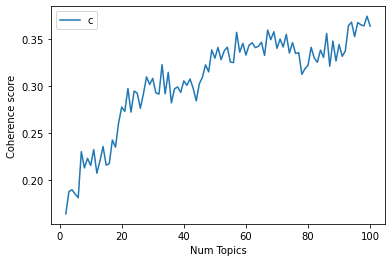

In [34]:
# Show graph
limit=101; start=2; step=1;
x = range(start, limit, step)
plt.plot(x, coherence_values)
plt.xlabel("Num Topics")
plt.ylabel("Coherence score")
plt.legend(("coherence_values"), loc='best')
plt.show()# Print the coherence scores

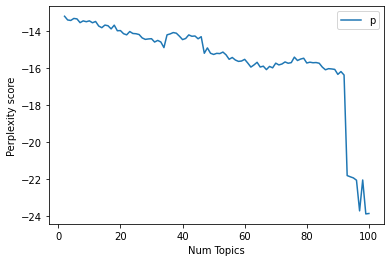

In [35]:
# Show graph
limit=101; start=2; step=1;
x = range(start, limit, step)
plt.plot(x, perplexity_values)
plt.xlabel("Num Topics")
plt.ylabel("Perplexity score")
plt.legend(("perplexity_score"), loc='best')
plt.show()# Print the perplexity scores

In [36]:
import numpy as np 
rows = [coherence_values, perplexity_values] 
np.savetxt("scores.csv",rows, delimiter =" ",  fmt ='% s')

In [37]:
# Print the coherence scores
for m, cv in zip(x, coherence_values):
    print("Num Topics =", m, " has Coherence Value of", round(cv, 4))

Num Topics = 2  has Coherence Value of 0.164
Num Topics = 3  has Coherence Value of 0.1877
Num Topics = 4  has Coherence Value of 0.1897
Num Topics = 5  has Coherence Value of 0.1852
Num Topics = 6  has Coherence Value of 0.1813
Num Topics = 7  has Coherence Value of 0.2302
Num Topics = 8  has Coherence Value of 0.213
Num Topics = 9  has Coherence Value of 0.2232
Num Topics = 10  has Coherence Value of 0.2155
Num Topics = 11  has Coherence Value of 0.2325
Num Topics = 12  has Coherence Value of 0.2073
Num Topics = 13  has Coherence Value of 0.2205
Num Topics = 14  has Coherence Value of 0.2357
Num Topics = 15  has Coherence Value of 0.216
Num Topics = 16  has Coherence Value of 0.2175
Num Topics = 17  has Coherence Value of 0.2427
Num Topics = 18  has Coherence Value of 0.2351
Num Topics = 19  has Coherence Value of 0.2608
Num Topics = 20  has Coherence Value of 0.2778
Num Topics = 21  has Coherence Value of 0.2732
Num Topics = 22  has Coherence Value of 0.2976
Num Topics = 23  has Coh

In [ ]:
type(model_list)
len(model_list)
print("Coherence score = ", coherence_values[48])
model_list[48]

In [ ]:
#######################################################################

In [26]:
# Set training parameters.
num_topics = 99
chunksize = 10000 # size of the doc looked at every pass
passes = 40 #number of passes through documents
iterations = 100
eval_every = 10  # Don't evaluate model perplexity, takes too much time.

# Make an index to word dictionary.
temp = docs_dict[0]  # This is only to "load" the dictionary.
id2word = docs_dict.id2token

%time model = LdaMulticore(corpus=corpus, id2word=id2word, chunksize=chunksize, \
                       iterations=iterations, num_topics=num_topics, \
                       passes=passes, workers=3)   

MemoryError: Unable to allocate 306. MiB for an array with shape (99, 810313) and data type float32

In [27]:
#Print all the topics
for i in range(0, model.num_topics):
    print ('Topic', i+1 , ' ', model.print_topic(i))
    print("-------------------------------------------------------------")

NameError: name 'model' is not defined

# Other Hyperparameters:

In [36]:
# supporting function
def compute_coherence_values(corpus, dictionary, k, a, b):
    lda_model = LdaModel(corpus=corpus, id2word=dictionary, num_topics=k, random_state=100, \
                         chunksize=100, passes=10, alpha=a, eta=b)
    
    coherence_model_lda = CoherenceModel(model=lda_model, texts=docs, dictionary=dictionary, coherence='c_v')
    
    return coherence_model_lda.get_coherence()

In [ ]:
import tqdm

grid = {}
grid['Validation_Set'] = {}

# Topics range
min_topics = 2
max_topics = 9
step_size = 1
topics_range = range(min_topics, max_topics, step_size)

# Alpha parameter
alpha = list(np.arange(0.01, 1, 0.3))
alpha.append('symmetric')
alpha.append('asymmetric')

# Beta parameter
beta = list(np.arange(0.01, 1, 0.3))
beta.append('symmetric')

In [ ]:
# Validation sets
num_of_docs = len(corpus)
corpus_sets = [gensim.utils.ClippedCorpus(corpus, int(num_of_docs*0.75)), corpus]
corpus_title = ['75% Corpus', '100% Corpus']
model_results = {'Validation_Set': [], 'Topics': [], 'Alpha': [], 'Beta': [], 'Coherence': []}

# Can take a long time to run
if 1 == 1:
    pbar = tqdm.tqdm(total=540)
    
    # iterate through validation corpuses
    for i in range(len(corpus_sets)):
        # iterate through number of topics
        for k in topics_range:
            # iterate through alpha values
            for a in alpha:
                # iterare through beta values
                for b in beta:
                    # get the coherence score for the given parameters
                    cv = compute_coherence_values(corpus=corpus_sets[i], dictionary=docs_dict, 
                                                  k=k, a=a, b=b)
                    # Save the model results
                    model_results['Validation_Set'].append(corpus_title[i])
                    model_results['Topics'].append(k)
                    model_results['Alpha'].append(a)
                    model_results['Beta'].append(b)
                    model_results['Coherence'].append(cv)
                    
                    pbar.update(1)
    pd.DataFrame(model_results)
    pbar.close()

In [ ]:
pd.DataFrame(model_results).to_csv('lda_tuning_results.csv', index=False)

# Visualize 'optimal' LDA model

In [ ]:
import pyLDAvis
pyLDAvis.gensim_models
import pyLDAvis.gensim_models
import warnings
pyLDAvis.enable_notebook()
warnings.filterwarnings("ignore", category=DeprecationWarning) 

In [ ]:
#pcoa:Principal Coordinate Analysis (aka Classical Multidimensional Scaling)
p = pyLDAvis.gensim_models.prepare(model, corpus, docs_dict)
pyLDAvis.save_html(p, 'lda_pcoa_Benifits.html')

In [ ]:
# mmds:Metric Multidimensional Scaling
p = pyLDAvis.gensim_models.prepare(model, corpus, docs_dict, mds='mmds')
pyLDAvis.save_html(p, 'lda_mmds_Benifits.html')

In [ ]:
#tsne:t-distributed Stochastic Neighbor Embedding
p = pyLDAvis.gensim_models.prepare(model, corpus, docs_dict, mds='tsne')
pyLDAvis.save_html(p, 'lda_tsne_Benifits.html')